# Рабочая модель

features_len = 80*6
last_min_max = 2*6

1) Отмена нормализации:
- уменьшает количество предсказаний в 10 раз,
- тем самым растёт метрика precision,
- уменьшается число сделок, максимальная прибыль с 300 usdt за 100_000 составляет 0.8 usdt при SLIP_N = 1.

## Импорты библиотек

In [1]:
from develop.augmentation import aug_all
from develop.create_labels import create_labels
from develop.score import trade, trade_slip, trade_v2

import json

import pickle

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from tqdm import tqdm

from sqlalchemy import create_engine, Column, Integer, String, TIMESTAMP, ARRAY
from sqlalchemy.ext.declarative import declarative_base
from sqlalchemy.orm import sessionmaker

from sklearn.preprocessing import StandardScaler, MinMaxScaler, Normalizer
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from sklearn.metrics import classification_report
from sklearn.linear_model import LogisticRegression

from lightgbm import LGBMRegressor, LGBMClassifier

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as data_utils
import torch.optim as optim

pd.set_option("display.max_columns", None)

## Константы

In [2]:
PAIRS_NAME = ['btc_usdt','eth_usdt','bnb_usdt','bnb_btc','eth_btc','bnb_eth']
LABELS_NAME = [
    'label',
    'bnb_btc_min',
    'bnb_btc_max',
    'bnb_btc_min_max',
    'eth_btc_min',
    'eth_btc_max',
    'eth_btc_min_max',
    'bnb_eth_min',
    'bnb_eth_max',
    'bnb_eth_min_max',
    'not_buy']

## Чтение данных

In [3]:
def config(service):
    with open('develop/config_connect.json', 'r') as f:
        config = json.load(f)
    if service == 'binance':
        config = config['binance']
    if service == 'postgres':
        config = config['postgres']

    return config

def config_model():
    with open('develop/config_model.json', 'r') as f:
        config_model = json.load(f)
    random = config_model['RANDOM']
    image_length = config_model['IMAGE_LENGTH']
    features_length = config_model['FEATURES_LENGTH']
    batch_size = config_model['BATCH_SIZE']
    epoch = config_model['EPOCH']
    fee = config_model['FEE']
    slip_n = config_model['SLIP_N']

    return random, image_length, features_length, batch_size, epoch, fee, slip_n

RANDOM, IMAGE_LENGTH, FEATURES_LENGTH, BATCH_SIZE, EPOCH, FEE, SLIP_N = config_model()

config_bin_dev = config('postgres')['binance']
engine = create_engine(f"postgresql+psycopg2://"
                       f"{config_bin_dev['user_name']}:"
                       f"{config_bin_dev['password']}@"
                       f"{config_bin_dev['server']}/"
                       f"{config_bin_dev['base_name']}")

ticker_price = pd.read_sql_table(table_name='ticker_price',
                                    con=engine,
                                    schema='public',
                                    index_col='id_ticker',
                                    columns=PAIRS_NAME)
ticker_price = ticker_price.astype('float')
ticker_price = ticker_price.sort_index()

In [4]:
SLIP_N = 4
fee = 0.00075
FEATURES_LENGTH = 600
EPOCH = 101
#BATCH_SIZE = 131072
#BATCH_SIZE = 65536
#BATCH_SIZE = 16384
#BATCH_SIZE = 8192
#BATCH_SIZE = 4096
BATCH_SIZE = 2048
#BATCH_SIZE = 1024

In [5]:
display(ticker_price.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1057173 entries, 1 to 1057173
Data columns (total 6 columns):
 #   Column    Non-Null Count    Dtype  
---  ------    --------------    -----  
 0   btc_usdt  1057173 non-null  float64
 1   eth_usdt  1057173 non-null  float64
 2   bnb_usdt  1057173 non-null  float64
 3   bnb_btc   1057173 non-null  float64
 4   eth_btc   1057173 non-null  float64
 5   bnb_eth   1057173 non-null  float64
dtypes: float64(6)
memory usage: 56.5 MB


None

## Создание выборок

### Выделение валидационной выборки

In [6]:
(ticker_price, ticker_price_valid) = train_test_split(ticker_price, test_size=0.3, random_state=RANDOM, shuffle=False)

In [7]:
ticker_price.shape, ticker_price_valid.shape

((740021, 6), (317152, 6))

In [8]:
ticker_price_valid.values[0]

array([1.660241e+04, 1.193540e+03, 2.431000e+02, 1.464000e-02,
       7.188400e-02, 2.036000e-01])

### Подготовка данных

#### Обучающая выборка

##### Добавление аугментированных данных.

In [9]:
ticker_price.shape

(740021, 6)

In [10]:
# добавление аугмендации, на выходе np.array
ticker_price = np.concatenate((ticker_price.values, aug_all(ticker_price.values,8)))
# сборка обратно DataFrame
ticker_price = pd.DataFrame(ticker_price, columns=PAIRS_NAME)
ticker_price['id_ticker'] = range(1,ticker_price.shape[0]+1)
ticker_price = ticker_price.set_index('id_ticker')


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:03<00:00,  2.02it/s]


In [11]:
ticker_price.shape

(6660189, 6)

##### Создание labels

In [12]:
ticker_price

,btc_usdt,eth_usdt,bnb_usdt,bnb_btc,eth_btc,bnb_eth
id_ticker,,,,,,
1,20696.190000,1553.980000,289.500000,0.013989,0.075078,0.186300
2,20697.380000,1554.030000,289.500000,0.013989,0.075082,0.186300
3,20695.740000,1554.030000,289.400000,0.013989,0.075082,0.186200
4,20696.330000,1553.780000,289.400000,0.013988,0.075082,0.186200
5,20698.320000,1553.820000,289.500000,0.013987,0.075075,0.186200
...,...,...,...,...,...,...
6660185,16665.328332,1193.368995,242.990525,0.014638,0.071881,0.203614
6660186,16666.827844,1193.584017,242.983586,0.014640,0.071881,0.203621
6660187,16666.525165,1193.561993,243.031531,0.014640,0.071877,0.203611


In [13]:
labels = create_labels(ticker_price, FEE, SLIP_N)

ticker_price = ticker_price[PAIRS_NAME]

6660189it [00:02, 2391245.08it/s]
C:\Users\denis\binance\develop\create_labels.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pair_max[pair_name + '_max'] = 1
C:\Users\denis\binance\develop\create_labels.py:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pair_min[pair_name + '_min'] = 1
6660189it [00:02, 2413085.70it/s]
C:\Users\denis\binance\develop\create_labels.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer

In [14]:
labels.head(50)

,bnb_btc_min,bnb_btc_max,bnb_btc_min_max,eth_btc_min,eth_btc_max,eth_btc_min_max,bnb_eth_min,bnb_eth_max,bnb_eth_min_max,not_buy,label
id_ticker,,,,,,,,,,,
1,0,0,0,0,0,0,0,0,0,1,0
2,0,0,0,0,0,0,0,0,0,1,0
3,0,0,0,0,0,0,0,0,0,1,0
4,0,0,0,0,0,0,0,0,0,1,0
5,0,0,0,0,0,0,0,0,0,1,0
6,0,0,0,0,0,0,0,0,0,1,0
7,0,0,0,0,0,0,0,0,0,1,0
8,0,0,0,0,0,0,0,0,0,1,0
9,0,0,0,0,0,0,0,0,0,1,0


In [15]:
labels.shape

(6660189, 11)

##### Создание признаков MinScaler.

In [16]:
# маленькие образы
features_list = list()
features_last_min_max_list = list()
labels_list = list()

ticker_price = ticker_price.values

for i in tqdm(range(FEATURES_LENGTH, ticker_price.shape[0])):
    
    if labels['label'].iloc[i-1] !=0 or i % 20 == 0: # добавляем в тренировочную выборку все не 0 labels и каждый 20-ый labels
        
        features = ticker_price[i-FEATURES_LENGTH:i] # невключая i

        features_min = features.T.min(axis=1)

        features_scaled = ((features - features_min) * 1000 / features_min)

        features_last_min = features_scaled[-1] - features_scaled.min()

        features_last_max = features_scaled.max() - features_scaled[-1]
   
        
        features_list.append(features_scaled.T)
        
        features_last_min_max_list.append(np.concatenate((features_last_min, features_last_max), axis=0))
            
        labels_list.append(labels['label'].iloc[i-1])

features = np.array(features_list)
features_last_min_max = np.array(features_last_min_max_list)


labels = np.array(labels_list)
del features_list, features_last_min_max_list, labels_list, features_min, features_scaled, features_last_min, features_last_max

100%|█████████████████████████████████████████████████████████████████████| 6659589/6659589 [01:45<00:00, 63164.32it/s]


In [17]:
features.shape, features_last_min_max.shape, labels.shape

((367053, 6, 600), (367053, 12), (367053,))

In [18]:
labels[15318]

2

#### Валидационная выборка

##### Создание labels

In [19]:
ticker_price_valid.shape

(317152, 6)

In [20]:
ticker_price_valid = pd.DataFrame(ticker_price_valid, columns=PAIRS_NAME)

In [21]:
ticker_price_valid.shape

(317152, 6)

In [22]:
ticker_price_valid['id_ticker'] = range(1,ticker_price_valid.shape[0]+1)
ticker_price_valid = ticker_price_valid.set_index('id_ticker')

labels_valid = create_labels(ticker_price_valid, FEE, SLIP_N)['label'].values

ticker_price_valid = ticker_price_valid[PAIRS_NAME]

317152it [00:00, 2032536.15it/s]
C:\Users\denis\binance\develop\create_labels.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pair_max[pair_name + '_max'] = 1
C:\Users\denis\binance\develop\create_labels.py:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pair_min[pair_name + '_min'] = 1
317152it [00:00, 2188511.34it/s]
C:\Users\denis\binance\develop\create_labels.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

In [23]:
labels_valid.shape

(317152,)

##### Создание признаков MinScaler.

In [24]:
ticker_price_valid.shape

(317152, 6)

In [25]:
features_valid_list = list()
features_last_min_max_valid_list = list()

ticker_price_valid = ticker_price_valid.values

for i in tqdm(range(FEATURES_LENGTH, ticker_price_valid.shape[0])):
        
        features_valid = ticker_price_valid[i-FEATURES_LENGTH:i] # невключая i
        features_min = features_valid.T.min(axis=1)
        features_scaled = ((features_valid - features_min) * 1000 / features_min)
        features_last_min = features_scaled[-1] - features_scaled.min()
        features_last_max = features_scaled.max() - features_scaled[-1]
        

        features_valid_list.append(features_scaled.T)
        
        features_last_min_max_valid_list.append(np.concatenate((features_last_min, features_last_max), axis=0))

features_valid = np.array(features_valid_list)
features_last_min_max_valid = np.array(features_last_min_max_valid_list)

del features_valid_list, features_last_min_max_valid_list, features_min, features_scaled, features_last_min, features_last_max

100%|███████████████████████████████████████████████████████████████████████| 316552/316552 [00:31<00:00, 10101.29it/s]


In [26]:
ticker_price_valid = ticker_price_valid[FEATURES_LENGTH:]
labels_valid = labels_valid[FEATURES_LENGTH-1:-1]

In [27]:
features_valid.shape, features_last_min_max_valid.shape, labels_valid.shape

((316552, 6, 600), (316552, 12), (316552,))

## Загрузчик данных

### Дисбаланс целевой функции

In [28]:
values, counts = np.unique(labels, return_counts=True)
print(values, counts)

[0 1 2 3 4 5 6] [331202   6701   6701   3286   3283   7942   7938]


In [29]:
i, = np.where(labels == 1)
features_1 = features[i]
features_min_max_1 = features_last_min_max[i]
labels_1 = labels[i]

i, = np.where(labels == 2)
features_2 = features[i]
features_min_max_2 = features_last_min_max[i]
labels_2 = labels[i]

i, = np.where(labels == 3)
features_3 = features[i]
features_min_max_3 = features_last_min_max[i]
labels_3 = labels[i]

i, = np.where(labels == 4)
features_4 = features[i]
features_min_max_4 = features_last_min_max[i]
labels_4 = labels[i]

i, = np.where(labels == 5)
features_5 = features[i]
features_min_max_5 = features_last_min_max[i]
labels_5 = labels[i]

i, = np.where(labels == 6)
features_6 = features[i]
features_min_max_6 = features_last_min_max[i]
labels_6 = labels[i]


for i in tqdm(range(2)):
   
    #features = np.concatenate((features, features_3, features_4), axis=0)
    #features_last_min_max = np.concatenate((features_last_min_max, features_min_max_3, features_min_max_4), axis=0)
    #labels = np.concatenate((labels, labels_3, labels_4), axis=0)
    
   
    features = np.concatenate((features, features_1, features_2, features_3, features_3, features_4, features_4, features_5, features_6), axis=0)
    features_last_min_max = np.concatenate((features_last_min_max, features_min_max_1, features_min_max_2, features_min_max_3, features_min_max_3, features_min_max_4, features_min_max_4, features_min_max_5, features_min_max_6), axis=0)
    labels = np.concatenate((labels, labels_1, labels_2, labels_3, labels_3, labels_4, labels_4, labels_5, labels_6), axis=0)

100%|████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:04<00:00,  2.42s/it]


In [30]:
values, counts = np.unique(labels, return_counts=True)
print(values, counts)

[0 1 2 3 4 5 6] [331202  20103  20103  16430  16415  23826  23814]


### Перемешивание признаков

In [31]:
for i in tqdm(range (2)):
    features, features_last_min_max, labels = shuffle(features, features_last_min_max, labels, random_state=RANDOM*i)

100%|████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:06<00:00,  3.03s/it]


### DataLoader

In [32]:
ticker_price_valid = pd.DataFrame(ticker_price_valid, columns=PAIRS_NAME)

#### train

In [33]:
features_tensor = torch.tensor(features.astype('float32'))
features_last_min_max_tensor = torch.tensor(features_last_min_max.astype('float32'))
labels_tensor = torch.tensor(labels).type(torch.LongTensor)

train = data_utils.TensorDataset(features_tensor, features_last_min_max_tensor, labels_tensor)
train_loader = data_utils.DataLoader(train, batch_size=BATCH_SIZE, shuffle=False)

#del features, features_last_min_max, labels
del features_tensor, features_last_min_max_tensor, labels_tensor

#### valid

In [34]:
features_valid_tensor = torch.tensor(features_valid.astype('float32'))
features_last_min_max_valid_tensor = torch.tensor(features_last_min_max_valid.astype('float32'))
labels_valid_tensor = torch.tensor(labels_valid).type(torch.LongTensor)

valid = data_utils.TensorDataset(features_valid_tensor, features_last_min_max_valid_tensor, labels_valid_tensor)
valid_loader = data_utils.DataLoader(valid, batch_size=BATCH_SIZE, shuffle=False)

#del features_valid, features_last_min_max_valid, labels_valid
del features_valid_tensor, features_last_min_max_valid_tensor, labels_valid_tensor

## Модель ResNet1D

In [ ]:
class Bottleneck(nn.Module):
    def __init__(self, in_channels, inter_channels, out_channels, inter_stride):
        super(Bottleneck,self).__init__()
        self.conv1 = nn.Conv1d(in_channels, inter_channels, kernel_size=1, stride=1, bias=False)
        self.bn1 = nn.BatchNorm1d(inter_channels, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv2 = nn.Conv1d(inter_channels, inter_channels, kernel_size=3, stride=inter_stride, padding=1, bias=False)
        self.bn2 = nn.BatchNorm1d(inter_channels, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv3 = nn.Conv1d(inter_channels, out_channels, kernel_size=1, stride=1, bias=False)
        self.bn3 = nn.BatchNorm1d(out_channels, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.relu = nn.ReLU(inplace=True)
    
    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.conv3(x)
        x = self.bn3(x)
        x = self.relu(x)
        return x

class Downsample(nn.Module):
    def __init__(self, in_channels, out_channels, stride):
        super(Downsample,self).__init__()
        self.conv = nn.Conv1d(in_channels, out_channels, kernel_size=1, stride=stride, bias=False)
        self.bn = nn.BatchNorm1d(out_channels, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    
    def forward(self, x):
        x = self.conv(x)
        x = self.bn(x)
        return x
    
class ResNet1D(nn.Module):
    def __init__(self):
        super(ResNet1D,self).__init__()
        
        # input
        #self.conv1 = nn.Conv1d(6, 64, kernel_size=7, stride=2, padding=3, bias=False)
        self.conv1 = nn.Conv1d(6, 64, kernel_size=80, stride=2, padding=3, bias=False) # kernel_size = 4 по умолчанию 7
        #self.bn1 = nn.BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.relu1 = nn.ReLU(inplace=True)
        self.max_pool1 = nn.MaxPool1d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
        
        # layer 1
        self.downsample_1 = Downsample(64, 256, 1)
        self.bottleneck_1_0 = Bottleneck(64, 64, 256, 1)
        self.bottleneck_1_1 = Bottleneck(256, 64, 256, 1)
        self.bottleneck_1_2 = Bottleneck(256, 64, 256, 1)
        
        # layer 2
        self.downsample_2 = Downsample(256, 512, 2) 
        self.bottleneck_2_0 = Bottleneck(256, 128, 512, 2)
        self.bottleneck_2_1 = Bottleneck(512, 128, 512, 1)
        self.bottleneck_2_2 = Bottleneck(512, 128, 512, 1)
        self.bottleneck_2_3 = Bottleneck(512, 128, 512, 1)
               
        # layer 3
        self.downsample_3 = Downsample(512, 1024, 2)
        self.bottleneck_3_0 = Bottleneck(512, 256, 1024, 2)
        self.bottleneck_3_1 = Bottleneck(1024, 256, 1024, 1)
        self.bottleneck_3_2 = Bottleneck(1024, 256, 1024, 1)
        self.bottleneck_3_3 = Bottleneck(1024, 256, 1024, 1)
        self.bottleneck_3_4 = Bottleneck(1024, 256, 1024, 1)
        self.bottleneck_3_5 = Bottleneck(1024, 256, 1024, 1)
                   
        # layer 4
        self.downsample_4 = Downsample(1024, 2048, 2)
        self.bottleneck_4_0 = Bottleneck(1024, 512, 2048, 2)
        self.bottleneck_4_1 = Bottleneck(2048, 512, 2048, 1)
        self.bottleneck_4_2 = Bottleneck(2048, 512, 2048, 1)
        
        # linear
        #self.bn2 = nn.BatchNorm1d(12, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.avg_pool = nn.AdaptiveAvgPool1d(output_size=1)
        self.flatten = nn.Flatten()
        self.linear1 = nn.Linear(in_features=2048, out_features=500, bias=True)
        #self.linear1 = nn.Linear(in_features=2048, out_features=7, bias=True)
        self.relu2 = nn.ReLU(inplace=True)
        #self.sigmoid = nn.Sigmoid()
        self.linear2 = nn.Linear(512, 7, bias=False)
        self.sm = nn.Softmax(dim=1)
    
    def forward(self, x, x_min_max):
        # input
        x = self.conv1(x)
        #x = self.bn1(x)
        x = self.relu1(x)
        x = self.max_pool1(x)
        # layer 1
        x_downsampled = self.downsample_1(x)
        x = self.bottleneck_1_0(x)
        x = self.bottleneck_1_1(x)
        x = self.bottleneck_1_2(x)
        x = x + x_downsampled
        # layer 2
        x_downsampled = self.downsample_2(x)
        x = self.bottleneck_2_0(x)
        x = self.bottleneck_2_1(x)
        x = self.bottleneck_2_2(x)
        x = self.bottleneck_2_3(x)
        x = x + x_downsampled        
        # layer 3
        x_downsampled = self.downsample_3(x)
        x = self.bottleneck_3_0(x)
        x = self.bottleneck_3_1(x)
        x = self.bottleneck_3_2(x)
        x = self.bottleneck_3_3(x)
        x = self.bottleneck_3_4(x)
        x = self.bottleneck_3_5(x)
        x = x + x_downsampled          
        # layer 4
        x_downsampled = self.downsample_4(x)
        x = self.bottleneck_4_0(x)
        x = self.bottleneck_4_1(x)
        x = self.bottleneck_4_2(x)
        x = x + x_downsampled        
        # linear
        #x_min_max = self.bn2(x_min_max)
        x = self.avg_pool(x)
        x = self.flatten(x)
        x = self.linear1(x)
        x = torch.cat((x, x_min_max), 1)
        x = self.relu2(x)
        #x = self.sigmoid(x)
        
        
        x = self.linear2(x)
        return x
    
    def inference(self, x, x_min_max):
        x = self.forward(x, x_min_max)
        x = self.sm(x)
        return x    

In [ ]:
%%time

FEE = 0.00075
best_profit = 0

epoch_list = list()
loss_list = list()
traid_counts_list = list()
profit_300_1_list = list()
profit_300_2_list = list()
profit_300_3_list = list()
profit_300_4_list = list()

ticker_price_valid_values = ticker_price_valid.values
ticker_price_valid_fig = ticker_price_valid

res_net = ResNet1D().to('cuda')

loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(res_net.parameters(), lr=0.001)

for epoch in range(EPOCH):
    loss_array = np.array([], dtype=float)
    for i, batch in enumerate(train_loader):
        optimizer.zero_grad()
        X_batch, X_last_min_max_batch, y_batch = batch
        X_batch = X_batch.to('cuda')
        X_last_min_max_batch = X_last_min_max_batch.to('cuda')
        y_batch = y_batch.to('cuda')
        
        output = res_net.forward(X_batch, X_last_min_max_batch)
        loss =loss_fn(output, y_batch)
        loss.backward()
        optimizer.step()
        loss_array = np.append(loss_array, loss.to('cpu').detach().numpy())
    if epoch % 1 == 0:
        
        print('---***---***---***---***---***---***---***---***---***---***---***---***---')
        print('Predict start')
        predict = torch.empty((1), dtype=torch.float).to('cuda')
        y_valid_tensor = torch.empty((1), dtype=torch.float)
        
        #res_net.eval()
        
        for i_valid, batch_valid in enumerate(valid_loader):
            X_batch_valid, X_last_min_max_batch_valid, y_batch_valid = batch_valid
            X_batch_valid = X_batch_valid.to('cuda')
            X_last_min_max_batch_valid = X_last_min_max_batch_valid.to('cuda')
            
            predict_batch = torch.argmax(res_net.inference(X_batch_valid, X_last_min_max_batch_valid), dim=1)
            predict = torch.cat((predict, predict_batch), 0)
            y_valid_tensor = torch.cat((y_valid_tensor, y_batch_valid), 0)
            
        #res_net.train()
        
        predict = predict[1:]
        y_valid_tensor = y_valid_tensor[1:]
        epoch_list.append(epoch)
        loss_mean = loss_array.mean()
        loss_list.append(loss_mean)
        print(f'Epoch: {epoch}, loss: {loss_mean:.3f}')
        traid_counts = (predict!=0).sum()
        traid_counts_list.append(traid_counts)
        print(f'Traid counts: {traid_counts}',
              f'1: {(predict==1).sum()}',
              f'2: {(predict==2).sum()}',
              f'3: {(predict==3).sum()}',
              f'4: {(predict==4).sum()}',
              f'5: {(predict==5).sum()}',
              f'6: {(predict==6).sum()}'
             )
        predict = predict.to('cpu').detach().numpy()
        print(classification_report(y_valid_tensor.detach().numpy(), predict))
        
        for slip_n in range(10,11):
            slip_n = slip_n/10
            print("-------------")
            print(f'SLIP_N = {slip_n}')
            trade_result, trade_btc, trade_eth, trade_bnb, volume_not_trade, trade_start, fee_usdt, trade_count = trade(ticker_price_valid_values, predict, FEE, slip_n)
            trade_result = np.array(trade_result)
            print(f'Без торгов за счёт изменения курса с 300 usdt: {volume_not_trade}')
            print(f'Результат торгов с 300 usdt: {trade_result[-1]}')
            print(f'Общая комиссия в usdt: {fee_usdt}')
            print(f'Число сделок: {trade_count}')
            profit_300 = (trade_result[-1]-trade_start)*100_000/predict.shape[0]
            if slip_n == 1:
                profit_300_1_list.append(profit_300)
                if profit_300 > best_profit:
                    np.save('features/ticker_price_valid_values', ticker_price_valid_values, allow_pickle=True, fix_imports=True)
                    np.save('features/predict', predict, allow_pickle=True, fix_imports=True)
                    torch.save(res_net, f'res_net_{epoch}_{profit_300:.2f}.pt')
                    best_profit = profit_300
            elif slip_n == 2:
                profit_300_2_list.append(profit_300)
            elif slip_n == 3:
                profit_300_3_list.append(profit_300)
            elif slip_n == 4:
                profit_300_4_list.append(profit_300)
            print(f'Прибыль от 300 usdt за 100_000 тиков: {profit_300}')
            print(' ')
            # отрисовка изменение объёма кошелька
            sns.lineplot(x=range(trade_result.shape[0]),y=trade_result)
            plt.show()

        # отрисовка сделок на тренде
        #x_len = predict.shape[0]
        x_len = 4000

        ticker_price_valid_fig[PAIRS_NAME[3]+'_min'] = ticker_price_valid_values[:,3]*(predict == 1)
        ticker_price_valid_fig[PAIRS_NAME[3]+'_max'] = ticker_price_valid_values[:,3]*(predict == 2)
        ticker_price_valid_fig[PAIRS_NAME[4]+'_min'] = ticker_price_valid_values[:,4]*(predict == 3)
        ticker_price_valid_fig[PAIRS_NAME[4]+'_max'] = ticker_price_valid_values[:,4]*(predict == 4)
        ticker_price_valid_fig[PAIRS_NAME[5]+'_min'] = ticker_price_valid_values[:,5]*(predict == 5)
        ticker_price_valid_fig[PAIRS_NAME[5]+'_max'] = ticker_price_valid_values[:,5]*(predict == 6)
        ticker_price_valid_fig = ticker_price_valid_fig.replace(0, np.nan)

        for i, pair in enumerate(['bnb_btc','eth_btc','bnb_eth']):
            print(pair)
            fig, ax = plt.subplots()
            ax.plot(range(x_len),ticker_price_valid_values[:x_len,i+3])
            #ax.plot(range(x_len),trade_result['bnb_btc_max'][:x_len])
            sns.scatterplot(data=ticker_price_valid_fig[:x_len], x=range(x_len), y=pair+'_max', ax=ax, color='green')
            sns.scatterplot(data=ticker_price_valid_fig[:x_len], x=range(x_len), y=pair+'_min', ax=ax, color='red')
            #plt.ylim([ticker_price_valid_fig[pair+'_min'][:x_len].min(), ticker_price_valid_fig[pair+'_max'][:x_len].max()])
            plt.show()

trade_df = pd.DataFrame(data=[epoch_list, 
                              loss_list, 
                              traid_counts_list, 
                              profit_300_1_list, 
                              profit_300_2_list, 
                              profit_300_3_list, 
                              profit_300_4_list]).T.rename(columns={0:'epoch',
                                                                     1:'loss',
                                                                     2:'traid_counts',
                                                                     3:'profit_300_1',
                                                                     4:'profit_300_2',
                                                                     5:'profit_300_3',
                                                                     6:'profit_300_4'})

In [ ]:
trade_df

In [ ]:
trade_df[trade_df['profit_300_1'] == trade_df['profit_300_1'].max()]

In [ ]:
a = {'symbol': 'ETHUSDT', 'orderId': 12149549208, 'orderListId': -1, 'clientOrderId': 'A0gTm9TqE44vCRAhzxuXRU', 'transactTime': 1673470727218, 'price': '0.00000000', 'origQty': '0.00790000', 'executedQty': '0.00790000', 'cummulativeQuoteQty': '10.59761300', 'status': 'FILLED', 'timeInForce': 'GTC', 'type': 'MARKET', 'side': 'BUY', 'workingTime': 1673470727218, 'fills': [{'price': '1341.47000000', 'qty': '0.00790000', 'commission': '0.00002847', 'commissionAsset': 'BNB', 'tradeId': 1053842200}], 'selfTradePreventionMode': 'NONE'}

In [ ]:
a['fills'][0]['commissionAsset']

In [ ]:
round((0.0426883353453453) , 8)

In [1]:
from develop.augmentation import aug_all
from develop.create_labels import create_labels
from develop.score import trade, trade_slip, trade_v2


import json

import pickle

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from tqdm import tqdm

from sqlalchemy import create_engine, Column, Integer, String, TIMESTAMP, ARRAY
from sqlalchemy.ext.declarative import declarative_base
from sqlalchemy.orm import sessionmaker

from sklearn.preprocessing import StandardScaler, MinMaxScaler, Normalizer
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from sklearn.metrics import classification_report
from sklearn.linear_model import LogisticRegression

from lightgbm import LGBMRegressor, LGBMClassifier

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as data_utils
import torch.optim as optim

pd.set_option("display.max_columns", None)

ticker_price_valid_values = np.load('features/ticker_price_valid_values.npy', mmap_mode=None, allow_pickle=False, fix_imports=True, encoding='ASCII')
predict = np.load('features/predict.npy', mmap_mode=None, allow_pickle=False, fix_imports=True, encoding='ASCII')

In [2]:
ticker_price_valid_values = ticker_price_valid_values
predict = predict

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 368.91222390711715
Результат торгов с 300 usdt: 367.05430864324927
Общая комиссия в usdt: 0.5568912203231328
Число сделок: 20
Прибыль от 300 usdt за 100_000 тиков: -0.5976002469854487
 
btc_usdt


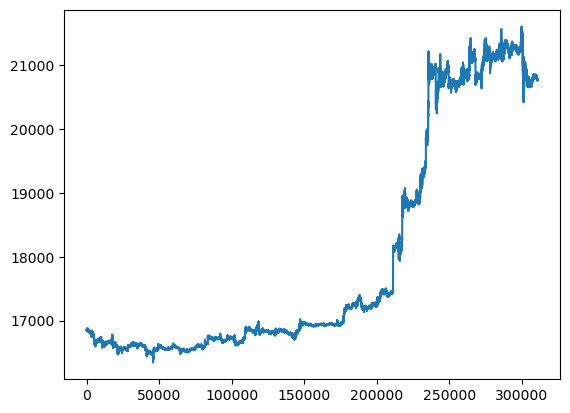

trade_result


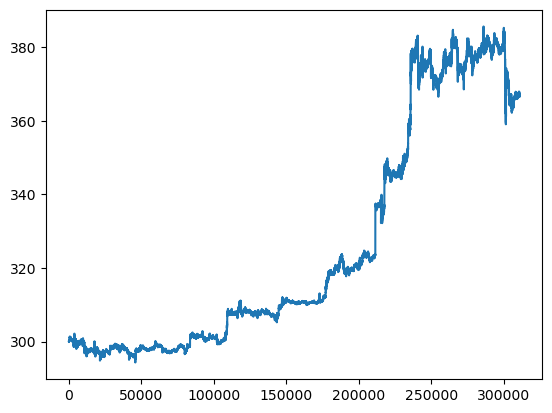

profit


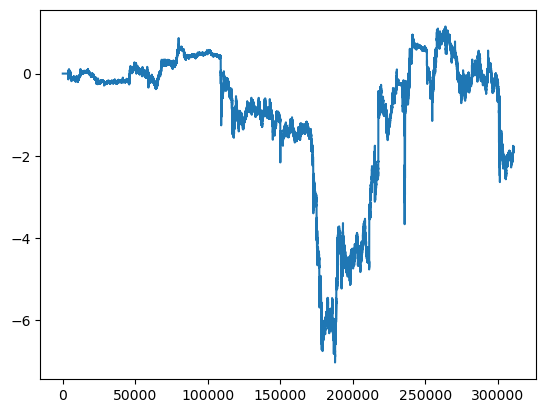

trade_btc 59.072033002955216


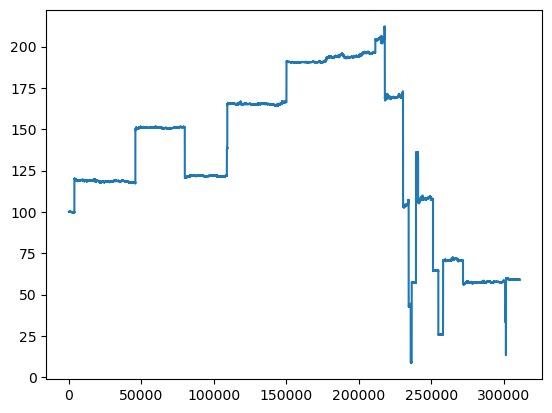

trade_eth 125.56636964448747


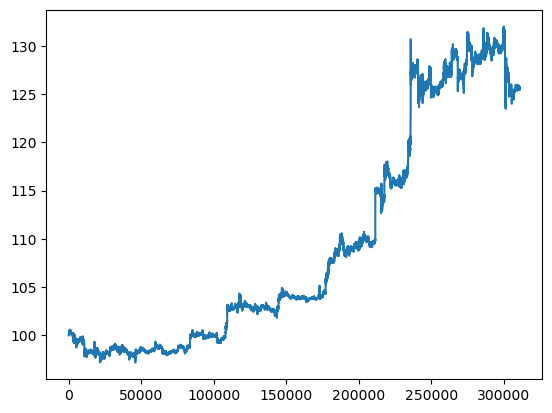

trade_bnb 182.41590599580658


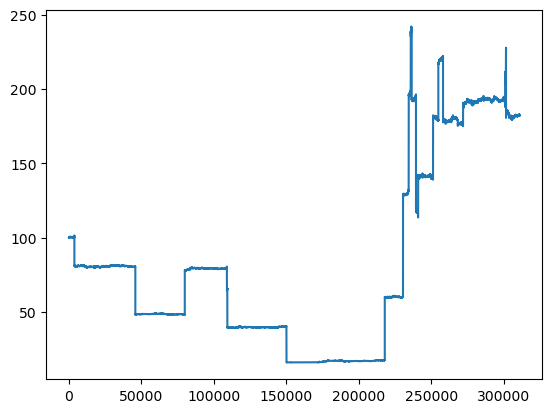

CPU times: total: 42 s
Wall time: 42 s


In [3]:
%%time

FEE = 0.00075


for slip_n in range(10,11):
    slip_n = slip_n/10
    print("-------------")
    print(f'SLIP_N = {slip_n}')
    trade_result, trade_btc, trade_eth, trade_bnb, volume_not_trade, trade_start, fee_usdt, trade_count = trade_v2(ticker_price_valid_values, predict, FEE, 1)
    trade_result = np.array(trade_result)
    volume_not_trade = np.array(volume_not_trade)
    trade_btc = np.array(trade_btc)
    trade_eth = np.array(trade_eth)
    trade_bnb = np.array(trade_bnb)
    profit = trade_result - volume_not_trade
    
    print(f'Без торгов за счёт изменения курса с 300 usdt: {volume_not_trade[-1]}')
    print(f'Результат торгов с 300 usdt: {trade_result[-1]}')
    print(f'Общая комиссия в usdt: {fee_usdt}')
    print(f'Число сделок: {trade_count}')
    profit_300 = profit[-1]*100_000/predict.shape[0]
    print(f'Прибыль от 300 usdt за 100_000 тиков: {profit_300}')
    print(' ')
    # отрисовка изменение объёма кошелька
    print('btc_usdt')
    sns.lineplot(x=range(ticker_price_valid_values.shape[0]),y=ticker_price_valid_values[:,0])
    plt.show()
    print('trade_result')
    sns.lineplot(x=range(trade_result.shape[0]),y=trade_result)
    plt.show()
    print('profit')
    sns.lineplot(x=range(profit.shape[0]),y=profit)
    plt.show()
    print(f'trade_btc {trade_btc[-1]}')
    sns.lineplot(x=range(trade_btc.shape[0]),y=trade_btc)
    plt.show()
    print(f'trade_eth {trade_eth[-1]}')
    sns.lineplot(x=range(trade_eth.shape[0]),y=trade_eth)
    plt.show()
    print(f'trade_bnb {trade_bnb[-1]}')
    sns.lineplot(x=range(trade_bnb.shape[0]),y=trade_bnb)
    plt.show()

## Модель ResNet1Dx

In [37]:
class Bottleneck(nn.Module):
    def __init__(self, in_channels, inter_channels, out_channels, inter_stride):
        super(Bottleneck,self).__init__()
        self.conv1 = nn.Conv1d(in_channels, inter_channels, kernel_size=1, stride=1, bias=False)
        self.bn1 = nn.BatchNorm1d(inter_channels, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv2 = nn.Conv1d(inter_channels, inter_channels, kernel_size=3, stride=inter_stride, padding=1, bias=False)
        self.bn2 = nn.BatchNorm1d(inter_channels, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv3 = nn.Conv1d(inter_channels, out_channels, kernel_size=1, stride=1, bias=False)
        self.bn3 = nn.BatchNorm1d(out_channels, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.relu = nn.ReLU(inplace=True)
    
    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.conv3(x)
        x = self.bn3(x)
        x = self.relu(x)
        return x

class Downsample(nn.Module):
    def __init__(self, in_channels, out_channels, stride):
        super(Downsample,self).__init__()
        self.conv = nn.Conv1d(in_channels, out_channels, kernel_size=1, stride=stride, bias=False)
        self.bn = nn.BatchNorm1d(out_channels, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    
    def forward(self, x):
        x = self.conv(x)
        x = self.bn(x)
        return x


class ResNetKernel(nn.Module):
    def __init__(self, kernel_size):
        super(ResNetKernel,self).__init__()
        
        # input
        self.conv1 = nn.Conv1d(6, 64, kernel_size=kernel_size, stride=2, padding=3, bias=False) 
        self.bn1 = nn.BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.relu1 = nn.ReLU(inplace=True)
        self.max_pool1 = nn.MaxPool1d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
        
        # layer 1
        self.downsample_1 = Downsample(64, 256, 1)
        self.bottleneck_1_0 = Bottleneck(64, 64, 256, 1)
        self.bottleneck_1_1 = Bottleneck(256, 64, 256, 1)
        self.bottleneck_1_2 = Bottleneck(256, 64, 256, 1)
        
        # layer 2
        self.downsample_2 = Downsample(256, 512, 2) 
        self.bottleneck_2_0 = Bottleneck(256, 128, 512, 2)
        self.bottleneck_2_1 = Bottleneck(512, 128, 512, 1)
        self.bottleneck_2_2 = Bottleneck(512, 128, 512, 1)
        self.bottleneck_2_3 = Bottleneck(512, 128, 512, 1)
               
        # layer 3
        self.downsample_3 = Downsample(512, 1024, 2)
        self.bottleneck_3_0 = Bottleneck(512, 256, 1024, 2)
        self.bottleneck_3_1 = Bottleneck(1024, 256, 1024, 1)
        self.bottleneck_3_2 = Bottleneck(1024, 256, 1024, 1)
        self.bottleneck_3_3 = Bottleneck(1024, 256, 1024, 1)
        self.bottleneck_3_4 = Bottleneck(1024, 256, 1024, 1)
        self.bottleneck_3_5 = Bottleneck(1024, 256, 1024, 1)
                   
        # layer 4
        self.downsample_4 = Downsample(1024, 2048, 2)
        self.bottleneck_4_0 = Bottleneck(1024, 512, 2048, 2)
        self.bottleneck_4_1 = Bottleneck(2048, 512, 2048, 1)
        self.bottleneck_4_2 = Bottleneck(2048, 512, 2048, 1)        
        
        # linear
        self.avg_pool = nn.AdaptiveAvgPool1d(output_size=1)
        self.flatten = nn.Flatten()
        self.linear1 = nn.Linear(in_features=2048, out_features=500, bias=True)
        
    def forward(self, x):
        # input
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu1(x)
        x = self.max_pool1(x)
        # layer 1
        x_downsampled = self.downsample_1(x)
        x = self.bottleneck_1_0(x)
        x = self.bottleneck_1_1(x)
        x = self.bottleneck_1_2(x)
        x = x + x_downsampled
        # layer 2
        x_downsampled = self.downsample_2(x)
        x = self.bottleneck_2_0(x)
        x = self.bottleneck_2_1(x)
        x = self.bottleneck_2_2(x)
        x = self.bottleneck_2_3(x)
        x = x + x_downsampled        
        # layer 3
        x_downsampled = self.downsample_3(x)
        x = self.bottleneck_3_0(x)
        x = self.bottleneck_3_1(x)
        x = self.bottleneck_3_2(x)
        x = self.bottleneck_3_3(x)
        x = self.bottleneck_3_4(x)
        x = self.bottleneck_3_5(x)
        x = x + x_downsampled          
        # layer 4
        x_downsampled = self.downsample_4(x)
        x = self.bottleneck_4_0(x)
        x = self.bottleneck_4_1(x)
        x = self.bottleneck_4_2(x)
        x = x + x_downsampled
        # linear
        x = self.avg_pool(x)
        x = self.flatten(x)
        x = self.linear1(x)
        return x
    
    
    
class ResNet1Dx(nn.Module):
    def __init__(self):
        super(ResNet1Dx,self).__init__()
        
        self.res_net_kernel_300 = ResNetKernel(300)
        self.res_net_kernel_80 = ResNetKernel(80)
        self.res_net_kernel_30 = ResNetKernel(30)
        self.res_net_kernel_10 = ResNetKernel(10)
        
        
        # linear
        #self.bn2 = nn.BatchNorm1d(12, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.relu2 = nn.ReLU(inplace=True)
        #self.linear2 = nn.Linear(2012, 7, bias=False)
        self.linear2 = nn.Linear(2000, 7, bias=False)
        self.sm = nn.Softmax(dim=1)
    
    def forward(self, x, x_min_max):
        # kernel_feature
        x_300 = x[:,:,-300:]
        x_80 = x[:,:,-80:]
        x_30 = x[:,:,-30:]
        x_10 = x[:,:,-10:]
        
        
        # kernel_net
        x_300 = self.res_net_kernel_300(x_300)
        x_80 = self.res_net_kernel_80(x_80)
        x_30 = self.res_net_kernel_30(x_30)
        x_10 = self.res_net_kernel_10(x_10)
        
        # linear
        #x_min_max = self.bn2(x_min_max)
        x = torch.cat((x_300, x_80, x_30, x_10), 1) # , x_min_max), 1)
        x = self.relu2(x)
        x = self.linear2(x)
        return x
    
    def inference(self, x, x_min_max):
        x = self.forward(x, x_min_max)
        x = self.sm(x)
        return x    

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 0, loss: 0.566
Traid counts: 26528 1: 3383 2: 3901 3: 3043 4: 4269 5: 4680 6: 7252
              precision    recall  f1-score   support

         0.0       1.00      0.74      0.85    101837
         1.0       0.00      0.35      0.01        31
         2.0       0.00      0.41      0.01        32
         3.0       0.00      0.48      0.01        21
         4.0       0.00      0.45      0.00        20
         5.0       0.01      0.71      0.01        35
         6.0       0.00      0.86      0.01        36

    accuracy                           0.74    102012
   macro avg       0.15      0.57      0.13    102012
weighted avg       1.00      0.74      0.85    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 305.0153391219693
Общая комиссия в usdt: 13.620929790744984
Число сделок: 697
Прибыль от 300 usdt за 

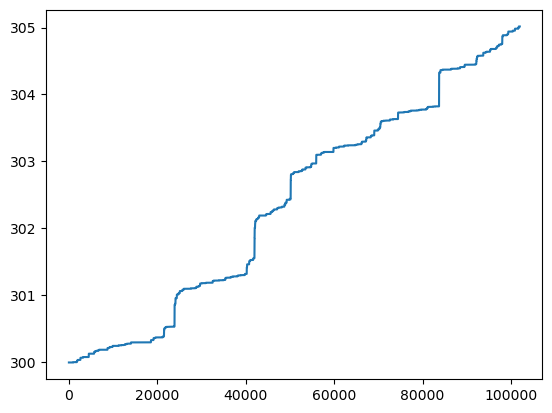

bnb_btc


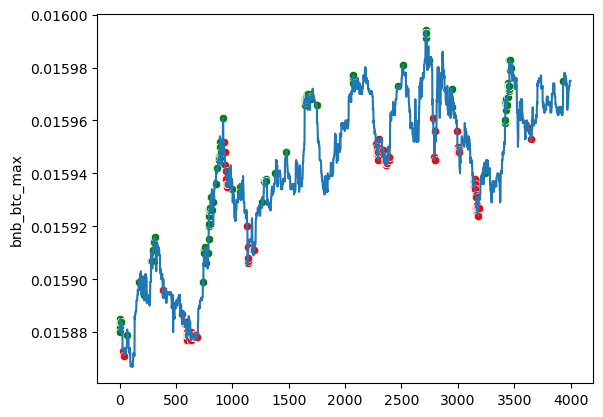

eth_btc


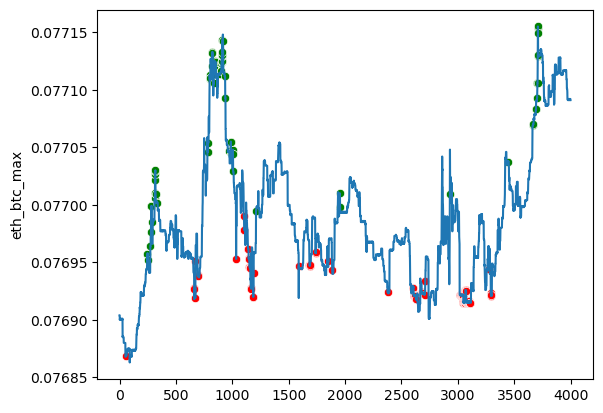

bnb_eth


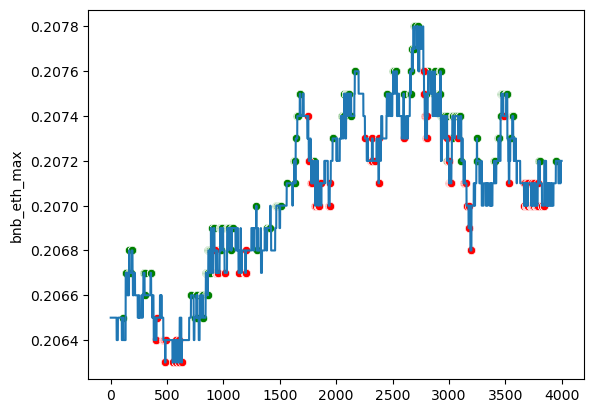

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 1, loss: 0.373
Traid counts: 25574 1: 3504 2: 4315 3: 3023 4: 3496 5: 4460 6: 6776
              precision    recall  f1-score   support

         0.0       1.00      0.75      0.86    101837
         1.0       0.00      0.42      0.01        31
         2.0       0.00      0.59      0.01        32
         3.0       0.00      0.62      0.01        21
         4.0       0.00      0.55      0.01        20
         5.0       0.01      0.80      0.01        35
         6.0       0.00      0.75      0.01        36

    accuracy                           0.75    102012
   macro avg       0.15      0.64      0.13    102012
weighted avg       1.00      0.75      0.86    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 305.3986092727637
Общая комиссия в usdt: 14.258002196014349
Число сделок: 682
Прибыль от 300 usdt за 

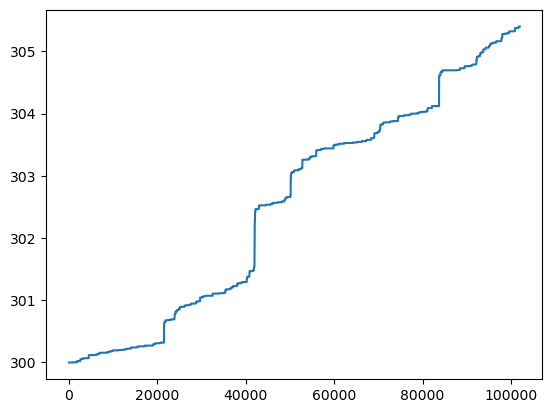

bnb_btc


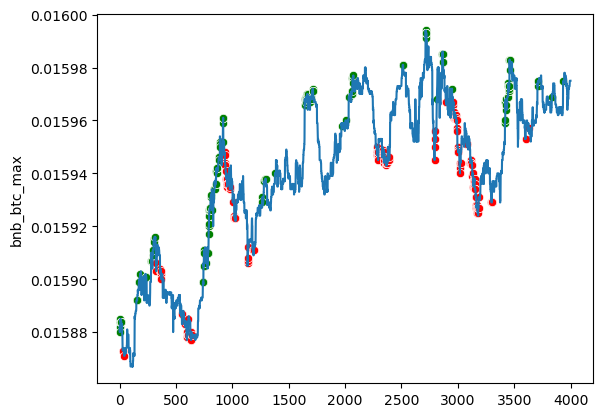

eth_btc


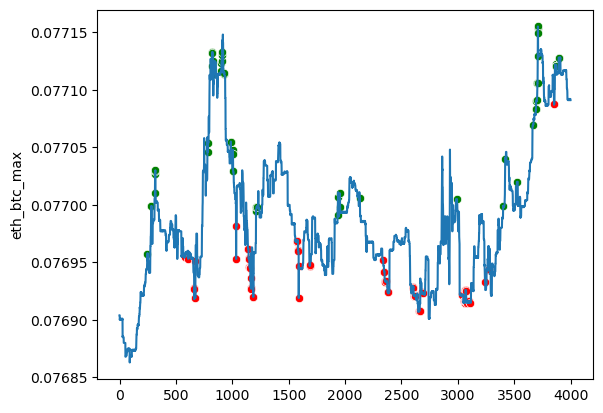

bnb_eth


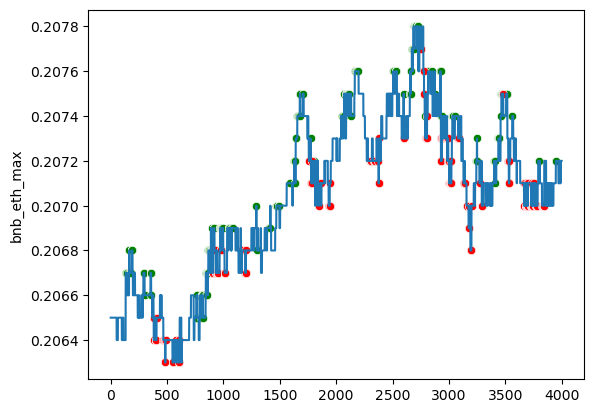

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 2, loss: 0.320
Traid counts: 23580 1: 3666 2: 3926 3: 2594 4: 2851 5: 3995 6: 6548
              precision    recall  f1-score   support

         0.0       1.00      0.77      0.87    101837
         1.0       0.00      0.52      0.01        31
         2.0       0.00      0.53      0.01        32
         3.0       0.00      0.52      0.01        21
         4.0       0.00      0.60      0.01        20
         5.0       0.01      0.69      0.01        35
         6.0       0.00      0.72      0.01        36

    accuracy                           0.77    102012
   macro avg       0.15      0.62      0.13    102012
weighted avg       1.00      0.77      0.87    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 305.45664806264045
Общая комиссия в usdt: 14.973540935472903
Число сделок: 649
Прибыль от 300 usdt за

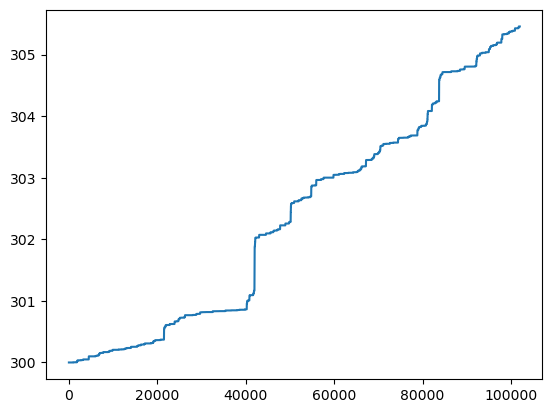

bnb_btc


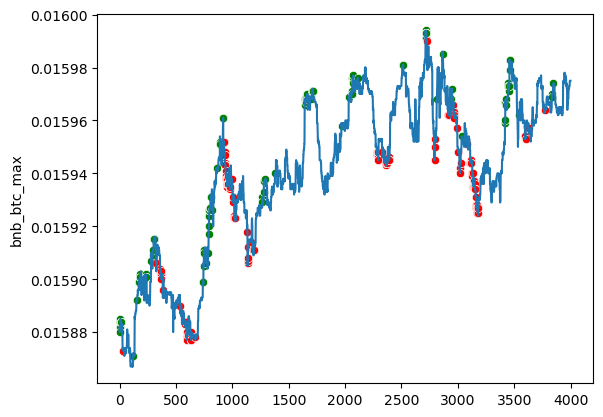

eth_btc


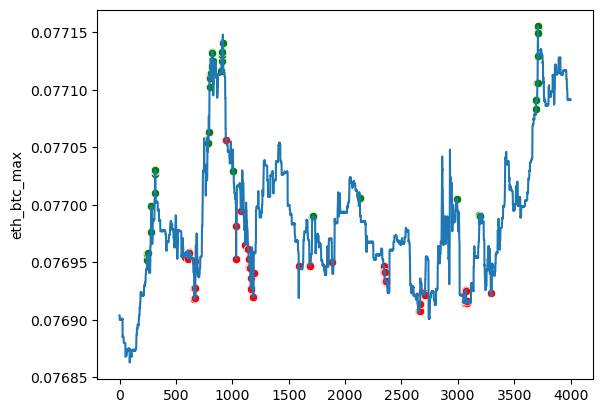

bnb_eth


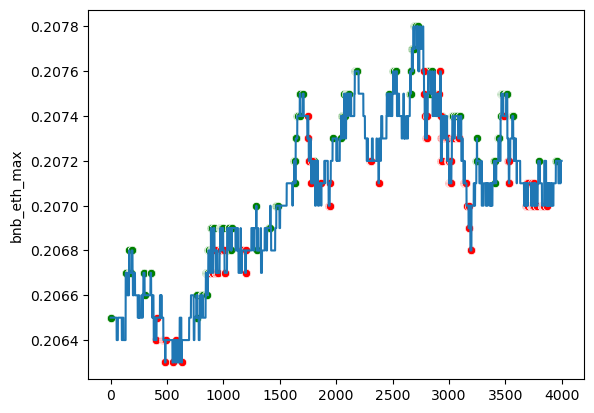

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 3, loss: 0.284
Traid counts: 22990 1: 3696 2: 4122 3: 2489 4: 2183 5: 3603 6: 6897
              precision    recall  f1-score   support

         0.0       1.00      0.78      0.87    101837
         1.0       0.00      0.42      0.01        31
         2.0       0.00      0.50      0.01        32
         3.0       0.00      0.43      0.01        21
         4.0       0.01      0.55      0.01        20
         5.0       0.01      0.71      0.01        35
         6.0       0.00      0.78      0.01        36

    accuracy                           0.78    102012
   macro avg       0.15      0.60      0.13    102012
weighted avg       1.00      0.78      0.87    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 304.32675899538424
Общая комиссия в usdt: 11.807074409230516
Число сделок: 589
Прибыль от 300 usdt за

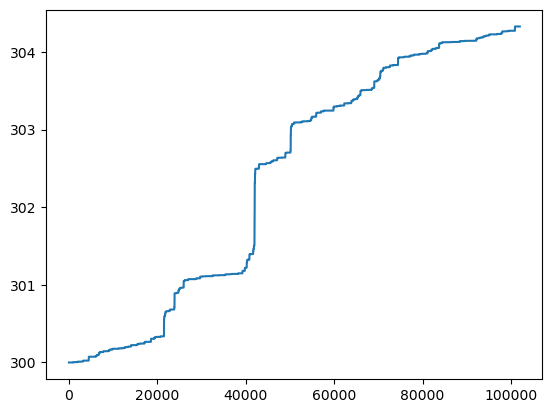

bnb_btc


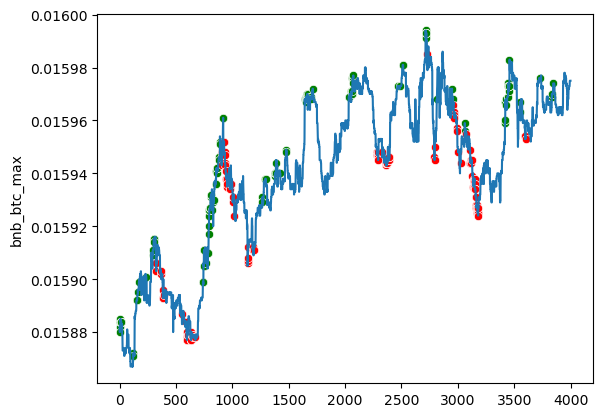

eth_btc


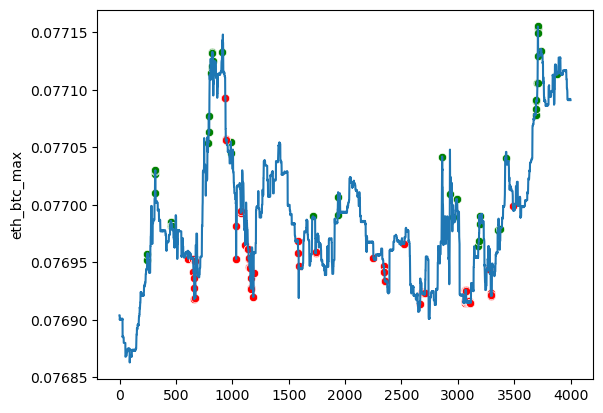

bnb_eth


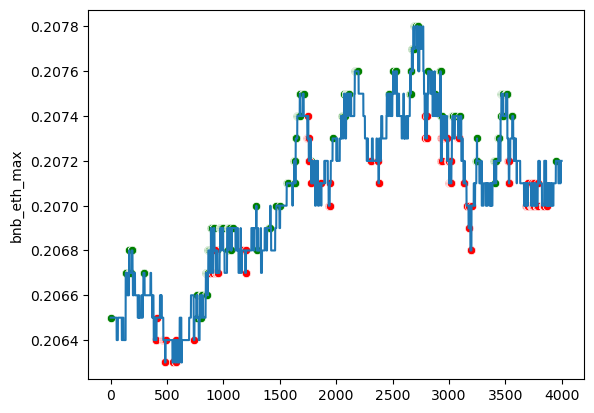

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 4, loss: 0.254
Traid counts: 20239 1: 3366 2: 2973 3: 2081 4: 2450 5: 3253 6: 6116
              precision    recall  f1-score   support

         0.0       1.00      0.80      0.89    101837
         1.0       0.00      0.52      0.01        31
         2.0       0.00      0.41      0.01        32
         3.0       0.00      0.48      0.01        21
         4.0       0.00      0.40      0.01        20
         5.0       0.01      0.80      0.02        35
         6.0       0.00      0.75      0.01        36

    accuracy                           0.80    102012
   macro avg       0.15      0.59      0.14    102012
weighted avg       1.00      0.80      0.89    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 304.7962169860086
Общая комиссия в usdt: 13.27074542184994
Число сделок: 558
Прибыль от 300 usdt за 1

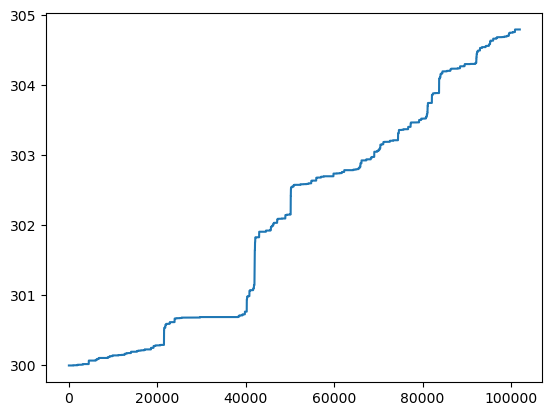

bnb_btc


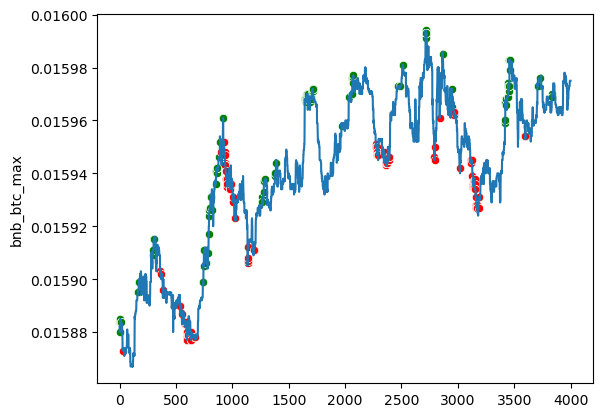

eth_btc


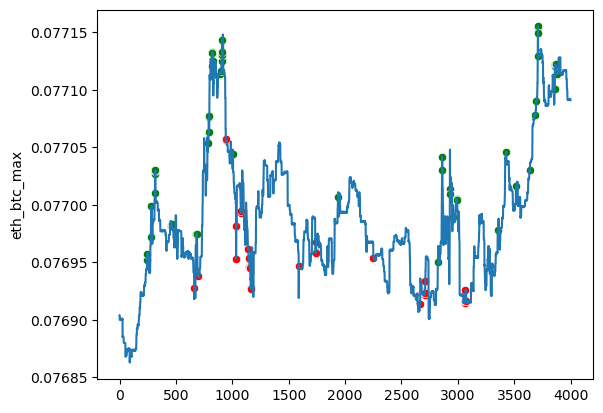

bnb_eth


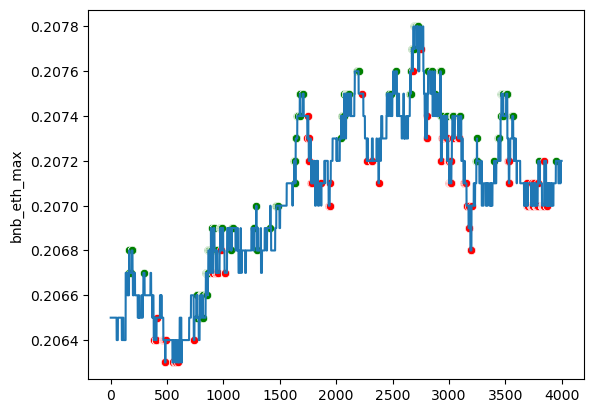

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 5, loss: 0.228
Traid counts: 17733 1: 3065 2: 2253 3: 1831 4: 1928 5: 3709 6: 4947
              precision    recall  f1-score   support

         0.0       1.00      0.83      0.91    101837
         1.0       0.00      0.35      0.01        31
         2.0       0.00      0.34      0.01        32
         3.0       0.01      0.48      0.01        21
         4.0       0.00      0.35      0.01        20
         5.0       0.01      0.83      0.02        35
         6.0       0.00      0.64      0.01        36

    accuracy                           0.83    102012
   macro avg       0.15      0.55      0.14    102012
weighted avg       1.00      0.83      0.90    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 304.9850736094642
Общая комиссия в usdt: 13.96875396980927
Число сделок: 633
Прибыль от 300 usdt за 1

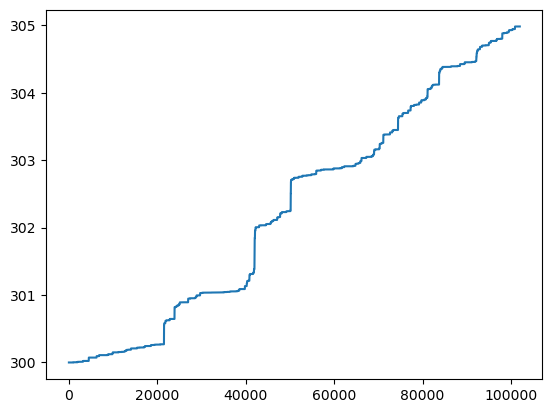

bnb_btc


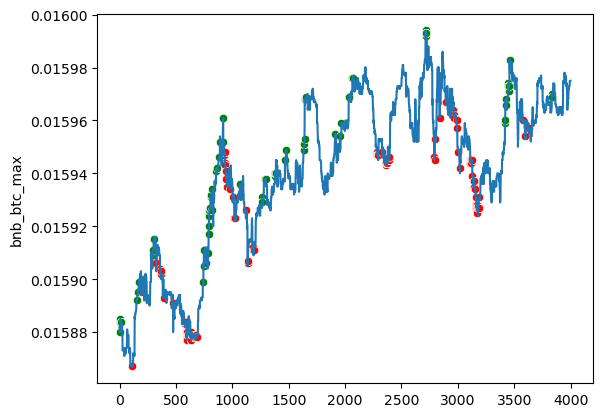

eth_btc


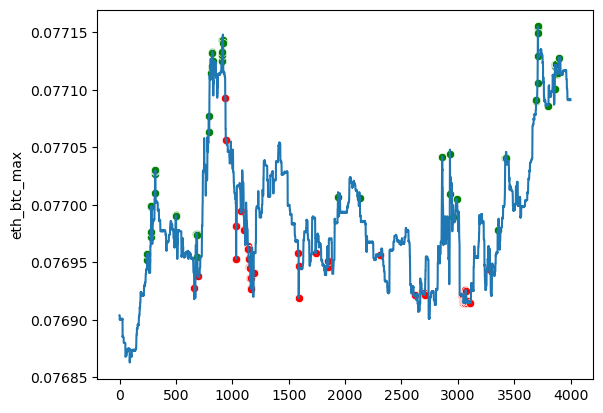

bnb_eth


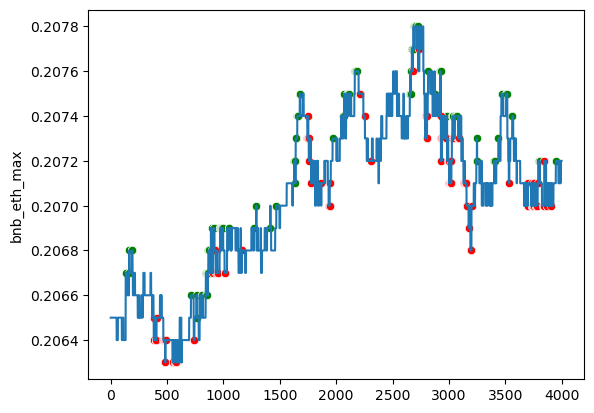

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 6, loss: 0.198
Traid counts: 16098 1: 3298 2: 1825 3: 1615 4: 2015 5: 3123 6: 4222
              precision    recall  f1-score   support

         0.0       1.00      0.84      0.91    101837
         1.0       0.00      0.42      0.01        31
         2.0       0.00      0.25      0.01        32
         3.0       0.01      0.52      0.01        21
         4.0       0.00      0.25      0.00        20
         5.0       0.01      0.69      0.02        35
         6.0       0.01      0.67      0.01        36

    accuracy                           0.84    102012
   macro avg       0.15      0.52      0.14    102012
weighted avg       1.00      0.84      0.91    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 305.3136892777321
Общая комиссия в usdt: 14.884148902502787
Число сделок: 547
Прибыль от 300 usdt за 

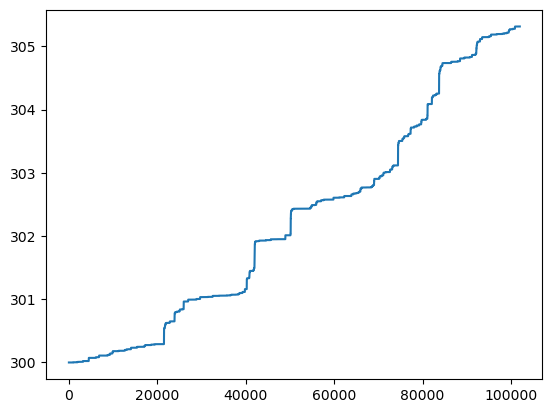

bnb_btc


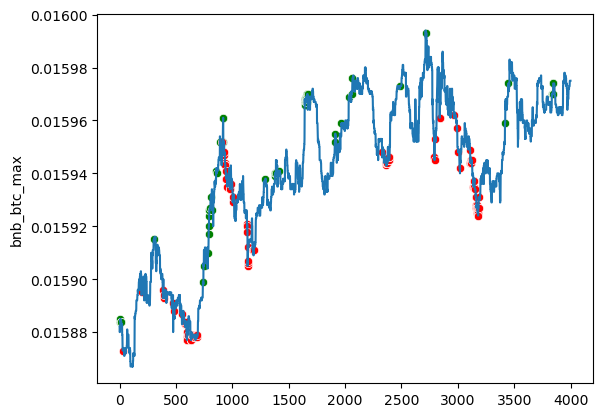

eth_btc


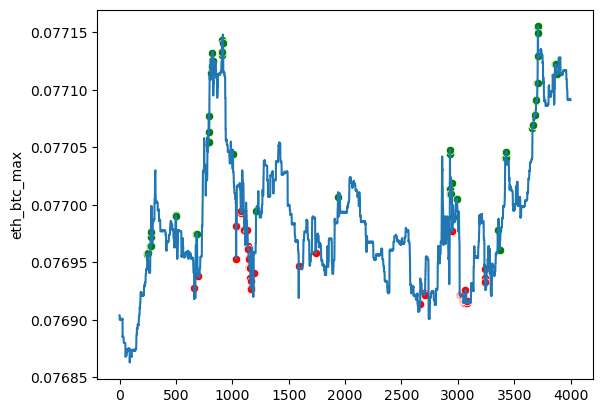

bnb_eth


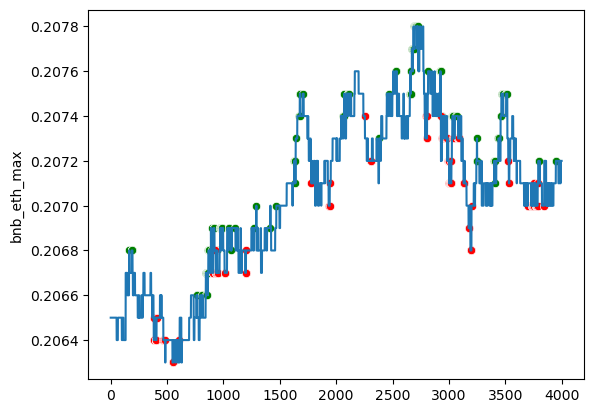

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 7, loss: 0.176
Traid counts: 16164 1: 3488 2: 2088 3: 1405 4: 1552 5: 3295 6: 4336
              precision    recall  f1-score   support

         0.0       1.00      0.84      0.91    101837
         1.0       0.00      0.42      0.01        31
         2.0       0.01      0.34      0.01        32
         3.0       0.01      0.38      0.01        21
         4.0       0.00      0.20      0.01        20
         5.0       0.01      0.80      0.02        35
         6.0       0.01      0.61      0.01        36

    accuracy                           0.84    102012
   macro avg       0.15      0.51      0.14    102012
weighted avg       1.00      0.84      0.91    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 306.15753790690786
Общая комиссия в usdt: 16.122551835612644
Число сделок: 560
Прибыль от 300 usdt за

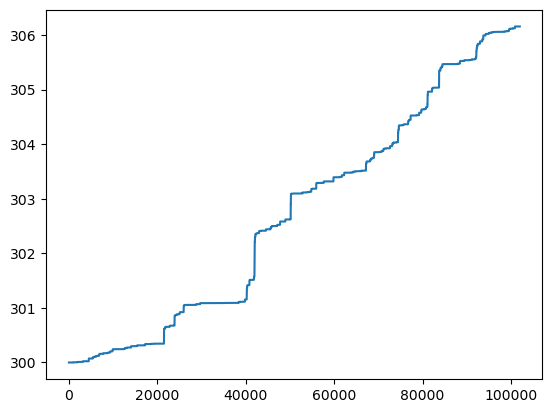

bnb_btc


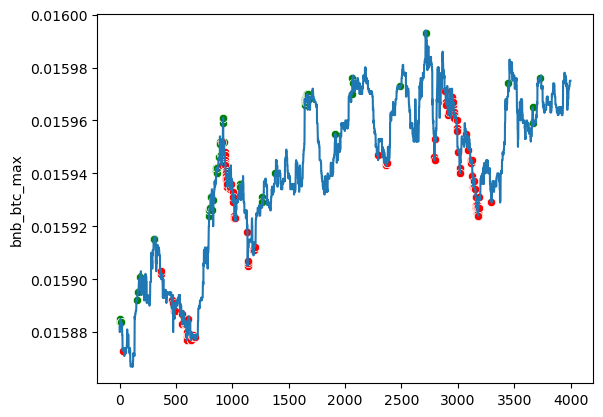

eth_btc


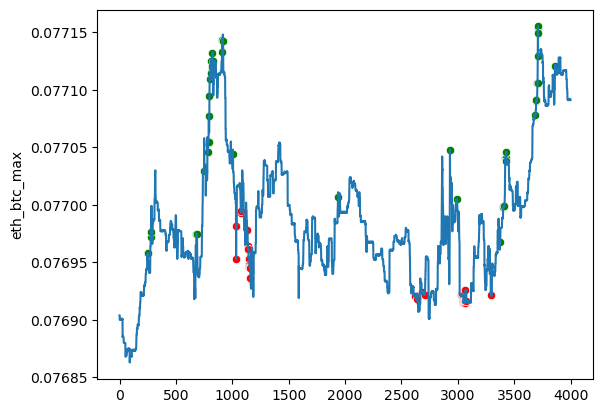

bnb_eth


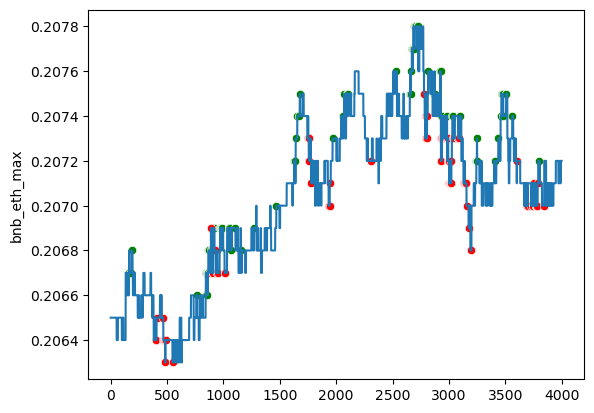

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 8, loss: 0.155
Traid counts: 15827 1: 3169 2: 2031 3: 1061 4: 1667 5: 3847 6: 4052
              precision    recall  f1-score   support

         0.0       1.00      0.85      0.92    101837
         1.0       0.00      0.29      0.01        31
         2.0       0.00      0.31      0.01        32
         3.0       0.01      0.43      0.02        21
         4.0       0.00      0.40      0.01        20
         5.0       0.01      0.66      0.01        35
         6.0       0.01      0.64      0.01        36

    accuracy                           0.85    102012
   macro avg       0.15      0.51      0.14    102012
weighted avg       1.00      0.85      0.91    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 305.74387710705065
Общая комиссия в usdt: 16.248939827293228
Число сделок: 626
Прибыль от 300 usdt за

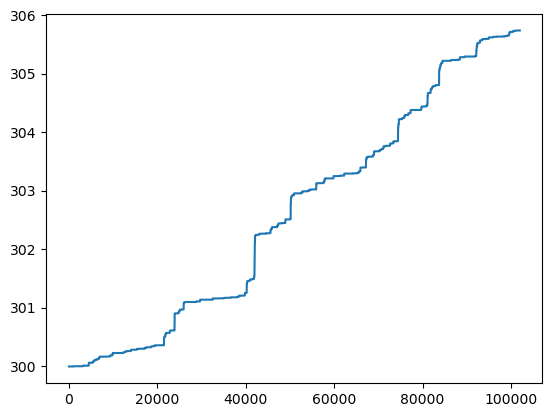

bnb_btc


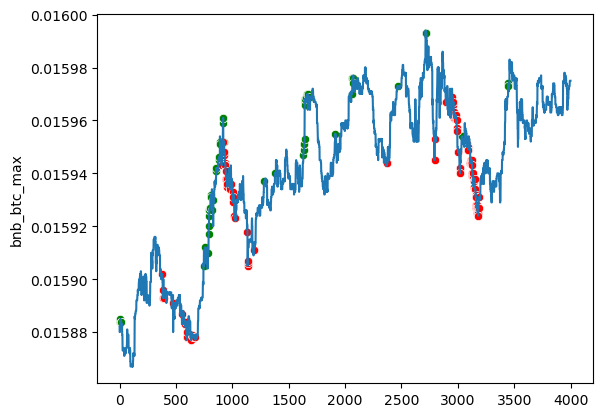

eth_btc


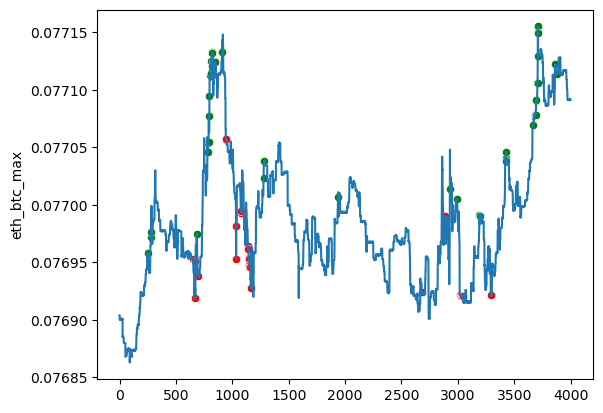

bnb_eth


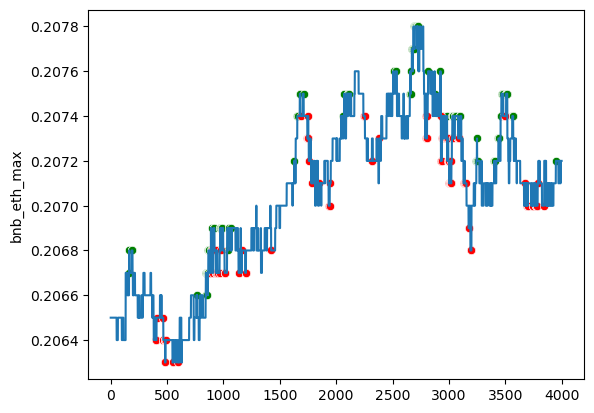

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 9, loss: 0.139
Traid counts: 13572 1: 2183 2: 1815 3: 1210 4: 1728 5: 3125 6: 3511
              precision    recall  f1-score   support

         0.0       1.00      0.87      0.93    101837
         1.0       0.00      0.16      0.00        31
         2.0       0.01      0.47      0.02        32
         3.0       0.01      0.38      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.66      0.01        35
         6.0       0.01      0.64      0.01        36

    accuracy                           0.87    102012
   macro avg       0.15      0.50      0.14    102012
weighted avg       1.00      0.87      0.93    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 305.0418656826589
Общая комиссия в usdt: 11.998654849223039
Число сделок: 485
Прибыль от 300 usdt за 

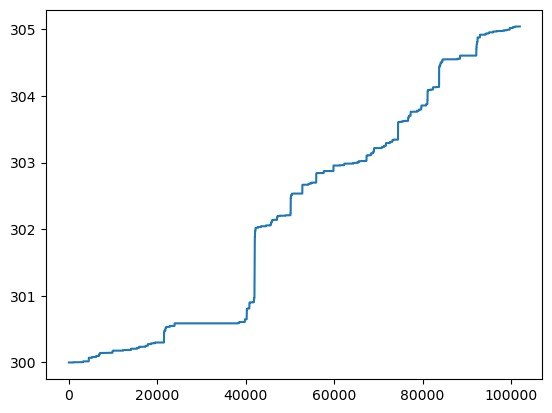

bnb_btc


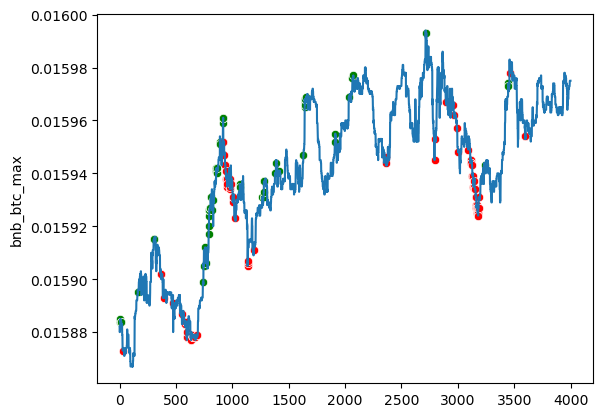

eth_btc


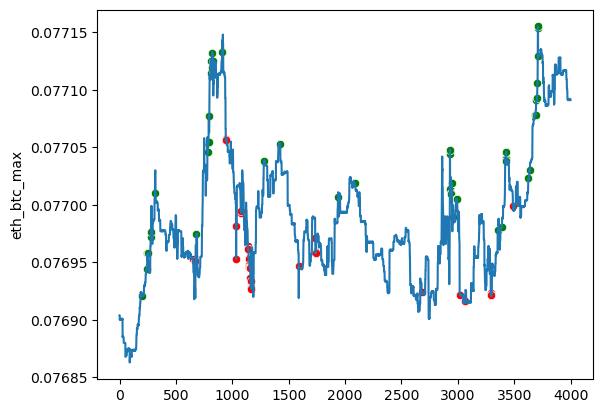

bnb_eth


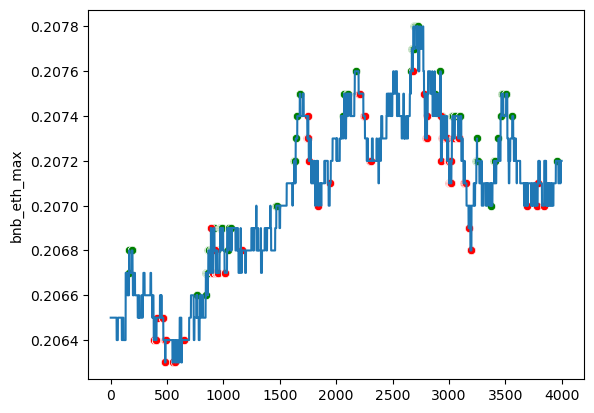

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 10, loss: 0.126
Traid counts: 14000 1: 2597 2: 1951 3: 1099 4: 1829 5: 2652 6: 3872
              precision    recall  f1-score   support

         0.0       1.00      0.86      0.93    101837
         1.0       0.00      0.13      0.00        31
         2.0       0.00      0.22      0.01        32
         3.0       0.01      0.38      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.71      0.02        35
         6.0       0.01      0.64      0.01        36

    accuracy                           0.86    102012
   macro avg       0.15      0.46      0.14    102012
weighted avg       1.00      0.86      0.92    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 305.2655576128169
Общая комиссия в usdt: 12.396901034728225
Число сделок: 467
Прибыль от 300 usdt за

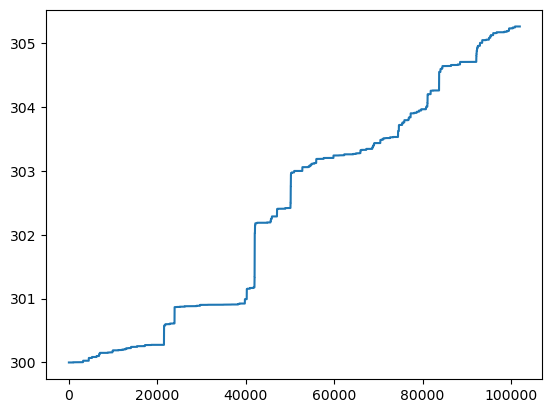

bnb_btc


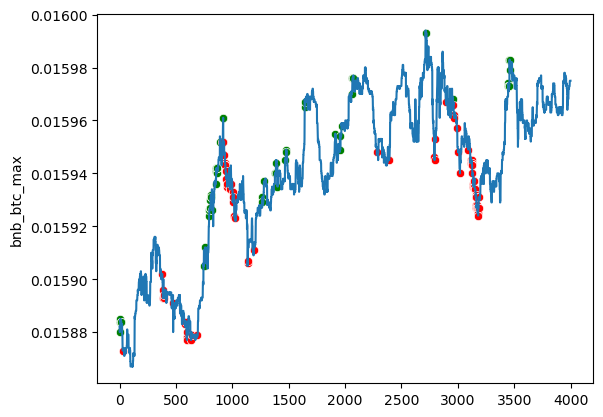

eth_btc


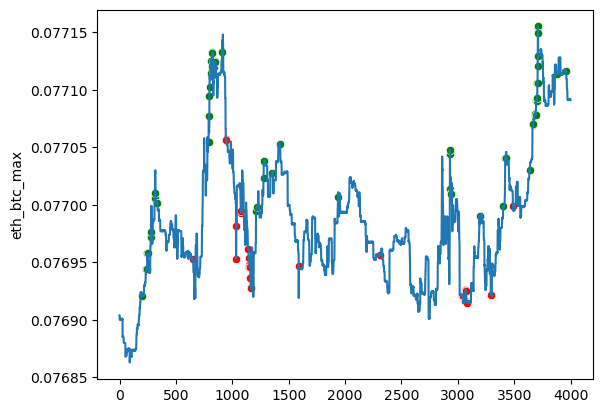

bnb_eth


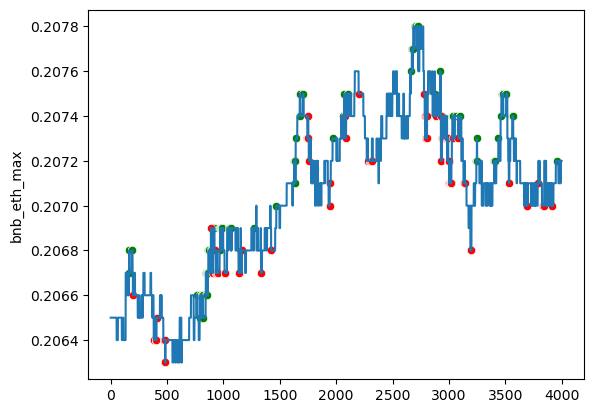

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 11, loss: 0.113
Traid counts: 14021 1: 2600 2: 2643 3: 976 4: 1315 5: 3040 6: 3447
              precision    recall  f1-score   support

         0.0       1.00      0.86      0.93    101837
         1.0       0.00      0.26      0.01        31
         2.0       0.01      0.47      0.01        32
         3.0       0.01      0.33      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.66      0.01        35
         6.0       0.01      0.61      0.01        36

    accuracy                           0.86    102012
   macro avg       0.15      0.49      0.14    102012
weighted avg       1.00      0.86      0.92    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 304.1711736954691
Общая комиссия в usdt: 11.27004375842178
Число сделок: 469
Прибыль от 300 usdt за 1

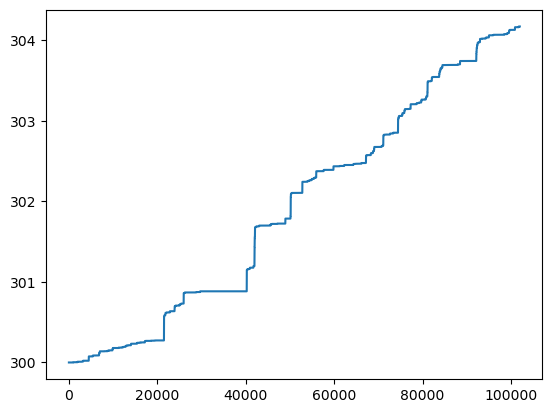

bnb_btc


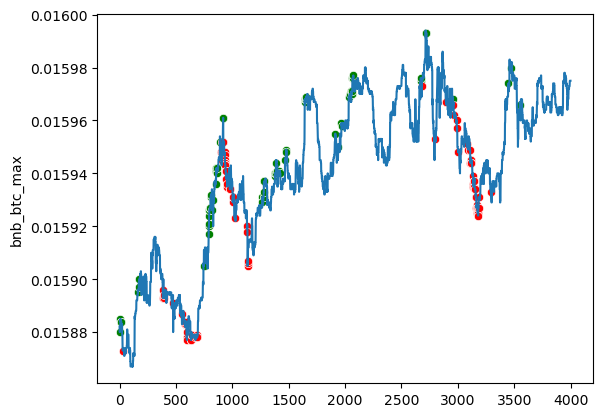

eth_btc


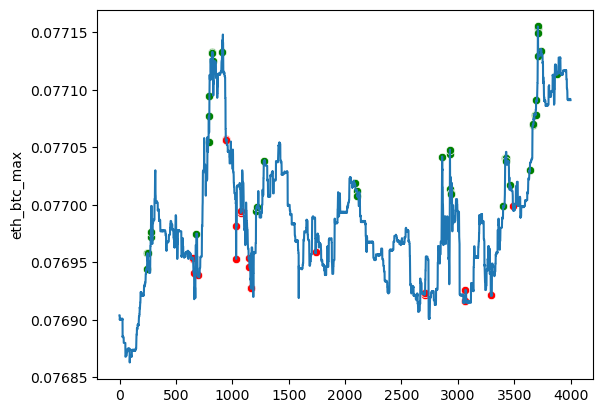

bnb_eth


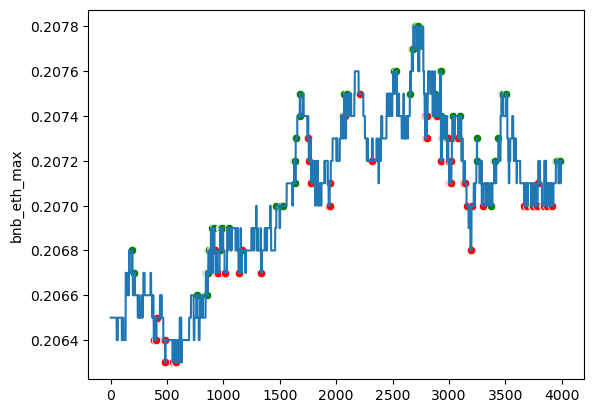

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 12, loss: 0.104
Traid counts: 12431 1: 2306 2: 2144 3: 883 4: 1228 5: 2483 6: 3387
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.94    101837
         1.0       0.00      0.19      0.01        31
         2.0       0.00      0.31      0.01        32
         3.0       0.01      0.33      0.02        21
         4.0       0.00      0.20      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.50      0.01        36

    accuracy                           0.88    102012
   macro avg       0.15      0.43      0.14    102012
weighted avg       1.00      0.88      0.93    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 304.50573384046606
Общая комиссия в usdt: 10.857651702977215
Число сделок: 438
Прибыль от 300 usdt за

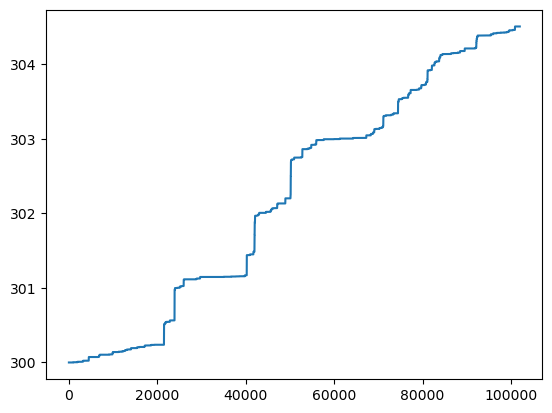

bnb_btc


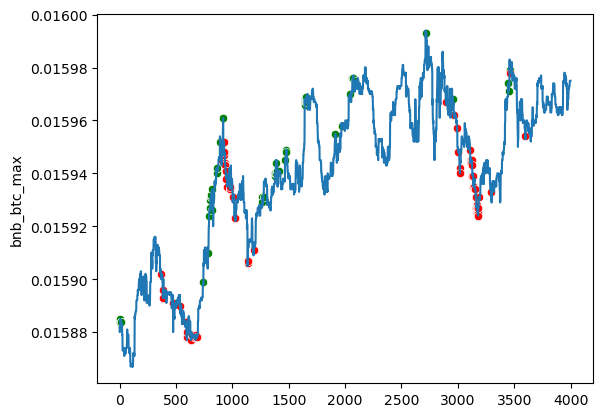

eth_btc


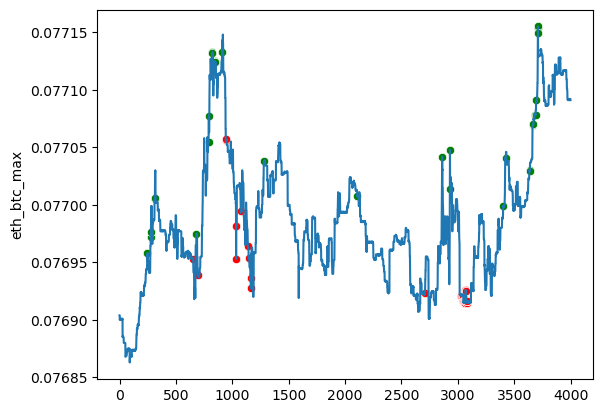

bnb_eth


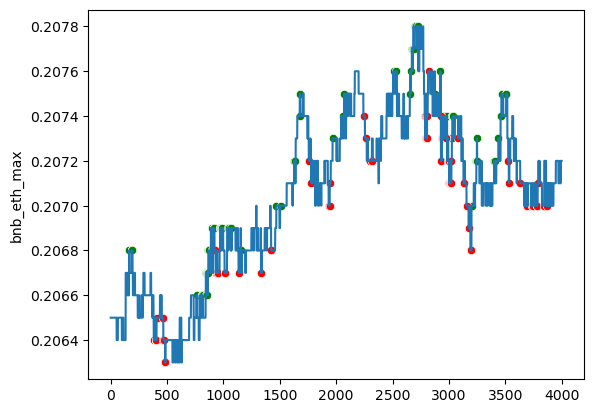

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 13, loss: 0.094
Traid counts: 12346 1: 2456 2: 2170 3: 1053 4: 1425 5: 2149 6: 3093
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.94    101837
         1.0       0.00      0.29      0.01        31
         2.0       0.01      0.34      0.01        32
         3.0       0.00      0.24      0.01        21
         4.0       0.01      0.40      0.01        20
         5.0       0.01      0.63      0.02        35
         6.0       0.01      0.50      0.01        36

    accuracy                           0.88    102012
   macro avg       0.15      0.47      0.14    102012
weighted avg       1.00      0.88      0.93    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 304.5129704601302
Общая комиссия в usdt: 10.334705508181234
Число сделок: 394
Прибыль от 300 usdt за

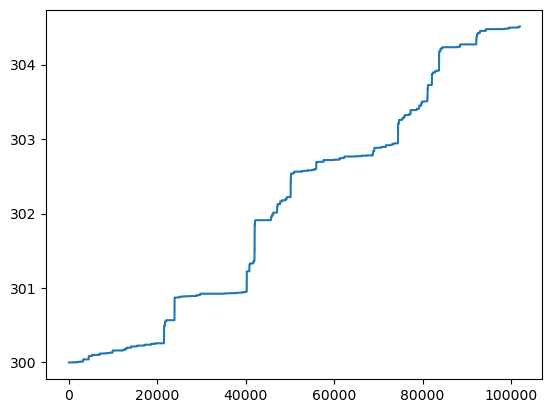

bnb_btc


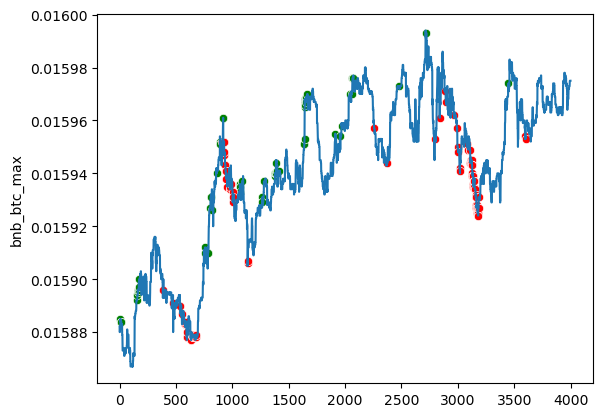

eth_btc


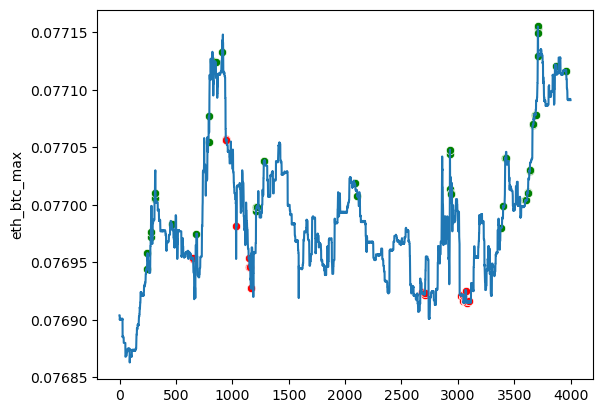

bnb_eth


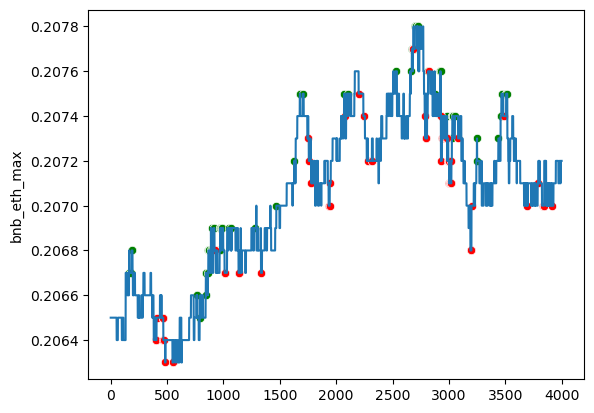

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 14, loss: 0.088
Traid counts: 11562 1: 2378 2: 2205 3: 1142 4: 897 5: 2100 6: 2840
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    101837
         1.0       0.00      0.29      0.01        31
         2.0       0.00      0.22      0.01        32
         3.0       0.01      0.33      0.01        21
         4.0       0.00      0.20      0.01        20
         5.0       0.01      0.60      0.02        35
         6.0       0.01      0.44      0.01        36

    accuracy                           0.89    102012
   macro avg       0.15      0.42      0.14    102012
weighted avg       1.00      0.89      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 304.1630229790666
Общая комиссия в usdt: 9.748259337040237
Число сделок: 381
Прибыль от 300 usdt за 1

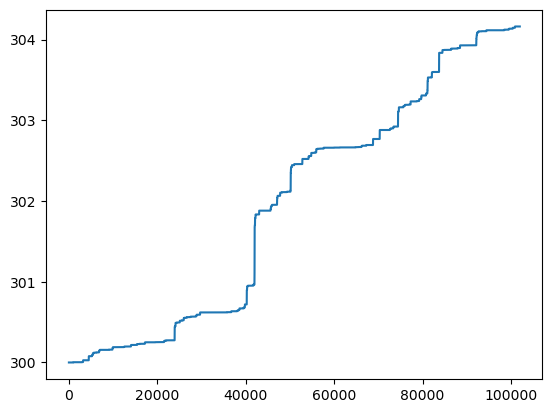

bnb_btc


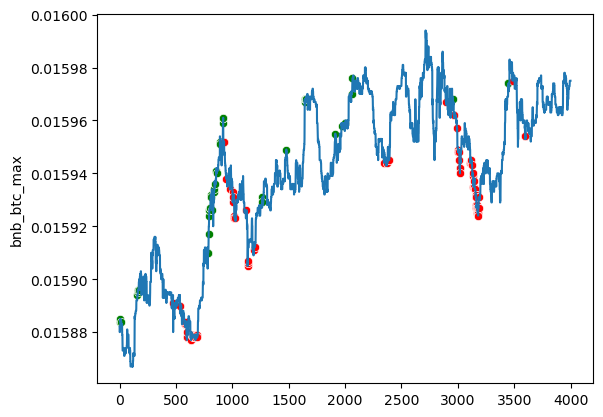

eth_btc


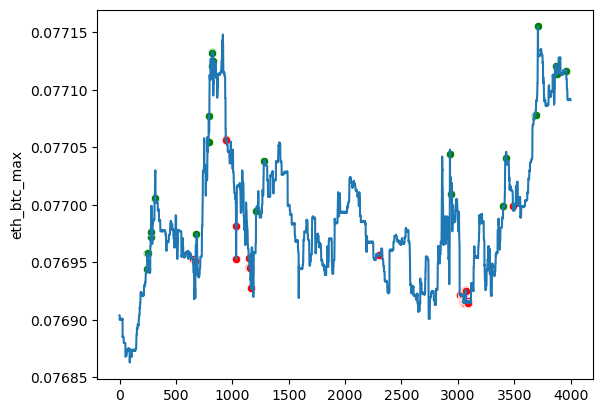

bnb_eth


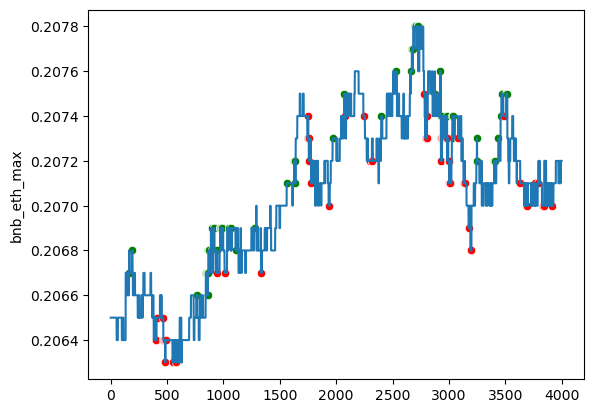

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 15, loss: 0.079
Traid counts: 12551 1: 2525 2: 2097 3: 1015 4: 1477 5: 2580 6: 2857
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.93    101837
         1.0       0.00      0.10      0.00        31
         2.0       0.00      0.25      0.01        32
         3.0       0.01      0.38      0.02        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.66      0.02        35
         6.0       0.01      0.53      0.01        36

    accuracy                           0.88    102012
   macro avg       0.15      0.43      0.14    102012
weighted avg       1.00      0.88      0.93    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 304.0305463107392
Общая комиссия в usdt: 9.936163582959304
Число сделок: 447
Прибыль от 300 usdt за 

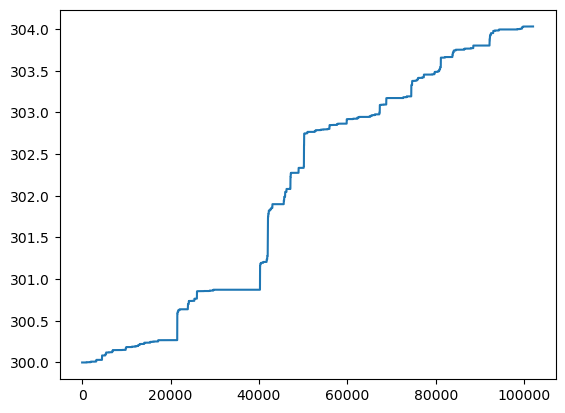

bnb_btc


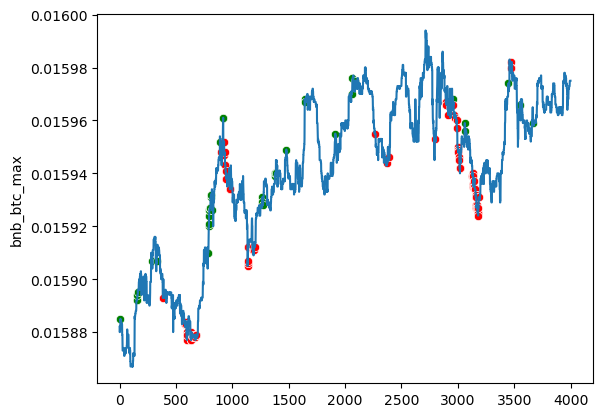

eth_btc


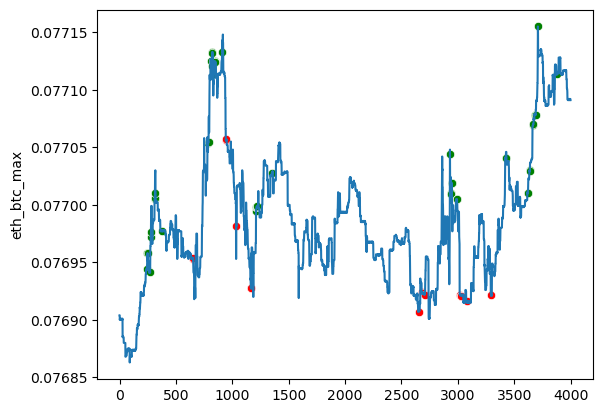

bnb_eth


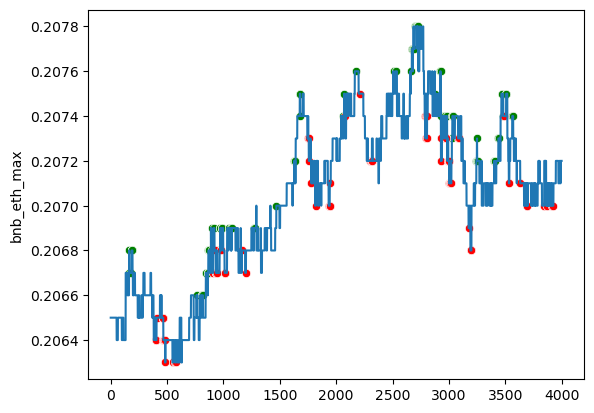

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 16, loss: 0.075
Traid counts: 11172 1: 2289 2: 1955 3: 914 4: 1243 5: 2010 6: 2761
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    101837
         1.0       0.00      0.19      0.01        31
         2.0       0.01      0.31      0.01        32
         3.0       0.01      0.43      0.02        21
         4.0       0.00      0.15      0.00        20
         5.0       0.01      0.63      0.02        35
         6.0       0.00      0.36      0.01        36

    accuracy                           0.89    102012
   macro avg       0.15      0.42      0.14    102012
weighted avg       1.00      0.89      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 304.054016649786
Общая комиссия в usdt: 9.302465640742266
Число сделок: 369
Прибыль от 300 usdt за 10

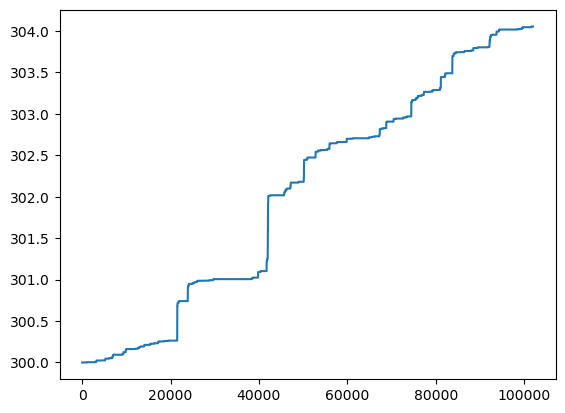

bnb_btc


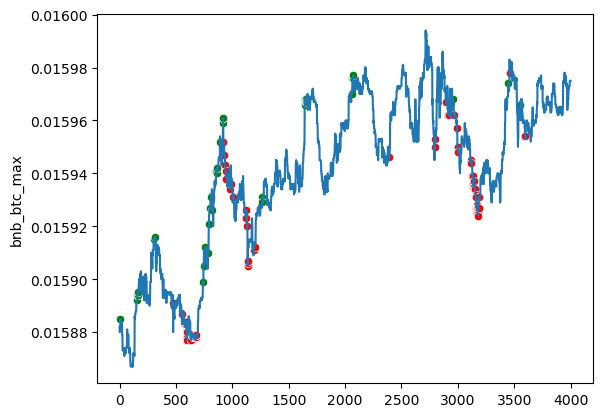

eth_btc


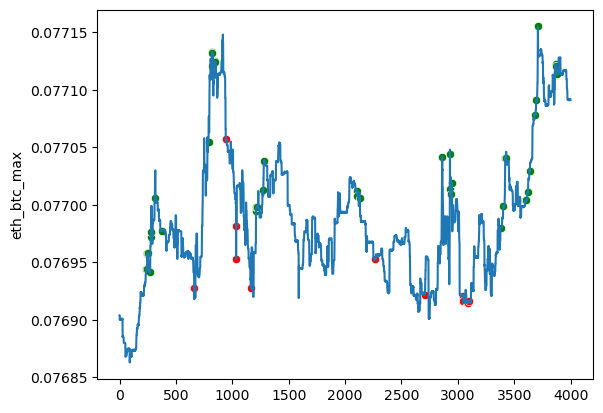

bnb_eth


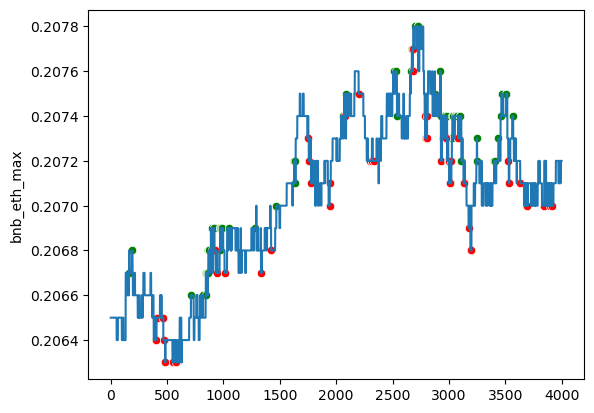

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 17, loss: 0.071
Traid counts: 10606 1: 2129 2: 1710 3: 839 4: 1134 5: 1905 6: 2889
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.16      0.00        31
         2.0       0.00      0.25      0.01        32
         3.0       0.01      0.38      0.02        21
         4.0       0.00      0.15      0.01        20
         5.0       0.01      0.66      0.02        35
         6.0       0.01      0.44      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.42      0.15    102012
weighted avg       1.00      0.90      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 304.0361552552329
Общая комиссия в usdt: 9.725876612527147
Число сделок: 345
Прибыль от 300 usdt за 1

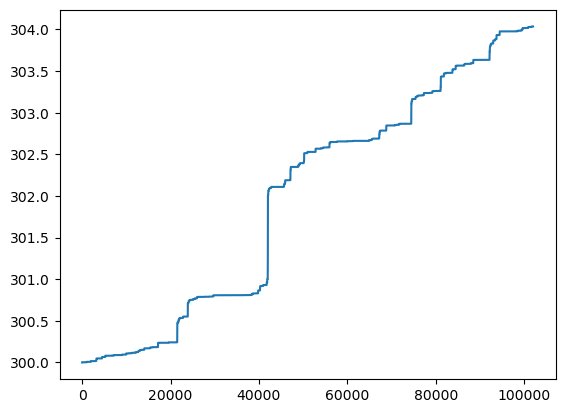

bnb_btc


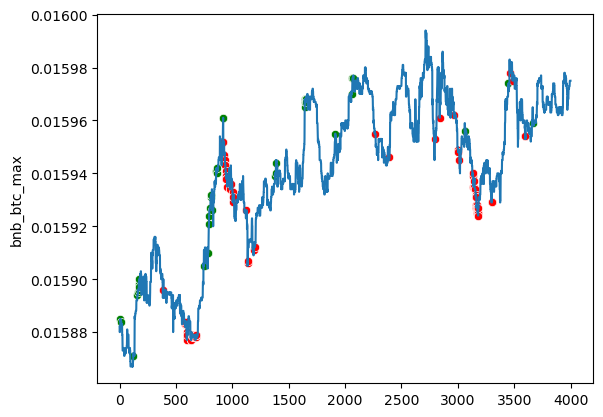

eth_btc


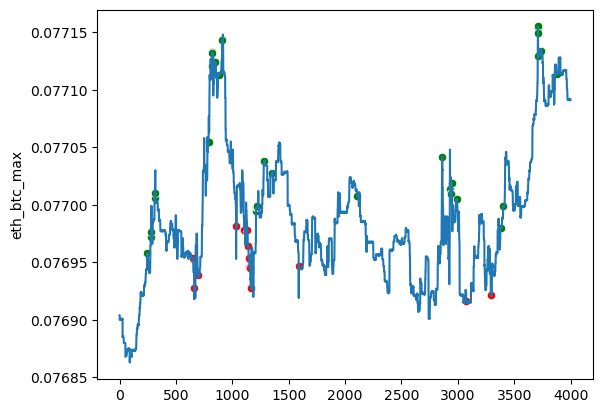

bnb_eth


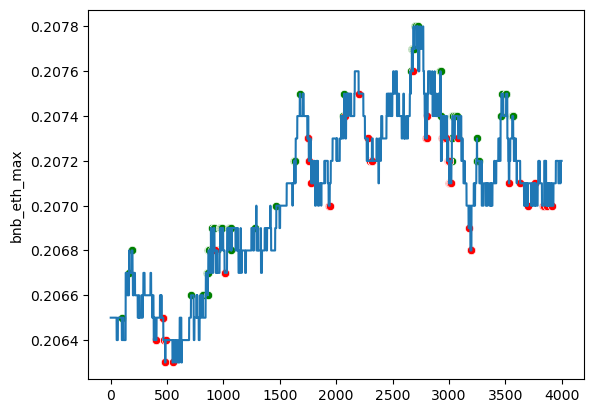

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 18, loss: 0.066
Traid counts: 11428 1: 2246 2: 2065 3: 1090 4: 1134 5: 1960 6: 2933
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    101837
         1.0       0.00      0.16      0.00        31
         2.0       0.00      0.31      0.01        32
         3.0       0.01      0.33      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.54      0.02        35
         6.0       0.00      0.28      0.01        36

    accuracy                           0.89    102012
   macro avg       0.15      0.40      0.14    102012
weighted avg       1.00      0.89      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 304.1533615165252
Общая комиссия в usdt: 9.139006779919926
Число сделок: 356
Прибыль от 300 usdt за 

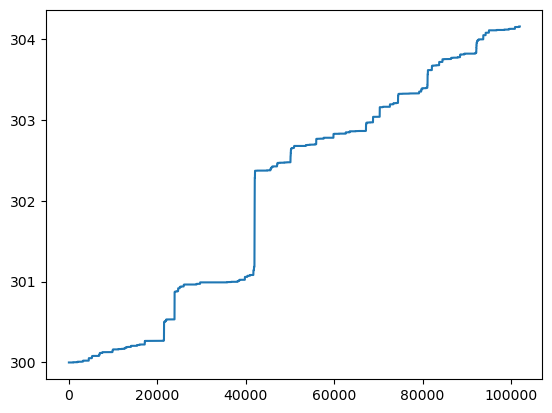

bnb_btc


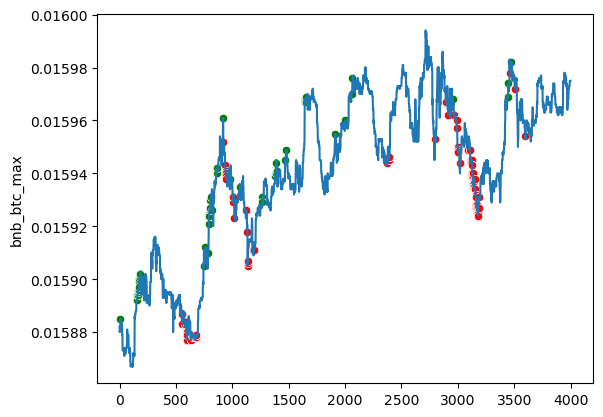

eth_btc


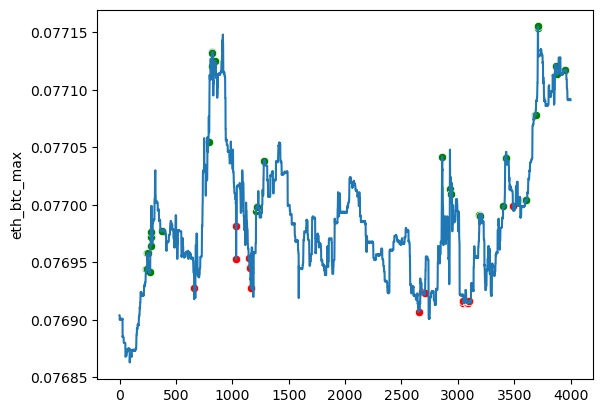

bnb_eth


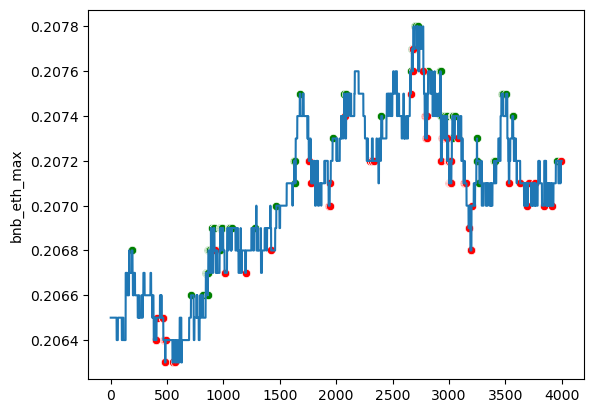

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 19, loss: 0.063
Traid counts: 10954 1: 1833 2: 1714 3: 935 4: 1353 5: 2036 6: 3083
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    101837
         1.0       0.00      0.29      0.01        31
         2.0       0.01      0.34      0.01        32
         3.0       0.01      0.38      0.02        21
         4.0       0.01      0.35      0.01        20
         5.0       0.01      0.63      0.02        35
         6.0       0.01      0.44      0.01        36

    accuracy                           0.89    102012
   macro avg       0.15      0.48      0.15    102012
weighted avg       1.00      0.89      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 304.0004430547591
Общая комиссия в usdt: 9.770861865608198
Число сделок: 368
Прибыль от 300 usdt за 1

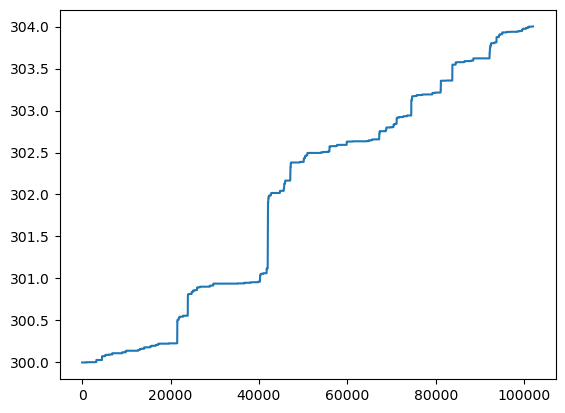

bnb_btc


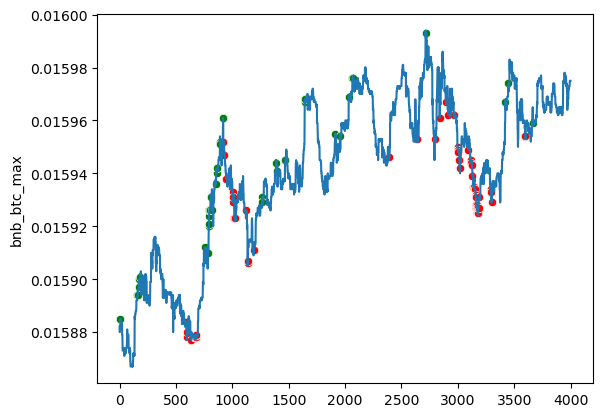

eth_btc


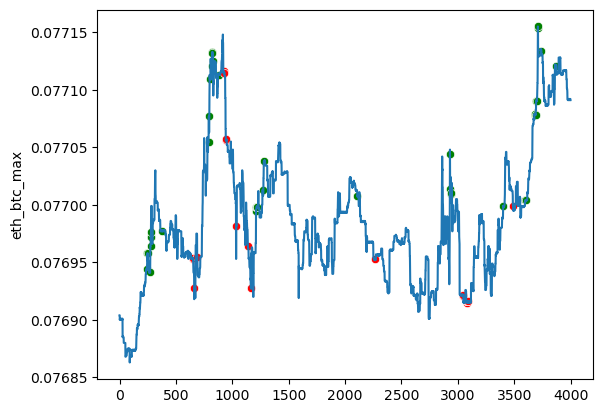

bnb_eth


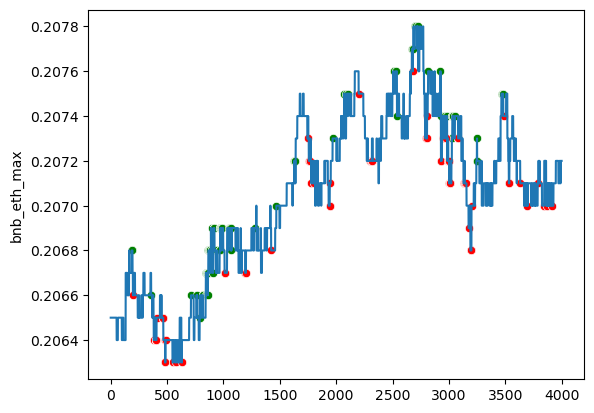

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 20, loss: 0.058
Traid counts: 11236 1: 1960 2: 1608 3: 1145 4: 1584 5: 1780 6: 3159
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    101837
         1.0       0.00      0.19      0.01        31
         2.0       0.00      0.25      0.01        32
         3.0       0.01      0.48      0.02        21
         4.0       0.00      0.35      0.01        20
         5.0       0.01      0.63      0.02        35
         6.0       0.00      0.42      0.01        36

    accuracy                           0.89    102012
   macro avg       0.15      0.46      0.15    102012
weighted avg       1.00      0.89      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.57320659001704
Общая комиссия в usdt: 9.635908556770419
Число сделок: 334
Прибыль от 300 usdt за

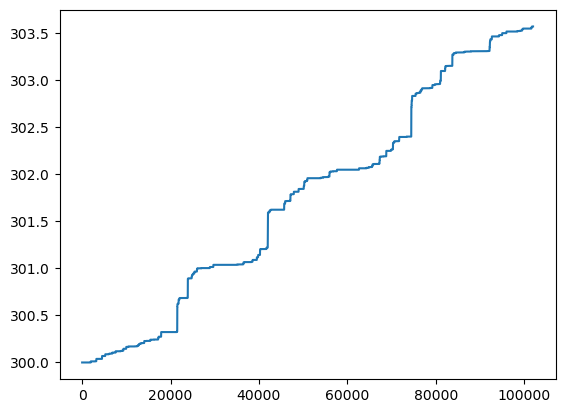

bnb_btc


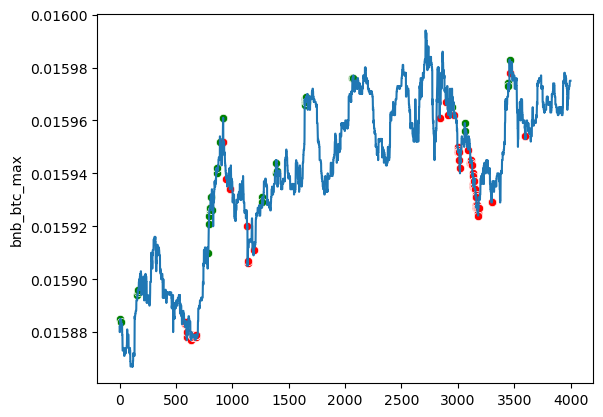

eth_btc


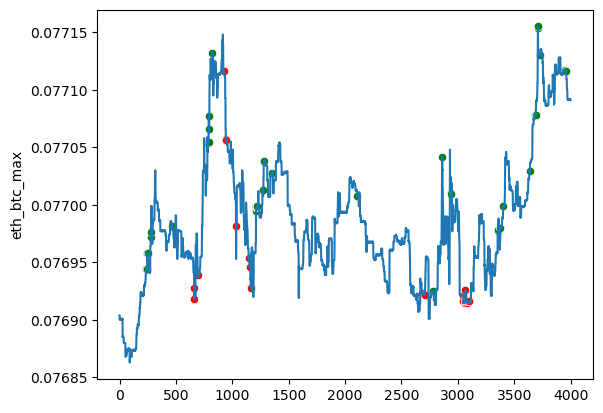

bnb_eth


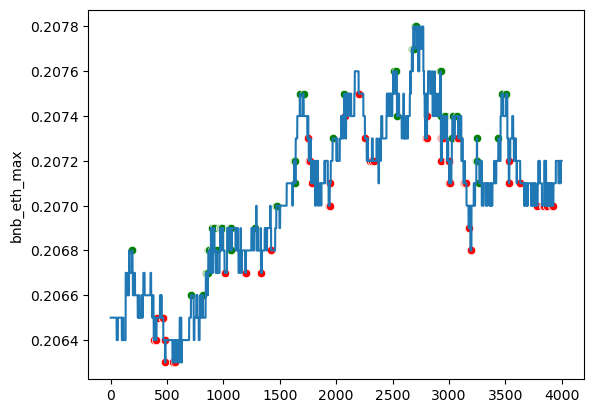

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 21, loss: 0.056
Traid counts: 10386 1: 1840 2: 1474 3: 999 4: 1317 5: 1884 6: 2872
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.10      0.00        31
         2.0       0.00      0.16      0.01        32
         3.0       0.01      0.24      0.01        21
         4.0       0.01      0.45      0.01        20
         5.0       0.01      0.60      0.02        35
         6.0       0.01      0.47      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.42      0.14    102012
weighted avg       1.00      0.90      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.77765569744764
Общая комиссия в usdt: 8.593864697952823
Число сделок: 312
Прибыль от 300 usdt за 

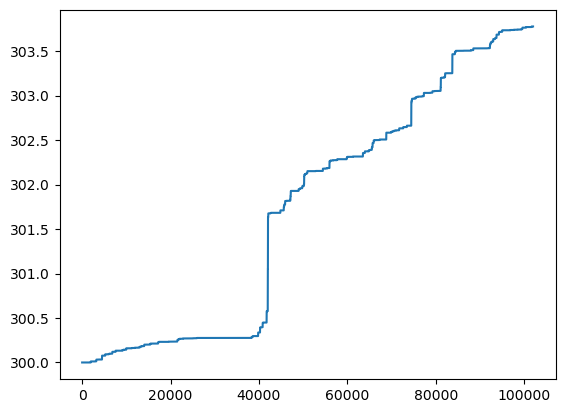

bnb_btc


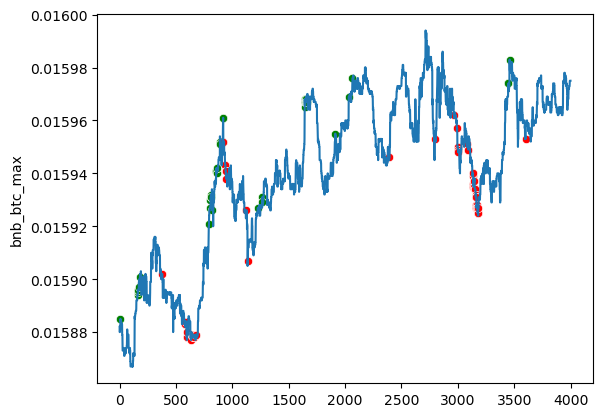

eth_btc


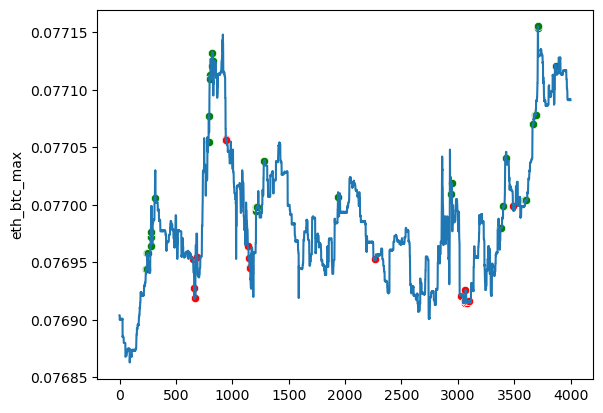

bnb_eth


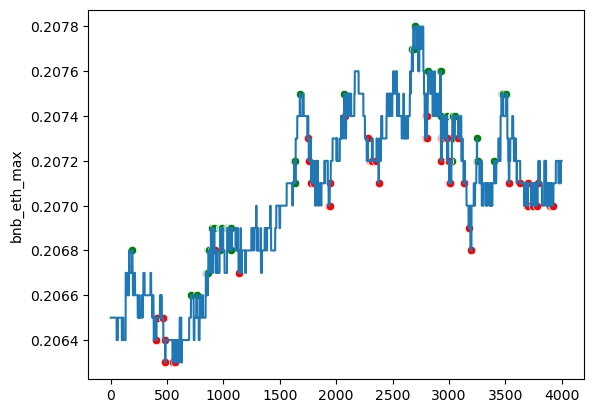

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 22, loss: 0.052
Traid counts: 10189 1: 1887 2: 1481 3: 962 4: 1206 5: 1904 6: 2749
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.13      0.00        31
         2.0       0.00      0.22      0.01        32
         3.0       0.01      0.38      0.02        21
         4.0       0.01      0.40      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.42      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.43      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.92991377959083
Общая комиссия в usdt: 10.324305334442846
Число сделок: 335
Прибыль от 300 usdt за

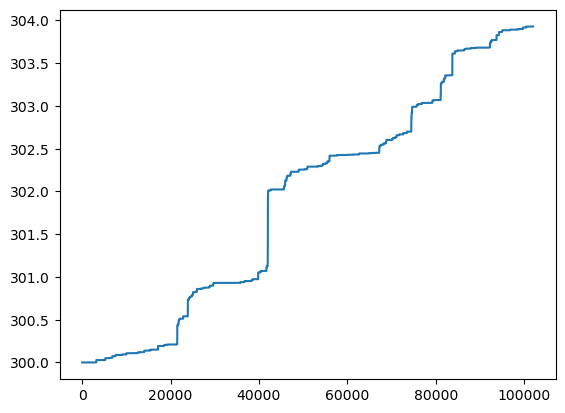

bnb_btc


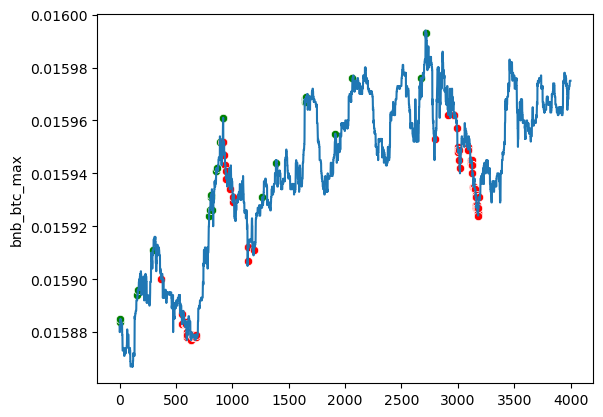

eth_btc


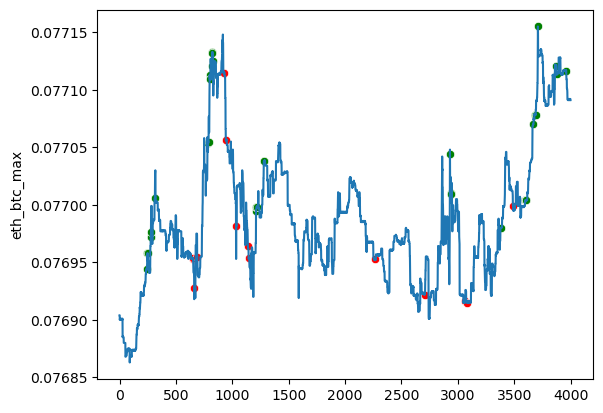

bnb_eth


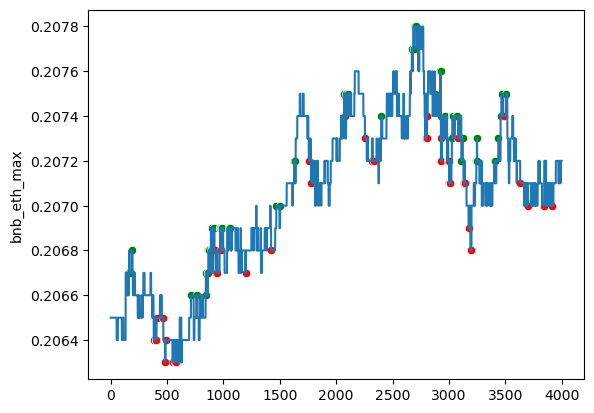

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 23, loss: 0.050
Traid counts: 10652 1: 1797 2: 1853 3: 1336 4: 1322 5: 1631 6: 2713
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.19      0.01        31
         2.0       0.01      0.34      0.01        32
         3.0       0.00      0.24      0.01        21
         4.0       0.01      0.45      0.01        20
         5.0       0.01      0.54      0.02        35
         6.0       0.01      0.44      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.44      0.15    102012
weighted avg       1.00      0.90      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.53371269365243
Общая комиссия в usdt: 7.96446361518374
Число сделок: 297
Прибыль от 300 usdt за 

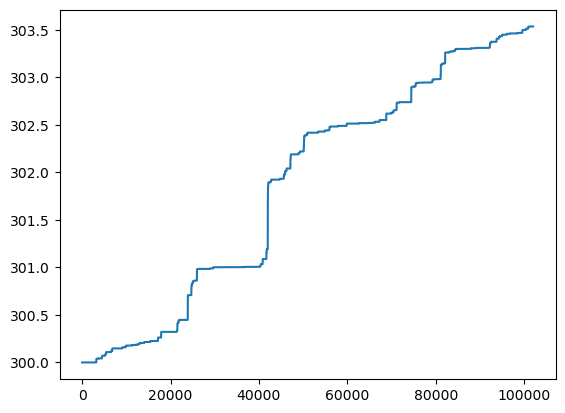

bnb_btc


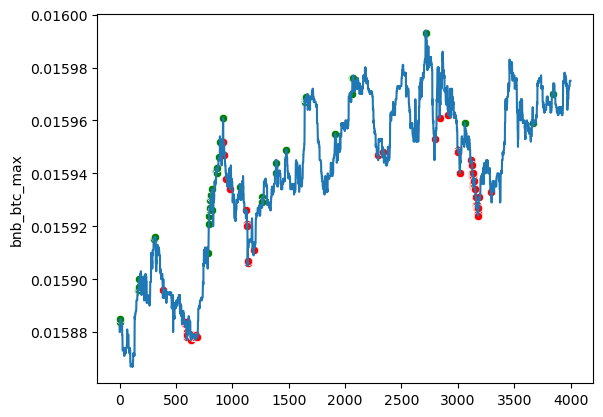

eth_btc


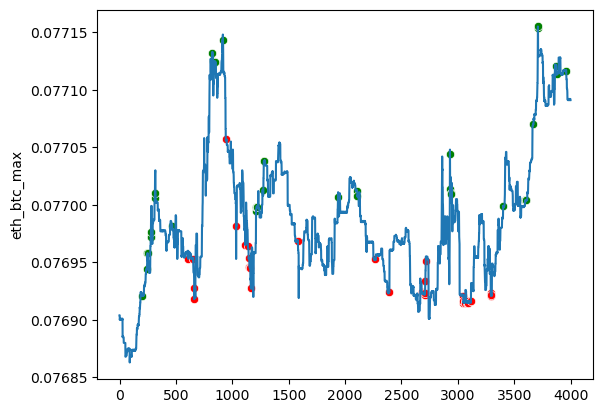

bnb_eth


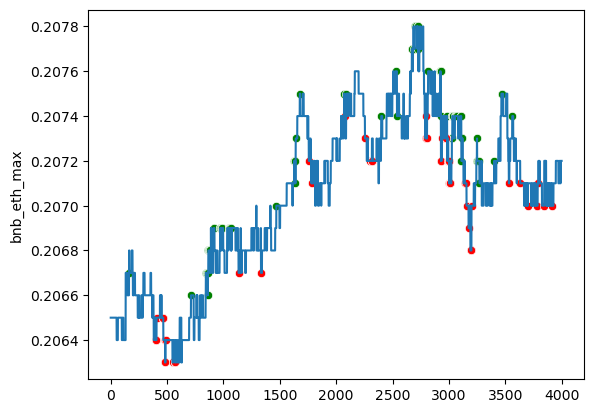

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 24, loss: 0.047
Traid counts: 11277 1: 1860 2: 1732 3: 1040 4: 1276 5: 2131 6: 3238
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    101837
         1.0       0.00      0.19      0.01        31
         2.0       0.00      0.19      0.01        32
         3.0       0.00      0.19      0.01        21
         4.0       0.01      0.45      0.01        20
         5.0       0.01      0.60      0.02        35
         6.0       0.01      0.50      0.01        36

    accuracy                           0.89    102012
   macro avg       0.15      0.43      0.14    102012
weighted avg       1.00      0.89      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 304.7093713493358
Общая комиссия в usdt: 10.286161861472886
Число сделок: 382
Прибыль от 300 usdt за

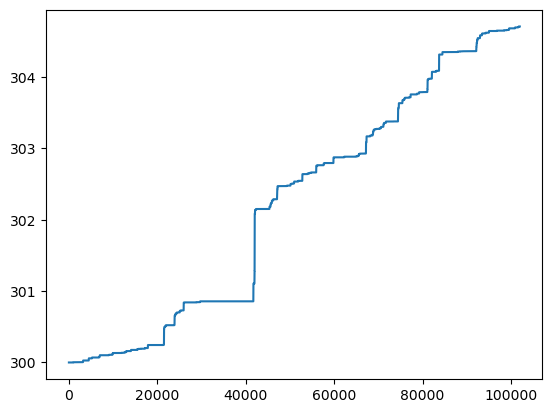

bnb_btc


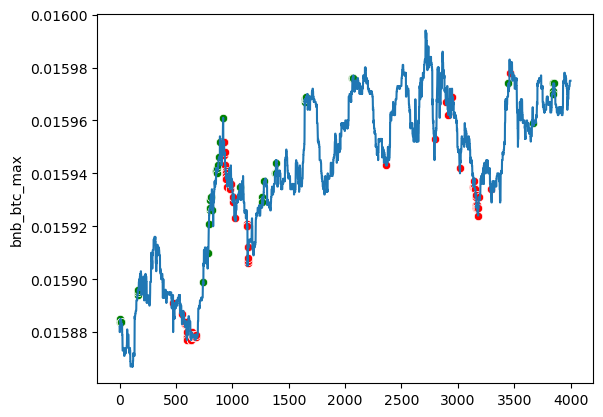

eth_btc


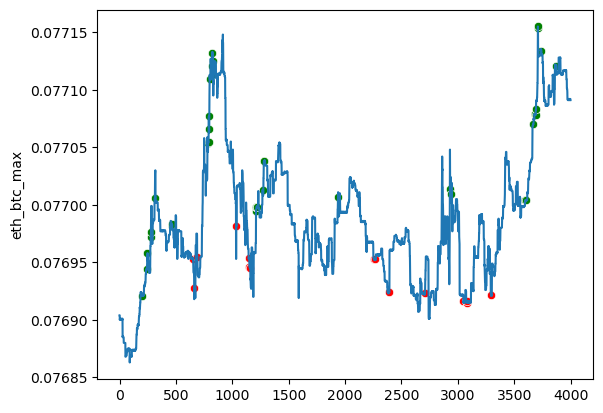

bnb_eth


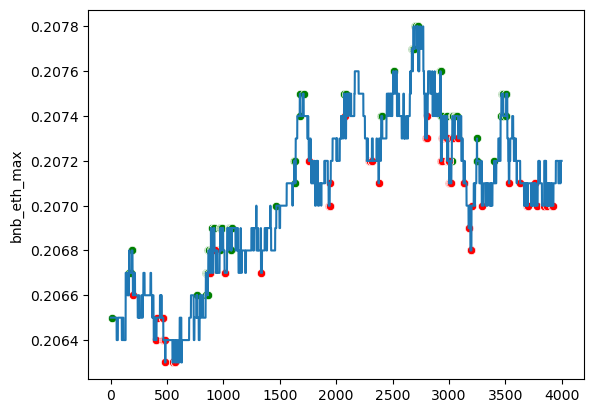

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 25, loss: 0.047
Traid counts: 10878 1: 2132 2: 1557 3: 1178 4: 1397 5: 1959 6: 2655
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    101837
         1.0       0.00      0.19      0.01        31
         2.0       0.00      0.22      0.01        32
         3.0       0.01      0.43      0.02        21
         4.0       0.01      0.35      0.01        20
         5.0       0.01      0.46      0.02        35
         6.0       0.01      0.39      0.01        36

    accuracy                           0.89    102012
   macro avg       0.15      0.42      0.14    102012
weighted avg       1.00      0.89      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 304.28345423725193
Общая комиссия в usdt: 9.819949682072593
Число сделок: 353
Прибыль от 300 usdt за

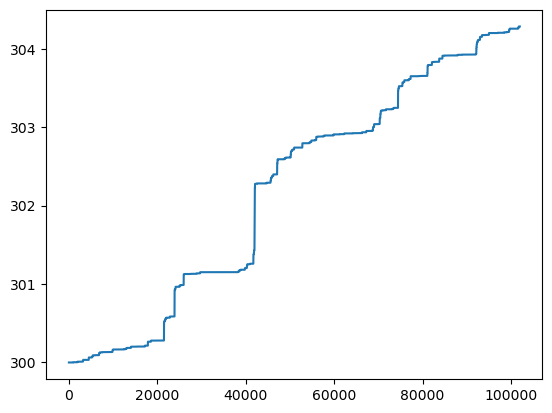

bnb_btc


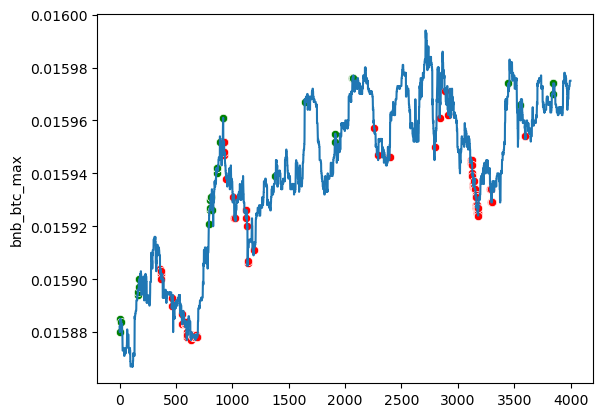

eth_btc


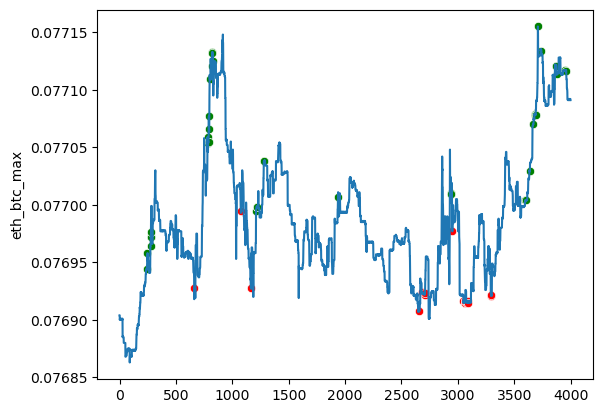

bnb_eth


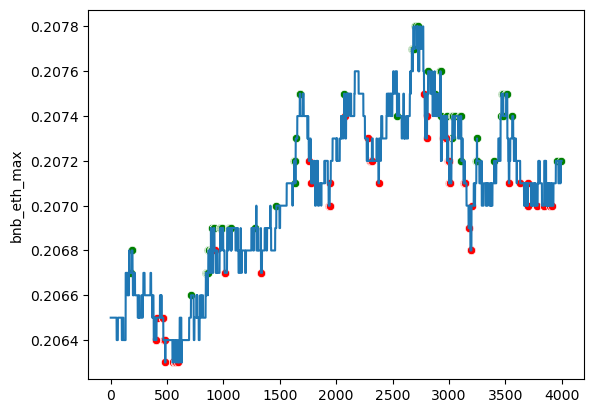

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 26, loss: 0.043
Traid counts: 10008 1: 1970 2: 1311 3: 1065 4: 1219 5: 1873 6: 2570
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.19      0.01        31
         2.0       0.00      0.16      0.01        32
         3.0       0.00      0.24      0.01        21
         4.0       0.01      0.40      0.01        20
         5.0       0.01      0.54      0.02        35
         6.0       0.01      0.44      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.41      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.0862372805237
Общая комиссия в usdt: 7.287609525045214
Число сделок: 344
Прибыль от 300 usdt за 

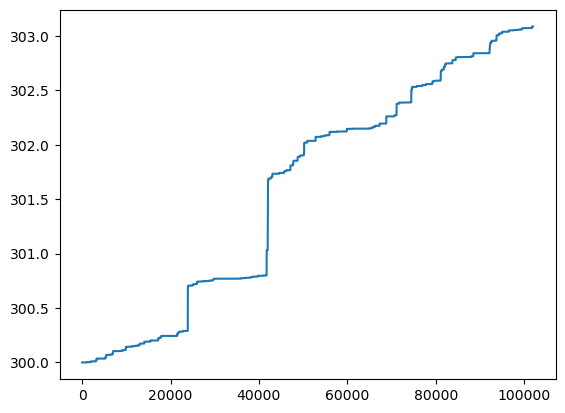

bnb_btc


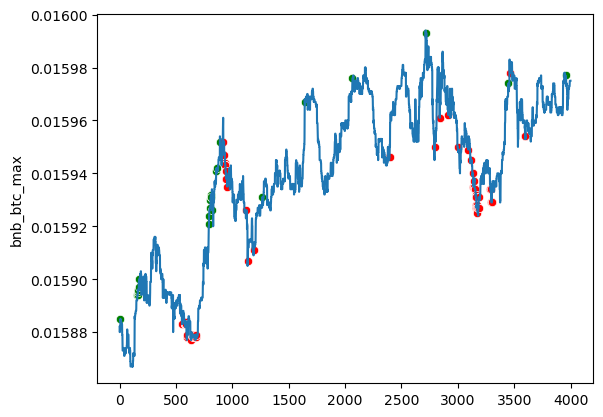

eth_btc


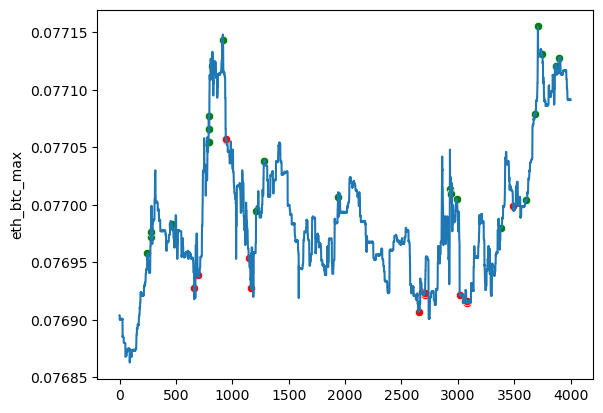

bnb_eth


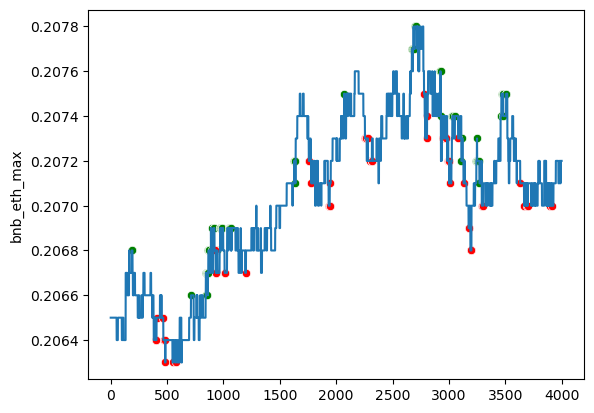

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 27, loss: 0.043
Traid counts: 10401 1: 2042 2: 1549 3: 951 4: 1219 5: 2070 6: 2570
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.26      0.01        31
         2.0       0.00      0.19      0.01        32
         3.0       0.00      0.10      0.00        21
         4.0       0.01      0.45      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.47      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.42      0.14    102012
weighted avg       1.00      0.90      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.5156191487217
Общая комиссия в usdt: 7.8308756682917116
Число сделок: 333
Прибыль от 300 usdt за 

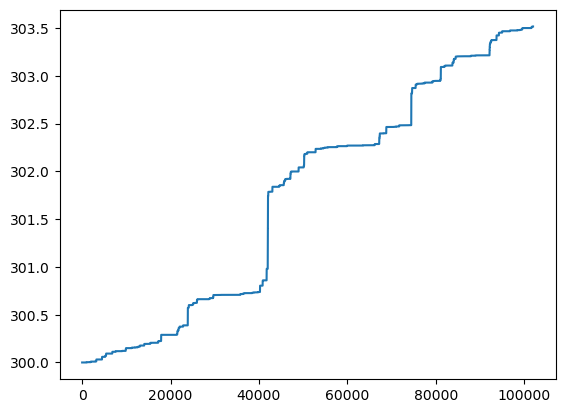

bnb_btc


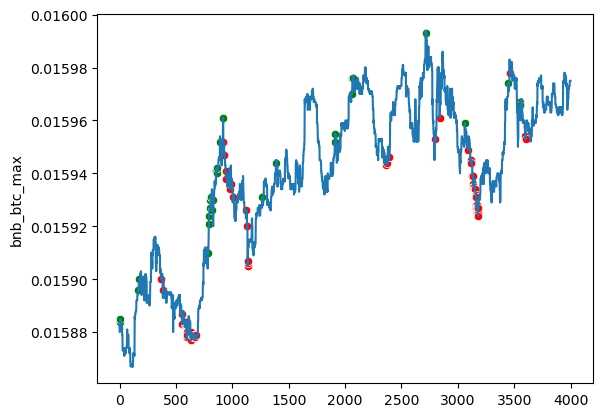

eth_btc


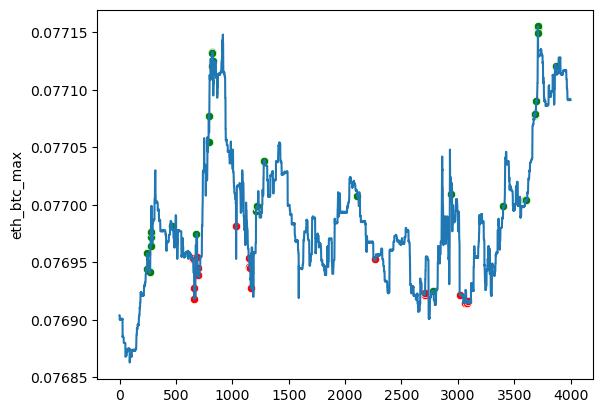

bnb_eth


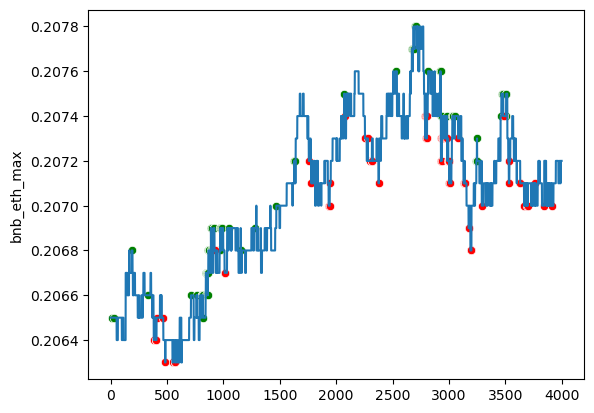

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 28, loss: 0.041
Traid counts: 10044 1: 1849 2: 1328 3: 856 4: 1344 5: 1914 6: 2753
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.23      0.01        31
         2.0       0.01      0.25      0.01        32
         3.0       0.01      0.24      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.63      0.02        35
         6.0       0.01      0.50      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.43      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.3285194893656
Общая комиссия в usdt: 8.487720608909976
Число сделок: 336
Прибыль от 300 usdt за 1

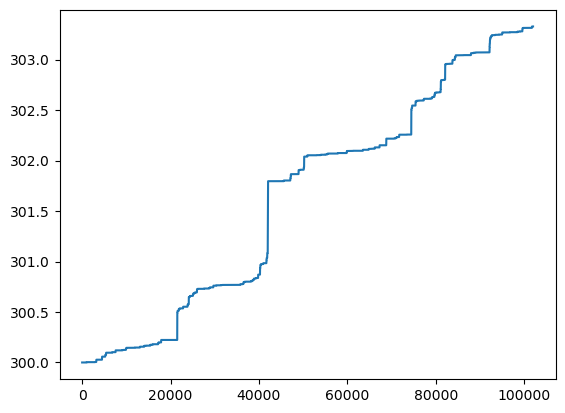

bnb_btc


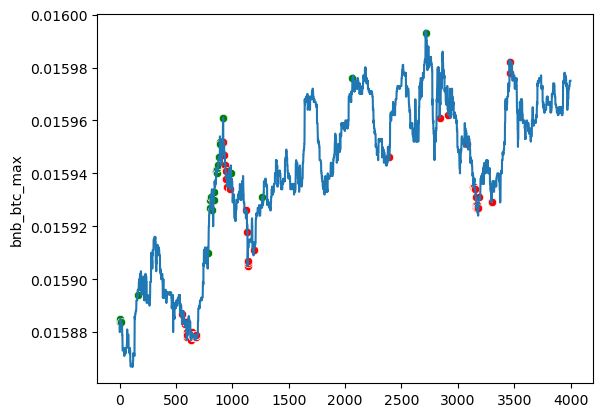

eth_btc


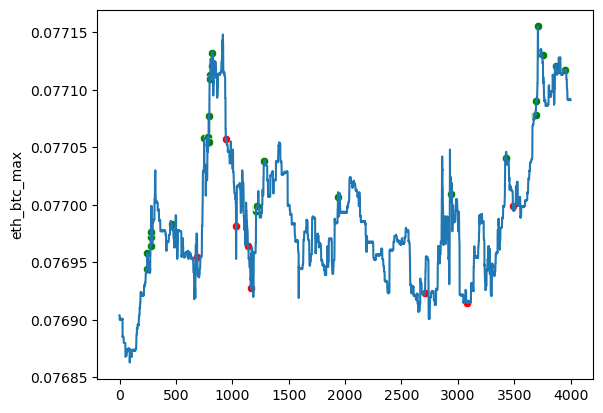

bnb_eth


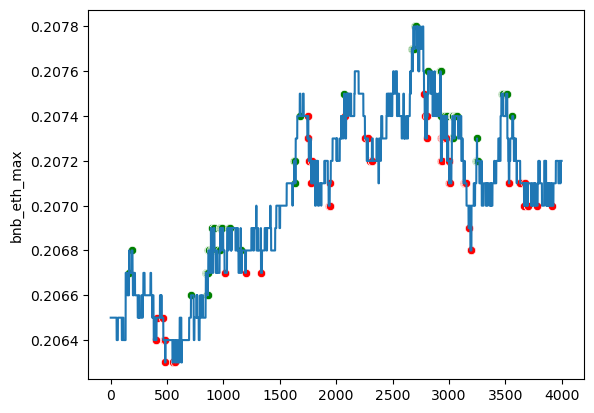

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 29, loss: 0.040
Traid counts: 11505 1: 2142 2: 2223 3: 1033 4: 1611 5: 2029 6: 2467
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    101837
         1.0       0.00      0.26      0.01        31
         2.0       0.00      0.34      0.01        32
         3.0       0.00      0.14      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.60      0.02        35
         6.0       0.00      0.31      0.01        36

    accuracy                           0.89    102012
   macro avg       0.15      0.41      0.14    102012
weighted avg       1.00      0.89      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.05893278428596
Общая комиссия в usdt: 8.035888072345003
Число сделок: 355
Прибыль от 300 usdt за

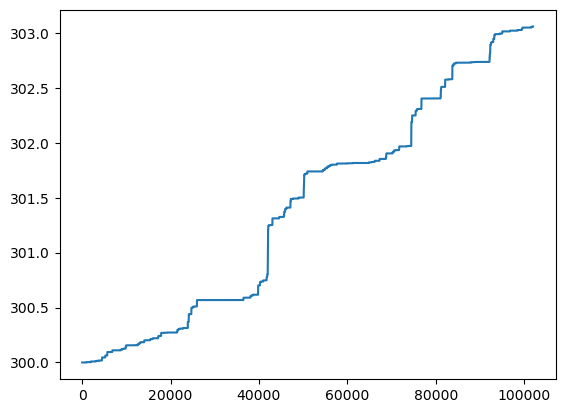

bnb_btc


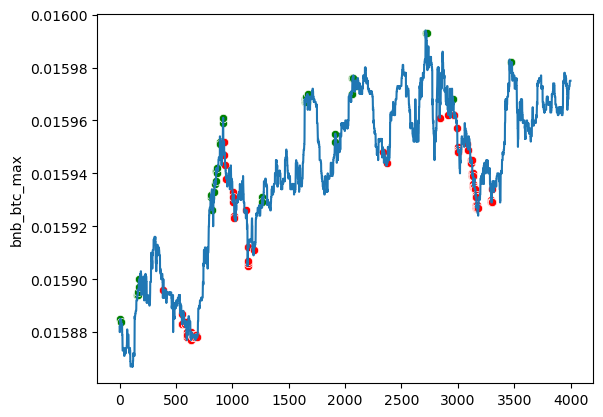

eth_btc


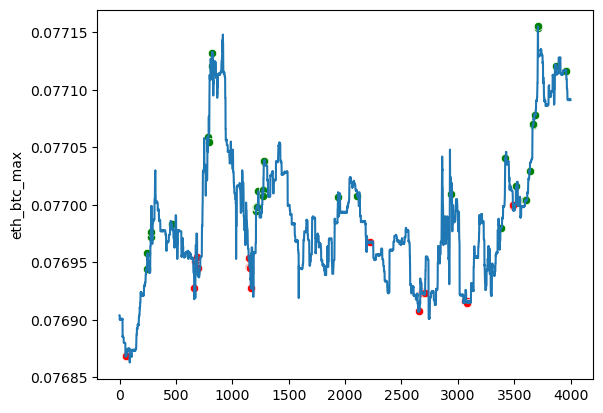

bnb_eth


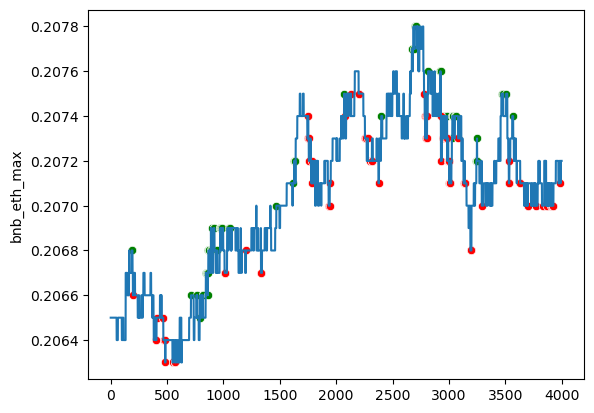

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 30, loss: 0.039
Traid counts: 11150 1: 2450 2: 1844 3: 1077 4: 1381 5: 1720 6: 2678
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    101837
         1.0       0.00      0.19      0.00        31
         2.0       0.01      0.34      0.01        32
         3.0       0.01      0.29      0.01        21
         4.0       0.01      0.40      0.01        20
         5.0       0.01      0.51      0.02        35
         6.0       0.01      0.42      0.01        36

    accuracy                           0.89    102012
   macro avg       0.15      0.44      0.14    102012
weighted avg       1.00      0.89      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.5947129516816
Общая комиссия в usdt: 8.76971168059929
Число сделок: 330
Прибыль от 300 usdt за 1

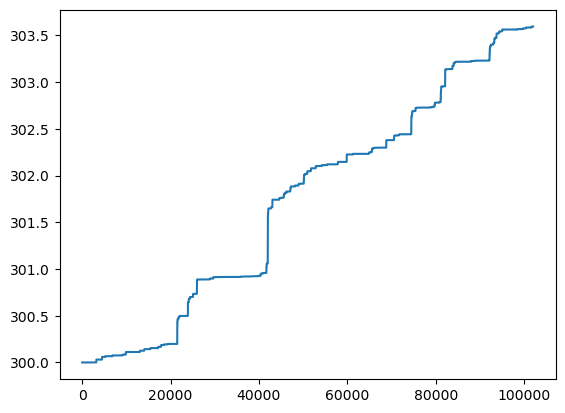

bnb_btc


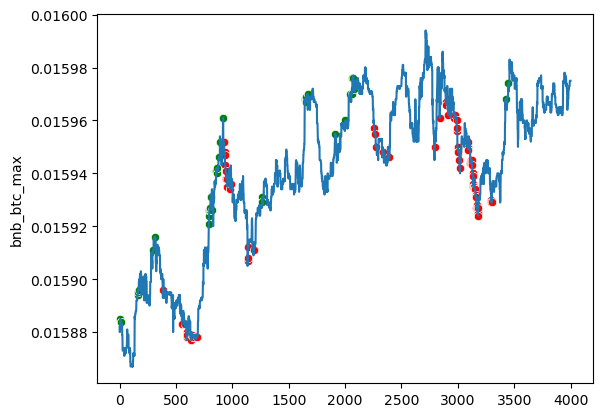

eth_btc


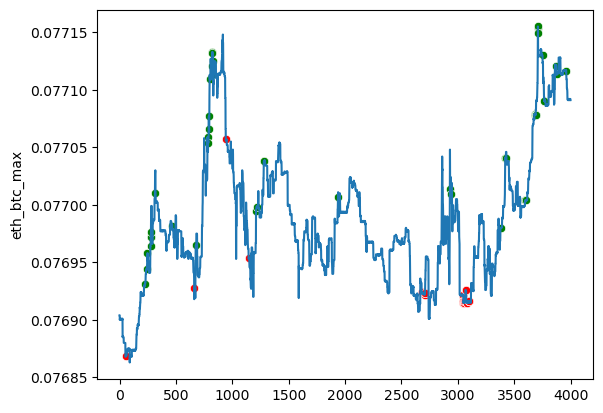

bnb_eth


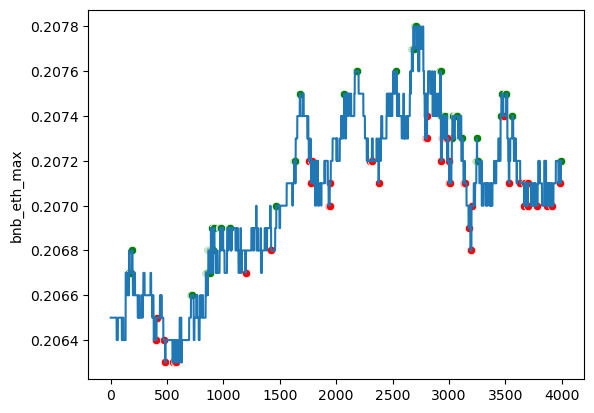

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 31, loss: 0.035
Traid counts: 10321 1: 2212 2: 1946 3: 897 4: 1379 5: 1715 6: 2172
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.26      0.01        31
         2.0       0.00      0.25      0.01        32
         3.0       0.01      0.29      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.51      0.02        35
         6.0       0.01      0.36      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.40      0.14    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.436061627874
Общая комиссия в usdt: 6.825991091895086
Число сделок: 310
Прибыль от 300 usdt за 10

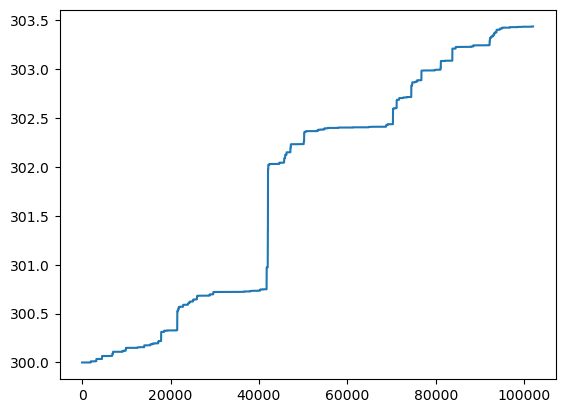

bnb_btc


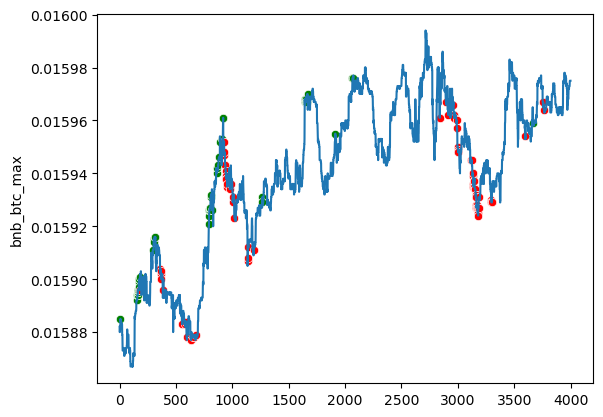

eth_btc


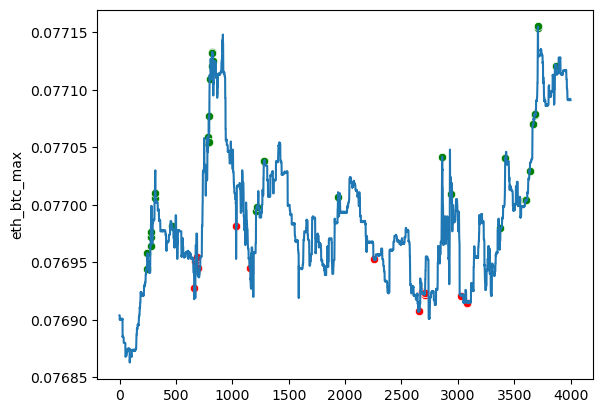

bnb_eth


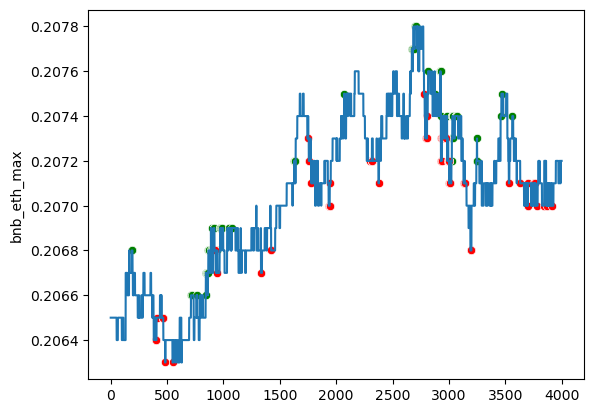

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 32, loss: 0.035
Traid counts: 11174 1: 2411 2: 2198 3: 943 4: 1408 5: 2035 6: 2179
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    101837
         1.0       0.00      0.23      0.01        31
         2.0       0.00      0.25      0.01        32
         3.0       0.01      0.29      0.01        21
         4.0       0.00      0.35      0.01        20
         5.0       0.01      0.49      0.02        35
         6.0       0.01      0.36      0.01        36

    accuracy                           0.89    102012
   macro avg       0.15      0.41      0.14    102012
weighted avg       1.00      0.89      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.7482909176169
Общая комиссия в usdt: 7.5473640095493755
Число сделок: 326
Прибыль от 300 usdt за 

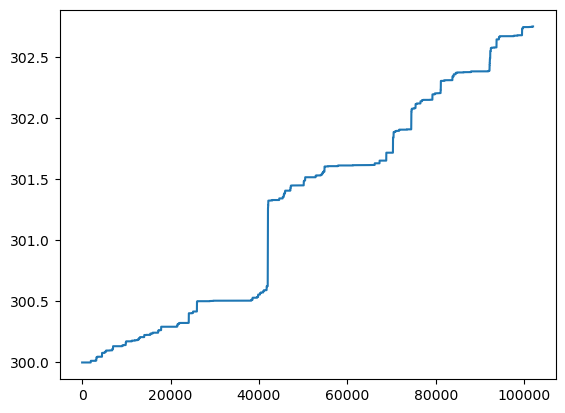

bnb_btc


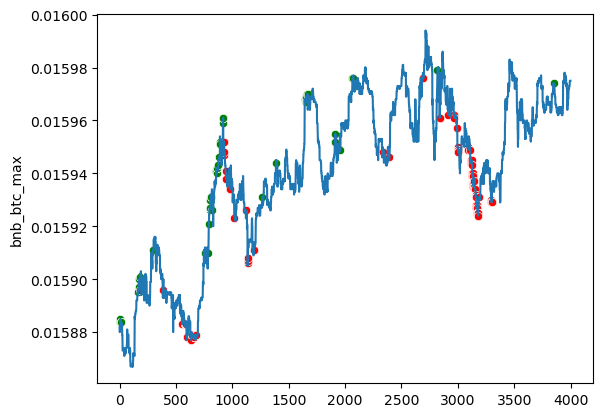

eth_btc


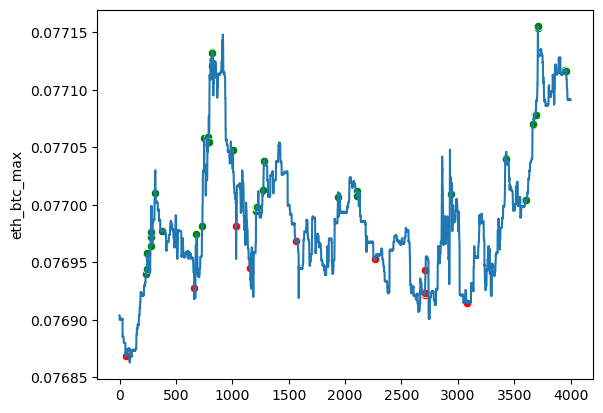

bnb_eth


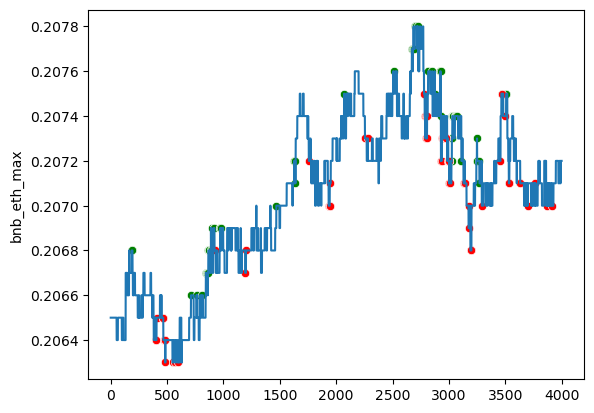

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 33, loss: 0.035
Traid counts: 11316 1: 2332 2: 1856 3: 1123 4: 1295 5: 2072 6: 2638
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    101837
         1.0       0.00      0.35      0.01        31
         2.0       0.00      0.19      0.01        32
         3.0       0.00      0.14      0.01        21
         4.0       0.01      0.35      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.47      0.01        36

    accuracy                           0.89    102012
   macro avg       0.15      0.42      0.14    102012
weighted avg       1.00      0.89      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.0424475426654
Общая комиссия в usdt: 8.938636177335283
Число сделок: 353
Прибыль от 300 usdt за 

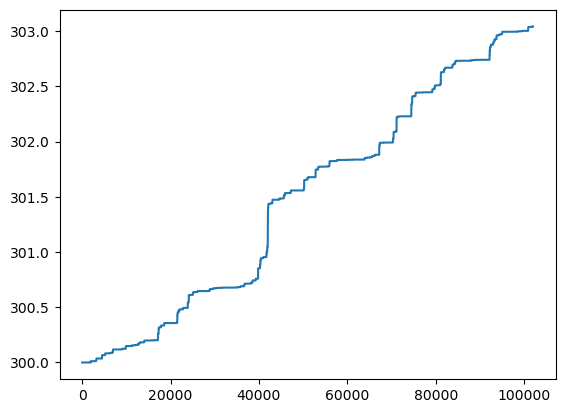

bnb_btc


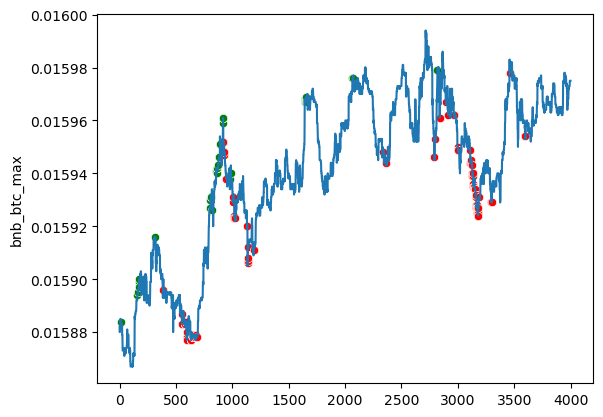

eth_btc


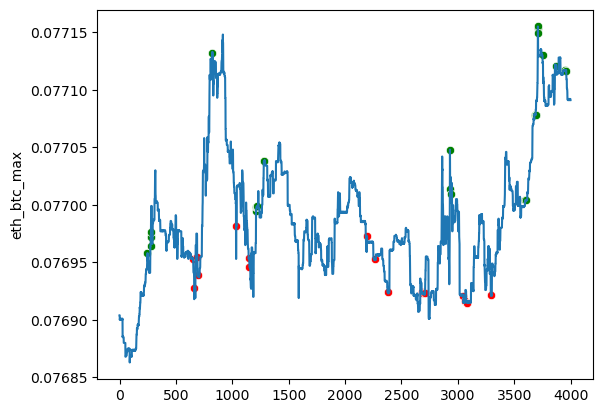

bnb_eth


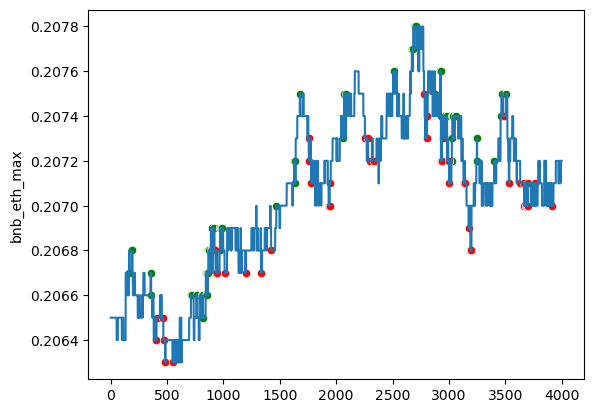

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 34, loss: 0.033
Traid counts: 9779 1: 1833 2: 1526 3: 1024 4: 1344 5: 1592 6: 2460
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.23      0.01        31
         2.0       0.00      0.19      0.01        32
         3.0       0.00      0.14      0.01        21
         4.0       0.01      0.40      0.01        20
         5.0       0.01      0.46      0.02        35
         6.0       0.01      0.50      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.40      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.5158629966193
Общая комиссия в usdt: 5.980805048909492
Число сделок: 297
Прибыль от 300 usdt за 1

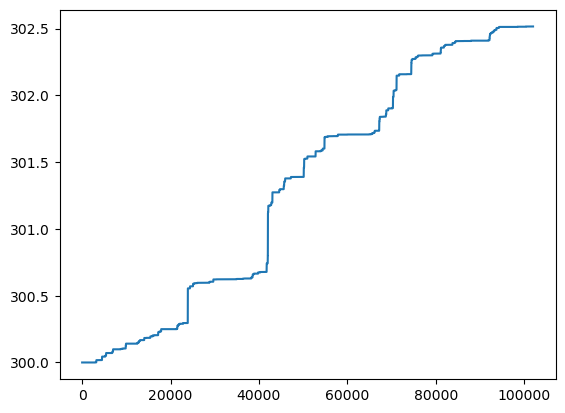

bnb_btc


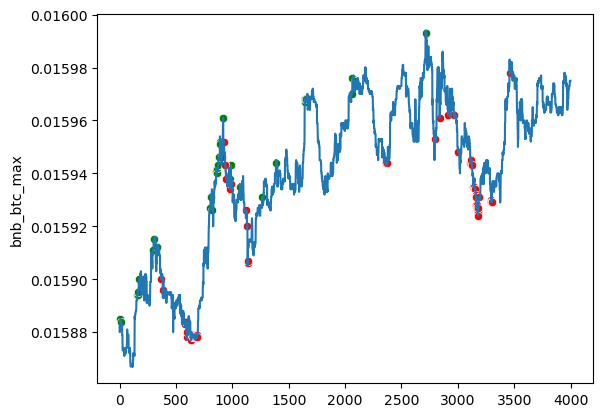

eth_btc


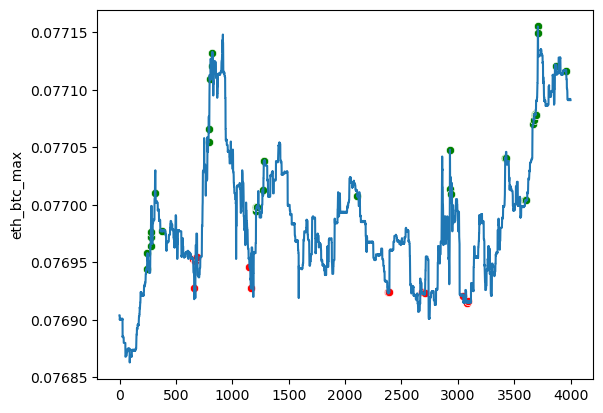

bnb_eth


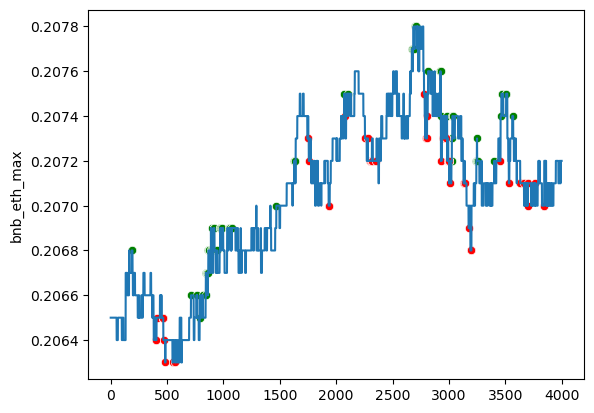

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 35, loss: 0.031
Traid counts: 9761 1: 1693 2: 1366 3: 1165 4: 1355 5: 2077 6: 2105
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.19      0.01        31
         2.0       0.01      0.22      0.01        32
         3.0       0.01      0.33      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.31      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.40      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.07576990593526
Общая комиссия в usdt: 7.938483758349509
Число сделок: 314
Прибыль от 300 usdt за 

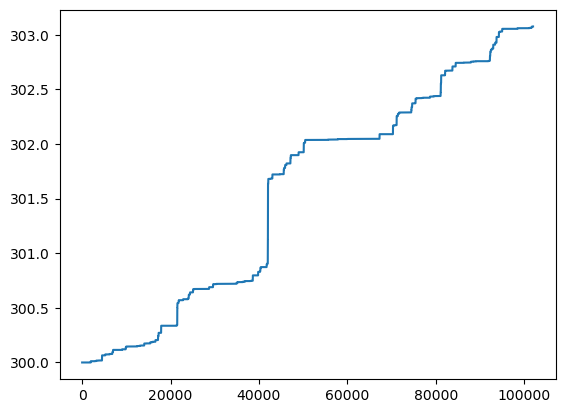

bnb_btc


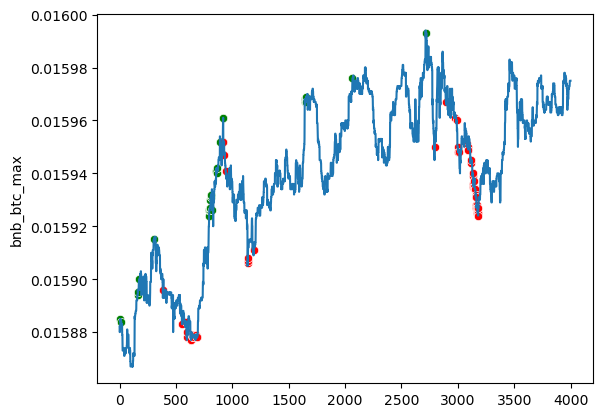

eth_btc


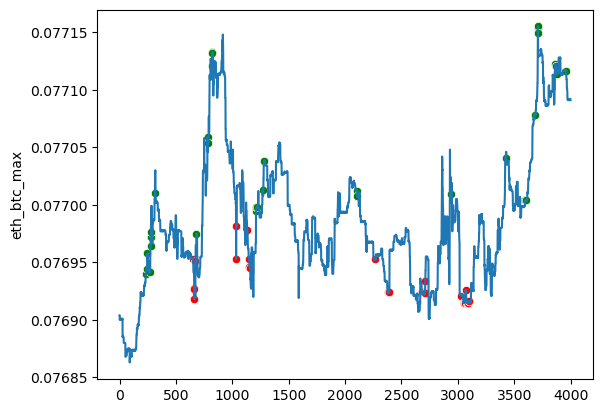

bnb_eth


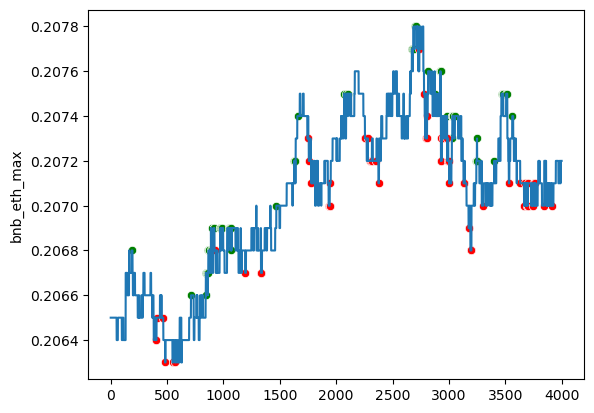

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 36, loss: 0.030
Traid counts: 10006 1: 1853 2: 1505 3: 938 4: 1297 5: 2184 6: 2229
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.23      0.01        31
         2.0       0.00      0.22      0.01        32
         3.0       0.01      0.33      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.60      0.02        35
         6.0       0.01      0.47      0.02        36

    accuracy                           0.90    102012
   macro avg       0.15      0.43      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.21263308040966
Общая комиссия в usdt: 8.071858745328255
Число сделок: 347
Прибыль от 300 usdt за 

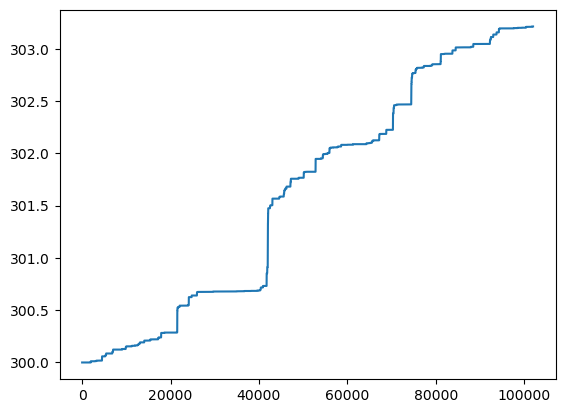

bnb_btc


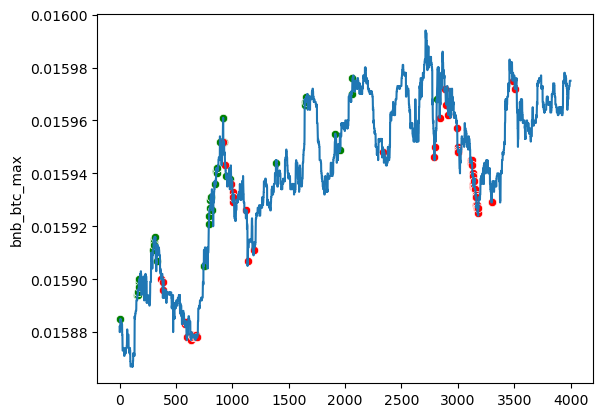

eth_btc


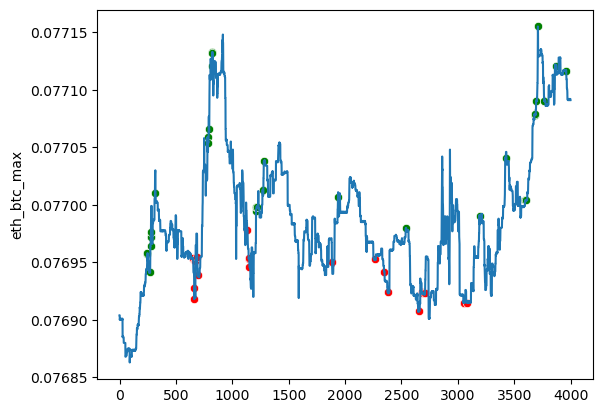

bnb_eth


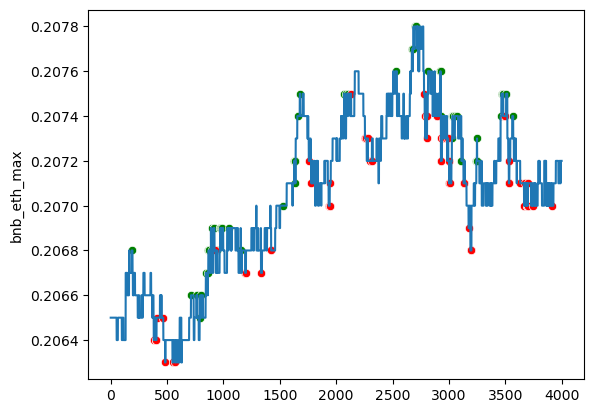

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 37, loss: 0.030
Traid counts: 10385 1: 2020 2: 1656 3: 877 4: 1370 5: 2349 6: 2113
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.19      0.01        31
         2.0       0.00      0.25      0.01        32
         3.0       0.00      0.19      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.51      0.02        35
         6.0       0.01      0.50      0.02        36

    accuracy                           0.90    102012
   macro avg       0.15      0.40      0.14    102012
weighted avg       1.00      0.90      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.8425912016643
Общая комиссия в usdt: 7.765749353095368
Число сделок: 368
Прибыль от 300 usdt за 1

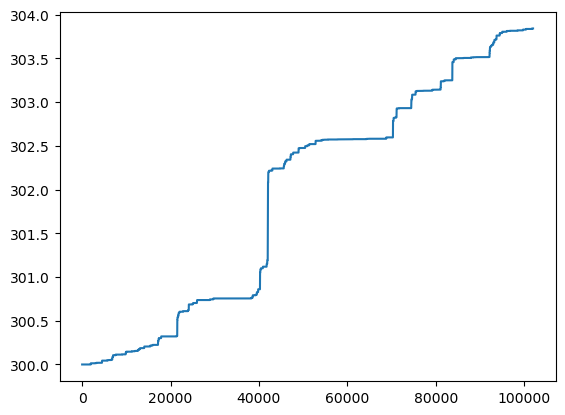

bnb_btc


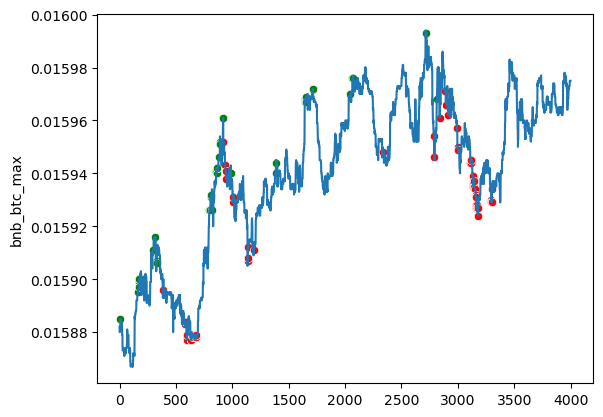

eth_btc


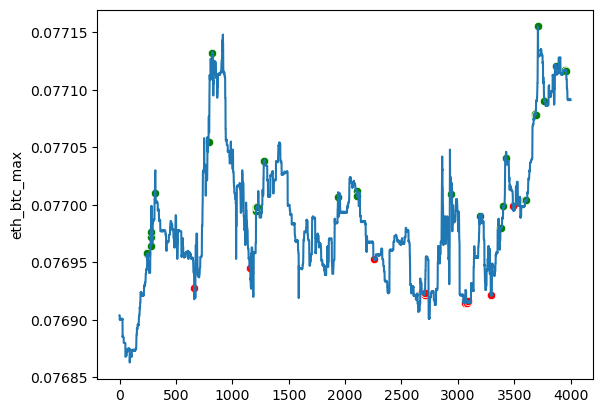

bnb_eth


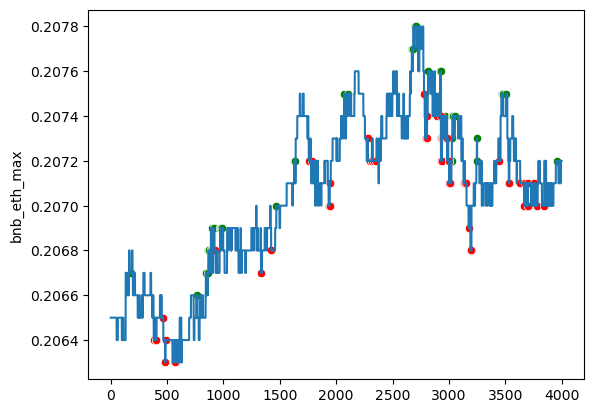

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 38, loss: 0.029
Traid counts: 10418 1: 1834 2: 1762 3: 1117 4: 1009 5: 2111 6: 2585
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.01      0.35      0.01        31
         2.0       0.01      0.28      0.01        32
         3.0       0.01      0.33      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.51      0.02        35
         6.0       0.01      0.47      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.44      0.15    102012
weighted avg       1.00      0.90      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.3066729254824
Общая комиссия в usdt: 8.529339680481216
Число сделок: 364
Прибыль от 300 usdt за 

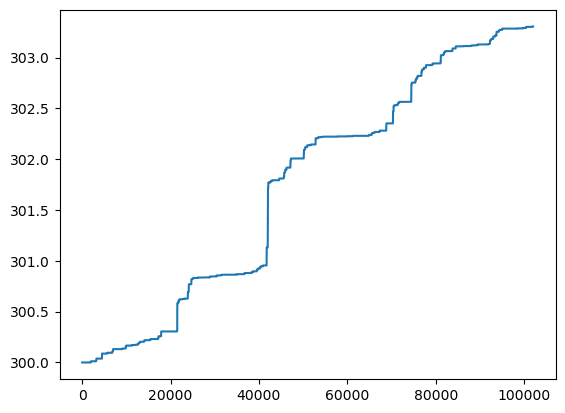

bnb_btc


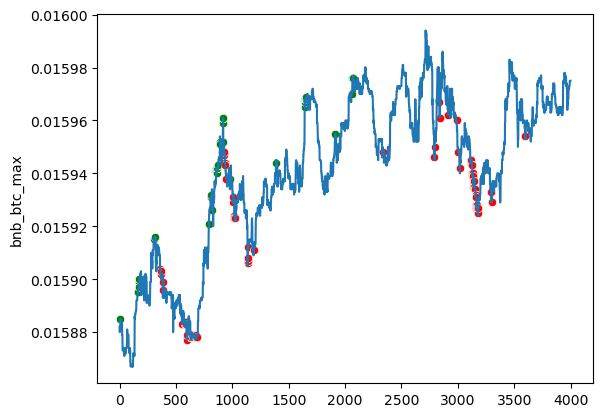

eth_btc


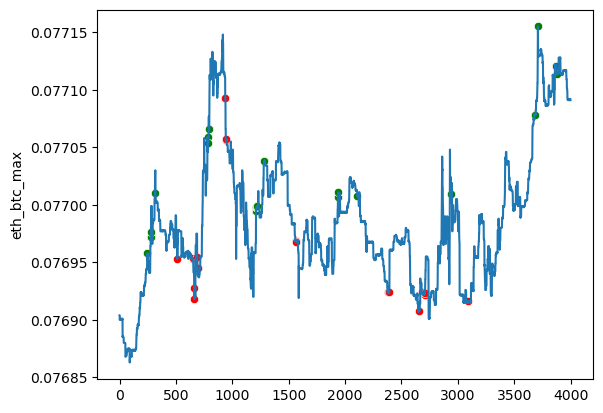

bnb_eth


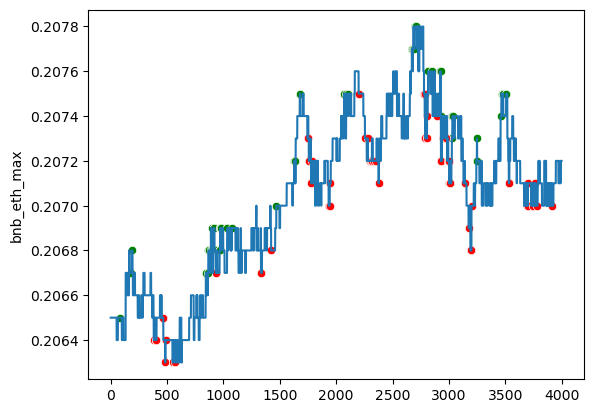

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 39, loss: 0.031
Traid counts: 11689 1: 2204 2: 2160 3: 1040 4: 1484 5: 2474 6: 2327
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    101837
         1.0       0.00      0.26      0.01        31
         2.0       0.00      0.19      0.01        32
         3.0       0.00      0.19      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.60      0.02        35
         6.0       0.01      0.33      0.01        36

    accuracy                           0.89    102012
   macro avg       0.15      0.39      0.14    102012
weighted avg       1.00      0.89      0.94    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.1293062503943
Общая комиссия в usdt: 8.50587330917202
Число сделок: 387
Прибыль от 300 usdt за 1

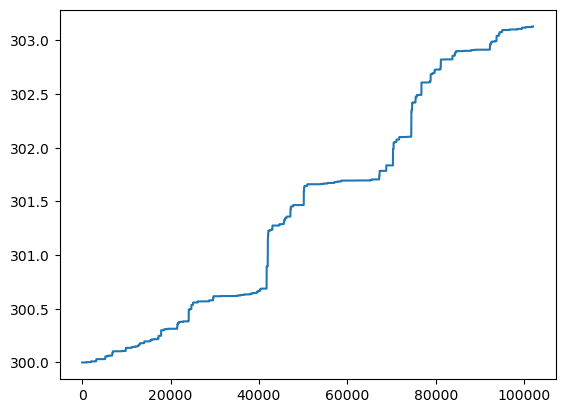

bnb_btc


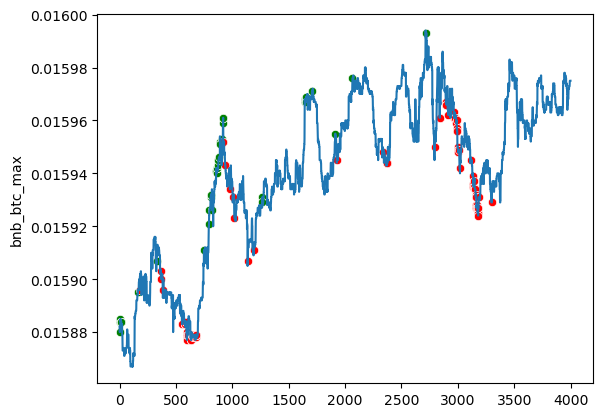

eth_btc


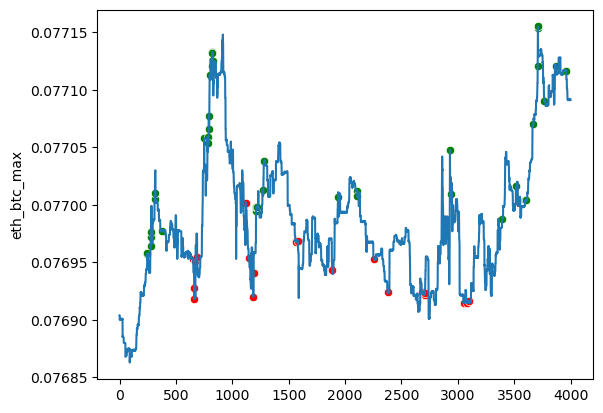

bnb_eth


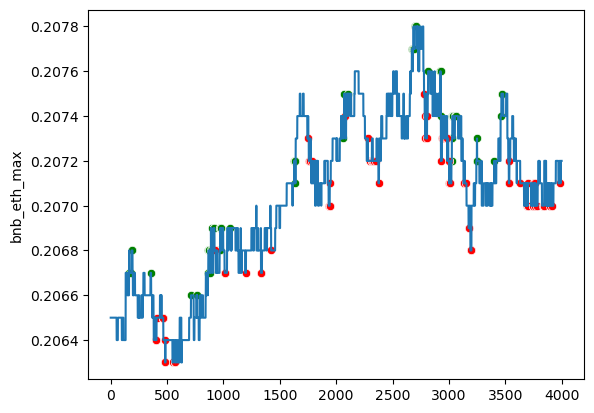

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 40, loss: 0.028
Traid counts: 10197 1: 1833 2: 1818 3: 827 4: 1272 5: 2162 6: 2285
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.16      0.01        31
         2.0       0.00      0.28      0.01        32
         3.0       0.01      0.29      0.01        21
         4.0       0.01      0.35      0.01        20
         5.0       0.01      0.54      0.02        35
         6.0       0.01      0.33      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.41      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.2927371559542
Общая комиссия в usdt: 8.41864710305985
Число сделок: 348
Прибыль от 300 usdt за 10

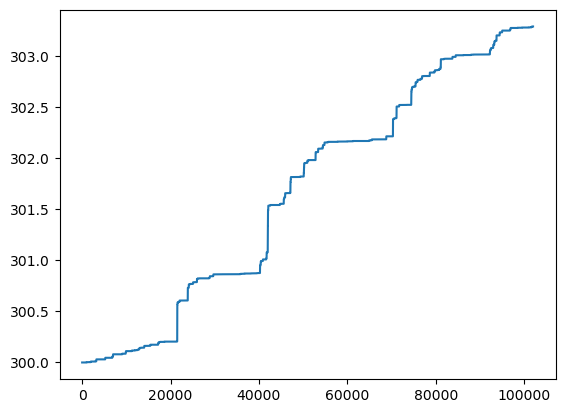

bnb_btc


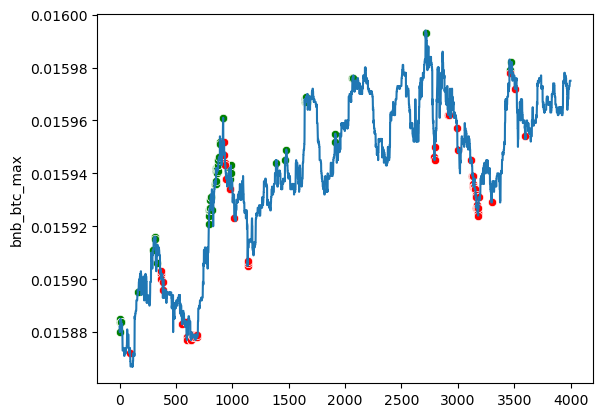

eth_btc


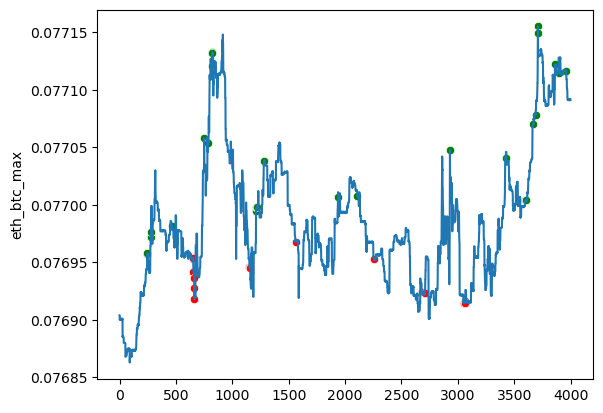

bnb_eth


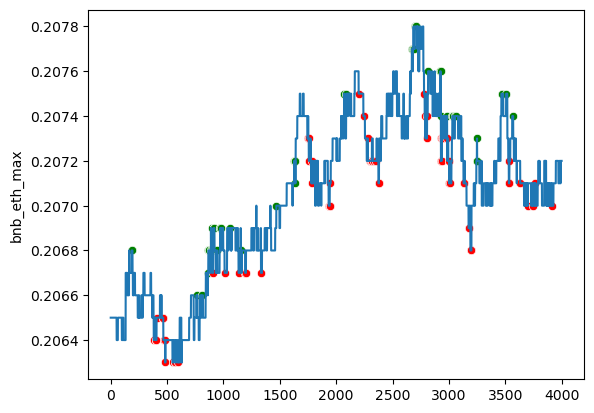

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 41, loss: 0.030
Traid counts: 9505 1: 2049 2: 1646 3: 877 4: 1208 5: 1918 6: 1807
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.01      0.39      0.01        31
         2.0       0.00      0.25      0.01        32
         3.0       0.01      0.38      0.02        21
         4.0       0.00      0.10      0.00        20
         5.0       0.01      0.51      0.02        35
         6.0       0.01      0.53      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.44      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.22452572322504
Общая комиссия в usdt: 8.07553143374397
Число сделок: 330
Прибыль от 300 usdt за 10

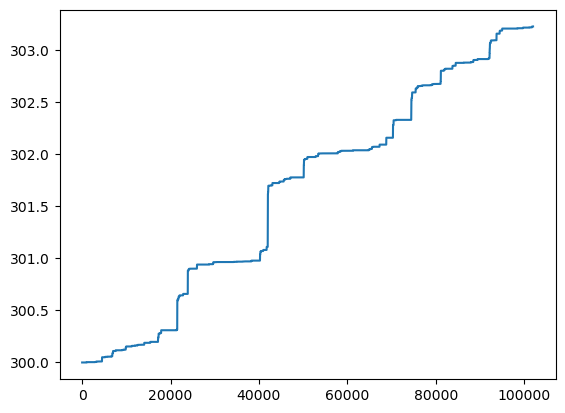

bnb_btc


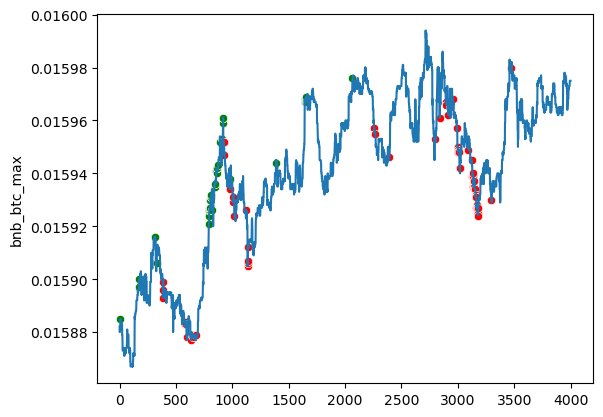

eth_btc


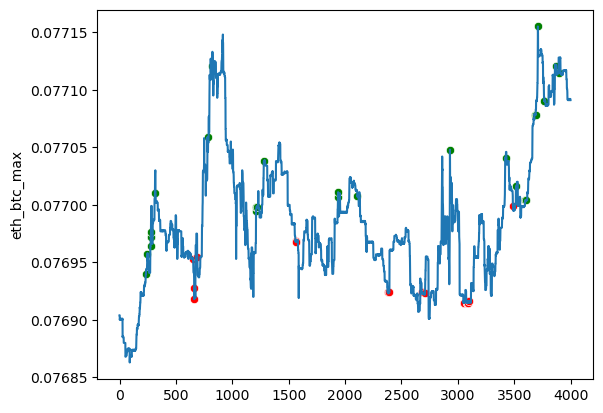

bnb_eth


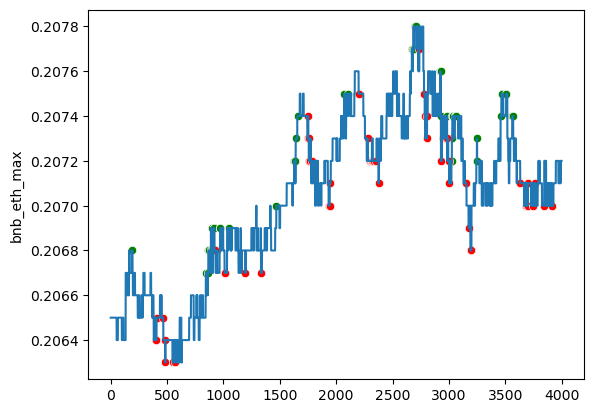

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 42, loss: 0.026
Traid counts: 9456 1: 1702 2: 1343 3: 1033 4: 1283 5: 2352 6: 1743
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.26      0.01        31
         2.0       0.01      0.34      0.02        32
         3.0       0.01      0.29      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.60      0.02        35
         6.0       0.01      0.33      0.01        36

    accuracy                           0.91    102012
   macro avg       0.15      0.43      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.92721611724113
Общая комиссия в usdt: 7.573842023165383
Число сделок: 338
Прибыль от 300 usdt за 

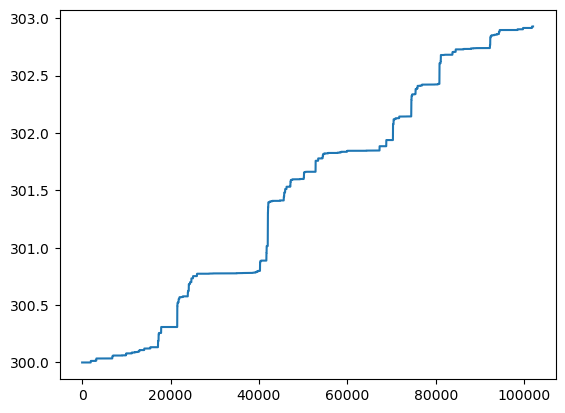

bnb_btc


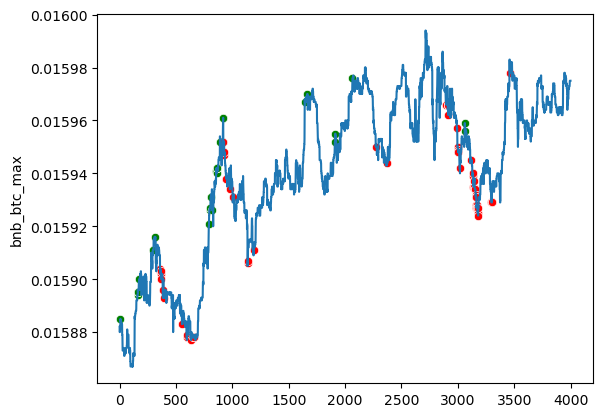

eth_btc


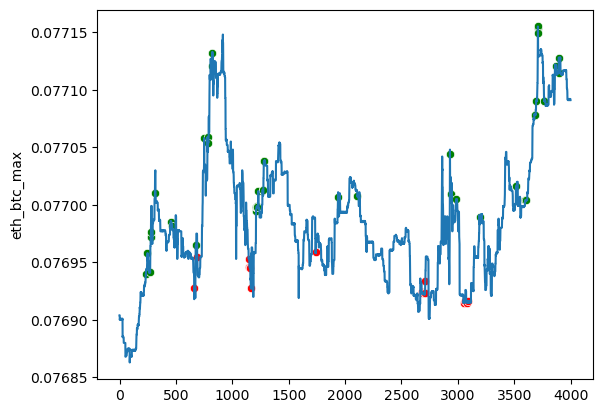

bnb_eth


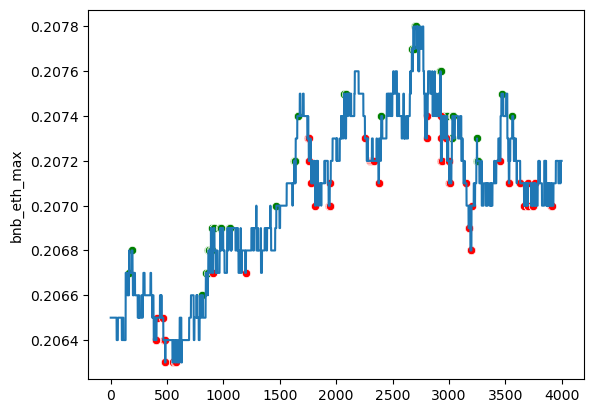

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 43, loss: 0.025
Traid counts: 9493 1: 1668 2: 1512 3: 845 4: 1058 5: 2242 6: 2168
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.19      0.01        31
         2.0       0.01      0.25      0.01        32
         3.0       0.01      0.29      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.60      0.02        35
         6.0       0.01      0.36      0.01        36

    accuracy                           0.91    102012
   macro avg       0.15      0.41      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.71346156525954
Общая комиссия в usdt: 6.289064150921917
Число сделок: 350
Прибыль от 300 usdt за 1

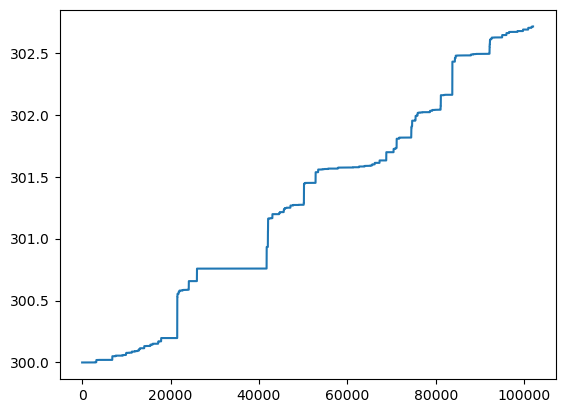

bnb_btc


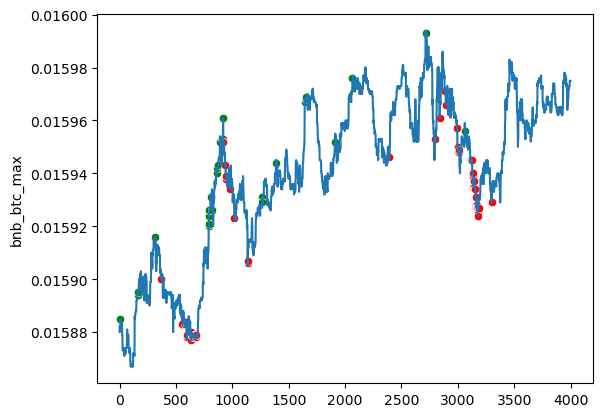

eth_btc


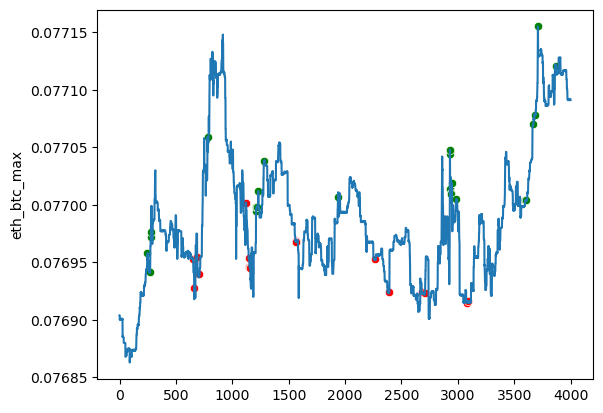

bnb_eth


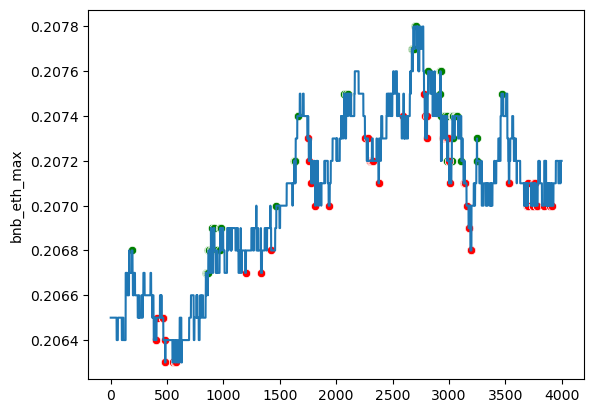

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 44, loss: 0.026
Traid counts: 10307 1: 1674 2: 1302 3: 1078 4: 1528 5: 2311 6: 2414
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.13      0.00        31
         2.0       0.00      0.19      0.01        32
         3.0       0.00      0.19      0.01        21
         4.0       0.00      0.20      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.53      0.02        36

    accuracy                           0.90    102012
   macro avg       0.15      0.39      0.14    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.5066992760515
Общая комиссия в usdt: 8.389132320774296
Число сделок: 351
Прибыль от 300 usdt за 

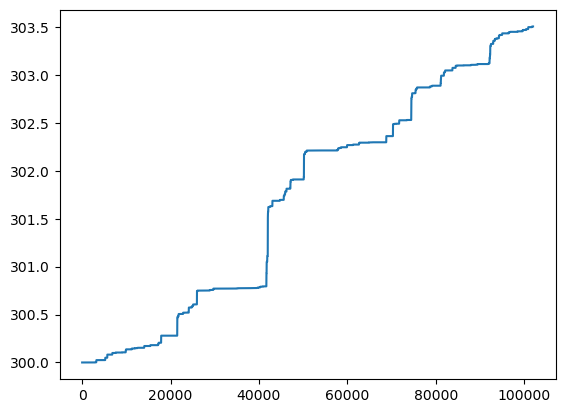

bnb_btc


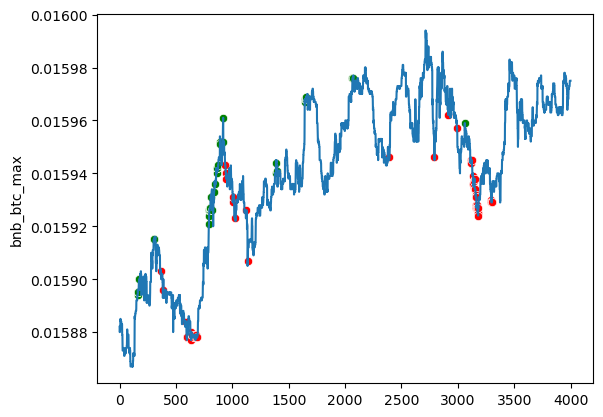

eth_btc


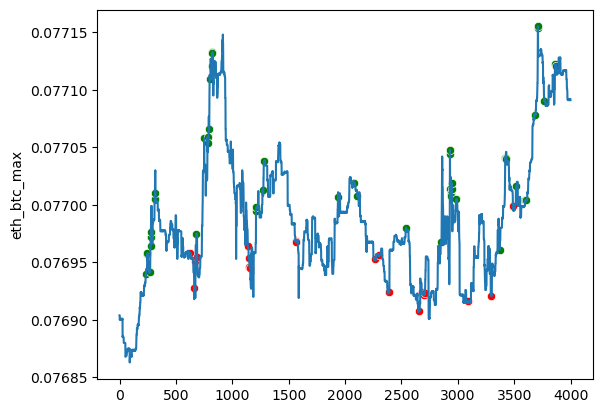

bnb_eth


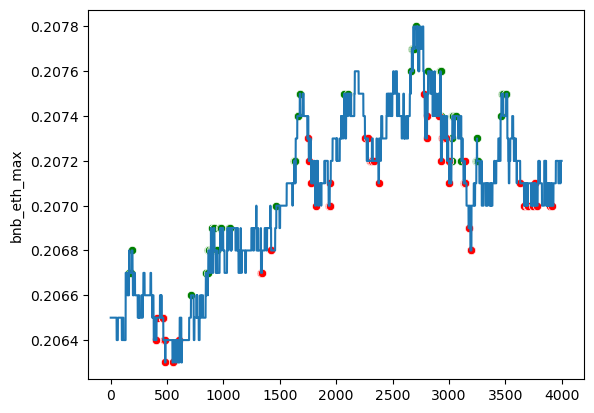

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 45, loss: 0.024
Traid counts: 9297 1: 1792 2: 1362 3: 862 4: 1099 5: 2228 6: 1954
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.16      0.01        31
         2.0       0.00      0.19      0.01        32
         3.0       0.00      0.19      0.01        21
         4.0       0.00      0.15      0.01        20
         5.0       0.01      0.51      0.02        35
         6.0       0.01      0.36      0.01        36

    accuracy                           0.91    102012
   macro avg       0.15      0.35      0.14    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.6549269738493
Общая комиссия в usdt: 7.501023227990569
Число сделок: 339
Прибыль от 300 usdt за 10

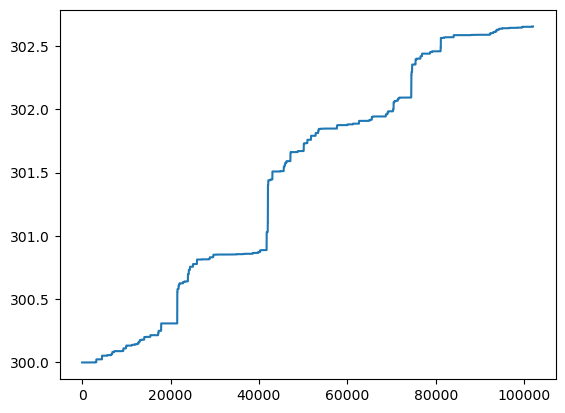

bnb_btc


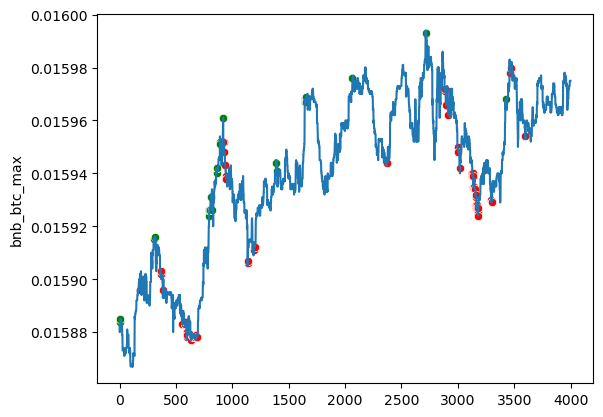

eth_btc


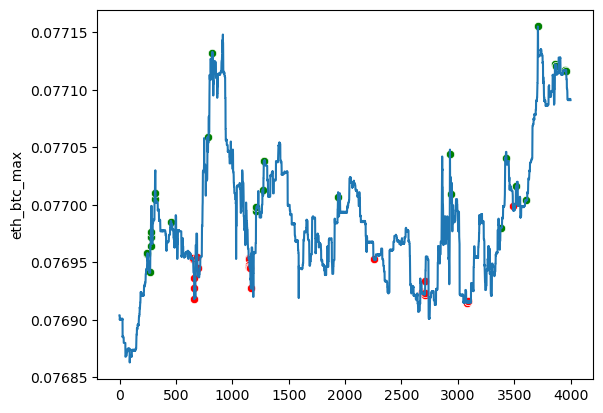

bnb_eth


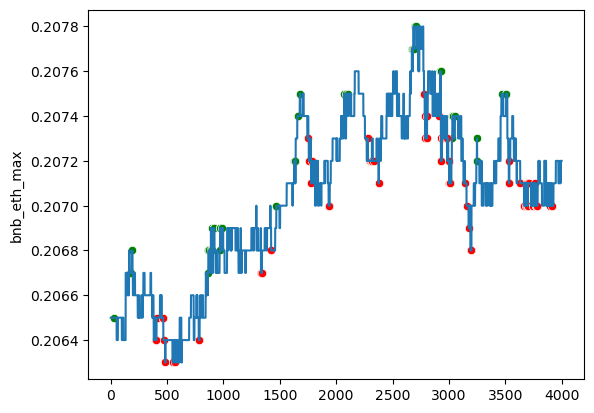

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 46, loss: 0.024
Traid counts: 10290 1: 1597 2: 1407 3: 1201 4: 1241 5: 2358 6: 2486
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.01      0.26      0.01        31
         2.0       0.00      0.16      0.01        32
         3.0       0.01      0.38      0.01        21
         4.0       0.00      0.20      0.01        20
         5.0       0.01      0.51      0.02        35
         6.0       0.01      0.39      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.40      0.14    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.6097888513257
Общая комиссия в usdt: 9.34454870493451
Число сделок: 366
Прибыль от 300 usdt за 1

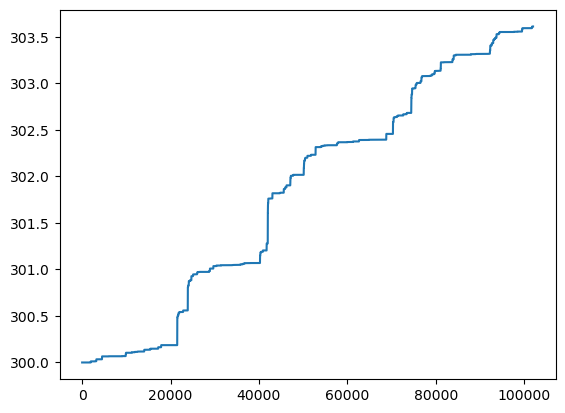

bnb_btc


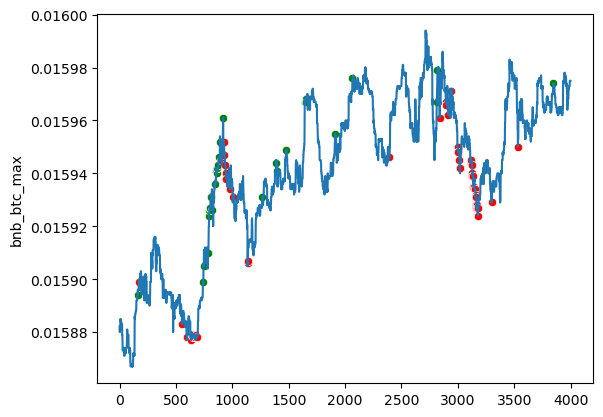

eth_btc


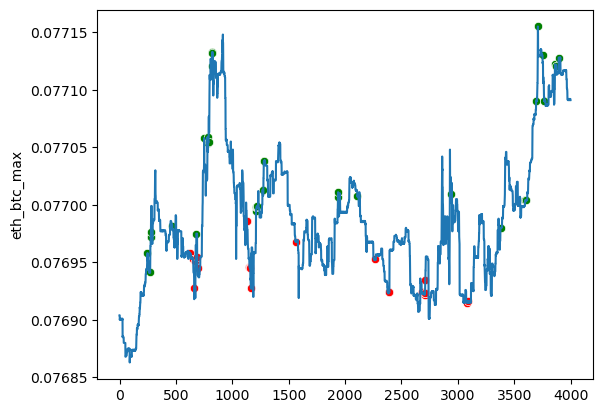

bnb_eth


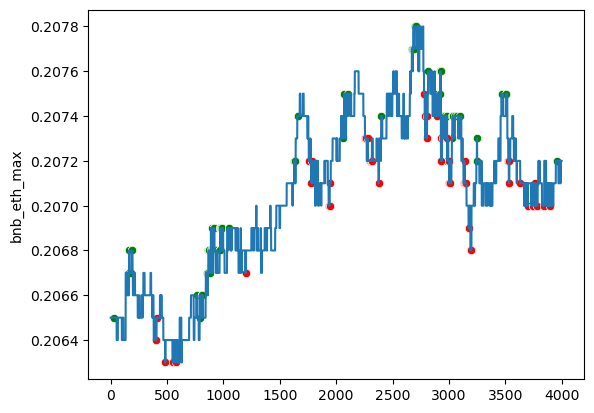

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 47, loss: 0.023
Traid counts: 9876 1: 1819 2: 1321 3: 1257 4: 1148 5: 1949 6: 2382
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.29      0.01        31
         2.0       0.00      0.19      0.01        32
         3.0       0.00      0.24      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.63      0.02        35
         6.0       0.01      0.47      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.42      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.6259644192817
Общая комиссия в usdt: 9.115109647291067
Число сделок: 322
Прибыль от 300 usdt за 1

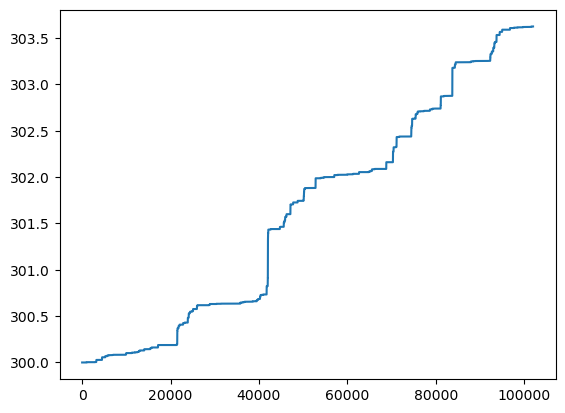

bnb_btc


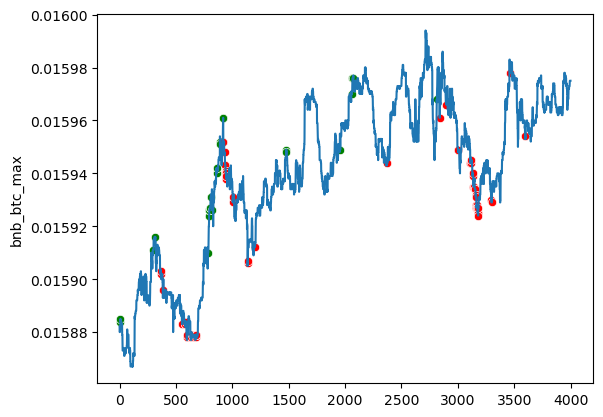

eth_btc


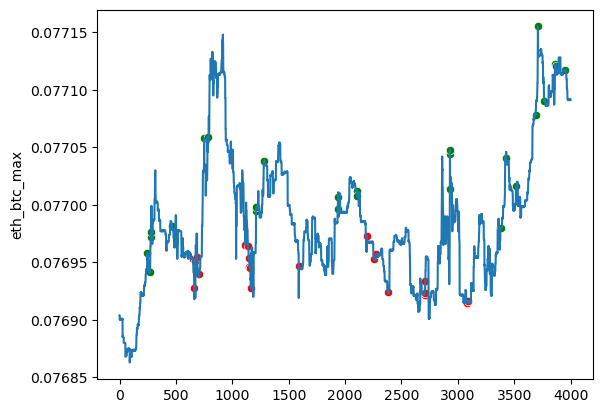

bnb_eth


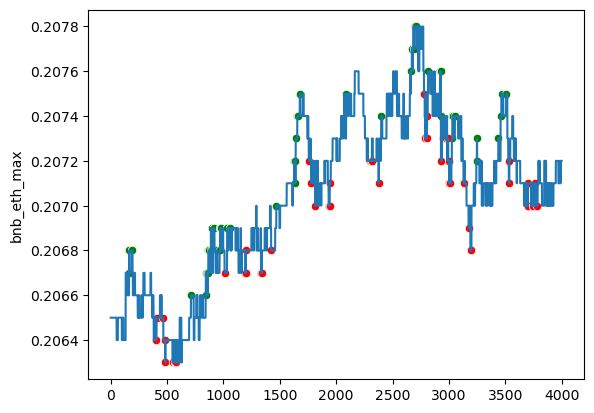

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 48, loss: 0.022
Traid counts: 9757 1: 1867 2: 1207 3: 1045 4: 1056 5: 2127 6: 2455
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.01      0.35      0.01        31
         2.0       0.01      0.22      0.01        32
         3.0       0.00      0.24      0.01        21
         4.0       0.00      0.20      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.47      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.42      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.7387685843126
Общая комиссия в usdt: 9.723379150854155
Число сделок: 349
Прибыль от 300 usdt за 1

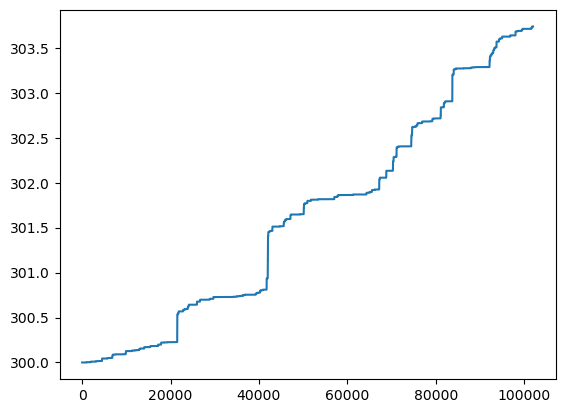

bnb_btc


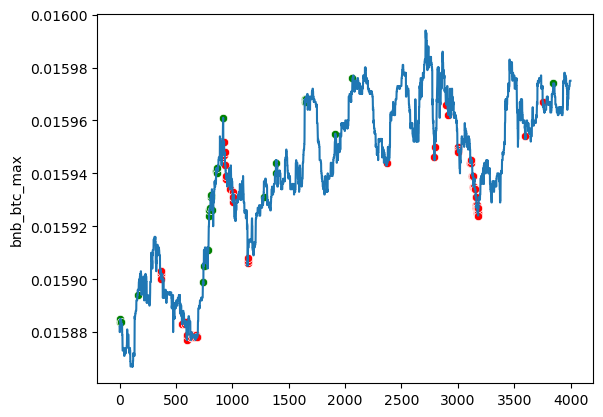

eth_btc


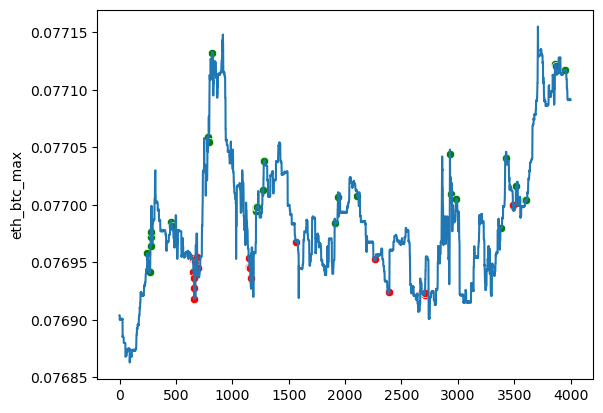

bnb_eth


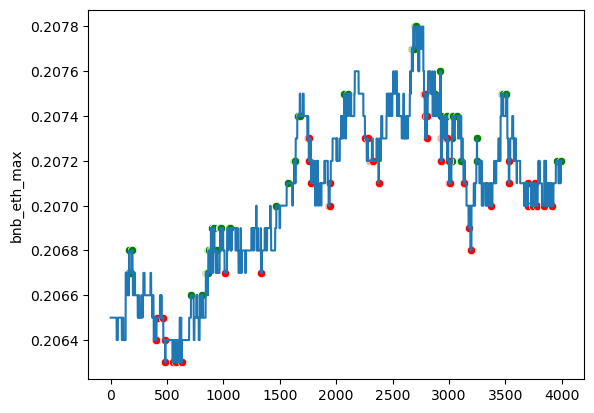

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 49, loss: 0.023
Traid counts: 10257 1: 2104 2: 1579 3: 1231 4: 1108 5: 1994 6: 2241
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.01      0.35      0.01        31
         2.0       0.00      0.12      0.00        32
         3.0       0.00      0.24      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.51      0.02        35
         6.0       0.01      0.44      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.40      0.14    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.06568934037284
Общая комиссия в usdt: 7.769323698567837
Число сделок: 340
Прибыль от 300 usdt за

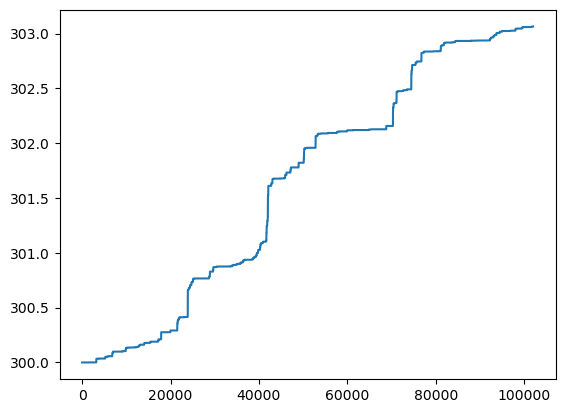

bnb_btc


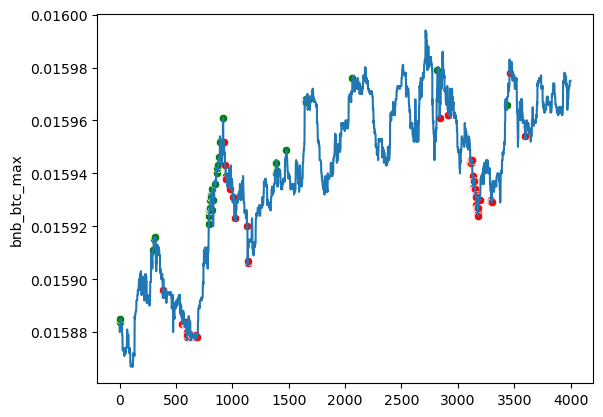

eth_btc


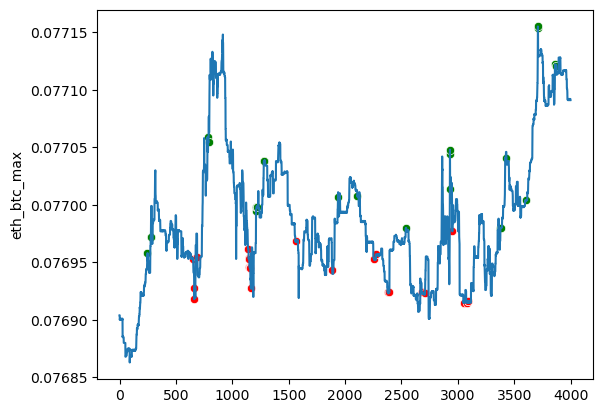

bnb_eth


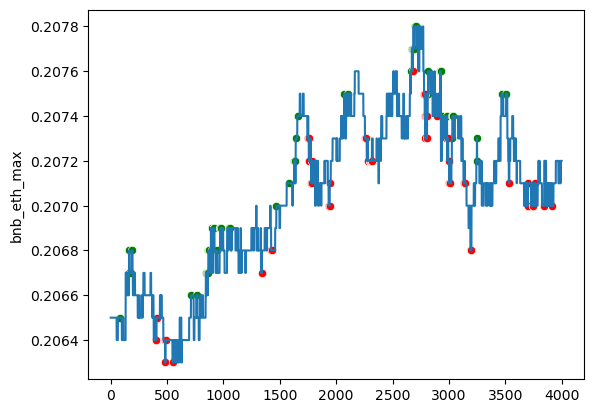

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 50, loss: 0.021
Traid counts: 9556 1: 1676 2: 979 3: 1100 4: 1245 5: 2413 6: 2143
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.01      0.29      0.01        31
         2.0       0.00      0.09      0.01        32
         3.0       0.01      0.33      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.63      0.02        35
         6.0       0.01      0.53      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.43      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.72106540161036
Общая комиссия в usdt: 10.208758271349604
Число сделок: 386
Прибыль от 300 usdt за 

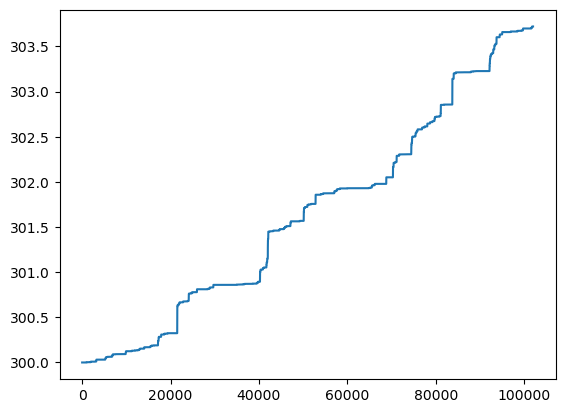

bnb_btc


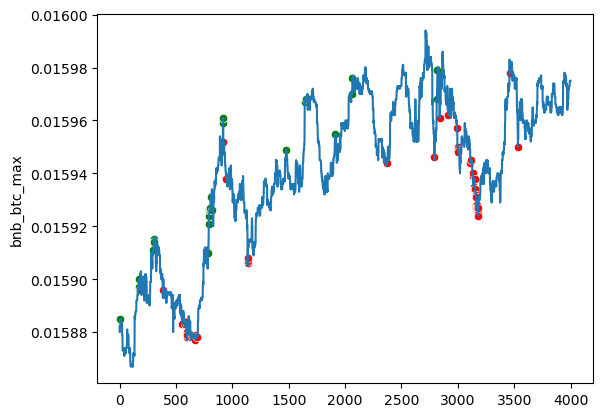

eth_btc


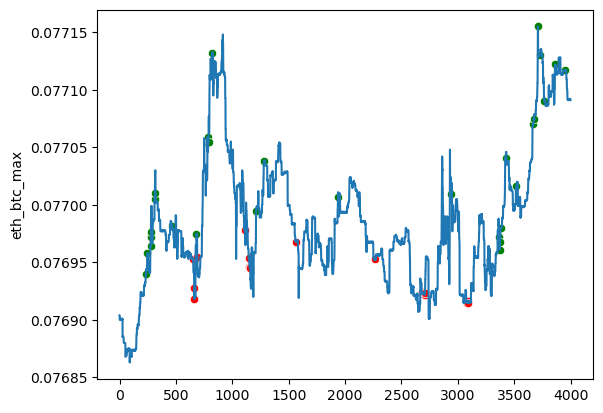

bnb_eth


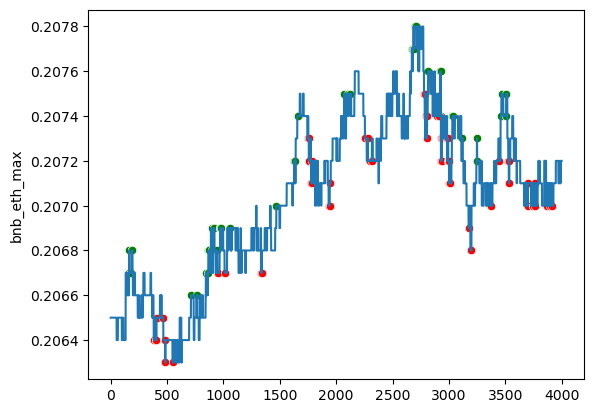

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 51, loss: 0.022
Traid counts: 9576 1: 1529 2: 1160 3: 1190 4: 1412 5: 2125 6: 2160
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.01      0.29      0.01        31
         2.0       0.01      0.22      0.01        32
         3.0       0.00      0.19      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.51      0.02        35
         6.0       0.01      0.50      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.41      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.00476931628066
Общая комиссия в usdt: 7.838333890773359
Число сделок: 328
Прибыль от 300 usdt за 

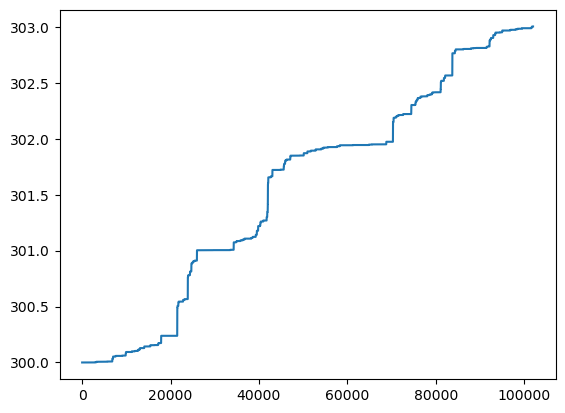

bnb_btc


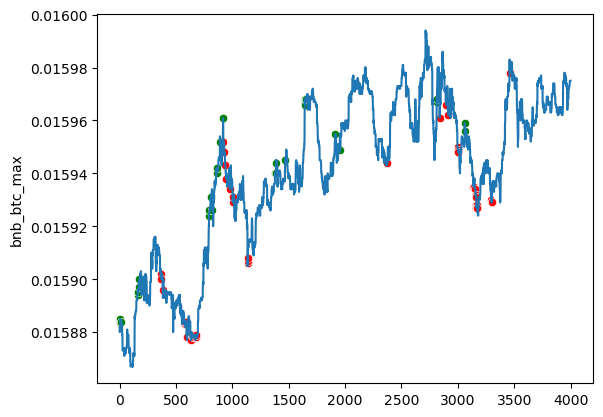

eth_btc


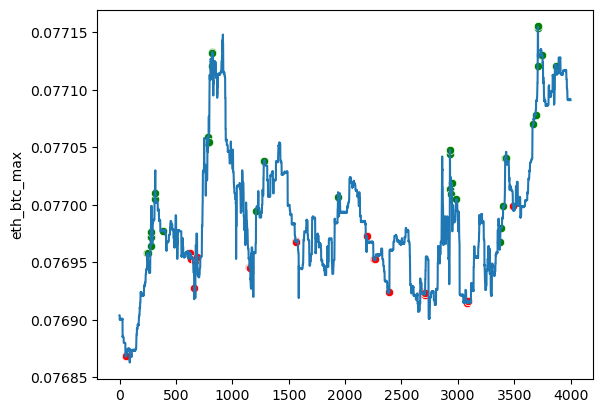

bnb_eth


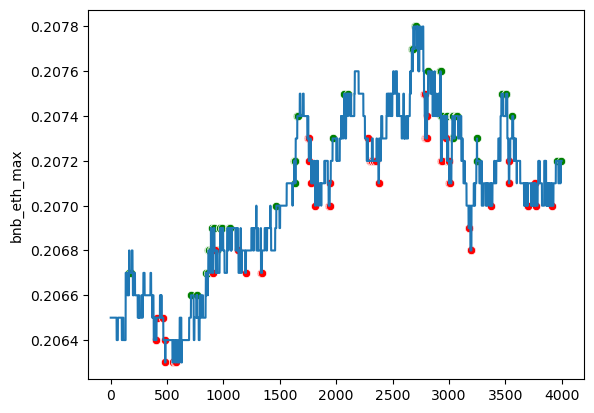

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 52, loss: 0.021
Traid counts: 9015 1: 1442 2: 1287 3: 1002 4: 1493 5: 1841 6: 1950
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.16      0.01        31
         2.0       0.01      0.22      0.01        32
         3.0       0.01      0.33      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.54      0.02        35
         6.0       0.01      0.42      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.41      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.59980237605805
Общая комиссия в usdt: 7.452761385223359
Число сделок: 296
Прибыль от 300 usdt за 

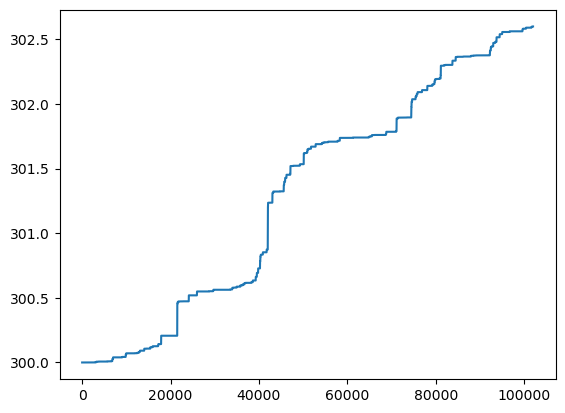

bnb_btc


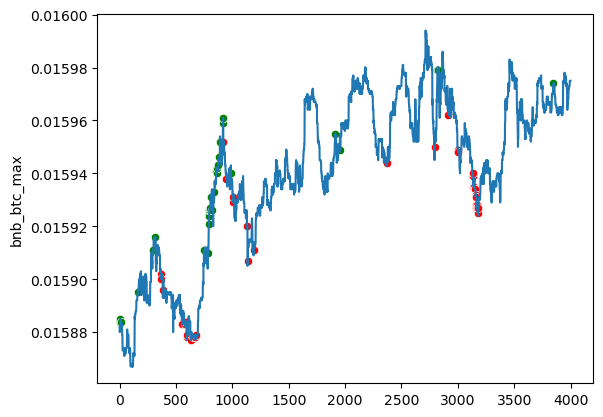

eth_btc


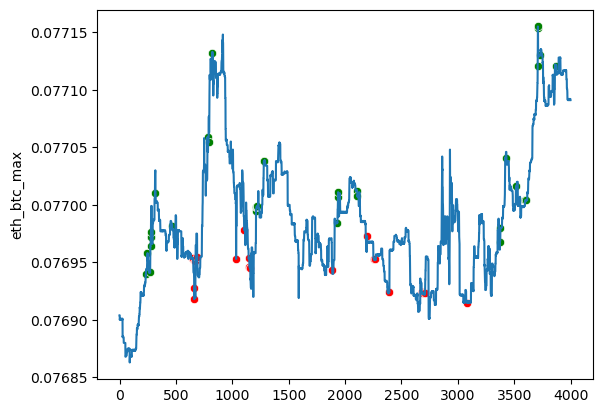

bnb_eth


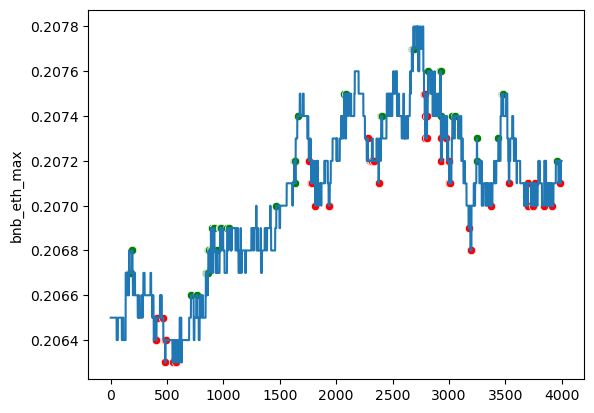

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 53, loss: 0.022
Traid counts: 9606 1: 1967 2: 1476 3: 1011 4: 1211 5: 1932 6: 2009
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.16      0.01        31
         2.0       0.00      0.22      0.01        32
         3.0       0.01      0.33      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.47      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.42      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.51200306820476
Общая комиссия в usdt: 8.108599981276168
Число сделок: 314
Прибыль от 300 usdt за 

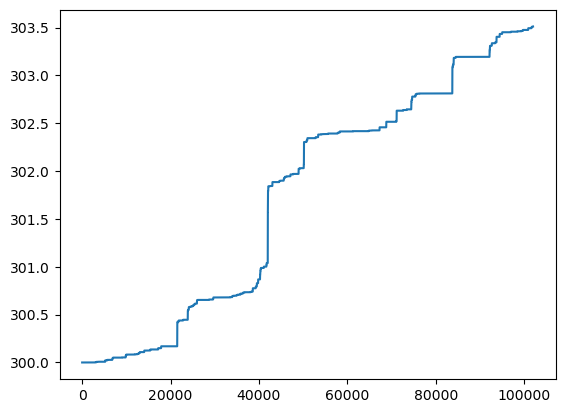

bnb_btc


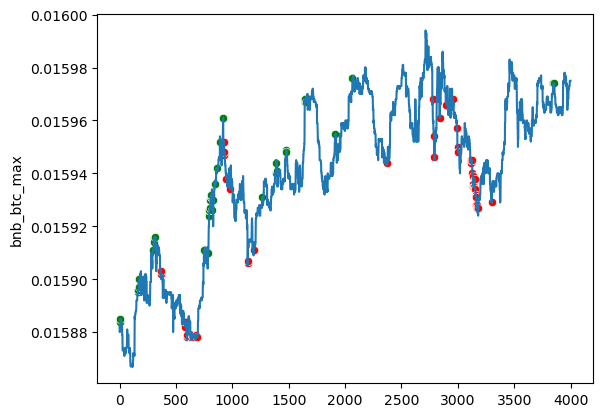

eth_btc


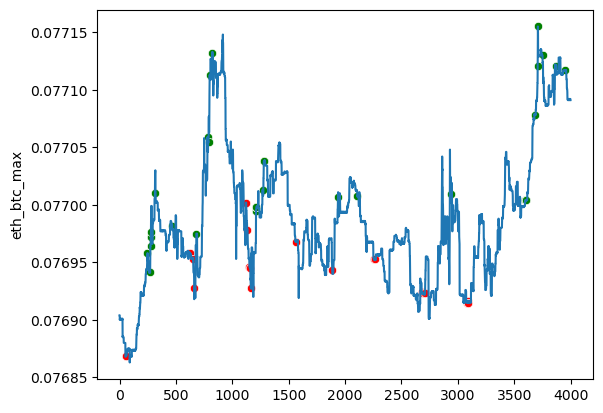

bnb_eth


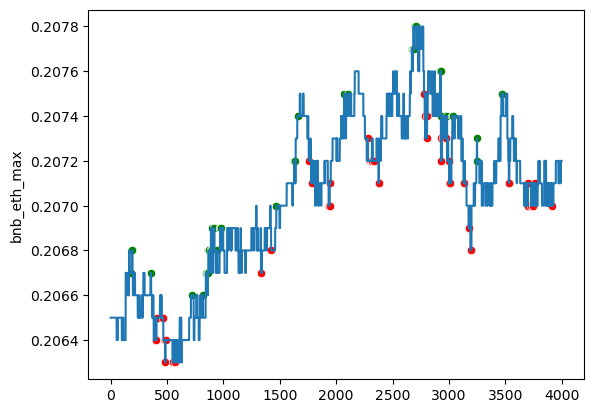

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 54, loss: 0.021
Traid counts: 9180 1: 1764 2: 1172 3: 803 4: 1237 5: 2189 6: 2015
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.23      0.01        31
         2.0       0.00      0.16      0.01        32
         3.0       0.01      0.24      0.01        21
         4.0       0.01      0.35      0.01        20
         5.0       0.01      0.60      0.02        35
         6.0       0.01      0.47      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.42      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.0853119700855
Общая комиссия в usdt: 8.361814636313161
Число сделок: 341
Прибыль от 300 usdt за 10

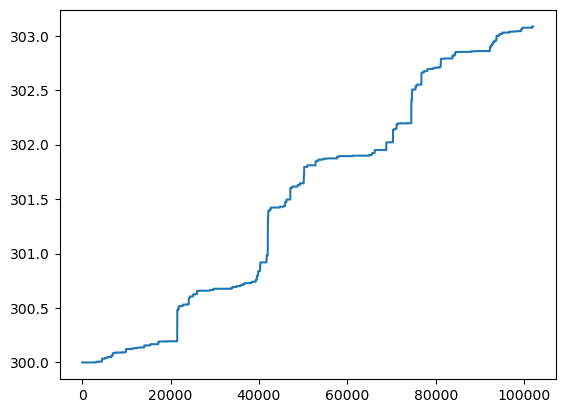

bnb_btc


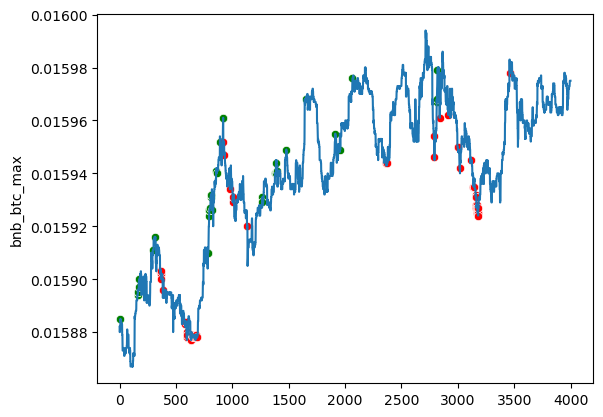

eth_btc


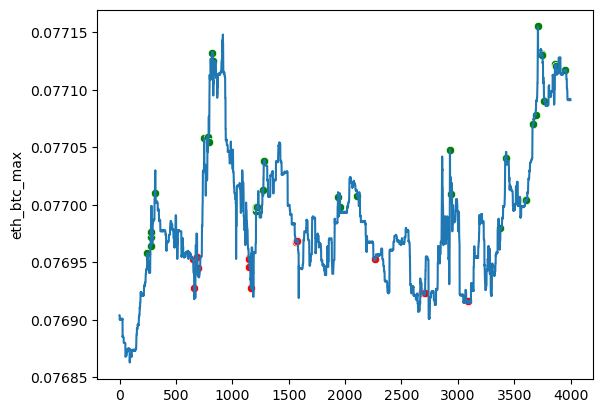

bnb_eth


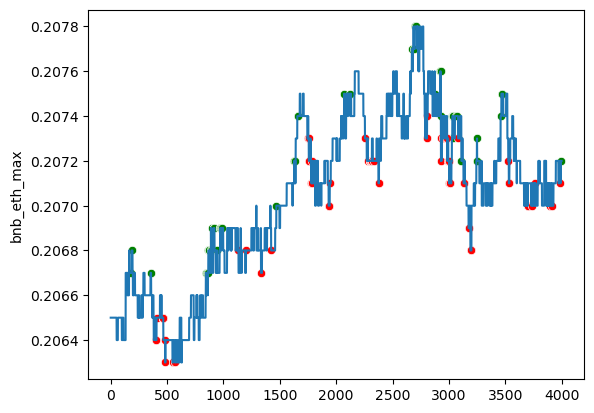

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 55, loss: 0.017
Traid counts: 9079 1: 1678 2: 1199 3: 1021 4: 1270 5: 2251 6: 1660
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.23      0.01        31
         2.0       0.01      0.19      0.01        32
         3.0       0.01      0.38      0.02        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.66      0.02        35
         6.0       0.01      0.42      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.44      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.73500093704206
Общая комиссия в usdt: 6.0349007211137975
Число сделок: 333
Прибыль от 300 usdt за

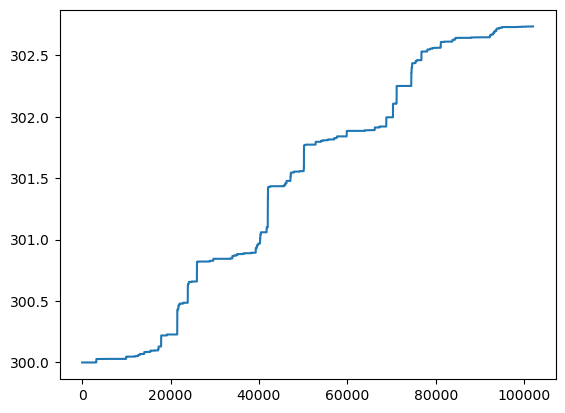

bnb_btc


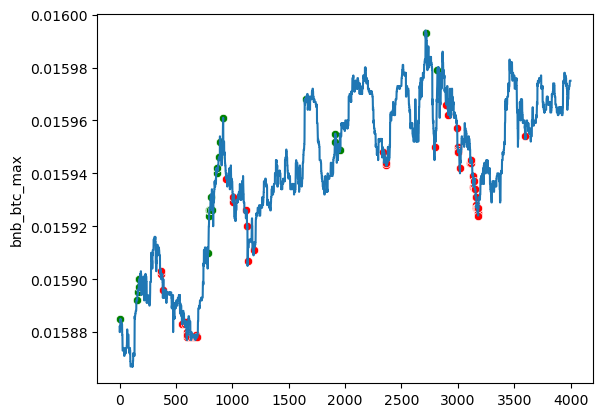

eth_btc


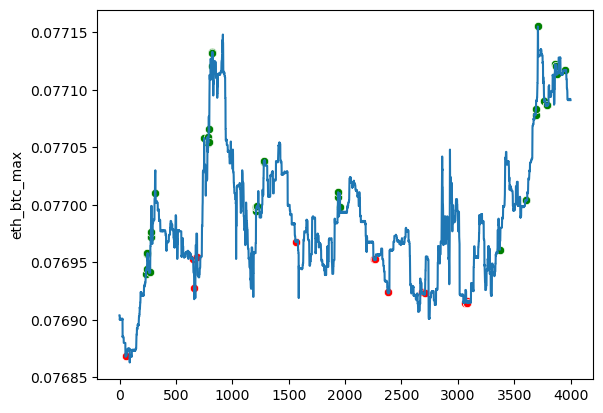

bnb_eth


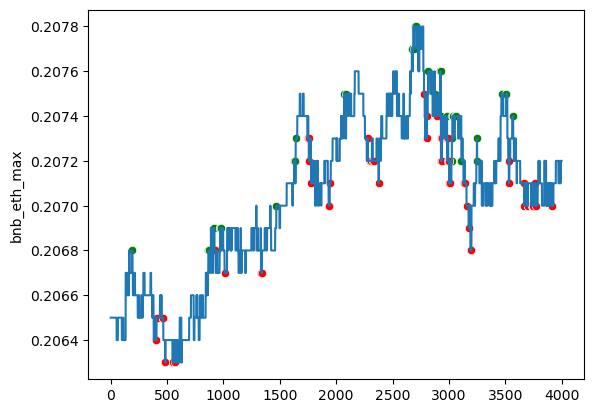

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 56, loss: 0.019
Traid counts: 9995 1: 2049 2: 1083 3: 880 4: 1273 5: 2407 6: 2303
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.19      0.01        31
         2.0       0.00      0.16      0.01        32
         3.0       0.01      0.24      0.01        21
         4.0       0.01      0.35      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.44      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.41      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.6511739505234
Общая комиссия в usdt: 9.752736304597164
Число сделок: 386
Прибыль от 300 usdt за 10

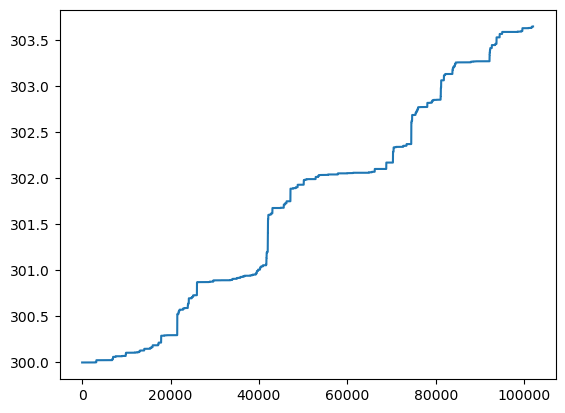

bnb_btc


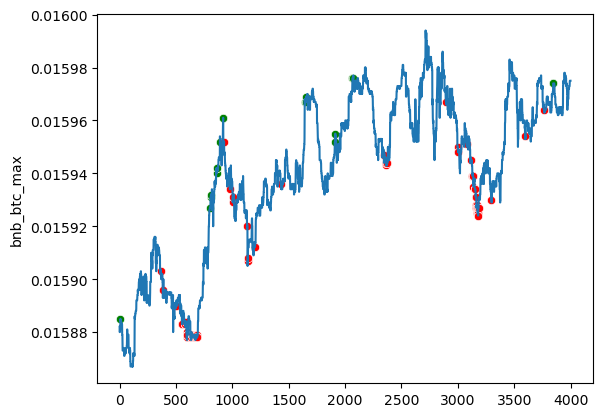

eth_btc


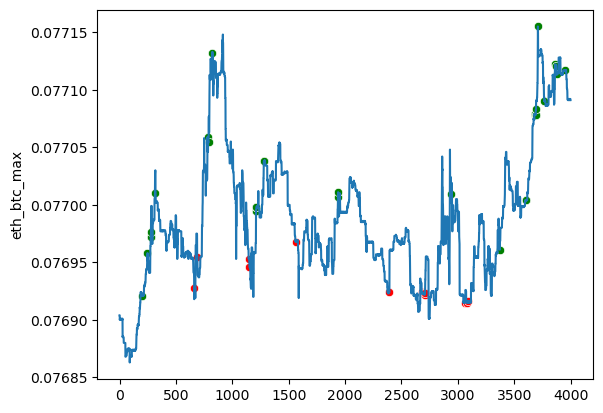

bnb_eth


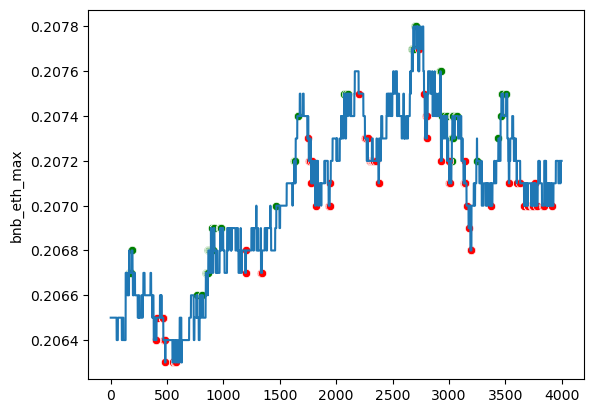

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 57, loss: 0.021
Traid counts: 8760 1: 1718 2: 1229 3: 850 4: 1141 5: 1744 6: 2078
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.96    101837
         1.0       0.00      0.19      0.01        31
         2.0       0.00      0.19      0.01        32
         3.0       0.01      0.29      0.01        21
         4.0       0.01      0.30      0.01        20
         5.0       0.01      0.54      0.02        35
         6.0       0.01      0.42      0.01        36

    accuracy                           0.91    102012
   macro avg       0.15      0.41      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.3929362930568
Общая комиссия в usdt: 8.131697727918242
Число сделок: 308
Прибыль от 300 usdt за 10

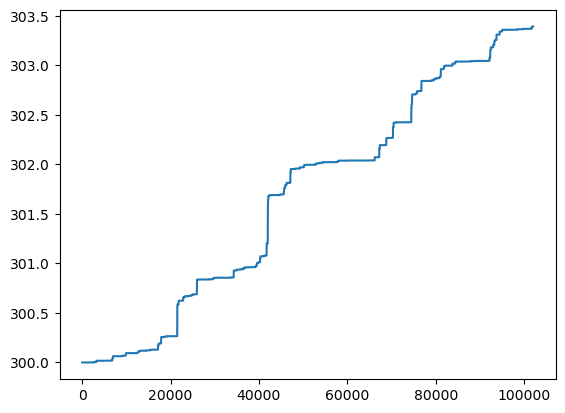

bnb_btc


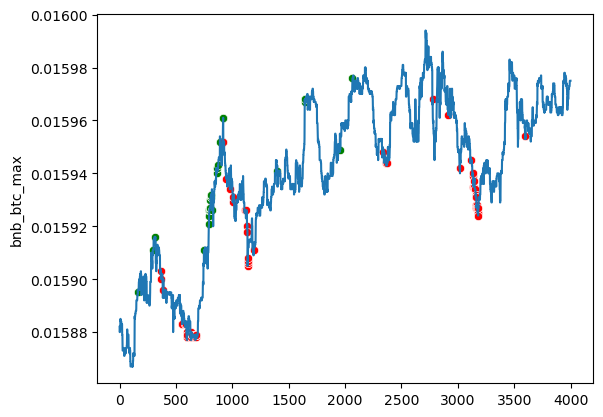

eth_btc


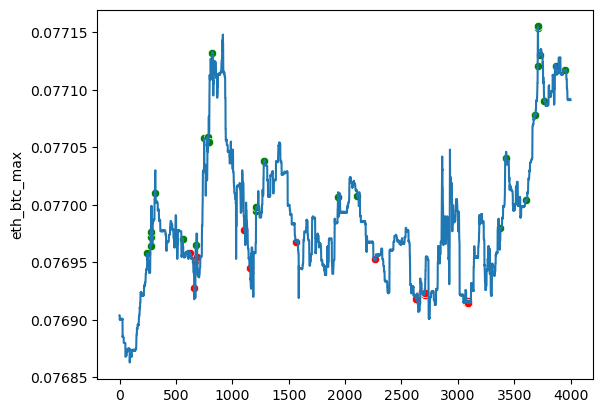

bnb_eth


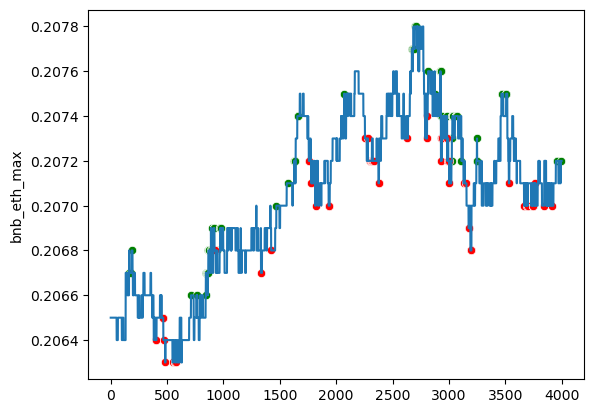

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 58, loss: 0.020
Traid counts: 9512 1: 2024 2: 1647 3: 941 4: 1184 5: 2041 6: 1675
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.32      0.01        31
         2.0       0.01      0.38      0.01        32
         3.0       0.01      0.29      0.01        21
         4.0       0.00      0.20      0.01        20
         5.0       0.01      0.49      0.02        35
         6.0       0.01      0.33      0.01        36

    accuracy                           0.91    102012
   macro avg       0.15      0.42      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.12090855648364
Общая комиссия в usdt: 7.58108898950305
Число сделок: 332
Прибыль от 300 usdt за 10

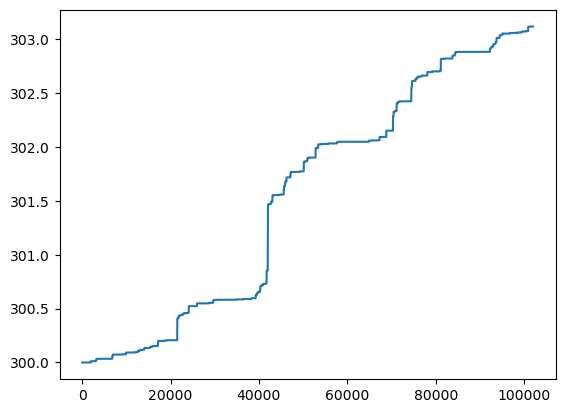

bnb_btc


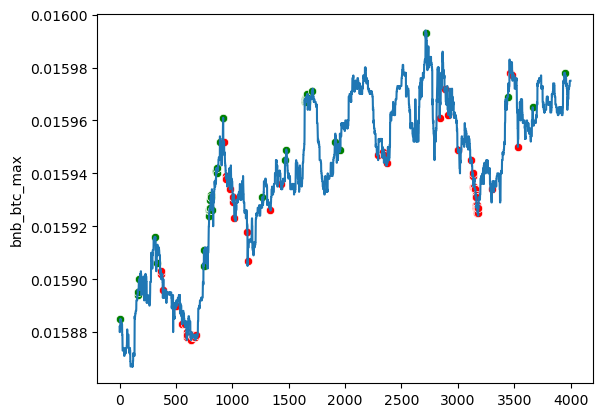

eth_btc


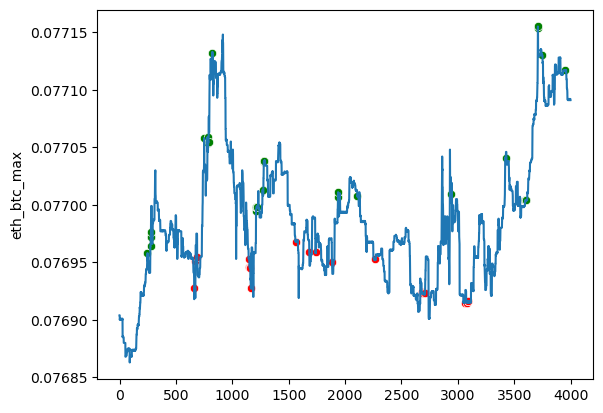

bnb_eth


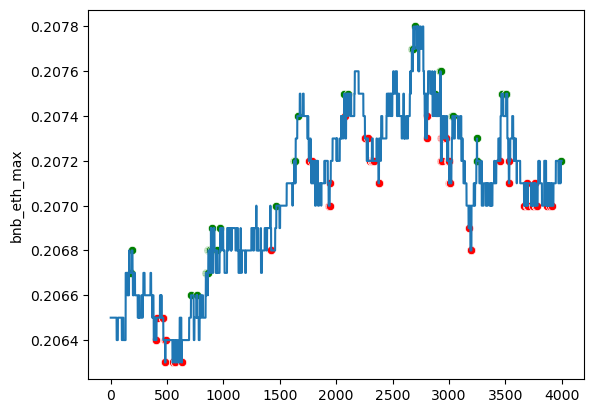

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 59, loss: 0.020
Traid counts: 9428 1: 1889 2: 1213 3: 1161 4: 1363 5: 1879 6: 1923
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.01      0.32      0.01        31
         2.0       0.00      0.16      0.01        32
         3.0       0.00      0.14      0.01        21
         4.0       0.01      0.35      0.01        20
         5.0       0.01      0.51      0.02        35
         6.0       0.01      0.47      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.41      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.2322080099051
Общая комиссия в usdt: 8.014178711799637
Число сделок: 336
Прибыль от 300 usdt за 1

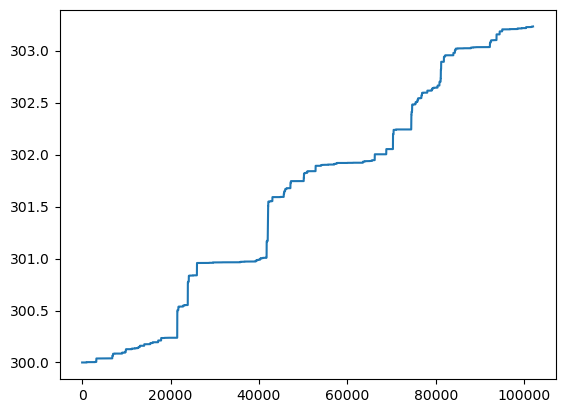

bnb_btc


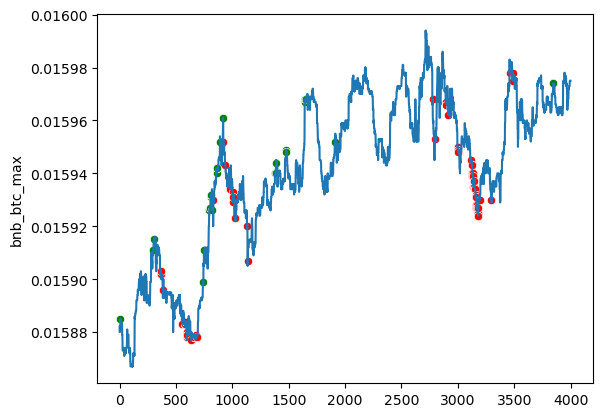

eth_btc


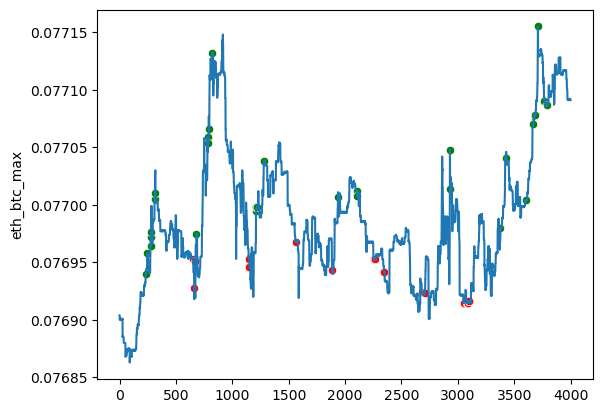

bnb_eth


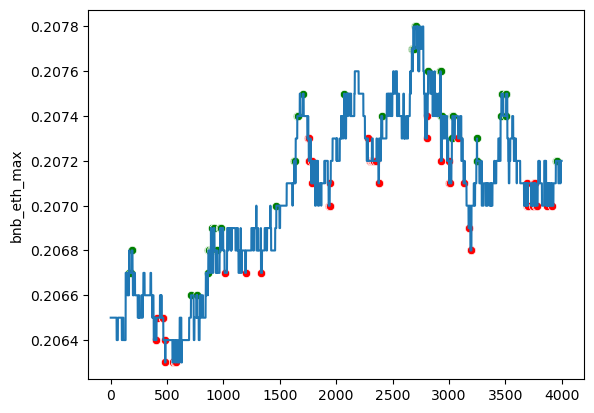

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 60, loss: 0.018
Traid counts: 8778 1: 1595 2: 1326 3: 1081 4: 1255 5: 1895 6: 1626
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.96    101837
         1.0       0.00      0.23      0.01        31
         2.0       0.00      0.19      0.01        32
         3.0       0.00      0.14      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.49      0.02        35
         6.0       0.01      0.42      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.38      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.664592019077
Общая комиссия в usdt: 7.058319722170934
Число сделок: 303
Прибыль от 300 usdt за 10

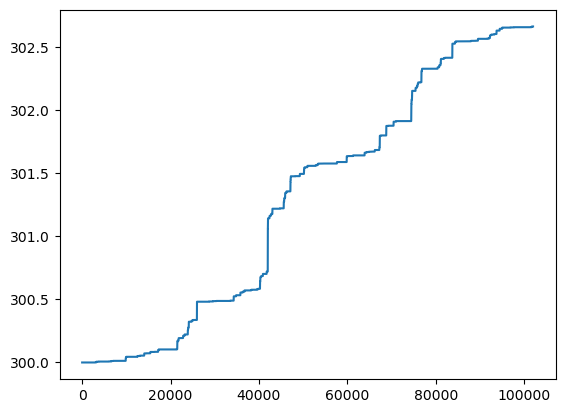

bnb_btc


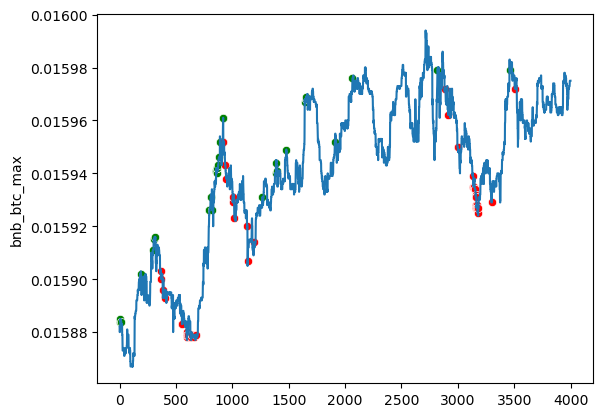

eth_btc


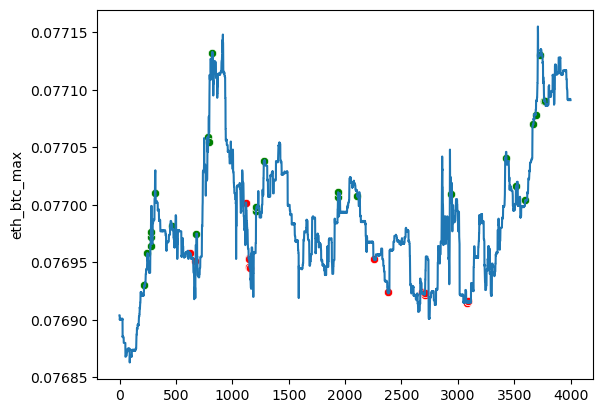

bnb_eth


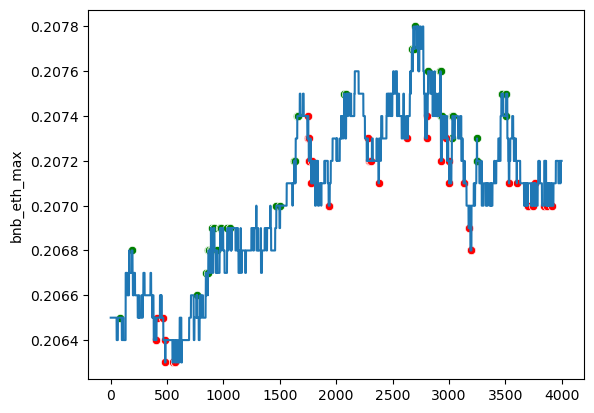

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 61, loss: 0.018
Traid counts: 9871 1: 2116 2: 1394 3: 1094 4: 1105 5: 1903 6: 2259
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.23      0.01        31
         2.0       0.01      0.22      0.01        32
         3.0       0.01      0.33      0.01        21
         4.0       0.01      0.35      0.01        20
         5.0       0.01      0.60      0.02        35
         6.0       0.01      0.42      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.44      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.00380410913505
Общая комиссия в usdt: 7.696263055420723
Число сделок: 327
Прибыль от 300 usdt за 

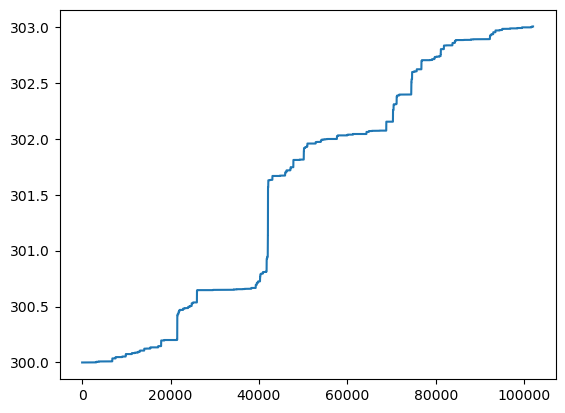

bnb_btc


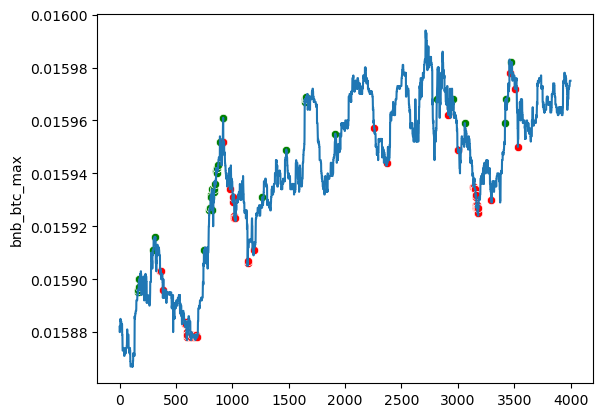

eth_btc


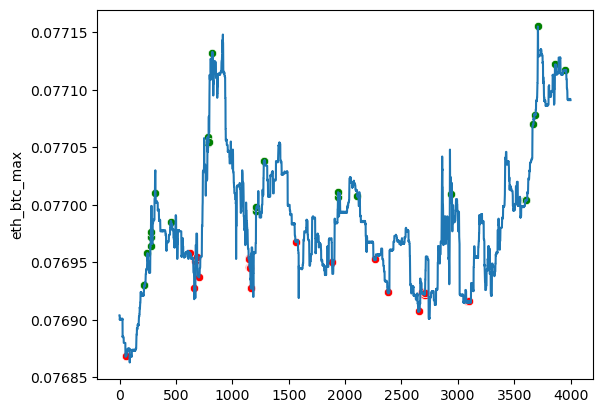

bnb_eth


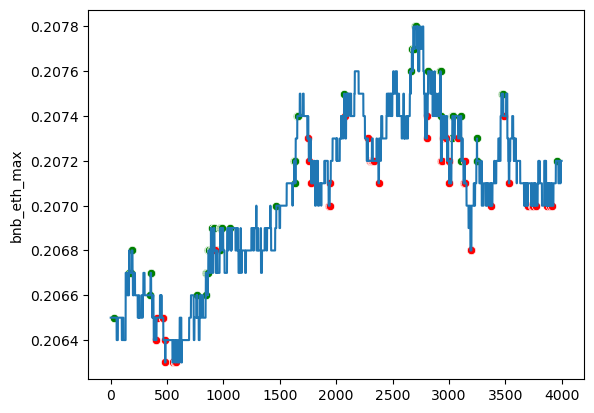

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 62, loss: 0.018
Traid counts: 8834 1: 1738 2: 1319 3: 1145 4: 1223 5: 1570 6: 1839
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.23      0.01        31
         2.0       0.00      0.09      0.00        32
         3.0       0.00      0.24      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.46      0.02        35
         6.0       0.01      0.44      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.38      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.9781538269034
Общая комиссия в usdt: 8.038565287544602
Число сделок: 290
Прибыль от 300 usdt за 1

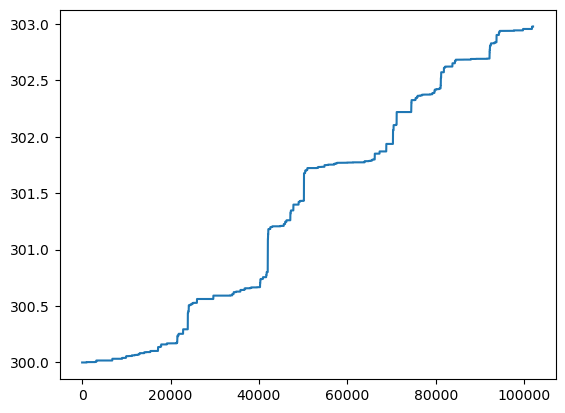

bnb_btc


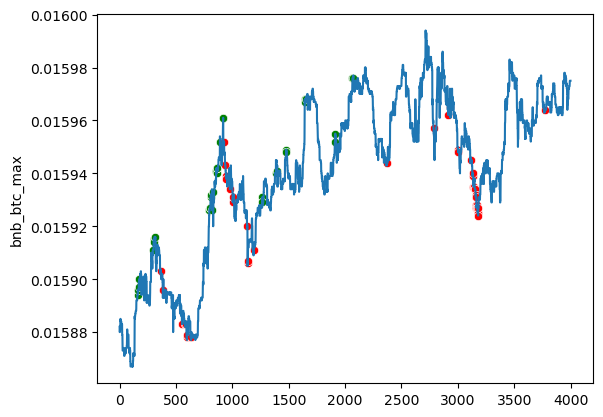

eth_btc


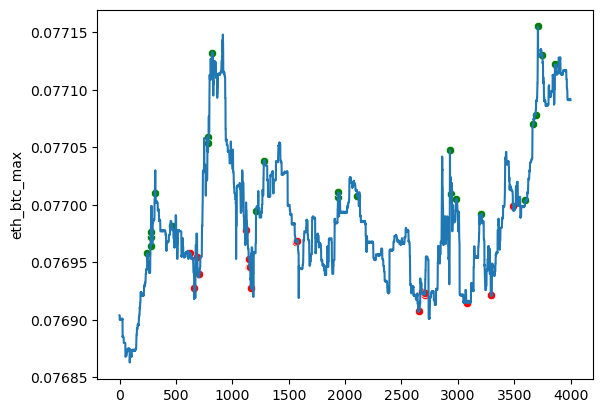

bnb_eth


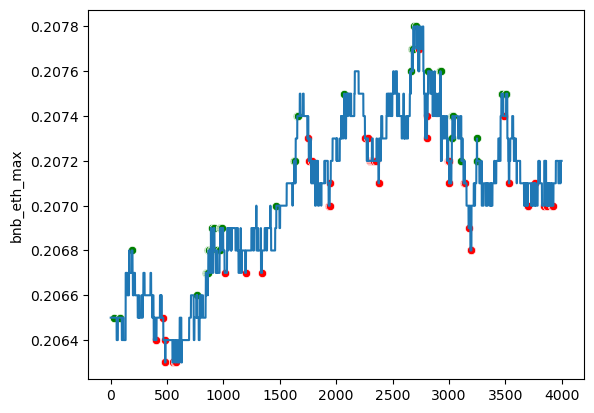

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 63, loss: 0.017
Traid counts: 9696 1: 1661 2: 1464 3: 980 4: 1474 5: 1893 6: 2224
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.26      0.01        31
         2.0       0.01      0.25      0.01        32
         3.0       0.00      0.19      0.01        21
         4.0       0.00      0.35      0.01        20
         5.0       0.01      0.66      0.02        35
         6.0       0.01      0.50      0.02        36

    accuracy                           0.90    102012
   macro avg       0.15      0.44      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.0254348073851
Общая комиссия в usdt: 8.124323627364369
Число сделок: 306
Прибыль от 300 usdt за 10

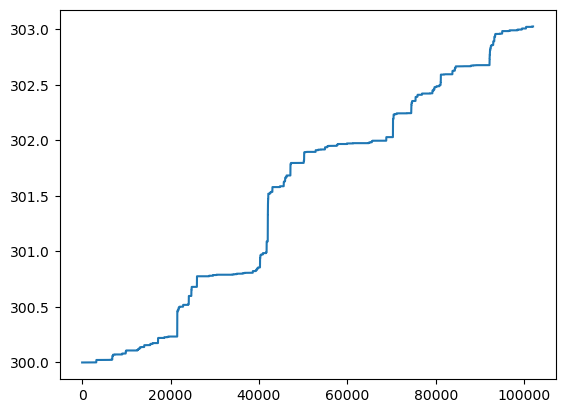

bnb_btc


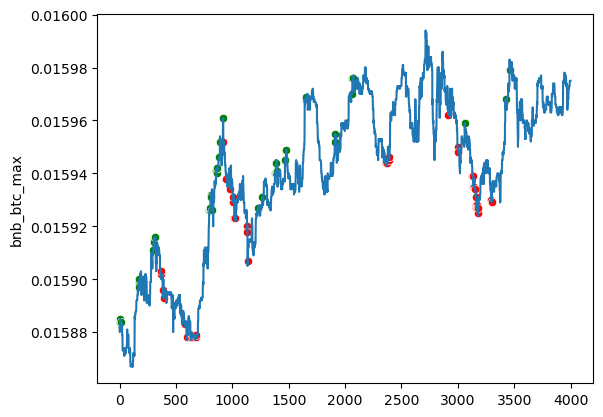

eth_btc


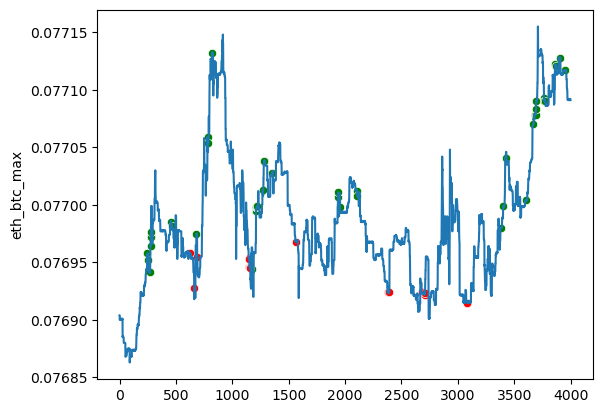

bnb_eth


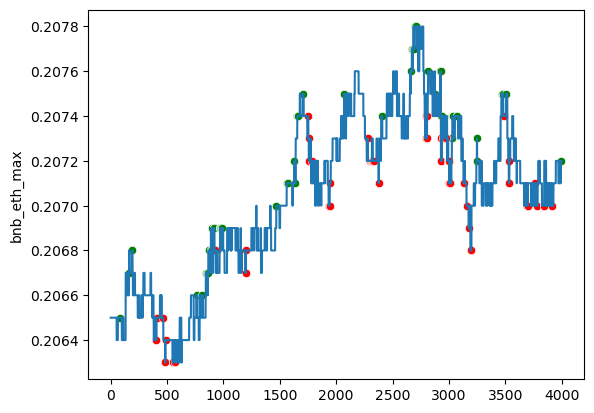

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 64, loss: 0.017
Traid counts: 9563 1: 1817 2: 1185 3: 1109 4: 1587 5: 1979 6: 1886
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.29      0.01        31
         2.0       0.00      0.16      0.01        32
         3.0       0.01      0.29      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.44      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.42      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.9251678701835
Общая комиссия в usdt: 7.535234729894726
Число сделок: 305
Прибыль от 300 usdt за 1

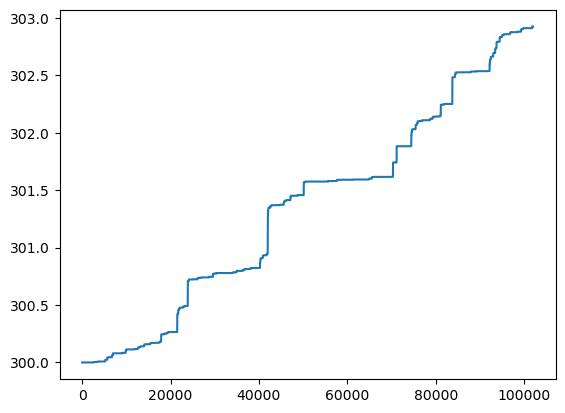

bnb_btc


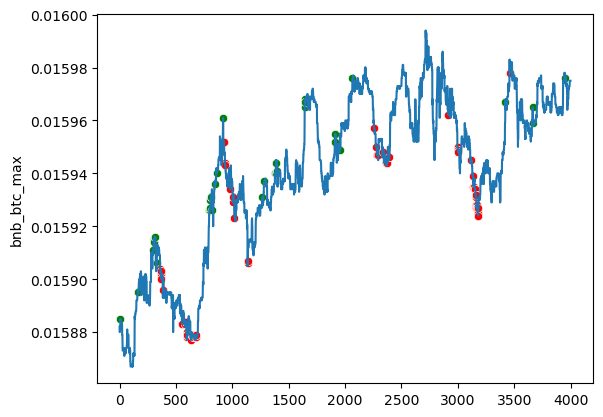

eth_btc


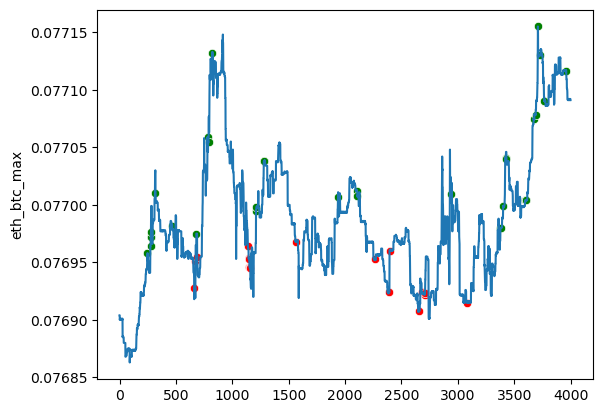

bnb_eth


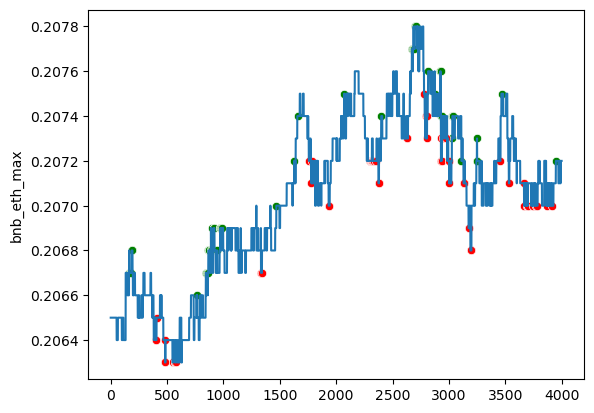

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 65, loss: 0.016
Traid counts: 9851 1: 1882 2: 1791 3: 862 4: 1519 5: 1909 6: 1888
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.29      0.01        31
         2.0       0.00      0.19      0.01        32
         3.0       0.01      0.24      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.54      0.02        35
         6.0       0.01      0.44      0.02        36

    accuracy                           0.90    102012
   macro avg       0.15      0.41      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.59698800267677
Общая комиссия в usdt: 6.982379925764438
Число сделок: 311
Прибыль от 300 usdt за 1

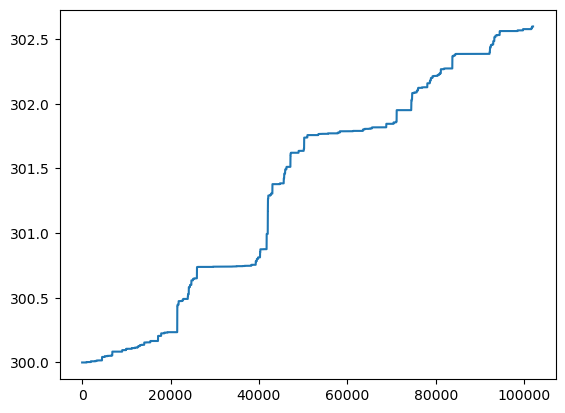

bnb_btc


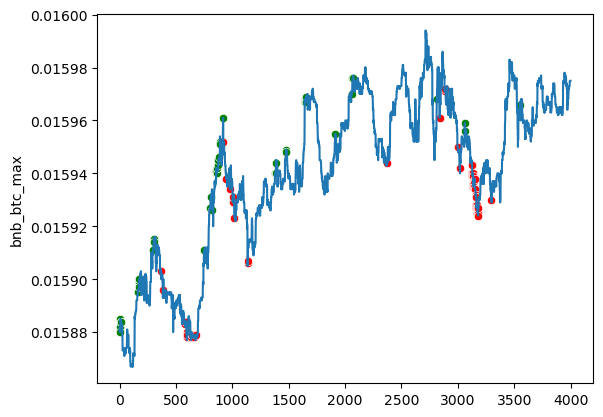

eth_btc


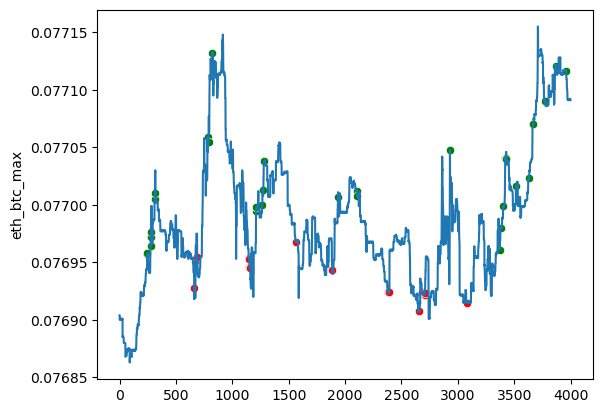

bnb_eth


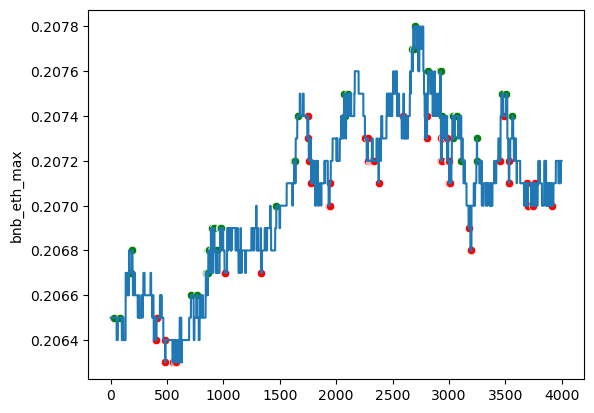

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 66, loss: 0.016
Traid counts: 9432 1: 1790 2: 1372 3: 957 4: 1109 5: 2123 6: 2081
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.19      0.01        31
         2.0       0.00      0.19      0.01        32
         3.0       0.00      0.19      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.54      0.02        35
         6.0       0.01      0.50      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.40      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.11362156382864
Общая комиссия в usdt: 8.206158710512456
Число сделок: 333
Прибыль от 300 usdt за 1

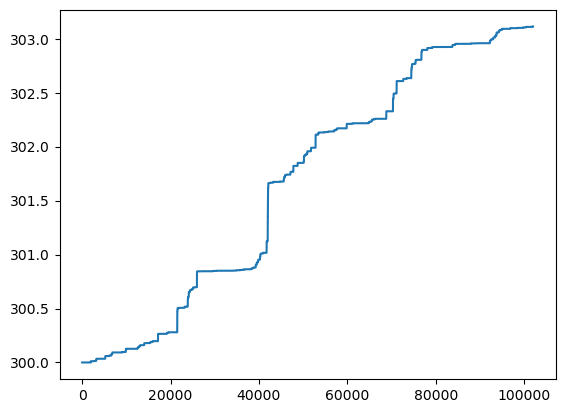

bnb_btc


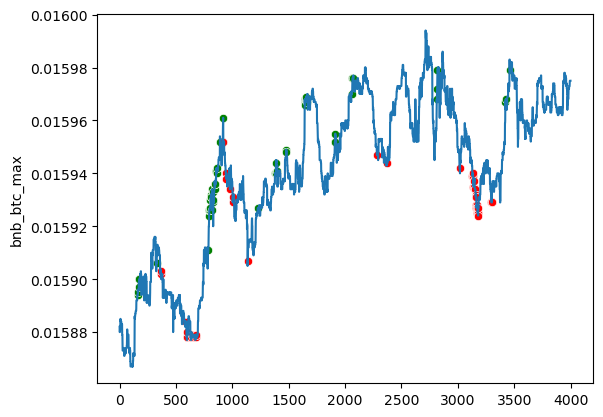

eth_btc


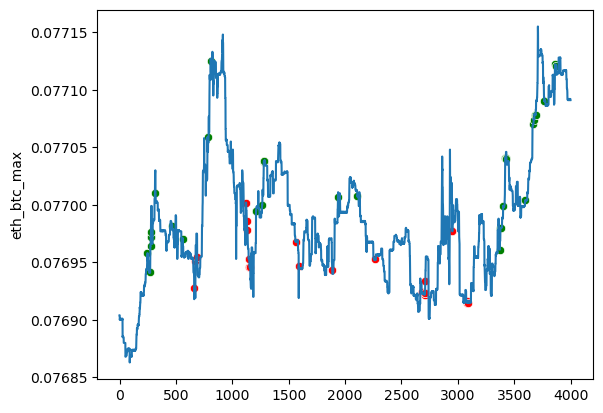

bnb_eth


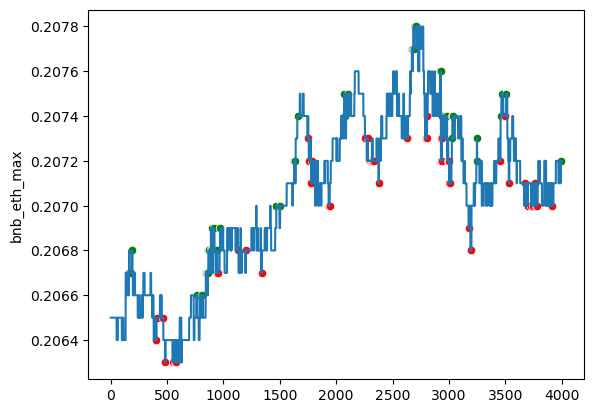

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 67, loss: 0.017
Traid counts: 9660 1: 1996 2: 1402 3: 1016 4: 1125 5: 2095 6: 2026
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.26      0.01        31
         2.0       0.00      0.19      0.01        32
         3.0       0.01      0.33      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.44      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.42      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.6449535646558
Общая комиссия в usdt: 6.409479218552617
Число сделок: 313
Прибыль от 300 usdt за 1

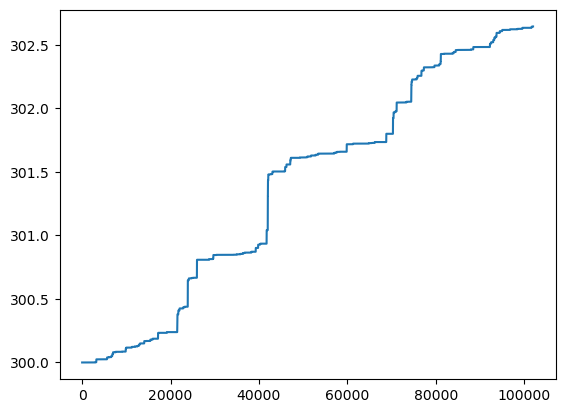

bnb_btc


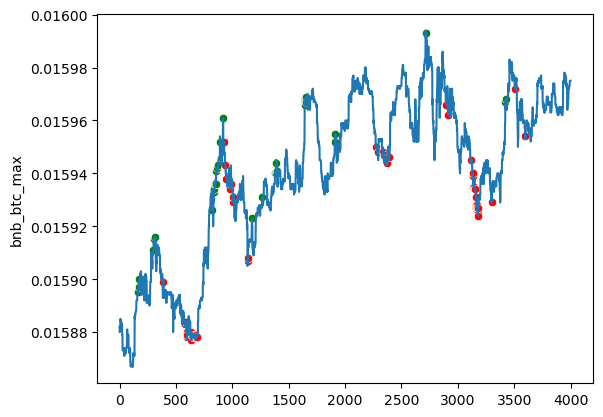

eth_btc


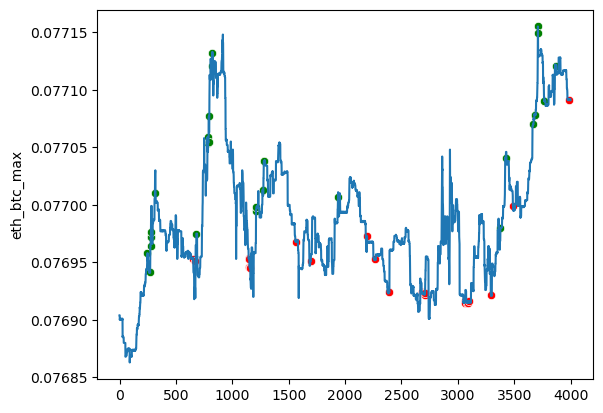

bnb_eth


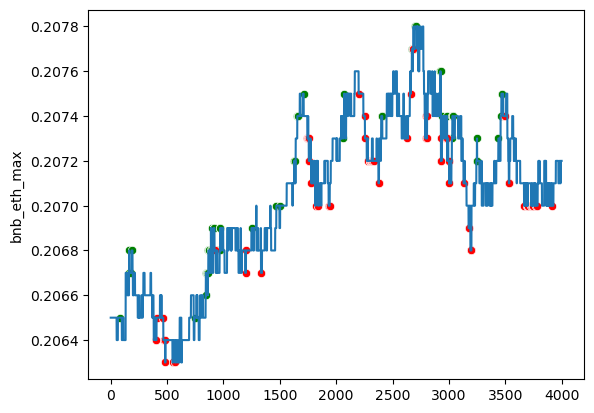

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 68, loss: 0.016
Traid counts: 9225 1: 1886 2: 1189 3: 999 4: 1116 5: 2001 6: 2034
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.01      0.39      0.01        31
         2.0       0.01      0.19      0.01        32
         3.0       0.01      0.33      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.43      0.01        35
         6.0       0.01      0.50      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.43      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.5053145539782
Общая комиссия в usdt: 7.096326537498437
Число сделок: 313
Прибыль от 300 usdt за 10

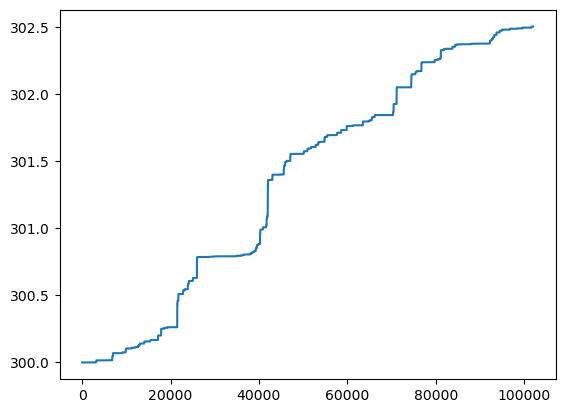

bnb_btc


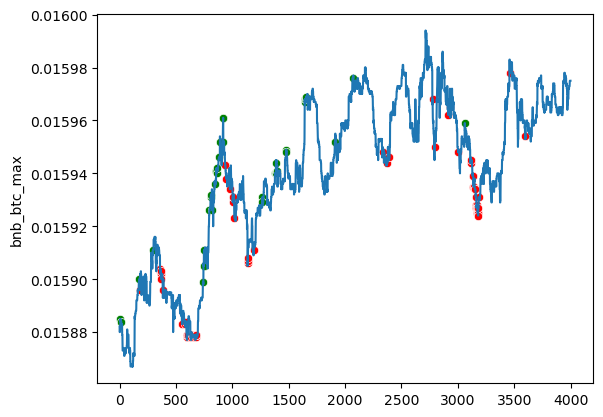

eth_btc


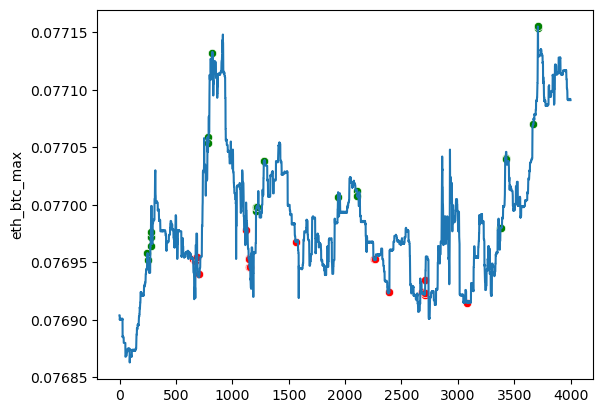

bnb_eth


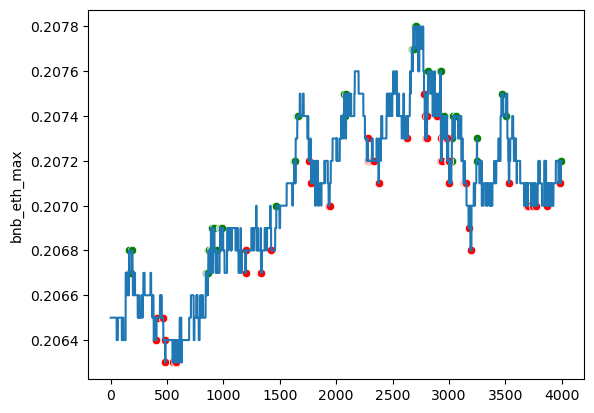

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 69, loss: 0.015
Traid counts: 9857 1: 1634 2: 1317 3: 1204 4: 1350 5: 2145 6: 2207
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.01      0.32      0.01        31
         2.0       0.00      0.19      0.01        32
         3.0       0.00      0.24      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.54      0.02        35
         6.0       0.01      0.58      0.02        36

    accuracy                           0.90    102012
   macro avg       0.15      0.44      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.8771832664174
Общая комиссия в usdt: 8.814797248817616
Число сделок: 302
Прибыль от 300 usdt за 1

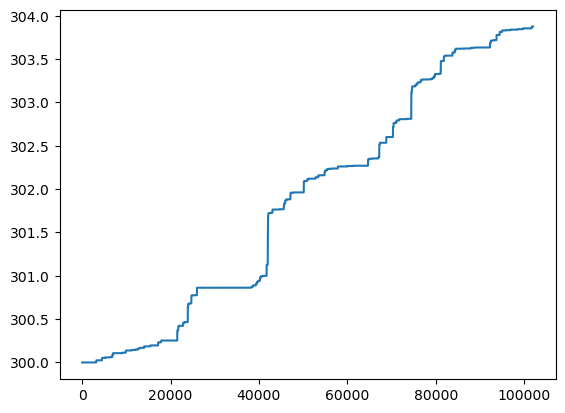

bnb_btc


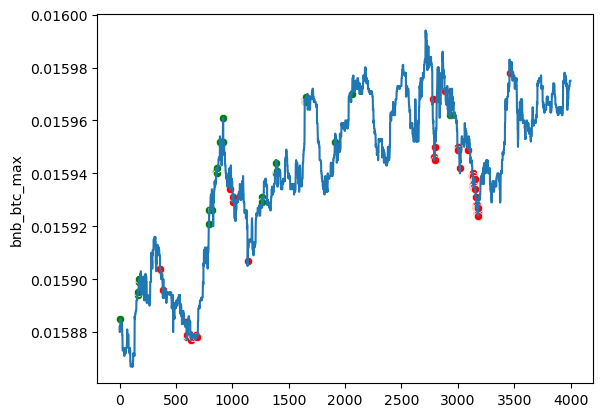

eth_btc


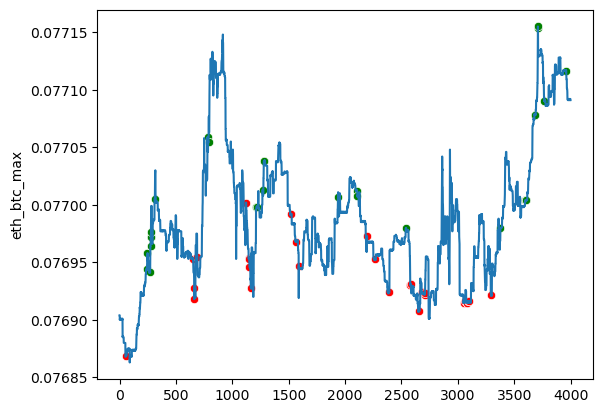

bnb_eth


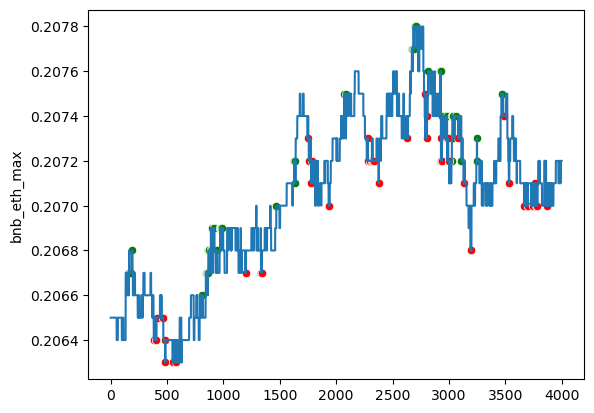

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 70, loss: 0.015
Traid counts: 9922 1: 1787 2: 1419 3: 964 4: 1414 5: 1796 6: 2542
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.01      0.35      0.01        31
         2.0       0.01      0.31      0.01        32
         3.0       0.00      0.14      0.01        21
         4.0       0.01      0.40      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.50      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.46      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.1188874680445
Общая комиссия в usdt: 7.558204893029408
Число сделок: 308
Прибыль от 300 usdt за 10

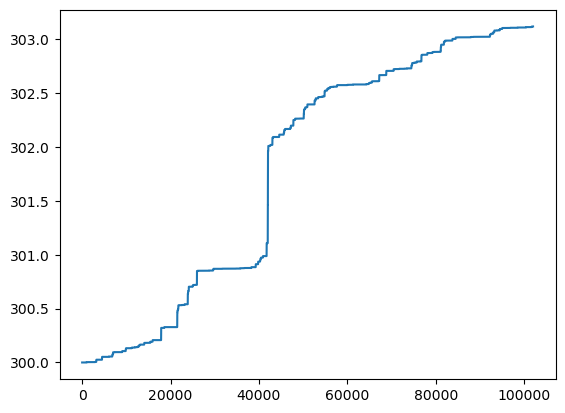

bnb_btc


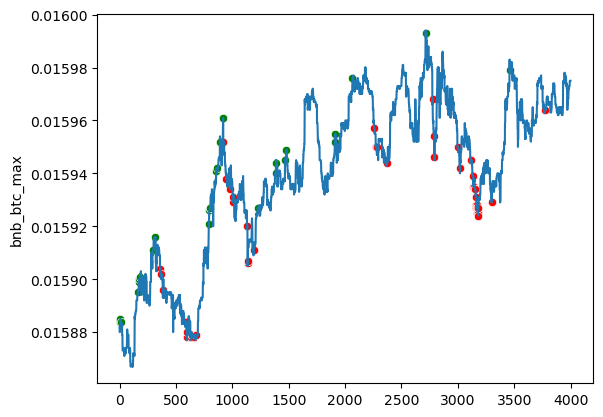

eth_btc


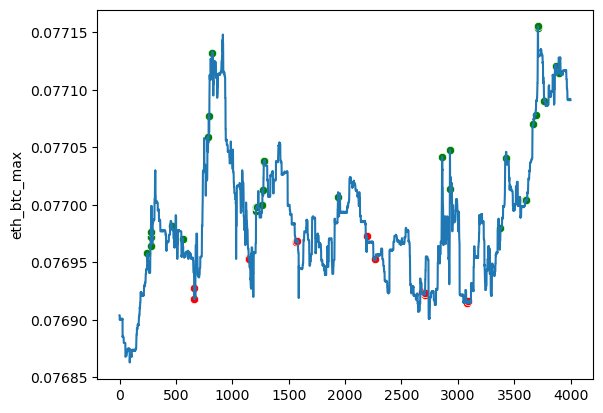

bnb_eth


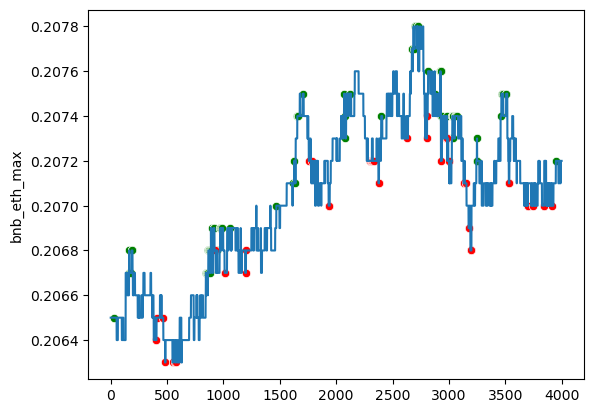

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 71, loss: 0.017
Traid counts: 9800 1: 2099 2: 1221 3: 1025 4: 1249 5: 1983 6: 2223
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.32      0.01        31
         2.0       0.01      0.22      0.01        32
         3.0       0.01      0.29      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.54      0.02        35
         6.0       0.01      0.50      0.02        36

    accuracy                           0.90    102012
   macro avg       0.15      0.44      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.80647176031664
Общая комиссия в usdt: 7.953867259048964
Число сделок: 324
Прибыль от 300 usdt за 

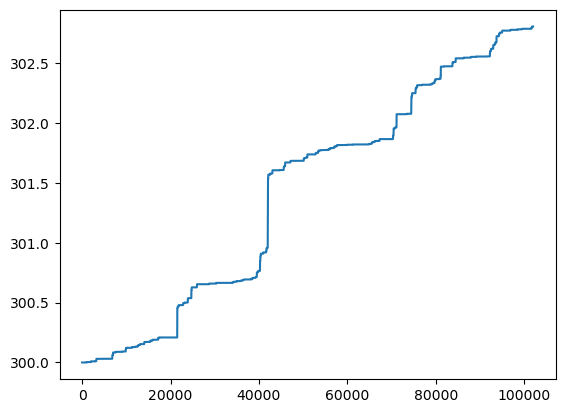

bnb_btc


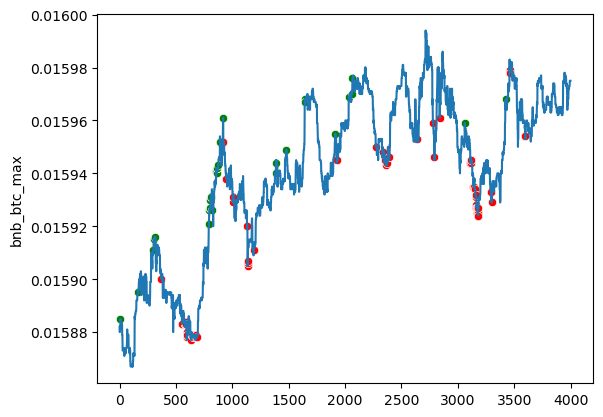

eth_btc


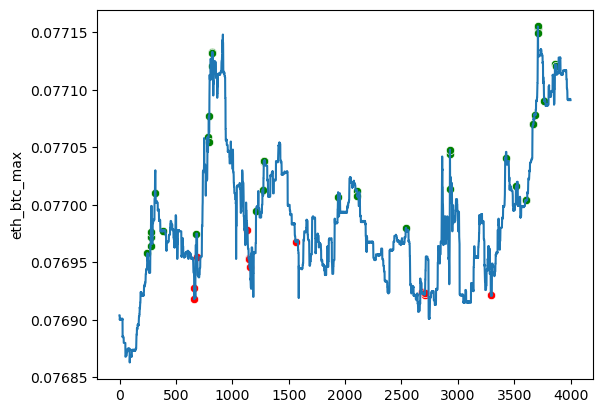

bnb_eth


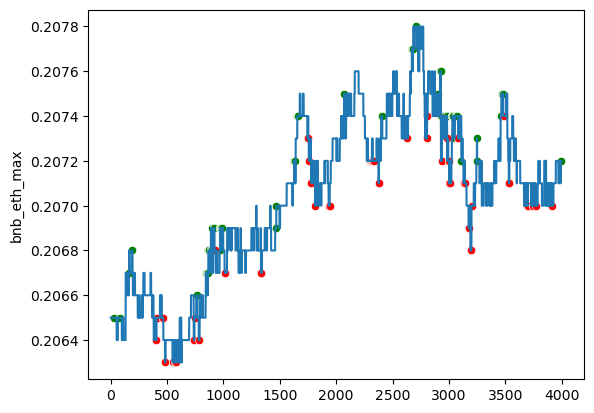

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 72, loss: 0.015
Traid counts: 8511 1: 1722 2: 1173 3: 877 4: 1256 5: 1723 6: 1760
              precision    recall  f1-score   support

         0.0       1.00      0.92      0.96    101837
         1.0       0.01      0.35      0.01        31
         2.0       0.01      0.28      0.01        32
         3.0       0.00      0.14      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.47      0.02        36

    accuracy                           0.92    102012
   macro avg       0.15      0.43      0.15    102012
weighted avg       1.00      0.92      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.8110591143384
Общая комиссия в usdt: 6.696034952622532
Число сделок: 280
Прибыль от 300 usdt за 10

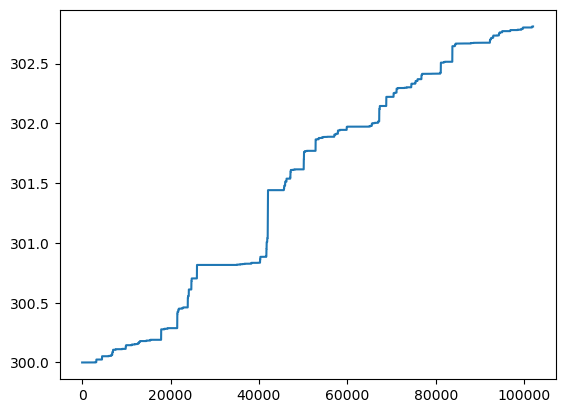

bnb_btc


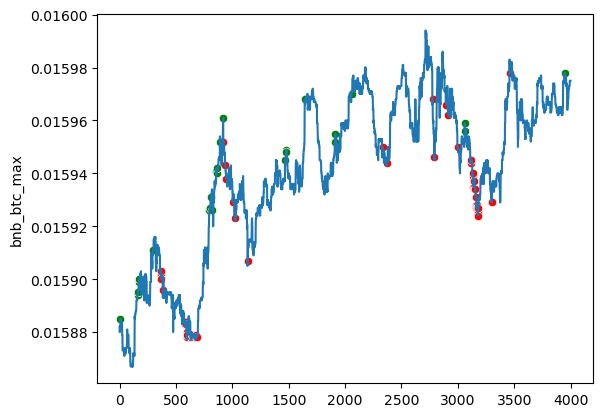

eth_btc


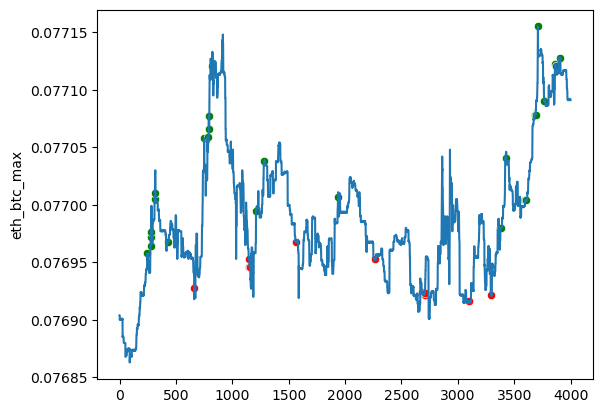

bnb_eth


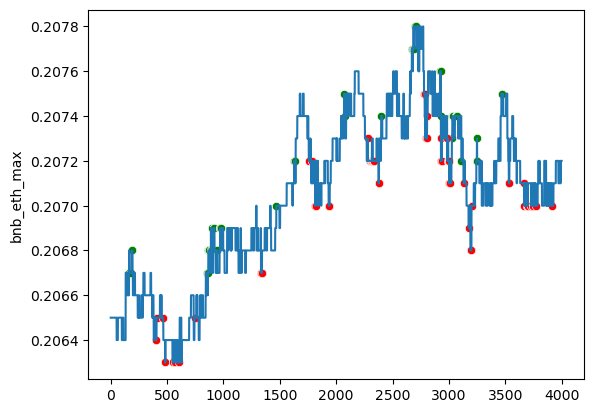

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 73, loss: 0.014
Traid counts: 9357 1: 2190 2: 992 3: 927 4: 1480 5: 1680 6: 2088
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.01      0.35      0.01        31
         2.0       0.00      0.12      0.01        32
         3.0       0.01      0.24      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.51      0.02        35
         6.0       0.01      0.56      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.43      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.65528596806666
Общая комиссия в usdt: 6.7672019552685025
Число сделок: 287
Прибыль от 300 usdt за 1

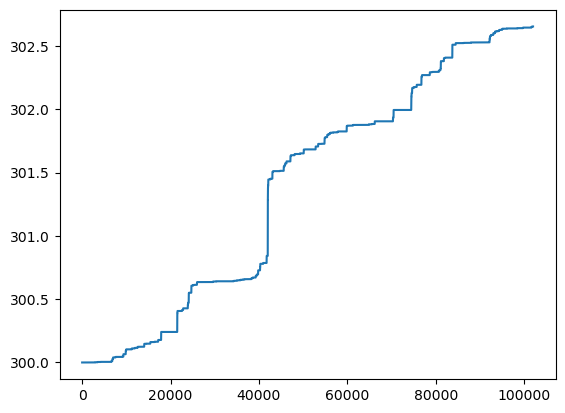

bnb_btc


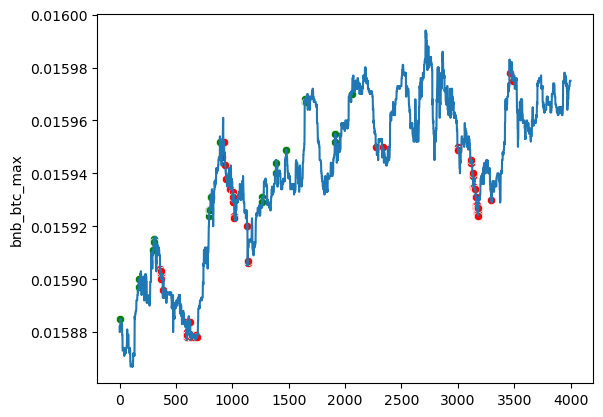

eth_btc


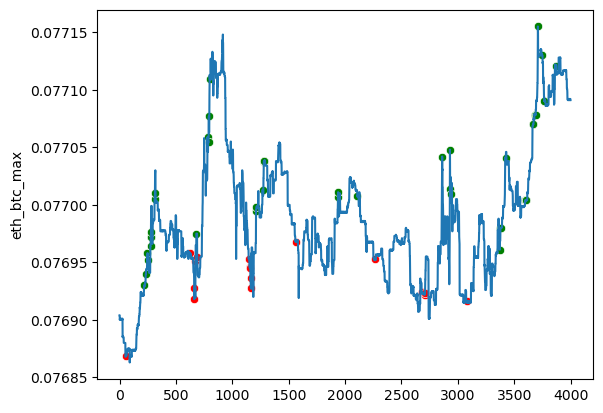

bnb_eth


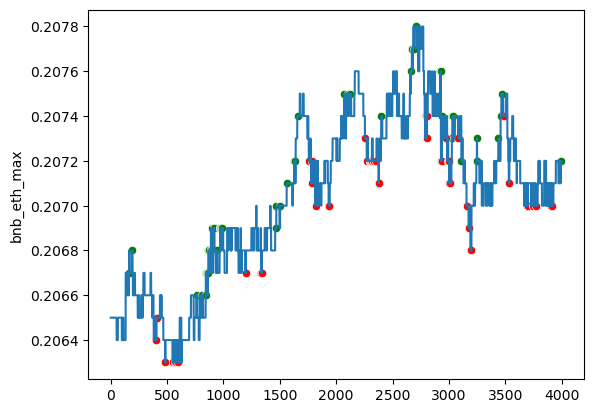

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 74, loss: 0.016
Traid counts: 9494 1: 2003 2: 1171 3: 1053 4: 1165 5: 2028 6: 2074
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.01      0.35      0.01        31
         2.0       0.01      0.25      0.01        32
         3.0       0.00      0.19      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.60      0.02        35
         6.0       0.01      0.39      0.01        36

    accuracy                           0.91    102012
   macro avg       0.15      0.42      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.78568582951016
Общая комиссия в usdt: 7.093532350065799
Число сделок: 303
Прибыль от 300 usdt за 

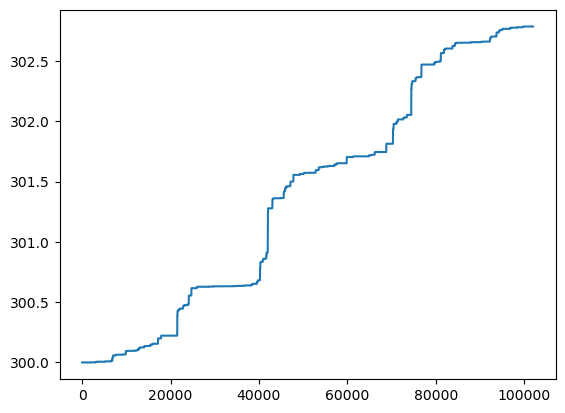

bnb_btc


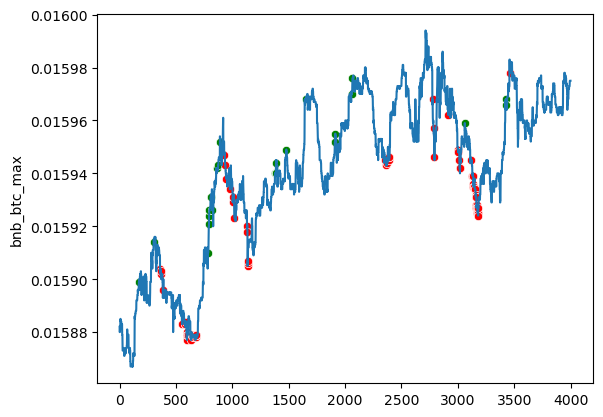

eth_btc


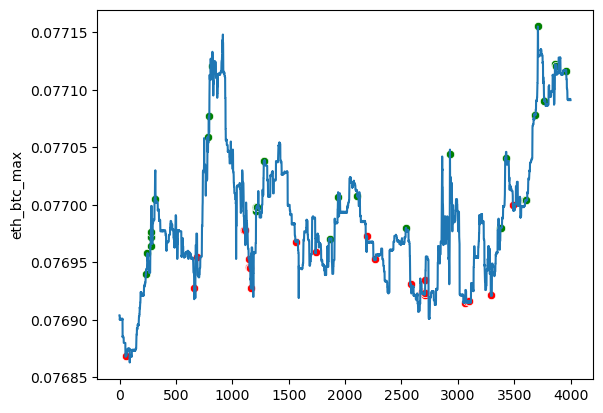

bnb_eth


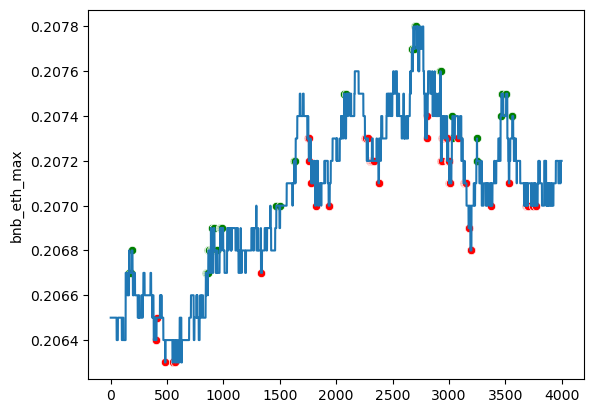

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 75, loss: 0.013
Traid counts: 9276 1: 1706 2: 1172 3: 932 4: 1642 5: 2003 6: 1821
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.26      0.01        31
         2.0       0.01      0.19      0.01        32
         3.0       0.01      0.29      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.63      0.02        35
         6.0       0.01      0.50      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.43      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.60409436200445
Общая комиссия в usdt: 8.19083589352451
Число сделок: 314
Прибыль от 300 usdt за 10

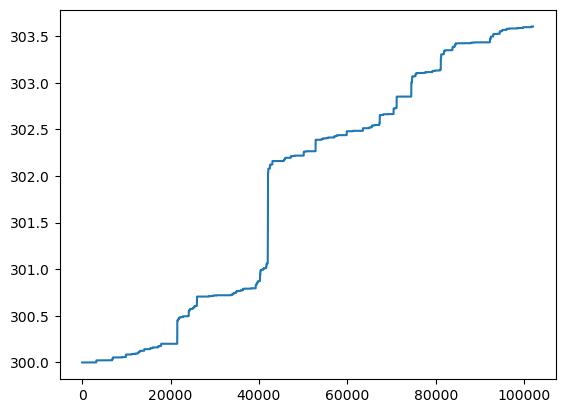

bnb_btc


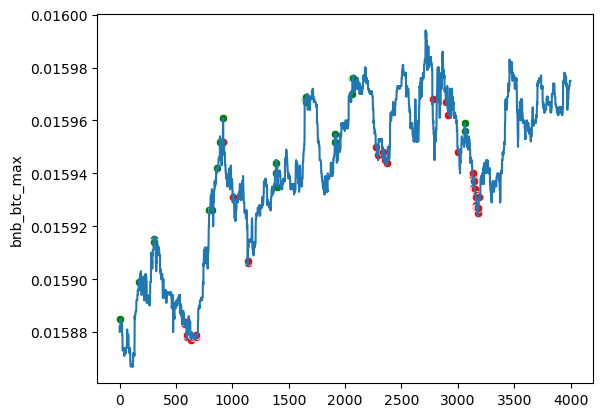

eth_btc


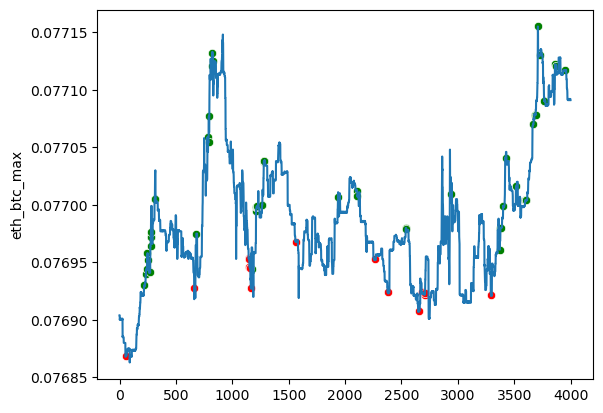

bnb_eth


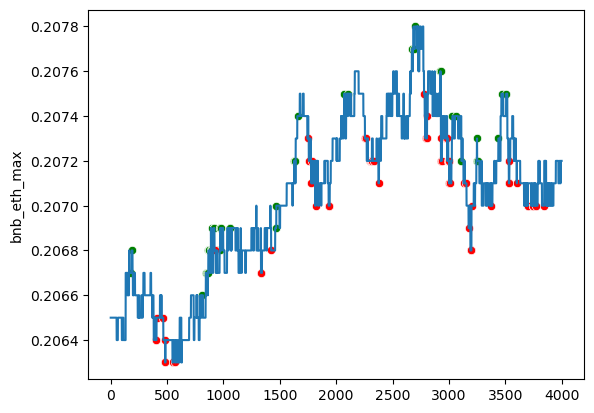

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 76, loss: 0.014
Traid counts: 9211 1: 2119 2: 1281 3: 876 4: 1401 5: 1710 6: 1824
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.29      0.01        31
         2.0       0.00      0.12      0.01        32
         3.0       0.01      0.24      0.01        21
         4.0       0.00      0.35      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.42      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.41      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.7096019433591
Общая комиссия в usdt: 6.288521371307553
Число сделок: 264
Прибыль от 300 usdt за 10

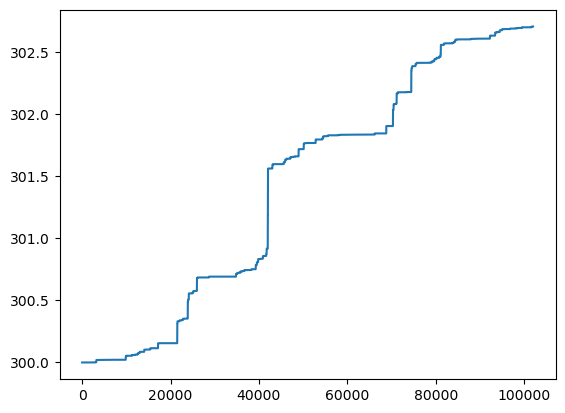

bnb_btc


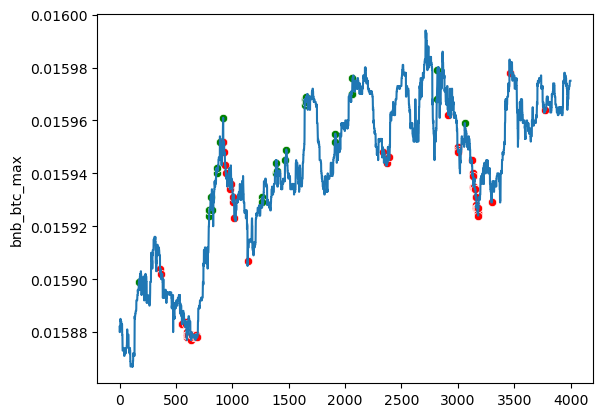

eth_btc


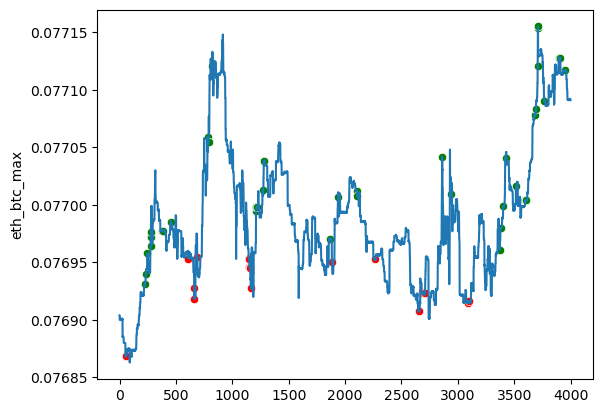

bnb_eth


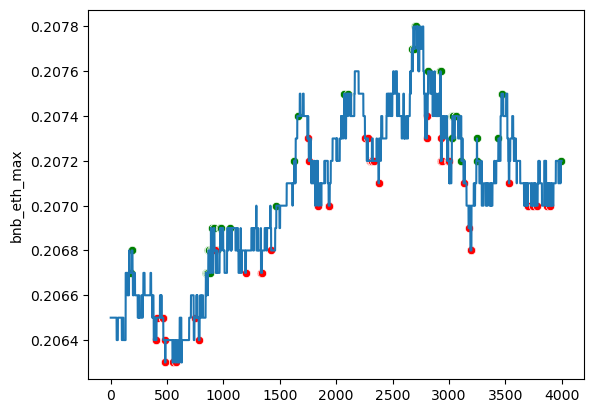

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 77, loss: 0.013
Traid counts: 9734 1: 2020 2: 1484 3: 957 4: 1445 5: 1604 6: 2224
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.01      0.35      0.01        31
         2.0       0.01      0.28      0.01        32
         3.0       0.01      0.24      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.51      0.02        35
         6.0       0.01      0.47      0.02        36

    accuracy                           0.90    102012
   macro avg       0.15      0.44      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.11429725156717
Общая комиссия в usdt: 7.337241096007227
Число сделок: 290
Прибыль от 300 usdt за 1

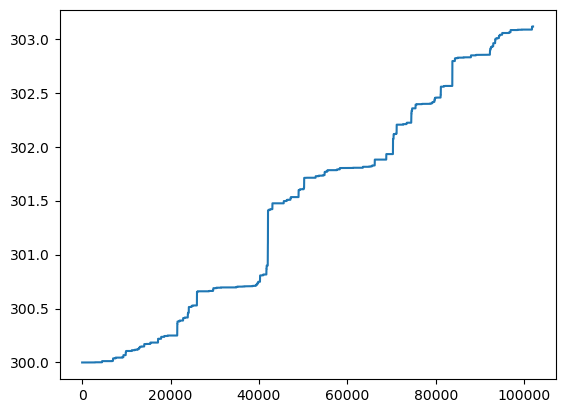

bnb_btc


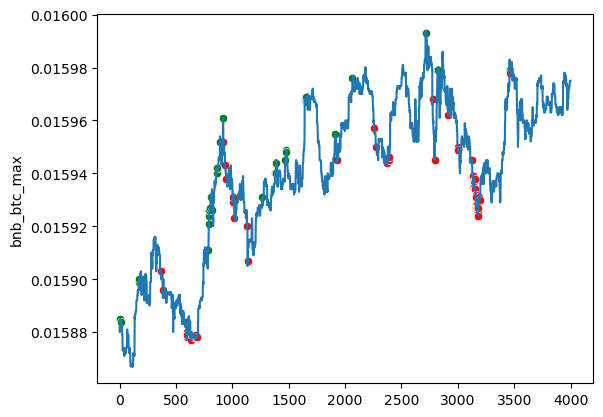

eth_btc


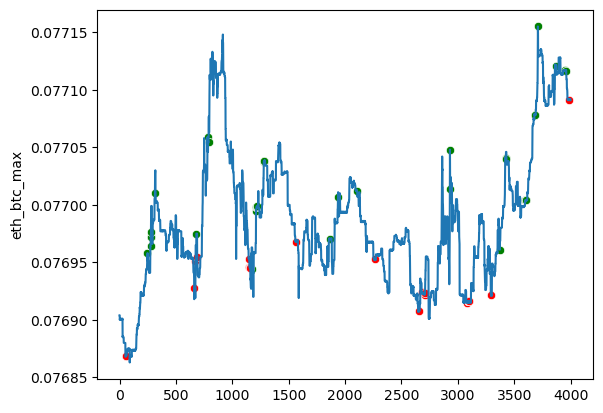

bnb_eth


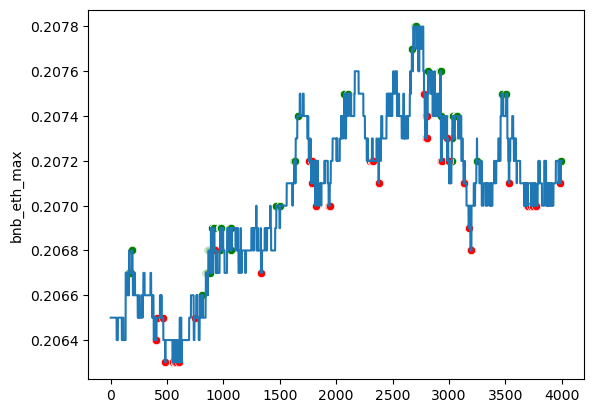

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 78, loss: 0.015
Traid counts: 9917 1: 1823 2: 1477 3: 1076 4: 1366 5: 1995 6: 2180
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.00      0.29      0.01        31
         2.0       0.00      0.22      0.01        32
         3.0       0.01      0.29      0.01        21
         4.0       0.01      0.40      0.01        20
         5.0       0.01      0.49      0.02        35
         6.0       0.01      0.47      0.02        36

    accuracy                           0.90    102012
   macro avg       0.15      0.44      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.9803871347334
Общая комиссия в usdt: 7.689861973553986
Число сделок: 313
Прибыль от 300 usdt за 1

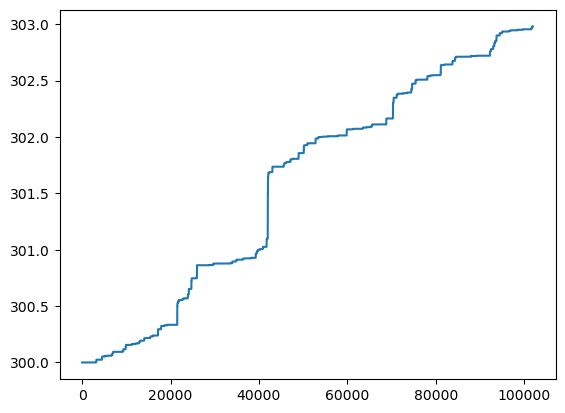

bnb_btc


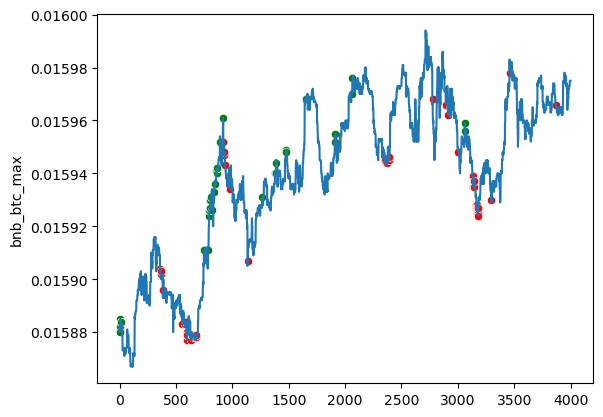

eth_btc


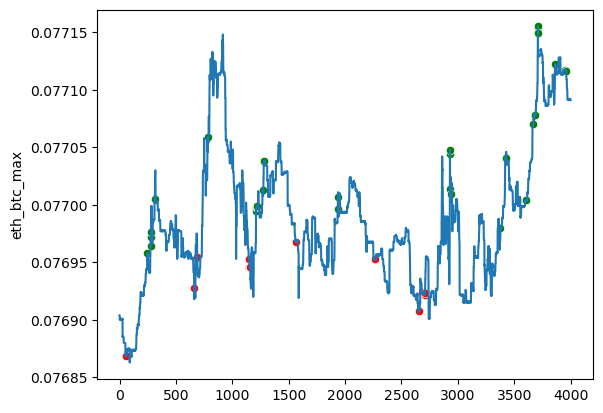

bnb_eth


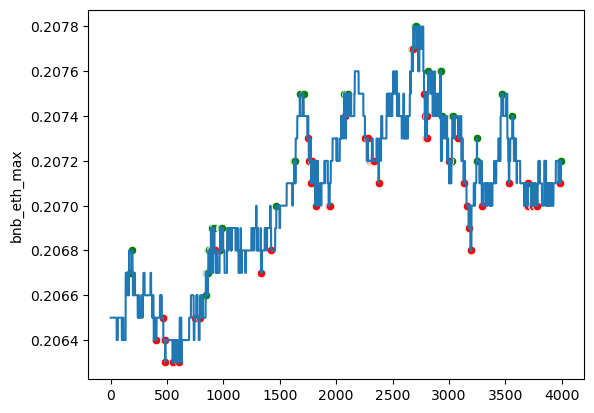

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 79, loss: 0.013
Traid counts: 10151 1: 1712 2: 1501 3: 1175 4: 1307 5: 2329 6: 2127
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.01      0.35      0.01        31
         2.0       0.00      0.22      0.01        32
         3.0       0.01      0.33      0.01        21
         4.0       0.01      0.40      0.01        20
         5.0       0.01      0.49      0.01        35
         6.0       0.01      0.44      0.01        36

    accuracy                           0.90    102012
   macro avg       0.15      0.45      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.81066058275275
Общая комиссия в usdt: 7.995599701661609
Число сделок: 372
Прибыль от 300 usdt за

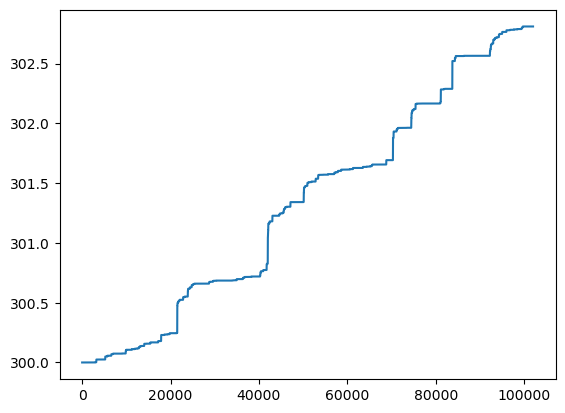

bnb_btc


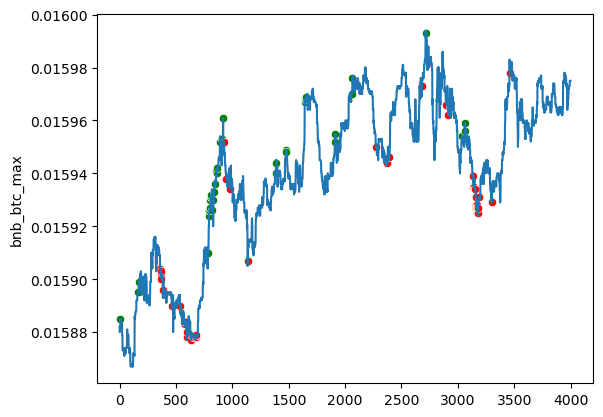

eth_btc


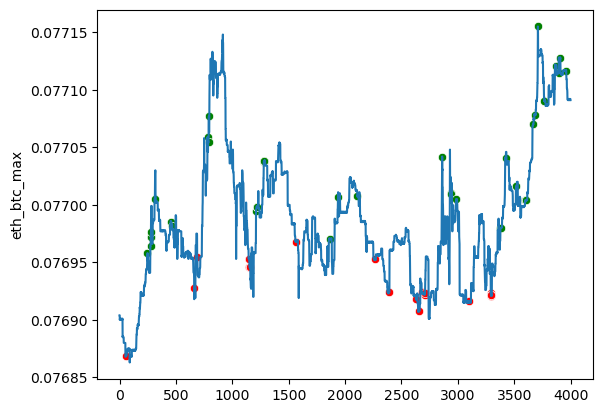

bnb_eth


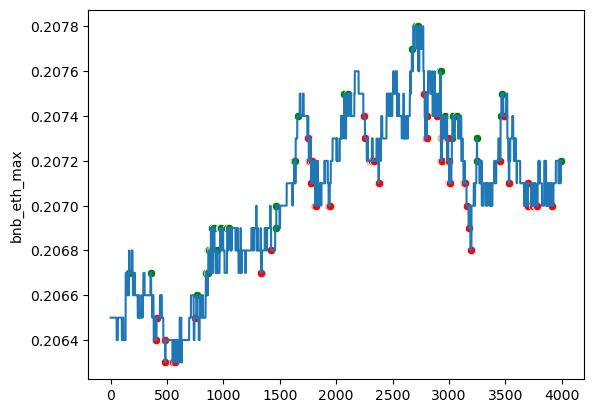

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 80, loss: 0.014
Traid counts: 9728 1: 1924 2: 1945 3: 948 4: 1139 5: 1834 6: 1938
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.01      0.32      0.01        31
         2.0       0.00      0.25      0.01        32
         3.0       0.00      0.14      0.01        21
         4.0       0.01      0.30      0.01        20
         5.0       0.01      0.66      0.02        35
         6.0       0.01      0.50      0.02        36

    accuracy                           0.90    102012
   macro avg       0.15      0.44      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.334964640191
Общая комиссия в usdt: 5.42667906788571
Число сделок: 278
Прибыль от 300 usdt за 100_

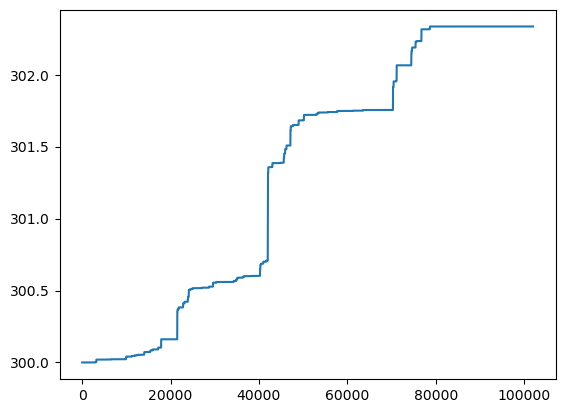

bnb_btc


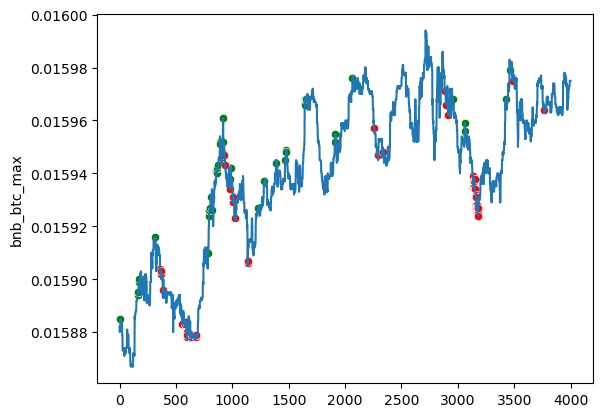

eth_btc


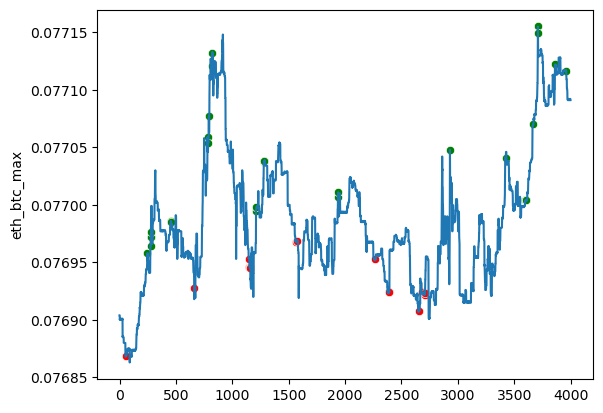

bnb_eth


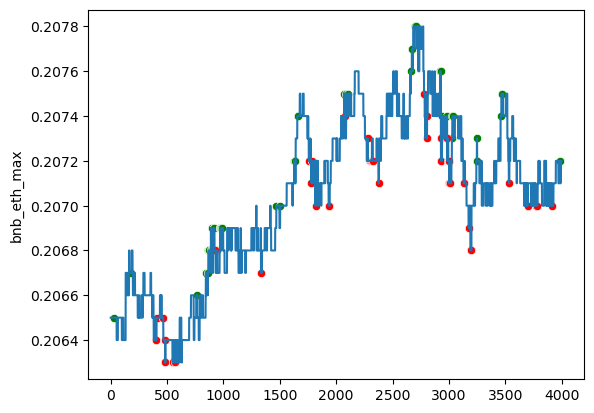

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 81, loss: 0.014
Traid counts: 9676 1: 1827 2: 1340 3: 994 4: 979 5: 2610 6: 1926
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.26      0.01        31
         2.0       0.01      0.34      0.02        32
         3.0       0.01      0.24      0.01        21
         4.0       0.01      0.30      0.01        20
         5.0       0.01      0.54      0.01        35
         6.0       0.01      0.44      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.43      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.9424322988068
Общая комиссия в usdt: 7.326352802055529
Число сделок: 356
Прибыль от 300 usdt за 100

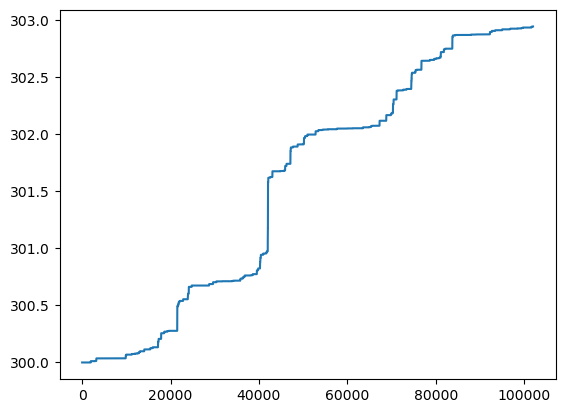

bnb_btc


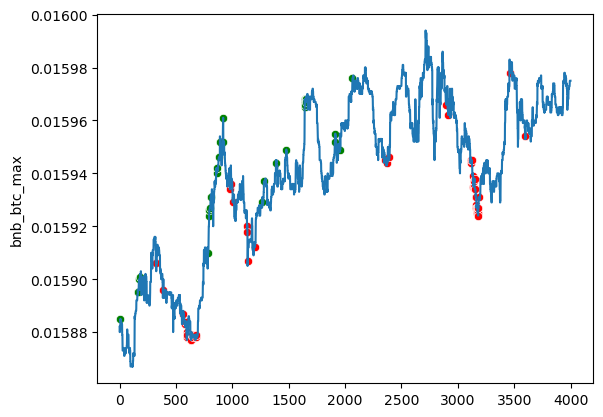

eth_btc


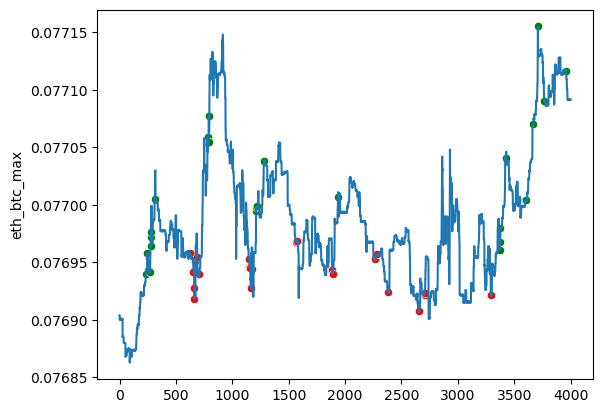

bnb_eth


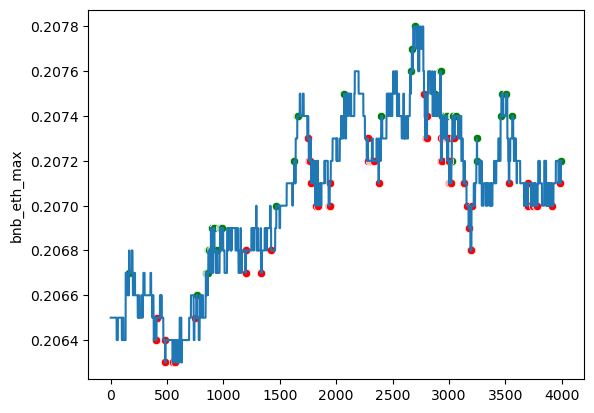

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 82, loss: 0.012
Traid counts: 9212 1: 2117 2: 1220 3: 824 4: 1270 5: 1651 6: 2130
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.23      0.01        31
         2.0       0.00      0.12      0.01        32
         3.0       0.01      0.29      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.49      0.02        35
         6.0       0.01      0.44      0.01        36

    accuracy                           0.91    102012
   macro avg       0.15      0.40      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.6342676121759
Общая комиссия в usdt: 5.902426189532218
Число сделок: 279
Прибыль от 300 usdt за 10

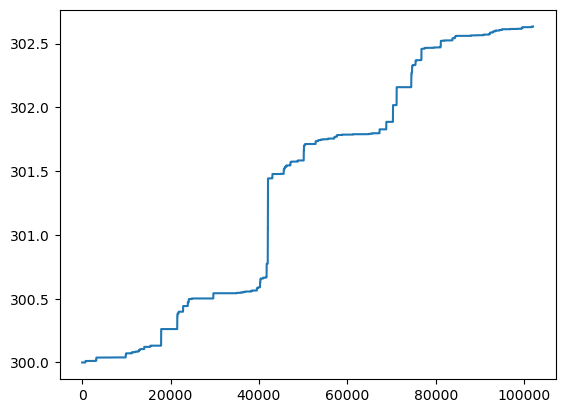

bnb_btc


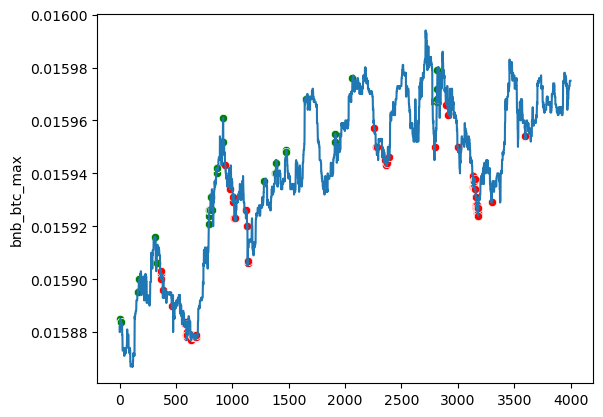

eth_btc


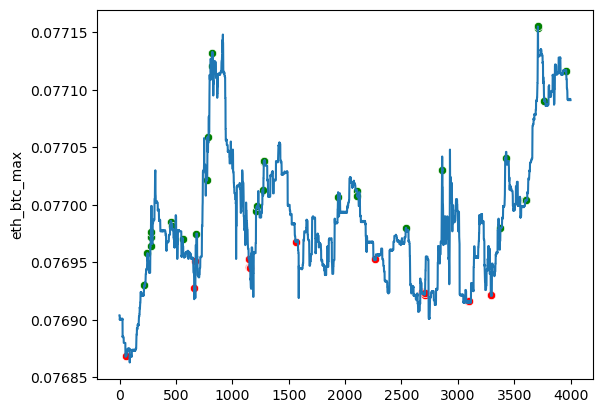

bnb_eth


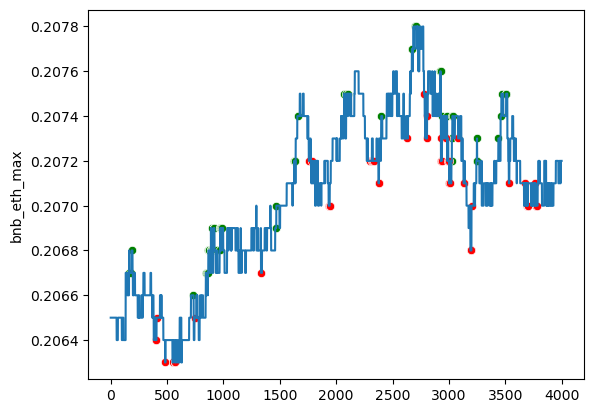

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 83, loss: 0.014
Traid counts: 9713 1: 2027 2: 1509 3: 1121 4: 1385 5: 1744 6: 1927
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.23      0.01        31
         2.0       0.01      0.25      0.01        32
         3.0       0.00      0.19      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.51      0.02        35
         6.0       0.01      0.47      0.02        36

    accuracy                           0.90    102012
   macro avg       0.15      0.40      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.56698071112123
Общая комиссия в usdt: 6.336265408319704
Число сделок: 284
Прибыль от 300 usdt за 

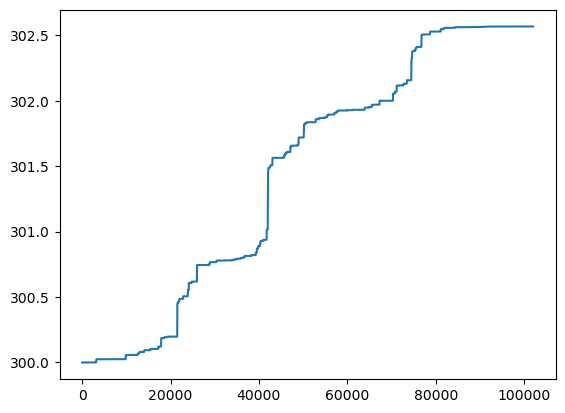

bnb_btc


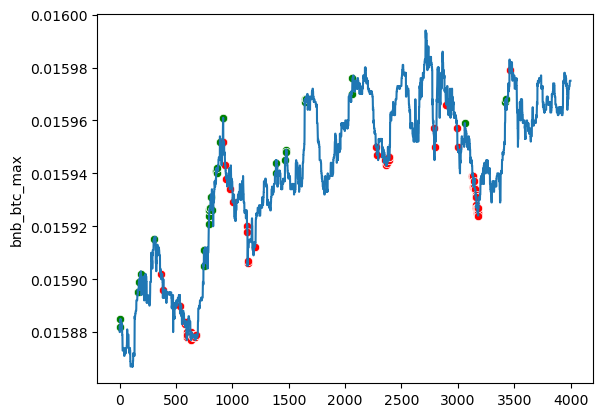

eth_btc


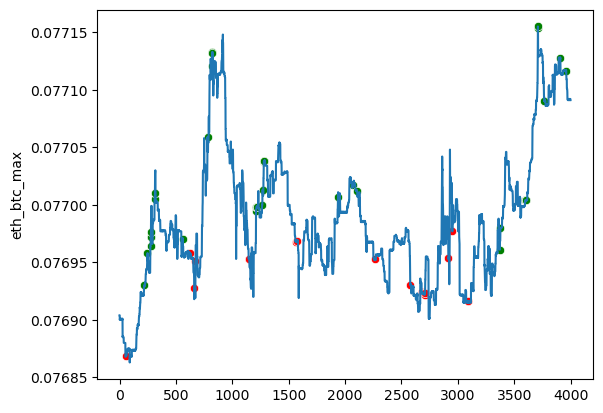

bnb_eth


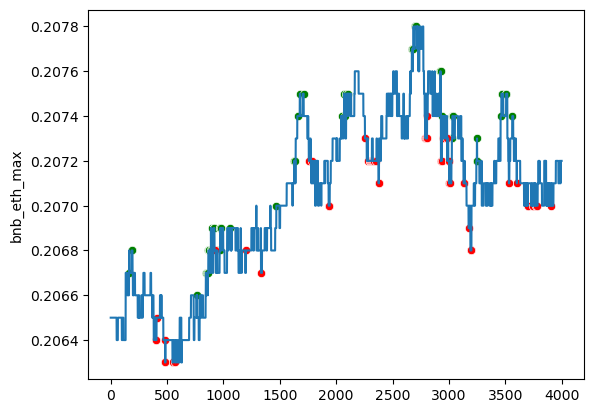

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 84, loss: 0.012
Traid counts: 9222 1: 1771 2: 1574 3: 869 4: 1253 5: 1937 6: 1818
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.01      0.39      0.01        31
         2.0       0.01      0.31      0.01        32
         3.0       0.00      0.19      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.54      0.02        35
         6.0       0.01      0.47      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.44      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.85261872091473
Общая комиссия в usdt: 6.8719786880098574
Число сделок: 281
Прибыль от 300 usdt за 

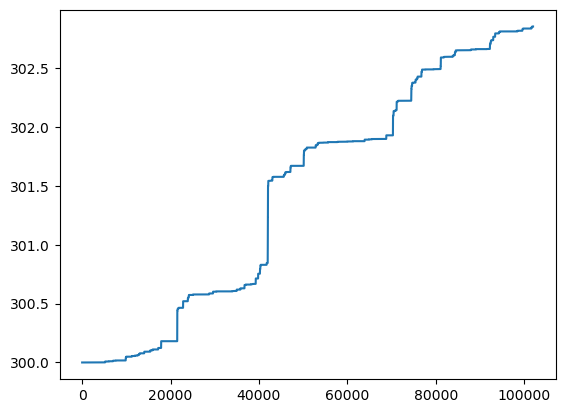

bnb_btc


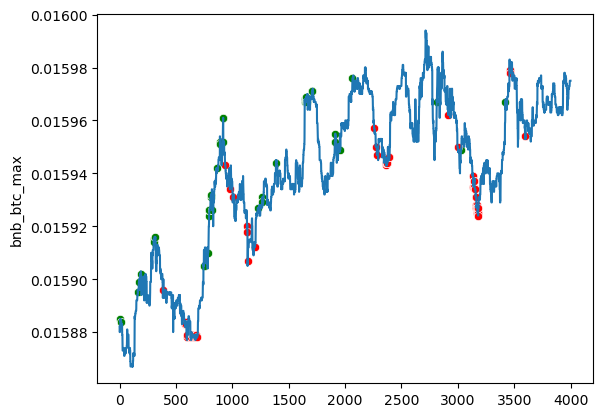

eth_btc


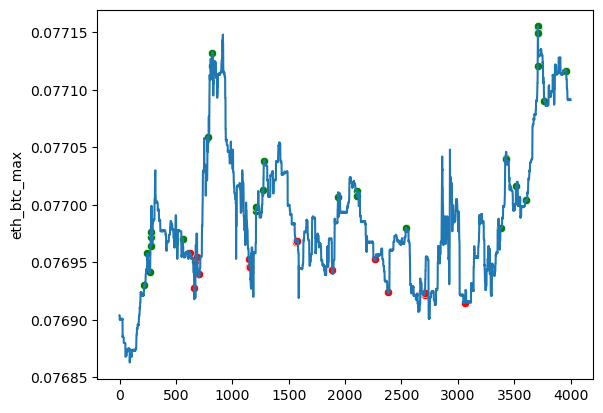

bnb_eth


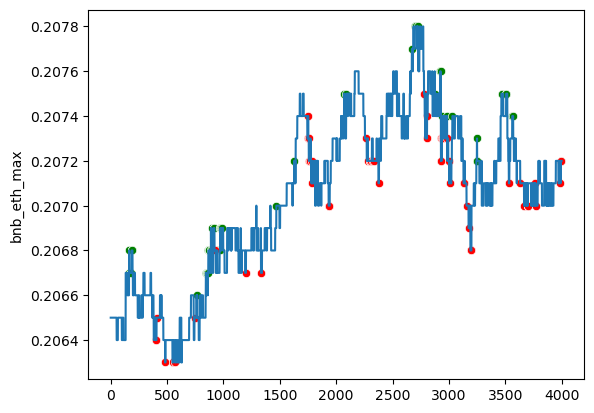

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 85, loss: 0.012
Traid counts: 9288 1: 1885 2: 1283 3: 878 4: 1160 5: 1977 6: 2105
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.01      0.32      0.01        31
         2.0       0.00      0.16      0.01        32
         3.0       0.01      0.24      0.01        21
         4.0       0.01      0.35      0.01        20
         5.0       0.01      0.54      0.02        35
         6.0       0.01      0.58      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.44      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.11124552330347
Общая комиссия в usdt: 8.306081175443763
Число сделок: 317
Прибыль от 300 usdt за 1

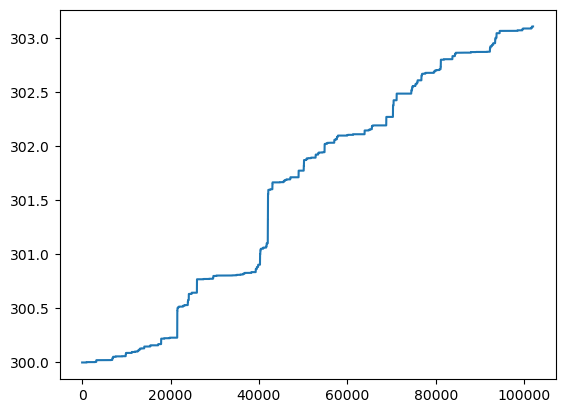

bnb_btc


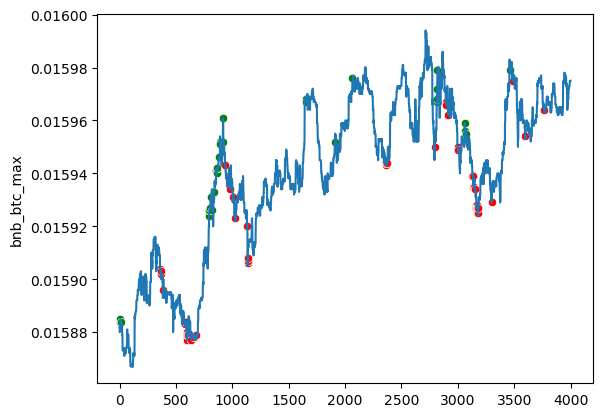

eth_btc


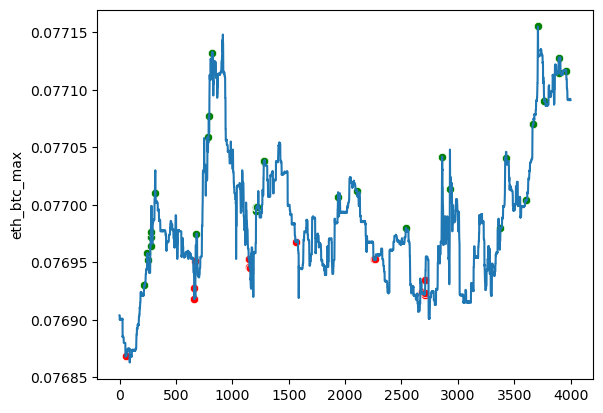

bnb_eth


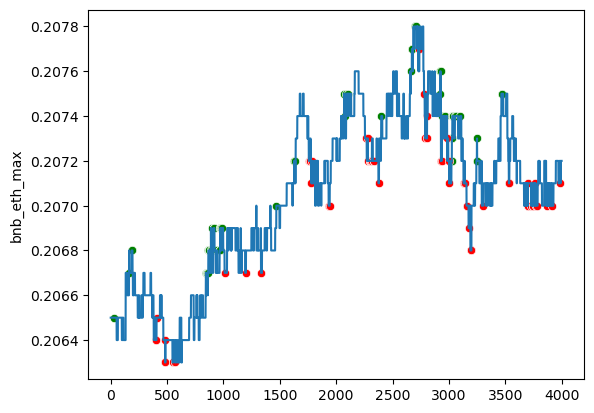

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 86, loss: 0.012
Traid counts: 9751 1: 1659 2: 1307 3: 934 4: 1499 5: 2375 6: 1977
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.23      0.01        31
         2.0       0.00      0.19      0.01        32
         3.0       0.01      0.29      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.47      0.02        36

    accuracy                           0.90    102012
   macro avg       0.15      0.42      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.0352502361604
Общая комиссия в usdt: 7.284197077020539
Число сделок: 372
Прибыль от 300 usdt за 10

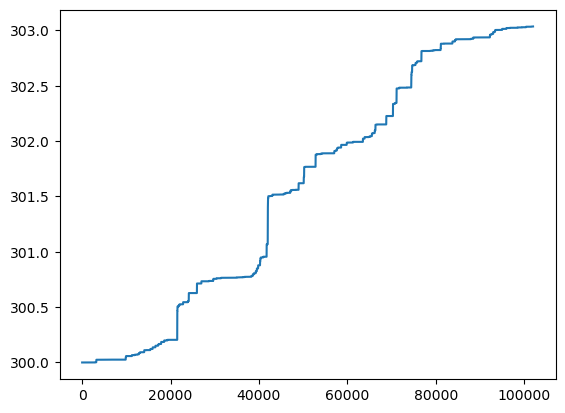

bnb_btc


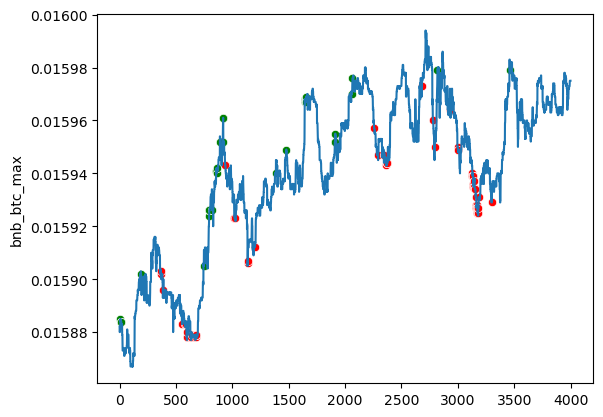

eth_btc


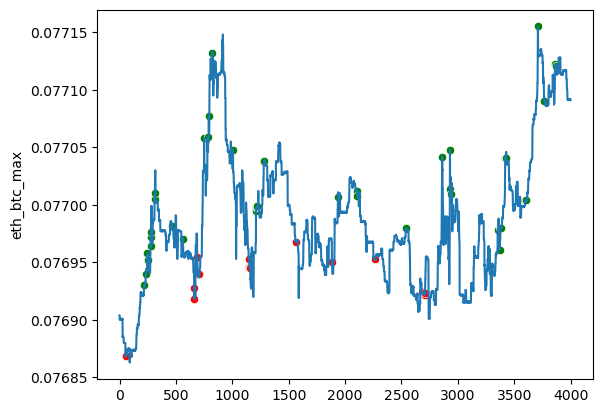

bnb_eth


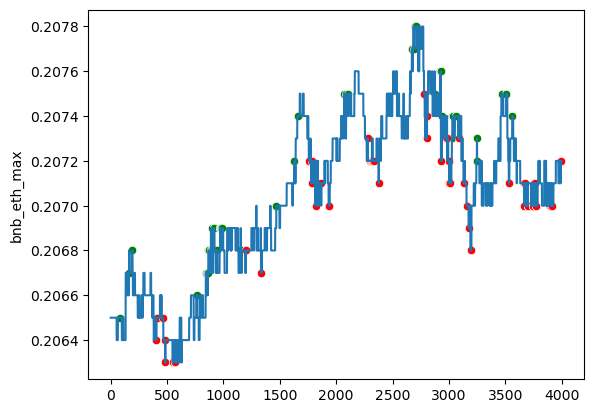

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 87, loss: 0.014
Traid counts: 9465 1: 1990 2: 1242 3: 1010 4: 1286 5: 2094 6: 1843
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.26      0.01        31
         2.0       0.00      0.19      0.01        32
         3.0       0.00      0.24      0.01        21
         4.0       0.00      0.20      0.01        20
         5.0       0.01      0.51      0.02        35
         6.0       0.01      0.44      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.39      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.3539541018108
Общая комиссия в usdt: 7.724823665763155
Число сделок: 328
Прибыль от 300 usdt за 1

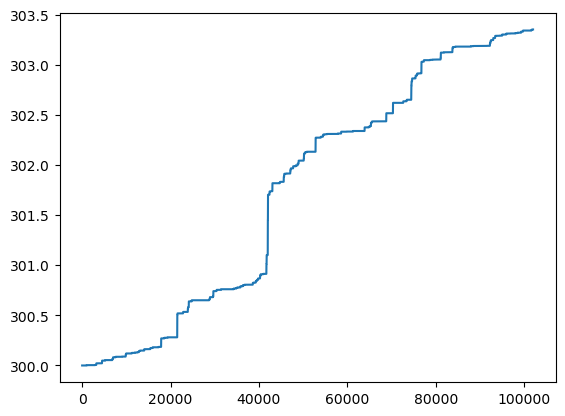

bnb_btc


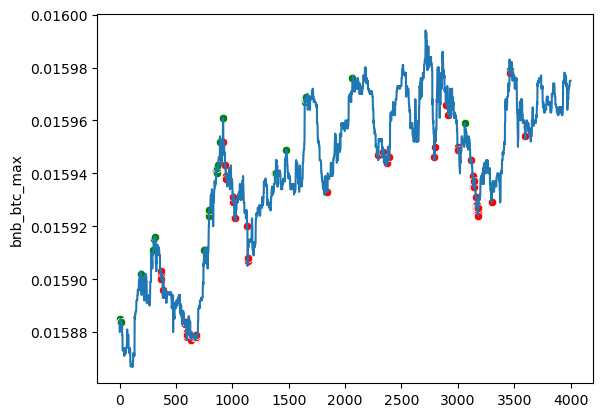

eth_btc


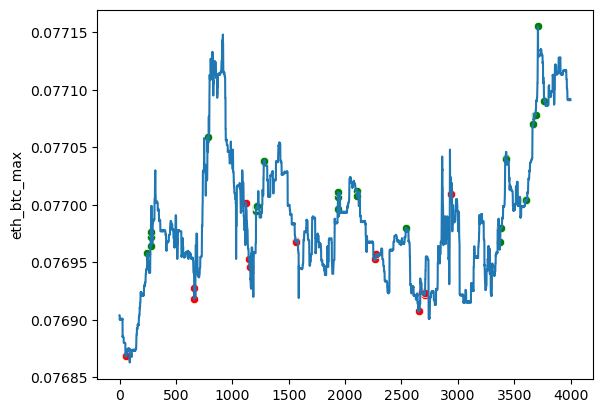

bnb_eth


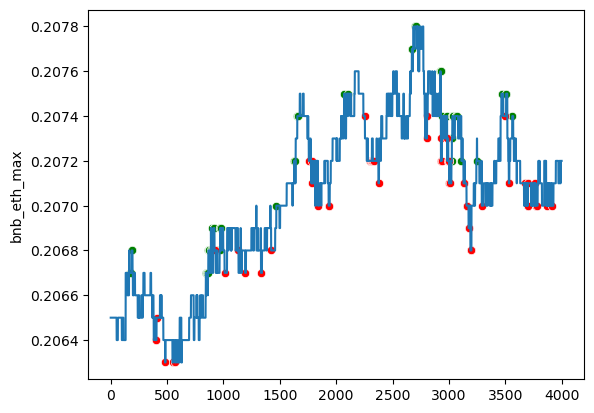

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 88, loss: 0.011
Traid counts: 9223 1: 1927 2: 1376 3: 965 4: 1042 5: 2112 6: 1801
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.19      0.01        31
         2.0       0.01      0.22      0.01        32
         3.0       0.01      0.24      0.01        21
         4.0       0.00      0.15      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.47      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.39      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.65513024481163
Общая комиссия в usdt: 6.185439797568295
Число сделок: 341
Прибыль от 300 usdt за 1

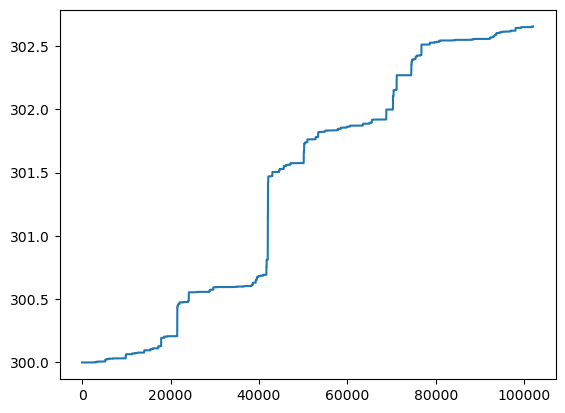

bnb_btc


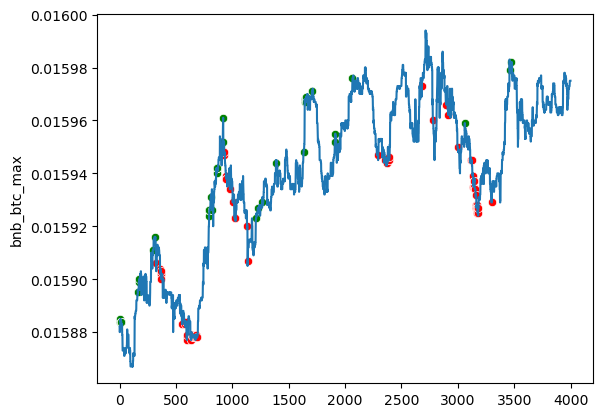

eth_btc


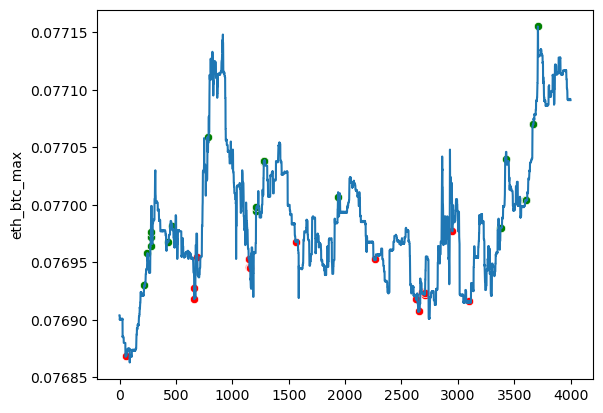

bnb_eth


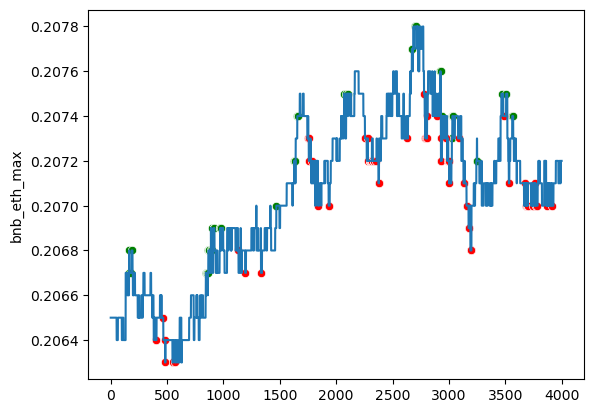

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 89, loss: 0.013
Traid counts: 9523 1: 1913 2: 1316 3: 833 4: 1374 5: 1994 6: 2093
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.23      0.01        31
         2.0       0.01      0.34      0.02        32
         3.0       0.00      0.14      0.01        21
         4.0       0.00      0.30      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.33      0.01        36

    accuracy                           0.91    102012
   macro avg       0.15      0.40      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.2734066566127
Общая комиссия в usdt: 8.140960742025822
Число сделок: 315
Прибыль от 300 usdt за 10

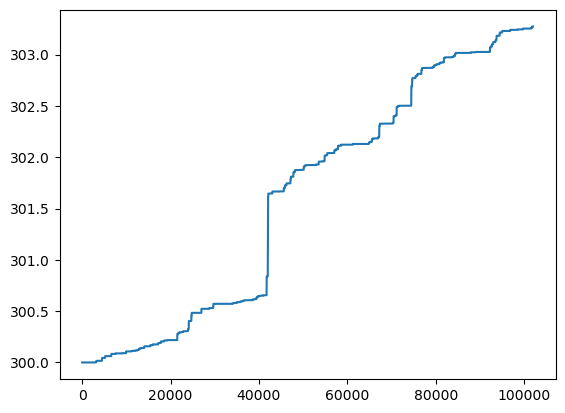

bnb_btc


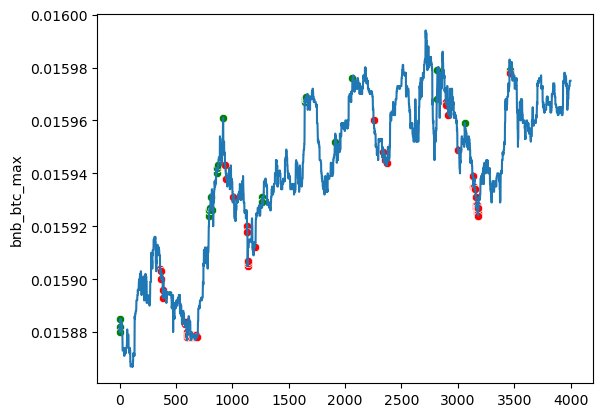

eth_btc


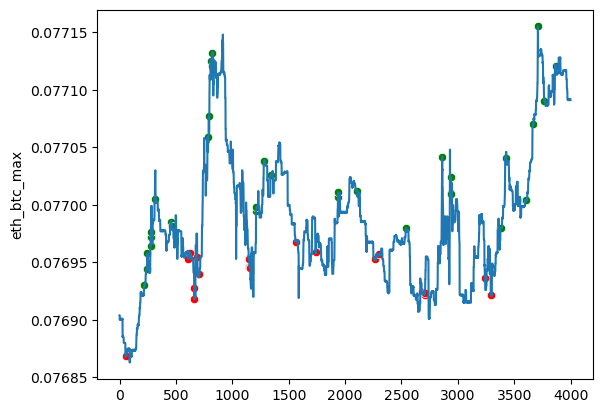

bnb_eth


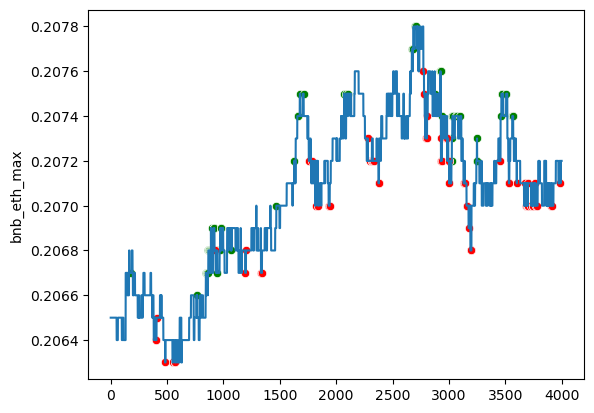

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 90, loss: 0.011
Traid counts: 9705 1: 2005 2: 1261 3: 1215 4: 1439 5: 1736 6: 2049
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.01      0.42      0.01        31
         2.0       0.00      0.19      0.01        32
         3.0       0.00      0.14      0.00        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.49      0.02        35
         6.0       0.01      0.64      0.02        36

    accuracy                           0.90    102012
   macro avg       0.15      0.43      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.26457982752584
Общая комиссия в usdt: 6.878073286842719
Число сделок: 284
Прибыль от 300 usdt за 

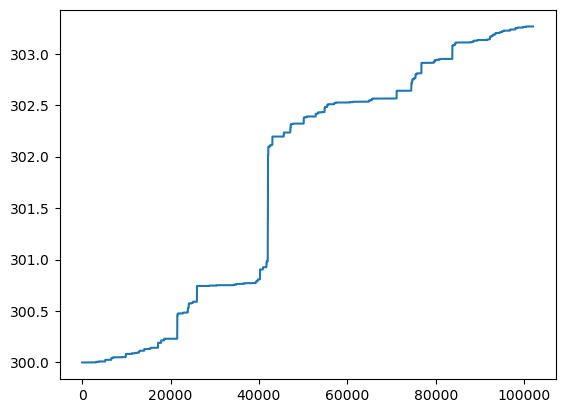

bnb_btc


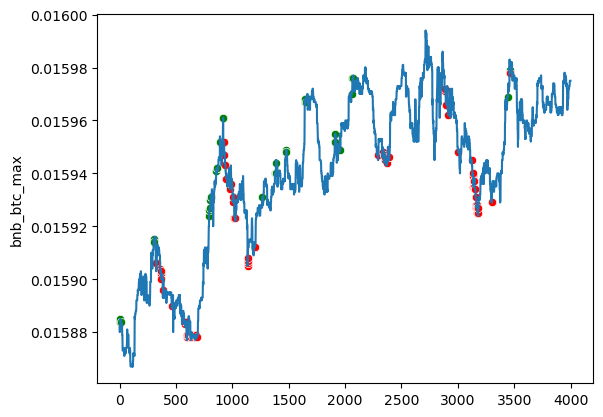

eth_btc


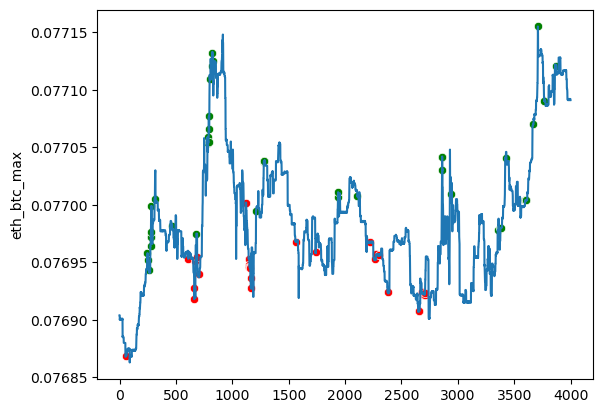

bnb_eth


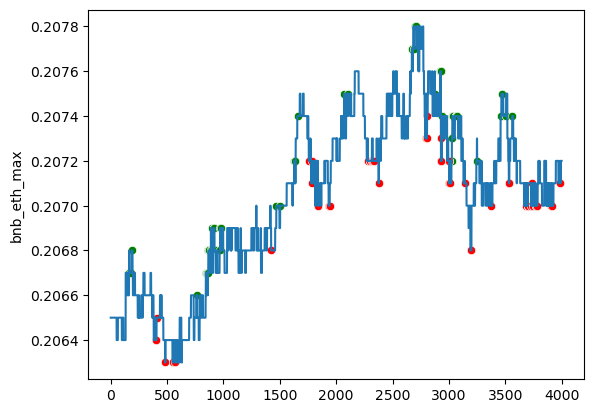

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 91, loss: 0.012
Traid counts: 9408 1: 1702 2: 1293 3: 1022 4: 1495 5: 1712 6: 2184
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.26      0.01        31
         2.0       0.00      0.12      0.01        32
         3.0       0.01      0.33      0.01        21
         4.0       0.00      0.35      0.01        20
         5.0       0.01      0.49      0.02        35
         6.0       0.01      0.44      0.01        36

    accuracy                           0.91    102012
   macro avg       0.15      0.42      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.90563387480205
Общая комиссия в usdt: 7.952284859931783
Число сделок: 307
Прибыль от 300 usdt за 

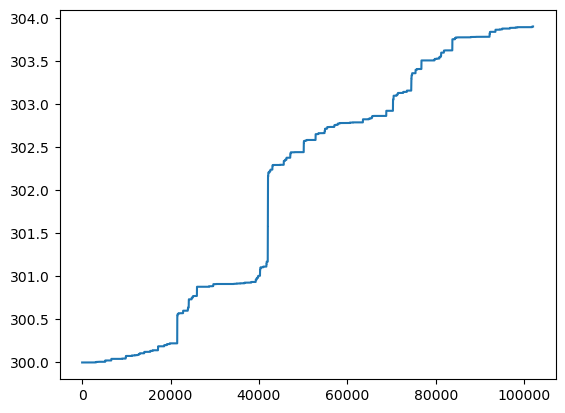

bnb_btc


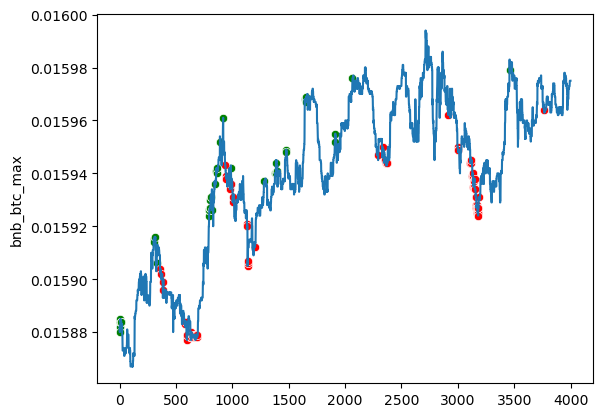

eth_btc


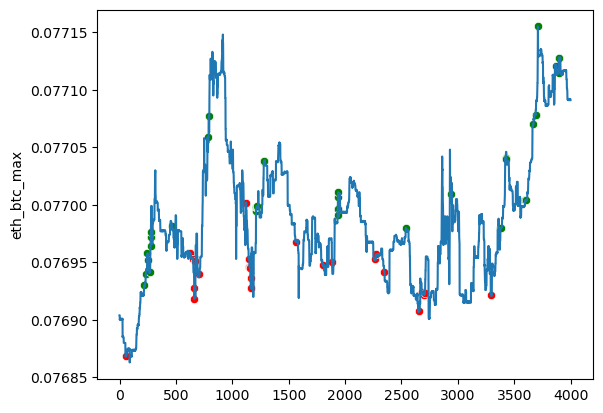

bnb_eth


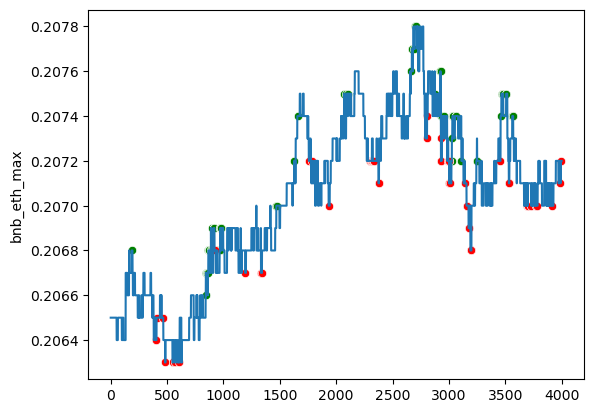

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 92, loss: 0.012
Traid counts: 8468 1: 1622 2: 1092 3: 990 4: 1238 5: 1611 6: 1915
              precision    recall  f1-score   support

         0.0       1.00      0.92      0.96    101837
         1.0       0.00      0.23      0.01        31
         2.0       0.00      0.16      0.01        32
         3.0       0.00      0.19      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.51      0.02        35
         6.0       0.01      0.56      0.02        36

    accuracy                           0.92    102012
   macro avg       0.15      0.40      0.15    102012
weighted avg       1.00      0.92      0.96    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.52617038415855
Общая комиссия в usdt: 6.853477745622106
Число сделок: 277
Прибыль от 300 usdt за 1

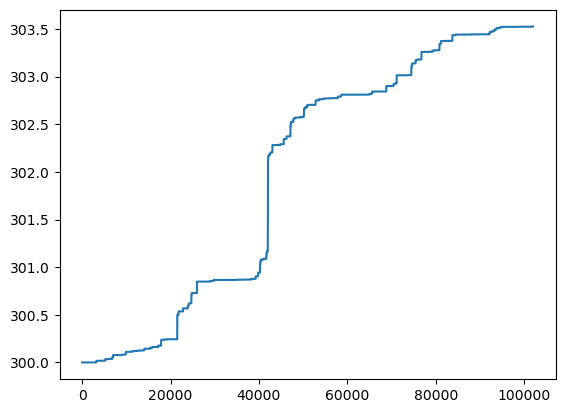

bnb_btc


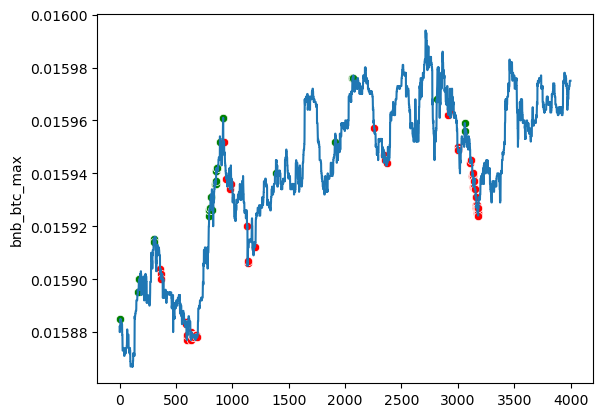

eth_btc


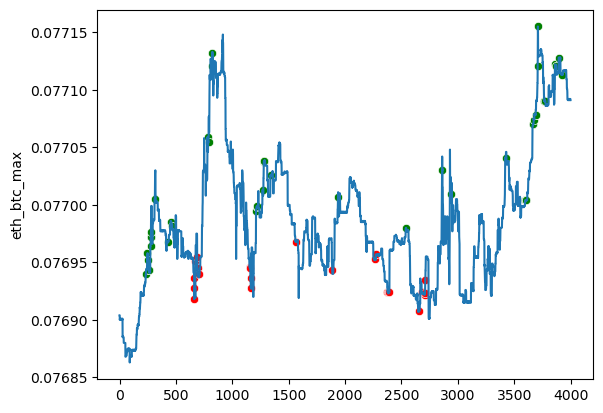

bnb_eth


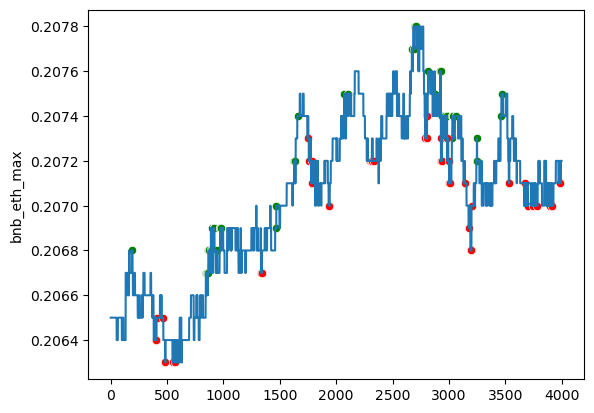

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 93, loss: 0.013
Traid counts: 9040 1: 1698 2: 1095 3: 1065 4: 1567 5: 1951 6: 1664
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.01      0.45      0.02        31
         2.0       0.01      0.25      0.01        32
         3.0       0.00      0.24      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.60      0.02        35
         6.0       0.01      0.47      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.45      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.71178025174714
Общая комиссия в usdt: 6.277020987247973
Число сделок: 316
Прибыль от 300 usdt за 

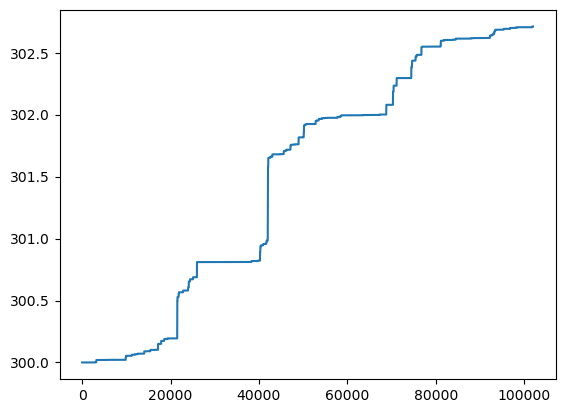

bnb_btc


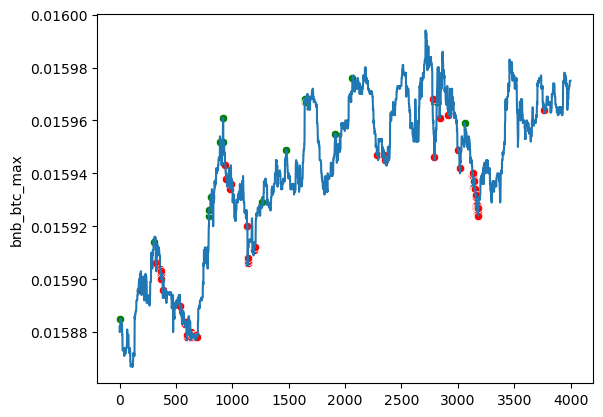

eth_btc


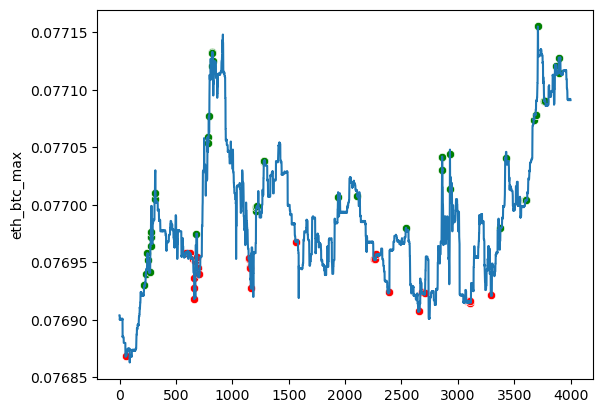

bnb_eth


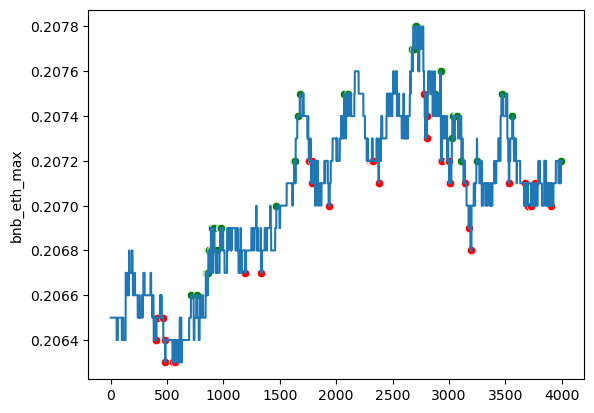

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 94, loss: 0.011
Traid counts: 8488 1: 1646 2: 722 3: 938 4: 1109 5: 2158 6: 1915
              precision    recall  f1-score   support

         0.0       1.00      0.92      0.96    101837
         1.0       0.01      0.32      0.01        31
         2.0       0.01      0.12      0.01        32
         3.0       0.00      0.14      0.01        21
         4.0       0.00      0.15      0.01        20
         5.0       0.01      0.60      0.02        35
         6.0       0.01      0.44      0.02        36

    accuracy                           0.92    102012
   macro avg       0.15      0.39      0.15    102012
weighted avg       1.00      0.92      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.2299654088038
Общая комиссия в usdt: 9.142976145738979
Число сделок: 332
Прибыль от 300 usdt за 100

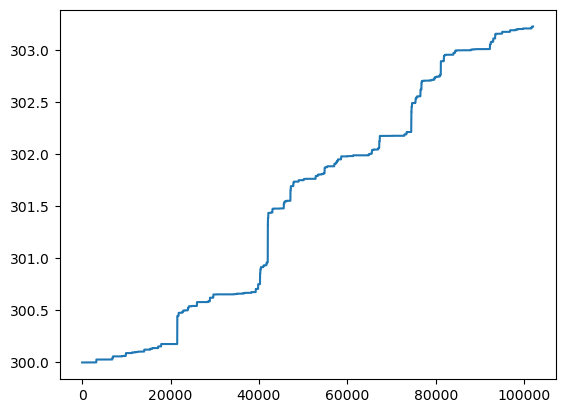

bnb_btc


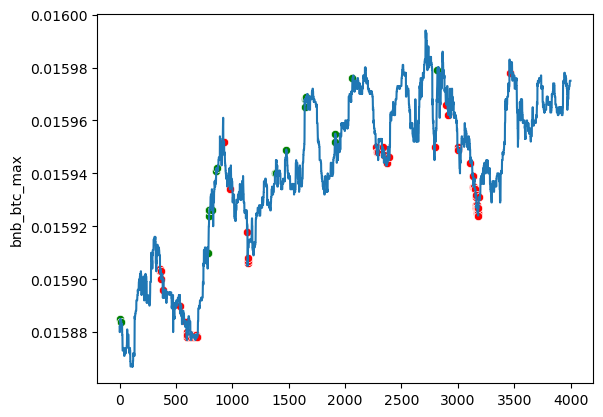

eth_btc


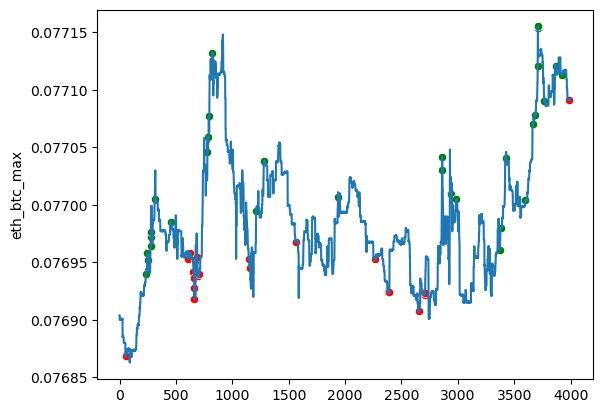

bnb_eth


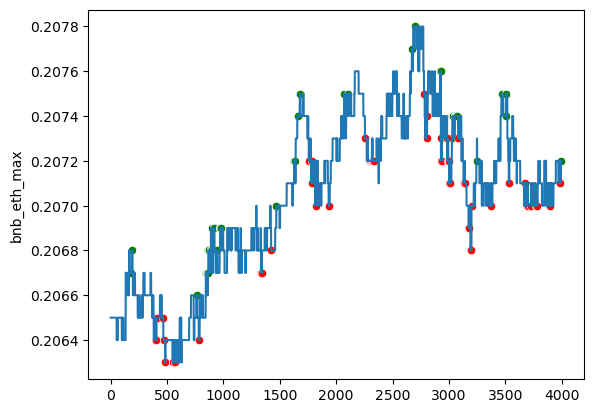

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 95, loss: 0.012
Traid counts: 9801 1: 1993 2: 1390 3: 989 4: 1397 5: 1953 6: 2079
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    101837
         1.0       0.01      0.42      0.01        31
         2.0       0.01      0.38      0.02        32
         3.0       0.00      0.19      0.01        21
         4.0       0.00      0.20      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.50      0.02        36

    accuracy                           0.90    102012
   macro avg       0.15      0.45      0.15    102012
weighted avg       1.00      0.90      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.297052578295
Общая комиссия в usdt: 7.6558665501841565
Число сделок: 322
Прибыль от 300 usdt за 10

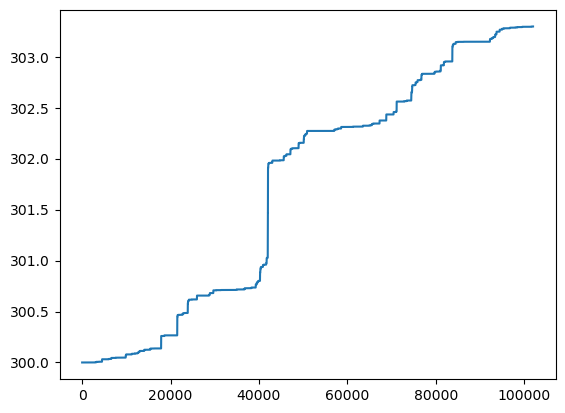

bnb_btc


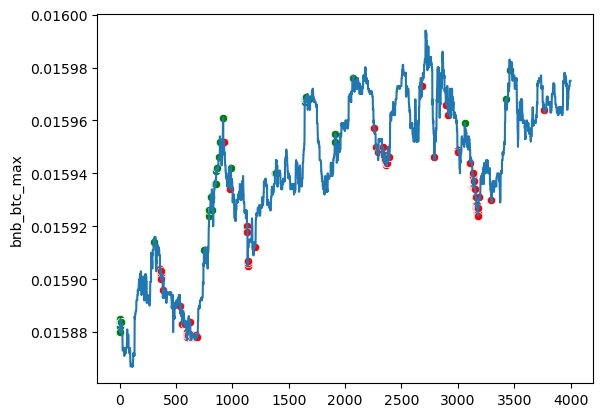

eth_btc


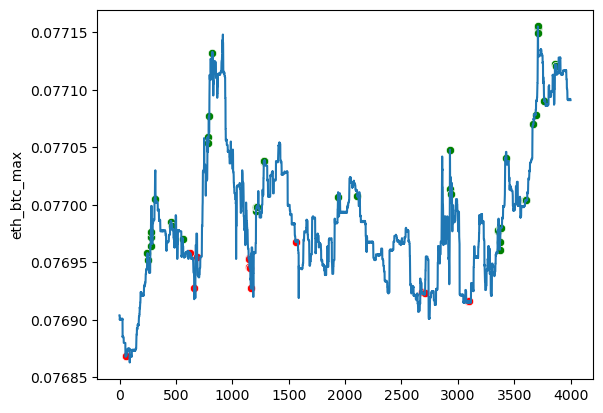

bnb_eth


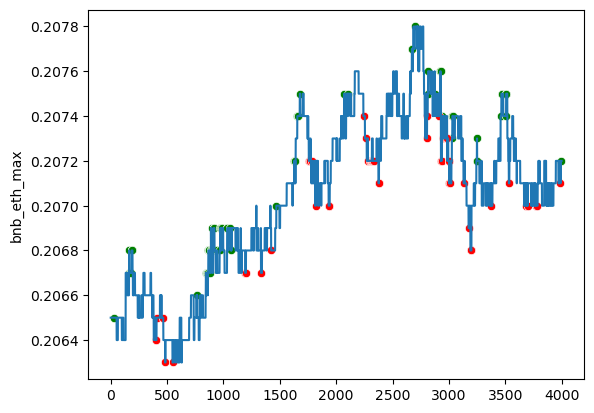

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 96, loss: 0.011
Traid counts: 9008 1: 1828 2: 1131 3: 1057 4: 1349 5: 1866 6: 1777
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.23      0.01        31
         2.0       0.01      0.22      0.01        32
         3.0       0.00      0.19      0.01        21
         4.0       0.00      0.25      0.01        20
         5.0       0.01      0.63      0.02        35
         6.0       0.01      0.53      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.42      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.71447548325557
Общая комиссия в usdt: 7.21273072225414
Число сделок: 287
Прибыль от 300 usdt за 1

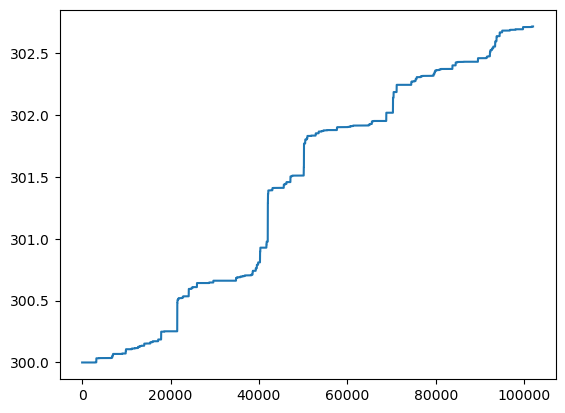

bnb_btc


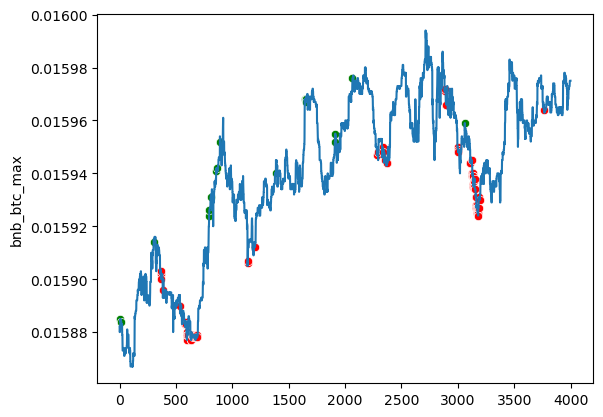

eth_btc


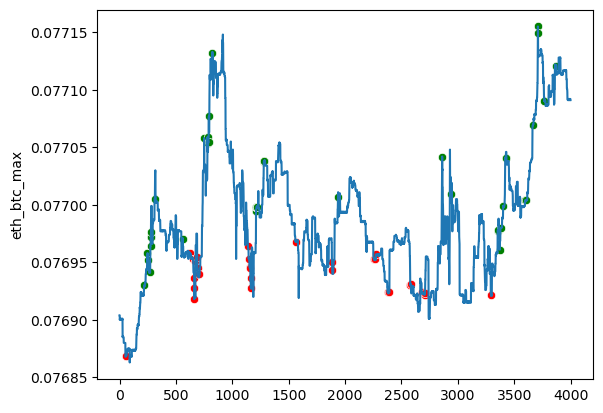

bnb_eth


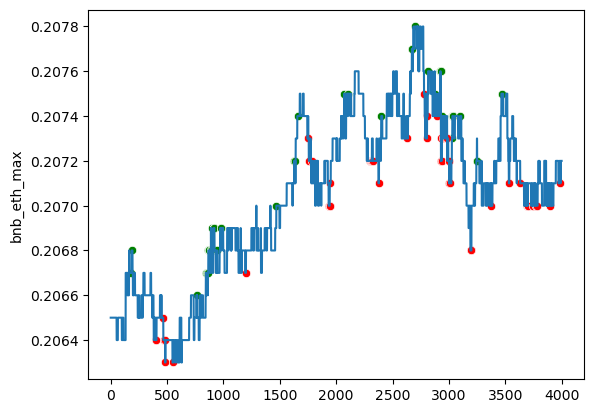

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 97, loss: 0.010
Traid counts: 9239 1: 1810 2: 818 3: 909 4: 1691 5: 1966 6: 2045
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.29      0.01        31
         2.0       0.01      0.22      0.02        32
         3.0       0.00      0.19      0.01        21
         4.0       0.00      0.35      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.39      0.01        36

    accuracy                           0.91    102012
   macro avg       0.15      0.42      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.9497276054655
Общая комиссия в usdt: 7.581033978709419
Число сделок: 324
Прибыль от 300 usdt за 100

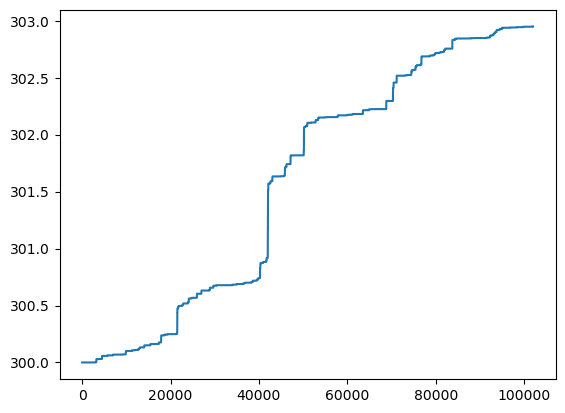

bnb_btc


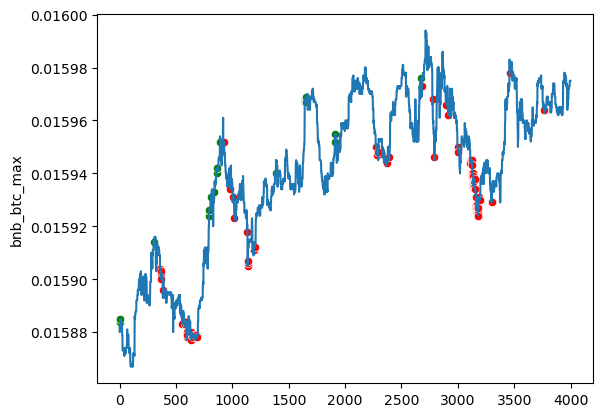

eth_btc


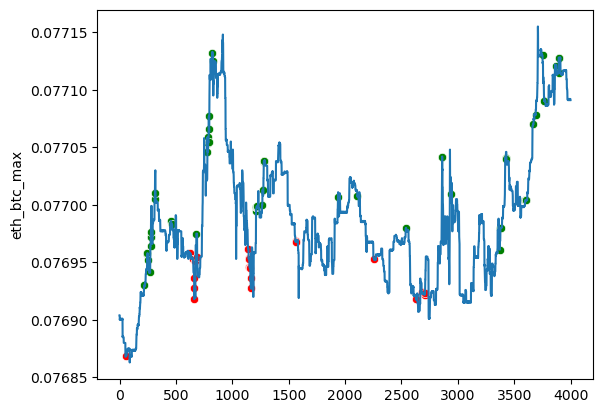

bnb_eth


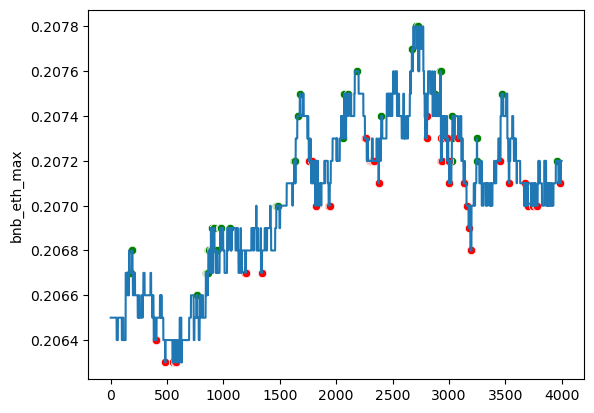

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 98, loss: 0.010
Traid counts: 8568 1: 2088 2: 1188 3: 943 4: 1133 5: 1375 6: 1841
              precision    recall  f1-score   support

         0.0       1.00      0.92      0.96    101837
         1.0       0.01      0.48      0.01        31
         2.0       0.01      0.19      0.01        32
         3.0       0.00      0.14      0.01        21
         4.0       0.00      0.20      0.01        20
         5.0       0.01      0.57      0.03        35
         6.0       0.01      0.56      0.02        36

    accuracy                           0.92    102012
   macro avg       0.15      0.44      0.15    102012
weighted avg       1.00      0.92      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 303.01285166679384
Общая комиссия в usdt: 6.514228961327741
Число сделок: 249
Прибыль от 300 usdt за 1

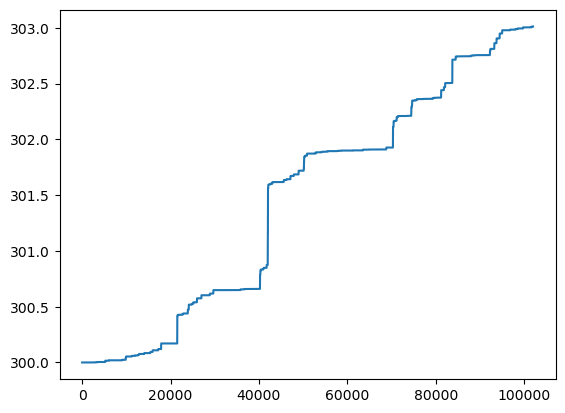

bnb_btc


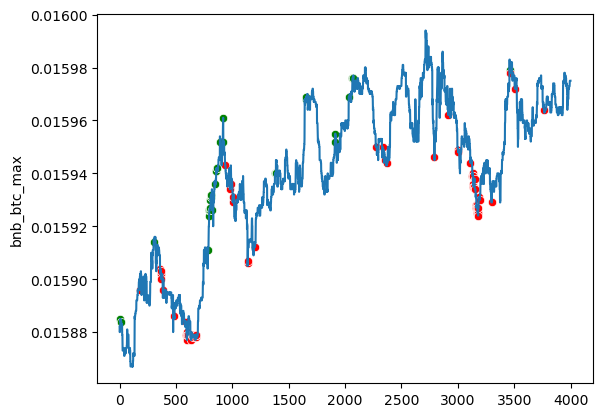

eth_btc


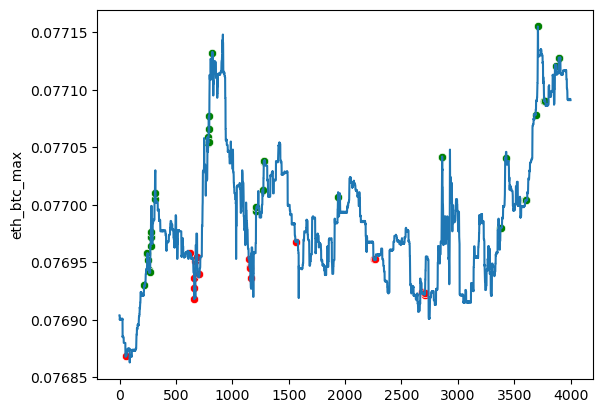

bnb_eth


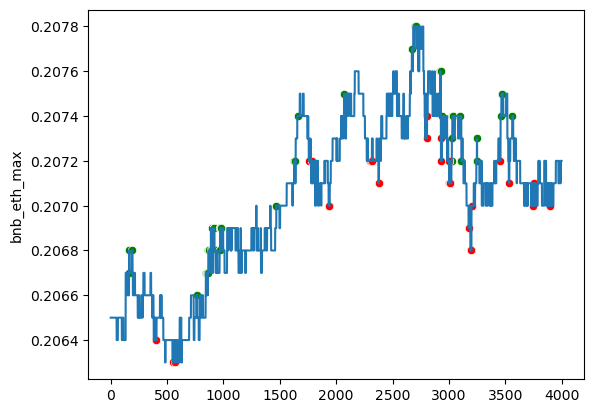

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 99, loss: 0.012
Traid counts: 9121 1: 1629 2: 994 3: 1309 4: 1519 5: 1914 6: 1756
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.23      0.01        31
         2.0       0.01      0.25      0.02        32
         3.0       0.00      0.24      0.01        21
         4.0       0.00      0.20      0.01        20
         5.0       0.01      0.57      0.02        35
         6.0       0.01      0.50      0.02        36

    accuracy                           0.91    102012
   macro avg       0.15      0.41      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.9744200122445
Общая комиссия в usdt: 6.3650269154724635
Число сделок: 285
Прибыль от 300 usdt за 1

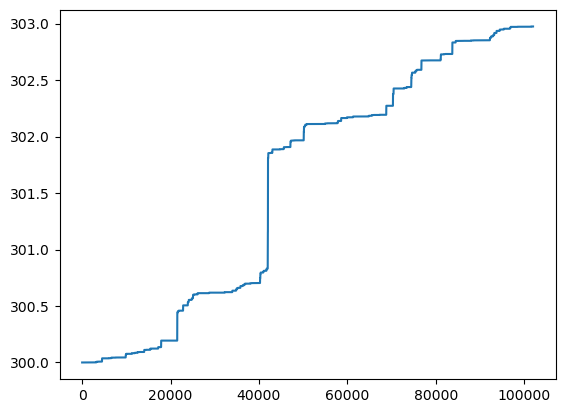

bnb_btc


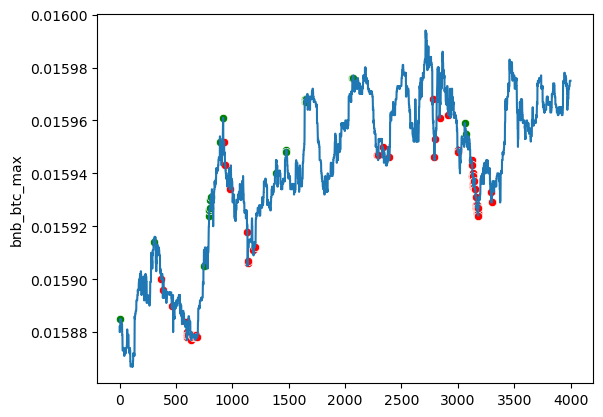

eth_btc


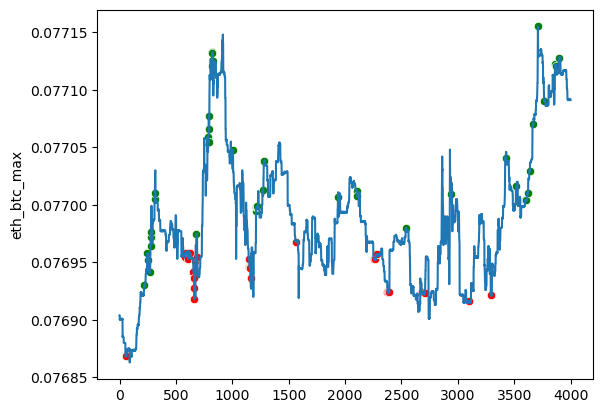

bnb_eth


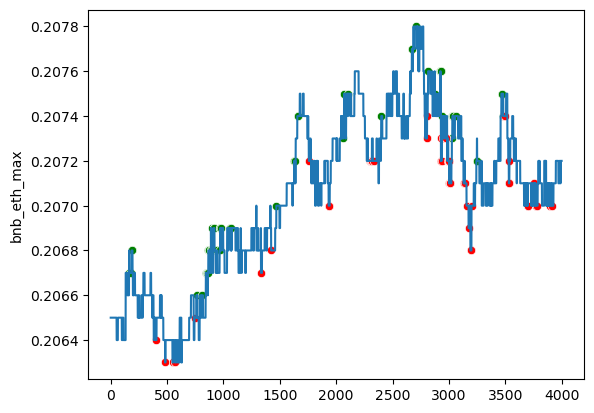

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 100, loss: 0.010
Traid counts: 8925 1: 1738 2: 1029 3: 970 4: 1116 5: 1931 6: 2141
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    101837
         1.0       0.00      0.26      0.01        31
         2.0       0.01      0.19      0.01        32
         3.0       0.00      0.19      0.01        21
         4.0       0.00      0.20      0.01        20
         5.0       0.01      0.54      0.02        35
         6.0       0.01      0.42      0.01        36

    accuracy                           0.91    102012
   macro avg       0.15      0.39      0.15    102012
weighted avg       1.00      0.91      0.95    102012

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 353.78803223304766
Результат торгов с 300 usdt: 302.7056719672104
Общая комиссия в usdt: 7.612168139219947
Число сделок: 329
Прибыль от 300 usdt за 1

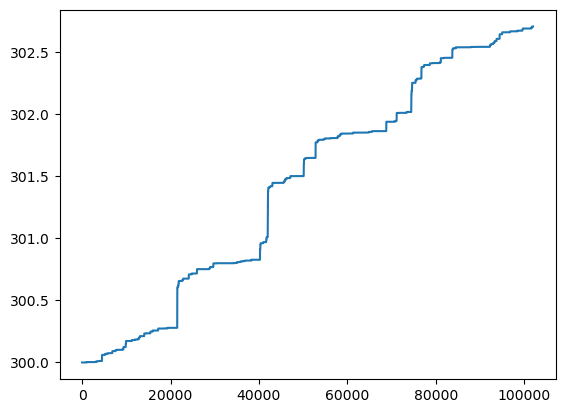

bnb_btc


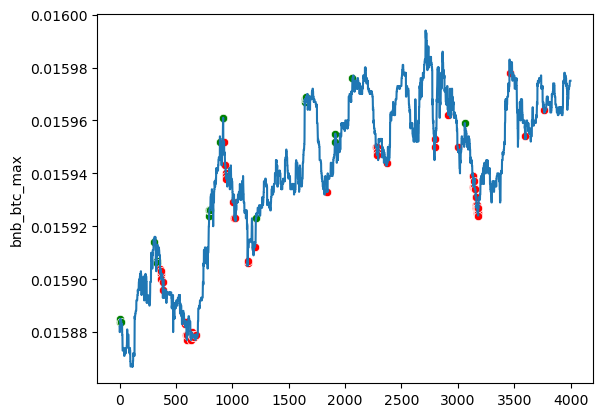

eth_btc


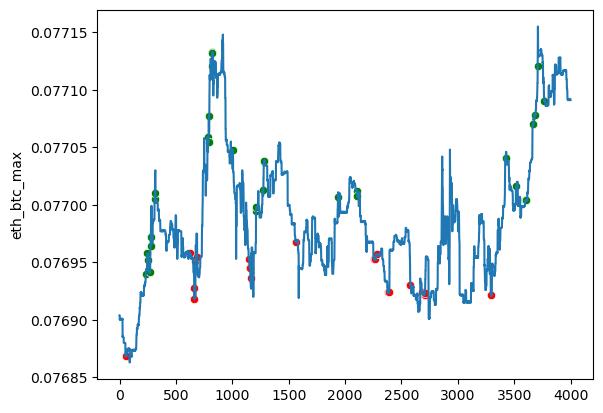

bnb_eth


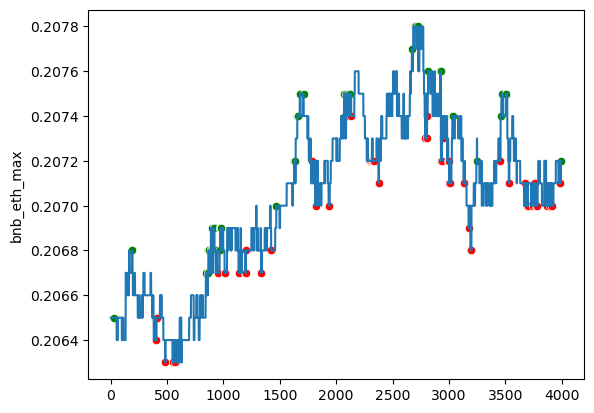

CPU times: total: 1h 27min 56s
Wall time: 2h 18min 23s


In [38]:
%%time

FEE = 0.00075
best_profit = 0

epoch_list = list()
loss_list = list()
traid_counts_list = list()
profit_300_1_list = list()
profit_300_2_list = list()
profit_300_3_list = list()
profit_300_4_list = list()

ticker_price_valid_values = ticker_price_valid.values
ticker_price_valid_fig = ticker_price_valid

res_net_x = ResNet1Dx().to('cuda')

loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(res_net_x.parameters(), lr=0.001)

for epoch in range(EPOCH):
    loss_array = np.array([], dtype=float)
    for i, batch in enumerate(train_loader):
        optimizer.zero_grad()
        X_batch, X_last_min_max_batch, y_batch = batch
        X_batch = X_batch.to('cuda')
        X_last_min_max_batch = X_last_min_max_batch.to('cuda')
        y_batch = y_batch.to('cuda')
        
        output = res_net_x.forward(X_batch, X_last_min_max_batch)
        loss =loss_fn(output, y_batch)
        loss.backward()
        optimizer.step()
        loss_array = np.append(loss_array, loss.to('cpu').detach().numpy())
    if epoch % 1 == 0:
        
        print('---***---***---***---***---***---***---***---***---***---***---***---***---')
        print('Predict start')
        predict = torch.empty((1), dtype=torch.float).to('cuda')
        y_valid_tensor = torch.empty((1), dtype=torch.float)
        
        #res_net_x.eval()
        
        for i_valid, batch_valid in enumerate(valid_loader):
            X_batch_valid, X_last_min_max_batch_valid, y_batch_valid = batch_valid
            X_batch_valid = X_batch_valid.to('cuda')
            X_last_min_max_batch_valid = X_last_min_max_batch_valid.to('cuda')
            
            predict_batch = torch.argmax(res_net_x.inference(X_batch_valid, X_last_min_max_batch_valid), dim=1)
            predict = torch.cat((predict, predict_batch), 0)
            y_valid_tensor = torch.cat((y_valid_tensor, y_batch_valid), 0)
            
        #res_net_x.train()
        
        predict = predict[1:]
        y_valid_tensor = y_valid_tensor[1:]
        epoch_list.append(epoch)
        loss_mean = loss_array.mean()
        loss_list.append(loss_mean)
        print(f'Epoch: {epoch}, loss: {loss_mean:.3f}')
        traid_counts = (predict!=0).sum()
        traid_counts_list.append(traid_counts)
        print(f'Traid counts: {traid_counts}',
              f'1: {(predict==1).sum()}',
              f'2: {(predict==2).sum()}',
              f'3: {(predict==3).sum()}',
              f'4: {(predict==4).sum()}',
              f'5: {(predict==5).sum()}',
              f'6: {(predict==6).sum()}'
             )
        predict = predict.to('cpu').detach().numpy()
        print(classification_report(y_valid_tensor.detach().numpy(), predict))
        
        for slip_n in range(10,11):
            slip_n = slip_n/10
            print("-------------")
            print(f'SLIP_N = {slip_n}')
            trade_result, trade_btc, trade_eth, trade_bnb, volume_not_trade, trade_start, fee_usdt, trade_count = trade(ticker_price_valid_values, predict, FEE, slip_n)
            trade_result = np.array(trade_result)
            print(f'Без торгов за счёт изменения курса с 300 usdt: {volume_not_trade}')
            print(f'Результат торгов с 300 usdt: {trade_result[-1]}')
            print(f'Общая комиссия в usdt: {fee_usdt}')
            print(f'Число сделок: {trade_count}')
            profit_300 = (trade_result[-1]-trade_start)*100_000/predict.shape[0]
            if slip_n == 1:
                profit_300_1_list.append(profit_300)
                if profit_300 > best_profit:
                    np.save('features/ticker_price_valid_values', ticker_price_valid_values, allow_pickle=True, fix_imports=True)
                    np.save('features/predict', predict, allow_pickle=True, fix_imports=True)
                    torch.save(res_net_x, f'res_net_x_{epoch}_{profit_300:.2f}.pt')
                    best_profit = profit_300
            elif slip_n == 2:
                profit_300_2_list.append(profit_300)
            elif slip_n == 3:
                profit_300_3_list.append(profit_300)
            elif slip_n == 4:
                profit_300_4_list.append(profit_300)
            print(f'Прибыль от 300 usdt за 100_000 тиков: {profit_300}')
            print(' ')
            # отрисовка изменение объёма кошелька
            sns.lineplot(x=range(trade_result.shape[0]),y=trade_result)
            plt.show()

        # отрисовка сделок на тренде
        #x_len = predict.shape[0]
        x_len = 4000

        ticker_price_valid_fig[PAIRS_NAME[3]+'_min'] = ticker_price_valid_values[:,3]*(predict == 1)
        ticker_price_valid_fig[PAIRS_NAME[3]+'_max'] = ticker_price_valid_values[:,3]*(predict == 2)
        ticker_price_valid_fig[PAIRS_NAME[4]+'_min'] = ticker_price_valid_values[:,4]*(predict == 3)
        ticker_price_valid_fig[PAIRS_NAME[4]+'_max'] = ticker_price_valid_values[:,4]*(predict == 4)
        ticker_price_valid_fig[PAIRS_NAME[5]+'_min'] = ticker_price_valid_values[:,5]*(predict == 5)
        ticker_price_valid_fig[PAIRS_NAME[5]+'_max'] = ticker_price_valid_values[:,5]*(predict == 6)
        ticker_price_valid_fig = ticker_price_valid_fig.replace(0, np.nan)

        for i, pair in enumerate(['bnb_btc','eth_btc','bnb_eth']):
            print(pair)
            fig, ax = plt.subplots()
            ax.plot(range(x_len),ticker_price_valid_values[:x_len,i+3])
            #ax.plot(range(x_len),trade_result['bnb_btc_max'][:x_len])
            sns.scatterplot(data=ticker_price_valid_fig[:x_len], x=range(x_len), y=pair+'_max', ax=ax, color='green')
            sns.scatterplot(data=ticker_price_valid_fig[:x_len], x=range(x_len), y=pair+'_min', ax=ax, color='red')
            #plt.ylim([ticker_price_valid_fig[pair+'_min'][:x_len].min(), ticker_price_valid_fig[pair+'_max'][:x_len].max()])
            plt.show()

trade_df = pd.DataFrame(data=[epoch_list, 
                              loss_list, 
                              traid_counts_list, 
                              profit_300_1_list, 
                              profit_300_2_list, 
                              profit_300_3_list, 
                              profit_300_4_list]).T.rename(columns={0:'epoch',
                                                                     1:'loss',
                                                                     2:'traid_counts',
                                                                     3:'profit_300_1',
                                                                     4:'profit_300_2',
                                                                     5:'profit_300_3',
                                                                     6:'profit_300_4'})

## Модель ResNet1Dx_Gold

In [37]:
class Bottleneck(nn.Module):
    def __init__(self, in_channels, inter_channels, out_channels, inter_stride):
        super(Bottleneck,self).__init__()
        self.conv1 = nn.Conv1d(in_channels, inter_channels, kernel_size=1, stride=1, bias=False)
        self.bn1 = nn.BatchNorm1d(inter_channels, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv2 = nn.Conv1d(inter_channels, inter_channels, kernel_size=3, stride=inter_stride, padding=1, bias=False)
        self.bn2 = nn.BatchNorm1d(inter_channels, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv3 = nn.Conv1d(inter_channels, out_channels, kernel_size=1, stride=1, bias=False)
        self.bn3 = nn.BatchNorm1d(out_channels, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.relu = nn.ReLU(inplace=True)
    
    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.conv3(x)
        x = self.bn3(x)
        x = self.relu(x)
        return x

class Downsample(nn.Module):
    def __init__(self, in_channels, out_channels, stride):
        super(Downsample,self).__init__()
        self.conv = nn.Conv1d(in_channels, out_channels, kernel_size=1, stride=stride, bias=False)
        self.bn = nn.BatchNorm1d(out_channels, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    
    def forward(self, x):
        x = self.conv(x)
        x = self.bn(x)
        return x


class ResNetKernel(nn.Module):
    def __init__(self, kernel_size):
        super(ResNetKernel,self).__init__()
        
        # input
        self.conv1 = nn.Conv1d(6, 64, kernel_size=kernel_size, stride=2, padding=3, bias=False) 
        self.bn1 = nn.BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.relu1 = nn.ReLU(inplace=True)
        self.max_pool1 = nn.MaxPool1d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
        
        # layer 1
        self.downsample_1 = Downsample(64, 256, 1)
        self.bottleneck_1_0 = Bottleneck(64, 64, 256, 1)
        self.bottleneck_1_1 = Bottleneck(256, 64, 256, 1)
        self.bottleneck_1_2 = Bottleneck(256, 64, 256, 1)
        
        # layer 2
        self.downsample_2 = Downsample(256, 512, 2) 
        self.bottleneck_2_0 = Bottleneck(256, 128, 512, 2)
        self.bottleneck_2_1 = Bottleneck(512, 128, 512, 1)
        self.bottleneck_2_2 = Bottleneck(512, 128, 512, 1)
        self.bottleneck_2_3 = Bottleneck(512, 128, 512, 1)
               
        # layer 3
        self.downsample_3 = Downsample(512, 1024, 2)
        self.bottleneck_3_0 = Bottleneck(512, 256, 1024, 2)
        self.bottleneck_3_1 = Bottleneck(1024, 256, 1024, 1)
        self.bottleneck_3_2 = Bottleneck(1024, 256, 1024, 1)
        self.bottleneck_3_3 = Bottleneck(1024, 256, 1024, 1)
        self.bottleneck_3_4 = Bottleneck(1024, 256, 1024, 1)
        self.bottleneck_3_5 = Bottleneck(1024, 256, 1024, 1)
                   
        # layer 4
        self.downsample_4 = Downsample(1024, 2048, 2)
        self.bottleneck_4_0 = Bottleneck(1024, 512, 2048, 2)
        self.bottleneck_4_1 = Bottleneck(2048, 512, 2048, 1)
        self.bottleneck_4_2 = Bottleneck(2048, 512, 2048, 1)        
        
        # linear
        self.avg_pool = nn.AdaptiveAvgPool1d(output_size=1)
        self.flatten = nn.Flatten()
        self.linear1 = nn.Linear(in_features=2048, out_features=200, bias=True)
        
    def forward(self, x):
        # input
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu1(x)
        x = self.max_pool1(x)
        # layer 1
        x_downsampled = self.downsample_1(x)
        x = self.bottleneck_1_0(x)
        x = self.bottleneck_1_1(x)
        x = self.bottleneck_1_2(x)
        x = x + x_downsampled
        # layer 2
        x_downsampled = self.downsample_2(x)
        x = self.bottleneck_2_0(x)
        x = self.bottleneck_2_1(x)
        x = self.bottleneck_2_2(x)
        x = self.bottleneck_2_3(x)
        x = x + x_downsampled        
        # layer 3
        x_downsampled = self.downsample_3(x)
        x = self.bottleneck_3_0(x)
        x = self.bottleneck_3_1(x)
        x = self.bottleneck_3_2(x)
        x = self.bottleneck_3_3(x)
        x = self.bottleneck_3_4(x)
        x = self.bottleneck_3_5(x)
        x = x + x_downsampled          
        # layer 4
        x_downsampled = self.downsample_4(x)
        x = self.bottleneck_4_0(x)
        x = self.bottleneck_4_1(x)
        x = self.bottleneck_4_2(x)
        x = x + x_downsampled
        # linear
        x = self.avg_pool(x)
        x = self.flatten(x)
        x = self.linear1(x)
        return x
    
    
    
class ResNet1Dx_Gold(nn.Module):
    def __init__(self):
        super(ResNet1Dx_Gold,self).__init__()
        
        self.res_net_kernel_600 = ResNetKernel(600)
        self.res_net_kernel_372 = ResNetKernel(372)
        self.res_net_kernel_230 = ResNetKernel(230)
        self.res_net_kernel_142 = ResNetKernel(142)
        self.res_net_kernel_88 = ResNetKernel(88)
        self.res_net_kernel_54 = ResNetKernel(54)
        self.res_net_kernel_33 = ResNetKernel(33)
        self.res_net_kernel_20 = ResNetKernel(20)
        self.res_net_kernel_12 = ResNetKernel(12)
        self.res_net_kernel_7 = ResNetKernel(7)
        
        
        # linear
        #self.bn2 = nn.BatchNorm1d(12, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.relu2 = nn.ReLU(inplace=True)
        #self.linear2 = nn.Linear(2012, 7, bias=False)
        self.linear2 = nn.Linear(2000, 500, bias=True)
        self.linear3 = nn.Linear(500, 2000, bias=True)
        self.linear4 = nn.Linear(2000, 7, bias=False)
        self.sm = nn.Softmax(dim=1)
    
    def forward(self, x, x_min_max):
        # kernel_feature
        x_600 = x[:,:,-600:]
        x_372 = x[:,:,-372:]
        x_230 = x[:,:,-230:]
        x_142 = x[:,:,-142:]
        x_88 = x[:,:,-88:]
        x_54 = x[:,:,-54:]
        x_33 = x[:,:,-33:]
        x_20 = x[:,:,-20:]
        x_12 = x[:,:,-12:]
        x_7 = x[:,:,-7:]
        
        
        # kernel_net
        x_600 = self.res_net_kernel_600(x_600)
        x_372 = self.res_net_kernel_372(x_372)
        x_230 = self.res_net_kernel_230(x_230)
        x_142 = self.res_net_kernel_142(x_142)
        x_88 = self.res_net_kernel_88(x_88)
        x_54 = self.res_net_kernel_54(x_54)
        x_33 = self.res_net_kernel_33(x_33)
        x_20 = self.res_net_kernel_20(x_20)
        x_12 = self.res_net_kernel_12(x_12)
        x_7 = self.res_net_kernel_7(x_7)
        
        # linear
        #x_min_max = self.bn2(x_min_max)
        x = torch.cat((x_600, x_372, x_230, x_142, x_88, x_54, x_33, x_20, x_12, x_7), 1) # , x_min_max), 1)
        x = self.relu2(x)
        x = self.linear2(x)
        x = self.relu2(x)
        x = self.linear3(x)
        x = self.relu2(x)
        x = self.linear4(x)
        return x
    
    def inference(self, x, x_min_max):
        x = self.forward(x, x_min_max)
        x = self.sm(x)
        return x  

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 0, loss: 0.632
Traid counts: 69573 1: 8861 2: 9526 3: 3608 4: 12511 5: 22270 6: 12797
              precision    recall  f1-score   support

         0.0       1.00      0.78      0.88    315897
         1.0       0.01      0.45      0.01       127
         2.0       0.01      0.48      0.01       129
         3.0       0.01      0.32      0.01        71
         4.0       0.00      0.63      0.01        70
         5.0       0.00      0.81      0.01       126
         6.0       0.01      0.60      0.01       132

    accuracy                           0.78    316552
   macro avg       0.15      0.58      0.13    316552
weighted avg       1.00      0.78      0.88    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 372.2578741580296
Общая комиссия в usdt: 3.717412756560884
Число сделок: 203
Прибыль от 300 usdt за

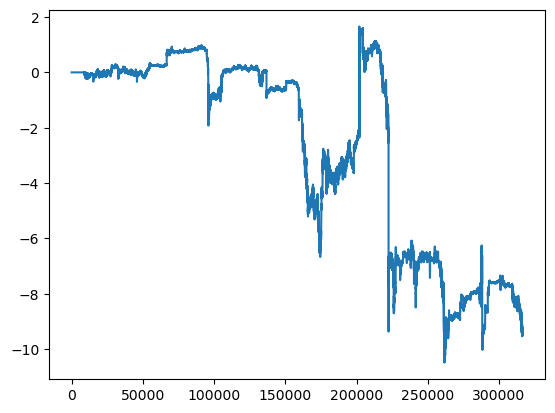

bnb_btc


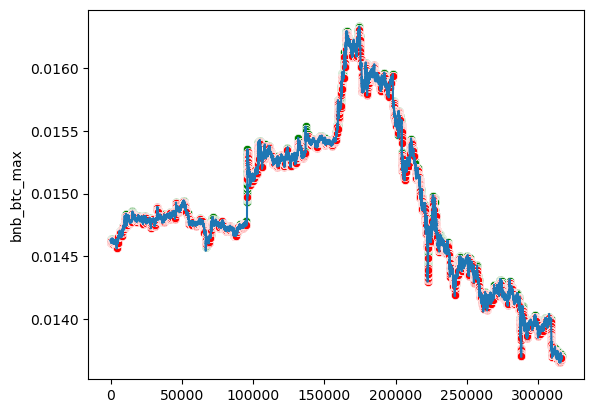

eth_btc


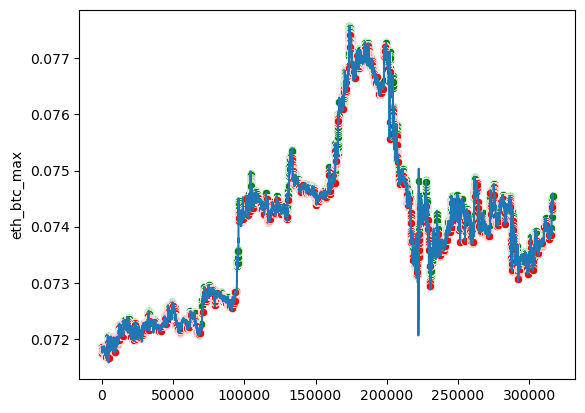

bnb_eth


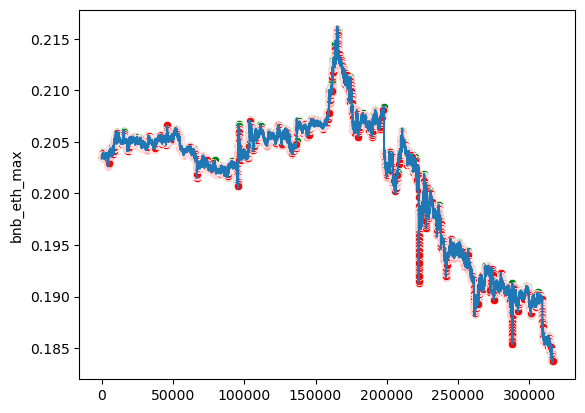

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 1, loss: 0.472
Traid counts: 86715 1: 13122 2: 9482 3: 5932 4: 10948 5: 22714 6: 24517
              precision    recall  f1-score   support

         0.0       1.00      0.73      0.84    315897
         1.0       0.01      0.61      0.01       127
         2.0       0.01      0.47      0.01       129
         3.0       0.00      0.38      0.01        71
         4.0       0.00      0.53      0.01        70
         5.0       0.00      0.86      0.01       126
         6.0       0.00      0.87      0.01       132

    accuracy                           0.73    316552
   macro avg       0.15      0.64      0.13    316552
weighted avg       1.00      0.73      0.84    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 369.1400515744897
Общая комиссия в usdt: 3.572673860044409
Число сделок: 197
Прибыль от 300 usdt з

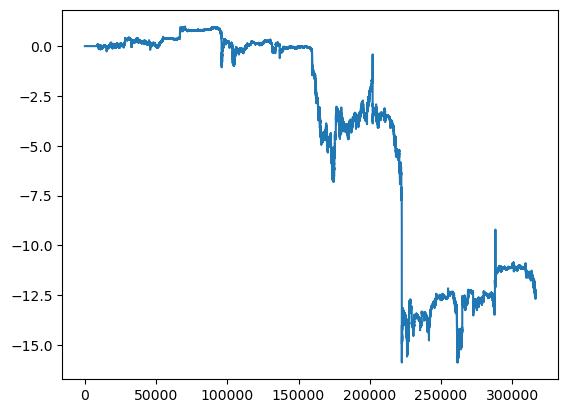

bnb_btc


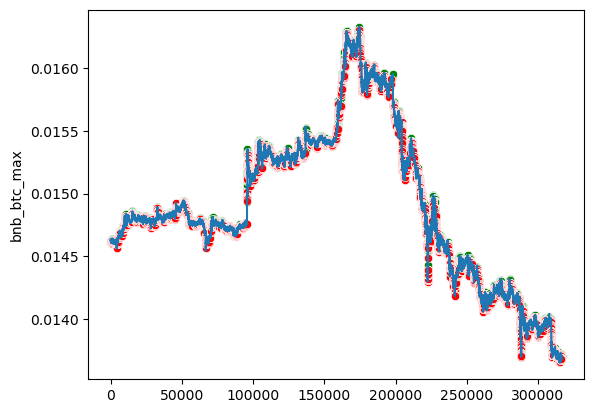

eth_btc


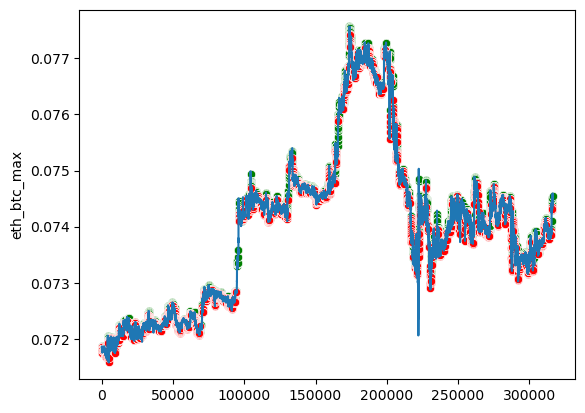

bnb_eth


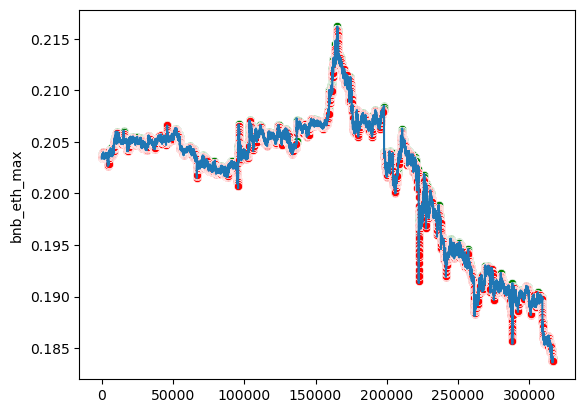

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 2, loss: 0.438
Traid counts: 80517 1: 12972 2: 10113 3: 5146 4: 9191 5: 19746 6: 23349
              precision    recall  f1-score   support

         0.0       1.00      0.75      0.86    315897
         1.0       0.01      0.54      0.01       127
         2.0       0.01      0.56      0.01       129
         3.0       0.01      0.48      0.01        71
         4.0       0.00      0.63      0.01        70
         5.0       0.01      0.86      0.01       126
         6.0       0.00      0.86      0.01       132

    accuracy                           0.75    316552
   macro avg       0.15      0.67      0.13    316552
weighted avg       1.00      0.75      0.85    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 367.00795319446456
Общая комиссия в usdt: 3.6757408074092273
Число сделок: 209
Прибыль от 300 usdt

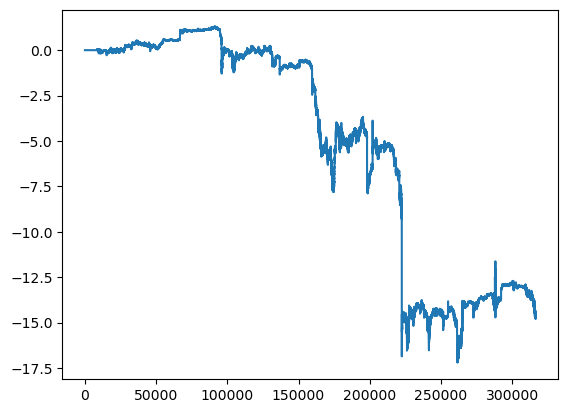

bnb_btc


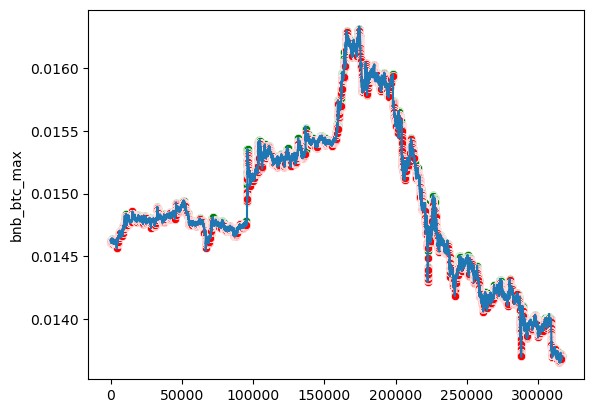

eth_btc


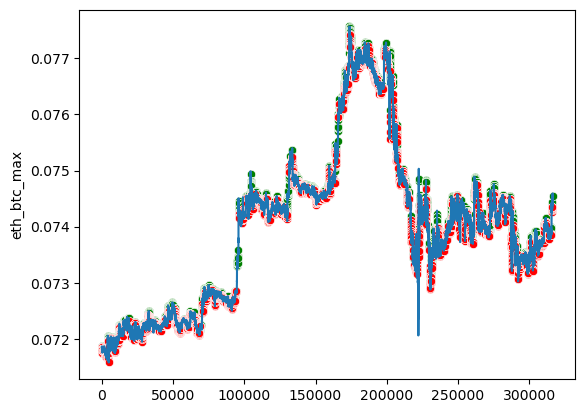

bnb_eth


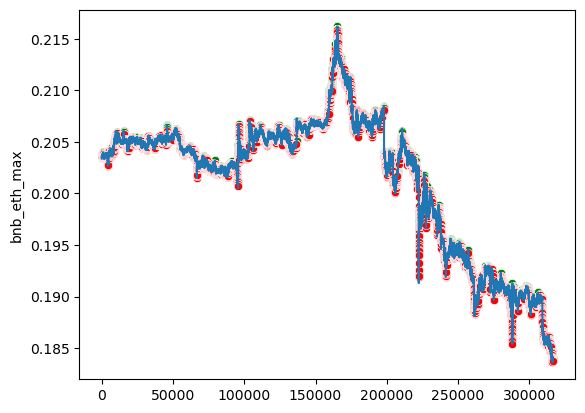

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 3, loss: 0.413
Traid counts: 85001 1: 12219 2: 11264 3: 5952 4: 10631 5: 21471 6: 23464
              precision    recall  f1-score   support

         0.0       1.00      0.73      0.85    315897
         1.0       0.01      0.58      0.01       127
         2.0       0.01      0.51      0.01       129
         3.0       0.01      0.49      0.01        71
         4.0       0.00      0.59      0.01        70
         5.0       0.00      0.81      0.01       126
         6.0       0.00      0.85      0.01       132

    accuracy                           0.73    316552
   macro avg       0.15      0.65      0.13    316552
weighted avg       1.00      0.73      0.84    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 364.6699004684849
Общая комиссия в usdt: 3.530058528919931
Число сделок: 190
Прибыль от 300 usdt 

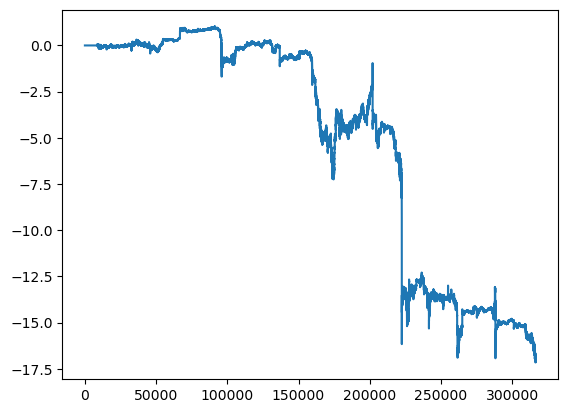

bnb_btc


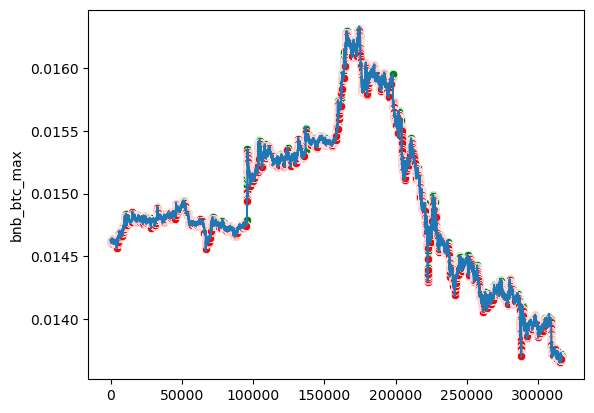

eth_btc


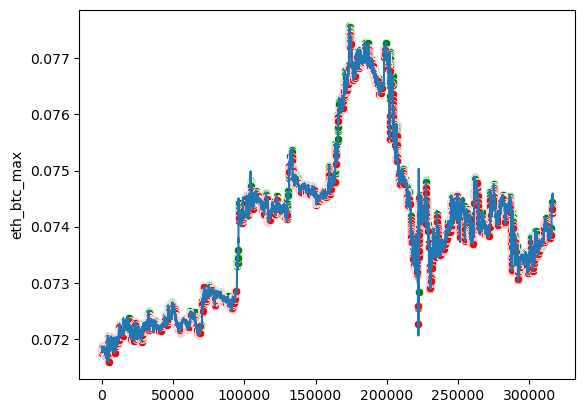

bnb_eth


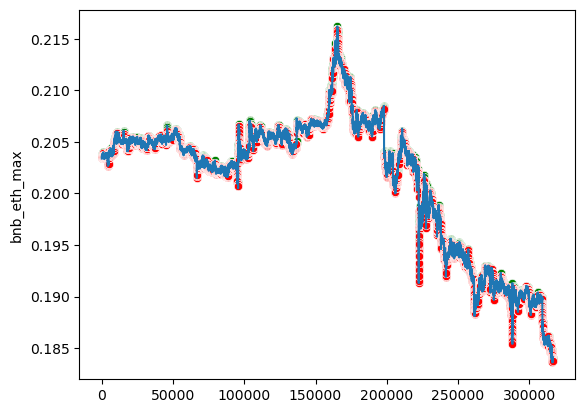

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 4, loss: 0.397
Traid counts: 73999 1: 7351 2: 9777 3: 5030 4: 11423 5: 15416 6: 25002
              precision    recall  f1-score   support

         0.0       1.00      0.77      0.87    315897
         1.0       0.01      0.55      0.02       127
         2.0       0.01      0.44      0.01       129
         3.0       0.01      0.42      0.01        71
         4.0       0.00      0.73      0.01        70
         5.0       0.01      0.71      0.01       126
         6.0       0.00      0.87      0.01       132

    accuracy                           0.77    316552
   macro avg       0.15      0.64      0.13    316552
weighted avg       1.00      0.77      0.87    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 369.30071003031327
Общая комиссия в usdt: 3.4826066642594813
Число сделок: 195
Прибыль от 300 usdt 

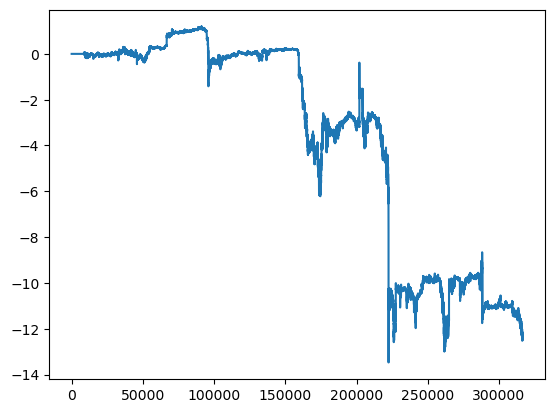

bnb_btc


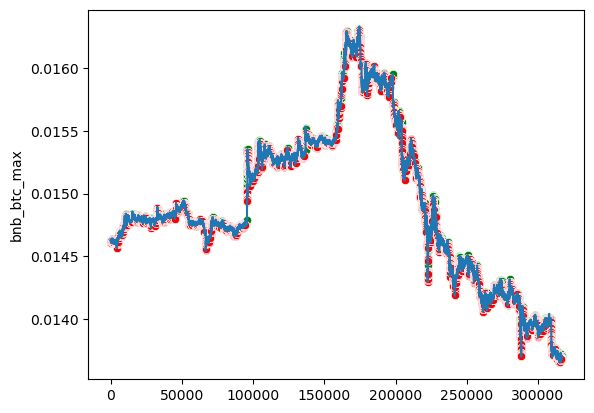

eth_btc


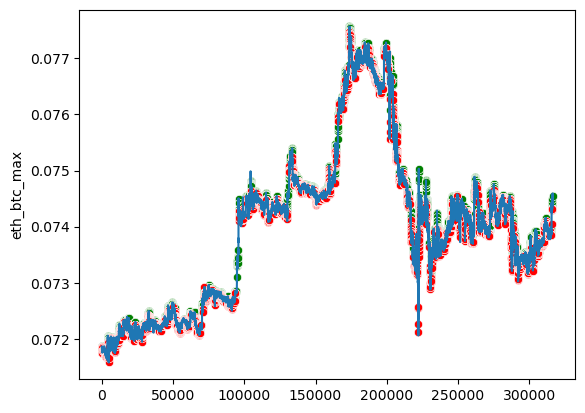

bnb_eth


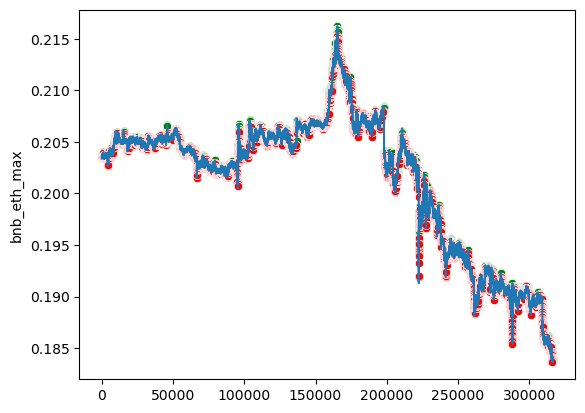

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 5, loss: 0.384
Traid counts: 66865 1: 6249 2: 8439 3: 4401 4: 9881 5: 16768 6: 21127
              precision    recall  f1-score   support

         0.0       1.00      0.79      0.88    315897
         1.0       0.01      0.51      0.02       127
         2.0       0.01      0.47      0.01       129
         3.0       0.01      0.42      0.01        71
         4.0       0.00      0.64      0.01        70
         5.0       0.01      0.78      0.01       126
         6.0       0.01      0.87      0.01       132

    accuracy                           0.79    316552
   macro avg       0.15      0.64      0.14    316552
weighted avg       1.00      0.79      0.88    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 370.59544377983275
Общая комиссия в usdt: 3.289484892414819
Число сделок: 184
Прибыль от 300 usdt за

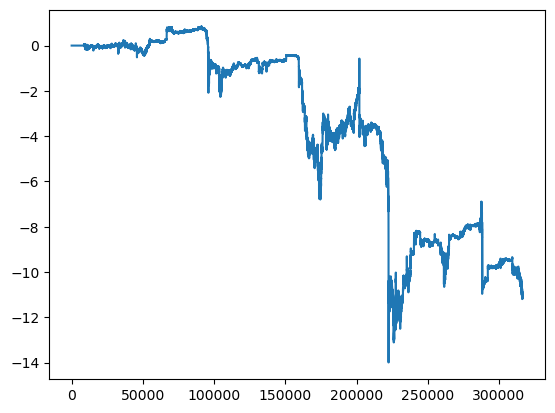

bnb_btc


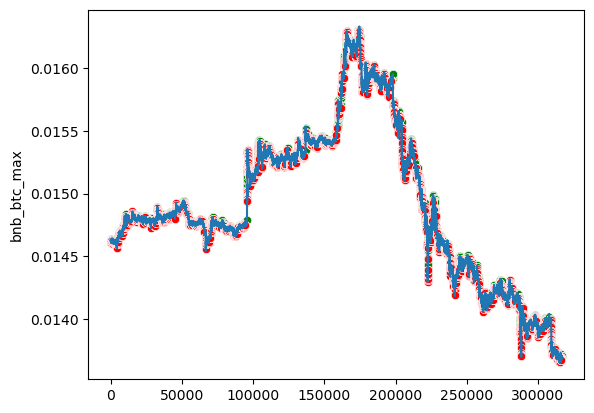

eth_btc


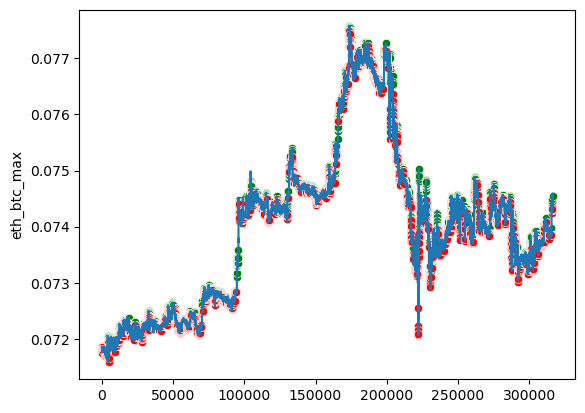

bnb_eth


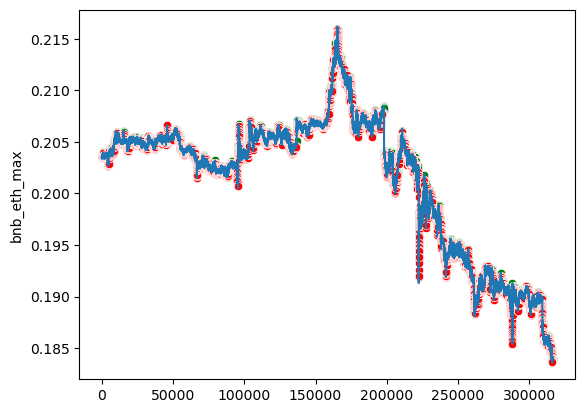

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 6, loss: 0.372
Traid counts: 61490 1: 5690 2: 5875 3: 6653 4: 9773 5: 13404 6: 20095
              precision    recall  f1-score   support

         0.0       1.00      0.81      0.89    315897
         1.0       0.01      0.44      0.02       127
         2.0       0.01      0.40      0.02       129
         3.0       0.01      0.58      0.01        71
         4.0       0.00      0.64      0.01        70
         5.0       0.01      0.74      0.01       126
         6.0       0.01      0.89      0.01       132

    accuracy                           0.81    316552
   macro avg       0.15      0.64      0.14    316552
weighted avg       1.00      0.81      0.89    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 370.5878312159523
Общая комиссия в usdt: 3.775120143074133
Число сделок: 210
Прибыль от 300 usdt за 

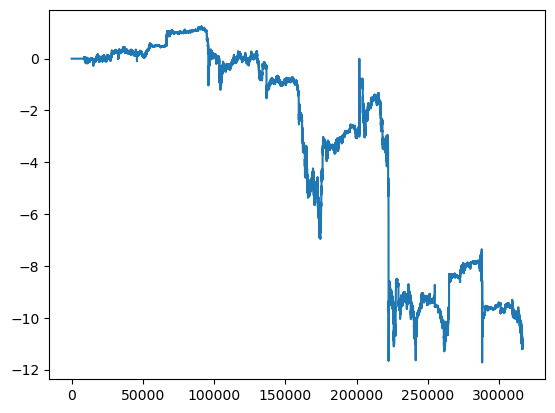

bnb_btc


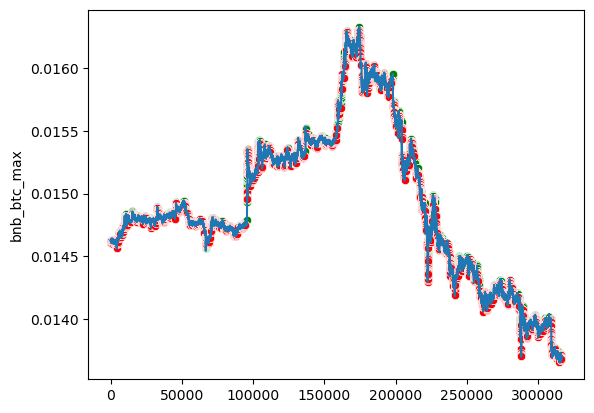

eth_btc


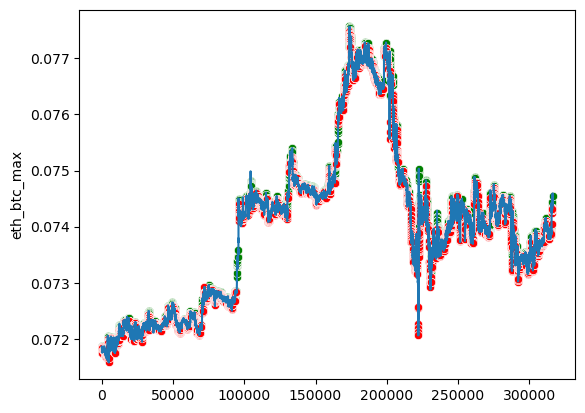

bnb_eth


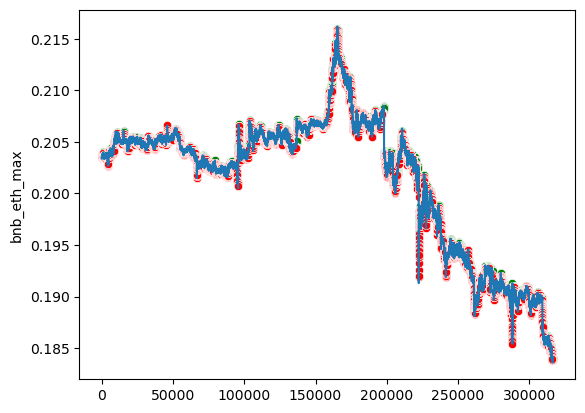

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 7, loss: 0.363
Traid counts: 58074 1: 5662 2: 8187 3: 5376 4: 8863 5: 10592 6: 19394
              precision    recall  f1-score   support

         0.0       1.00      0.82      0.90    315897
         1.0       0.01      0.39      0.02       127
         2.0       0.01      0.52      0.02       129
         3.0       0.01      0.59      0.02        71
         4.0       0.00      0.57      0.01        70
         5.0       0.01      0.79      0.02       126
         6.0       0.01      0.82      0.01       132

    accuracy                           0.82    316552
   macro avg       0.15      0.64      0.14    316552
weighted avg       1.00      0.82      0.90    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 367.7521774165849
Общая комиссия в usdt: 3.5169389167025287
Число сделок: 194
Прибыль от 300 usdt за

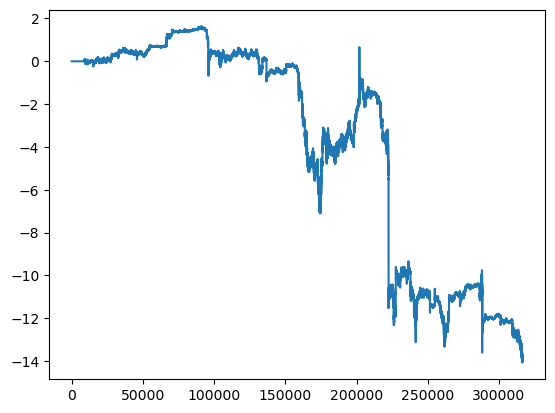

bnb_btc


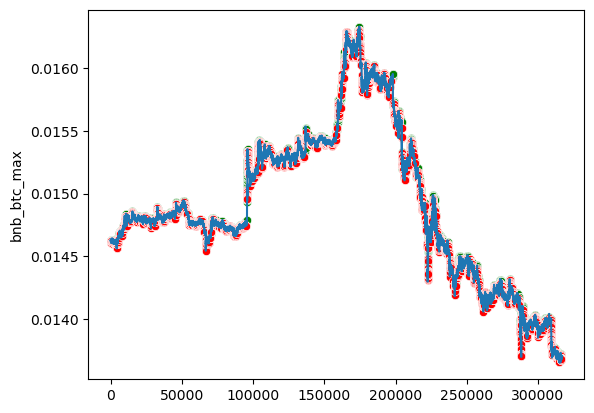

eth_btc


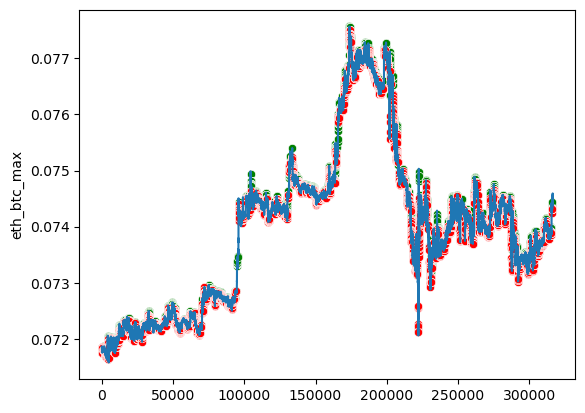

bnb_eth


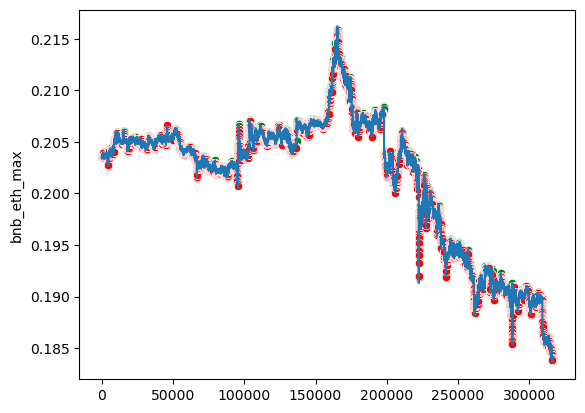

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 8, loss: 0.354
Traid counts: 60197 1: 5286 2: 8508 3: 5237 4: 10056 5: 12206 6: 18904
              precision    recall  f1-score   support

         0.0       1.00      0.81      0.90    315897
         1.0       0.01      0.46      0.02       127
         2.0       0.01      0.51      0.02       129
         3.0       0.01      0.48      0.01        71
         4.0       0.00      0.51      0.01        70
         5.0       0.01      0.75      0.02       126
         6.0       0.01      0.83      0.01       132

    accuracy                           0.81    316552
   macro avg       0.15      0.62      0.14    316552
weighted avg       1.00      0.81      0.89    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 368.6035530577568
Общая комиссия в usdt: 3.797142243470328
Число сделок: 219
Прибыль от 300 usdt за

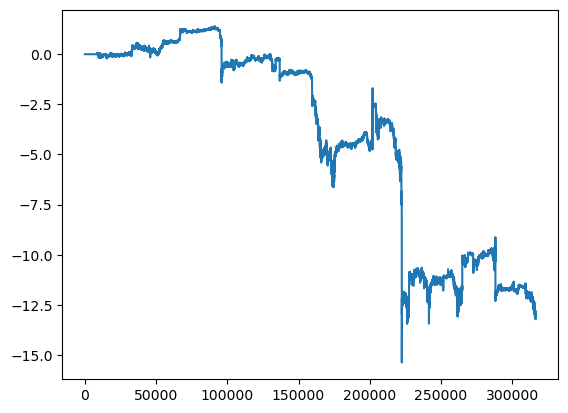

bnb_btc


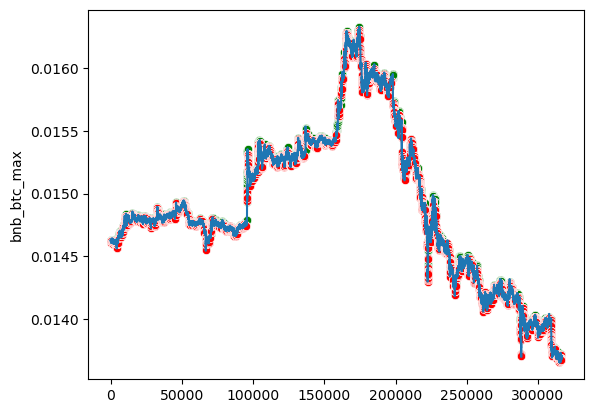

eth_btc


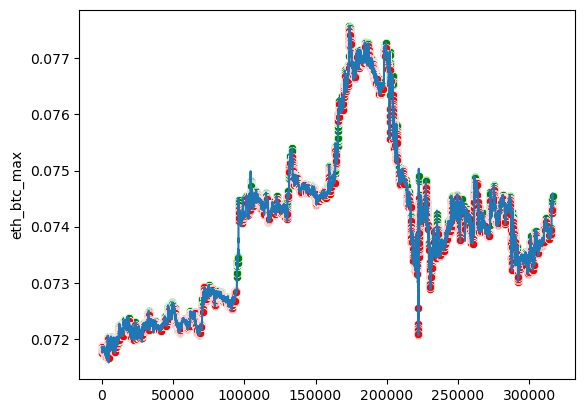

bnb_eth


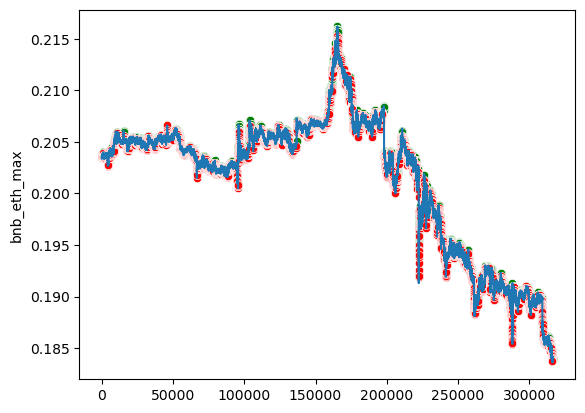

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 9, loss: 0.344
Traid counts: 58133 1: 7004 2: 7106 3: 5298 4: 13253 5: 9858 6: 15614
              precision    recall  f1-score   support

         0.0       1.00      0.82      0.90    315897
         1.0       0.01      0.48      0.02       127
         2.0       0.01      0.51      0.02       129
         3.0       0.01      0.49      0.01        71
         4.0       0.00      0.63      0.01        70
         5.0       0.01      0.62      0.02       126
         6.0       0.01      0.71      0.01       132

    accuracy                           0.82    316552
   macro avg       0.15      0.61      0.14    316552
weighted avg       1.00      0.82      0.90    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 362.88476574223125
Общая комиссия в usdt: 3.5867276096066822
Число сделок: 210
Прибыль от 300 usdt з

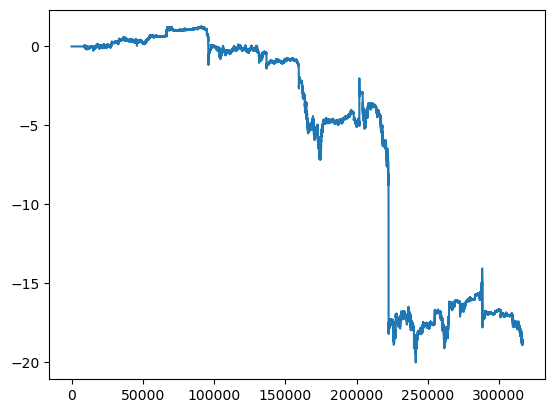

bnb_btc


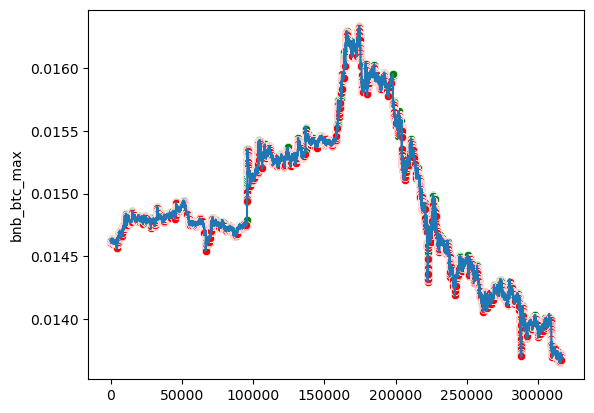

eth_btc


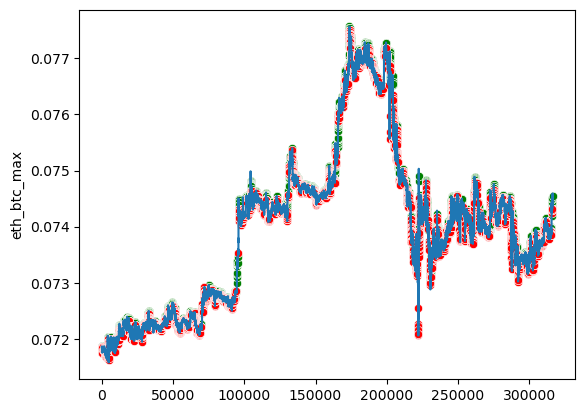

bnb_eth


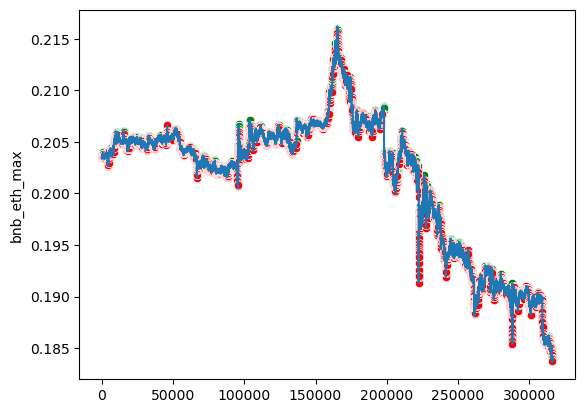

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 10, loss: 0.336
Traid counts: 60237 1: 7328 2: 9096 3: 4648 4: 12459 5: 10773 6: 15933
              precision    recall  f1-score   support

         0.0       1.00      0.81      0.90    315897
         1.0       0.01      0.47      0.02       127
         2.0       0.01      0.52      0.01       129
         3.0       0.01      0.42      0.01        71
         4.0       0.00      0.66      0.01        70
         5.0       0.01      0.65      0.02       126
         6.0       0.01      0.76      0.01       132

    accuracy                           0.81    316552
   macro avg       0.15      0.61      0.14    316552
weighted avg       1.00      0.81      0.89    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 367.1706165497756
Общая комиссия в usdt: 3.5536394615442606
Число сделок: 204
Прибыль от 300 usdt 

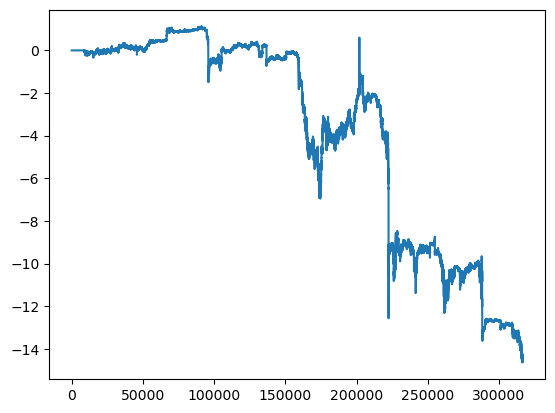

bnb_btc


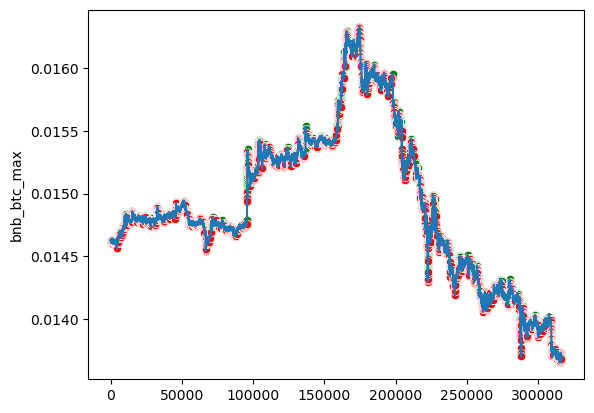

eth_btc


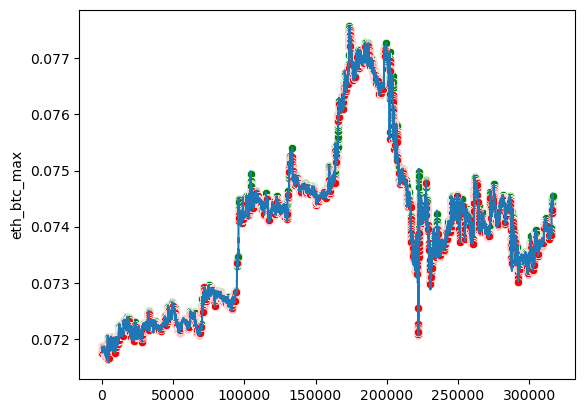

bnb_eth


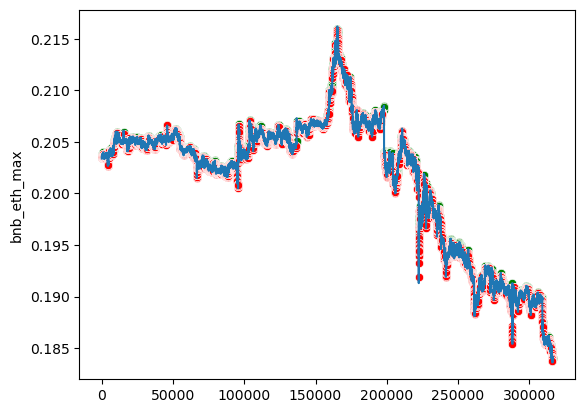

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 11, loss: 0.325
Traid counts: 56761 1: 7018 2: 7742 3: 5139 4: 13605 5: 10160 6: 13097
              precision    recall  f1-score   support

         0.0       1.00      0.82      0.90    315897
         1.0       0.01      0.50      0.02       127
         2.0       0.01      0.52      0.02       129
         3.0       0.01      0.51      0.01        71
         4.0       0.00      0.76      0.01        70
         5.0       0.01      0.65      0.02       126
         6.0       0.01      0.71      0.01       132

    accuracy                           0.82    316552
   macro avg       0.15      0.64      0.14    316552
weighted avg       1.00      0.82      0.90    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 368.5662623999855
Общая комиссия в usdt: 3.2707158013100646
Число сделок: 187
Прибыль от 300 usdt 

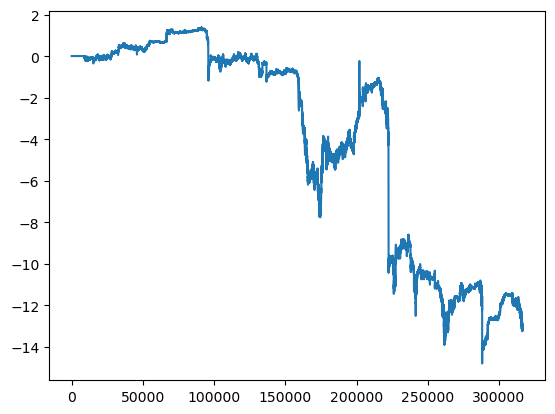

bnb_btc


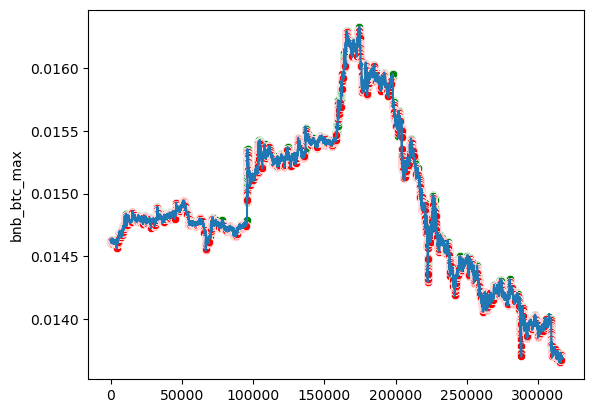

eth_btc


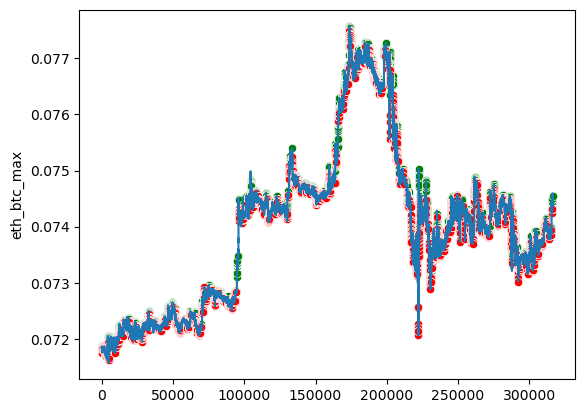

bnb_eth


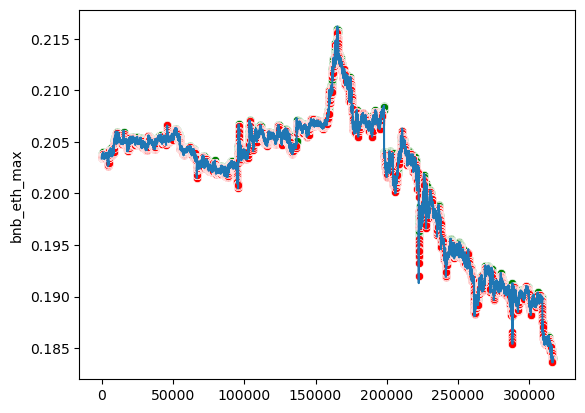

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 12, loss: 0.315
Traid counts: 60409 1: 7451 2: 8865 3: 4751 4: 13553 5: 9907 6: 15882
              precision    recall  f1-score   support

         0.0       1.00      0.81      0.90    315897
         1.0       0.01      0.46      0.02       127
         2.0       0.01      0.64      0.02       129
         3.0       0.01      0.45      0.01        71
         4.0       0.00      0.70      0.01        70
         5.0       0.01      0.58      0.01       126
         6.0       0.01      0.72      0.01       132

    accuracy                           0.81    316552
   macro avg       0.15      0.62      0.14    316552
weighted avg       1.00      0.81      0.89    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 372.5093619199565
Общая комиссия в usdt: 3.632847797634416
Число сделок: 205
Прибыль от 300 usdt за

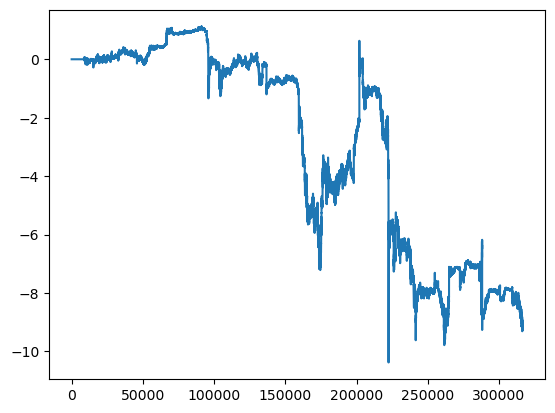

bnb_btc


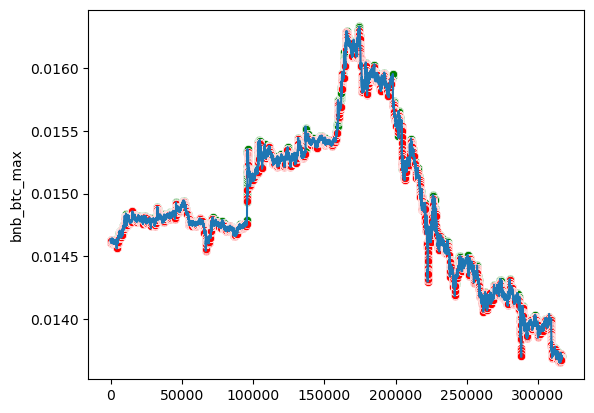

eth_btc


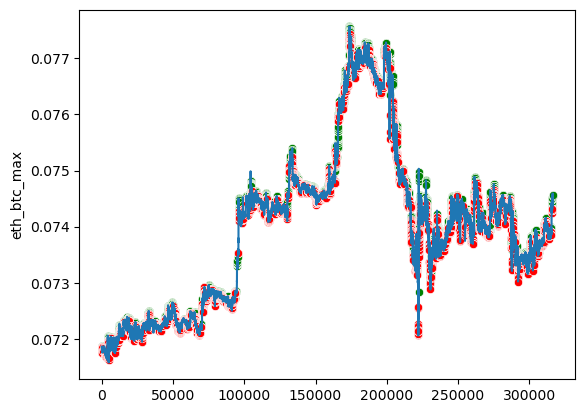

bnb_eth


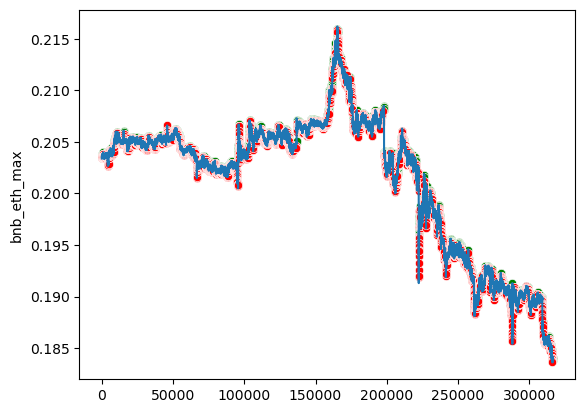

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 13, loss: 0.304
Traid counts: 61907 1: 7224 2: 6547 3: 4315 4: 15349 5: 11288 6: 17184
              precision    recall  f1-score   support

         0.0       1.00      0.81      0.89    315897
         1.0       0.01      0.56      0.02       127
         2.0       0.01      0.47      0.02       129
         3.0       0.01      0.48      0.02        71
         4.0       0.00      0.64      0.01        70
         5.0       0.01      0.60      0.01       126
         6.0       0.01      0.80      0.01       132

    accuracy                           0.81    316552
   macro avg       0.15      0.62      0.14    316552
weighted avg       1.00      0.81      0.89    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 368.825181635567
Общая комиссия в usdt: 3.4256845762593153
Число сделок: 195
Прибыль от 300 usdt з

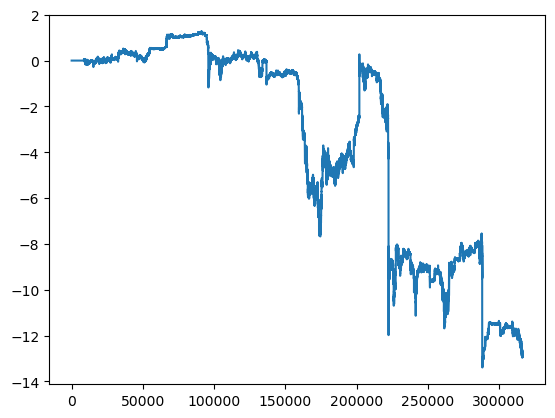

bnb_btc


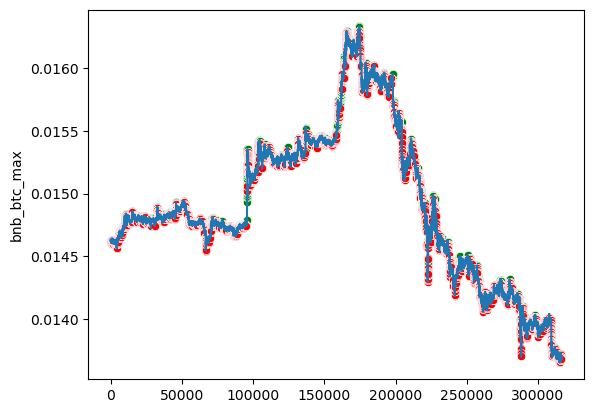

eth_btc


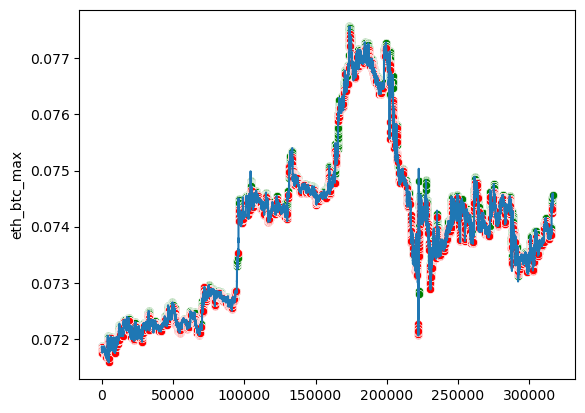

bnb_eth


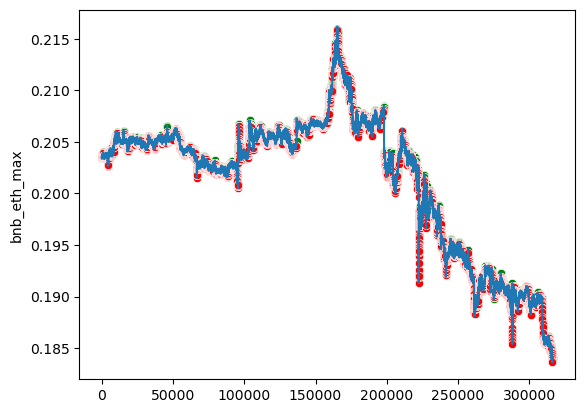

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 14, loss: 0.296
Traid counts: 63178 1: 7623 2: 6935 3: 3990 4: 15373 5: 14246 6: 15011
              precision    recall  f1-score   support

         0.0       1.00      0.80      0.89    315897
         1.0       0.01      0.54      0.02       127
         2.0       0.01      0.45      0.02       129
         3.0       0.01      0.32      0.01        71
         4.0       0.00      0.67      0.01        70
         5.0       0.01      0.71      0.01       126
         6.0       0.01      0.72      0.01       132

    accuracy                           0.80    316552
   macro avg       0.15      0.60      0.14    316552
weighted avg       1.00      0.80      0.89    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 369.3024706178261
Общая комиссия в usdt: 3.619334246648426
Число сделок: 197
Прибыль от 300 usdt з

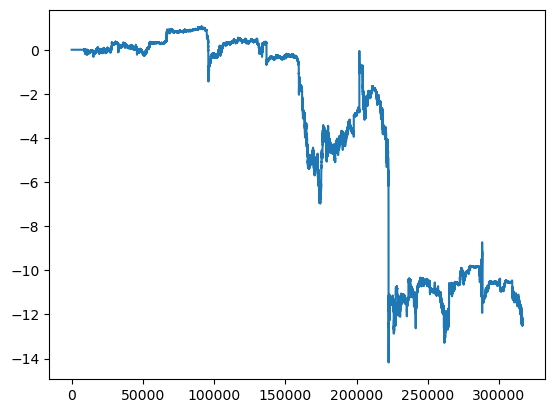

bnb_btc


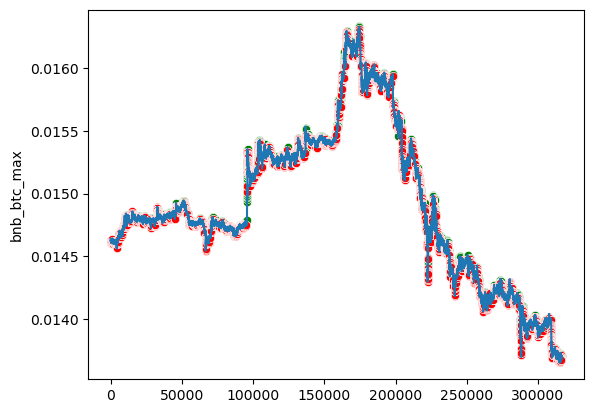

eth_btc


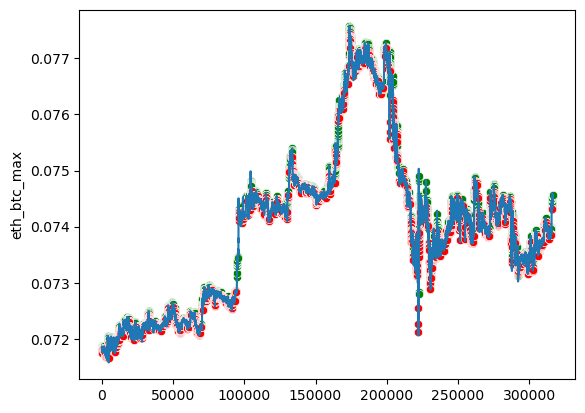

bnb_eth


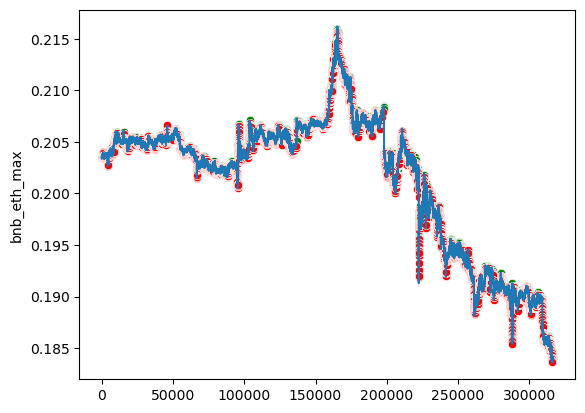

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 15, loss: 0.288
Traid counts: 61822 1: 9453 2: 7015 3: 4782 4: 11938 5: 14588 6: 14046
              precision    recall  f1-score   support

         0.0       1.00      0.81      0.89    315897
         1.0       0.01      0.50      0.01       127
         2.0       0.01      0.40      0.01       129
         3.0       0.00      0.23      0.01        71
         4.0       0.00      0.56      0.01        70
         5.0       0.01      0.74      0.01       126
         6.0       0.01      0.73      0.01       132

    accuracy                           0.81    316552
   macro avg       0.15      0.57      0.14    316552
weighted avg       1.00      0.81      0.89    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 361.719342556266
Общая комиссия в usdt: 3.6590581804221443
Число сделок: 212
Прибыль от 300 usdt з

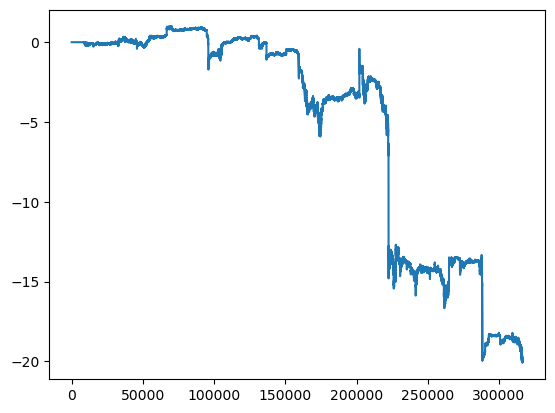

bnb_btc


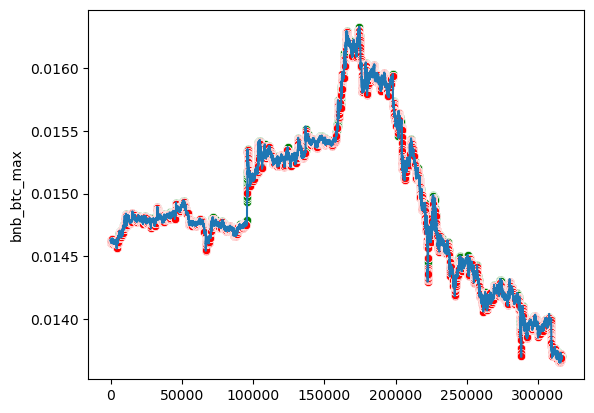

eth_btc


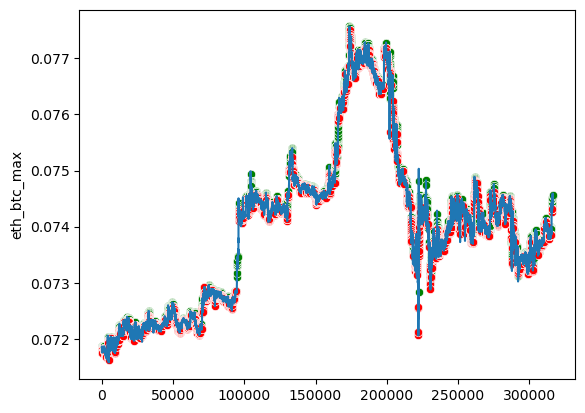

bnb_eth


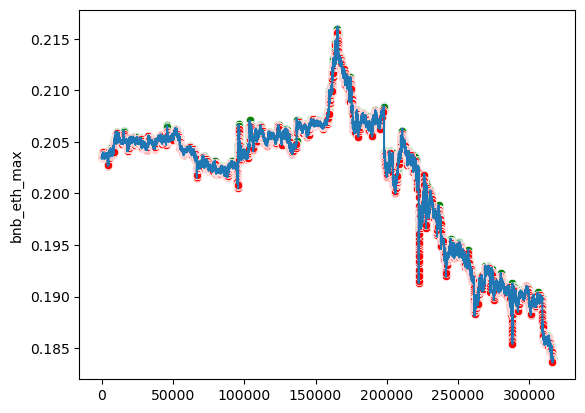

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 16, loss: 0.279
Traid counts: 63572 1: 13686 2: 8298 3: 3594 4: 12456 5: 12525 6: 13013
              precision    recall  f1-score   support

         0.0       1.00      0.80      0.89    315897
         1.0       0.01      0.67      0.01       127
         2.0       0.01      0.48      0.01       129
         3.0       0.01      0.25      0.01        71
         4.0       0.00      0.60      0.01        70
         5.0       0.01      0.67      0.01       126
         6.0       0.01      0.70      0.01       132

    accuracy                           0.80    316552
   macro avg       0.15      0.60      0.14    316552
weighted avg       1.00      0.80      0.89    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 364.2612124523242
Общая комиссия в usdt: 3.6912831592552884
Число сделок: 208
Прибыль от 300 usdt

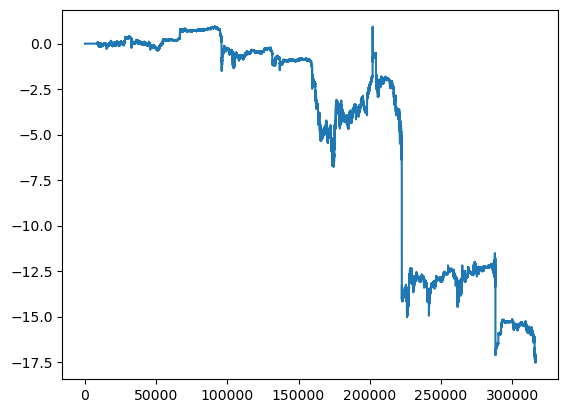

bnb_btc


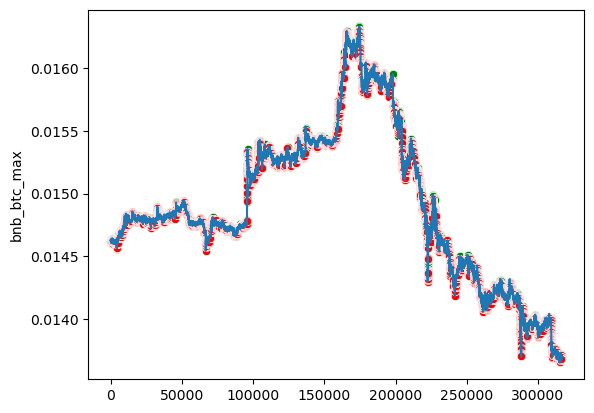

eth_btc


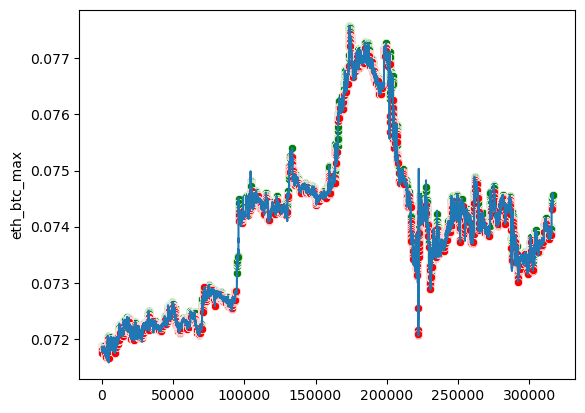

bnb_eth


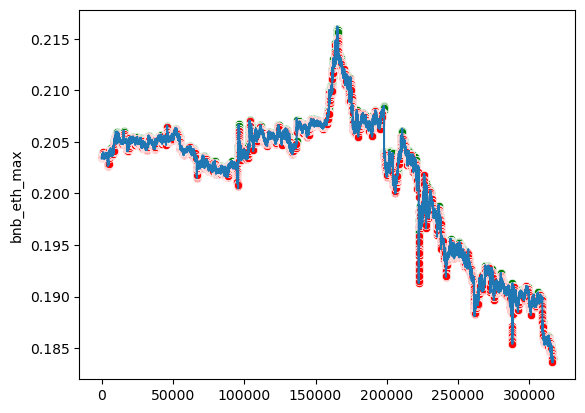

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 17, loss: 0.268
Traid counts: 64458 1: 12943 2: 8505 3: 5043 4: 13181 5: 10915 6: 13871
              precision    recall  f1-score   support

         0.0       1.00      0.80      0.89    315897
         1.0       0.01      0.62      0.01       127
         2.0       0.01      0.47      0.01       129
         3.0       0.00      0.28      0.01        71
         4.0       0.00      0.59      0.01        70
         5.0       0.01      0.61      0.01       126
         6.0       0.01      0.68      0.01       132

    accuracy                           0.80    316552
   macro avg       0.15      0.58      0.14    316552
weighted avg       1.00      0.80      0.89    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 364.4668351181017
Общая комиссия в usdt: 3.7881337345650836
Число сделок: 217
Прибыль от 300 usdt

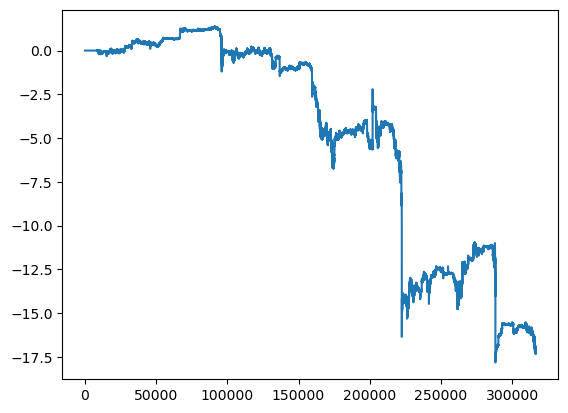

bnb_btc


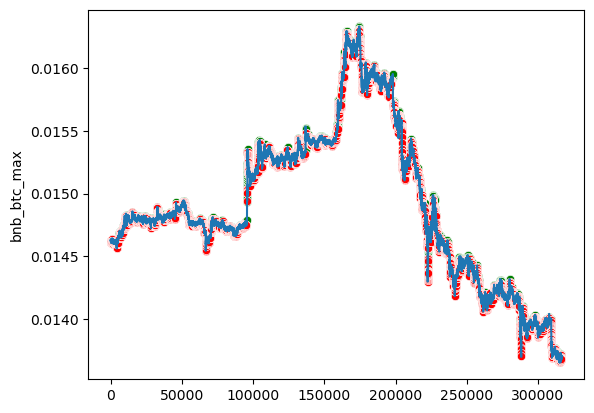

eth_btc


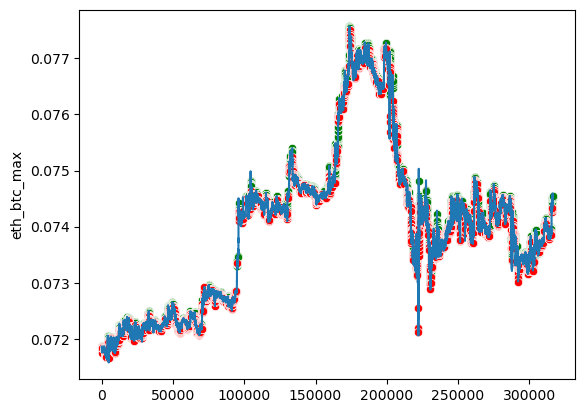

bnb_eth


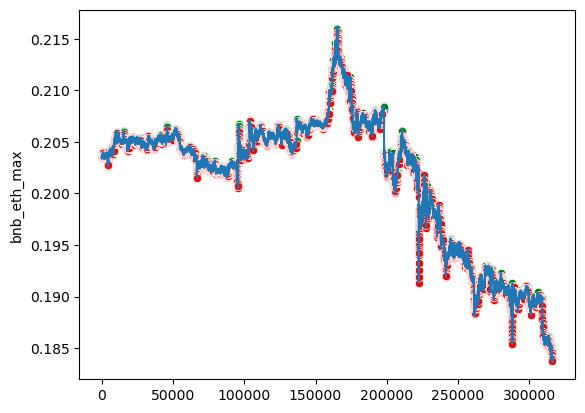

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 18, loss: 0.258
Traid counts: 59299 1: 13299 2: 7584 3: 3502 4: 11577 5: 10886 6: 12451
              precision    recall  f1-score   support

         0.0       1.00      0.81      0.90    315897
         1.0       0.01      0.64      0.01       127
         2.0       0.01      0.47      0.02       129
         3.0       0.01      0.25      0.01        71
         4.0       0.00      0.61      0.01        70
         5.0       0.01      0.63      0.01       126
         6.0       0.01      0.64      0.01       132

    accuracy                           0.81    316552
   macro avg       0.15      0.58      0.14    316552
weighted avg       1.00      0.81      0.90    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 365.37462457551067
Общая комиссия в usdt: 3.863858890235826
Число сделок: 220
Прибыль от 300 usdt

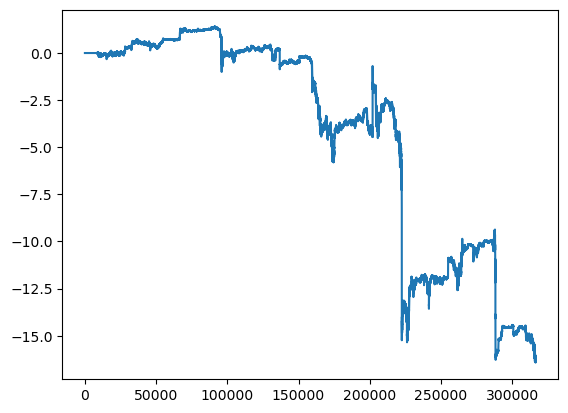

bnb_btc


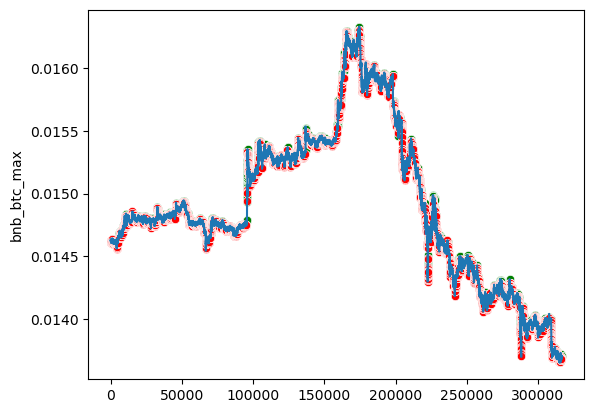

eth_btc


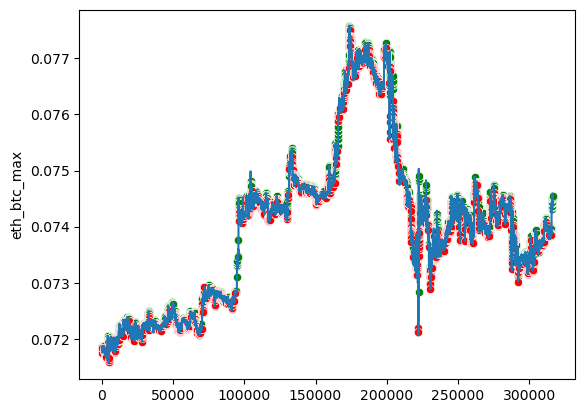

bnb_eth


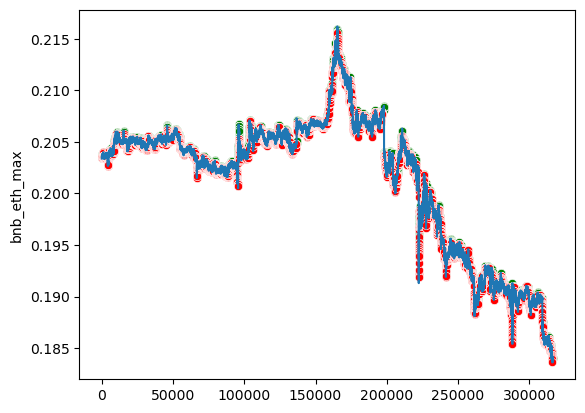

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 19, loss: 0.246
Traid counts: 54837 1: 12489 2: 6884 3: 4085 4: 10220 5: 9061 6: 12098
              precision    recall  f1-score   support

         0.0       1.00      0.83      0.91    315897
         1.0       0.01      0.65      0.01       127
         2.0       0.01      0.40      0.01       129
         3.0       0.00      0.28      0.01        71
         4.0       0.00      0.61      0.01        70
         5.0       0.01      0.55      0.02       126
         6.0       0.01      0.70      0.02       132

    accuracy                           0.83    316552
   macro avg       0.15      0.57      0.14    316552
weighted avg       1.00      0.83      0.90    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 363.65900478995115
Общая комиссия в usdt: 3.6046984623687948
Число сделок: 208
Прибыль от 300 usdt

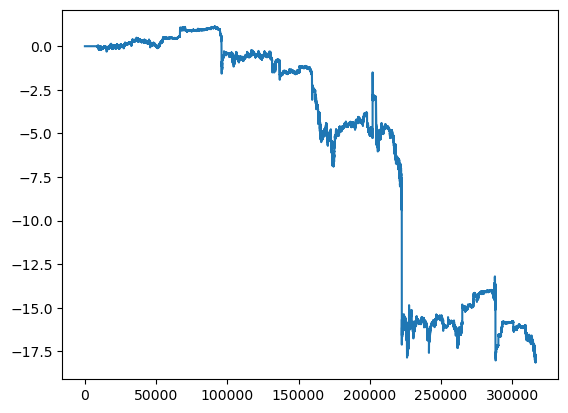

bnb_btc


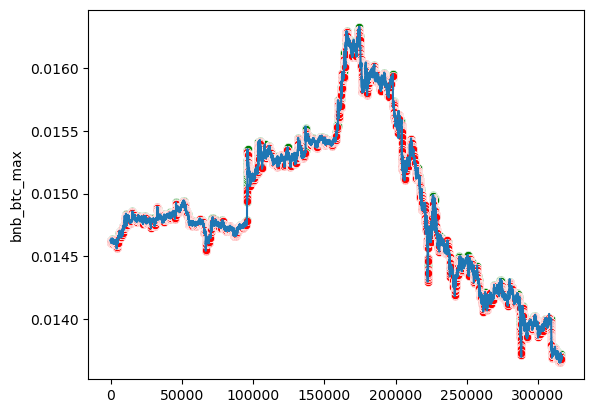

eth_btc


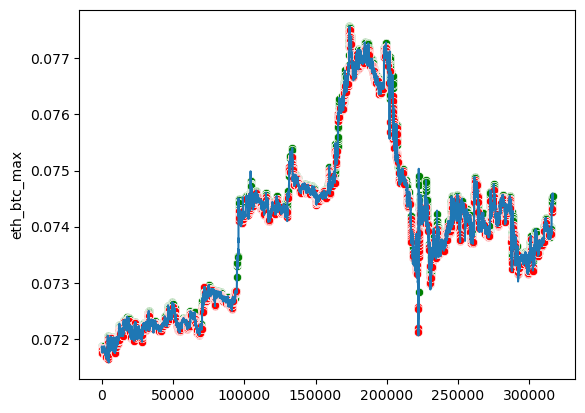

bnb_eth


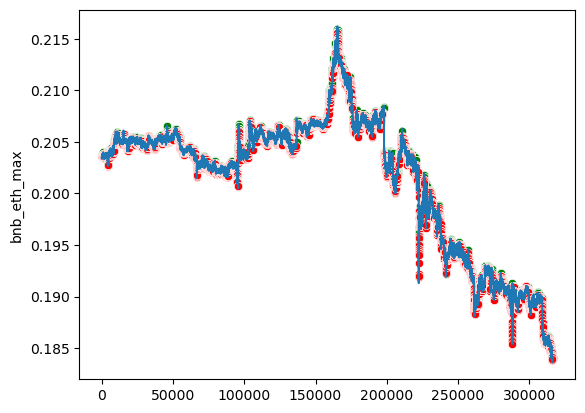

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 20, loss: 0.238
Traid counts: 50042 1: 10205 2: 6020 3: 3881 4: 9102 5: 10027 6: 10807
              precision    recall  f1-score   support

         0.0       1.00      0.84      0.91    315897
         1.0       0.01      0.56      0.01       127
         2.0       0.01      0.41      0.02       129
         3.0       0.00      0.20      0.01        71
         4.0       0.00      0.53      0.01        70
         5.0       0.01      0.55      0.01       126
         6.0       0.01      0.59      0.01       132

    accuracy                           0.84    316552
   macro avg       0.15      0.53      0.14    316552
weighted avg       1.00      0.84      0.91    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 364.6957643551959
Общая комиссия в usdt: 3.7002280899078976
Число сделок: 208
Прибыль от 300 usdt 

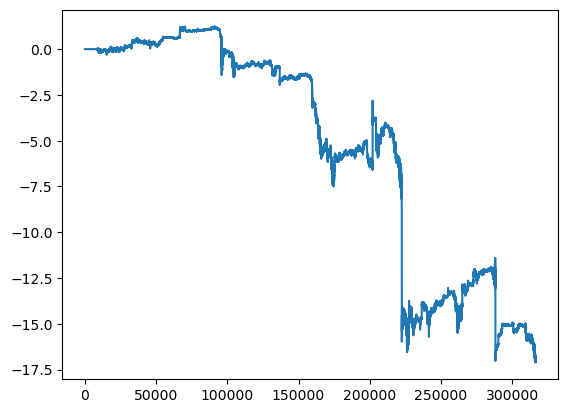

bnb_btc


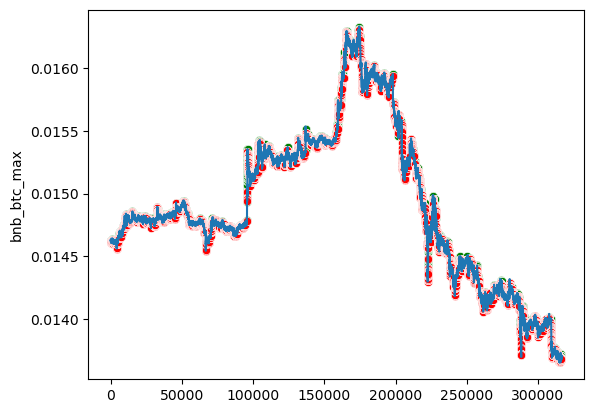

eth_btc


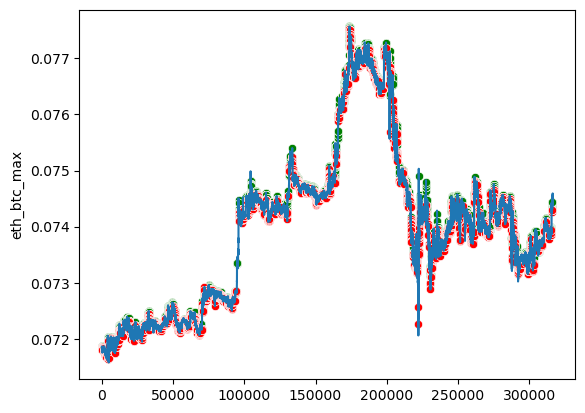

bnb_eth


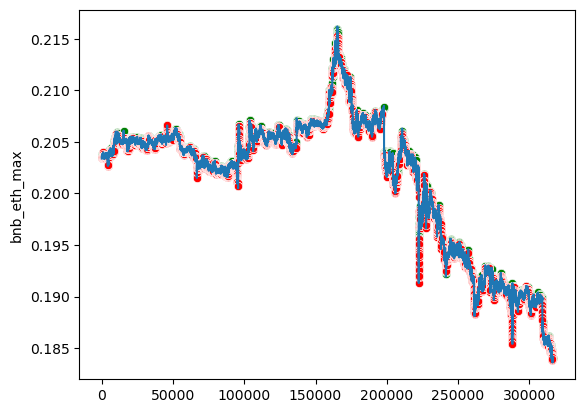

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 21, loss: 0.225
Traid counts: 47307 1: 8239 2: 6766 3: 4347 4: 8188 5: 8352 6: 11415
              precision    recall  f1-score   support

         0.0       1.00      0.85      0.92    315897
         1.0       0.01      0.53      0.02       127
         2.0       0.01      0.36      0.01       129
         3.0       0.00      0.30      0.01        71
         4.0       0.00      0.51      0.01        70
         5.0       0.01      0.63      0.02       126
         6.0       0.01      0.61      0.01       132

    accuracy                           0.85    316552
   macro avg       0.15      0.54      0.14    316552
weighted avg       1.00      0.85      0.92    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 370.9485369485286
Общая комиссия в usdt: 3.7376440274875686
Число сделок: 210
Прибыль от 300 usdt за

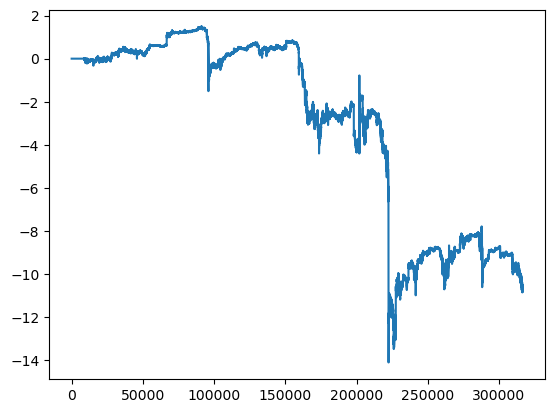

bnb_btc


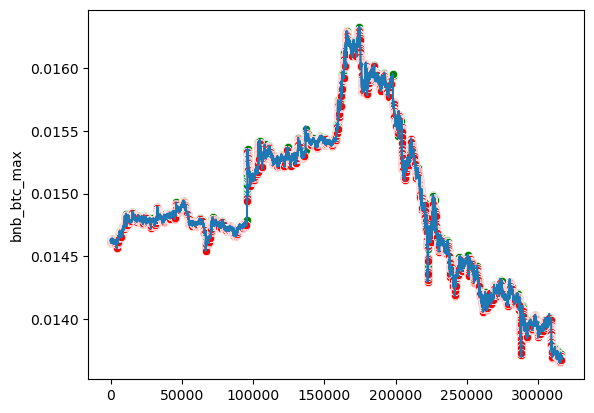

eth_btc


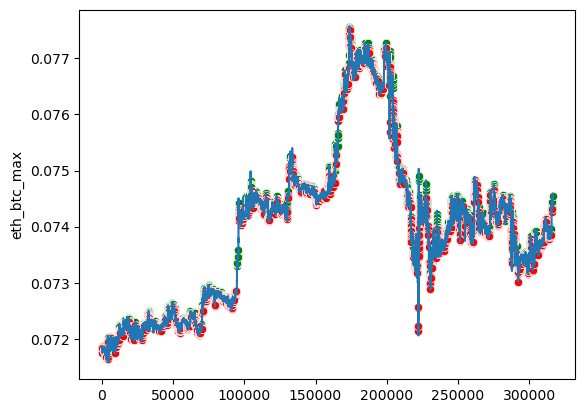

bnb_eth


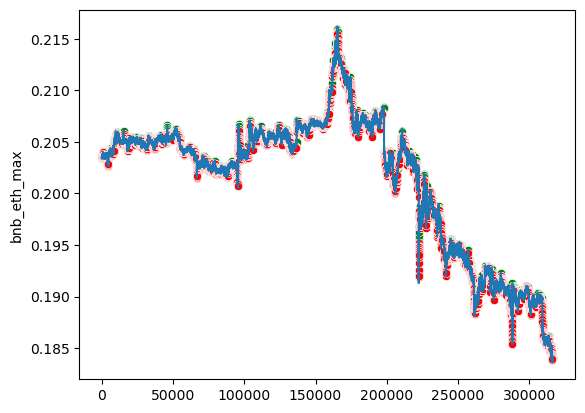

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 22, loss: 0.218
Traid counts: 51651 1: 8195 2: 5643 3: 4451 4: 10135 5: 9960 6: 13267
              precision    recall  f1-score   support

         0.0       1.00      0.84      0.91    315897
         1.0       0.01      0.46      0.01       127
         2.0       0.01      0.33      0.01       129
         3.0       0.00      0.23      0.01        71
         4.0       0.00      0.56      0.01        70
         5.0       0.01      0.62      0.02       126
         6.0       0.01      0.67      0.01       132

    accuracy                           0.84    316552
   macro avg       0.15      0.53      0.14    316552
weighted avg       1.00      0.84      0.91    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 365.21597679058425
Общая комиссия в usdt: 3.4501308929214223
Число сделок: 197
Прибыль от 300 usdt 

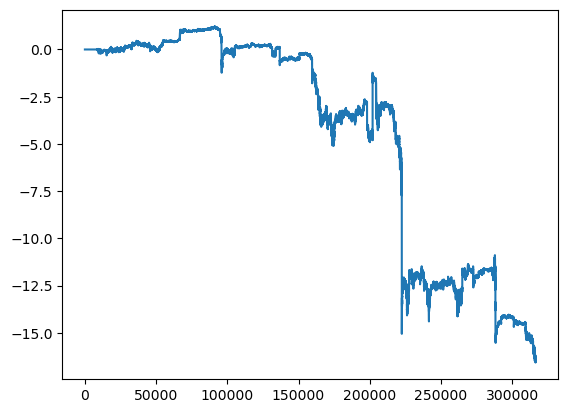

bnb_btc


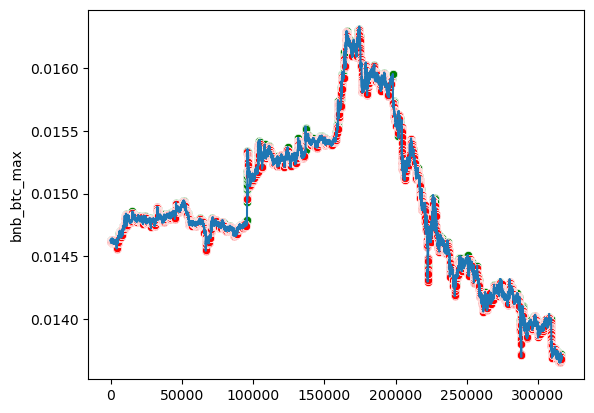

eth_btc


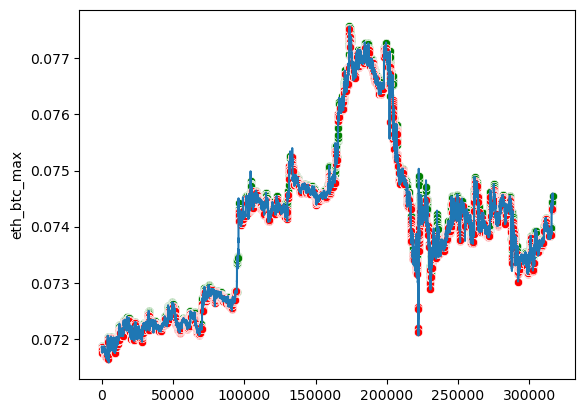

bnb_eth


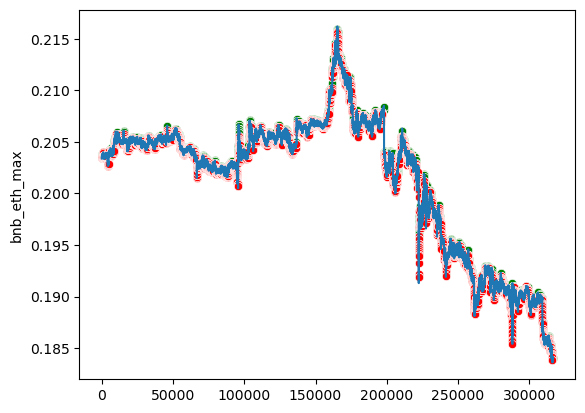

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 23, loss: 0.210
Traid counts: 48950 1: 8597 2: 5772 3: 4372 4: 9148 5: 9243 6: 11818
              precision    recall  f1-score   support

         0.0       1.00      0.85      0.92    315897
         1.0       0.01      0.49      0.01       127
         2.0       0.01      0.34      0.01       129
         3.0       0.00      0.25      0.01        71
         4.0       0.00      0.56      0.01        70
         5.0       0.01      0.57      0.02       126
         6.0       0.01      0.63      0.01       132

    accuracy                           0.85    316552
   macro avg       0.15      0.53      0.14    316552
weighted avg       1.00      0.85      0.91    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 378.7352635921295
Общая комиссия в usdt: 3.850916427714371
Число сделок: 208
Прибыль от 300 usdt за 

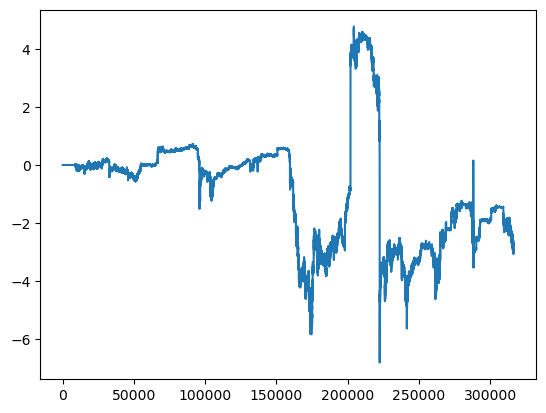

bnb_btc


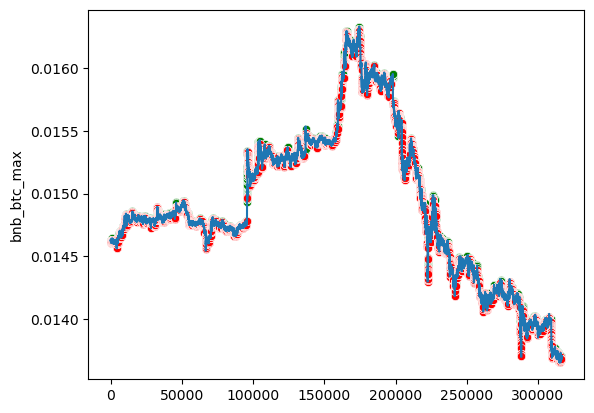

eth_btc


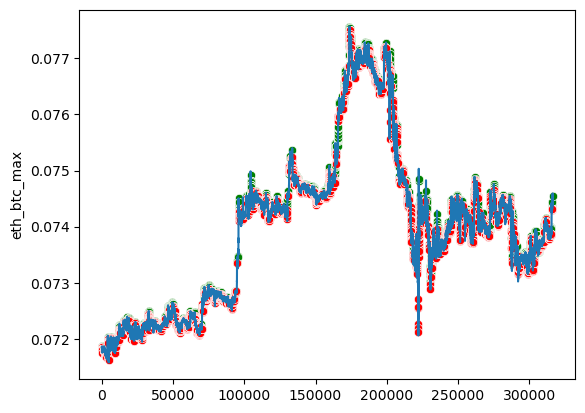

bnb_eth


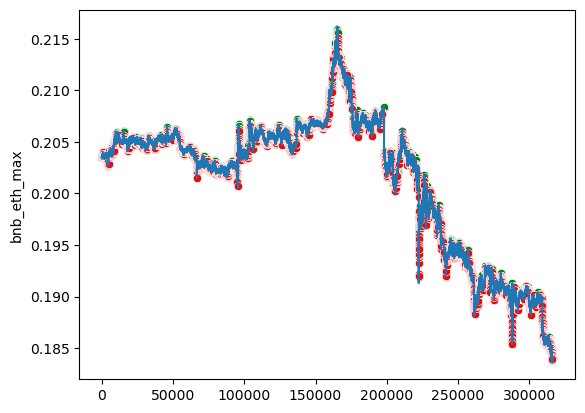

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 24, loss: 0.203
Traid counts: 47175 1: 9167 2: 7440 3: 3788 4: 7743 5: 8972 6: 10065
              precision    recall  f1-score   support

         0.0       1.00      0.85      0.92    315897
         1.0       0.01      0.52      0.01       127
         2.0       0.01      0.43      0.01       129
         3.0       0.00      0.25      0.01        71
         4.0       0.00      0.47      0.01        70
         5.0       0.01      0.60      0.02       126
         6.0       0.01      0.48      0.01       132

    accuracy                           0.85    316552
   macro avg       0.15      0.52      0.14    316552
weighted avg       1.00      0.85      0.92    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 364.90019180121067
Общая комиссия в usdt: 3.5501357589715608
Число сделок: 196
Прибыль от 300 usdt з

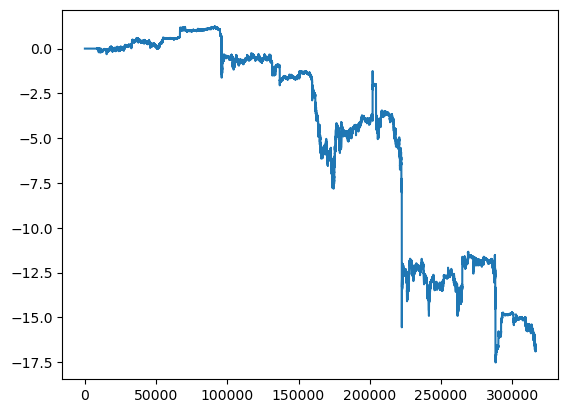

bnb_btc


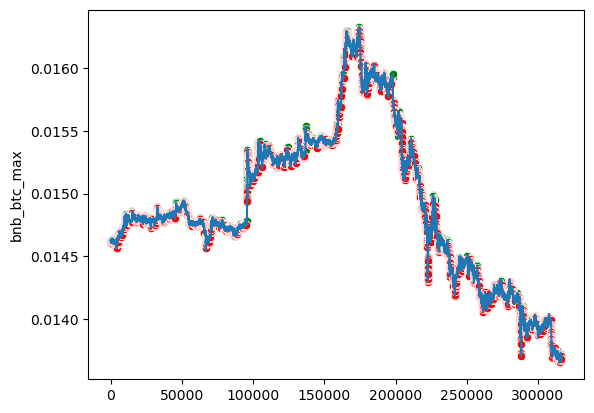

eth_btc


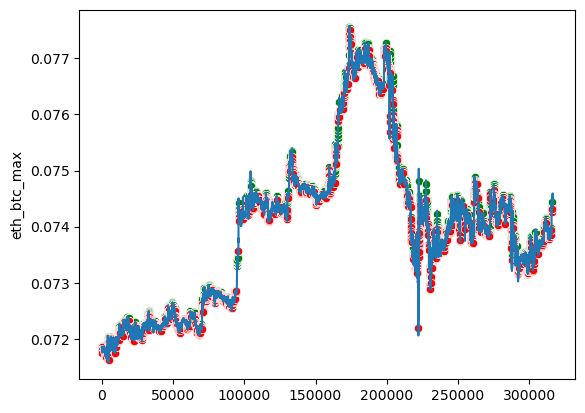

bnb_eth


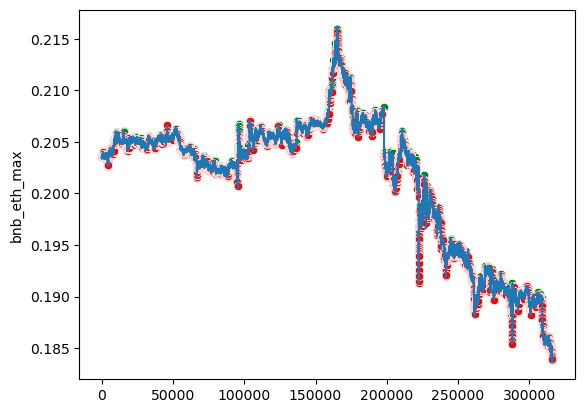

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 25, loss: 0.195
Traid counts: 48551 1: 9192 2: 9081 3: 3126 4: 9004 5: 8215 6: 9933
              precision    recall  f1-score   support

         0.0       1.00      0.85      0.92    315897
         1.0       0.01      0.50      0.01       127
         2.0       0.01      0.50      0.01       129
         3.0       0.00      0.17      0.01        71
         4.0       0.00      0.53      0.01        70
         5.0       0.01      0.52      0.02       126
         6.0       0.01      0.48      0.01       132

    accuracy                           0.85    316552
   macro avg       0.15      0.51      0.14    316552
weighted avg       1.00      0.85      0.92    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 371.60247533590575
Общая комиссия в usdt: 3.7650380494060576
Число сделок: 212
Прибыль от 300 usdt за

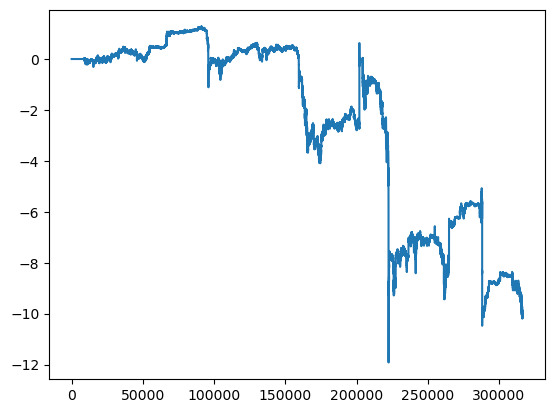

bnb_btc


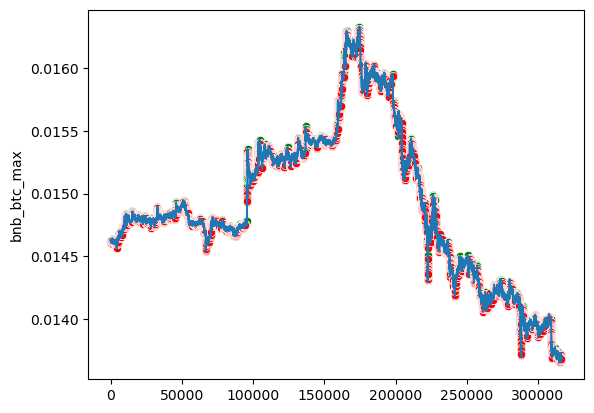

eth_btc


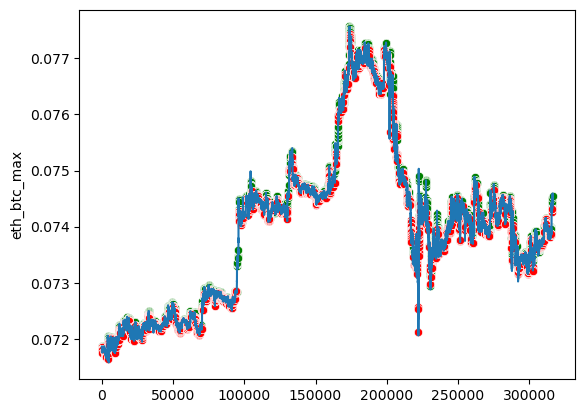

bnb_eth


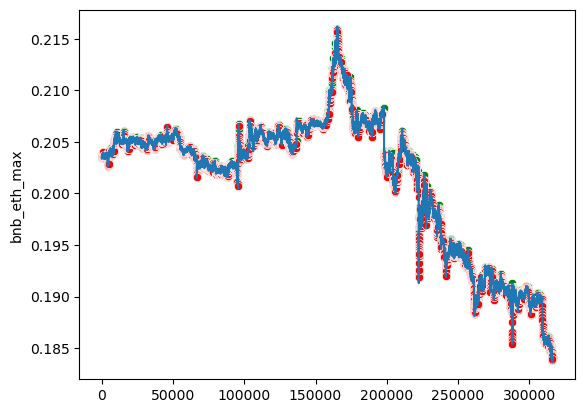

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 26, loss: 0.187
Traid counts: 49112 1: 8744 2: 9385 3: 4393 4: 7459 5: 8449 6: 10682
              precision    recall  f1-score   support

         0.0       1.00      0.85      0.92    315897
         1.0       0.01      0.55      0.02       127
         2.0       0.01      0.49      0.01       129
         3.0       0.00      0.18      0.01        71
         4.0       0.00      0.40      0.01        70
         5.0       0.01      0.52      0.02       126
         6.0       0.01      0.60      0.01       132

    accuracy                           0.85    316552
   macro avg       0.15      0.51      0.14    316552
weighted avg       1.00      0.85      0.91    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 369.6557961772241
Общая комиссия в usdt: 3.3249175175250536
Число сделок: 185
Прибыль от 300 usdt за

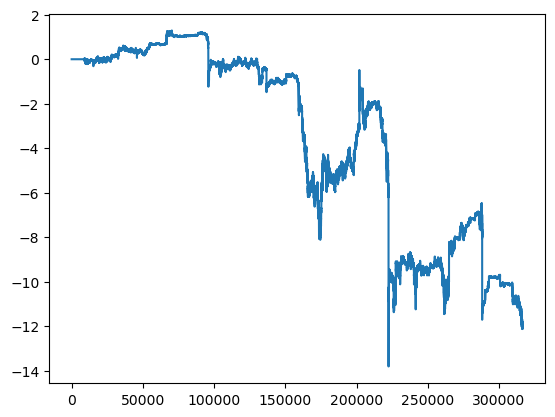

bnb_btc


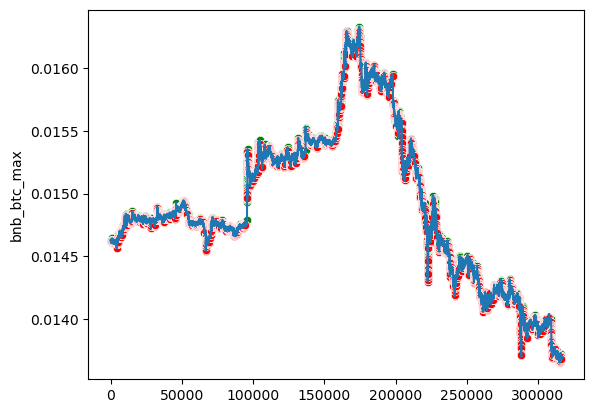

eth_btc


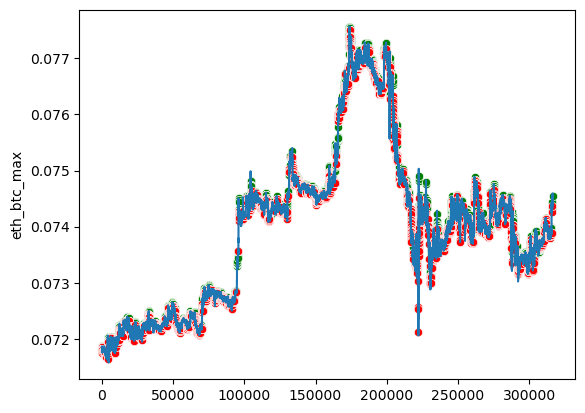

bnb_eth


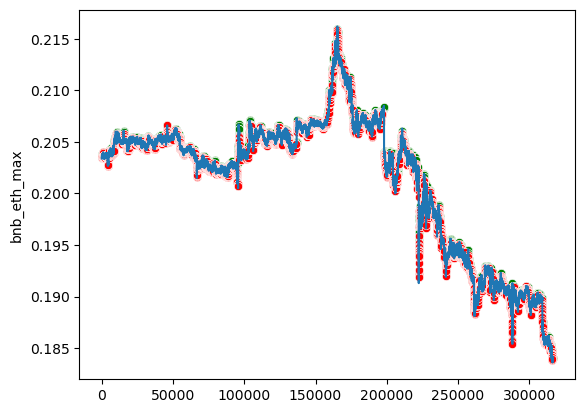

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 27, loss: 0.182
Traid counts: 48582 1: 8239 2: 8865 3: 3396 4: 8607 5: 8442 6: 11033
              precision    recall  f1-score   support

         0.0       1.00      0.85      0.92    315897
         1.0       0.01      0.46      0.01       127
         2.0       0.01      0.45      0.01       129
         3.0       0.00      0.15      0.01        71
         4.0       0.00      0.50      0.01        70
         5.0       0.01      0.60      0.02       126
         6.0       0.01      0.53      0.01       132

    accuracy                           0.85    316552
   macro avg       0.15      0.50      0.14    316552
weighted avg       1.00      0.85      0.92    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 369.6795591631085
Общая комиссия в usdt: 3.2425622677532027
Число сделок: 184
Прибыль от 300 usdt за

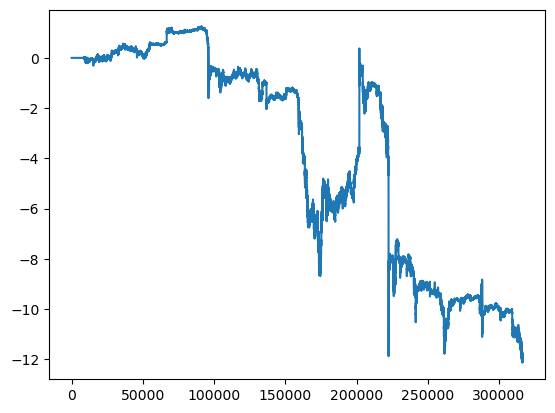

bnb_btc


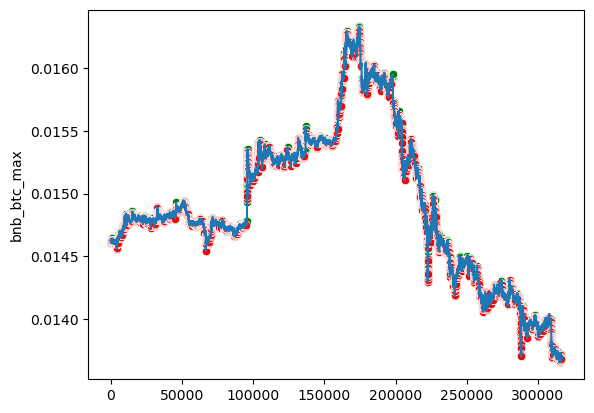

eth_btc


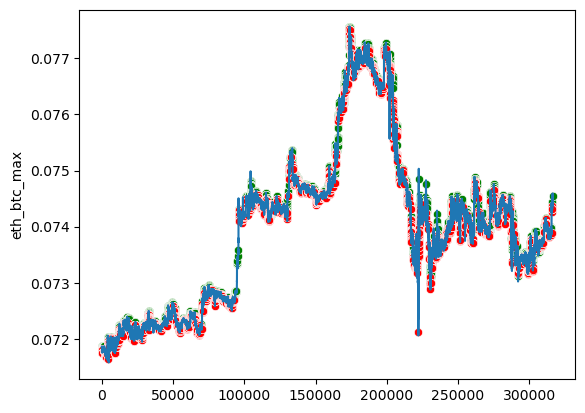

bnb_eth


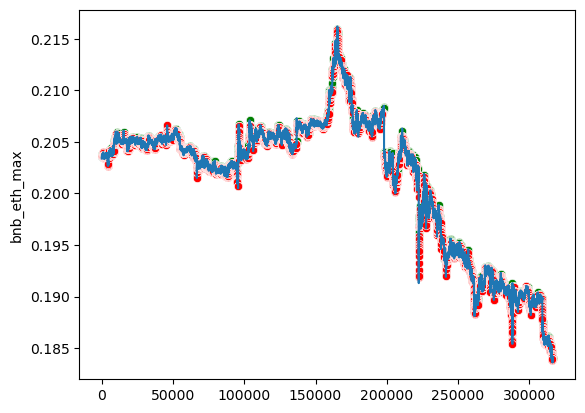

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 28, loss: 0.175
Traid counts: 46033 1: 7351 2: 8722 3: 3014 4: 9180 5: 6751 6: 11015
              precision    recall  f1-score   support

         0.0       1.00      0.86      0.92    315897
         1.0       0.01      0.43      0.01       127
         2.0       0.01      0.43      0.01       129
         3.0       0.00      0.15      0.01        71
         4.0       0.00      0.46      0.01        70
         5.0       0.01      0.51      0.02       126
         6.0       0.01      0.58      0.01       132

    accuracy                           0.85    316552
   macro avg       0.15      0.49      0.14    316552
weighted avg       1.00      0.85      0.92    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 371.40888079714887
Общая комиссия в usdt: 3.5709735702492296
Число сделок: 199
Прибыль от 300 usdt з

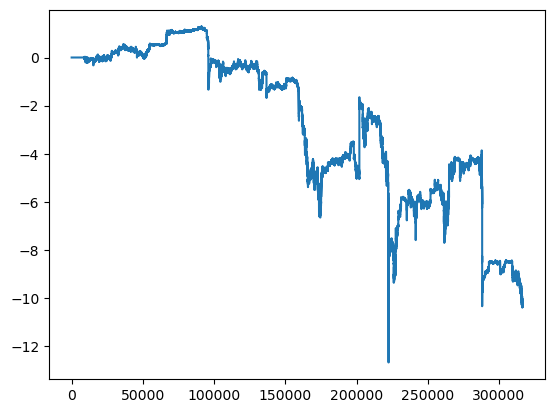

bnb_btc


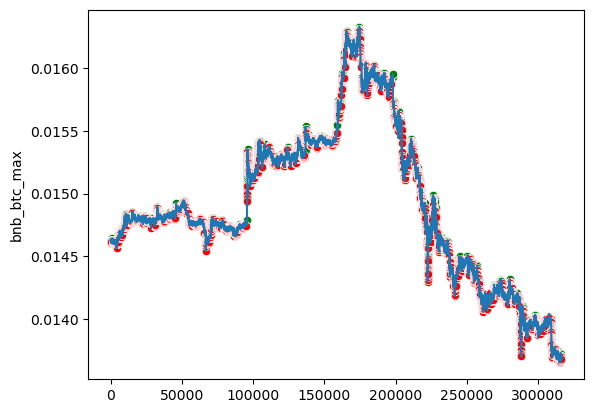

eth_btc


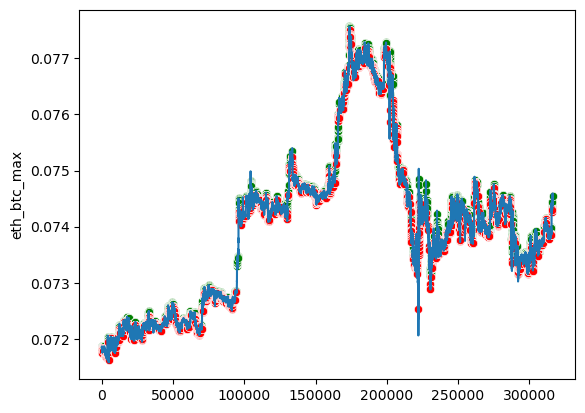

bnb_eth


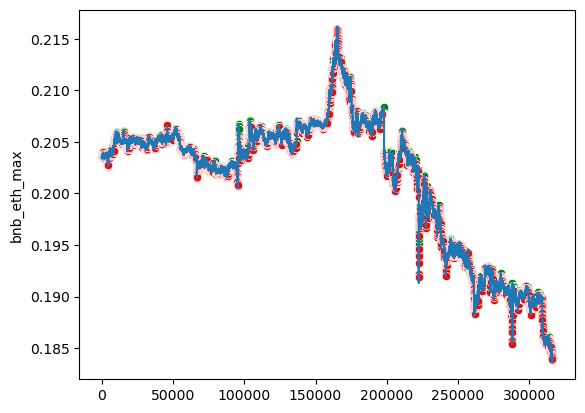

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 29, loss: 0.171
Traid counts: 45556 1: 6045 2: 8708 3: 3359 4: 8794 5: 9247 6: 9403
              precision    recall  f1-score   support

         0.0       1.00      0.86      0.92    315897
         1.0       0.01      0.37      0.02       127
         2.0       0.01      0.53      0.02       129
         3.0       0.01      0.25      0.01        71
         4.0       0.00      0.49      0.01        70
         5.0       0.01      0.56      0.02       126
         6.0       0.01      0.48      0.01       132

    accuracy                           0.86    316552
   macro avg       0.15      0.51      0.14    316552
weighted avg       1.00      0.86      0.92    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 370.0187447141596
Общая комиссия в usdt: 3.4768706037872414
Число сделок: 188
Прибыль от 300 usdt за 

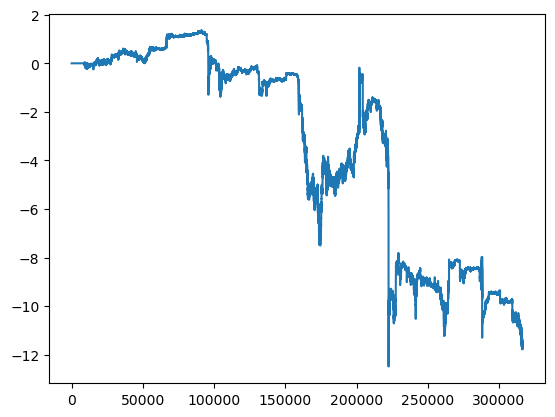

bnb_btc


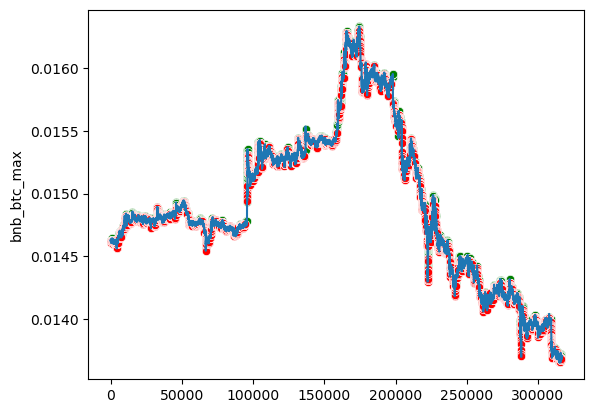

eth_btc


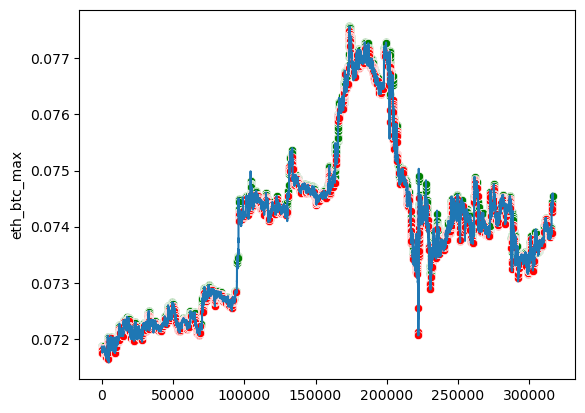

bnb_eth


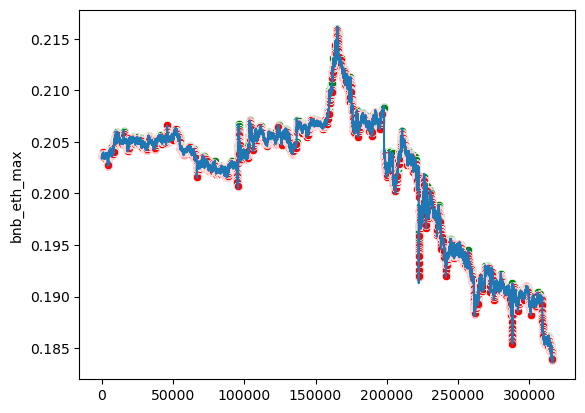

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 30, loss: 0.165
Traid counts: 43814 1: 5197 2: 7529 3: 2750 4: 8063 5: 9175 6: 11100
              precision    recall  f1-score   support

         0.0       1.00      0.86      0.93    315897
         1.0       0.01      0.40      0.02       127
         2.0       0.01      0.41      0.01       129
         3.0       0.01      0.24      0.01        71
         4.0       0.00      0.41      0.01        70
         5.0       0.01      0.60      0.02       126
         6.0       0.01      0.55      0.01       132

    accuracy                           0.86    316552
   macro avg       0.15      0.50      0.14    316552
weighted avg       1.00      0.86      0.92    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 371.95030800130877
Общая комиссия в usdt: 3.395351455104373
Число сделок: 184
Прибыль от 300 usdt за

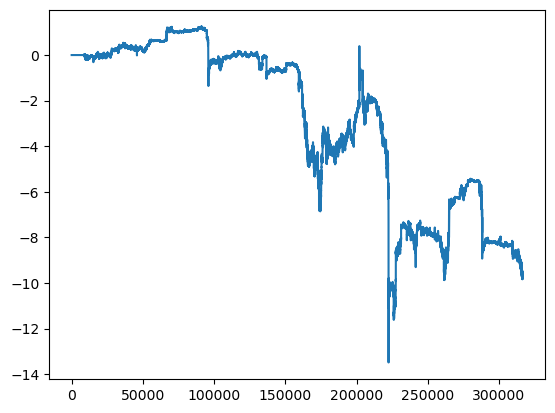

bnb_btc


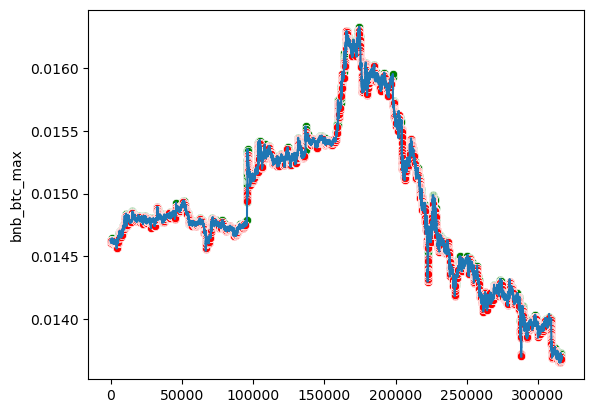

eth_btc


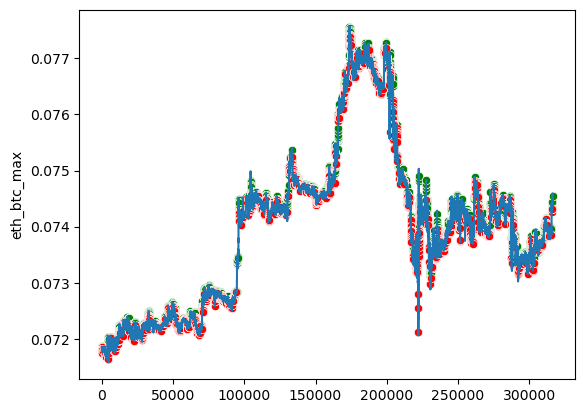

bnb_eth


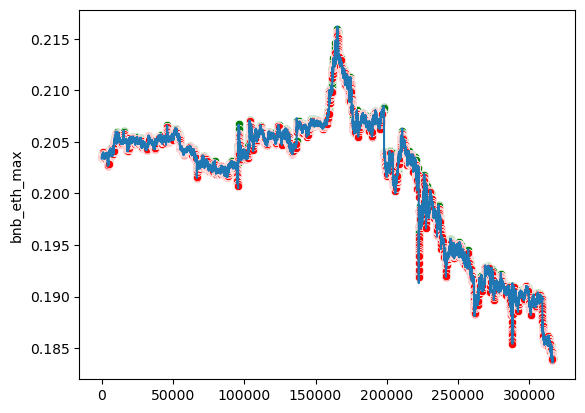

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 31, loss: 0.154
Traid counts: 43847 1: 5319 2: 7827 3: 2744 4: 7687 5: 8897 6: 11373
              precision    recall  f1-score   support

         0.0       1.00      0.86      0.93    315897
         1.0       0.01      0.38      0.02       127
         2.0       0.01      0.41      0.01       129
         3.0       0.01      0.23      0.01        71
         4.0       0.00      0.46      0.01        70
         5.0       0.01      0.54      0.02       126
         6.0       0.01      0.64      0.01       132

    accuracy                           0.86    316552
   macro avg       0.15      0.50      0.14    316552
weighted avg       1.00      0.86      0.92    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 369.26849534287703
Общая комиссия в usdt: 3.2202526641059284
Число сделок: 177
Прибыль от 300 usdt з

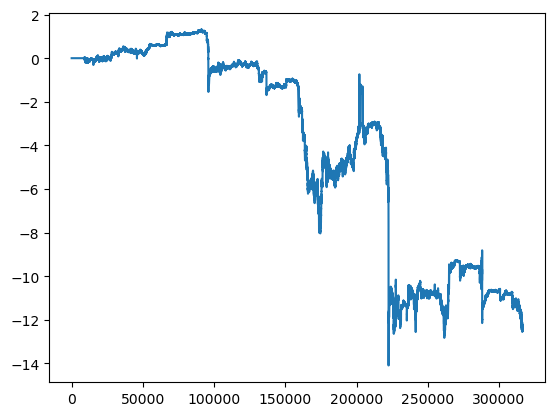

bnb_btc


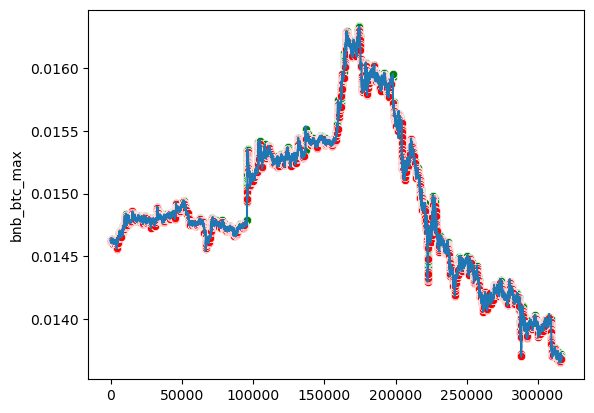

eth_btc


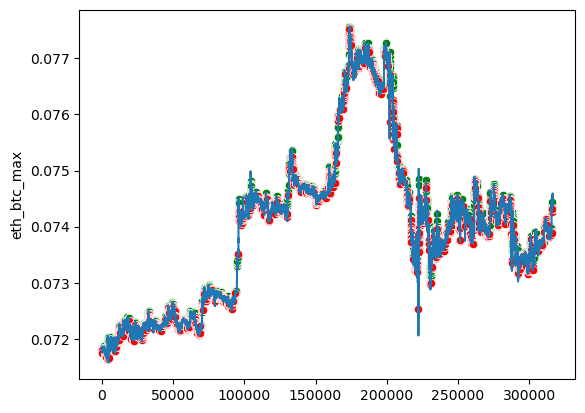

bnb_eth


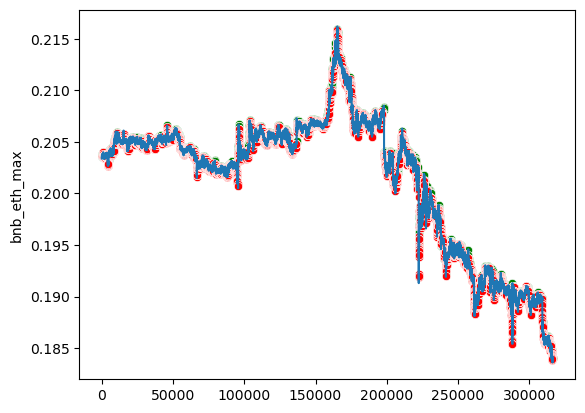

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 32, loss: 0.151
Traid counts: 42829 1: 6561 2: 6029 3: 2876 4: 7689 5: 8919 6: 10755
              precision    recall  f1-score   support

         0.0       1.00      0.87      0.93    315897
         1.0       0.01      0.37      0.01       127
         2.0       0.01      0.42      0.02       129
         3.0       0.00      0.14      0.01        71
         4.0       0.00      0.47      0.01        70
         5.0       0.01      0.54      0.02       126
         6.0       0.01      0.52      0.01       132

    accuracy                           0.86    316552
   macro avg       0.15      0.48      0.14    316552
weighted avg       1.00      0.86      0.93    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 370.50104025665456
Общая комиссия в usdt: 3.566340113382348
Число сделок: 204
Прибыль от 300 usdt за

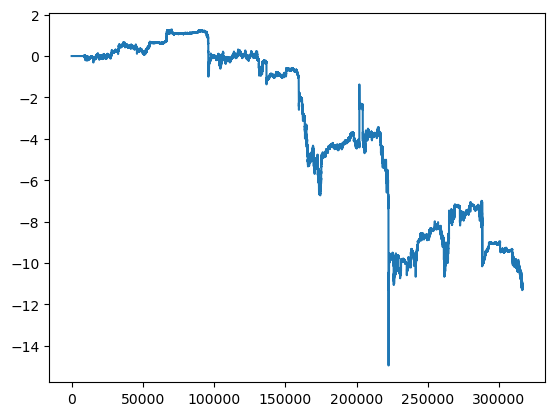

bnb_btc


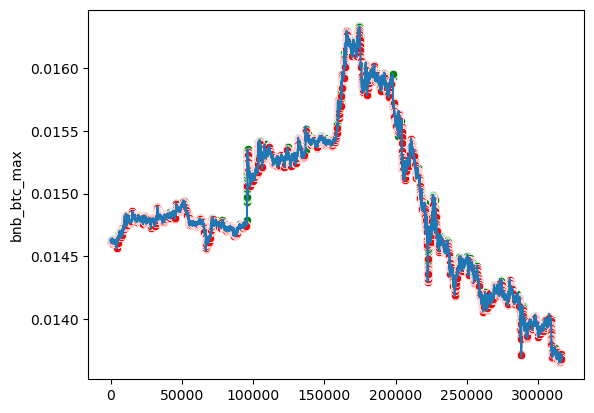

eth_btc


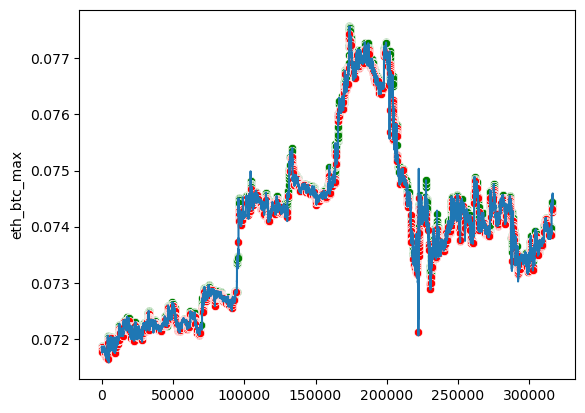

bnb_eth


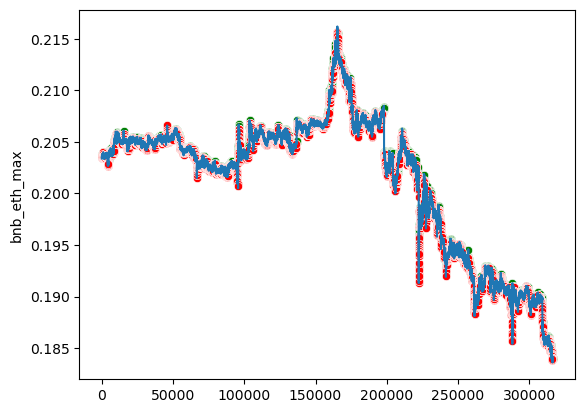

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 33, loss: 0.145
Traid counts: 40239 1: 6379 2: 5642 3: 2453 4: 7305 5: 8507 6: 9953
              precision    recall  f1-score   support

         0.0       1.00      0.87      0.93    315897
         1.0       0.01      0.41      0.02       127
         2.0       0.01      0.36      0.02       129
         3.0       0.00      0.13      0.01        71
         4.0       0.00      0.40      0.01        70
         5.0       0.01      0.54      0.02       126
         6.0       0.01      0.65      0.02       132

    accuracy                           0.87    316552
   macro avg       0.15      0.48      0.14    316552
weighted avg       1.00      0.87      0.93    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 364.1795690038073
Общая комиссия в usdt: 3.7462995439830284
Число сделок: 208
Прибыль от 300 usdt за 

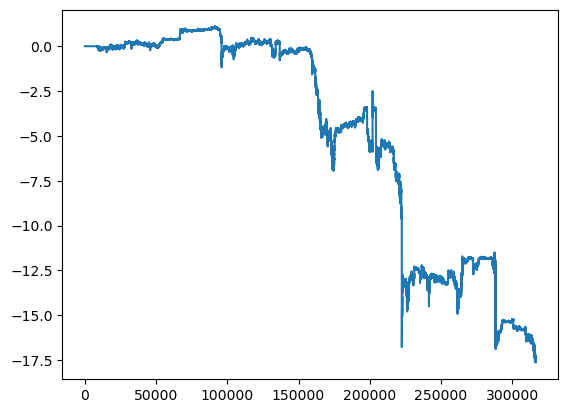

bnb_btc


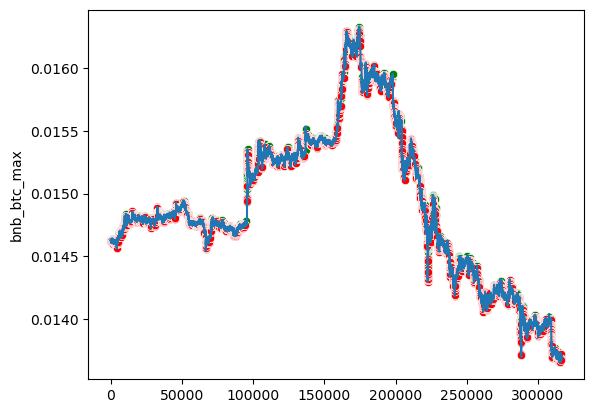

eth_btc


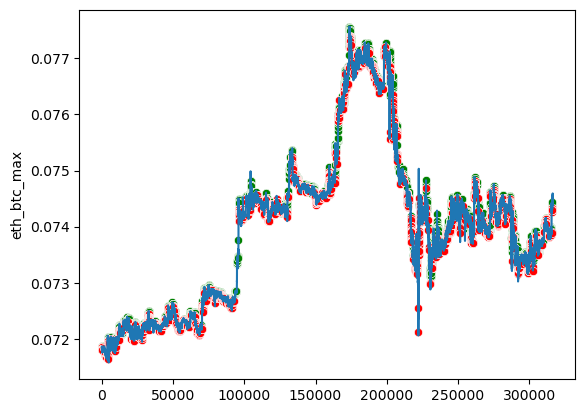

bnb_eth


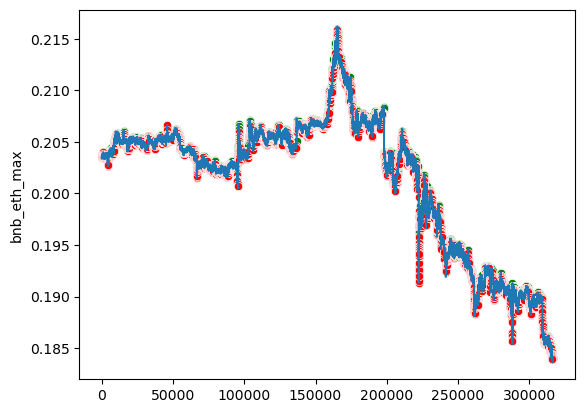

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 34, loss: 0.140
Traid counts: 43567 1: 6151 2: 6080 3: 2994 4: 8644 5: 8350 6: 11348
              precision    recall  f1-score   support

         0.0       1.00      0.86      0.93    315897
         1.0       0.01      0.38      0.02       127
         2.0       0.01      0.35      0.01       129
         3.0       0.00      0.18      0.01        71
         4.0       0.00      0.47      0.01        70
         5.0       0.01      0.50      0.01       126
         6.0       0.01      0.58      0.01       132

    accuracy                           0.86    316552
   macro avg       0.15      0.47      0.14    316552
weighted avg       1.00      0.86      0.92    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 369.1272652275727
Общая комиссия в usdt: 3.54892415193366
Число сделок: 197
Прибыль от 300 usdt за 1

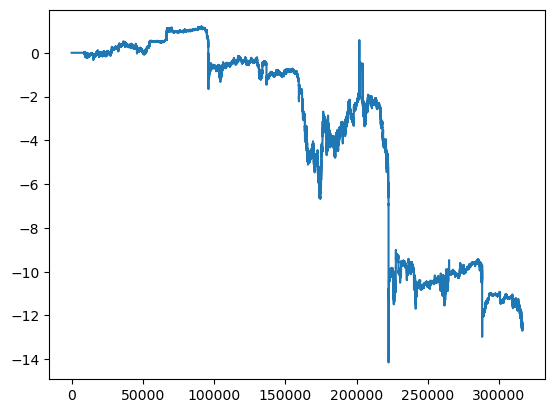

bnb_btc


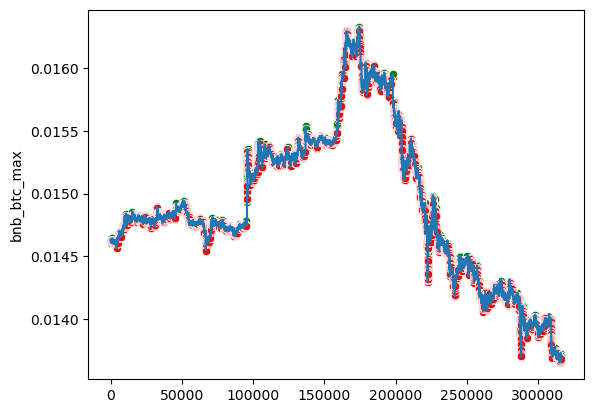

eth_btc


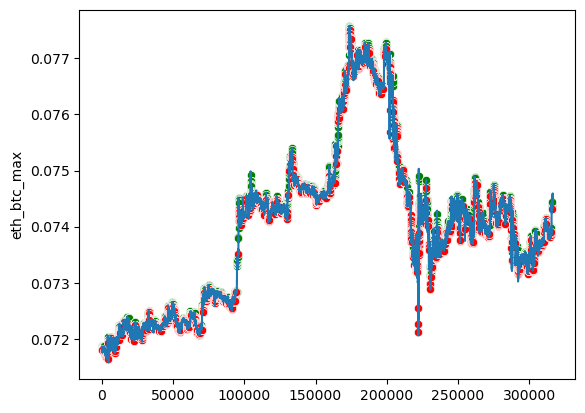

bnb_eth


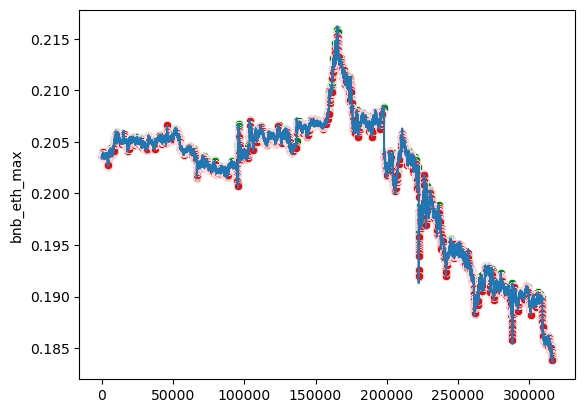

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 35, loss: 0.138
Traid counts: 38068 1: 4762 2: 5790 3: 2572 4: 6403 5: 7714 6: 10827
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.94    315897
         1.0       0.01      0.32      0.02       127
         2.0       0.01      0.33      0.01       129
         3.0       0.00      0.14      0.01        71
         4.0       0.00      0.34      0.01        70
         5.0       0.01      0.54      0.02       126
         6.0       0.01      0.65      0.02       132

    accuracy                           0.88    316552
   macro avg       0.15      0.46      0.15    316552
weighted avg       1.00      0.88      0.93    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 372.0251871047269
Общая комиссия в usdt: 3.4404060292081207
Число сделок: 185
Прибыль от 300 usdt за

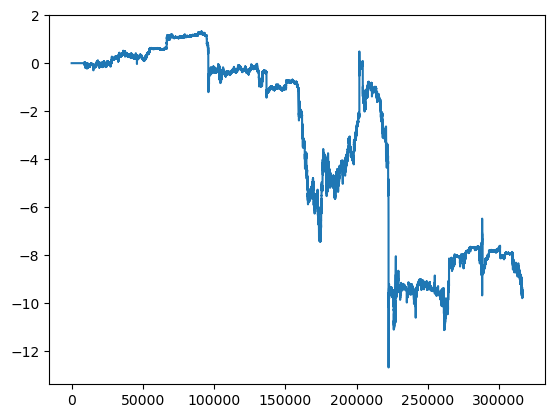

bnb_btc


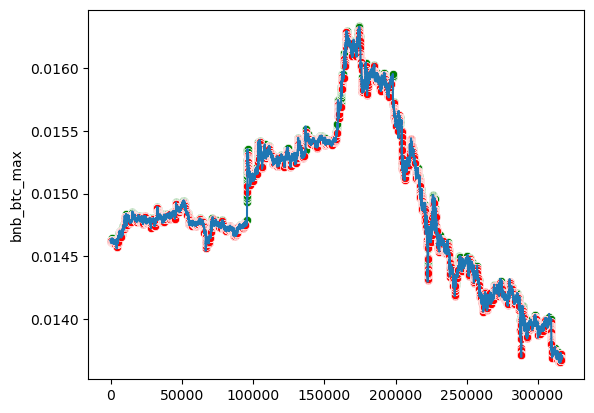

eth_btc


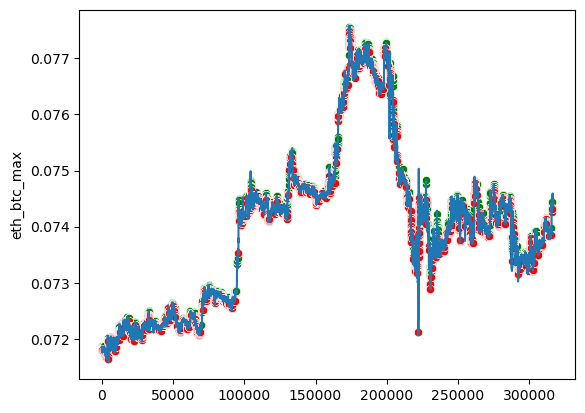

bnb_eth


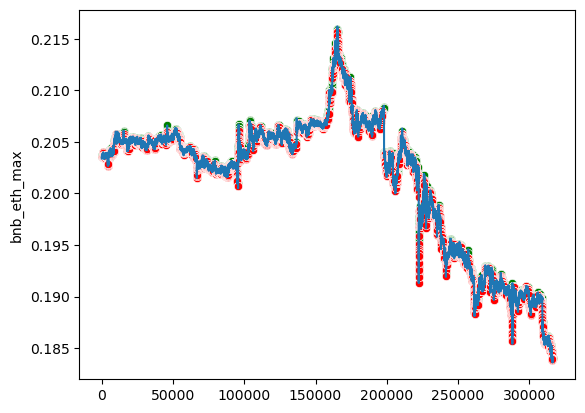

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 36, loss: 0.133
Traid counts: 41564 1: 6849 2: 5018 3: 3047 4: 8963 5: 6409 6: 11278
              precision    recall  f1-score   support

         0.0       1.00      0.87      0.93    315897
         1.0       0.01      0.44      0.02       127
         2.0       0.01      0.28      0.01       129
         3.0       0.00      0.20      0.01        71
         4.0       0.00      0.41      0.01        70
         5.0       0.01      0.47      0.02       126
         6.0       0.01      0.55      0.01       132

    accuracy                           0.87    316552
   macro avg       0.15      0.46      0.14    316552
weighted avg       1.00      0.87      0.93    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 370.275546511222
Общая комиссия в usdt: 3.471197792660386
Число сделок: 186
Прибыль от 300 usdt за 1

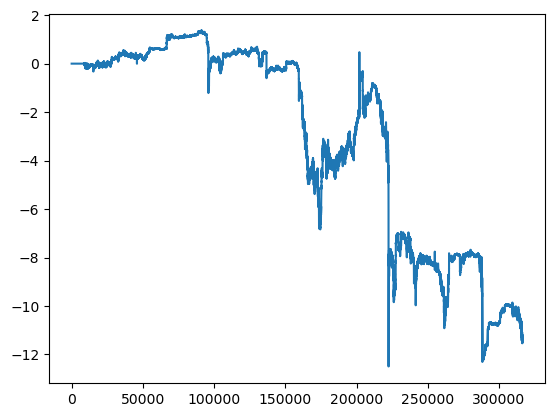

bnb_btc


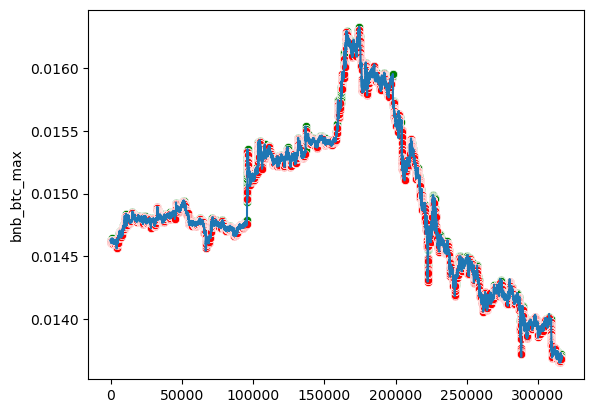

eth_btc


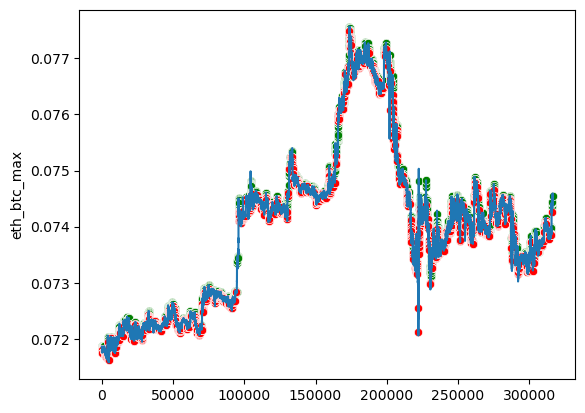

bnb_eth


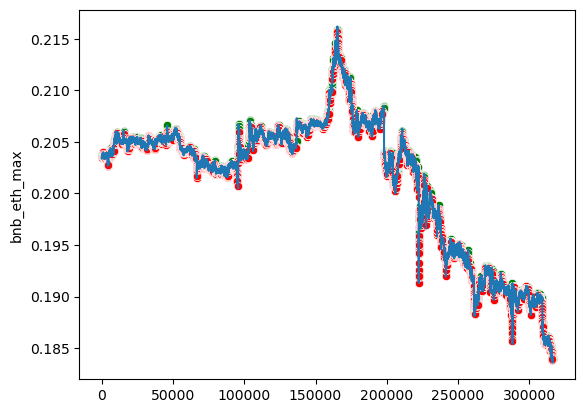

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 37, loss: 0.124
Traid counts: 43469 1: 7552 2: 5389 3: 2574 4: 8558 5: 7903 6: 11493
              precision    recall  f1-score   support

         0.0       1.00      0.86      0.93    315897
         1.0       0.01      0.44      0.01       127
         2.0       0.01      0.33      0.02       129
         3.0       0.00      0.15      0.01        71
         4.0       0.00      0.40      0.01        70
         5.0       0.01      0.49      0.02       126
         6.0       0.01      0.52      0.01       132

    accuracy                           0.86    316552
   macro avg       0.15      0.46      0.14    316552
weighted avg       1.00      0.86      0.92    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 366.29761384554354
Общая комиссия в usdt: 3.437831574657457
Число сделок: 195
Прибыль от 300 usdt за

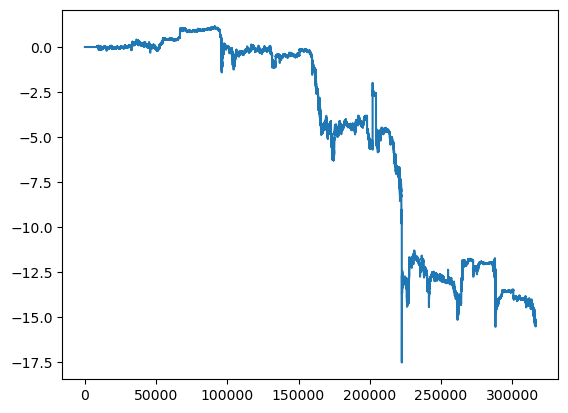

bnb_btc


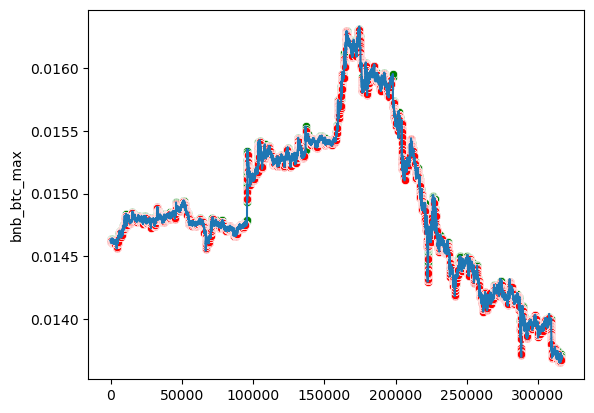

eth_btc


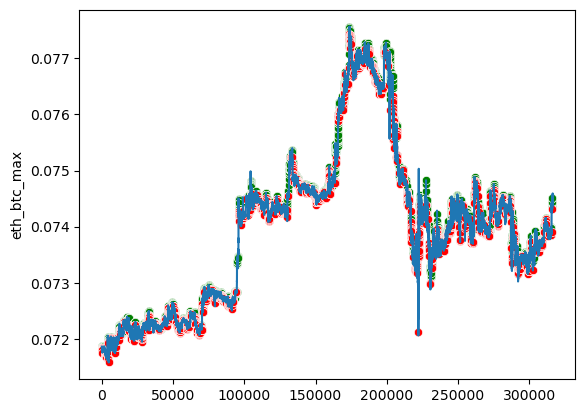

bnb_eth


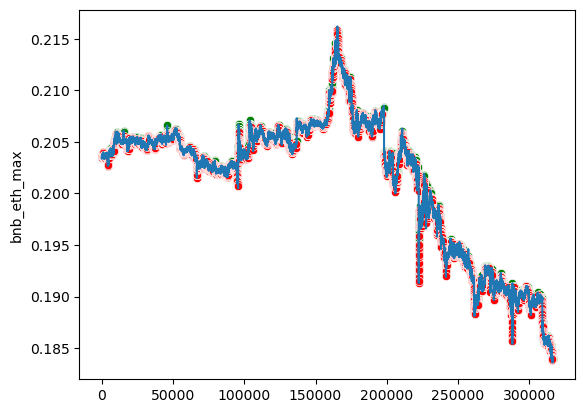

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 38, loss: 0.121
Traid counts: 39168 1: 7284 2: 4203 3: 2737 4: 6500 5: 7962 6: 10482
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.93    315897
         1.0       0.01      0.42      0.01       127
         2.0       0.01      0.32      0.02       129
         3.0       0.01      0.20      0.01        71
         4.0       0.00      0.43      0.01        70
         5.0       0.01      0.50      0.02       126
         6.0       0.01      0.58      0.01       132

    accuracy                           0.88    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.88      0.93    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 362.6715881922762
Общая комиссия в usdt: 3.47605770653156
Число сделок: 201
Прибыль от 300 usdt за 1

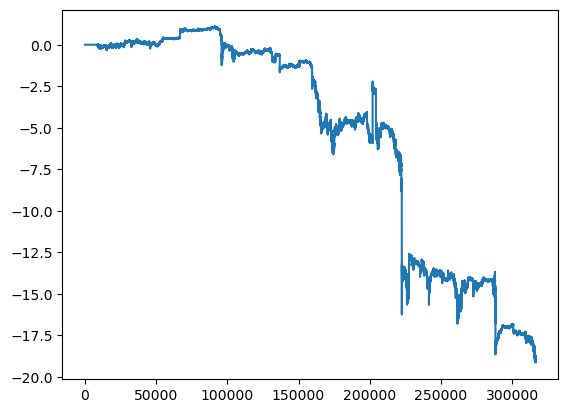

bnb_btc


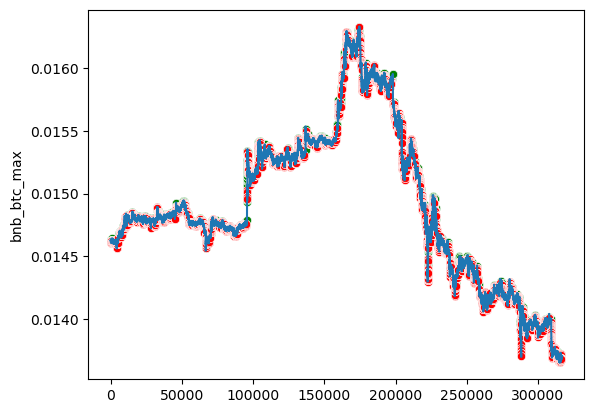

eth_btc


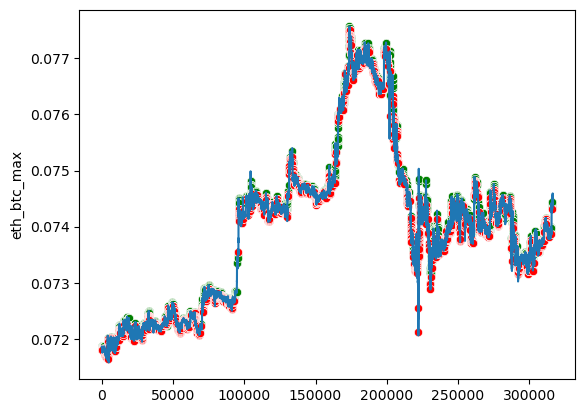

bnb_eth


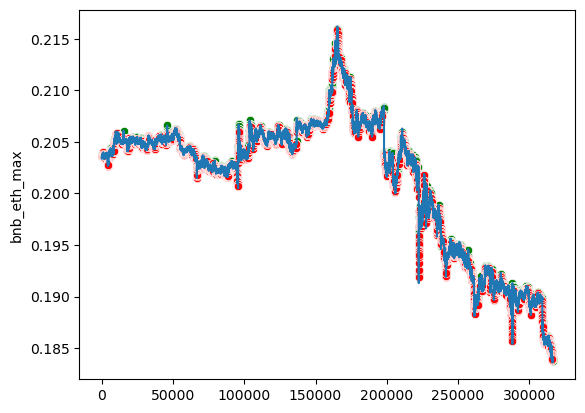

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 39, loss: 0.120
Traid counts: 43169 1: 7539 2: 4683 3: 2614 4: 7826 5: 8267 6: 12240
              precision    recall  f1-score   support

         0.0       1.00      0.86      0.93    315897
         1.0       0.01      0.45      0.01       127
         2.0       0.01      0.29      0.02       129
         3.0       0.01      0.20      0.01        71
         4.0       0.00      0.44      0.01        70
         5.0       0.01      0.51      0.02       126
         6.0       0.01      0.56      0.01       132

    accuracy                           0.86    316552
   macro avg       0.15      0.47      0.14    316552
weighted avg       1.00      0.86      0.93    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 373.7938788861233
Общая комиссия в usdt: 3.286753307782895
Число сделок: 181
Прибыль от 300 usdt за 

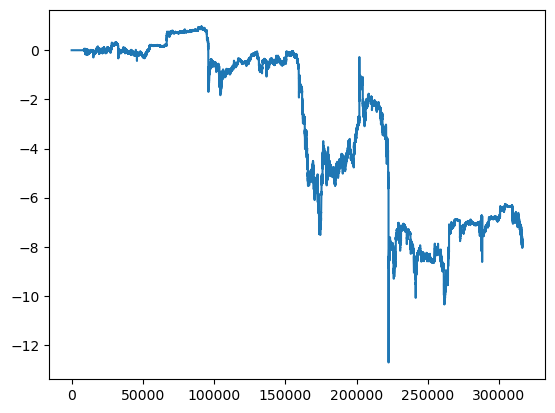

bnb_btc


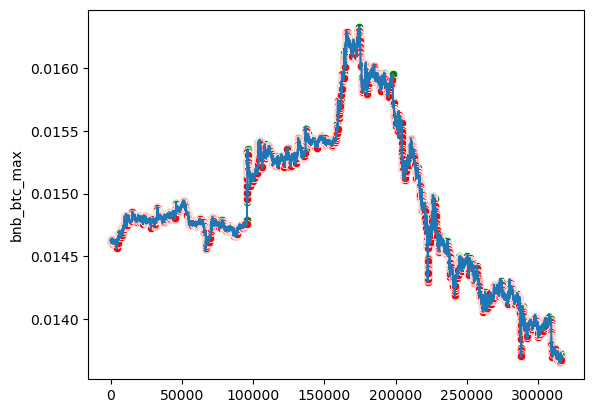

eth_btc


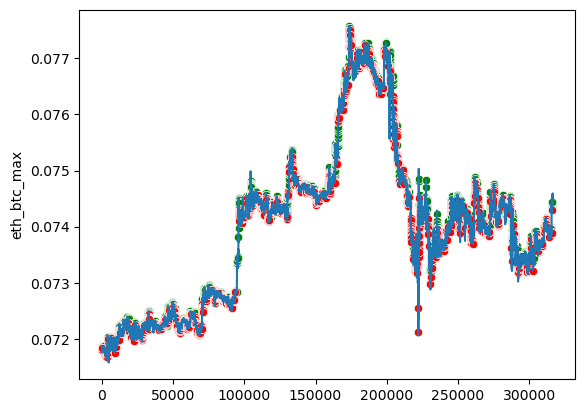

bnb_eth


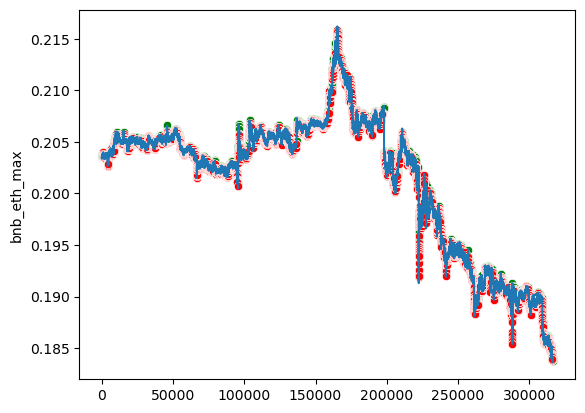

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 40, loss: 0.116
Traid counts: 40977 1: 7012 2: 3953 3: 3057 4: 7946 5: 8109 6: 10900
              precision    recall  f1-score   support

         0.0       1.00      0.87      0.93    315897
         1.0       0.01      0.44      0.02       127
         2.0       0.01      0.29      0.02       129
         3.0       0.00      0.15      0.01        71
         4.0       0.00      0.40      0.01        70
         5.0       0.01      0.53      0.02       126
         6.0       0.01      0.52      0.01       132

    accuracy                           0.87    316552
   macro avg       0.15      0.46      0.14    316552
weighted avg       1.00      0.87      0.93    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 371.7452827578745
Общая комиссия в usdt: 3.6687884929542562
Число сделок: 196
Прибыль от 300 usdt за

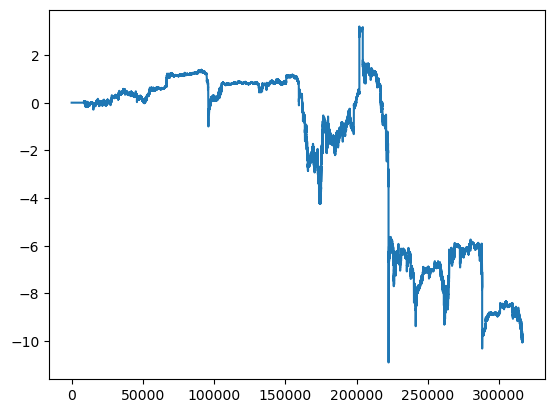

bnb_btc


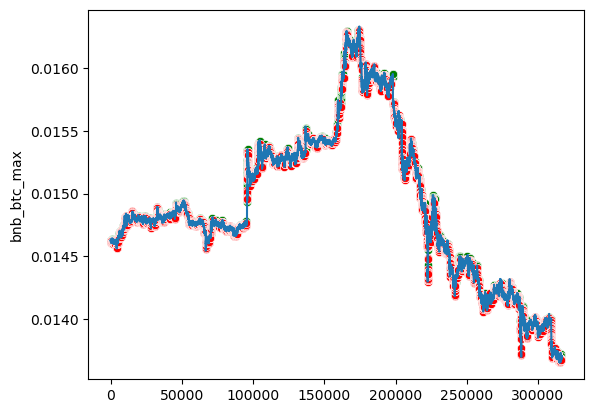

eth_btc


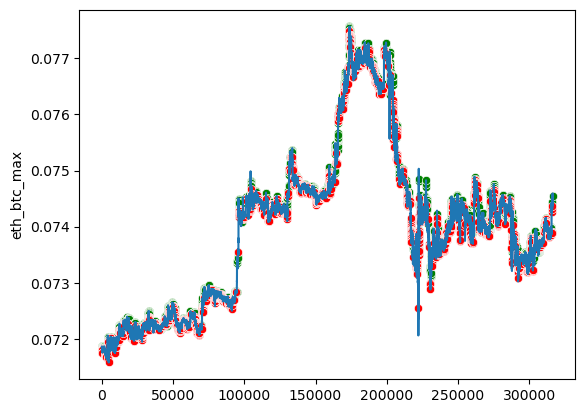

bnb_eth


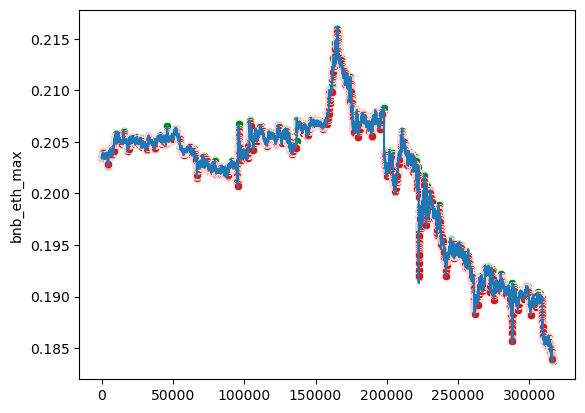

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 41, loss: 0.109
Traid counts: 41228 1: 6599 2: 3900 3: 2553 4: 7183 5: 7364 6: 13629
              precision    recall  f1-score   support

         0.0       1.00      0.87      0.93    315897
         1.0       0.01      0.41      0.02       127
         2.0       0.01      0.31      0.02       129
         3.0       0.00      0.15      0.01        71
         4.0       0.00      0.49      0.01        70
         5.0       0.01      0.52      0.02       126
         6.0       0.01      0.68      0.01       132

    accuracy                           0.87    316552
   macro avg       0.15      0.49      0.14    316552
weighted avg       1.00      0.87      0.93    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 367.89787761076775
Общая комиссия в usdt: 3.682554664764019
Число сделок: 207
Прибыль от 300 usdt за

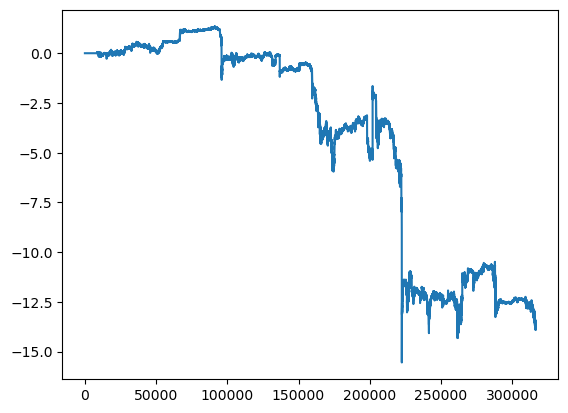

bnb_btc


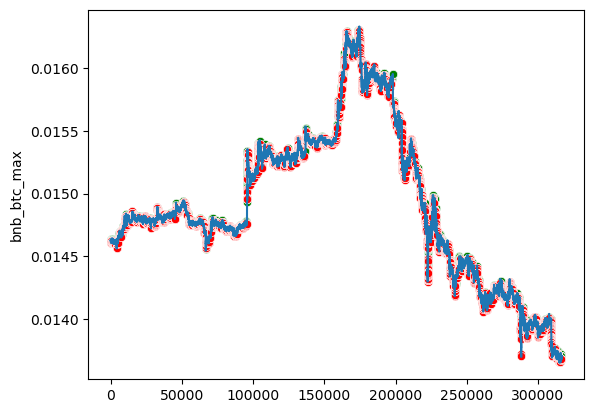

eth_btc


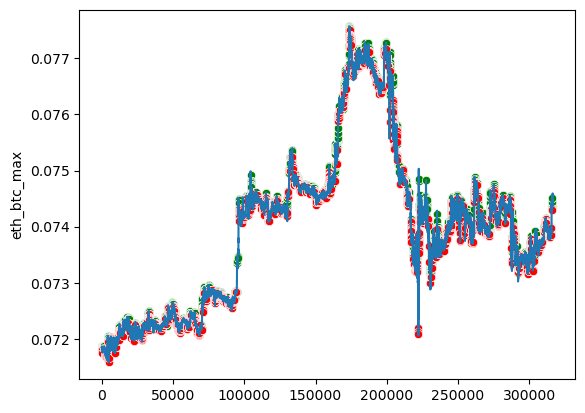

bnb_eth


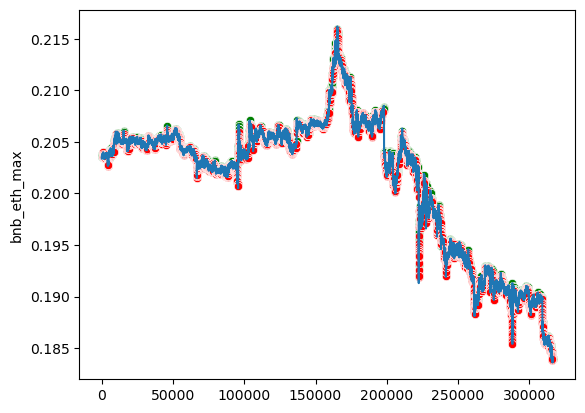

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 42, loss: 0.108
Traid counts: 38772 1: 5803 2: 4095 3: 2876 4: 6493 5: 7638 6: 11867
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.93    315897
         1.0       0.01      0.35      0.01       127
         2.0       0.01      0.34      0.02       129
         3.0       0.01      0.23      0.01        71
         4.0       0.00      0.39      0.01        70
         5.0       0.01      0.55      0.02       126
         6.0       0.01      0.61      0.01       132

    accuracy                           0.88    316552
   macro avg       0.15      0.48      0.15    316552
weighted avg       1.00      0.88      0.93    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 372.2775972330148
Общая комиссия в usdt: 3.399777122133166
Число сделок: 187
Прибыль от 300 usdt за 

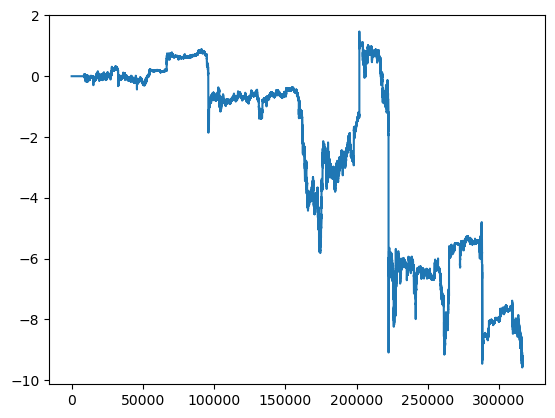

bnb_btc


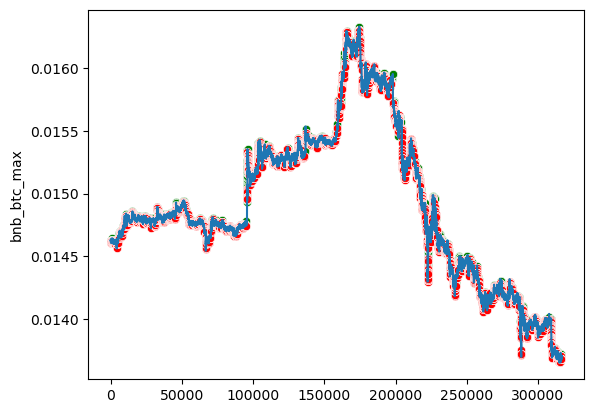

eth_btc


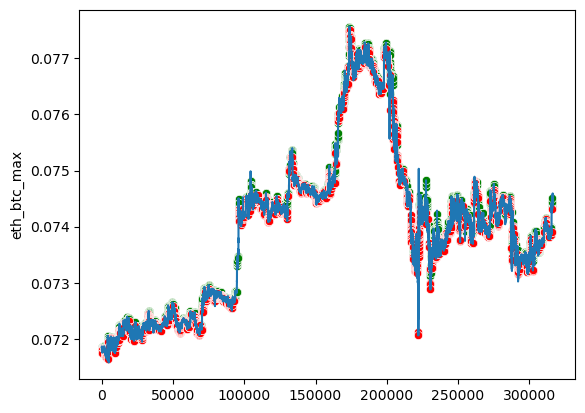

bnb_eth


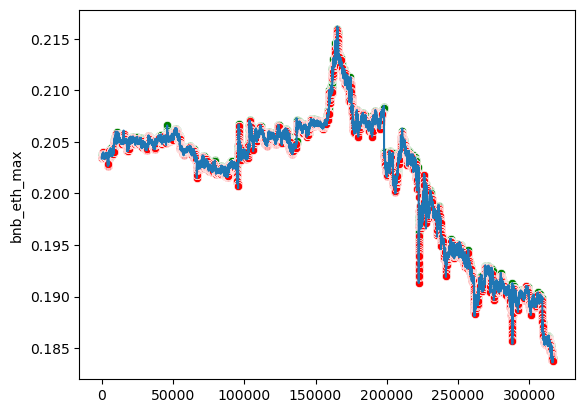

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 43, loss: 0.107
Traid counts: 38968 1: 6258 2: 4604 3: 3171 4: 5349 5: 7215 6: 12371
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.93    315897
         1.0       0.01      0.46      0.02       127
         2.0       0.01      0.32      0.02       129
         3.0       0.00      0.20      0.01        71
         4.0       0.00      0.36      0.01        70
         5.0       0.01      0.56      0.02       126
         6.0       0.01      0.63      0.01       132

    accuracy                           0.88    316552
   macro avg       0.15      0.48      0.15    316552
weighted avg       1.00      0.88      0.93    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 371.7803556905088
Общая комиссия в usdt: 3.4981366404501775
Число сделок: 193
Прибыль от 300 usdt за

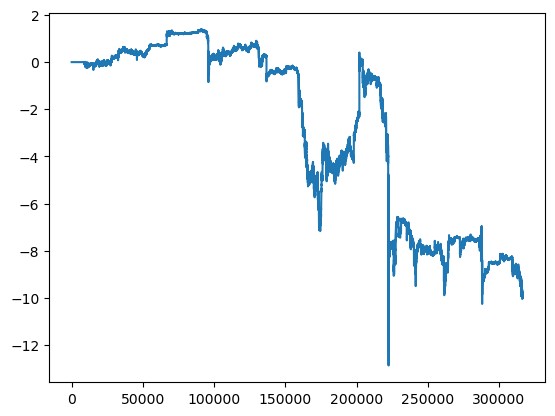

bnb_btc


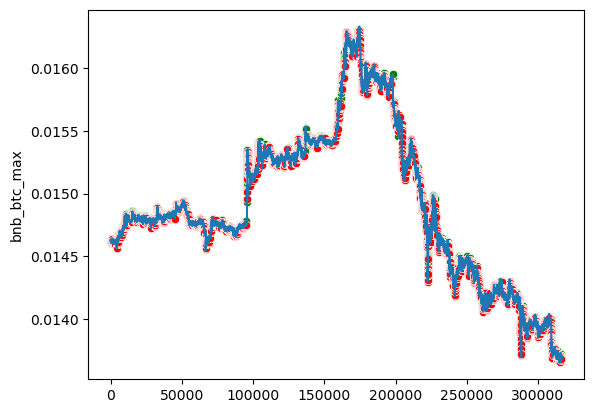

eth_btc


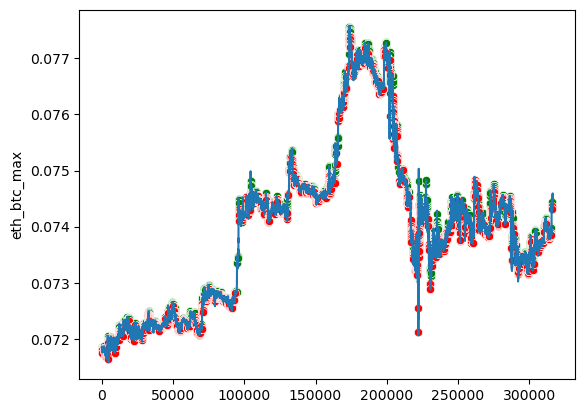

bnb_eth


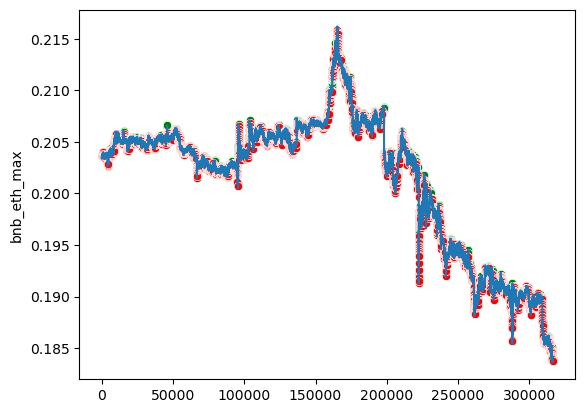

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 44, loss: 0.104
Traid counts: 36180 1: 5363 2: 3874 3: 2727 4: 5561 5: 7636 6: 11019
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    315897
         1.0       0.01      0.34      0.02       127
         2.0       0.01      0.27      0.02       129
         3.0       0.01      0.32      0.02        71
         4.0       0.01      0.40      0.01        70
         5.0       0.01      0.56      0.02       126
         6.0       0.01      0.62      0.01       132

    accuracy                           0.89    316552
   macro avg       0.15      0.49      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 369.24967852730583
Общая комиссия в usdt: 3.593417805498965
Число сделок: 204
Прибыль от 300 usdt за

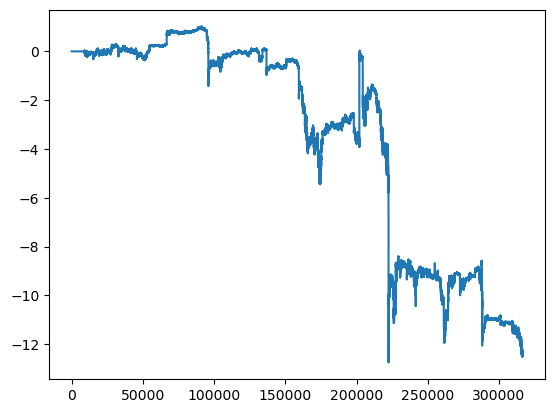

bnb_btc


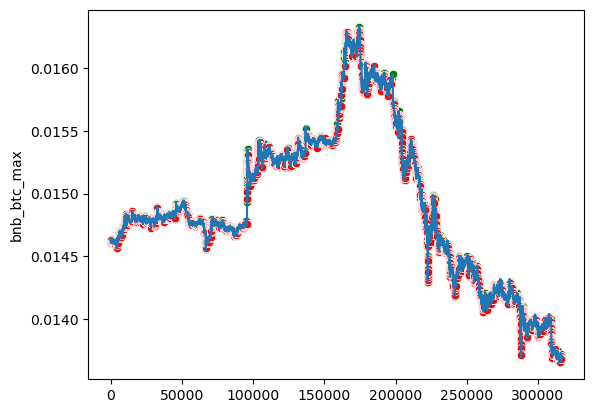

eth_btc


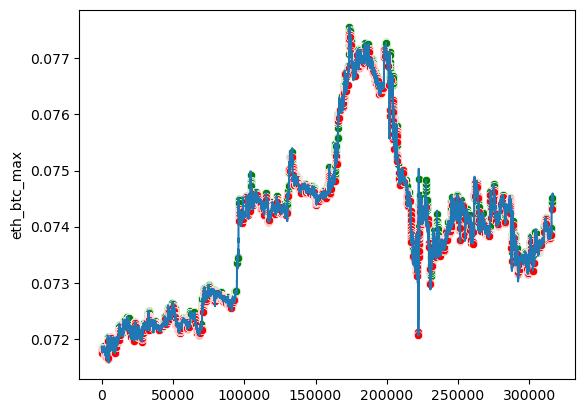

bnb_eth


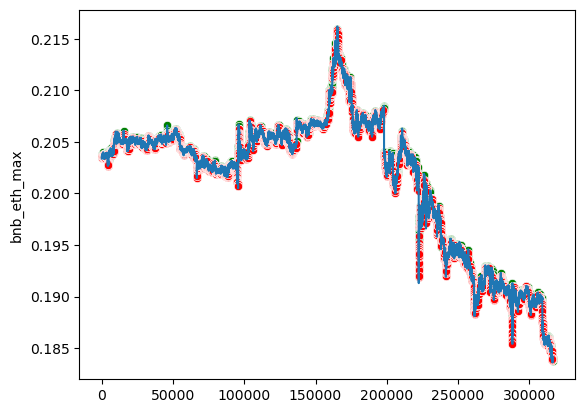

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 45, loss: 0.099
Traid counts: 38569 1: 5424 2: 4545 3: 2508 4: 7357 5: 6375 6: 12360
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.94    315897
         1.0       0.01      0.42      0.02       127
         2.0       0.01      0.29      0.02       129
         3.0       0.01      0.23      0.01        71
         4.0       0.01      0.54      0.01        70
         5.0       0.01      0.48      0.02       126
         6.0       0.01      0.63      0.01       132

    accuracy                           0.88    316552
   macro avg       0.15      0.49      0.15    316552
weighted avg       1.00      0.88      0.93    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 373.21712143061063
Общая комиссия в usdt: 3.8063138703847703
Число сделок: 204
Прибыль от 300 usdt з

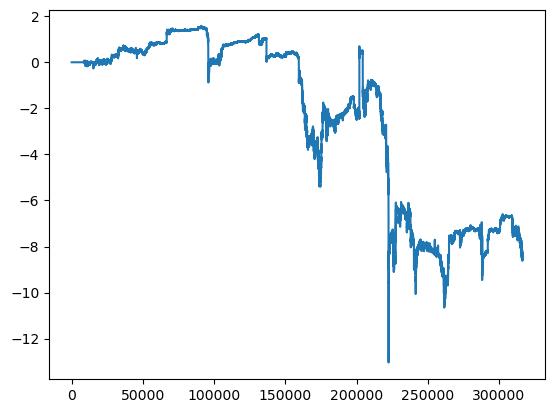

bnb_btc


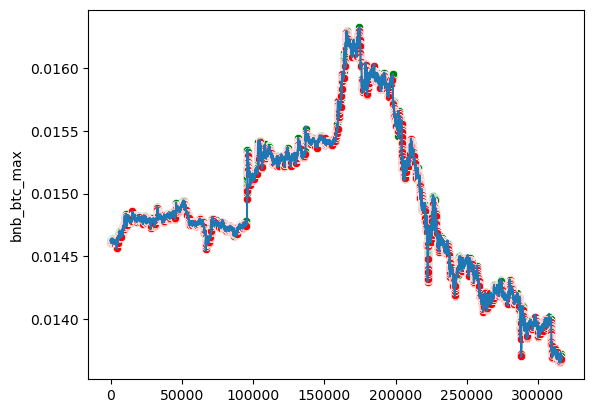

eth_btc


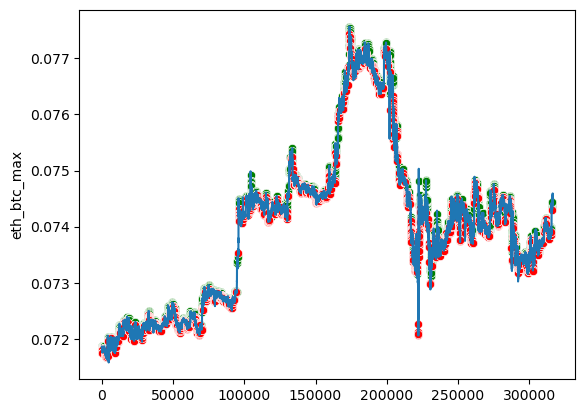

bnb_eth


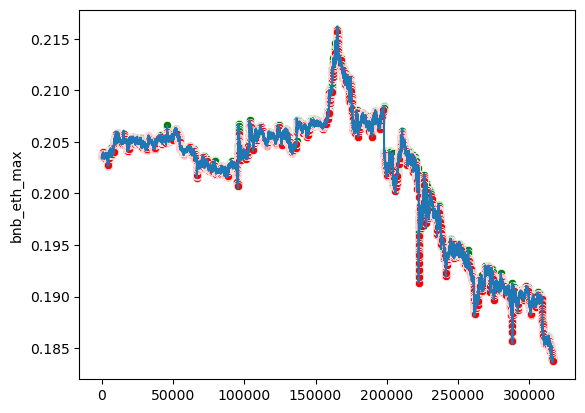

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 46, loss: 0.094
Traid counts: 39122 1: 5577 2: 5109 3: 2652 4: 7214 5: 6687 6: 11883
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.93    315897
         1.0       0.01      0.47      0.02       127
         2.0       0.01      0.29      0.01       129
         3.0       0.01      0.20      0.01        71
         4.0       0.00      0.43      0.01        70
         5.0       0.01      0.49      0.02       126
         6.0       0.01      0.61      0.01       132

    accuracy                           0.88    316552
   macro avg       0.15      0.48      0.15    316552
weighted avg       1.00      0.88      0.93    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 376.61316790906596
Общая комиссия в usdt: 3.5913370470614305
Число сделок: 192
Прибыль от 300 usdt з

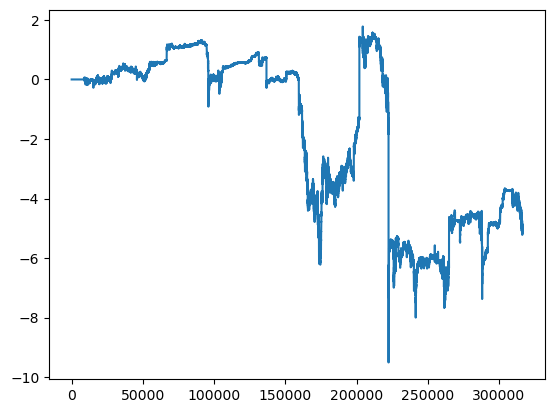

bnb_btc


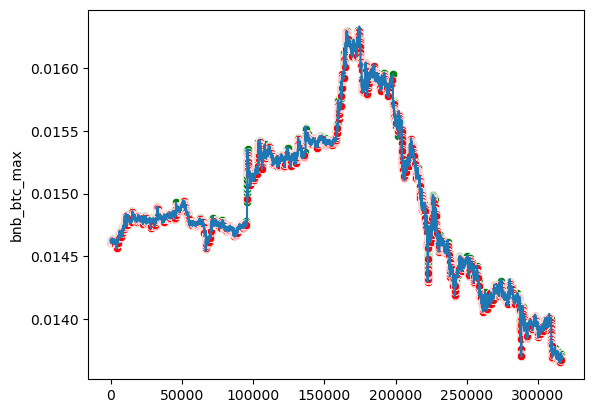

eth_btc


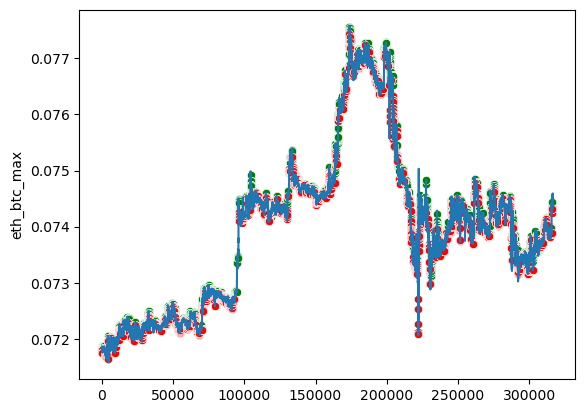

bnb_eth


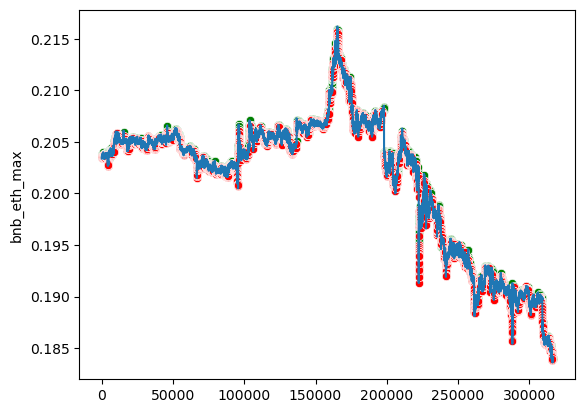

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 47, loss: 0.094
Traid counts: 37721 1: 4915 2: 4661 3: 3114 4: 6869 5: 6943 6: 11219
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.94    315897
         1.0       0.01      0.36      0.02       127
         2.0       0.01      0.29      0.02       129
         3.0       0.00      0.21      0.01        71
         4.0       0.00      0.44      0.01        70
         5.0       0.01      0.48      0.02       126
         6.0       0.01      0.58      0.01       132

    accuracy                           0.88    316552
   macro avg       0.15      0.46      0.15    316552
weighted avg       1.00      0.88      0.93    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 369.98796233210675
Общая комиссия в usdt: 3.568373379250726
Число сделок: 204
Прибыль от 300 usdt за

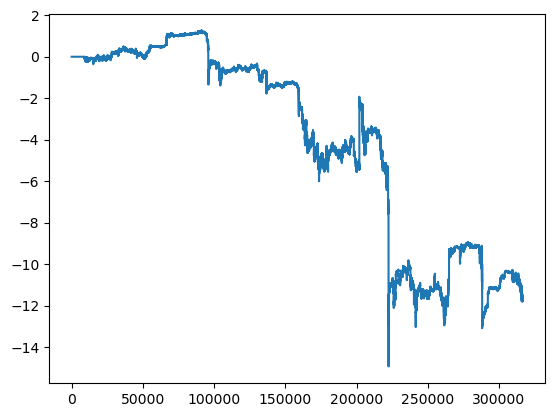

bnb_btc


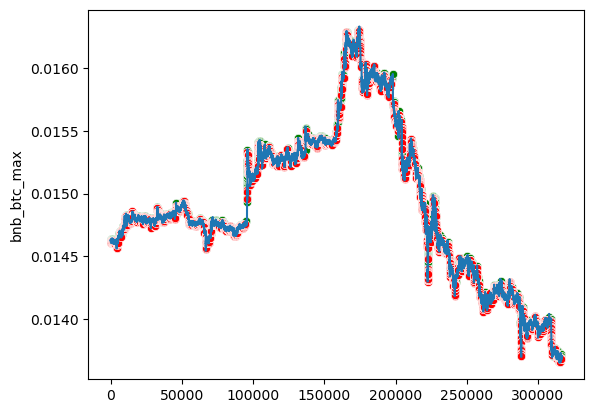

eth_btc


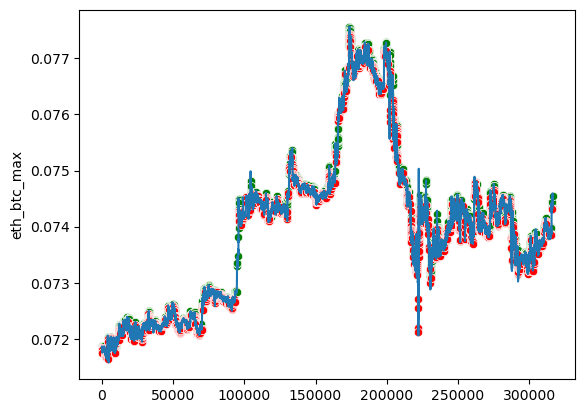

bnb_eth


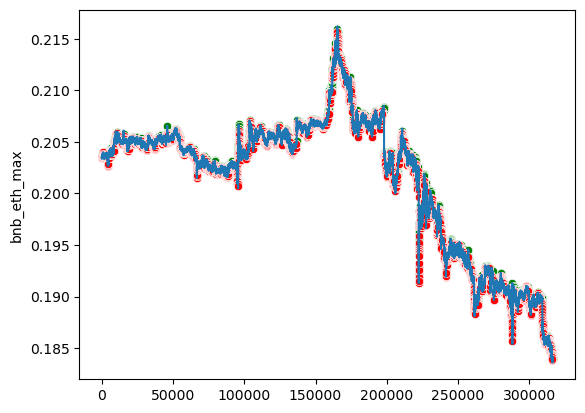

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 48, loss: 0.092
Traid counts: 39323 1: 5711 2: 5404 3: 2701 4: 6577 5: 6777 6: 12153
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.93    315897
         1.0       0.01      0.39      0.02       127
         2.0       0.01      0.33      0.02       129
         3.0       0.00      0.18      0.01        71
         4.0       0.00      0.39      0.01        70
         5.0       0.01      0.48      0.02       126
         6.0       0.01      0.62      0.01       132

    accuracy                           0.88    316552
   macro avg       0.15      0.47      0.14    316552
weighted avg       1.00      0.88      0.93    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 375.5665704169678
Общая комиссия в usdt: 3.3000820538649616
Число сделок: 181
Прибыль от 300 usdt за

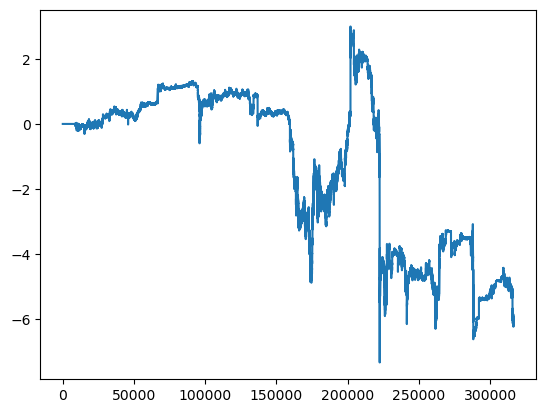

bnb_btc


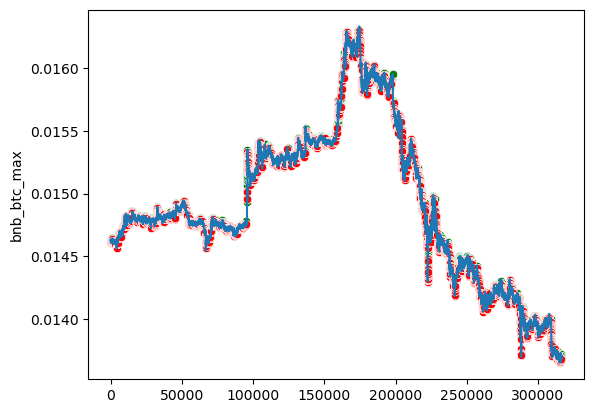

eth_btc


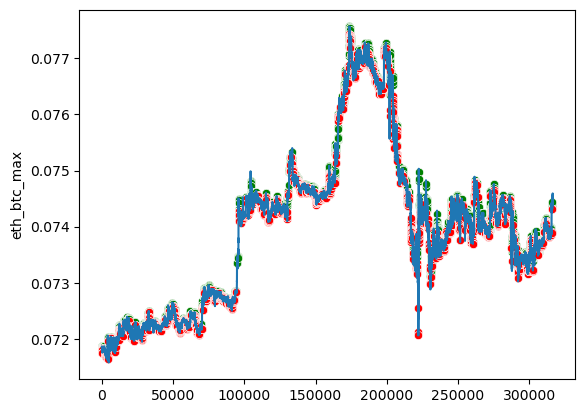

bnb_eth


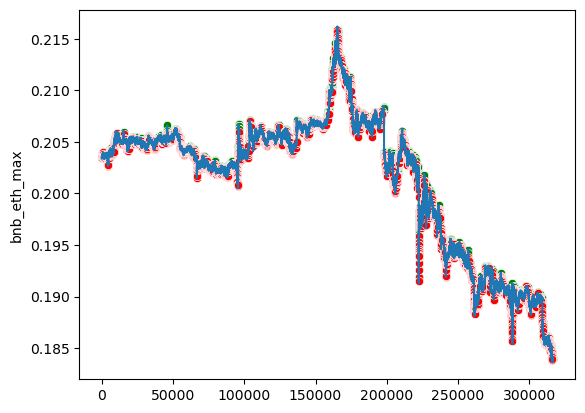

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 49, loss: 0.090
Traid counts: 38608 1: 5397 2: 5360 3: 2402 4: 7035 5: 7871 6: 10543
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.94    315897
         1.0       0.01      0.41      0.02       127
         2.0       0.01      0.29      0.01       129
         3.0       0.00      0.14      0.01        71
         4.0       0.00      0.37      0.01        70
         5.0       0.01      0.55      0.02       126
         6.0       0.01      0.48      0.01       132

    accuracy                           0.88    316552
   macro avg       0.15      0.44      0.14    316552
weighted avg       1.00      0.88      0.93    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 368.71540239058726
Общая комиссия в usdt: 3.35685488085197
Число сделок: 184
Прибыль от 300 usdt за 

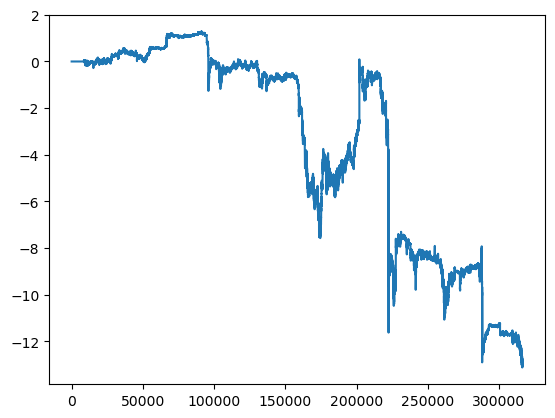

bnb_btc


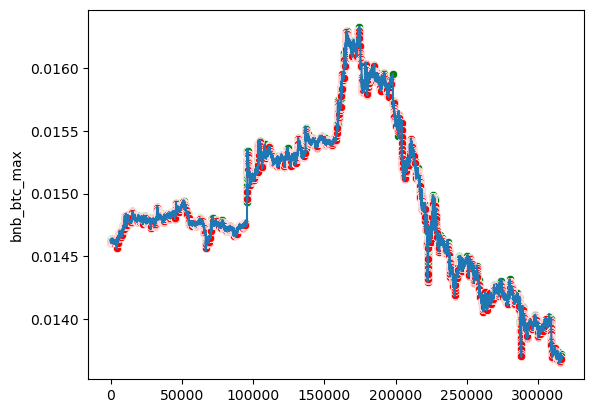

eth_btc


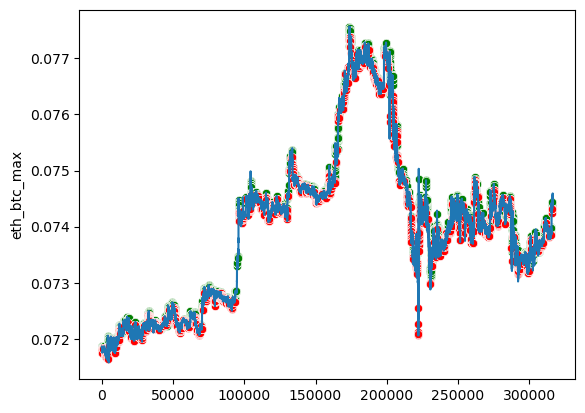

bnb_eth


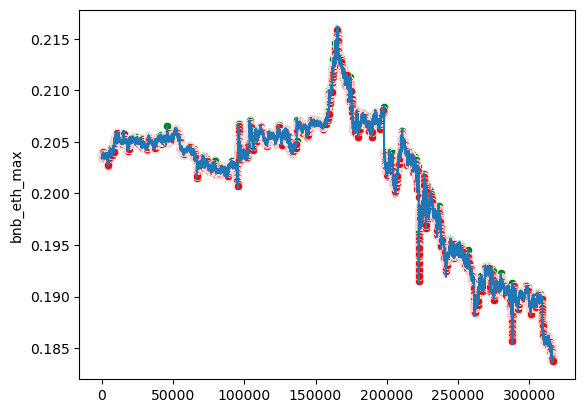

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 50, loss: 0.085
Traid counts: 38322 1: 5989 2: 5328 3: 2739 4: 6079 5: 7801 6: 10386
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.94    315897
         1.0       0.01      0.43      0.02       127
         2.0       0.01      0.31      0.01       129
         3.0       0.00      0.18      0.01        71
         4.0       0.00      0.39      0.01        70
         5.0       0.01      0.56      0.02       126
         6.0       0.01      0.55      0.01       132

    accuracy                           0.88    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.88      0.93    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 371.2297351146477
Общая комиссия в usdt: 3.5629993306149204
Число сделок: 195
Прибыль от 300 usdt за

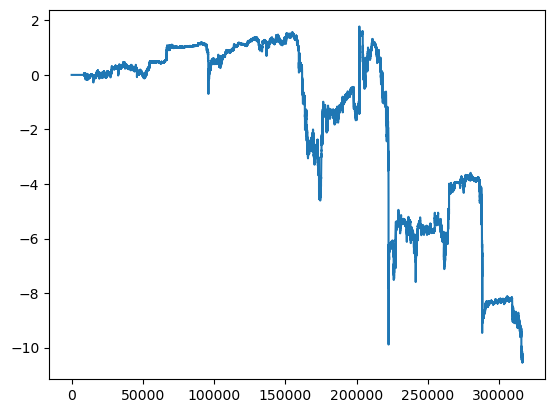

bnb_btc


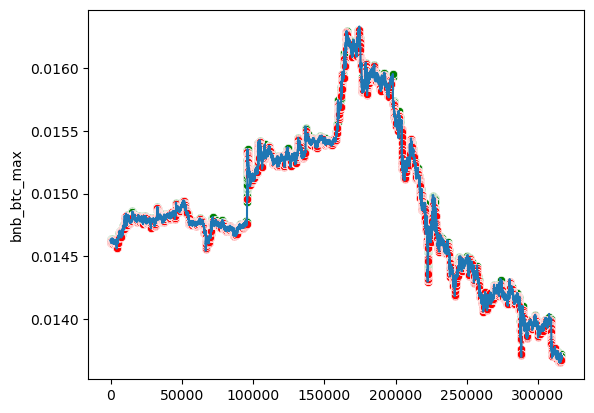

eth_btc


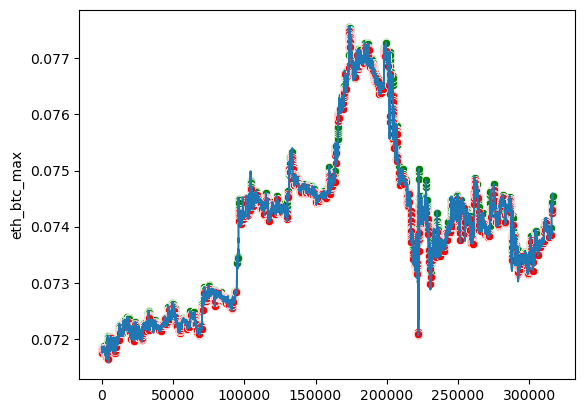

bnb_eth


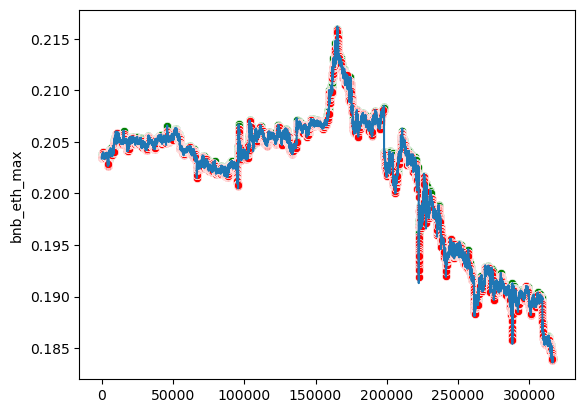

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 51, loss: 0.083
Traid counts: 37496 1: 5569 2: 5562 3: 2810 4: 6398 5: 7759 6: 9398
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.94    315897
         1.0       0.01      0.33      0.01       127
         2.0       0.01      0.34      0.02       129
         3.0       0.01      0.24      0.01        71
         4.0       0.00      0.40      0.01        70
         5.0       0.01      0.54      0.02       126
         6.0       0.01      0.50      0.01       132

    accuracy                           0.88    316552
   macro avg       0.15      0.46      0.15    316552
weighted avg       1.00      0.88      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 368.3795229680056
Общая комиссия в usdt: 3.420001312392795
Число сделок: 196
Прибыль от 300 usdt за 1

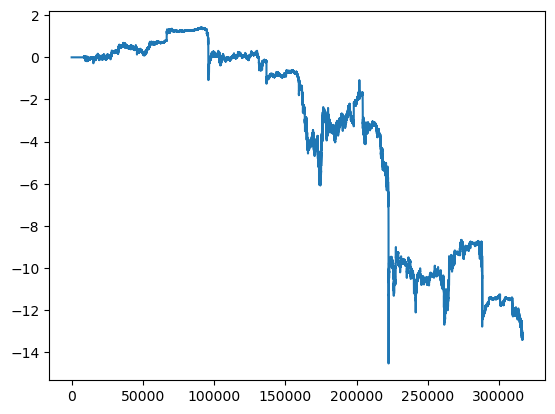

bnb_btc


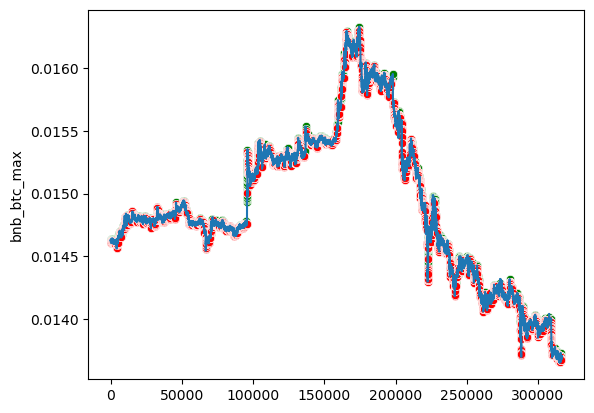

eth_btc


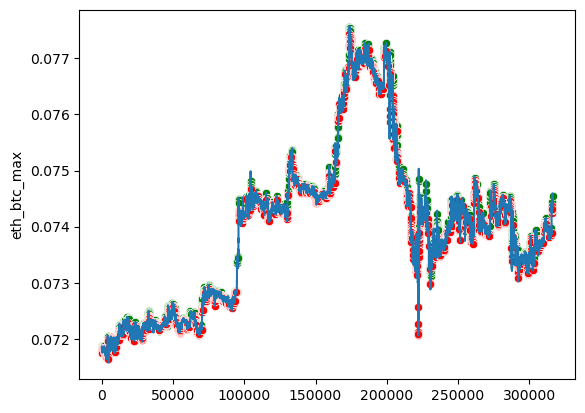

bnb_eth


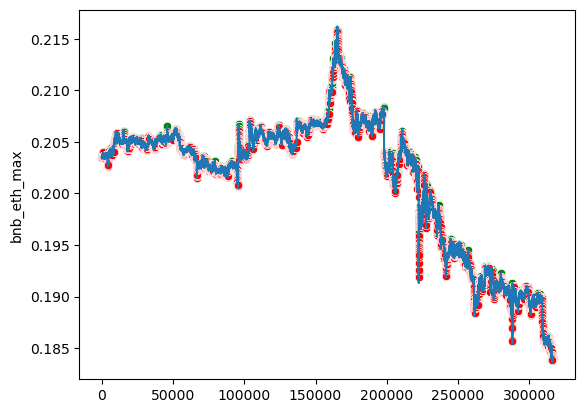

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 52, loss: 0.085
Traid counts: 37180 1: 5304 2: 5505 3: 2799 4: 5956 5: 7967 6: 9649
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.94    315897
         1.0       0.01      0.35      0.02       127
         2.0       0.01      0.32      0.01       129
         3.0       0.01      0.28      0.01        71
         4.0       0.01      0.43      0.01        70
         5.0       0.01      0.53      0.02       126
         6.0       0.01      0.61      0.02       132

    accuracy                           0.88    316552
   macro avg       0.15      0.49      0.15    316552
weighted avg       1.00      0.88      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 367.92410204961936
Общая комиссия в usdt: 3.6786476203703318
Число сделок: 211
Прибыль от 300 usdt за

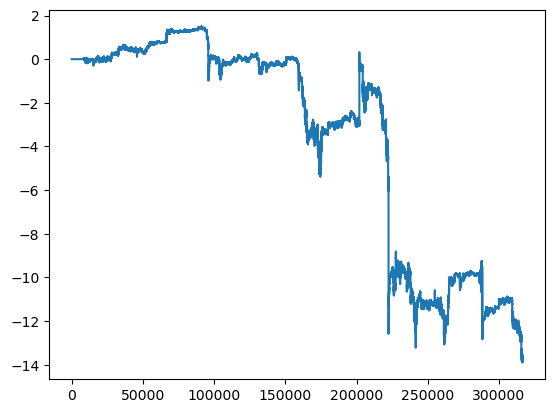

bnb_btc


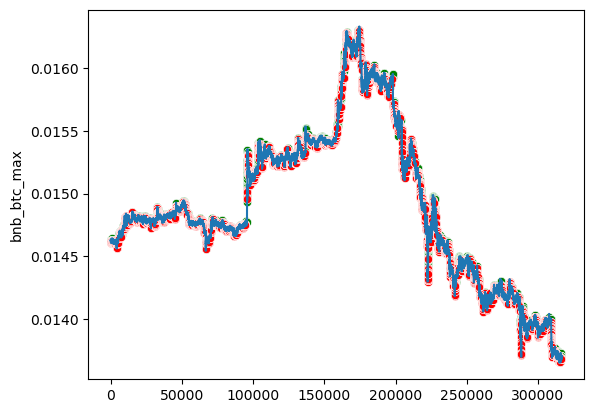

eth_btc


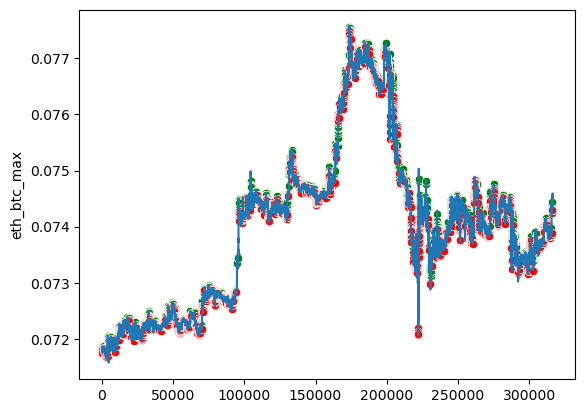

bnb_eth


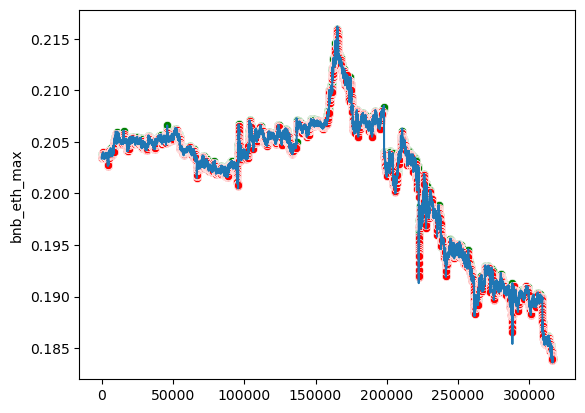

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 53, loss: 0.079
Traid counts: 37195 1: 6635 2: 5247 3: 2502 4: 5686 5: 8082 6: 9043
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.94    315897
         1.0       0.01      0.43      0.02       127
         2.0       0.01      0.37      0.02       129
         3.0       0.01      0.25      0.01        71
         4.0       0.01      0.47      0.01        70
         5.0       0.01      0.46      0.01       126
         6.0       0.01      0.52      0.02       132

    accuracy                           0.88    316552
   macro avg       0.15      0.49      0.15    316552
weighted avg       1.00      0.88      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 374.7160714954321
Общая комиссия в usdt: 3.864830135615146
Число сделок: 211
Прибыль от 300 usdt за 1

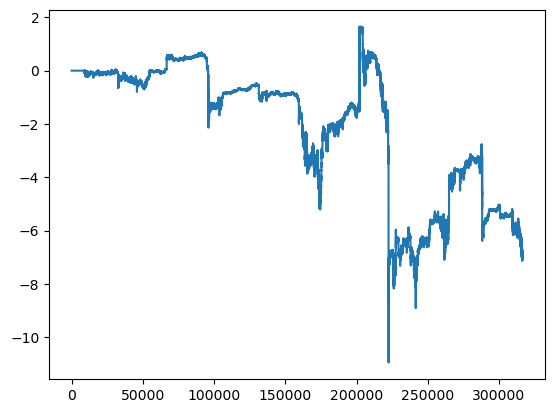

bnb_btc


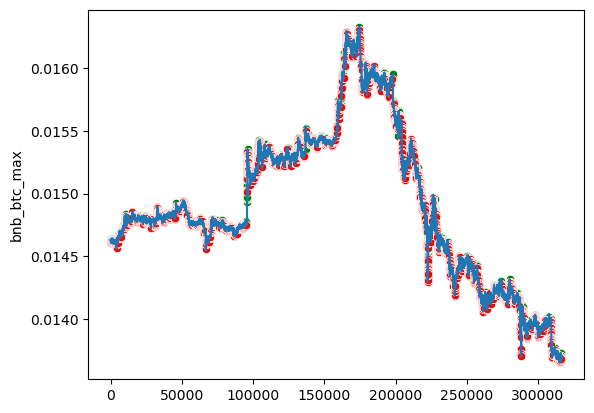

eth_btc


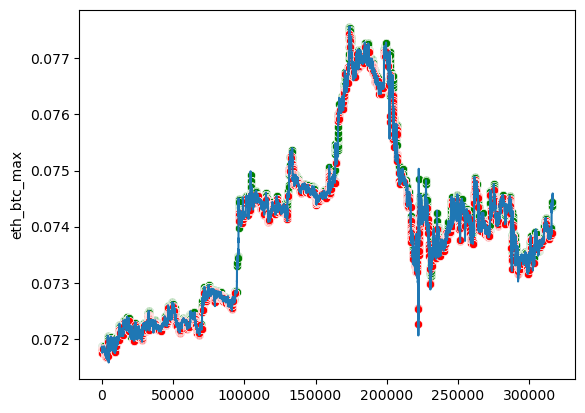

bnb_eth


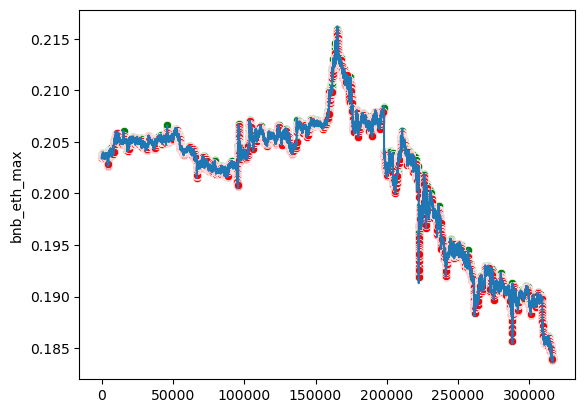

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 54, loss: 0.077
Traid counts: 37182 1: 5289 2: 5821 3: 2785 4: 6148 5: 8417 6: 8722
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.94    315897
         1.0       0.01      0.35      0.02       127
         2.0       0.01      0.34      0.01       129
         3.0       0.01      0.24      0.01        71
         4.0       0.00      0.39      0.01        70
         5.0       0.01      0.53      0.02       126
         6.0       0.01      0.52      0.02       132

    accuracy                           0.88    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.88      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 370.42225587755786
Общая комиссия в usdt: 3.7824324910636435
Число сделок: 208
Прибыль от 300 usdt за

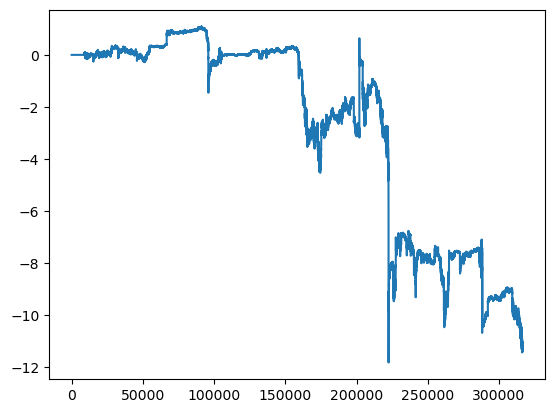

bnb_btc


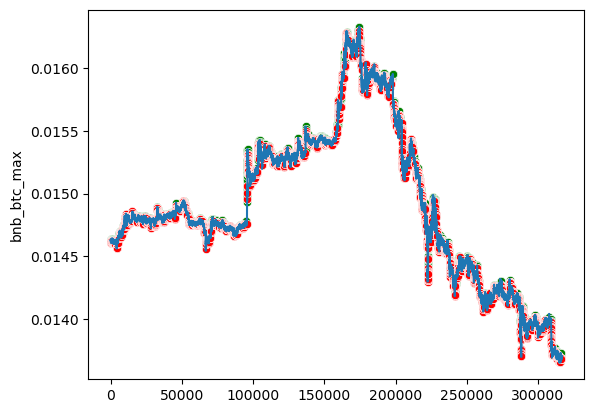

eth_btc


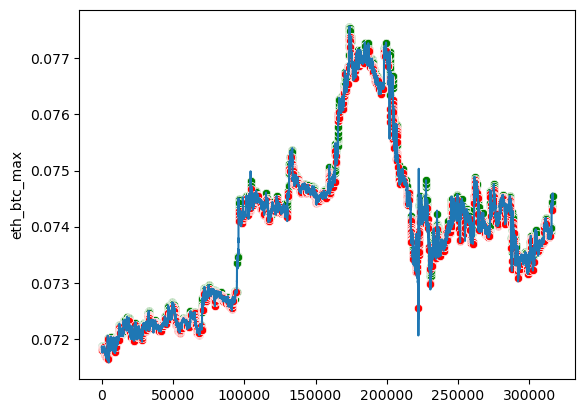

bnb_eth


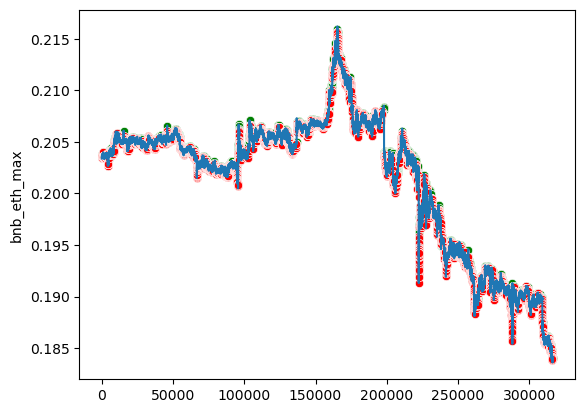

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 55, loss: 0.076
Traid counts: 33439 1: 5575 2: 4856 3: 1960 4: 5128 5: 7687 6: 8233
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.94    315897
         1.0       0.01      0.42      0.02       127
         2.0       0.01      0.35      0.02       129
         3.0       0.01      0.15      0.01        71
         4.0       0.00      0.30      0.01        70
         5.0       0.01      0.56      0.02       126
         6.0       0.01      0.52      0.02       132

    accuracy                           0.89    316552
   macro avg       0.15      0.46      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 368.10020349891136
Общая комиссия в usdt: 3.827103390108193
Число сделок: 212
Прибыль от 300 usdt за 

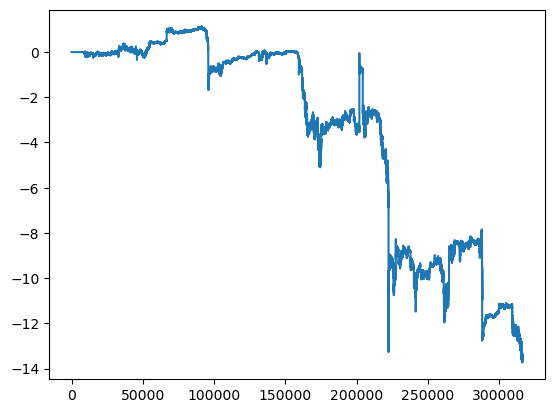

bnb_btc


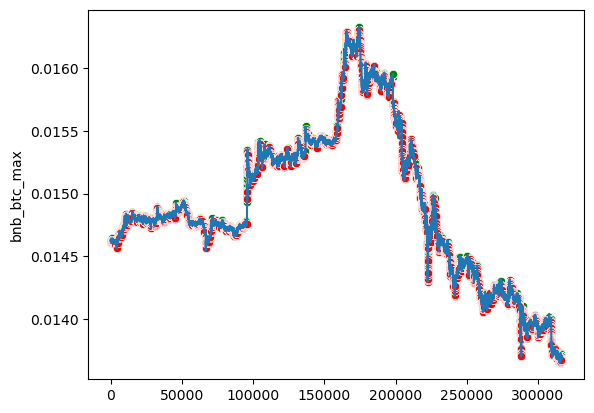

eth_btc


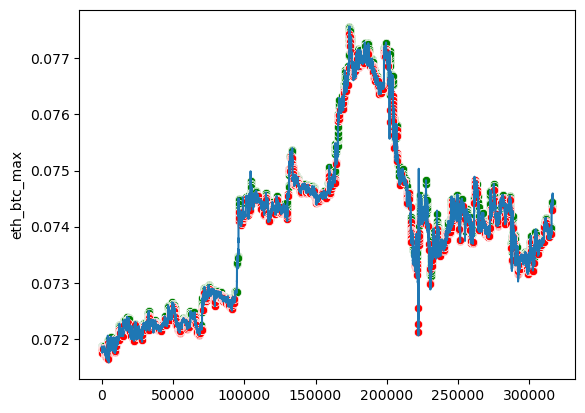

bnb_eth


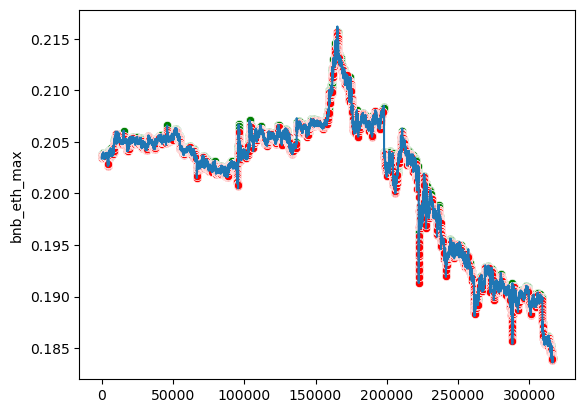

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 56, loss: 0.075
Traid counts: 36807 1: 5518 2: 6515 3: 2600 4: 6129 5: 7713 6: 8332
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.94    315897
         1.0       0.01      0.37      0.02       127
         2.0       0.01      0.36      0.01       129
         3.0       0.01      0.20      0.01        71
         4.0       0.00      0.34      0.01        70
         5.0       0.01      0.51      0.02       126
         6.0       0.01      0.55      0.02       132

    accuracy                           0.88    316552
   macro avg       0.15      0.46      0.15    316552
weighted avg       1.00      0.88      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 375.3680808039668
Общая комиссия в usdt: 3.81514178984858
Число сделок: 220
Прибыль от 300 usdt за 10

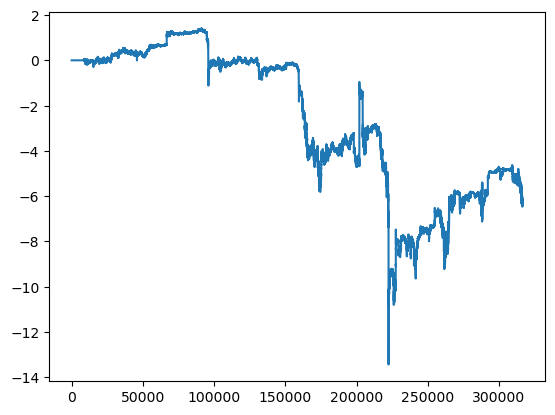

bnb_btc


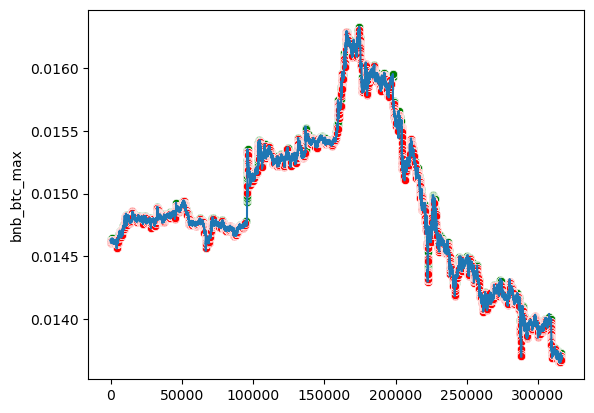

eth_btc


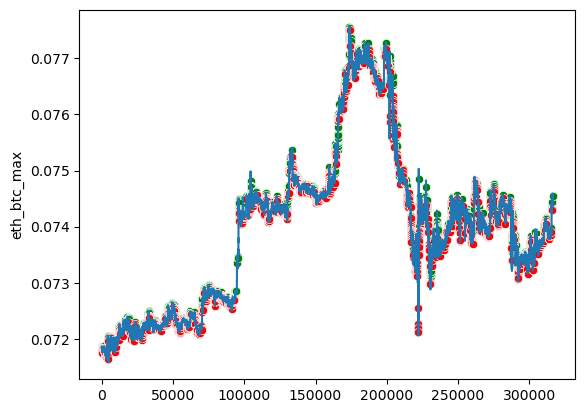

bnb_eth


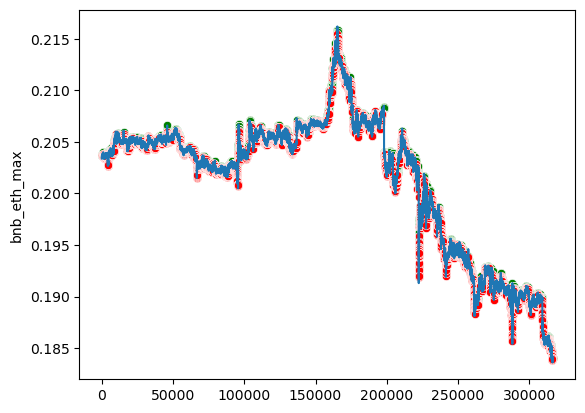

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 57, loss: 0.073
Traid counts: 36744 1: 4792 2: 6048 3: 2538 4: 5631 5: 8002 6: 9733
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.94    315897
         1.0       0.01      0.31      0.02       127
         2.0       0.01      0.40      0.02       129
         3.0       0.01      0.28      0.02        71
         4.0       0.00      0.29      0.01        70
         5.0       0.01      0.59      0.02       126
         6.0       0.01      0.54      0.01       132

    accuracy                           0.88    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.88      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 366.8223675229202
Общая комиссия в usdt: 3.650041008705609
Число сделок: 207
Прибыль от 300 usdt за 1

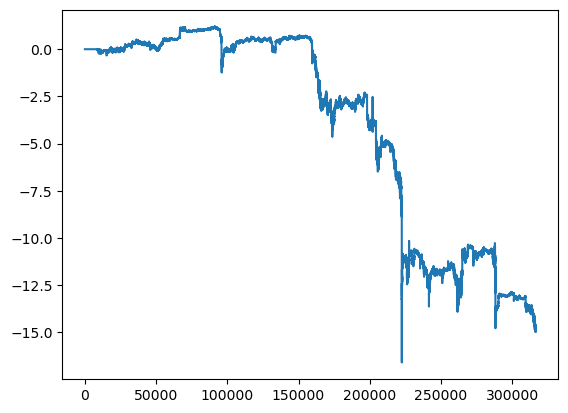

bnb_btc


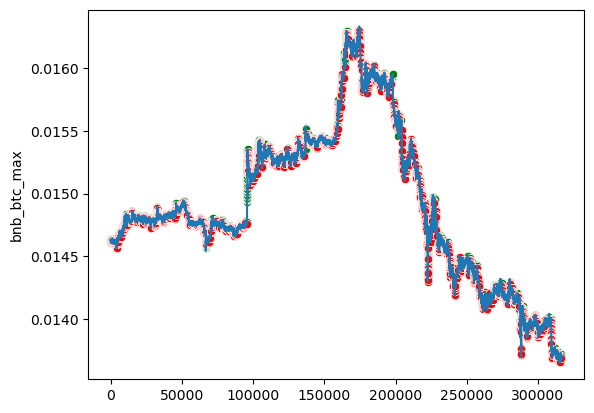

eth_btc


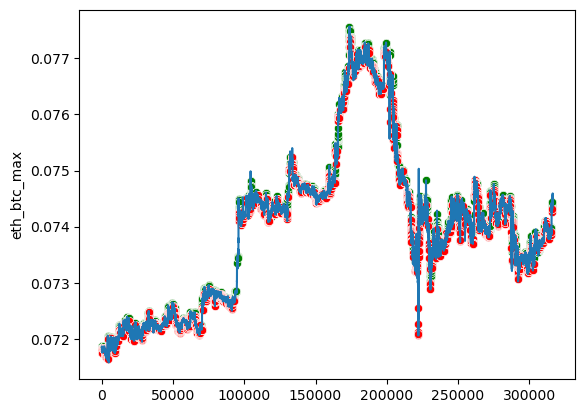

bnb_eth


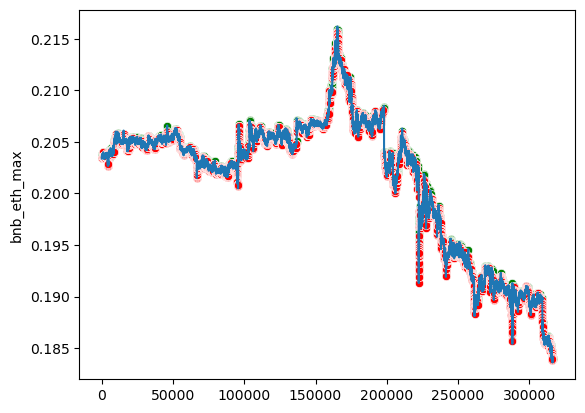

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 58, loss: 0.071
Traid counts: 37525 1: 5166 2: 5858 3: 2264 4: 6159 5: 8955 6: 9123
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.94    315897
         1.0       0.01      0.35      0.02       127
         2.0       0.01      0.36      0.02       129
         3.0       0.01      0.24      0.01        71
         4.0       0.00      0.43      0.01        70
         5.0       0.01      0.57      0.02       126
         6.0       0.01      0.58      0.02       132

    accuracy                           0.88    316552
   macro avg       0.15      0.49      0.15    316552
weighted avg       1.00      0.88      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 372.51958796451447
Общая комиссия в usdt: 3.795651871834462
Число сделок: 214
Прибыль от 300 usdt за 

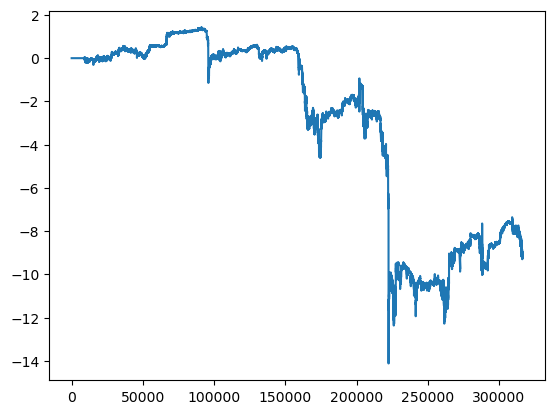

bnb_btc


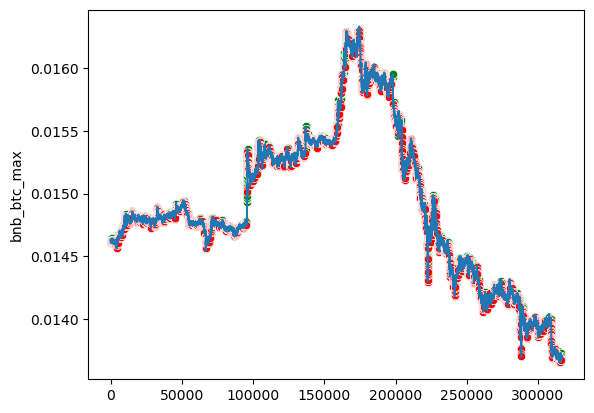

eth_btc


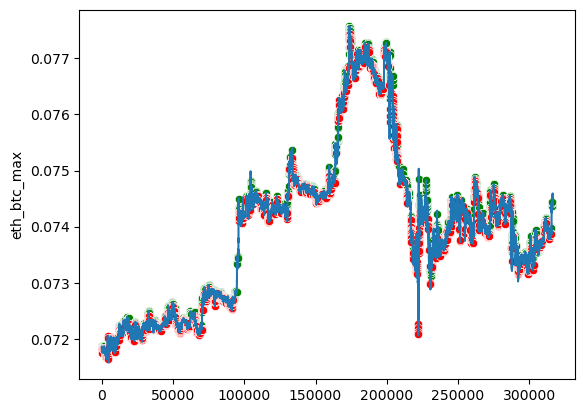

bnb_eth


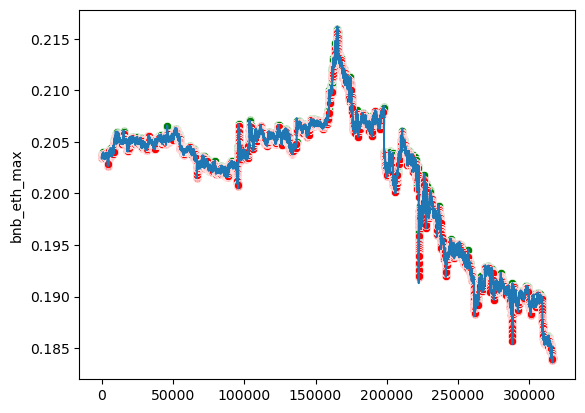

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 59, loss: 0.075
Traid counts: 37018 1: 5168 2: 5303 3: 2736 4: 5972 5: 8555 6: 9284
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.94    315897
         1.0       0.01      0.35      0.02       127
         2.0       0.01      0.30      0.01       129
         3.0       0.01      0.23      0.01        71
         4.0       0.00      0.36      0.01        70
         5.0       0.01      0.60      0.02       126
         6.0       0.01      0.56      0.02       132

    accuracy                           0.88    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.88      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 373.50042367466114
Общая комиссия в usdt: 3.8354869978267474
Число сделок: 214
Прибыль от 300 usdt за

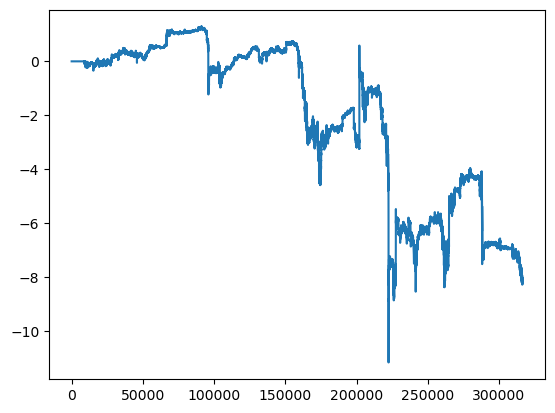

bnb_btc


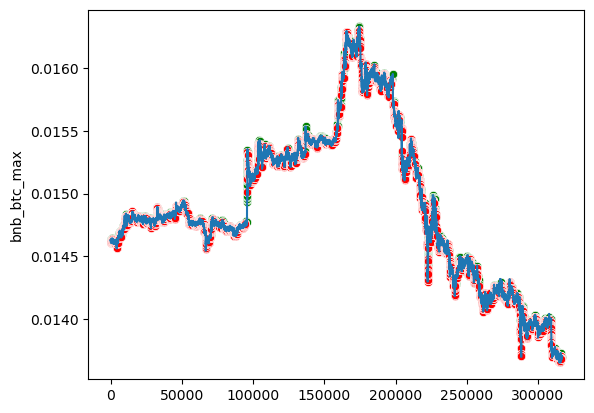

eth_btc


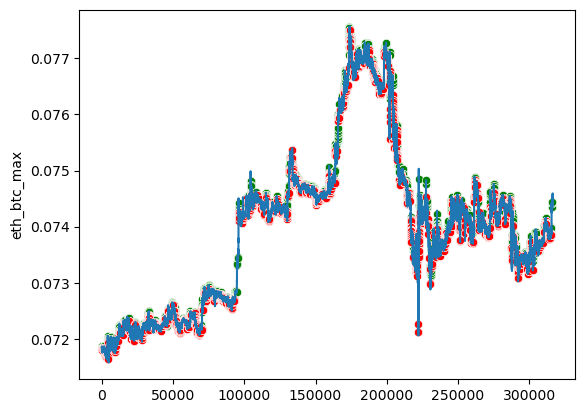

bnb_eth


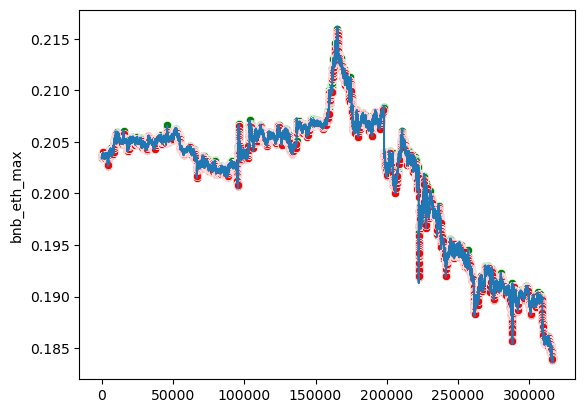

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 60, loss: 0.066
Traid counts: 35651 1: 5230 2: 5355 3: 2662 4: 5216 5: 7750 6: 9438
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    315897
         1.0       0.01      0.31      0.01       127
         2.0       0.01      0.28      0.01       129
         3.0       0.00      0.18      0.01        71
         4.0       0.01      0.39      0.01        70
         5.0       0.01      0.54      0.02       126
         6.0       0.01      0.48      0.01       132

    accuracy                           0.89    316552
   macro avg       0.15      0.44      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 370.5256772402911
Общая комиссия в usdt: 3.697304364993964
Число сделок: 207
Прибыль от 300 usdt за 1

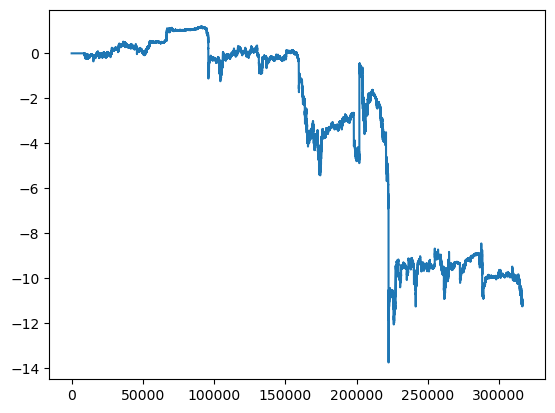

bnb_btc


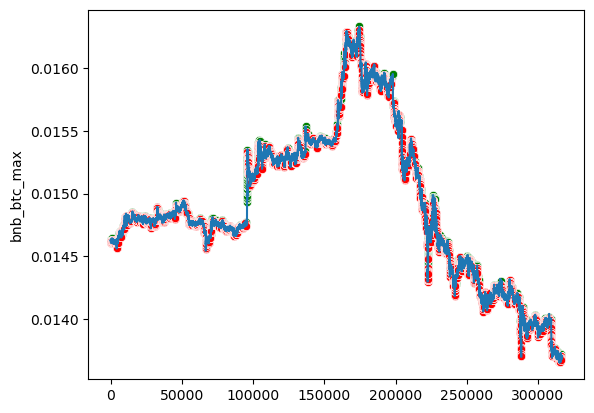

eth_btc


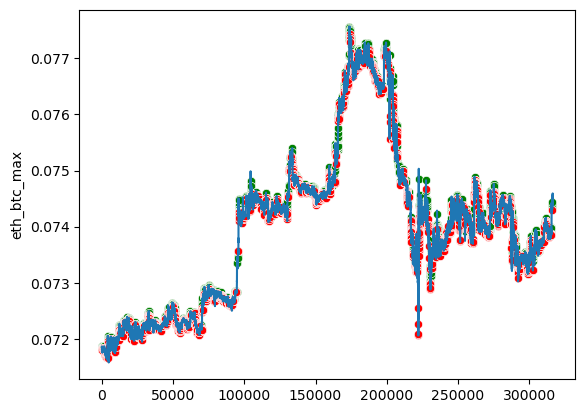

bnb_eth


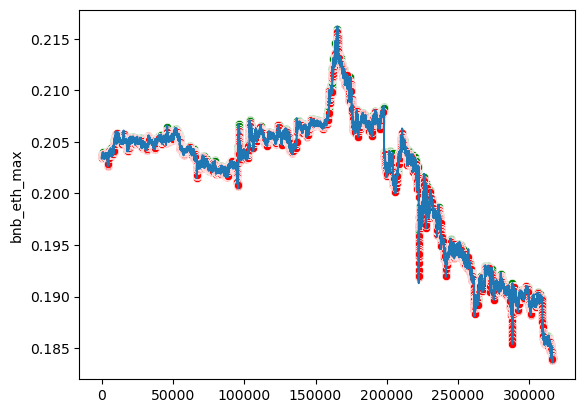

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 61, loss: 0.064
Traid counts: 35240 1: 5000 2: 5671 3: 2401 4: 4722 5: 8495 6: 8951
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    315897
         1.0       0.01      0.39      0.02       127
         2.0       0.01      0.34      0.02       129
         3.0       0.01      0.24      0.01        71
         4.0       0.01      0.36      0.01        70
         5.0       0.01      0.60      0.02       126
         6.0       0.01      0.50      0.01       132

    accuracy                           0.89    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 370.92719515337484
Общая комиссия в usdt: 3.6613287355138335
Число сделок: 206
Прибыль от 300 usdt за

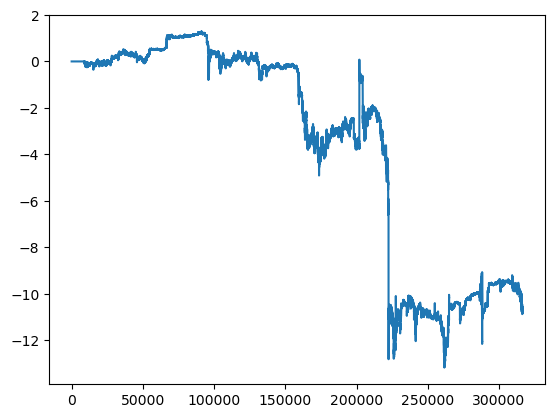

bnb_btc


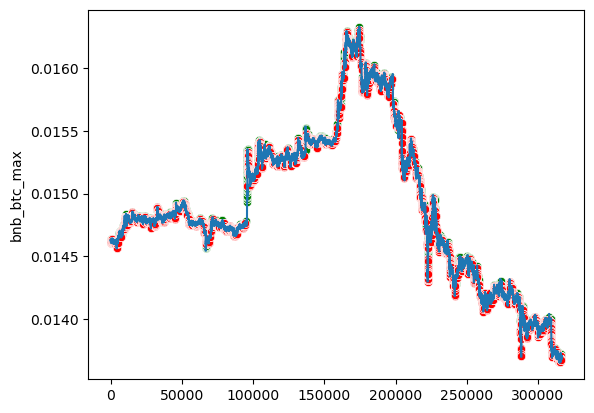

eth_btc


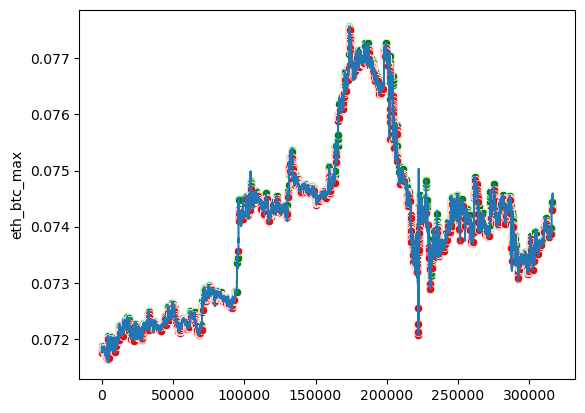

bnb_eth


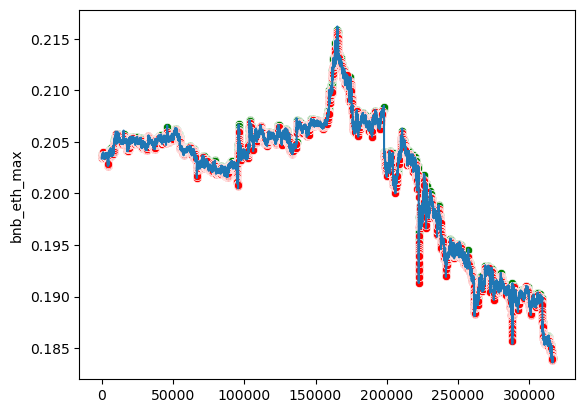

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 62, loss: 0.064
Traid counts: 33866 1: 6185 2: 5433 3: 1994 4: 5297 5: 7388 6: 7569
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    315897
         1.0       0.01      0.39      0.02       127
         2.0       0.01      0.33      0.02       129
         3.0       0.01      0.23      0.02        71
         4.0       0.01      0.43      0.01        70
         5.0       0.01      0.44      0.01       126
         6.0       0.01      0.52      0.02       132

    accuracy                           0.89    316552
   macro avg       0.15      0.46      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 369.99104906025246
Общая комиссия в usdt: 3.096540201078869
Число сделок: 172
Прибыль от 300 usdt за 

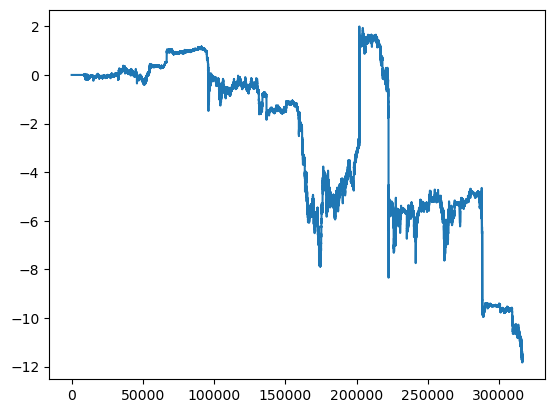

bnb_btc


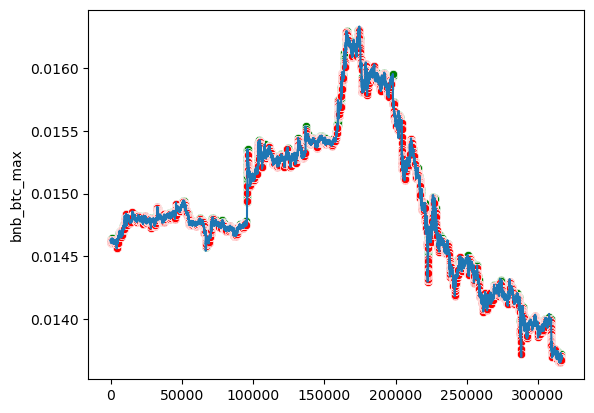

eth_btc


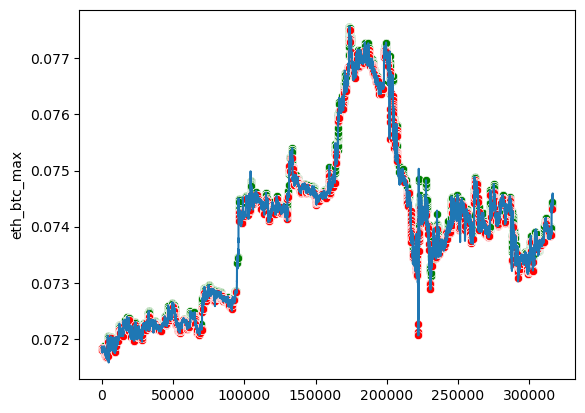

bnb_eth


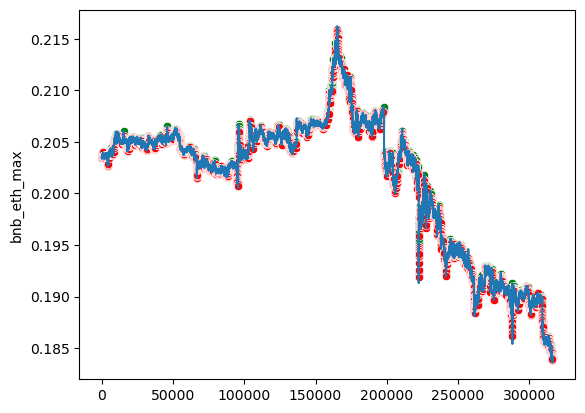

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 63, loss: 0.065
Traid counts: 34204 1: 4544 2: 5702 3: 2223 4: 4979 5: 7333 6: 9423
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    315897
         1.0       0.01      0.36      0.02       127
         2.0       0.01      0.35      0.02       129
         3.0       0.01      0.24      0.01        71
         4.0       0.00      0.34      0.01        70
         5.0       0.01      0.52      0.02       126
         6.0       0.01      0.53      0.01       132

    accuracy                           0.89    316552
   macro avg       0.15      0.46      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 374.04135933136655
Общая комиссия в usdt: 3.6198386784855012
Число сделок: 201
Прибыль от 300 usdt за

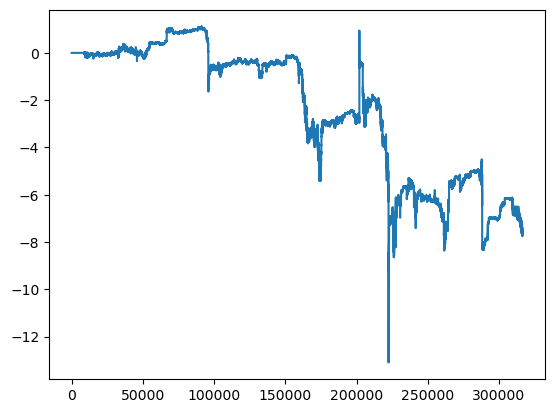

bnb_btc


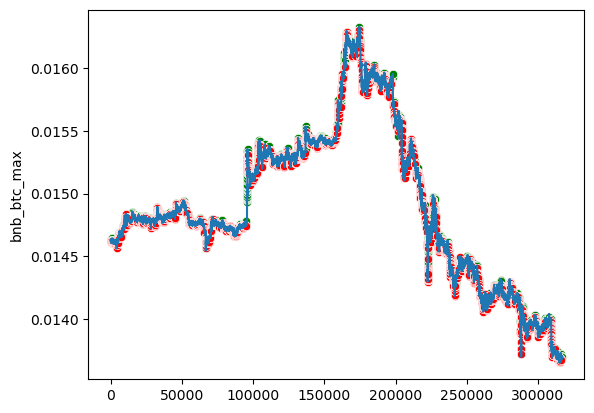

eth_btc


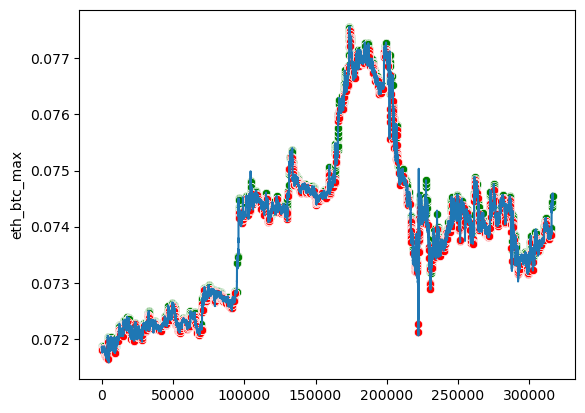

bnb_eth


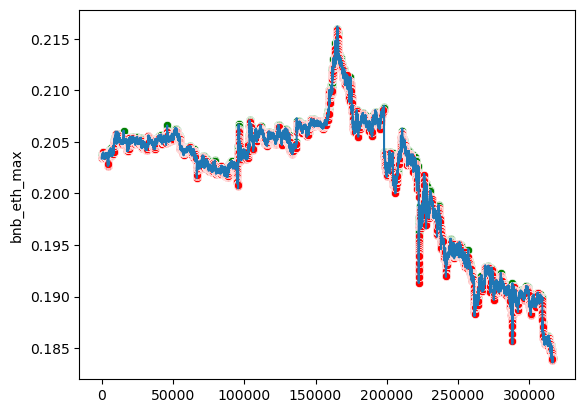

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 64, loss: 0.059
Traid counts: 35213 1: 5079 2: 4963 3: 2620 4: 5135 5: 8434 6: 8982
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    315897
         1.0       0.01      0.37      0.02       127
         2.0       0.01      0.33      0.02       129
         3.0       0.01      0.24      0.01        71
         4.0       0.01      0.39      0.01        70
         5.0       0.01      0.53      0.02       126
         6.0       0.01      0.56      0.02       132

    accuracy                           0.89    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 368.8413238583315
Общая комиссия в usdt: 3.6395455490987496
Число сделок: 209
Прибыль от 300 usdt за 

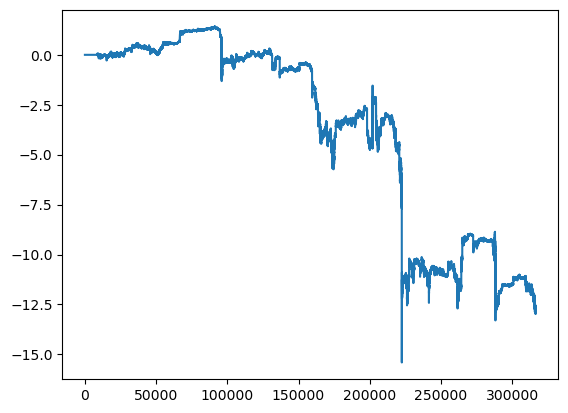

bnb_btc


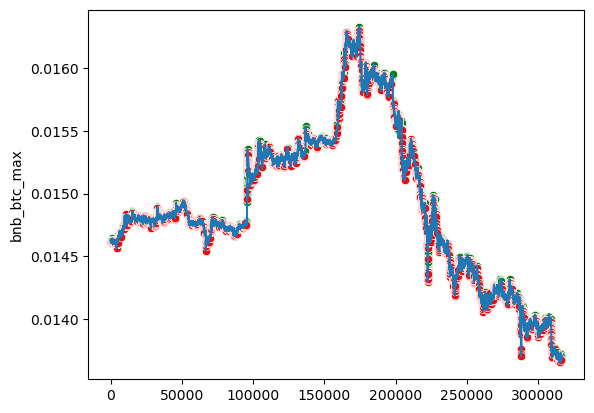

eth_btc


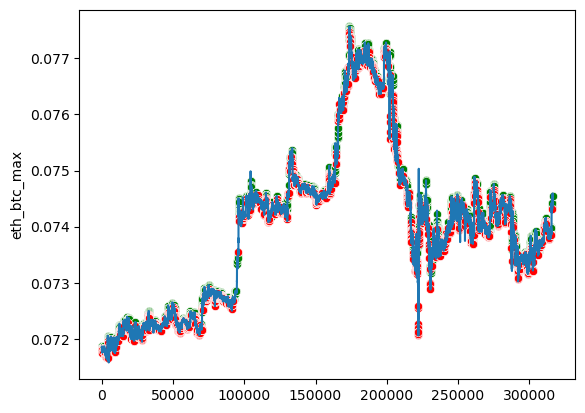

bnb_eth


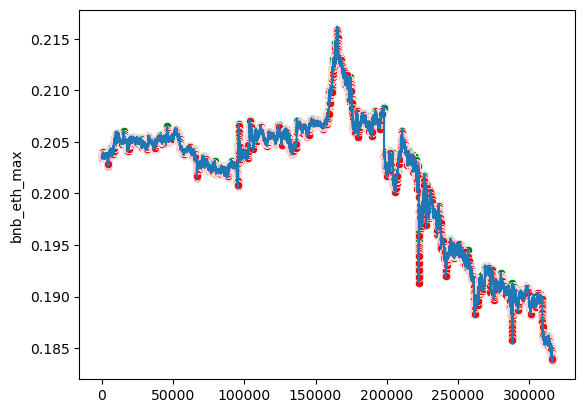

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 65, loss: 0.060
Traid counts: 35216 1: 5161 2: 5732 3: 2468 4: 5912 5: 7683 6: 8260
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    315897
         1.0       0.01      0.35      0.02       127
         2.0       0.01      0.33      0.01       129
         3.0       0.01      0.23      0.01        71
         4.0       0.00      0.40      0.01        70
         5.0       0.01      0.57      0.02       126
         6.0       0.01      0.51      0.02       132

    accuracy                           0.89    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 373.1888068089359
Общая комиссия в usdt: 3.5595830736968677
Число сделок: 193
Прибыль от 300 usdt за 

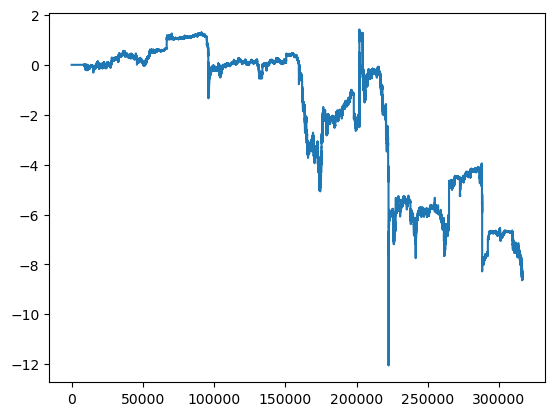

bnb_btc


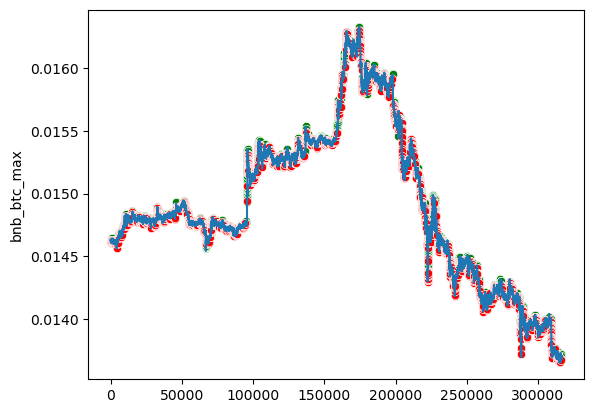

eth_btc


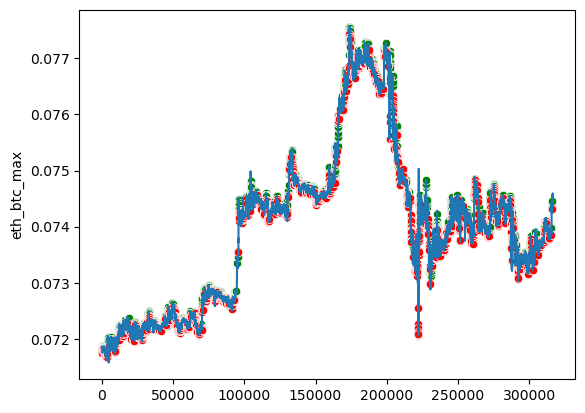

bnb_eth


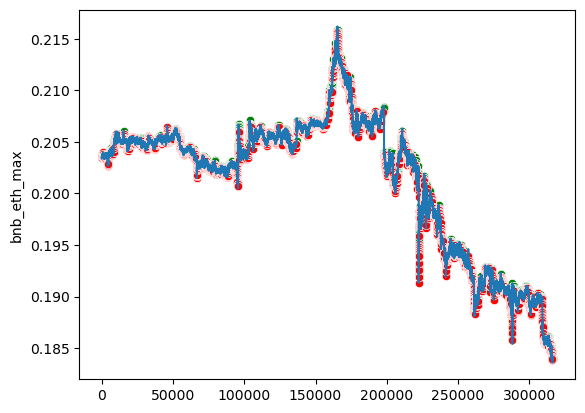

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 66, loss: 0.063
Traid counts: 33942 1: 4108 2: 6108 3: 2207 4: 5392 5: 7584 6: 8543
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    315897
         1.0       0.01      0.35      0.02       127
         2.0       0.01      0.33      0.01       129
         3.0       0.01      0.24      0.01        71
         4.0       0.01      0.39      0.01        70
         5.0       0.01      0.51      0.02       126
         6.0       0.01      0.54      0.02       132

    accuracy                           0.89    316552
   macro avg       0.15      0.46      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 374.3458872413438
Общая комиссия в usdt: 3.3819016491570455
Число сделок: 188
Прибыль от 300 usdt за 

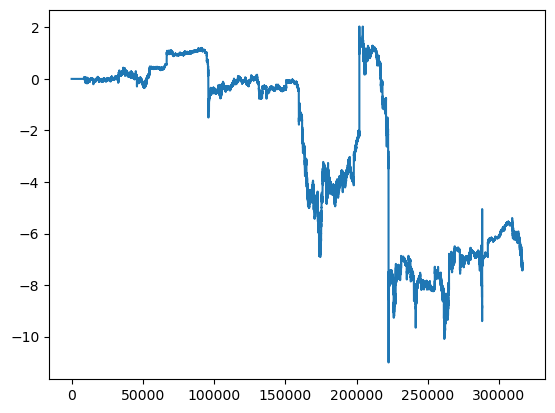

bnb_btc


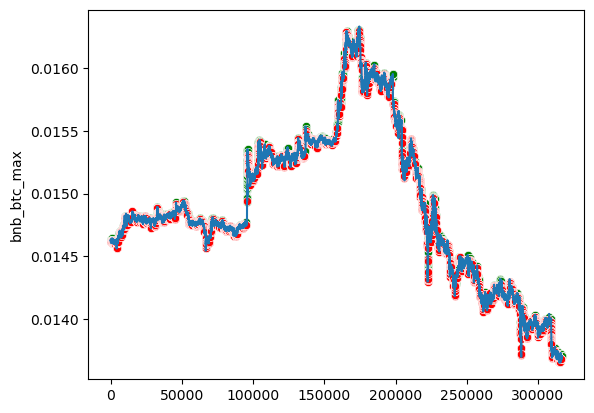

eth_btc


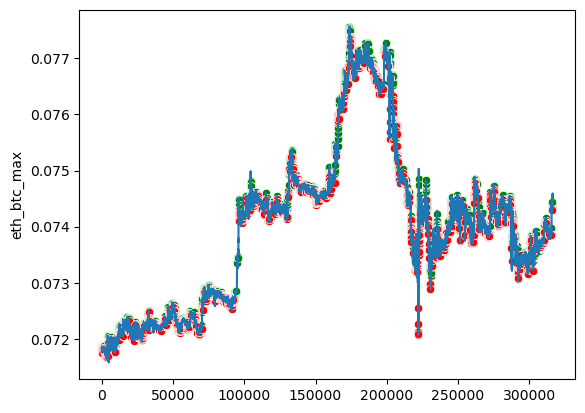

bnb_eth


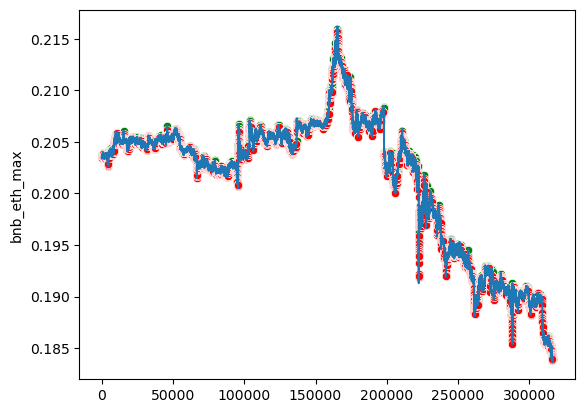

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 67, loss: 0.066
Traid counts: 37137 1: 4564 2: 5106 3: 2724 4: 6457 5: 8420 6: 9866
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.94    315897
         1.0       0.01      0.33      0.02       127
         2.0       0.01      0.29      0.01       129
         3.0       0.01      0.25      0.01        71
         4.0       0.00      0.37      0.01        70
         5.0       0.01      0.56      0.02       126
         6.0       0.01      0.61      0.02       132

    accuracy                           0.88    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.88      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 370.01854891200855
Общая комиссия в usdt: 3.606529661139105
Число сделок: 200
Прибыль от 300 usdt за 

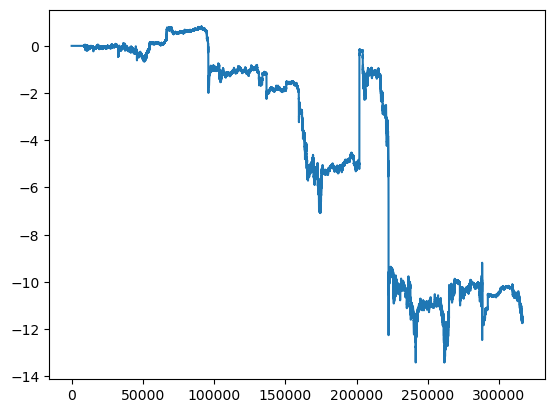

bnb_btc


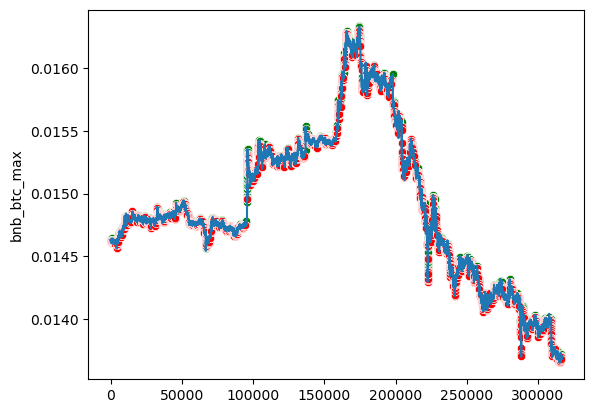

eth_btc


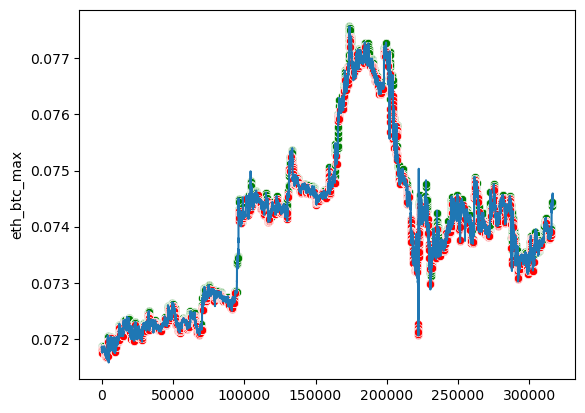

bnb_eth


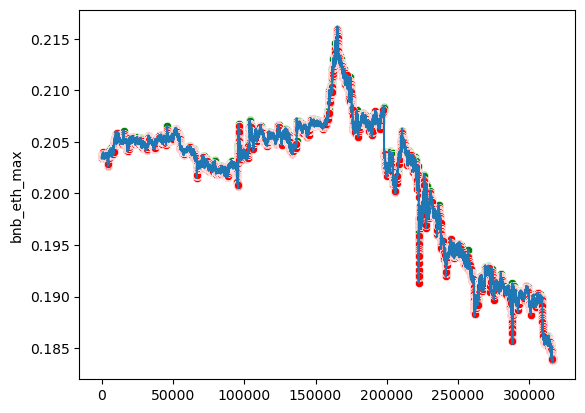

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 68, loss: 0.059
Traid counts: 34710 1: 4165 2: 6392 3: 2499 4: 5067 5: 8217 6: 8370
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    315897
         1.0       0.01      0.35      0.02       127
         2.0       0.01      0.36      0.01       129
         3.0       0.01      0.34      0.02        71
         4.0       0.01      0.37      0.01        70
         5.0       0.01      0.54      0.02       126
         6.0       0.01      0.48      0.01       132

    accuracy                           0.89    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 376.89996611111053
Общая комиссия в usdt: 3.156330987495079
Число сделок: 174
Прибыль от 300 usdt за 

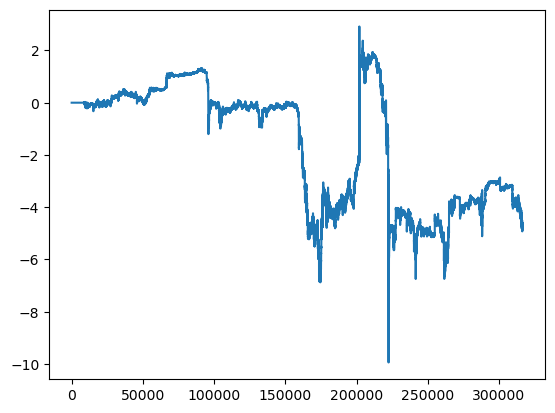

bnb_btc


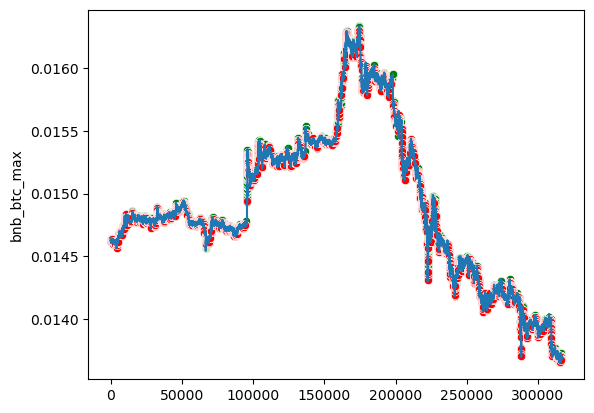

eth_btc


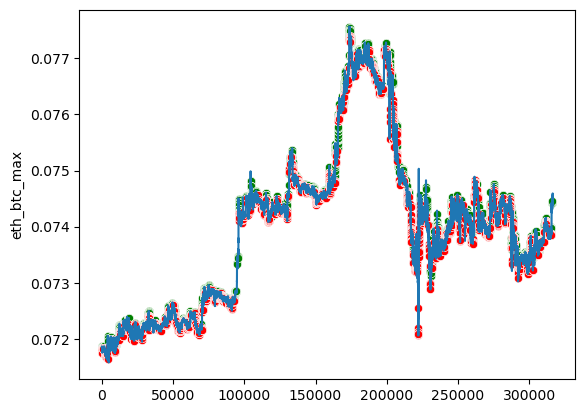

bnb_eth


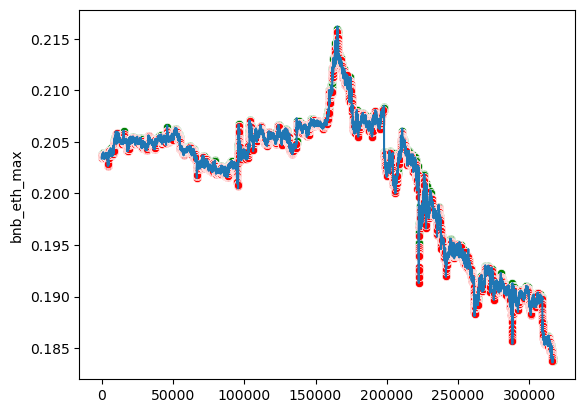

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 69, loss: 0.055
Traid counts: 35802 1: 4181 2: 5320 3: 2834 4: 5829 5: 8839 6: 8799
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    315897
         1.0       0.01      0.31      0.02       127
         2.0       0.01      0.33      0.02       129
         3.0       0.01      0.27      0.01        71
         4.0       0.01      0.44      0.01        70
         5.0       0.01      0.55      0.02       126
         6.0       0.01      0.51      0.02       132

    accuracy                           0.89    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 369.7915212804281
Общая комиссия в usdt: 3.8922482948581494
Число сделок: 210
Прибыль от 300 usdt за 

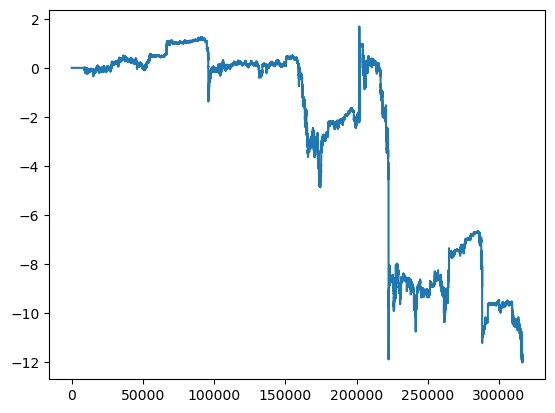

bnb_btc


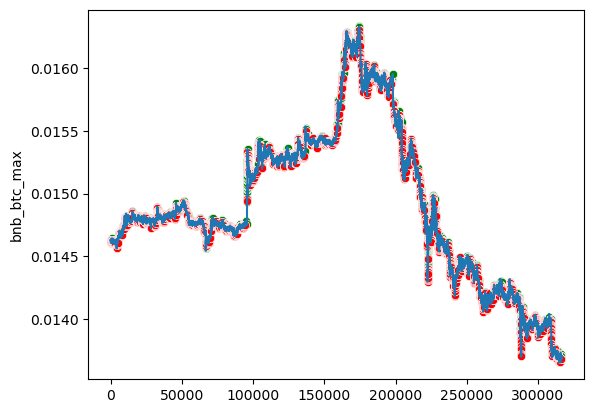

eth_btc


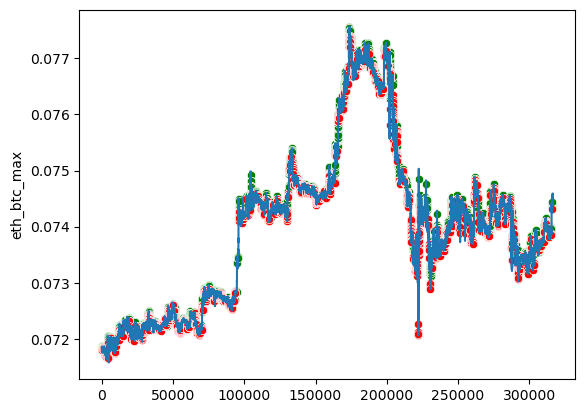

bnb_eth


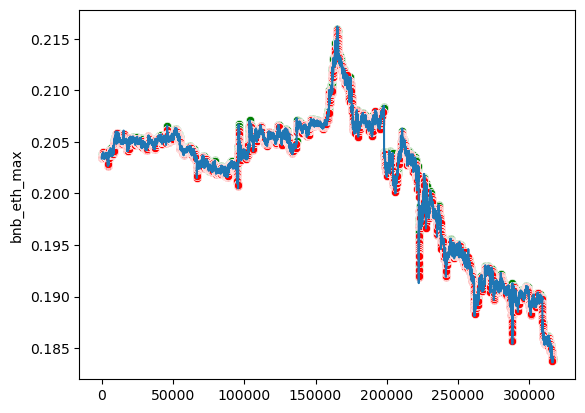

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 70, loss: 0.058
Traid counts: 36592 1: 4916 2: 5620 3: 2839 4: 5807 5: 7972 6: 9438
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    315897
         1.0       0.01      0.33      0.02       127
         2.0       0.01      0.31      0.01       129
         3.0       0.01      0.21      0.01        71
         4.0       0.00      0.36      0.01        70
         5.0       0.01      0.52      0.02       126
         6.0       0.01      0.53      0.01       132

    accuracy                           0.88    316552
   macro avg       0.15      0.45      0.15    316552
weighted avg       1.00      0.88      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 367.8681130022545
Общая комиссия в usdt: 3.6700466012286284
Число сделок: 205
Прибыль от 300 usdt за 

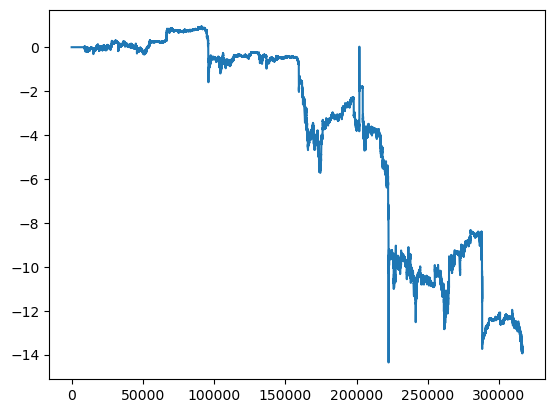

bnb_btc


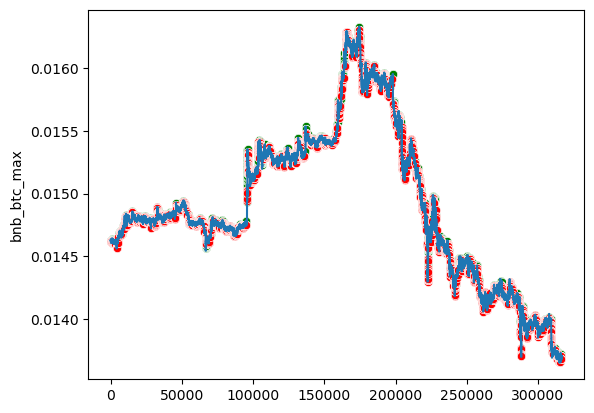

eth_btc


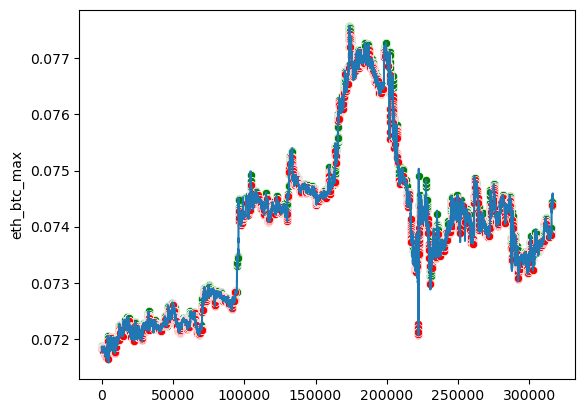

bnb_eth


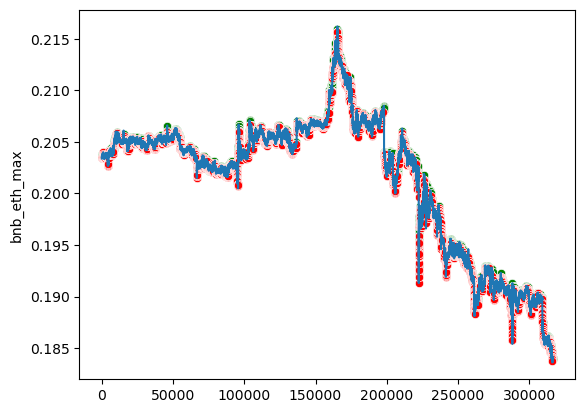

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 71, loss: 0.060
Traid counts: 33086 1: 4439 2: 5324 3: 2243 4: 4916 5: 7979 6: 8185
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.94    315897
         1.0       0.01      0.31      0.02       127
         2.0       0.01      0.29      0.01       129
         3.0       0.01      0.27      0.02        71
         4.0       0.01      0.39      0.01        70
         5.0       0.01      0.55      0.02       126
         6.0       0.01      0.51      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.46      0.15    316552
weighted avg       1.00      0.90      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 364.683057952275
Общая комиссия в usdt: 3.748134898289155
Число сделок: 207
Прибыль от 300 usdt за 10

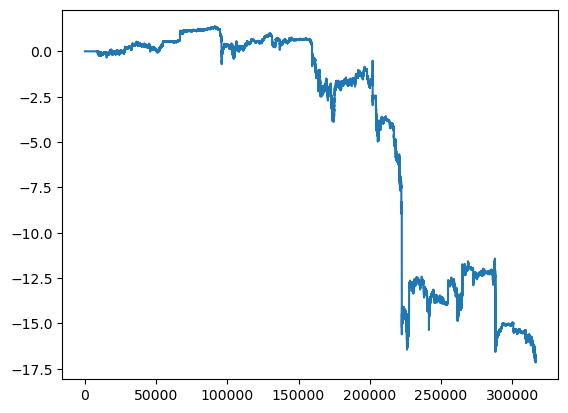

bnb_btc


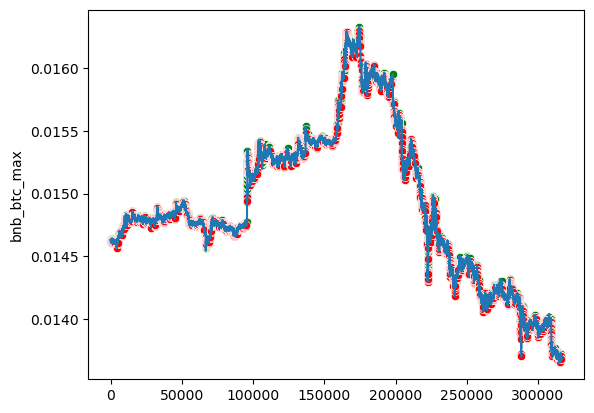

eth_btc


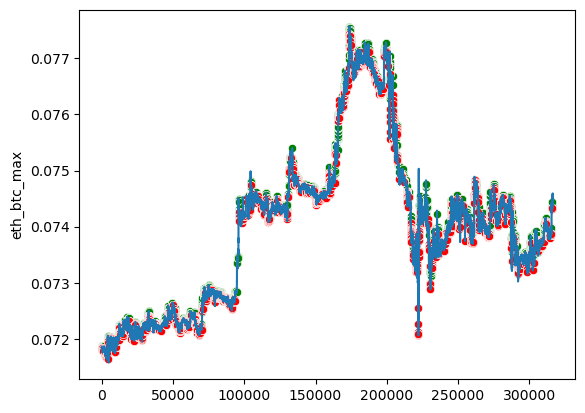

bnb_eth


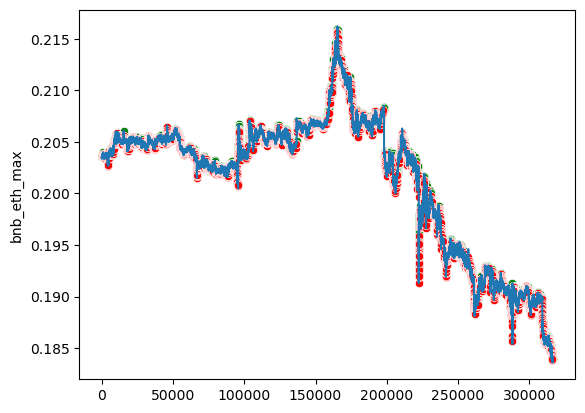

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 72, loss: 0.055
Traid counts: 33049 1: 4392 2: 4819 3: 2368 4: 4902 5: 7270 6: 9298
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.29      0.02       127
         2.0       0.01      0.28      0.01       129
         3.0       0.01      0.24      0.01        71
         4.0       0.00      0.27      0.01        70
         5.0       0.01      0.53      0.02       126
         6.0       0.01      0.58      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.44      0.15    316552
weighted avg       1.00      0.90      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 374.16927250787074
Общая комиссия в usdt: 3.841257256378697
Число сделок: 209
Прибыль от 300 usdt за 

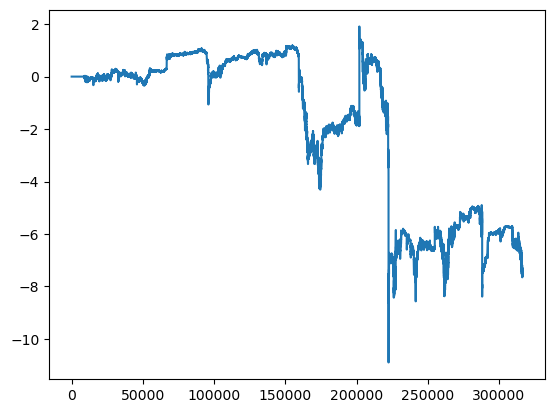

bnb_btc


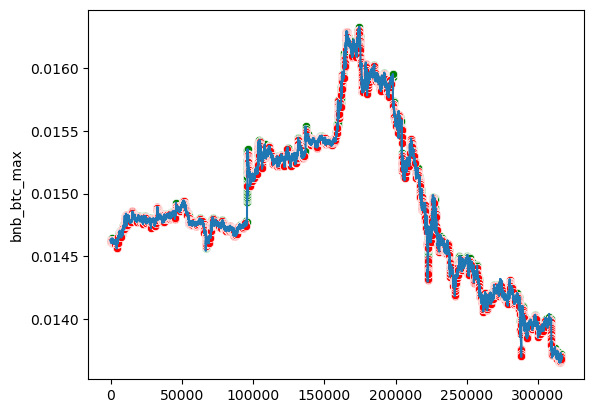

eth_btc


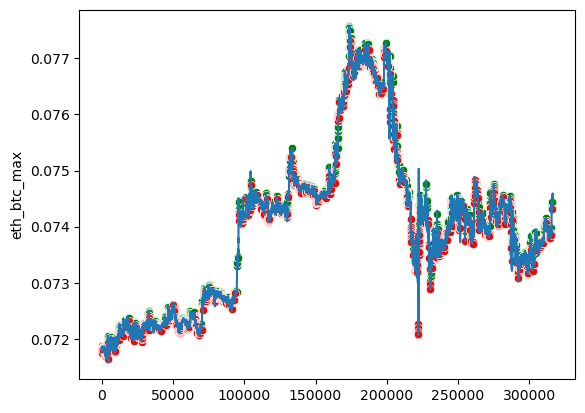

bnb_eth


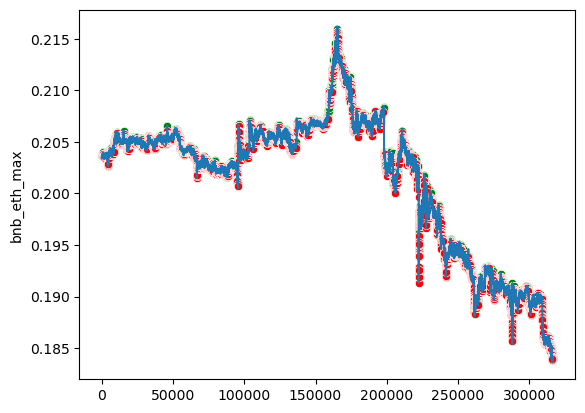

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 73, loss: 0.054
Traid counts: 36267 1: 5001 2: 4832 3: 2785 4: 6066 5: 8030 6: 9553
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    315897
         1.0       0.01      0.31      0.02       127
         2.0       0.01      0.29      0.01       129
         3.0       0.01      0.27      0.01        71
         4.0       0.00      0.43      0.01        70
         5.0       0.01      0.52      0.02       126
         6.0       0.01      0.56      0.02       132

    accuracy                           0.89    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 364.51390552152293
Общая комиссия в usdt: 3.542909333791206
Число сделок: 202
Прибыль от 300 usdt за 

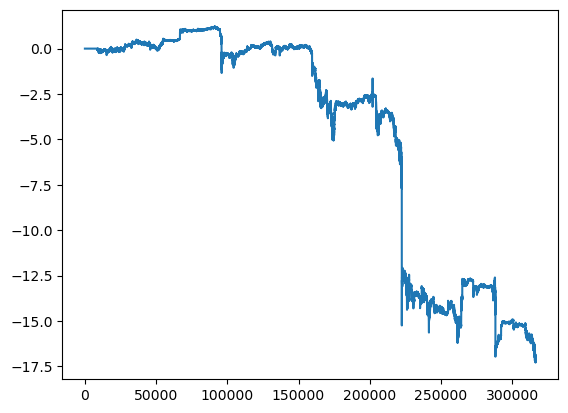

bnb_btc


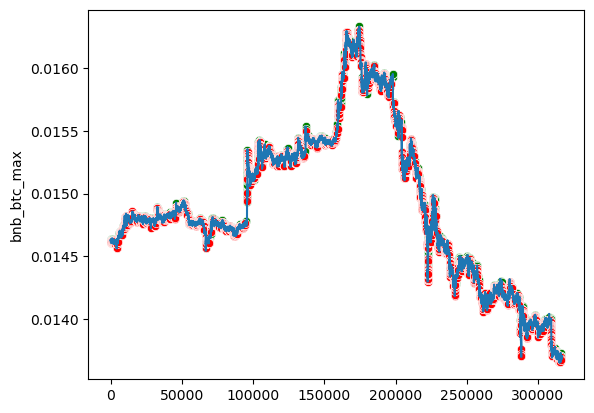

eth_btc


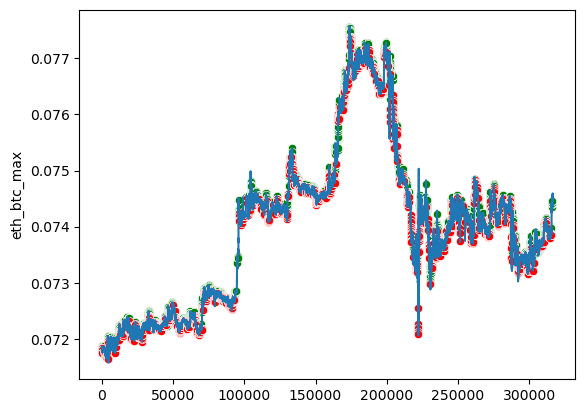

bnb_eth


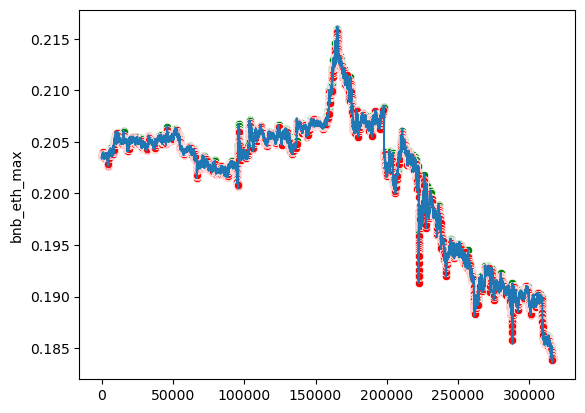

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 74, loss: 0.055
Traid counts: 33922 1: 4971 2: 5431 3: 2593 4: 5028 5: 7715 6: 8184
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    315897
         1.0       0.01      0.32      0.02       127
         2.0       0.01      0.29      0.01       129
         3.0       0.01      0.30      0.02        71
         4.0       0.01      0.40      0.01        70
         5.0       0.01      0.48      0.02       126
         6.0       0.01      0.52      0.02       132

    accuracy                           0.89    316552
   macro avg       0.15      0.46      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 371.2732115703964
Общая комиссия в usdt: 3.5667553576349715
Число сделок: 191
Прибыль от 300 usdt за 

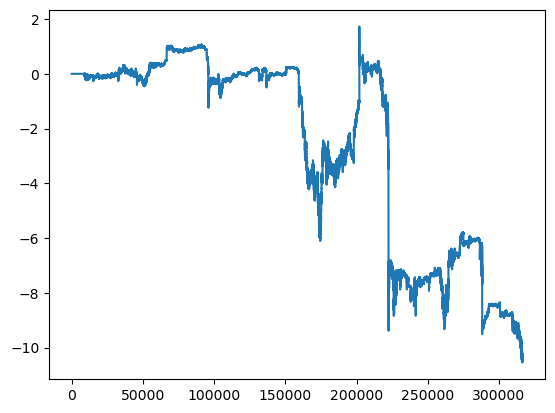

bnb_btc


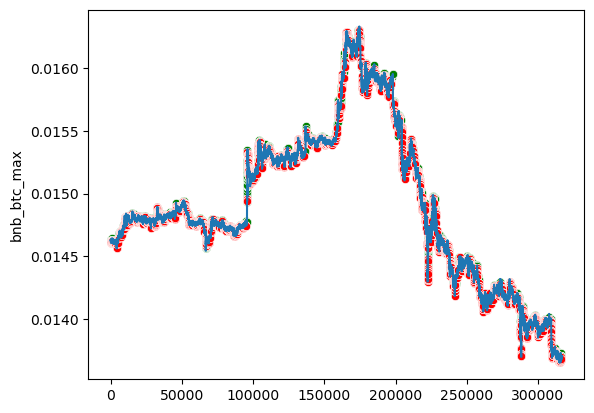

eth_btc


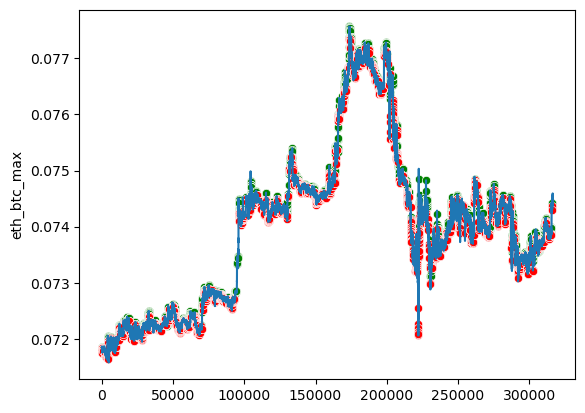

bnb_eth


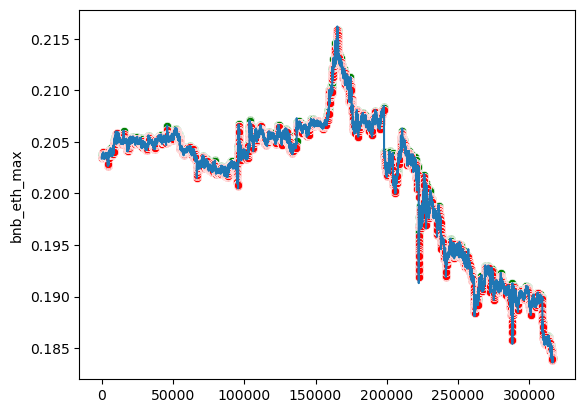

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 75, loss: 0.050
Traid counts: 34608 1: 4415 2: 5408 3: 3249 4: 5533 5: 8029 6: 7974
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    315897
         1.0       0.01      0.41      0.02       127
         2.0       0.01      0.32      0.01       129
         3.0       0.01      0.27      0.01        71
         4.0       0.00      0.36      0.01        70
         5.0       0.01      0.51      0.02       126
         6.0       0.01      0.55      0.02       132

    accuracy                           0.89    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 377.001188330954
Общая комиссия в usdt: 3.770334411219966
Число сделок: 209
Прибыль от 300 usdt за 10

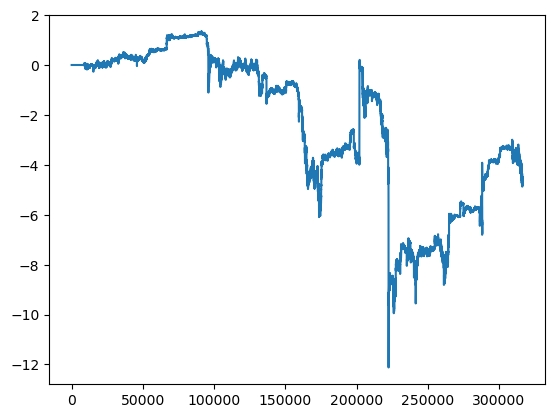

bnb_btc


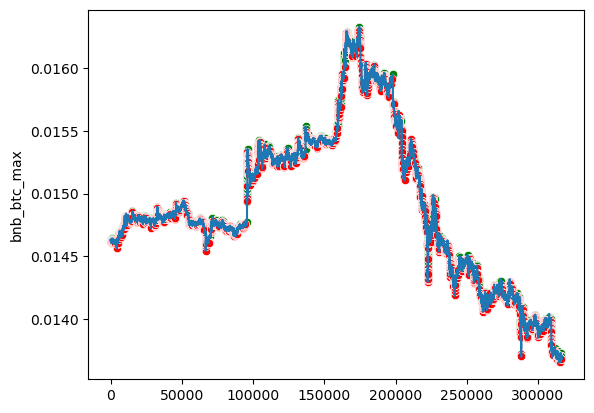

eth_btc


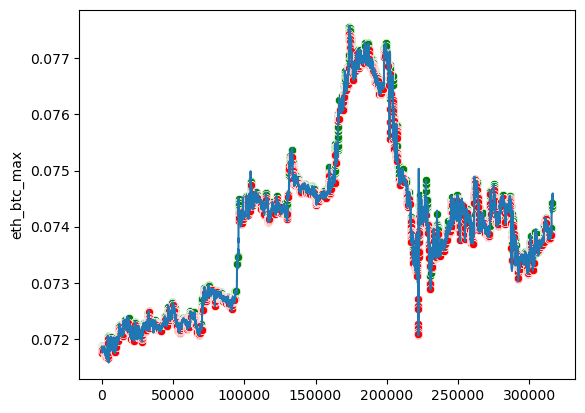

bnb_eth


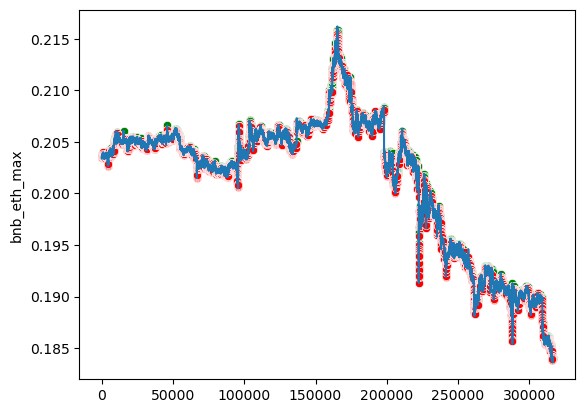

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 76, loss: 0.048
Traid counts: 33461 1: 4719 2: 4969 3: 2356 4: 4932 5: 8533 6: 7952
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.94    315897
         1.0       0.01      0.37      0.02       127
         2.0       0.01      0.31      0.02       129
         3.0       0.01      0.25      0.01        71
         4.0       0.01      0.43      0.01        70
         5.0       0.01      0.52      0.02       126
         6.0       0.01      0.52      0.02       132

    accuracy                           0.89    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 371.08855222372887
Общая комиссия в usdt: 3.7176775481783357
Число сделок: 213
Прибыль от 300 usdt за

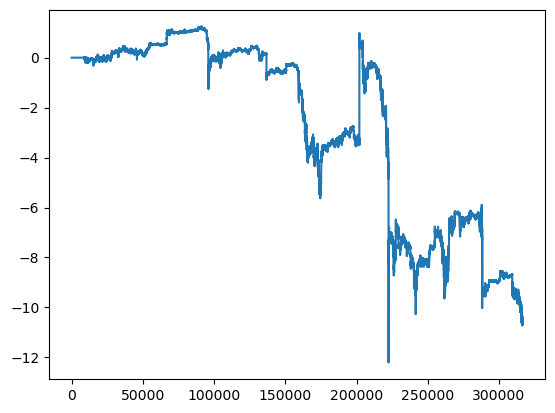

bnb_btc


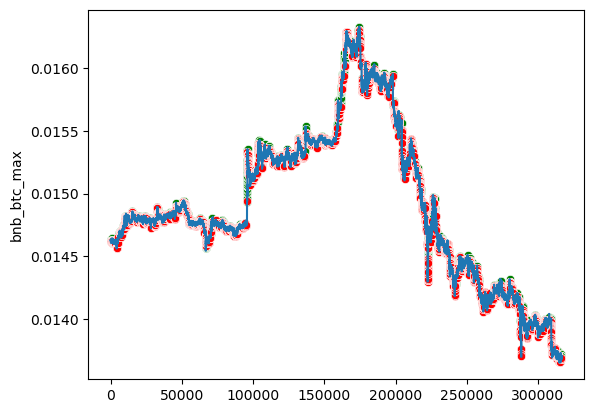

eth_btc


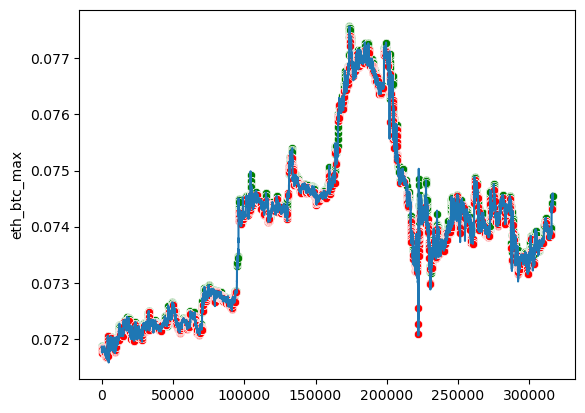

bnb_eth


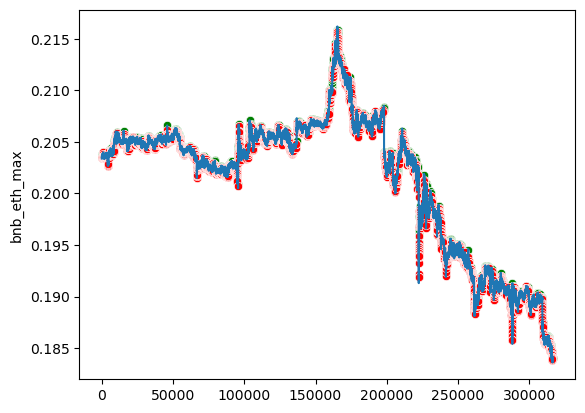

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 77, loss: 0.052
Traid counts: 31926 1: 5001 2: 3991 3: 2933 4: 5122 5: 8022 6: 6857
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.35      0.02       127
         2.0       0.01      0.25      0.02       129
         3.0       0.01      0.24      0.01        71
         4.0       0.01      0.37      0.01        70
         5.0       0.01      0.53      0.02       126
         6.0       0.01      0.52      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.45      0.15    316552
weighted avg       1.00      0.90      0.95    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 371.00442537637247
Общая комиссия в usdt: 3.593831620700432
Число сделок: 190
Прибыль от 300 usdt за 

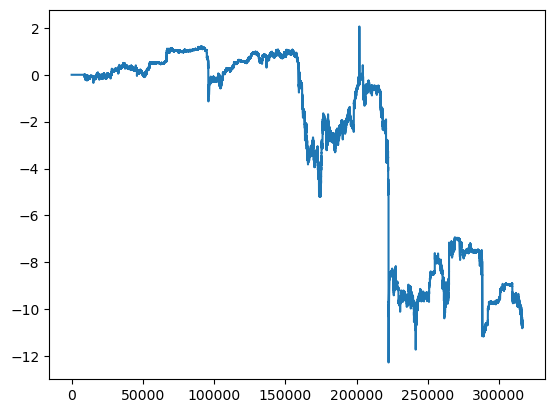

bnb_btc


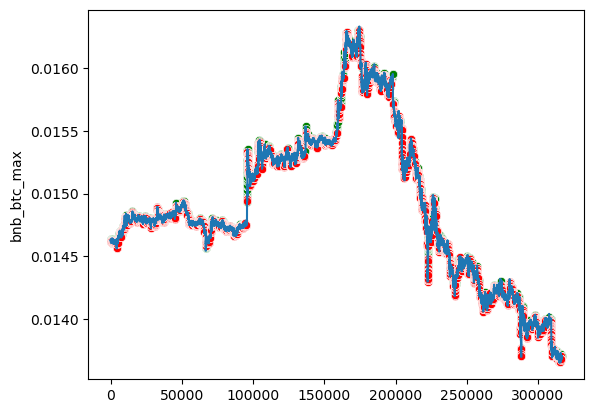

eth_btc


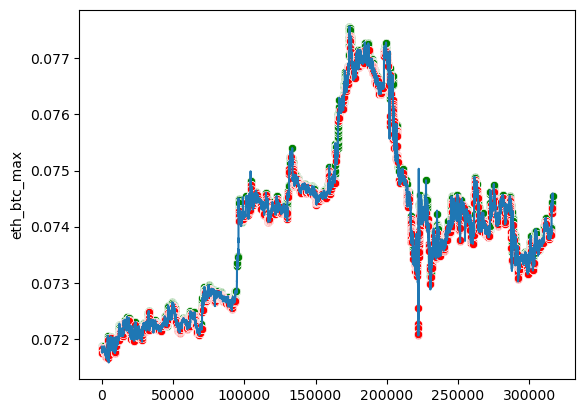

bnb_eth


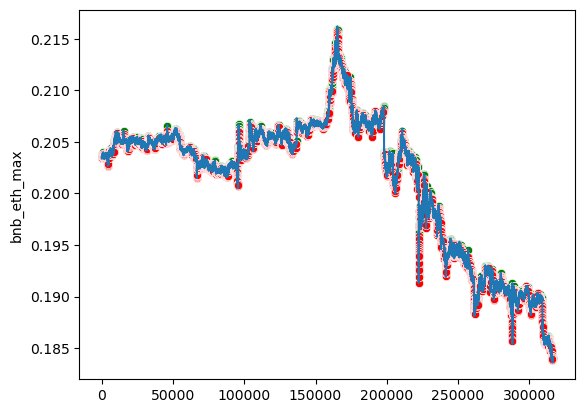

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 78, loss: 0.052
Traid counts: 34493 1: 4967 2: 5860 3: 2907 4: 4550 5: 8253 6: 7956
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    315897
         1.0       0.01      0.41      0.02       127
         2.0       0.01      0.31      0.01       129
         3.0       0.01      0.25      0.01        71
         4.0       0.00      0.30      0.01        70
         5.0       0.01      0.53      0.02       126
         6.0       0.01      0.48      0.02       132

    accuracy                           0.89    316552
   macro avg       0.15      0.45      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 362.2540750126776
Общая комиссия в usdt: 3.577941886024862
Число сделок: 199
Прибыль от 300 usdt за 1

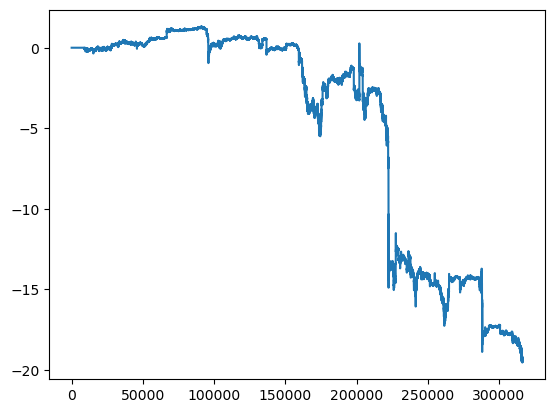

bnb_btc


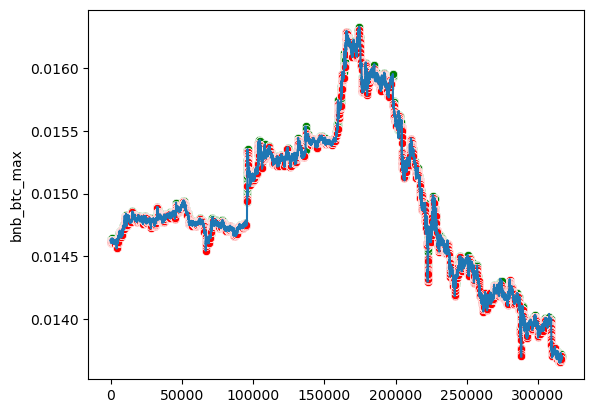

eth_btc


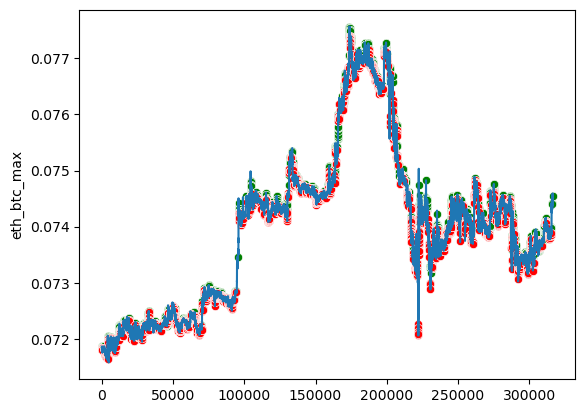

bnb_eth


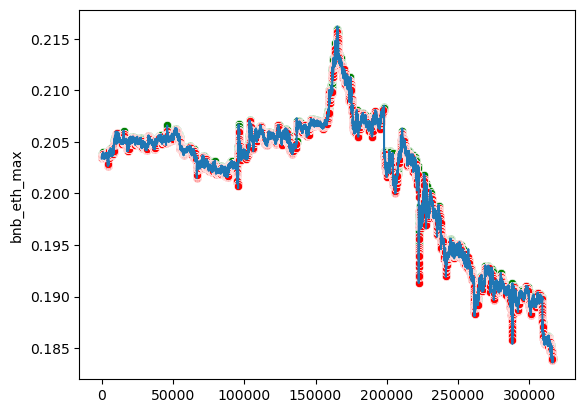

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 79, loss: 0.057
Traid counts: 32067 1: 4327 2: 4414 3: 2481 4: 4684 5: 8281 6: 7880
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.35      0.02       127
         2.0       0.01      0.32      0.02       129
         3.0       0.01      0.27      0.01        71
         4.0       0.01      0.34      0.01        70
         5.0       0.01      0.54      0.02       126
         6.0       0.01      0.48      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.46      0.15    316552
weighted avg       1.00      0.90      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 369.76442696908
Общая комиссия в usdt: 3.6734876034089803
Число сделок: 203
Прибыль от 300 usdt за 10

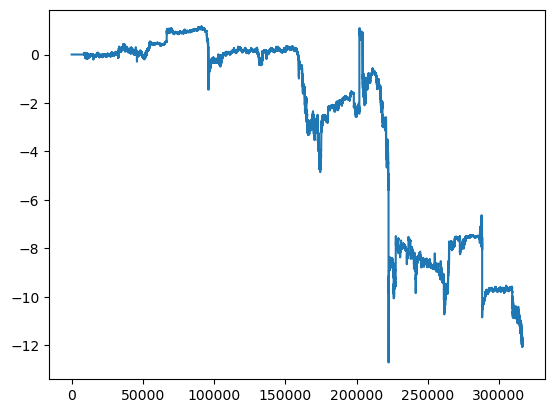

bnb_btc


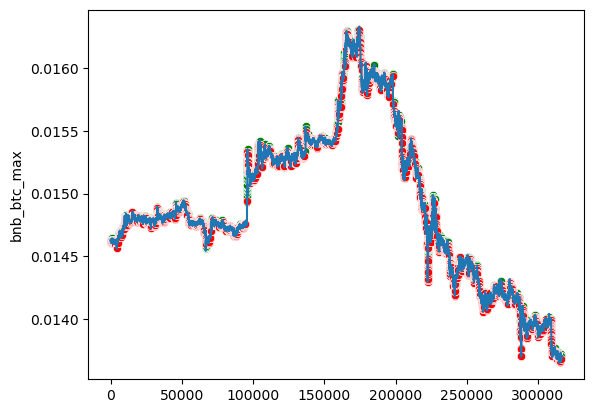

eth_btc


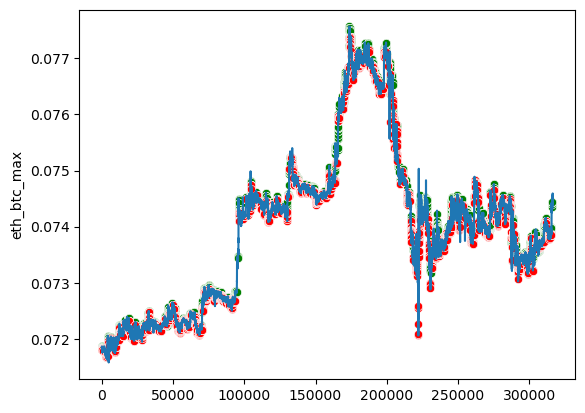

bnb_eth


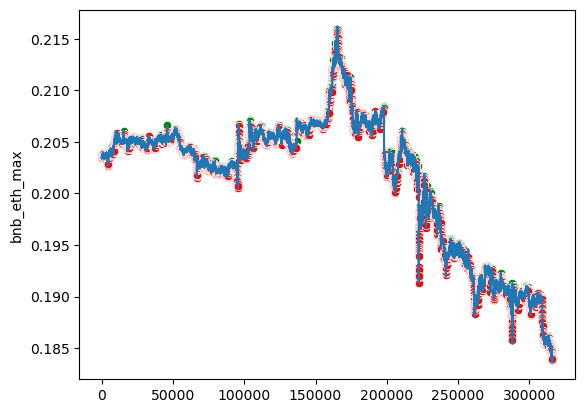

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 80, loss: 0.052
Traid counts: 30791 1: 4975 2: 4407 3: 1981 4: 4800 5: 7733 6: 6895
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.37      0.02       127
         2.0       0.01      0.33      0.02       129
         3.0       0.01      0.20      0.01        71
         4.0       0.01      0.37      0.01        70
         5.0       0.01      0.49      0.02       126
         6.0       0.01      0.53      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.46      0.15    316552
weighted avg       1.00      0.90      0.95    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 369.2239598666959
Общая комиссия в usdt: 3.7374860474460645
Число сделок: 209
Прибыль от 300 usdt за 

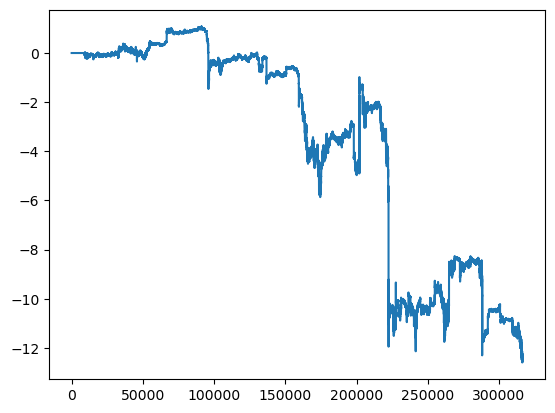

bnb_btc


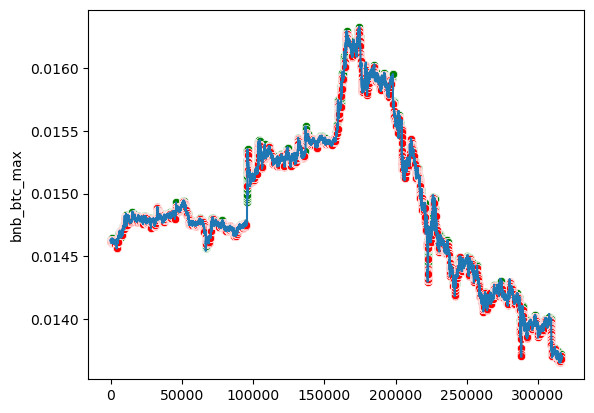

eth_btc


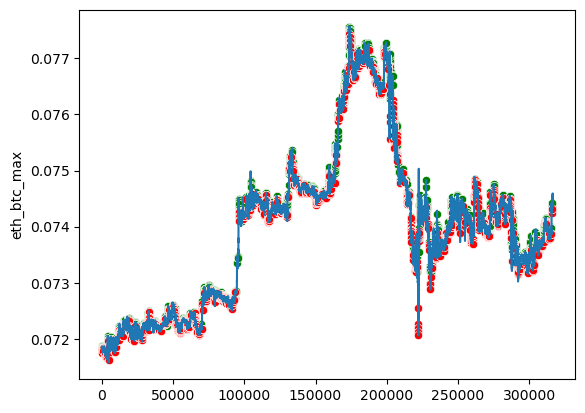

bnb_eth


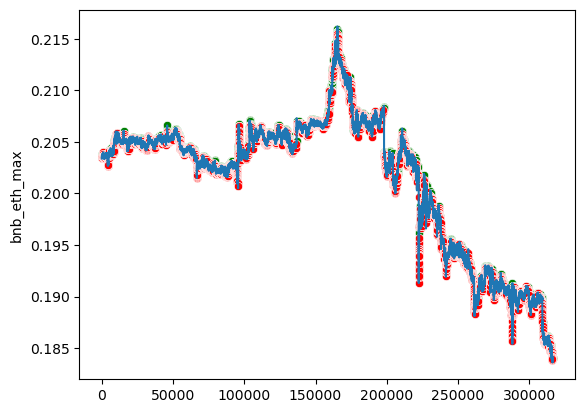

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 81, loss: 0.050
Traid counts: 31148 1: 4832 2: 4775 3: 2365 4: 4814 5: 7654 6: 6708
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.36      0.02       127
         2.0       0.01      0.35      0.02       129
         3.0       0.01      0.23      0.01        71
         4.0       0.01      0.39      0.01        70
         5.0       0.01      0.49      0.02       126
         6.0       0.01      0.47      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.46      0.15    316552
weighted avg       1.00      0.90      0.95    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 375.0130081202938
Общая комиссия в usdt: 3.797125117858536
Число сделок: 209
Прибыль от 300 usdt за 1

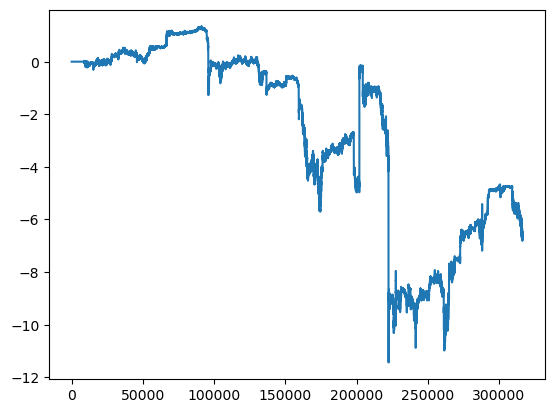

bnb_btc


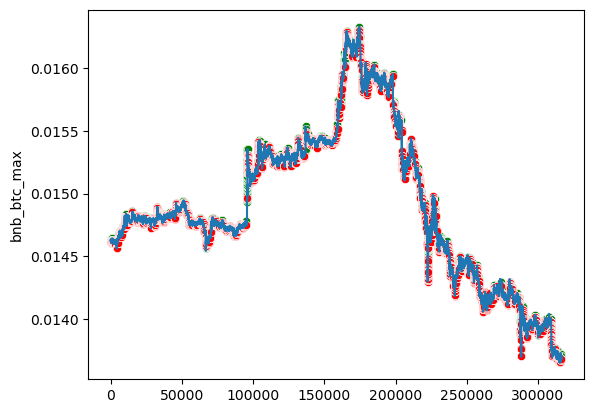

eth_btc


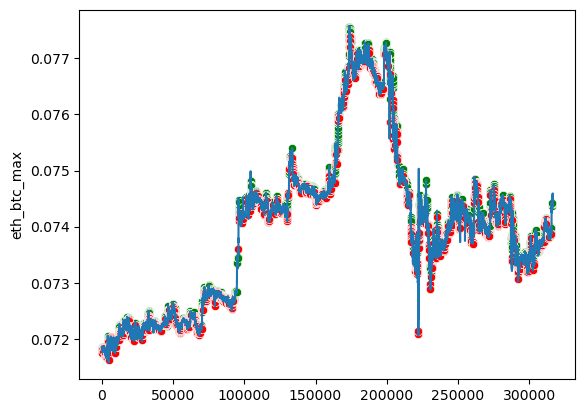

bnb_eth


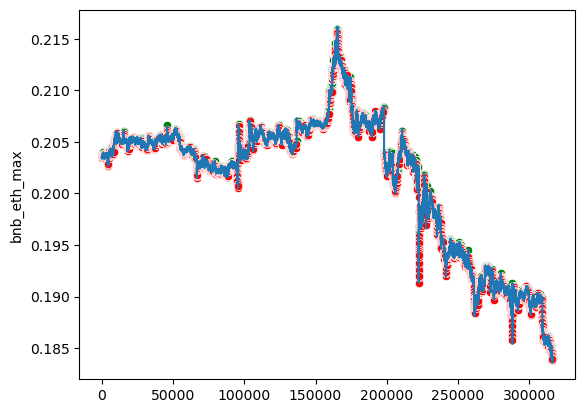

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 82, loss: 0.045
Traid counts: 31393 1: 5383 2: 4658 3: 2574 4: 4788 5: 6950 6: 7040
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.41      0.02       127
         2.0       0.01      0.35      0.02       129
         3.0       0.01      0.24      0.01        71
         4.0       0.01      0.36      0.01        70
         5.0       0.01      0.49      0.02       126
         6.0       0.01      0.45      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.46      0.15    316552
weighted avg       1.00      0.90      0.95    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 370.087489426111
Общая комиссия в usdt: 3.860414209360777
Число сделок: 212
Прибыль от 300 usdt за 10

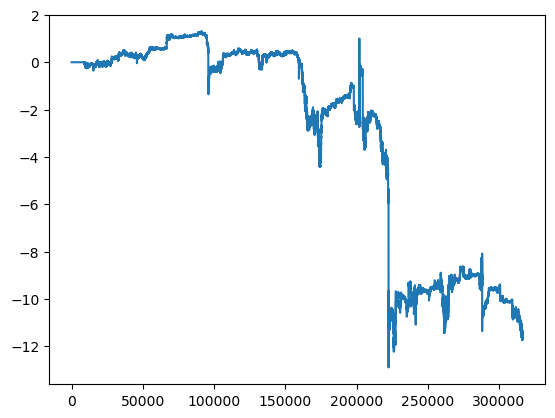

bnb_btc


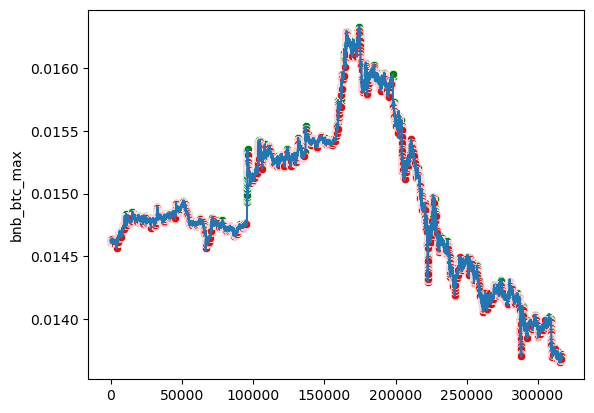

eth_btc


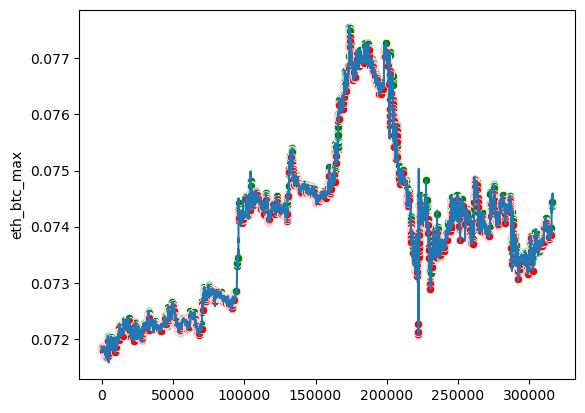

bnb_eth


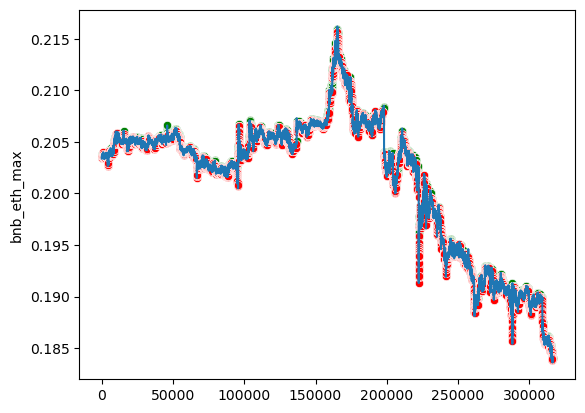

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 83, loss: 0.044
Traid counts: 32823 1: 4354 2: 5808 3: 2345 4: 5272 5: 7166 6: 7878
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.35      0.02       127
         2.0       0.01      0.39      0.02       129
         3.0       0.01      0.28      0.02        71
         4.0       0.01      0.49      0.01        70
         5.0       0.01      0.46      0.02       126
         6.0       0.01      0.53      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.48      0.15    316552
weighted avg       1.00      0.90      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 370.9309704959729
Общая комиссия в usdt: 3.276033291927754
Число сделок: 182
Прибыль от 300 usdt за 1

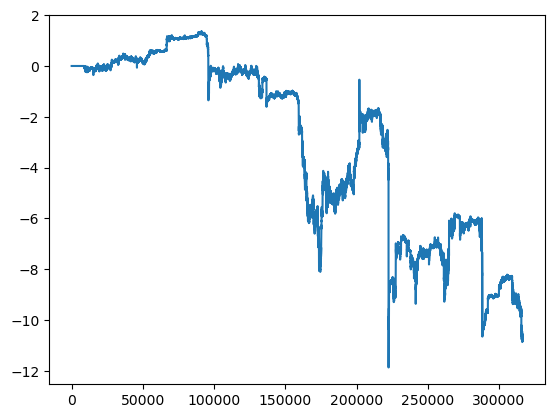

bnb_btc


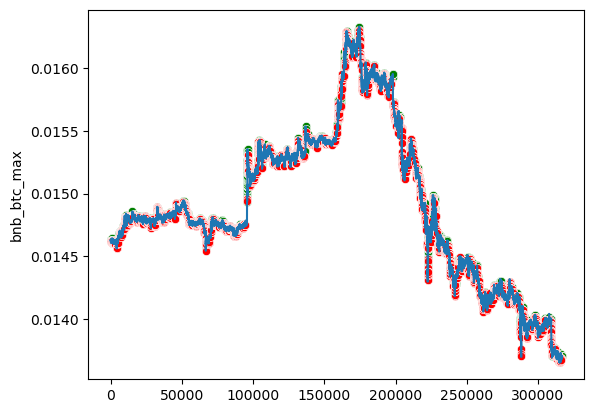

eth_btc


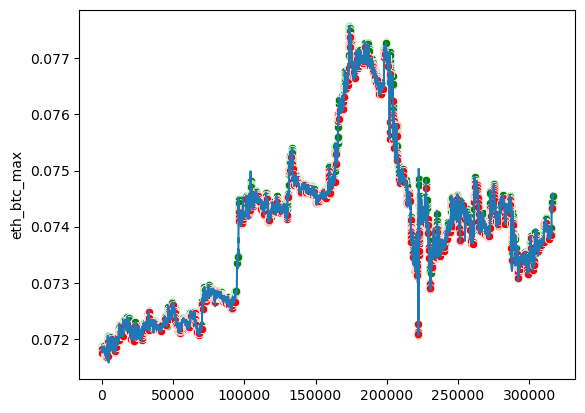

bnb_eth


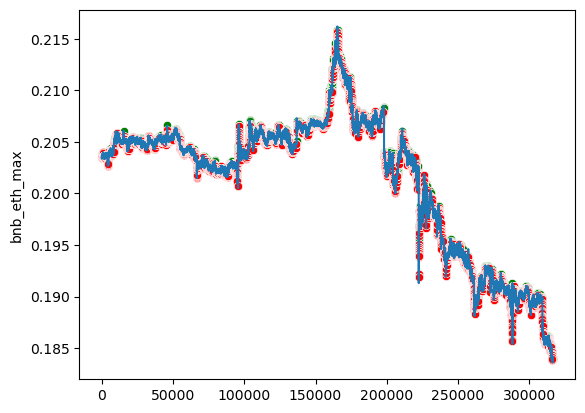

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 84, loss: 0.051
Traid counts: 29738 1: 4725 2: 4097 3: 2249 4: 4122 5: 7207 6: 7338
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    315897
         1.0       0.01      0.42      0.02       127
         2.0       0.01      0.33      0.02       129
         3.0       0.01      0.27      0.02        71
         4.0       0.01      0.30      0.01        70
         5.0       0.01      0.52      0.02       126
         6.0       0.01      0.52      0.02       132

    accuracy                           0.91    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.91      0.95    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 366.80695373449134
Общая комиссия в usdt: 3.647307593792858
Число сделок: 199
Прибыль от 300 usdt за 

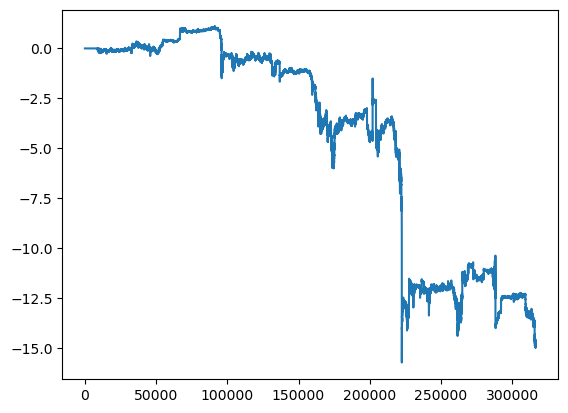

bnb_btc


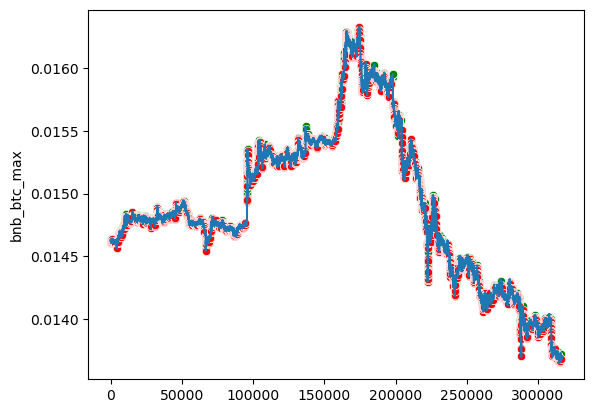

eth_btc


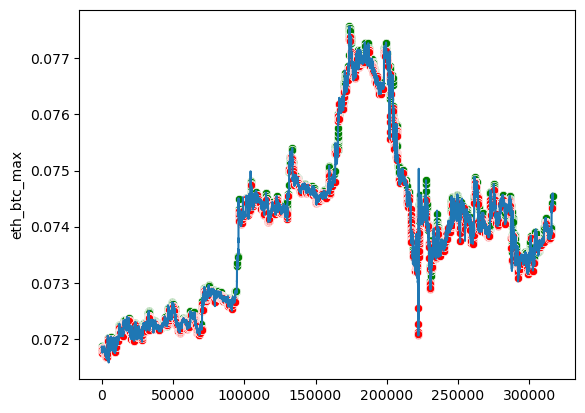

bnb_eth


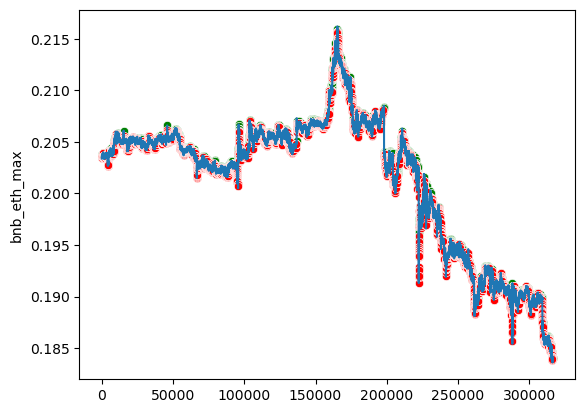

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 85, loss: 0.048
Traid counts: 30865 1: 4811 2: 4079 3: 2279 4: 4912 5: 7760 6: 7024
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.40      0.02       127
         2.0       0.01      0.30      0.02       129
         3.0       0.01      0.23      0.01        71
         4.0       0.01      0.43      0.01        70
         5.0       0.01      0.57      0.02       126
         6.0       0.01      0.48      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.90      0.95    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 369.3676118330567
Общая комиссия в usdt: 3.7144294762038816
Число сделок: 207
Прибыль от 300 usdt за 

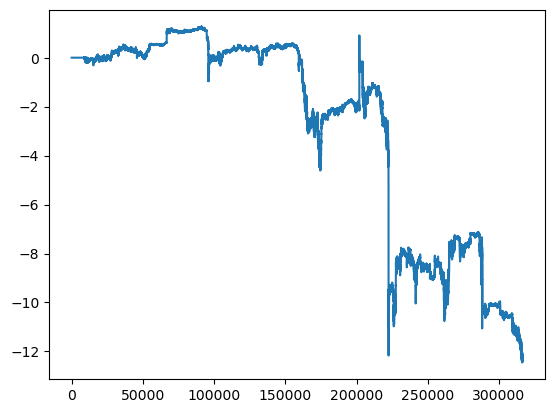

bnb_btc


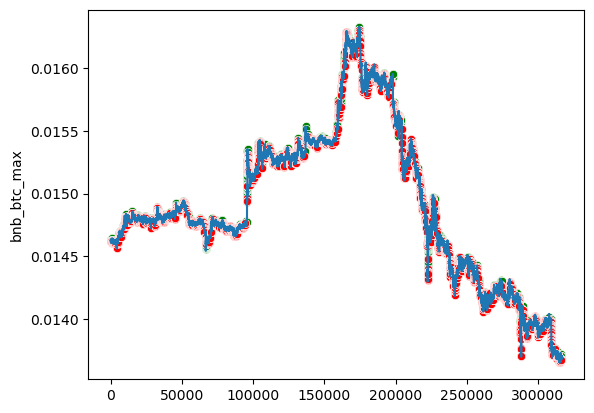

eth_btc


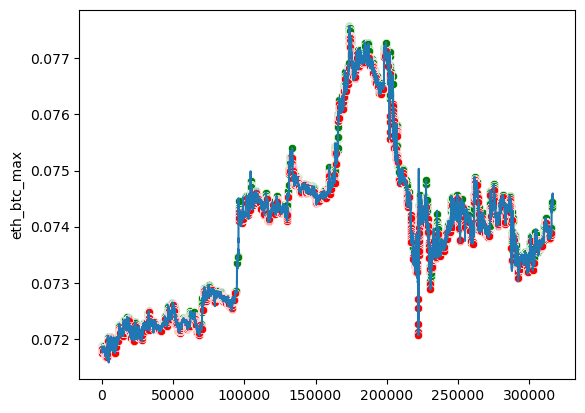

bnb_eth


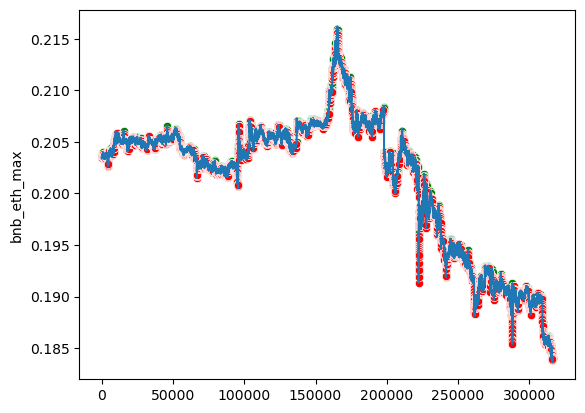

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 86, loss: 0.043
Traid counts: 31597 1: 4732 2: 4755 3: 2534 4: 4646 5: 7673 6: 7257
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.40      0.02       127
         2.0       0.01      0.37      0.02       129
         3.0       0.01      0.25      0.01        71
         4.0       0.01      0.41      0.01        70
         5.0       0.01      0.49      0.02       126
         6.0       0.01      0.45      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.90      0.95    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 374.641571024399
Общая комиссия в usdt: 3.5061638423690202
Число сделок: 180
Прибыль от 300 usdt за 1

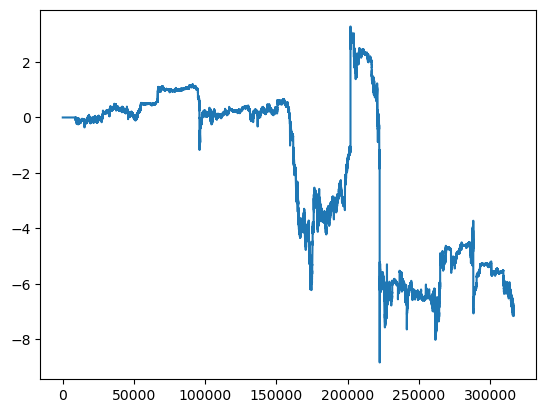

bnb_btc


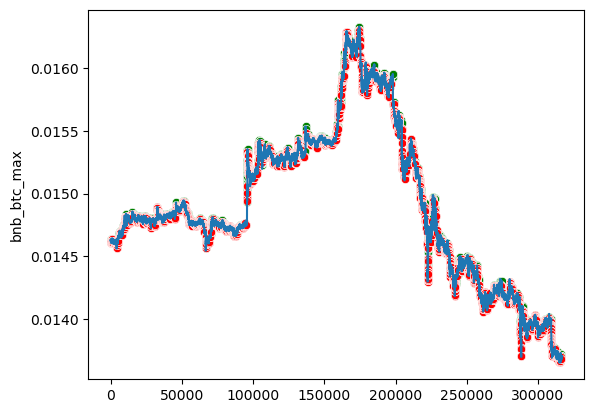

eth_btc


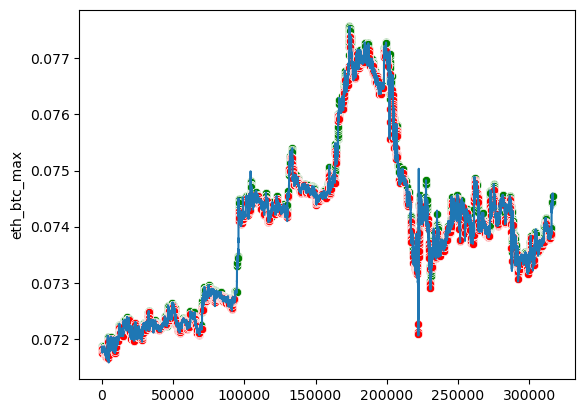

bnb_eth


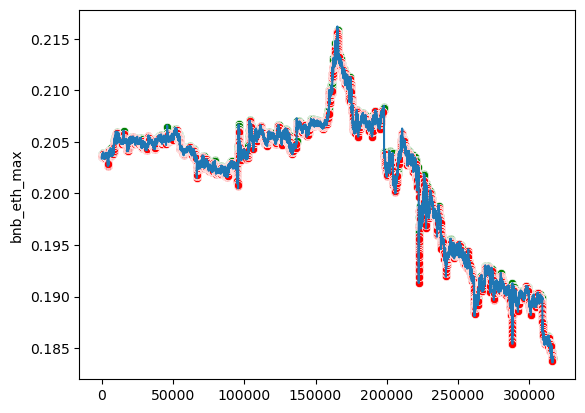

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 87, loss: 0.043
Traid counts: 32425 1: 4972 2: 5596 3: 2412 4: 4350 5: 8054 6: 7041
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.36      0.02       127
         2.0       0.01      0.38      0.02       129
         3.0       0.01      0.25      0.01        71
         4.0       0.01      0.39      0.01        70
         5.0       0.01      0.52      0.02       126
         6.0       0.01      0.44      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.46      0.15    316552
weighted avg       1.00      0.90      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 375.4516980331289
Общая комиссия в usdt: 3.7760773601739506
Число сделок: 204
Прибыль от 300 usdt за 

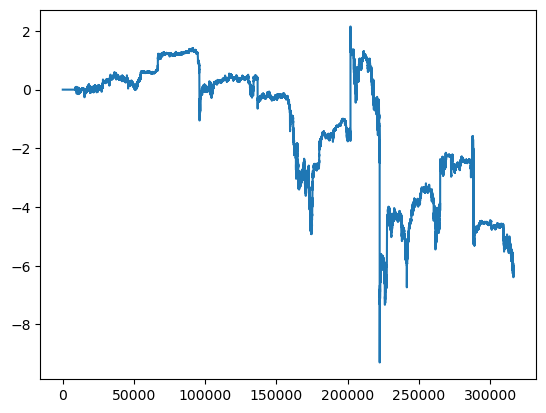

bnb_btc


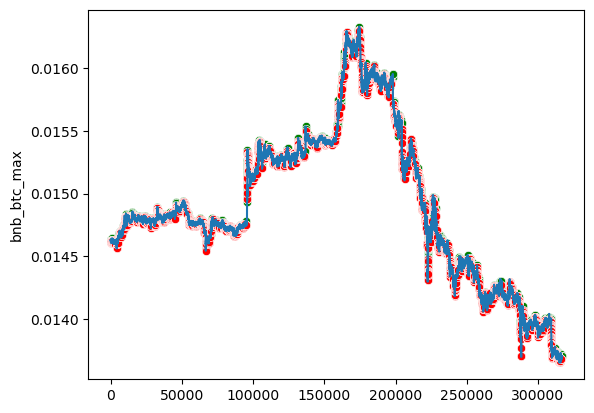

eth_btc


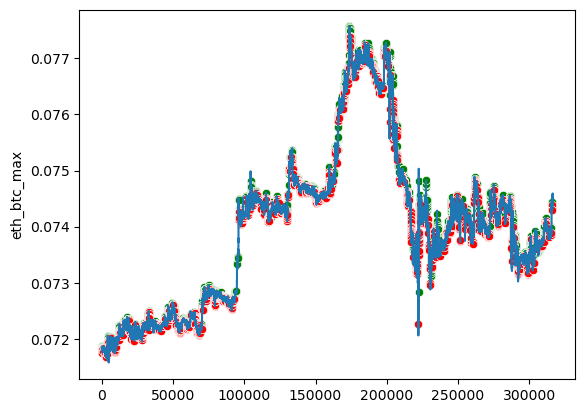

bnb_eth


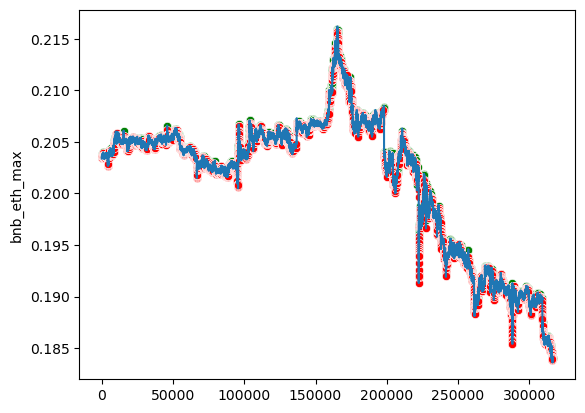

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 88, loss: 0.050
Traid counts: 33023 1: 5245 2: 4984 3: 2435 4: 5181 5: 6704 6: 8474
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.41      0.02       127
         2.0       0.01      0.36      0.02       129
         3.0       0.01      0.27      0.02        71
         4.0       0.01      0.43      0.01        70
         5.0       0.01      0.54      0.02       126
         6.0       0.01      0.57      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.50      0.15    316552
weighted avg       1.00      0.90      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 371.9984803415996
Общая комиссия в usdt: 3.4241354009355858
Число сделок: 189
Прибыль от 300 usdt за 

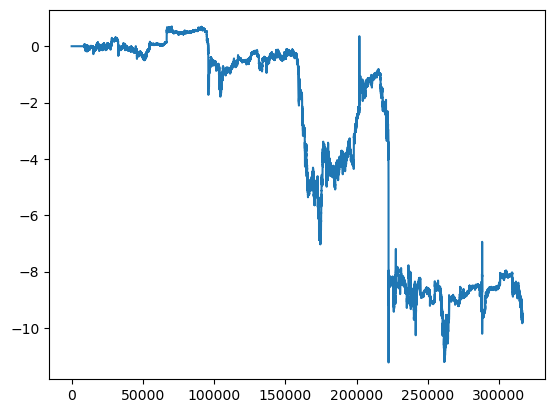

bnb_btc


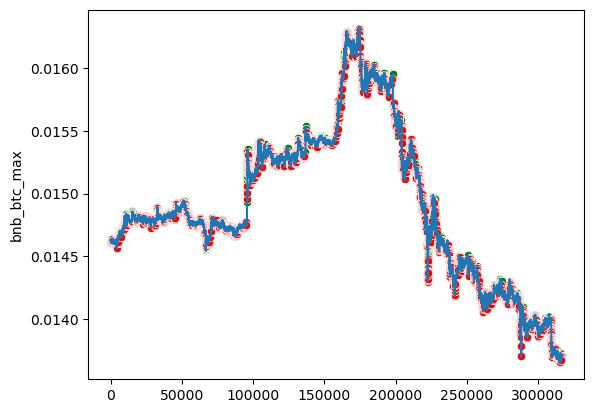

eth_btc


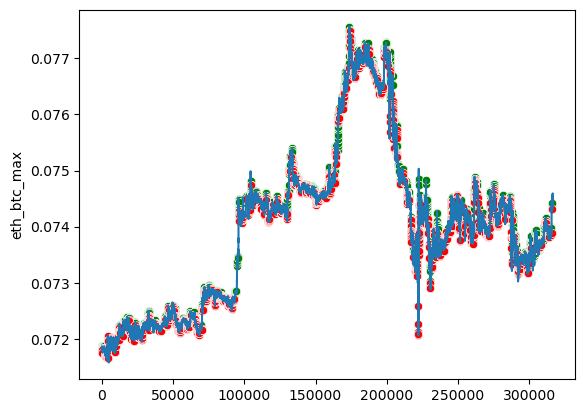

bnb_eth


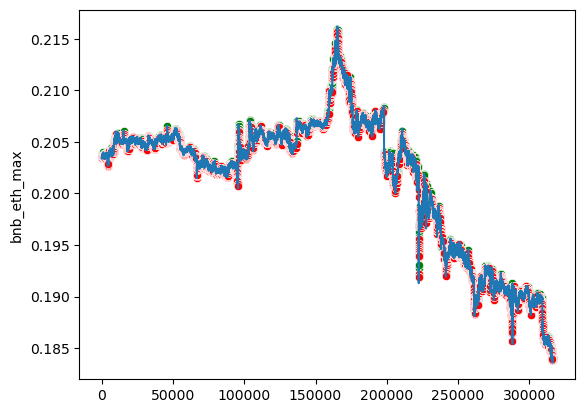

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 89, loss: 0.050
Traid counts: 30106 1: 4728 2: 4601 3: 2433 4: 4424 5: 6953 6: 6967
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    315897
         1.0       0.01      0.41      0.02       127
         2.0       0.01      0.45      0.02       129
         3.0       0.01      0.24      0.01        71
         4.0       0.01      0.41      0.01        70
         5.0       0.01      0.50      0.02       126
         6.0       0.01      0.47      0.02       132

    accuracy                           0.91    316552
   macro avg       0.15      0.48      0.15    316552
weighted avg       1.00      0.91      0.95    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 370.11242993011047
Общая комиссия в usdt: 3.3640648084437594
Число сделок: 178
Прибыль от 300 usdt за

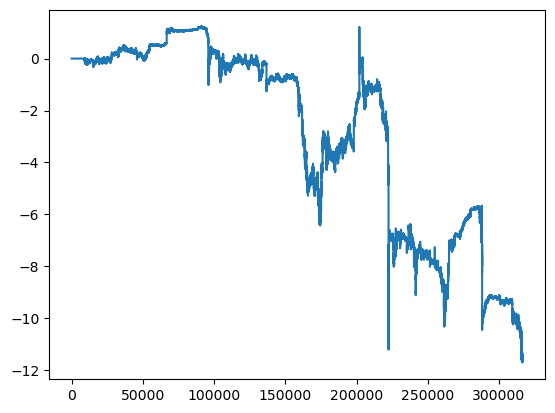

bnb_btc


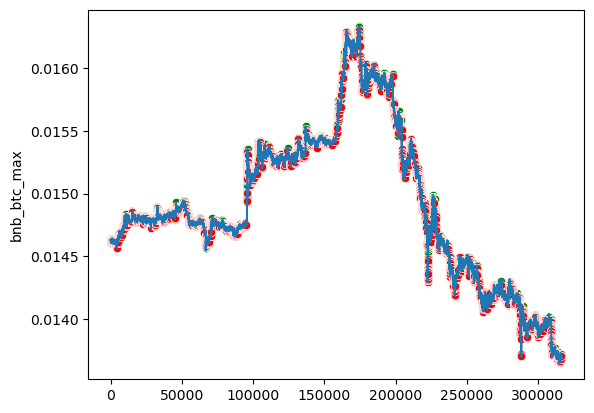

eth_btc


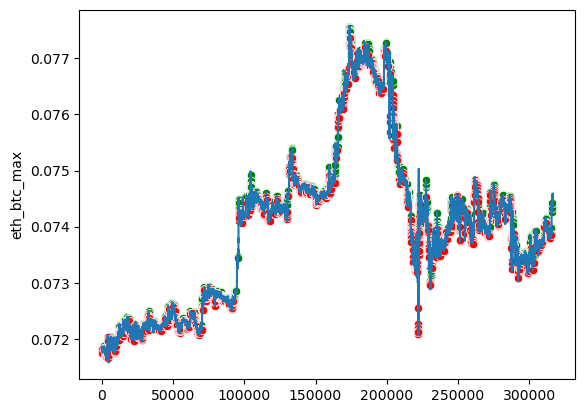

bnb_eth


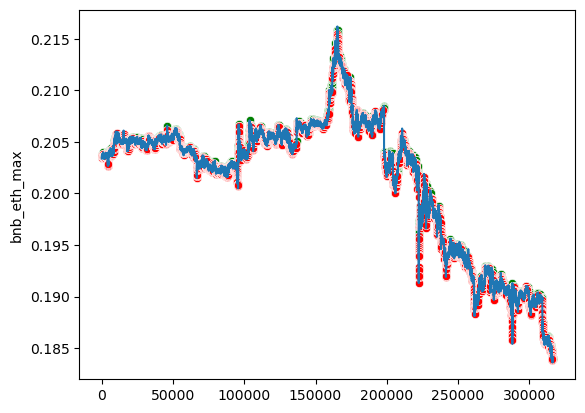

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 90, loss: 0.042
Traid counts: 31647 1: 4370 2: 4805 3: 2301 4: 4570 5: 7714 6: 7887
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.35      0.02       127
         2.0       0.01      0.40      0.02       129
         3.0       0.01      0.21      0.01        71
         4.0       0.01      0.41      0.01        70
         5.0       0.01      0.55      0.02       126
         6.0       0.01      0.48      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.90      0.95    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 371.6020413923864
Общая комиссия в usdt: 3.8153017938943954
Число сделок: 208
Прибыль от 300 usdt за 

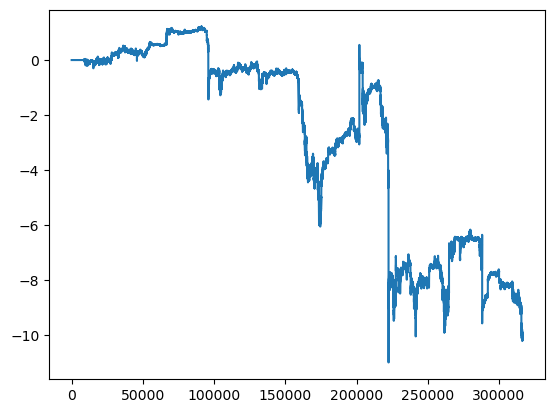

bnb_btc


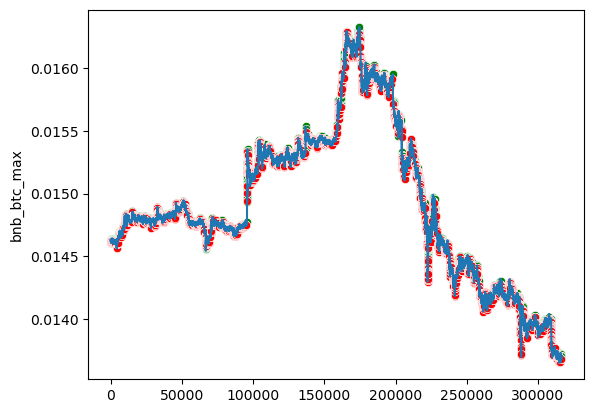

eth_btc


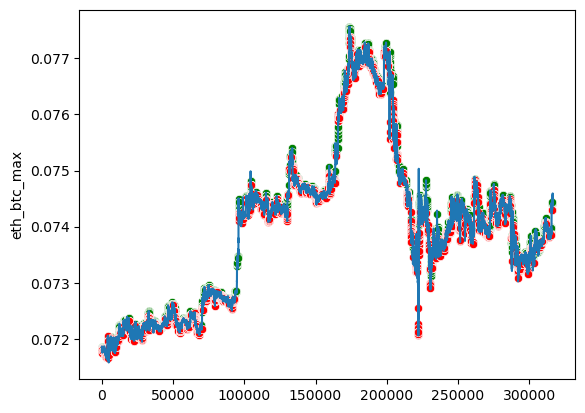

bnb_eth


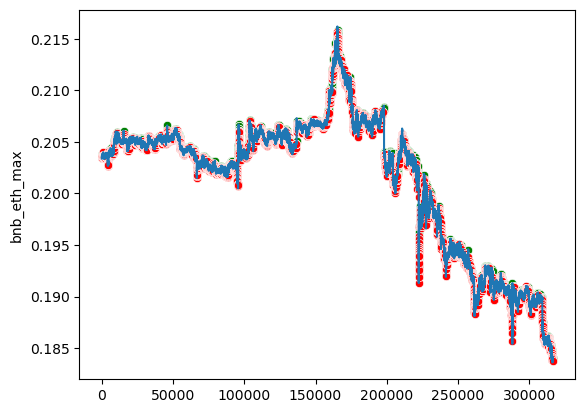

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 91, loss: 0.042
Traid counts: 34891 1: 4204 2: 5450 3: 2961 4: 4233 5: 9032 6: 9011
              precision    recall  f1-score   support

         0.0       1.00      0.89      0.94    315897
         1.0       0.01      0.36      0.02       127
         2.0       0.01      0.43      0.02       129
         3.0       0.01      0.32      0.02        71
         4.0       0.01      0.36      0.01        70
         5.0       0.01      0.53      0.01       126
         6.0       0.01      0.57      0.02       132

    accuracy                           0.89    316552
   macro avg       0.15      0.50      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 371.57762640444355
Общая комиссия в usdt: 3.7957312716025764
Число сделок: 202
Прибыль от 300 usdt за

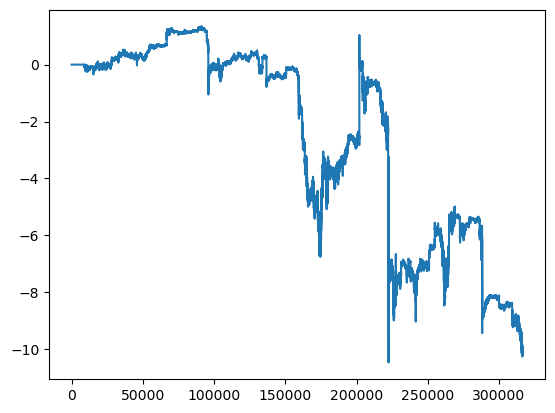

bnb_btc


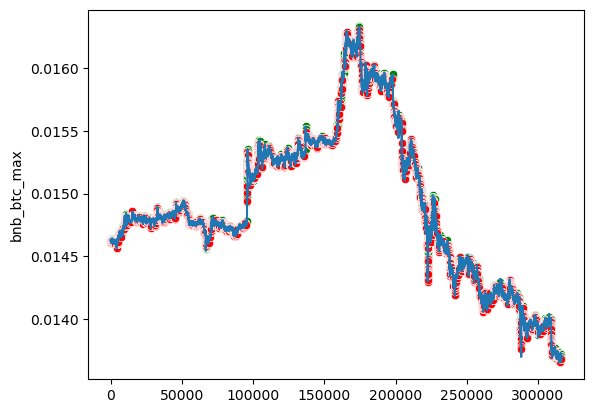

eth_btc


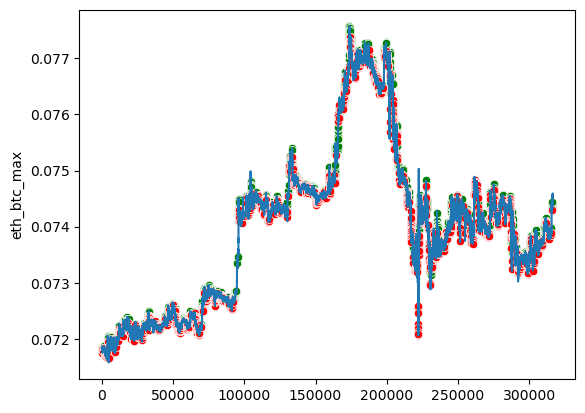

bnb_eth


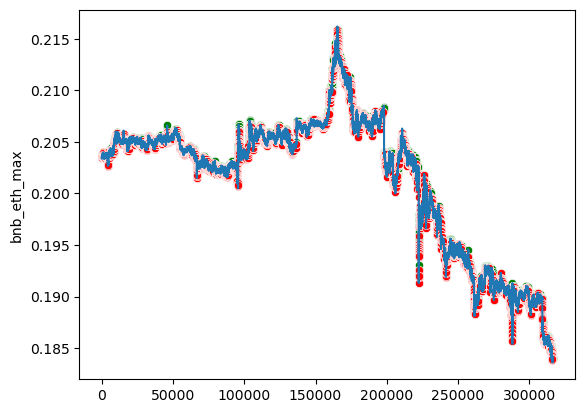

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 92, loss: 0.049
Traid counts: 32071 1: 4050 2: 4829 3: 3170 4: 5683 5: 7073 6: 7266
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.35      0.02       127
         2.0       0.01      0.36      0.02       129
         3.0       0.01      0.30      0.01        71
         4.0       0.00      0.34      0.01        70
         5.0       0.01      0.51      0.02       126
         6.0       0.01      0.52      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.90      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 368.0238845657126
Общая комиссия в usdt: 3.5017742323171674
Число сделок: 196
Прибыль от 300 usdt за 

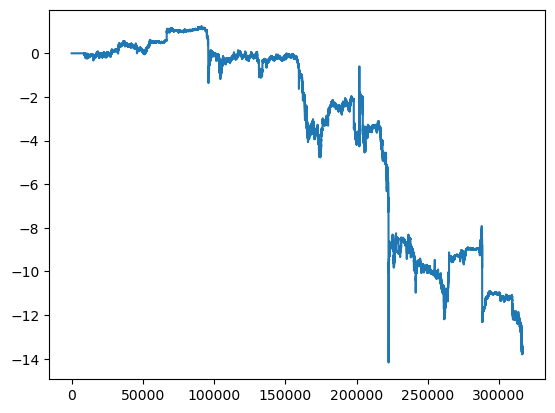

bnb_btc


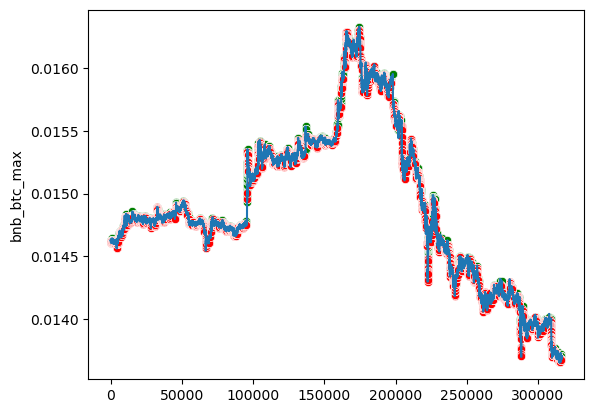

eth_btc


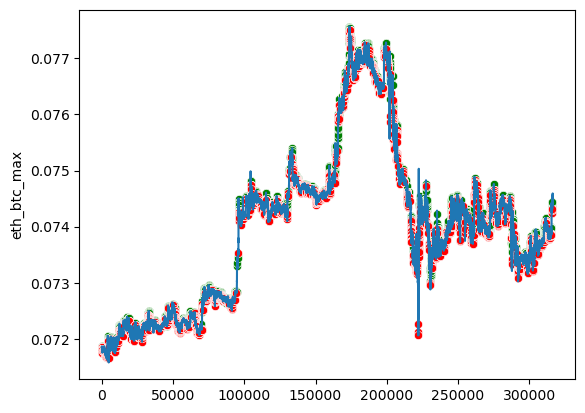

bnb_eth


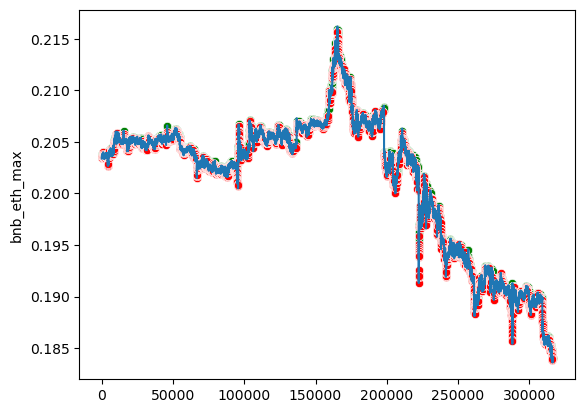

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 93, loss: 0.042
Traid counts: 32050 1: 4728 2: 5102 3: 2432 4: 5743 5: 7291 6: 6754
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.34      0.02       127
         2.0       0.01      0.40      0.02       129
         3.0       0.01      0.28      0.02        71
         4.0       0.01      0.41      0.01        70
         5.0       0.01      0.45      0.02       126
         6.0       0.01      0.50      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.90      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 374.89983015088114
Общая комиссия в usdt: 3.377370230564162
Число сделок: 184
Прибыль от 300 usdt за 

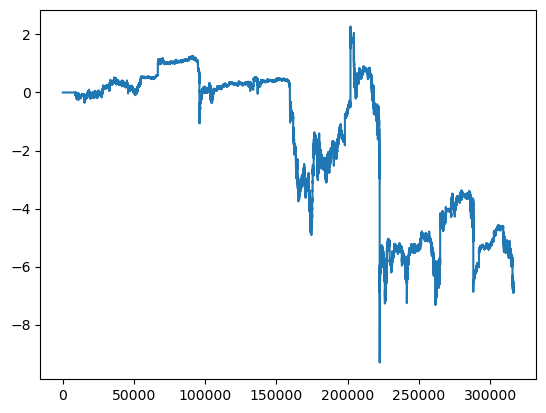

bnb_btc


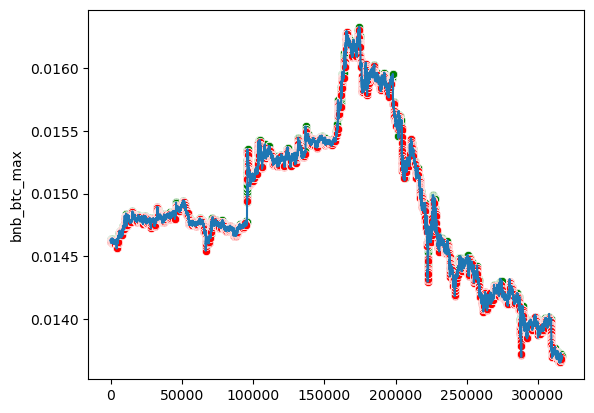

eth_btc


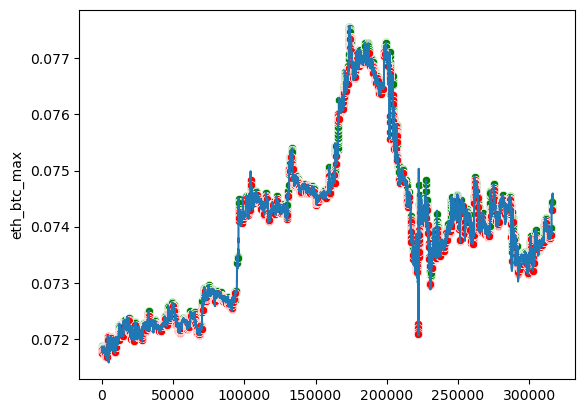

bnb_eth


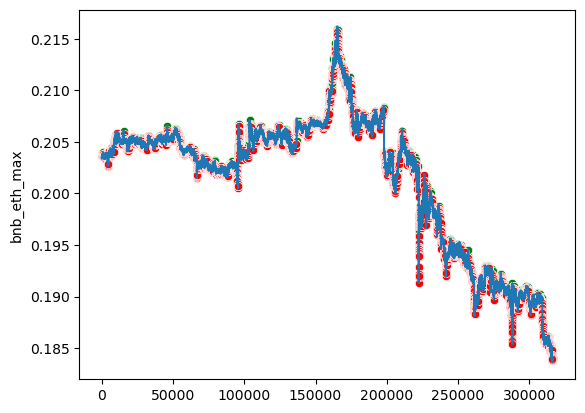

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 94, loss: 0.045
Traid counts: 33320 1: 3667 2: 4916 3: 2685 4: 5545 5: 8459 6: 8048
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.94    315897
         1.0       0.01      0.28      0.02       127
         2.0       0.01      0.36      0.02       129
         3.0       0.01      0.27      0.01        71
         4.0       0.00      0.37      0.01        70
         5.0       0.01      0.48      0.01       126
         6.0       0.01      0.52      0.02       132

    accuracy                           0.89    316552
   macro avg       0.15      0.45      0.15    316552
weighted avg       1.00      0.89      0.94    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 369.8780841648964
Общая комиссия в usdt: 3.2618438009556168
Число сделок: 182
Прибыль от 300 usdt за 

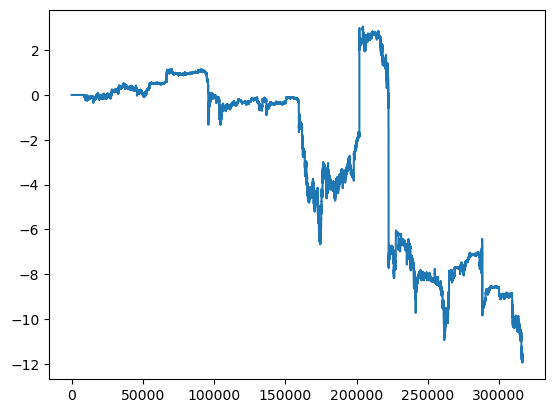

bnb_btc


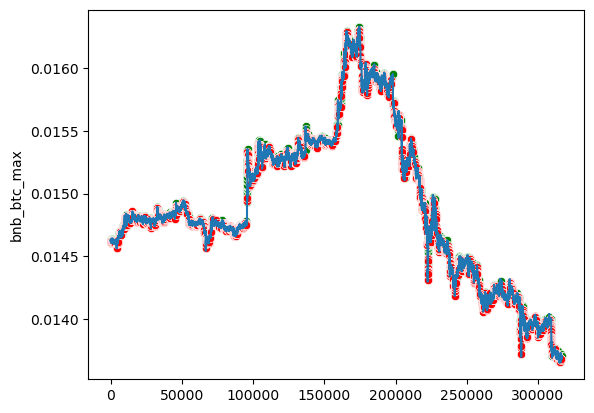

eth_btc


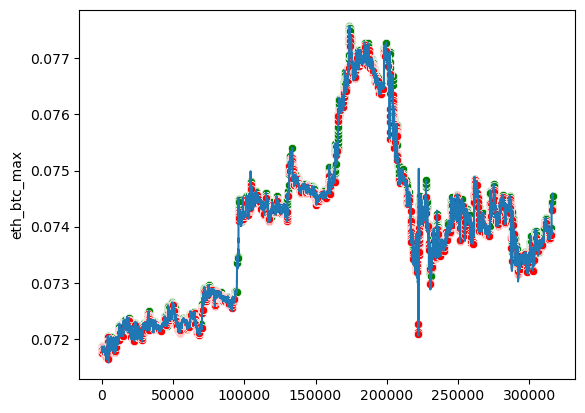

bnb_eth


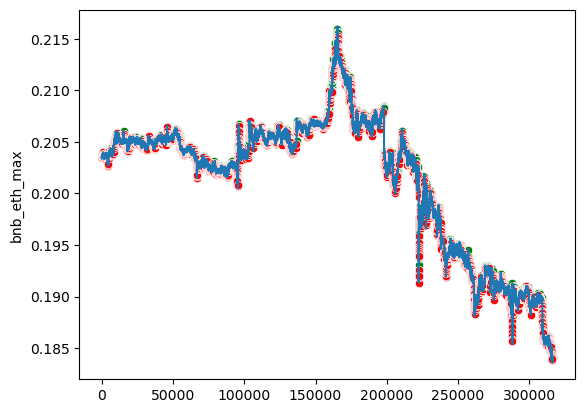

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 95, loss: 0.042
Traid counts: 29995 1: 4196 2: 5043 3: 2417 4: 4768 5: 6737 6: 6834
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    315897
         1.0       0.01      0.34      0.02       127
         2.0       0.01      0.40      0.02       129
         3.0       0.01      0.27      0.02        71
         4.0       0.01      0.34      0.01        70
         5.0       0.01      0.48      0.02       126
         6.0       0.01      0.52      0.02       132

    accuracy                           0.91    316552
   macro avg       0.15      0.46      0.15    316552
weighted avg       1.00      0.91      0.95    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 370.6067031316101
Общая комиссия в usdt: 3.6935192765951856
Число сделок: 204
Прибыль от 300 usdt за 

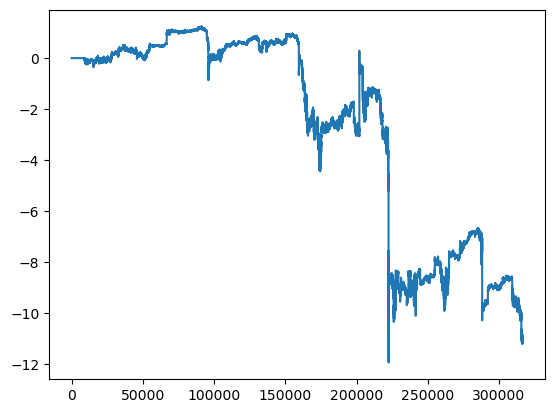

bnb_btc


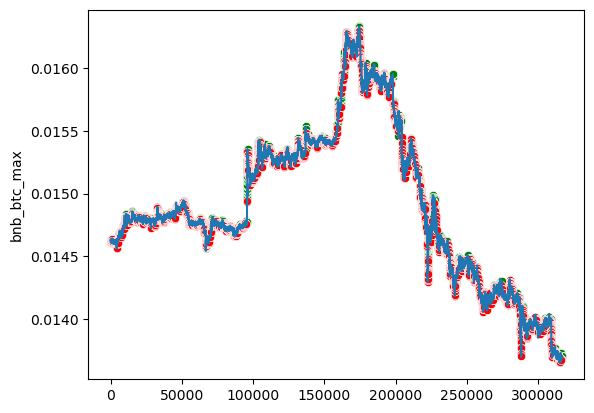

eth_btc


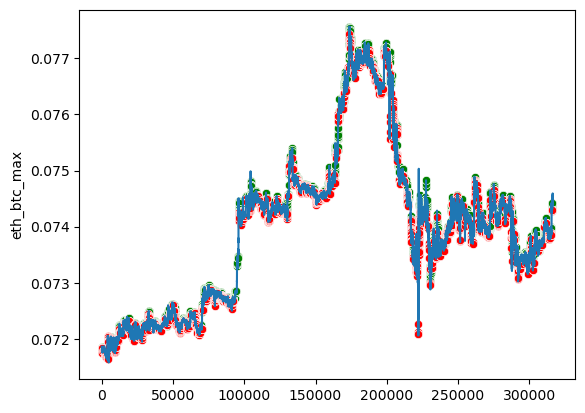

bnb_eth


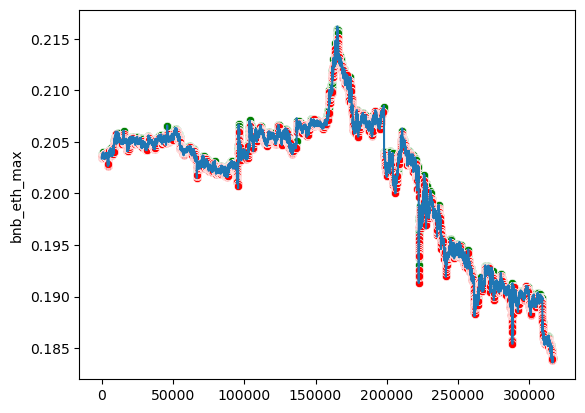

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 96, loss: 0.044
Traid counts: 30288 1: 4414 2: 4044 3: 2304 4: 5163 5: 7000 6: 7363
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    315897
         1.0       0.01      0.34      0.02       127
         2.0       0.01      0.34      0.02       129
         3.0       0.01      0.23      0.01        71
         4.0       0.01      0.46      0.01        70
         5.0       0.01      0.48      0.02       126
         6.0       0.01      0.53      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.47      0.15    316552
weighted avg       1.00      0.90      0.95    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 371.6144796216578
Общая комиссия в usdt: 3.4598036367142035
Число сделок: 191
Прибыль от 300 usdt за 

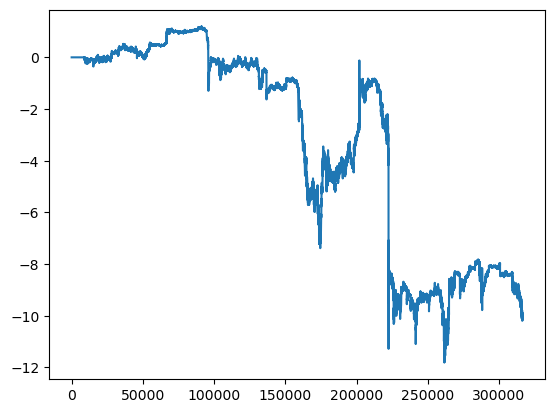

bnb_btc


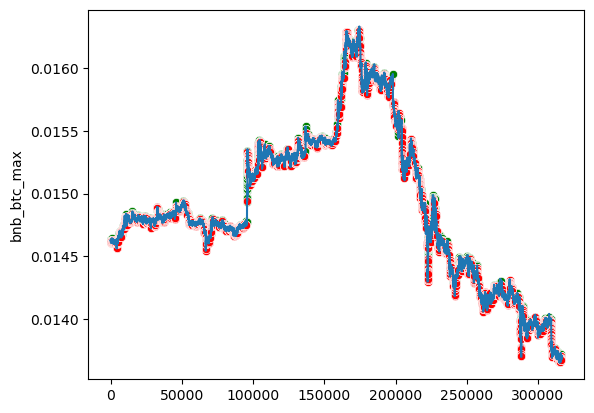

eth_btc


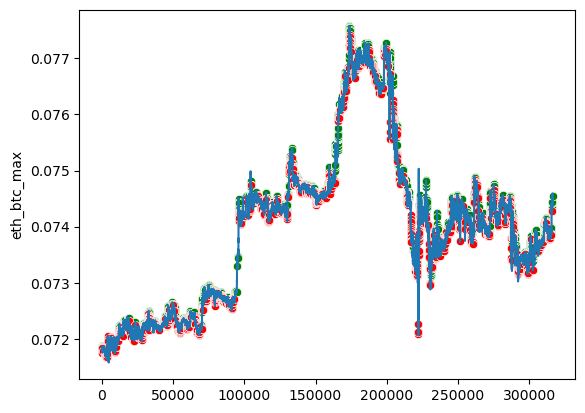

bnb_eth


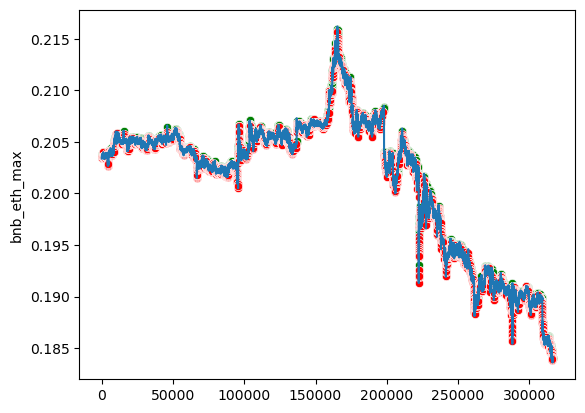

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 97, loss: 0.041
Traid counts: 30987 1: 4549 2: 4725 3: 2836 4: 4301 5: 8185 6: 6391
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.33      0.02       127
         2.0       0.01      0.36      0.02       129
         3.0       0.01      0.31      0.02        71
         4.0       0.01      0.34      0.01        70
         5.0       0.01      0.46      0.01       126
         6.0       0.01      0.46      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.45      0.15    316552
weighted avg       1.00      0.90      0.95    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 370.89665935281647
Общая комиссия в usdt: 3.296094387453781
Число сделок: 175
Прибыль от 300 usdt за 

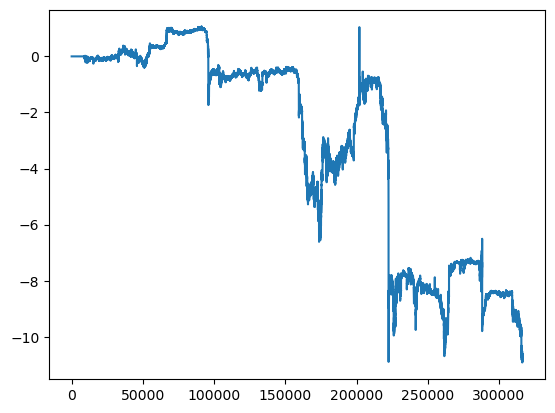

bnb_btc


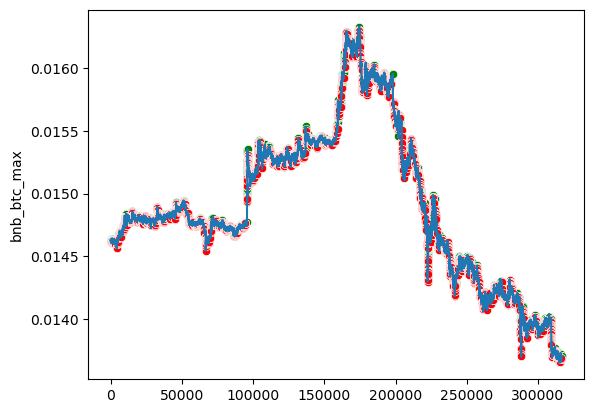

eth_btc


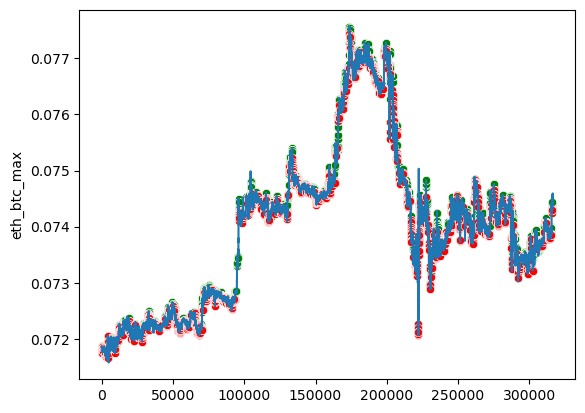

bnb_eth


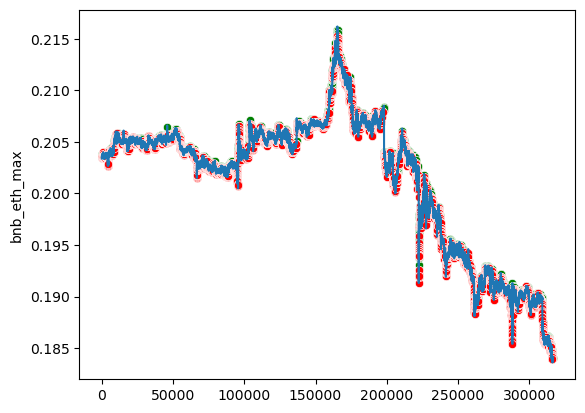

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 98, loss: 0.041
Traid counts: 30755 1: 4370 2: 4427 3: 2623 4: 4037 5: 7085 6: 8213
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.32      0.02       127
         2.0       0.01      0.31      0.02       129
         3.0       0.01      0.32      0.02        71
         4.0       0.01      0.41      0.01        70
         5.0       0.01      0.54      0.02       126
         6.0       0.01      0.52      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.48      0.15    316552
weighted avg       1.00      0.90      0.95    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 374.1315128176439
Общая комиссия в usdt: 3.558307730807221
Число сделок: 191
Прибыль от 300 usdt за 1

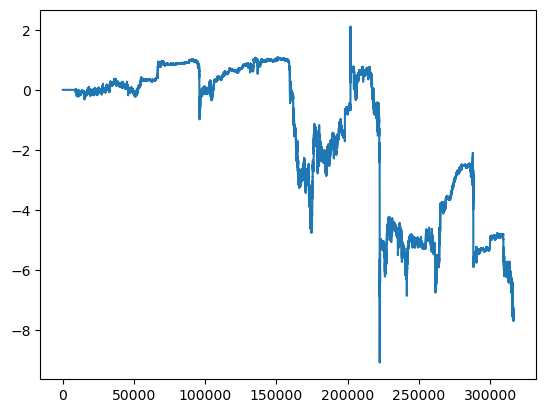

bnb_btc


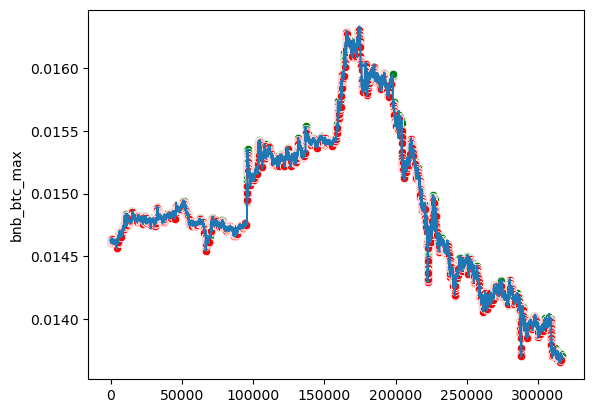

eth_btc


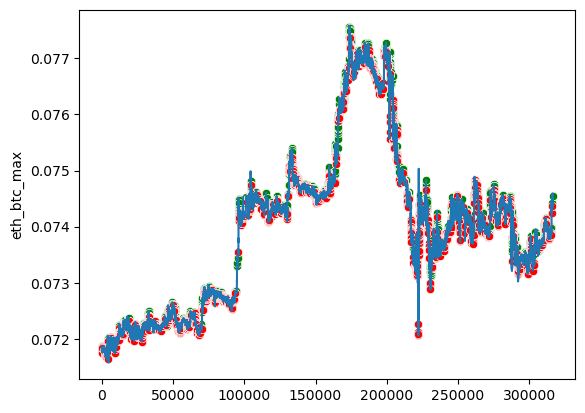

bnb_eth


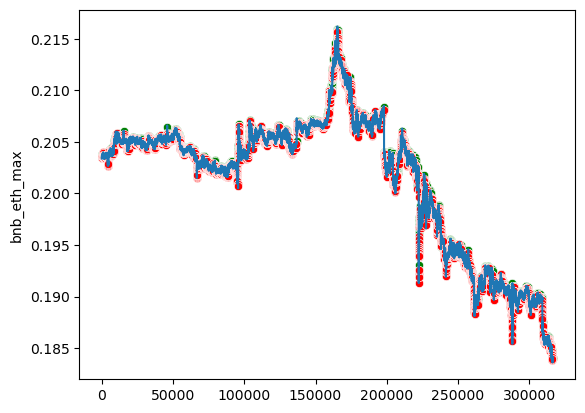

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 99, loss: 0.037
Traid counts: 28344 1: 4144 2: 4237 3: 2333 4: 4252 5: 6922 6: 6456
              precision    recall  f1-score   support

         0.0       1.00      0.91      0.95    315897
         1.0       0.01      0.34      0.02       127
         2.0       0.01      0.32      0.02       129
         3.0       0.01      0.28      0.02        71
         4.0       0.01      0.34      0.01        70
         5.0       0.01      0.49      0.02       126
         6.0       0.01      0.45      0.02       132

    accuracy                           0.91    316552
   macro avg       0.15      0.45      0.15    316552
weighted avg       1.00      0.91      0.95    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 370.5439701760399
Общая комиссия в usdt: 3.5420322558210087
Число сделок: 203
Прибыль от 300 usdt за 

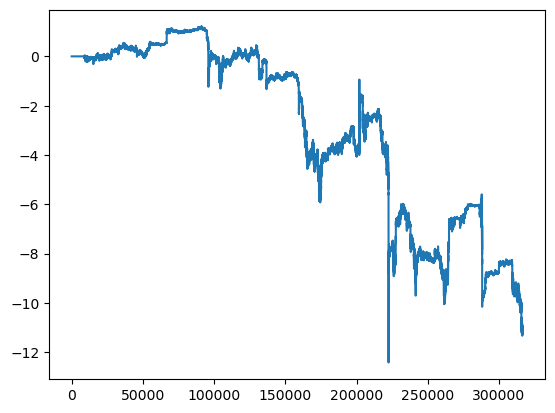

bnb_btc


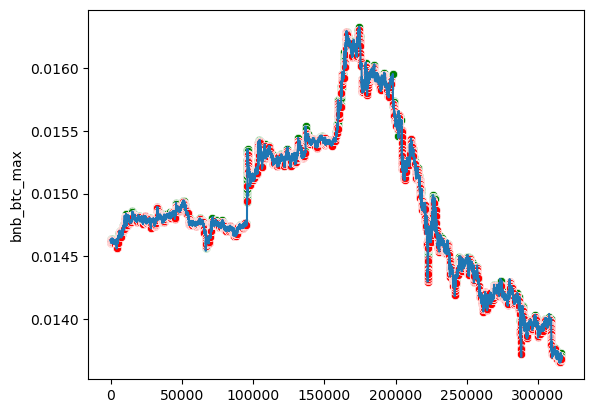

eth_btc


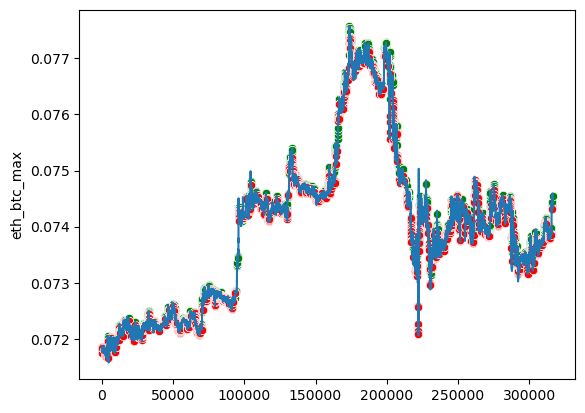

bnb_eth


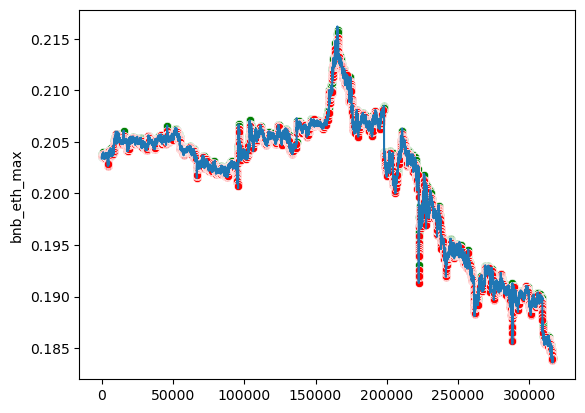

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
Epoch: 100, loss: 0.041
Traid counts: 30765 1: 4334 2: 4469 3: 2639 4: 4469 5: 7440 6: 7414
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95    315897
         1.0       0.01      0.32      0.02       127
         2.0       0.01      0.33      0.02       129
         3.0       0.01      0.27      0.01        71
         4.0       0.00      0.29      0.01        70
         5.0       0.01      0.48      0.02       126
         6.0       0.01      0.52      0.02       132

    accuracy                           0.90    316552
   macro avg       0.15      0.44      0.15    316552
weighted avg       1.00      0.90      0.95    316552

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 381.6233017435298
Результат торгов с 300 usdt: 371.25123568800404
Общая комиссия в usdt: 3.690081328667936
Число сделок: 200
Прибыль от 300 usdt за

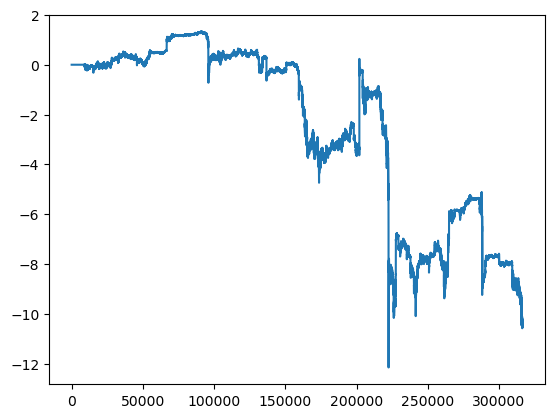

bnb_btc


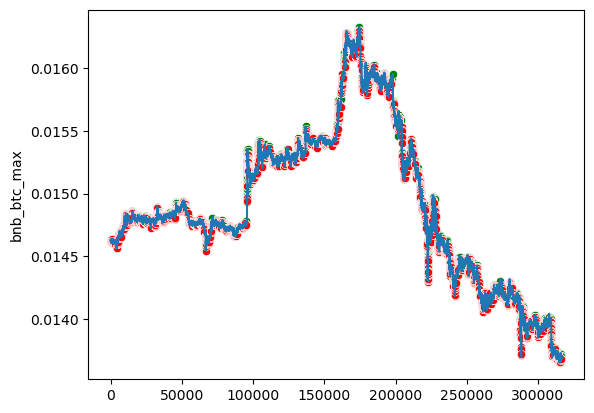

eth_btc


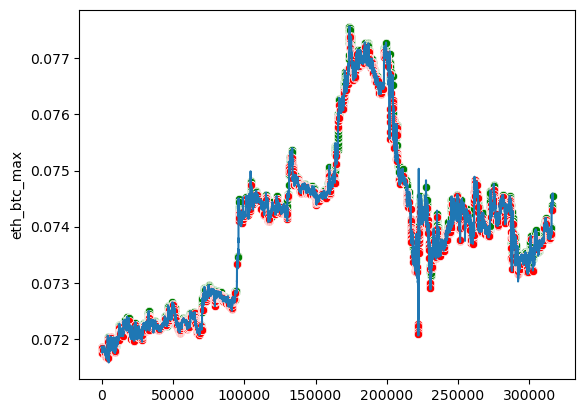

bnb_eth


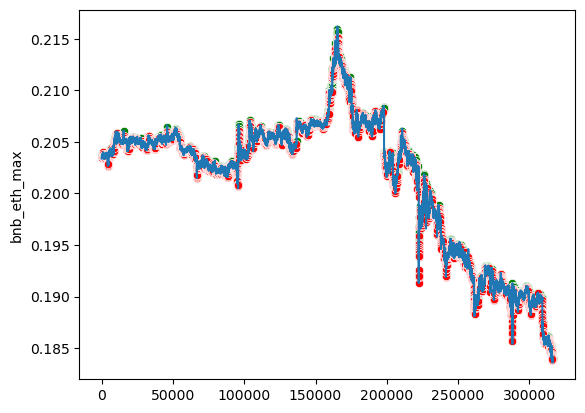

CPU times: total: 6h 25min 10s
Wall time: 4h 25min 5s


In [38]:
%%time

FEE = 0.00075
best_profit = 0

epoch_list = list()
loss_list = list()
traid_counts_list = list()
profit_300_1_list = list()
profit_300_2_list = list()
profit_300_3_list = list()
profit_300_4_list = list()

ticker_price_valid_values = ticker_price_valid.values
ticker_price_valid_fig = ticker_price_valid

res_net_x_gold = ResNet1Dx_Gold().to('cuda')

loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(res_net_x_gold.parameters(), lr=0.001)

for epoch in range(EPOCH):
    loss_array = np.array([], dtype=float)
    for i, batch in enumerate(train_loader):
        optimizer.zero_grad()
        X_batch, X_last_min_max_batch, y_batch = batch
        X_batch = X_batch.to('cuda')
        X_last_min_max_batch = X_last_min_max_batch.to('cuda')
        y_batch = y_batch.to('cuda')
        
        output = res_net_x_gold.forward(X_batch, X_last_min_max_batch)
        loss =loss_fn(output, y_batch)
        loss.backward()
        optimizer.step()
        loss_array = np.append(loss_array, loss.to('cpu').detach().numpy())
    if epoch % 1 == 0:
        
        print('---***---***---***---***---***---***---***---***---***---***---***---***---')
        print('Predict start')
        predict = torch.empty((1), dtype=torch.float).to('cuda')
        y_valid_tensor = torch.empty((1), dtype=torch.float)
        
        #res_net_x_gold.eval()
        
        for i_valid, batch_valid in enumerate(valid_loader):
            X_batch_valid, X_last_min_max_batch_valid, y_batch_valid = batch_valid
            X_batch_valid = X_batch_valid.to('cuda')
            X_last_min_max_batch_valid = X_last_min_max_batch_valid.to('cuda')
            
            predict_batch = torch.argmax(res_net_x_gold.inference(X_batch_valid, X_last_min_max_batch_valid), dim=1)
            predict = torch.cat((predict, predict_batch), 0)
            y_valid_tensor = torch.cat((y_valid_tensor, y_batch_valid), 0)
            
        #res_net_x_gold.train()
        
        predict = predict[1:]
        y_valid_tensor = y_valid_tensor[1:]
        epoch_list.append(epoch)
        loss_mean = loss_array.mean()
        loss_list.append(loss_mean)
        print(f'Epoch: {epoch}, loss: {loss_mean:.3f}')
        traid_counts = (predict!=0).sum()
        traid_counts_list.append(traid_counts)
        print(f'Traid counts: {traid_counts}',
              f'1: {(predict==1).sum()}',
              f'2: {(predict==2).sum()}',
              f'3: {(predict==3).sum()}',
              f'4: {(predict==4).sum()}',
              f'5: {(predict==5).sum()}',
              f'6: {(predict==6).sum()}'
             )
        predict = predict.to('cpu').detach().numpy()
        print(classification_report(y_valid_tensor.detach().numpy(), predict))
        
        for slip_n in range(10,11):
            slip_n = slip_n/10
            print("-------------")
            print(f'SLIP_N = {slip_n}')
            trade_result, trade_btc, trade_eth, trade_bnb, volume_not_trade, trade_start, fee_usdt, trade_count = trade_v2(ticker_price_valid_values, predict, FEE, slip_n)
            trade_result = np.array(trade_result)
            volume_not_trade = np.array(volume_not_trade)
            profit = trade_result - volume_not_trade
            print(f'Без торгов за счёт изменения курса с 300 usdt: {volume_not_trade[-1]}')
            print(f'Результат торгов с 300 usdt: {trade_result[-1]}')
            print(f'Общая комиссия в usdt: {fee_usdt}')
            print(f'Число сделок: {trade_count}')
            profit_300 = (profit[-1])*100_000/predict.shape[0]
            if slip_n == 1:
                profit_300_1_list.append(profit_300)
                if profit_300 > best_profit:
                    np.save('features/ticker_price_valid_values', ticker_price_valid_values, allow_pickle=True, fix_imports=True)
                    np.save('features/predict', predict, allow_pickle=True, fix_imports=True)
                    torch.save(res_net_x_gold, f'res_net_x_gold_{epoch}_{profit_300:.2f}.pt')
                    best_profit = profit_300
            elif slip_n == 2:
                profit_300_2_list.append(profit_300)
            elif slip_n == 3:
                profit_300_3_list.append(profit_300)
            elif slip_n == 4:
                profit_300_4_list.append(profit_300)
            print(f'Прибыль от 300 usdt за 100_000 тиков: {profit_300}')
            print('График прибыли')
            # отрисовка прибыли
            
            sns.lineplot(x=range(profit.shape[0]),y=profit)
            plt.show()

        # отрисовка сделок на тренде
        x_len = predict.shape[0]
        #x_len = 4000

        ticker_price_valid_fig[PAIRS_NAME[3]+'_min'] = ticker_price_valid_values[:,3]*(predict == 1)
        ticker_price_valid_fig[PAIRS_NAME[3]+'_max'] = ticker_price_valid_values[:,3]*(predict == 2)
        ticker_price_valid_fig[PAIRS_NAME[4]+'_min'] = ticker_price_valid_values[:,4]*(predict == 3)
        ticker_price_valid_fig[PAIRS_NAME[4]+'_max'] = ticker_price_valid_values[:,4]*(predict == 4)
        ticker_price_valid_fig[PAIRS_NAME[5]+'_min'] = ticker_price_valid_values[:,5]*(predict == 5)
        ticker_price_valid_fig[PAIRS_NAME[5]+'_max'] = ticker_price_valid_values[:,5]*(predict == 6)
        ticker_price_valid_fig = ticker_price_valid_fig.replace(0, np.nan)

        for i, pair in enumerate(['bnb_btc','eth_btc','bnb_eth']):
            print(pair)
            fig, ax = plt.subplots()
            ax.plot(range(x_len),ticker_price_valid_values[:x_len,i+3])
            #ax.plot(range(x_len),trade_result['bnb_btc_max'][:x_len])
            sns.scatterplot(data=ticker_price_valid_fig[:x_len], x=range(x_len), y=pair+'_max', ax=ax, color='green')
            sns.scatterplot(data=ticker_price_valid_fig[:x_len], x=range(x_len), y=pair+'_min', ax=ax, color='red')
            #plt.ylim([ticker_price_valid_fig[pair+'_min'][:x_len].min(), ticker_price_valid_fig[pair+'_max'][:x_len].max()])
            plt.show()

trade_df = pd.DataFrame(data=[epoch_list, 
                              loss_list, 
                              traid_counts_list, 
                              profit_300_1_list, 
                              profit_300_2_list, 
                              profit_300_3_list, 
                              profit_300_4_list]).T.rename(columns={0:'epoch',
                                                                     1:'loss',
                                                                     2:'traid_counts',
                                                                     3:'profit_300_1',
                                                                     4:'profit_300_2',
                                                                     5:'profit_300_3',
                                                                     6:'profit_300_4'})

## Модель LineNet

In [ ]:
class LineNet(nn.Module):
    def __init__(self):
        super(LineNet,self).__init__()
        
        self.linear_small = nn.Linear(in_features=FEATURES_LENGTH_SMALL*6, out_features=64, bias=True)
        self.bn_small = nn.BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        
        self.linear_medium = nn.Linear(in_features=FEATURES_LENGTH_MEDIUM*6, out_features=256, bias=True)
        self.bn_medium = nn.BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)        
        
        self.linear_big = nn.Linear(in_features=FEATURES_LENGTH_BIG*6, out_features=512, bias=True)
        self.bn_big = nn.BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)        
        
        self.linear_min_max = nn.Linear(in_features=36, out_features=64, bias=True)
        self.bn_min_max = nn.BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)         
        
        self.linear_depth = nn.Linear(in_features=120, out_features=256, bias=True)
        self.bn_depth = nn.BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)        
        
        self.linear2 = nn.Linear(in_features=1152, out_features=1024, bias=True)
        self.bn2 = nn.BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.linear3 = nn.Linear(in_features=1024, out_features=512, bias=True)
        self.bn3 = nn.BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.linear4 = nn.Linear(in_features=512, out_features=1024, bias=True)
        self.bn4 = nn.BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
                
        self.linear5 = nn.Linear(1024, 7, bias=False)
        self.sm = nn.Softmax(dim=1)

    def forward(self, X_small_batch, X_medium_batch, X_big_batch, X_last_min_max_batch,  depth_scaled_batch):
        
        X_small_batch = torch.flatten(X_small_batch, start_dim=1)
        X_small_batch = self.linear_small(X_small_batch)
        X_small_batch = self.bn_small(X_small_batch)
        X_small_batch = F.relu(X_small_batch)
        
        X_medium_batch = torch.flatten(X_medium_batch, start_dim=1)
        X_medium_batch = self.linear_medium(X_medium_batch)
        X_medium_batch = self.bn_medium(X_medium_batch)
        X_medium_batch = F.relu(X_medium_batch)        
        
        X_big_batch = torch.flatten(X_big_batch, start_dim=1)
        X_big_batch = self.linear_big(X_big_batch)
        X_big_batch = self.bn_big(X_big_batch)
        X_big_batch = F.relu(X_big_batch)        
        
        X_last_min_max_batch = self.linear_min_max(X_last_min_max_batch)
        X_last_min_max_batch = self.bn_min_max(X_last_min_max_batch)
        X_last_min_max_batch = F.relu(X_last_min_max_batch)         
        
        depth_scaled_batch = self.linear_depth(depth_scaled_batch)
        depth_scaled_batch = self.bn_depth(depth_scaled_batch)
        depth_scaled_batch = F.relu(depth_scaled_batch)         

        x = torch.cat((X_small_batch, X_medium_batch, X_big_batch, X_last_min_max_batch, depth_scaled_batch), 1)
        
        x = self.linear2(x)
        x = self.bn2(x)
        x = F.relu(x)        
        x = self.linear3(x)
        x = self.bn3(x)
        x = F.relu(x)        
        x = self.linear4(x)
        x = self.bn4(x)        
        x = F.relu(x)               
        x = self.linear5(x)
        return x
    
    def inference(self, X_small_batch, X_medium_batch, X_big_batch, X_last_min_max_batch,  depth_scaled_batch):
        x = self.forward(X_small_batch, X_medium_batch, X_big_batch, X_last_min_max_batch,  depth_scaled_batch)
        x = self.sm(x)
        return x 

In [ ]:
%%time

line_net = LineNet().to('cuda')

loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(line_net.parameters(), lr=0.0001)

epoch_list = list()
loss_list = list()
traid_counts_list = list()
profit_300_1_list = list()
profit_300_2_list = list()
profit_300_3_list = list()
profit_300_4_list = list()

ticker_price_valid_values = ticker_price_valid.values
ticker_price_valid_fig = ticker_price_valid

for epoch in range(EPOCH):
    loss_array = np.array([], dtype=float)
    for i, batch in enumerate(train_loader):
        optimizer.zero_grad()
        
        X_small_batch, X_medium_batch, X_big_batch, X_last_min_max_batch,  depth_scaled_batch, y_batch = batch
        X_small_batch = X_small_batch.to('cuda')
        X_medium_batch = X_medium_batch.to('cuda')
        X_big_batch = X_big_batch.to('cuda')
        X_last_min_max_batch = X_last_min_max_batch.to('cuda')
        depth_scaled_batch = depth_scaled_batch.to('cuda')
        y_batch = y_batch.to('cuda')
        
        output = line_net.forward(X_small_batch, X_medium_batch, X_big_batch, X_last_min_max_batch,  depth_scaled_batch)
        loss =loss_fn(output, y_batch)
        loss.backward()
        optimizer.step()
        loss_array = np.append(loss_array, loss.to('cpu').detach().numpy())
    if epoch % 5 == 0:
        print('---***---***---***---***---***---***---***---***---***---***---***---***---')
        print('Predict start')
        predict = torch.empty((1), dtype=torch.float).to('cuda')
        y_valid_tensor = torch.empty((1), dtype=torch.float)
        
        for i_valid, batch_valid in enumerate(valid_loader):
            
            X_small_batch_valid, X_medium_batch_valid, X_big_batch_valid, X_last_min_max_batch_valid,  depth_scaled_batch_valid, y_batch_valid = batch_valid
            X_small_batch_valid = X_small_batch_valid.to('cuda')
            X_medium_batch_valid = X_medium_batch_valid.to('cuda')
            X_big_batch_valid = X_big_batch_valid.to('cuda')
            X_last_min_max_batch_valid = X_last_min_max_batch_valid.to('cuda')
            depth_scaled_batch_valid = depth_scaled_batch_valid.to('cuda')
            
            predict_batch = torch.argmax(line_net.inference(X_small_batch_valid, X_medium_batch_valid, X_big_batch_valid, X_last_min_max_batch_valid,  depth_scaled_batch_valid), dim=1)
            predict = torch.cat((predict, predict_batch), 0)
            y_valid_tensor = torch.cat((y_valid_tensor, y_batch_valid), 0)
        
        
        predict = predict[1:]
        y_valid_tensor = y_valid_tensor[1:]
        epoch_list.append(epoch)
        loss_mean = loss_array.mean()
        loss_list.append(loss_mean)
        print(f'Epoch: {epoch}, loss: {loss_mean:.3f}')
        traid_counts = (predict!=0).sum()
        traid_counts_list.append(traid_counts)
        print(f'Traid counts: {traid_counts}',
              f'1: {(predict==1).sum()}',
              f'2: {(predict==2).sum()}',
              f'3: {(predict==3).sum()}',
              f'4: {(predict==4).sum()}',
              f'5: {(predict==5).sum()}',
              f'6: {(predict==6).sum()}'
             )
        predict = predict.to('cpu').detach().numpy()
        print(classification_report(y_valid_tensor.detach().numpy(), predict))
        
        for slip_n in range(1,5):
            print("-------------")
            print(f'SLIP_N = {slip_n}')
            trade_result, volume_not_trade = trade(ticker_price_valid_values, predict, FEE, slip_n)
            trade_result = np.array(trade_result)
            print(f'Без торгов за счёт изменения курса с 300 usdt: {volume_not_trade}')
            print(f'Результат торгов с 300 usdt: {trade_result[-1]}')
            
            profit_300 = (trade_result[-1]-300)*100_000/predict.shape[0]
            if slip_n == 1:
                profit_300_1_list.append(profit_300)
            elif slip_n == 2:
                profit_300_2_list.append(profit_300)
            elif slip_n == 3:
                profit_300_3_list.append(profit_300)
            elif slip_n == 4:
                profit_300_4_list.append(profit_300)
            print(f'Прибыль от 300 usdt за 100_000 тиков: {profit_300}')
            sns.lineplot(x=range(trade_result.shape[0]),y=trade_result)
            plt.show()
            
        # отрисовка сделок на тренде
        x_len = predict.shape[0]

        ticker_price_valid_fig[PAIRS_NAME[0]+'_min'] = ticker_price_valid_values[:,0]*(predict == 1)
        ticker_price_valid_fig[PAIRS_NAME[0]+'_max'] = ticker_price_valid_values[:,0]*(predict == 2)
        ticker_price_valid_fig[PAIRS_NAME[1]+'_min'] = ticker_price_valid_values[:,1]*(predict == 3)
        ticker_price_valid_fig[PAIRS_NAME[1]+'_max'] = ticker_price_valid_values[:,1]*(predict == 4)
        ticker_price_valid_fig[PAIRS_NAME[2]+'_min'] = ticker_price_valid_values[:,2]*(predict == 5)
        ticker_price_valid_fig[PAIRS_NAME[2]+'_max'] = ticker_price_valid_values[:,2]*(predict == 6)
        ticker_price_valid_fig = ticker_price_valid_fig.replace(0, np.nan)

        for i, pair in enumerate(['bnb_btc','eth_btc','bnb_eth']):

            fig, ax = plt.subplots()
            ax.plot(range(x_len),ticker_price_valid_values[:x_len,i])
            #ax.plot(range(x_len),trade_result['bnb_btc_max'][:x_len])
            sns.scatterplot(data=ticker_price_valid_fig[:x_len], x=range(x_len), y=pair+'_max', ax=ax, color='green')
            sns.scatterplot(data=ticker_price_valid_fig[:x_len], x=range(x_len), y=pair+'_min', ax=ax, color='red')
            #plt.ylim([ticker_price_valid_fig[pair+'_min'][:x_len].min(), ticker_price_valid_fig[pair+'_max'][:x_len].max()])
            plt.show()

trade_df = pd.DataFrame(data=[epoch_list, 
                              loss_list, 
                              traid_counts_list, 
                              profit_300_1_list, 
                              profit_300_2_list, 
                              profit_300_3_list, 
                              profit_300_4_list]).T.rename(columns={0:'epoch',
                                                                     1:'loss',
                                                                     2:'traid_counts',
                                                                     3:'profit_300_1',
                                                                     4:'profit_300_2',
                                                                     5:'profit_300_3',
                                                                     6:'profit_300_4'})

In [ ]:
trade_df

## Модель MinMaxNet
Только min_max_last признаки.

In [ ]:
class MinMaxNet(nn.Module):
    def __init__(self):
        super(MinMaxNet,self).__init__()
        
        self.linear_min_max = nn.Linear(in_features=36, out_features=512, bias=True)
        self.bn_min_max = nn.BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.linear_depth = nn.Linear(in_features=120, out_features=512, bias=True)
        self.bn_depth = nn.BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.linear2 = nn.Linear(in_features=1024, out_features=2048, bias=True)
        self.bn2 = nn.BatchNorm1d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.linear3 = nn.Linear(in_features=2048, out_features=1024, bias=True)
        self.bn3 = nn.BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.linear4 = nn.Linear(in_features=1024, out_features=7, bias=True)
        self.sm = nn.Softmax(dim=1)

    def forward(self, x_min_max, depth_scaled):
        
        x_min_max = self.linear_min_max(x_min_max)
        x_min_max = self.bn_min_max(x_min_max)
        x_min_max = F.relu(x_min_max)
        depth_scaled = self.linear_depth(depth_scaled)
        depth_scaled = self.bn_depth(depth_scaled)
        depth_scaled = F.relu(depth_scaled)
        
        x = torch.cat((x_min_max, depth_scaled), 1)
        x = self.linear2(x)
        x = self.bn2(x)
        x = F.relu(x)        
        x = self.linear3(x)
        x = self.bn3(x)
        x = F.relu(x)        
        x = self.linear4(x)
        return x
    
    def inference(self, x_min_max, depth_scaled):
        x = self.forward(x_min_max, depth_scaled)
        x = self.sm(x)
        return x 

In [ ]:
%%time

epoch_list = list()
loss_list = list()
traid_counts_list = list()
profit_300_1_list = list()
profit_300_2_list = list()
profit_300_3_list = list()
profit_300_4_list = list()

ticker_price_valid_values = ticker_price_valid.values
ticker_price_valid_fig = ticker_price_valid

min_max_net = MinMaxNet().to('cuda')

loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(min_max_net.parameters(), lr=0.0001)

for epoch in range(EPOCH):
    loss_array = np.array([], dtype=float)
    for i, batch in enumerate(train_loader):
        optimizer.zero_grad()
        
        _, _, _, X_last_min_max_batch,  depth_scaled_batch, y_batch = batch
        X_last_min_max_batch = X_last_min_max_batch.to('cuda')
        depth_scaled_batch = depth_scaled_batch.to('cuda')
        y_batch = y_batch.to('cuda')
        
        output = min_max_net.forward(X_last_min_max_batch, depth_scaled_batch)
        loss =loss_fn(output, y_batch)
        loss.backward()
        optimizer.step()
        loss_array = np.append(loss_array, loss.to('cpu').detach().numpy())
    if epoch % 5 == 0:
        print('---***---***---***---***---***---***---***---***---***---***---***---***---')
        print('Predict start')
        predict = torch.empty((1), dtype=torch.float).to('cuda')
        y_valid_tensor = torch.empty((1), dtype=torch.float)
        
        for i_valid, batch_valid in enumerate(valid_loader):
            
            _, _, _, X_last_min_max_batch_valid,  depth_scaled_batch_valid, y_batch_valid = batch_valid
            X_last_min_max_batch_valid = X_last_min_max_batch_valid.to('cuda')
            depth_scaled_batch_valid = depth_scaled_batch_valid.to('cuda')
            
            predict_batch = torch.argmax(min_max_net.inference(X_last_min_max_batch_valid, depth_scaled_batch_valid), dim=1)
            predict = torch.cat((predict, predict_batch), 0)
            y_valid_tensor = torch.cat((y_valid_tensor, y_batch_valid), 0)
        
        
        predict = predict[1:]
        y_valid_tensor = y_valid_tensor[1:]
        epoch_list.append(epoch)
        loss_mean = loss_array.mean()
        loss_list.append(loss_mean)
        print(f'Epoch: {epoch}, loss: {loss_mean:.3f}')
        traid_counts = (predict!=0).sum()
        traid_counts_list.append(traid_counts)
        print(f'Traid counts: {traid_counts}',
              f'1: {(predict==1).sum()}',
              f'2: {(predict==2).sum()}',
              f'3: {(predict==3).sum()}',
              f'4: {(predict==4).sum()}',
              f'5: {(predict==5).sum()}',
              f'6: {(predict==6).sum()}'
             )
        predict = predict.to('cpu').detach().numpy()
        print(classification_report(y_valid_tensor.detach().numpy(), predict))
        
        for slip_n in range(1,5):
            print("-------------")
            print(f'SLIP_N = {slip_n}')
            trade_result, volume_not_trade = trade(ticker_price_valid_values, predict, FEE, slip_n)
            trade_result = np.array(trade_result)
            print(f'Без торгов за счёт изменения курса с 300 usdt: {volume_not_trade}')
            print(f'Результат торгов с 300 usdt: {trade_result[-1]}')
            
            profit_300 = (trade_result[-1]-300)*100_000/predict.shape[0]
            if slip_n == 1:
                profit_300_1_list.append(profit_300)
            elif slip_n == 2:
                profit_300_2_list.append(profit_300)
            elif slip_n == 3:
                profit_300_3_list.append(profit_300)
            elif slip_n == 4:
                profit_300_4_list.append(profit_300)
            print(f'Прибыль от 300 usdt за 100_000 тиков: {profit_300}')
            sns.lineplot(x=range(trade_result.shape[0]),y=trade_result)
            plt.show()
            
        # отрисовка сделок на тренде
        x_len = predict.shape[0]

        ticker_price_valid_fig[PAIRS_NAME[0]+'_min'] = ticker_price_valid_values[:,0]*(predict == 1)
        ticker_price_valid_fig[PAIRS_NAME[0]+'_max'] = ticker_price_valid_values[:,0]*(predict == 2)
        ticker_price_valid_fig[PAIRS_NAME[1]+'_min'] = ticker_price_valid_values[:,1]*(predict == 3)
        ticker_price_valid_fig[PAIRS_NAME[1]+'_max'] = ticker_price_valid_values[:,1]*(predict == 4)
        ticker_price_valid_fig[PAIRS_NAME[2]+'_min'] = ticker_price_valid_values[:,2]*(predict == 5)
        ticker_price_valid_fig[PAIRS_NAME[2]+'_max'] = ticker_price_valid_values[:,2]*(predict == 6)
        ticker_price_valid_fig = ticker_price_valid_fig.replace(0, np.nan)

        for i, pair in enumerate(['bnb_btc','eth_btc','bnb_eth']):

            fig, ax = plt.subplots()
            ax.plot(range(x_len),ticker_price_valid_values[:x_len,i])
            #ax.plot(range(x_len),trade_result['bnb_btc_max'][:x_len])
            sns.scatterplot(data=ticker_price_valid_fig[:x_len], x=range(x_len), y=pair+'_max', ax=ax, color='green')
            sns.scatterplot(data=ticker_price_valid_fig[:x_len], x=range(x_len), y=pair+'_min', ax=ax, color='red')
            #plt.ylim([ticker_price_valid_fig[pair+'_min'][:x_len].min(), ticker_price_valid_fig[pair+'_max'][:x_len].max()])
            plt.show()

trade_df = pd.DataFrame(data=[epoch_list, 
                              loss_list, 
                              traid_counts_list, 
                              profit_300_1_list, 
                              profit_300_2_list, 
                              profit_300_3_list, 
                              profit_300_4_list]).T.rename(columns={0:'epoch_list',
                                                                     1:'loss_list',
                                                                     2:'traid_counts',
                                                                     3:'profit_300_1',
                                                                     4:'profit_300_2',
                                                                     5:'profit_300_3',
                                                                     6:'profit_300_4'})

In [ ]:
trade_df

In [ ]:
trade_df[trade_df['profit_300_1'] == trade_df['profit_300_1'].max()]

## LogisticRegression

In [32]:
transformer_80 = Normalizer(norm='max')
features_80_transform = transformer_80.fit_transform(np.reshape(features[:,:,-80:], (features[:,:,-80:].shape[0], -1)))
features_80_valid_transform = transformer_80.transform(np.reshape(features_valid[:,:,-80:], (features_valid[:,:,-80:].shape[0], -1)))

transformer_40 = Normalizer(norm='max')
features_40_transform = transformer_40.fit_transform(np.reshape(features[:,:,-40:], (features[:,:,-40:].shape[0], -1)))
features_40_valid_transform = transformer_40.transform(np.reshape(features_valid[:,:,-40:], (features_valid[:,:,-40:].shape[0], -1)))

transformer_20 = Normalizer(norm='max')
features_20_transform = transformer_20.fit_transform(np.reshape(features[:,:,-20:], (features[:,:,-20:].shape[0], -1)))
features_20_valid_transform = transformer_20.transform(np.reshape(features_valid[:,:,-20:], (features_valid[:,:,-20:].shape[0], -1)))

transformer_10 = Normalizer(norm='max')
features_10_transform = transformer_10.fit_transform(np.reshape(features[:,:,-10:], (features[:,:,-10:].shape[0], -1)))
features_10_valid_transform = transformer_10.transform(np.reshape(features_valid[:,:,-10:], (features_valid[:,:,-10:].shape[0], -1)))

transformer_5 = Normalizer(norm='max')
features_5_transform = transformer_5.fit_transform(np.reshape(features[:,:,-5:], (features[:,:,-5:].shape[0], -1)))
features_5_valid_transform = transformer_5.transform(np.reshape(features_valid[:,:,-5:], (features_valid[:,:,-5:].shape[0], -1)))

labels_lr = labels#[-100_000:]

pickle.dump(transformer_80, open('transformer_80.sav', 'wb'))

In [36]:
%%time

FEE = 0.00075
best_profit = 0

C_list = list()
traid_counts_list = list()
profit_300_1_list = list()
profit_300_2_list = list()
profit_300_3_list = list()
profit_300_4_list = list()

ticker_price_valid_values = ticker_price_valid.values
ticker_price_valid_fig = ticker_price_valid

for C in tqdm(range(18,19)):
    
    model_LR_80 = LogisticRegression(C=C/10, solver='saga', multi_class='auto', random_state=RANDOM)
    model_LR_80.fit(features_80_transform, labels_lr)
    
    model_LR_40 = LogisticRegression(C=C/10, solver='saga', multi_class='auto', random_state=RANDOM)
    model_LR_40.fit(features_40_transform, labels_lr)    
    
    model_LR_20 = LogisticRegression(C=C/10, solver='saga', multi_class='auto', random_state=RANDOM)
    model_LR_20.fit(features_20_transform, labels_lr)
    
    model_LR_10 = LogisticRegression(C=C/10, solver='saga', multi_class='auto', random_state=RANDOM)
    model_LR_10.fit(features_10_transform, labels_lr)  
    
    model_LR_5 = LogisticRegression(C=C/10, solver='saga', multi_class='auto', random_state=RANDOM)
    model_LR_5.fit(features_5_transform, labels_lr)
    
    
    print('---***---***---***---***---***---***---***---***---***---***---***---***---')
    print('Predict start')
    
    
    
#     predict_80 = model_LR_80.predict_proba(features_80_valid_transform)
#     predict_40 = model_LR_40.predict_proba(features_40_valid_transform)
#     predict_20 = model_LR_20.predict_proba(features_20_valid_transform)
#     predict_10 = model_LR_10.predict_proba(features_10_valid_transform)
#     predict_5 = model_LR_5.predict_proba(features_5_valid_transform)
#     predict = np.argmax(predict_80+predict_40+predict_20+predict_10+predict_5, axis=1)
    
    predict_80 = model_LR_80.predict(features_80_valid_transform)
    #predict = predict_80
    predict_40 = model_LR_40.predict(features_40_valid_transform)
    predict_20 = model_LR_20.predict(features_20_valid_transform)
    predict_10 = model_LR_10.predict(features_10_valid_transform)
    predict_5 = model_LR_5.predict(features_5_valid_transform)    
    predict = ((predict_80 == predict_40)*
                 (predict_80==predict_20)*
                 (predict_80==predict_10)*
                 (predict_80==predict_5)*
                 (predict_40==predict_20)*
                 (predict_40==predict_10)*
                 (predict_40==predict_5)*
                 (predict_20==predict_10)*
                 (predict_20==predict_5)*
                 (predict_10==predict_5)
                )*predict_80
    
    
    
    print(f'C: {C/10}')
    C_list.append(C/10)
    
    traid_counts = (predict!=0).sum()
    traid_counts_list.append(traid_counts)
    print(f'Traid counts: {traid_counts}',
          f'1: {(predict==1).sum()}',
          f'2: {(predict==2).sum()}',
          f'3: {(predict==3).sum()}',
          f'4: {(predict==4).sum()}',
          f'5: {(predict==5).sum()}',
          f'6: {(predict==6).sum()}'
         )
    print(classification_report(labels_valid, predict))

    for slip_n in range(10,11):
        slip_n = slip_n/10
        print("-------------")
        print(f'SLIP_N = {slip_n}')
        trade_result, trade_btc, trade_eth, trade_bnb, volume_not_trade, trade_start, fee_usdt, trade_count = trade_v2(ticker_price_valid_values, predict, FEE, slip_n)
        trade_result = np.array(trade_result)
        volume_not_trade = np.array(volume_not_trade)
        profit = trade_result - volume_not_trade
        print(f'Без торгов за счёт изменения курса с 300 usdt: {volume_not_trade[-1]}')
        print(f'Результат торгов с 300 usdt: {trade_result[-1]}')
        print(f'Общая комиссия в usdt: {fee_usdt}')
        print(f'Число сделок: {trade_count}')
        profit_300 = (profit[-1])*100_000/predict.shape[0]
        if slip_n == 1:
            profit_300_1_list.append(profit_300)
            if profit_300 > best_profit:
                np.save('features/ticker_price_valid_values', ticker_price_valid_values, allow_pickle=True, fix_imports=True)
                np.save('features/predict', predict, allow_pickle=True, fix_imports=True)
                torch.save(res_net_x_gold, f'res_net_x_gold_{epoch}_{profit_300:.2f}.pt')
                best_profit = profit_300
        elif slip_n == 2:
            profit_300_2_list.append(profit_300)
        elif slip_n == 3:
            profit_300_3_list.append(profit_300)
        elif slip_n == 4:
            profit_300_4_list.append(profit_300)
        print(f'Прибыль от 300 usdt за 100_000 тиков: {profit_300}')
        print('График прибыли')
        # отрисовка прибыли
            
        sns.lineplot(x=range(profit.shape[0]),y=profit)
        plt.show()

    # отрисовка сделок на тренде
    x_len = predict.shape[0]
    #x_len = 4000

    ticker_price_valid_fig[PAIRS_NAME[3]+'_min'] = ticker_price_valid_values[:,3]*(predict == 1)
    ticker_price_valid_fig[PAIRS_NAME[3]+'_max'] = ticker_price_valid_values[:,3]*(predict == 2)
    ticker_price_valid_fig[PAIRS_NAME[4]+'_min'] = ticker_price_valid_values[:,4]*(predict == 3)
    ticker_price_valid_fig[PAIRS_NAME[4]+'_max'] = ticker_price_valid_values[:,4]*(predict == 4)
    ticker_price_valid_fig[PAIRS_NAME[5]+'_min'] = ticker_price_valid_values[:,5]*(predict == 5)
    ticker_price_valid_fig[PAIRS_NAME[5]+'_max'] = ticker_price_valid_values[:,5]*(predict == 6)
    ticker_price_valid_fig = ticker_price_valid_fig.replace(0, np.nan)

    for i, pair in enumerate(['bnb_btc','eth_btc','bnb_eth']):
        print(pair)
        fig, ax = plt.subplots()
        ax.plot(range(x_len),ticker_price_valid_values[:x_len,i+3])
        #ax.plot(range(x_len),trade_result['bnb_btc_max'][:x_len])
        sns.scatterplot(data=ticker_price_valid_fig[:x_len], x=range(x_len), y=pair+'_max', ax=ax, color='green')
        sns.scatterplot(data=ticker_price_valid_fig[:x_len], x=range(x_len), y=pair+'_min', ax=ax, color='red')
        #plt.ylim([ticker_price_valid_fig[pair+'_min'][:x_len].min(), ticker_price_valid_fig[pair+'_max'][:x_len].max()])
        plt.show()

trade_df = pd.DataFrame(data=[epoch_list, 
                              loss_list, 
                              traid_counts_list, 
                              profit_300_1_list, 
                              profit_300_2_list, 
                              profit_300_3_list, 
                              profit_300_4_list]).T.rename(columns={0:'epoch',
                                                                     1:'loss',
                                                                     2:'traid_counts',
                                                                     3:'profit_300_1',
                                                                     4:'profit_300_2',
                                                                     5:'profit_300_3',
                                                                     6:'profit_300_4'})

  0%|                                                                                            | 0/1 [00:00<?, ?it/s]C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
C: 1.8
Traid counts: 8928 1: 857 2: 698 3: 711 4: 575 5: 3059 6: 3028
              precision    recall  f1-score   support

           0       1.00      0.97      0.99    315562
           1       0.01      0.12      0.02        68
           2       0.01      0.10      0.02        67
           3       0.02      0.37      0.03        35
           4       0.01      0.21      0.02        34
           5       0.00      0.14      0.01        70
           6       0.00      0.17      0.01        72

    accuracy                           0.97    315908
   macro avg       0.15      0.30      0.16    315908
weighted avg       1.00      0.97      0.98    315908

-------------
SLIP_N = 1.0


  0%|                                                                                          | 0/1 [1:30:40<?, ?it/s]

Без торгов за счёт изменения курса с 300 usdt: 374.26803159009347
Результат торгов с 300 usdt: 363.18071380706
Общая комиссия в usdt: 1.9754765367460658
Число сделок: 111


NameError: name 'best_profit' is not defined

In [37]:
pickle.dump(model_LR_80, open('model_LR_80.sav', 'wb'))

In [38]:
np.save('features/ticker_price_valid_values', ticker_price_valid_values, allow_pickle=True, fix_imports=True)
np.save('features/predict', predict, allow_pickle=True, fix_imports=True)

In [39]:
from develop.augmentation import aug_all
from develop.create_labels import create_labels
from develop.score import trade, trade_v2, trade_v3


import json

import pickle

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from tqdm import tqdm

from sqlalchemy import create_engine, Column, Integer, String, TIMESTAMP, ARRAY
from sqlalchemy.ext.declarative import declarative_base
from sqlalchemy.orm import sessionmaker

from sklearn.preprocessing import StandardScaler, MinMaxScaler, Normalizer
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from sklearn.metrics import classification_report
from sklearn.linear_model import LogisticRegression

from lightgbm import LGBMRegressor, LGBMClassifier

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as data_utils
import torch.optim as optim

pd.set_option("display.max_columns", None)

model_LR_80 = pickle.load(open('model_LR_80.sav', 'rb'))
ticker_price_valid_values = np.load('features/ticker_price_valid_values.npy', mmap_mode=None, allow_pickle=False, fix_imports=True, encoding='ASCII')
predict = np.load('features/predict.npy', mmap_mode=None, allow_pickle=False, fix_imports=True, encoding='ASCII')

In [40]:
ticker_price_valid_values = ticker_price_valid_values
predict = predict

-------------
SLIP_N = 1.0
Без торгов за счёт изменения курса с 300 usdt: 277.6618964530745
Результат торгов с 300 usdt: 342.3832285267685
Общая комиссия в usdt: 4399.289499561096
Число сделок: 7373
Прибыль от 300 usdt за 100_000 тиков: 5.7728110858362385
 
btc_usdt


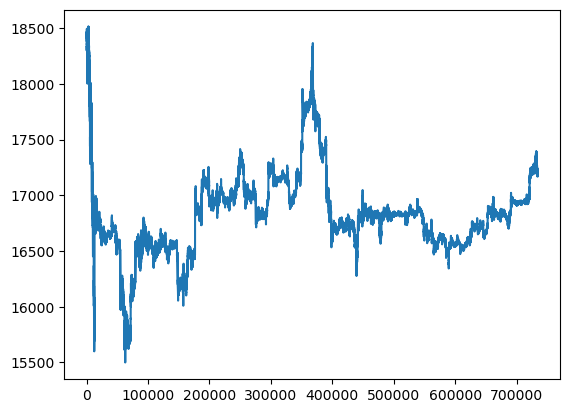

trade_result


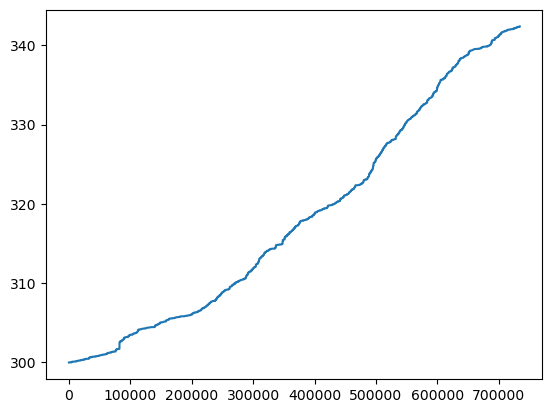

trade_btc 126.05720641735996


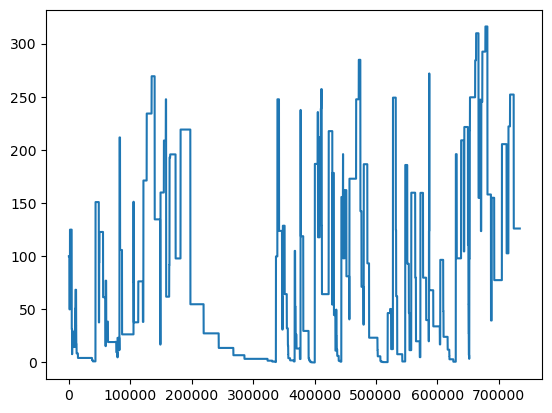

trade_eth 132.00338065389138


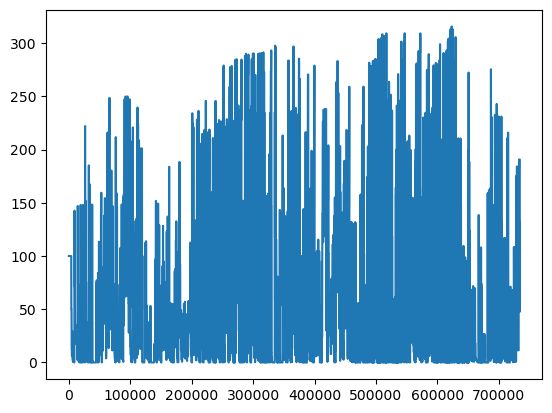

trade_bnb 84.32264145551716


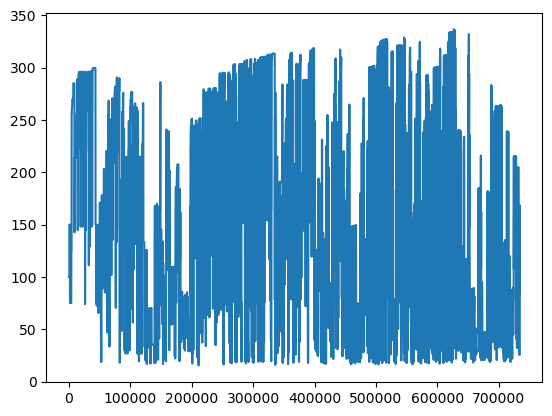

CPU times: total: 1min 17s
Wall time: 1min 17s


In [41]:
%%time

FEE = 0.00075


for slip_n in range(10,11):
    slip_n = slip_n/10
    print("-------------")
    print(f'SLIP_N = {slip_n}')
    trade_result, trade_btc, trade_eth, trade_bnb, volume_not_trade, trade_start, fee_usdt, trade_count = trade(ticker_price_valid_values, predict, FEE, 1)
    trade_result = np.array(trade_result)
    trade_btc = np.array(trade_btc)
    trade_eth = np.array(trade_eth)
    trade_bnb = np.array(trade_bnb)
    print(f'Без торгов за счёт изменения курса с 300 usdt: {volume_not_trade}')
    print(f'Результат торгов с 300 usdt: {trade_result[-1]}')
    print(f'Общая комиссия в usdt: {fee_usdt}')
    print(f'Число сделок: {trade_count}')
    profit_300 = (trade_result[-1]-trade_start)*100_000/predict.shape[0]
    print(f'Прибыль от 300 usdt за 100_000 тиков: {profit_300}')
    print(' ')
    # отрисовка изменение объёма кошелька
    print('btc_usdt')
    sns.lineplot(x=range(ticker_price_valid_values.shape[0]),y=ticker_price_valid_values[:,0])
    plt.show()
    print('trade_result')
    sns.lineplot(x=range(trade_result.shape[0]),y=trade_result)
    plt.show()
    print(f'trade_btc {trade_btc[-1]}')
    sns.lineplot(x=range(trade_btc.shape[0]),y=trade_btc)
    plt.show()
    print(f'trade_eth {trade_eth[-1]}')
    sns.lineplot(x=range(trade_eth.shape[0]),y=trade_eth)
    plt.show()
    print(f'trade_bnb {trade_bnb[-1]}')
    sns.lineplot(x=range(trade_bnb.shape[0]),y=trade_bnb)
    plt.show()

## LGBMClassifier

  0%|                                                                                           | 0/10 [00:00<?, ?it/s]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 2, depth: 2
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


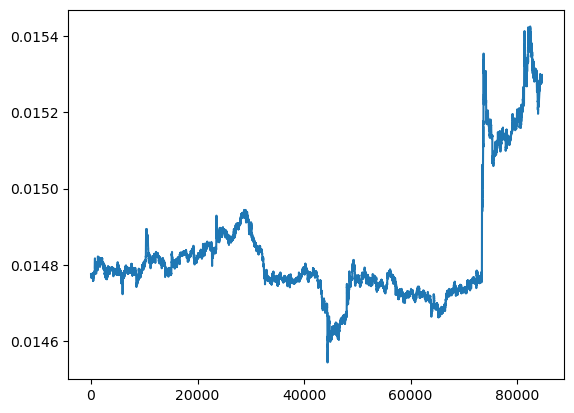

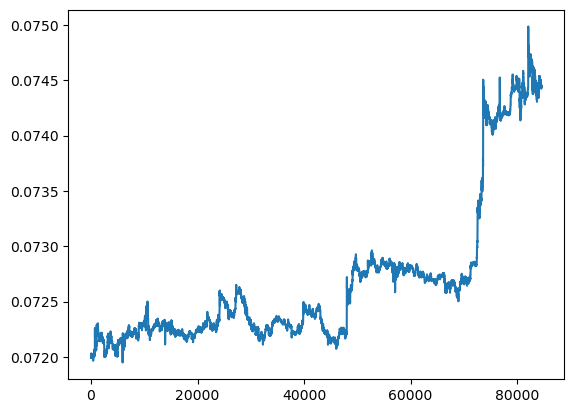

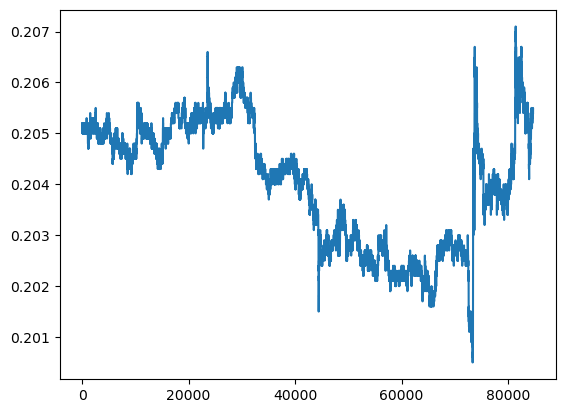

 10%|████████▎                                                                          | 1/10 [00:06<00:59,  6.57s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 2, depth: 5
Traid counts: 2 1: 0 2: 0 3: 0 4: 2 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       1.00      0.07      0.13        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.29      0.15      0.16     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


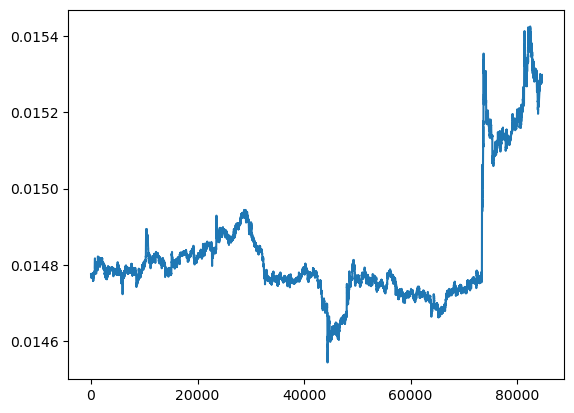

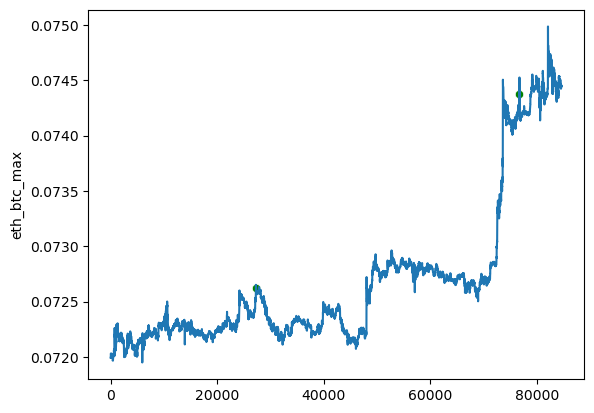

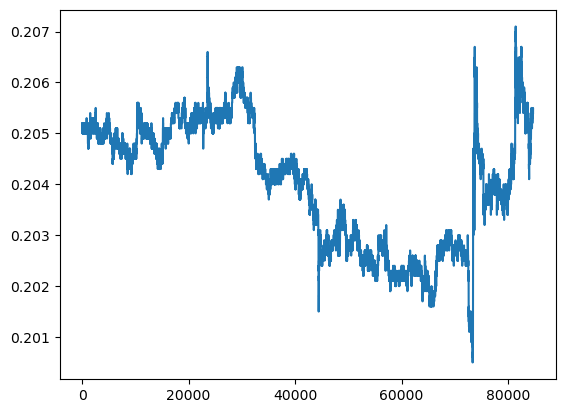

 20%|████████████████▌                                                                  | 2/10 [00:14<00:57,  7.15s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 2, depth: 8
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


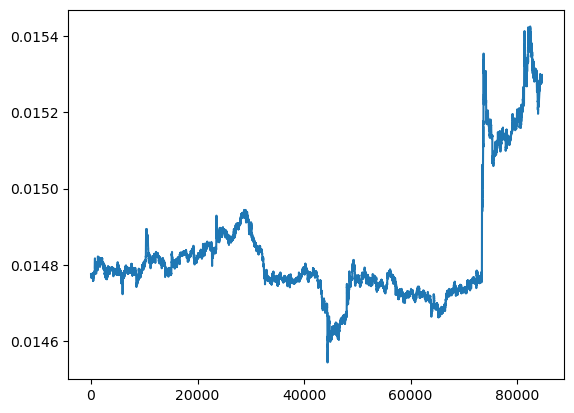

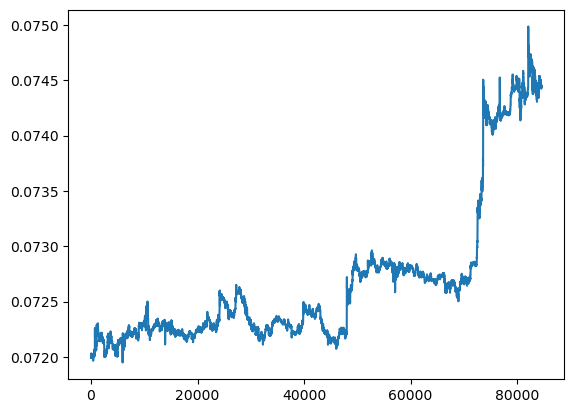

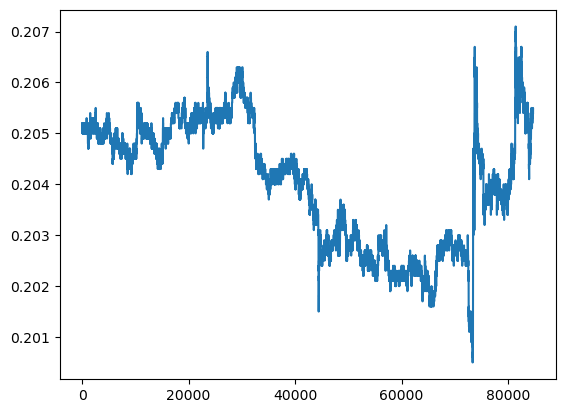

 30%|████████████████████████▉                                                          | 3/10 [00:21<00:52,  7.48s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 2, depth: 11
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


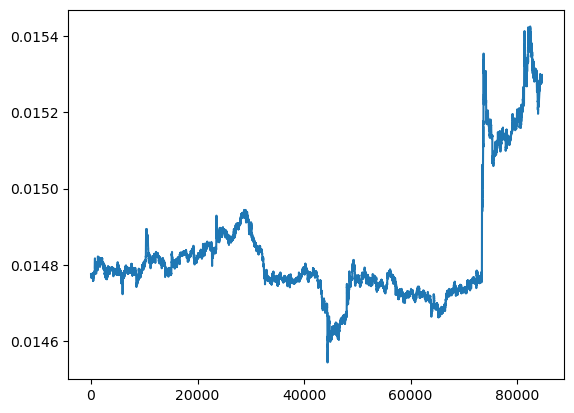

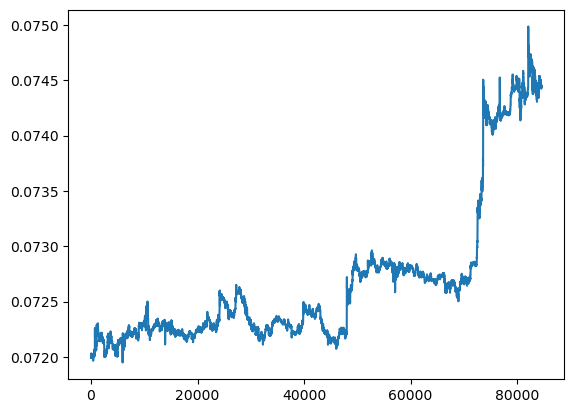

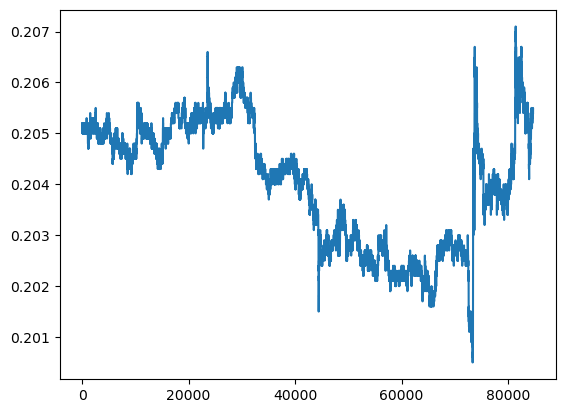

 40%|█████████████████████████████████▏                                                 | 4/10 [00:29<00:45,  7.63s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 2, depth: 14
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


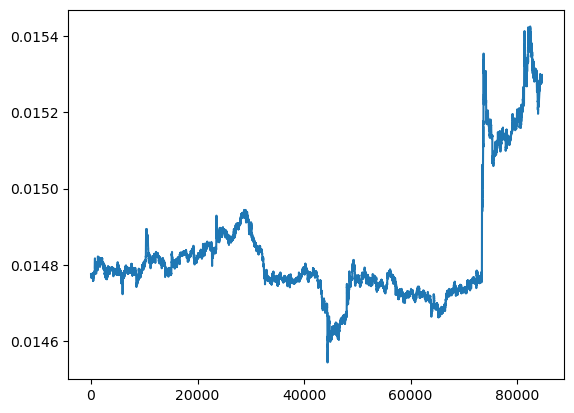

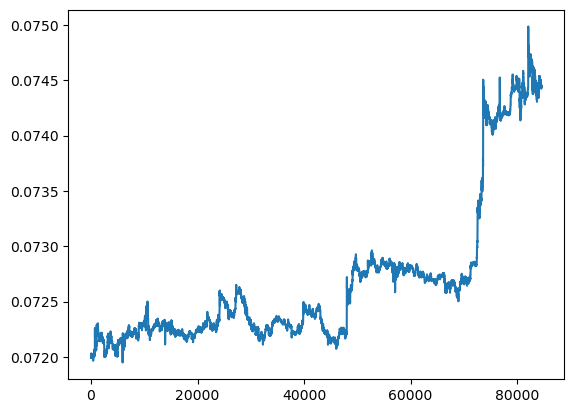

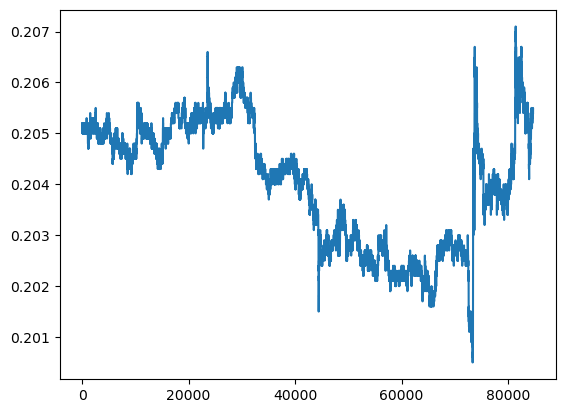

 50%|█████████████████████████████████████████▌                                         | 5/10 [00:37<00:38,  7.73s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 2, depth: 17
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


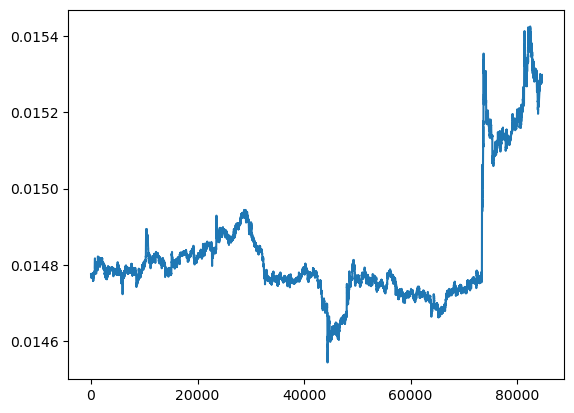

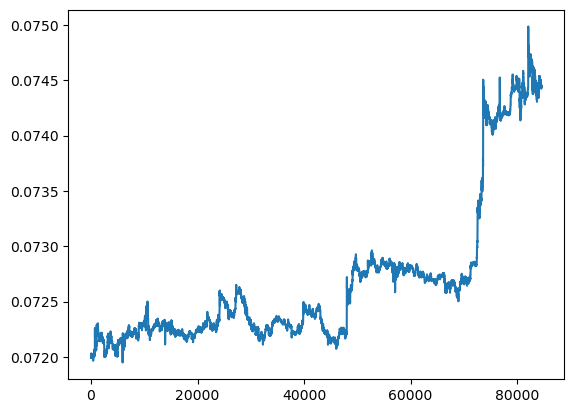

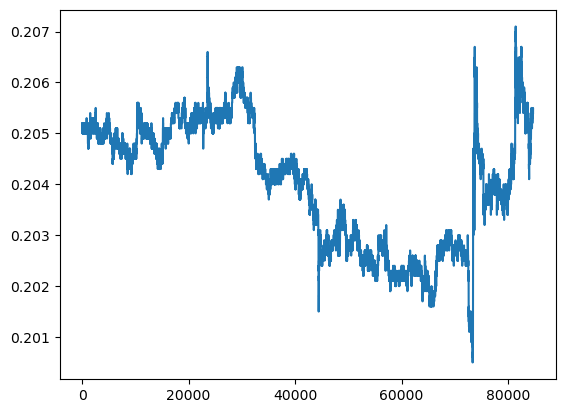

 60%|█████████████████████████████████████████████████▊                                 | 6/10 [00:45<00:31,  7.79s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 2, depth: 20
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


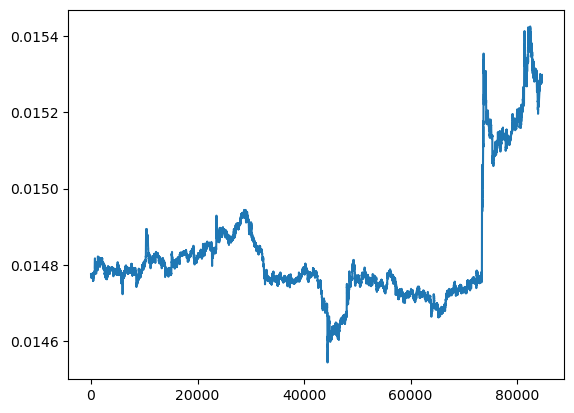

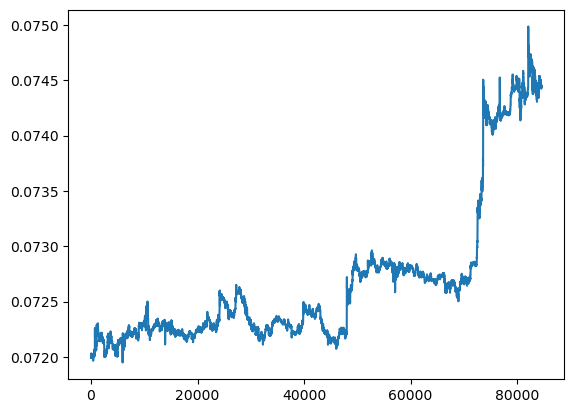

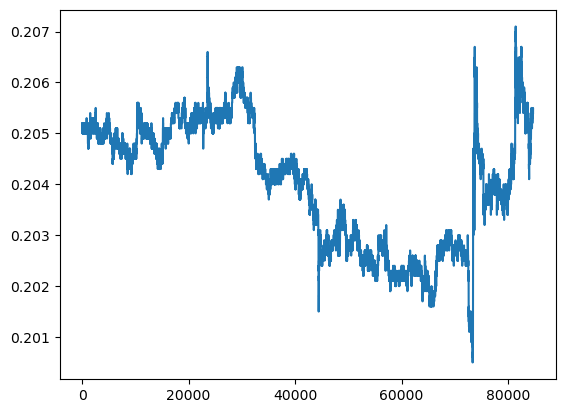

 70%|██████████████████████████████████████████████████████████                         | 7/10 [00:53<00:23,  7.83s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 2, depth: 23
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


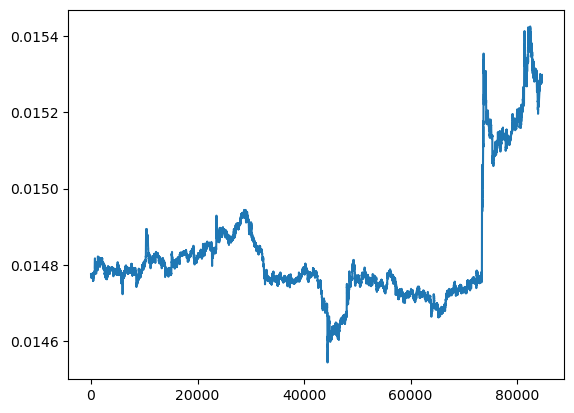

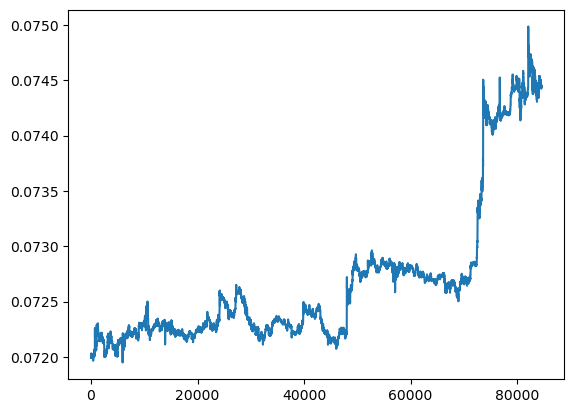

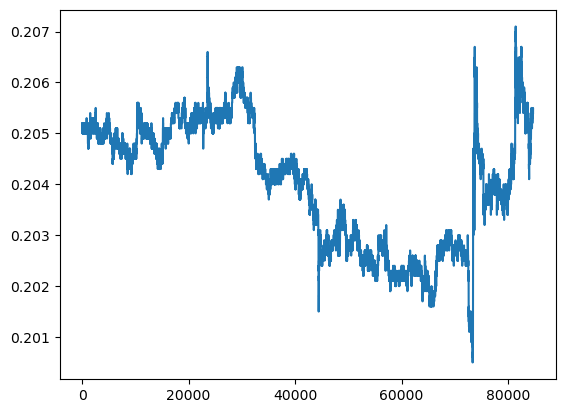

 80%|██████████████████████████████████████████████████████████████████▍                | 8/10 [01:02<00:16,  8.15s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 2, depth: 26
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


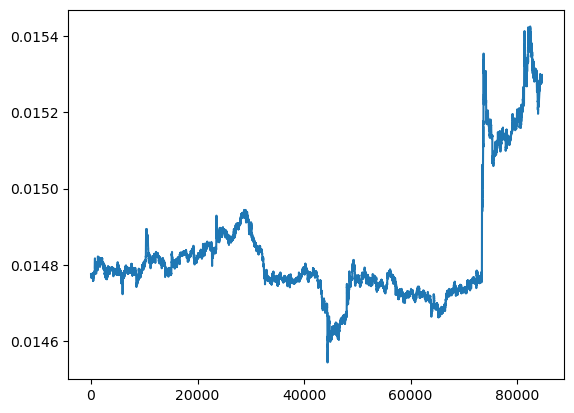

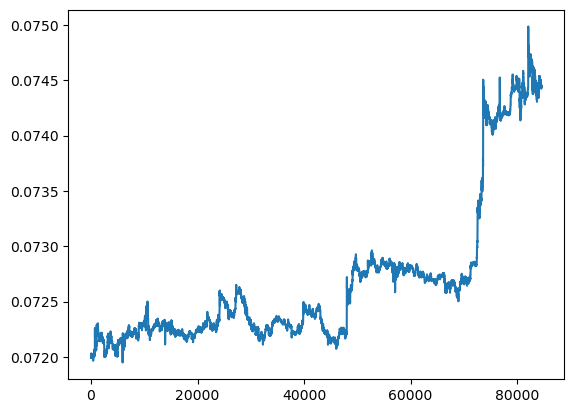

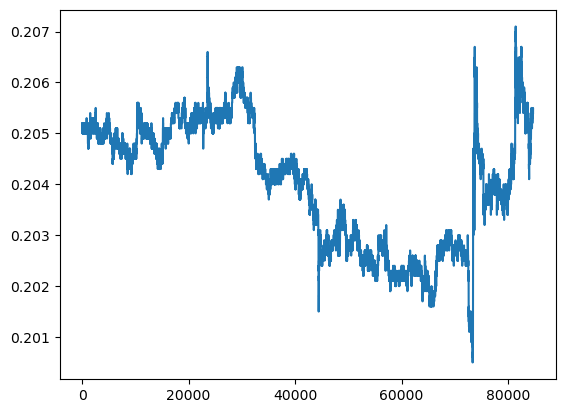

 90%|██████████████████████████████████████████████████████████████████████████▋        | 9/10 [01:10<00:08,  8.16s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 2, depth: 29
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


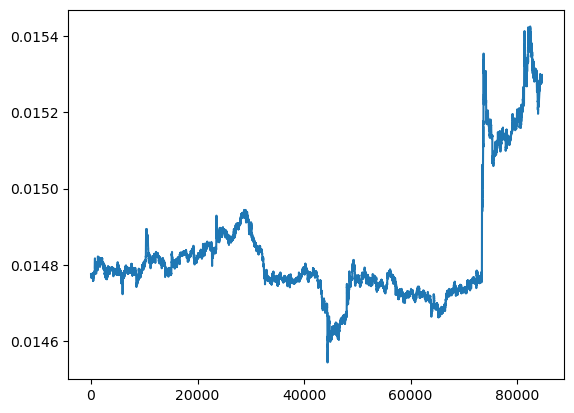

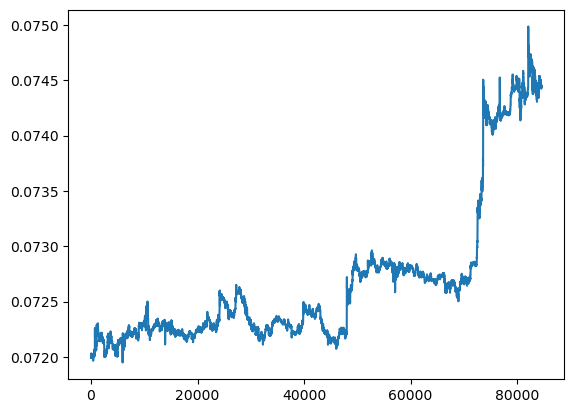

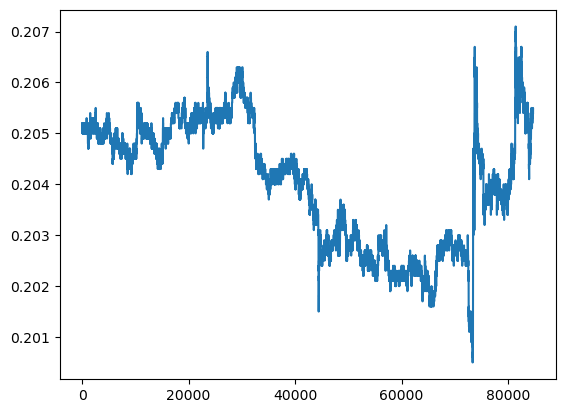

  0%|                                                                                           | 0/10 [00:00<?, ?it/s]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 5, depth: 2
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


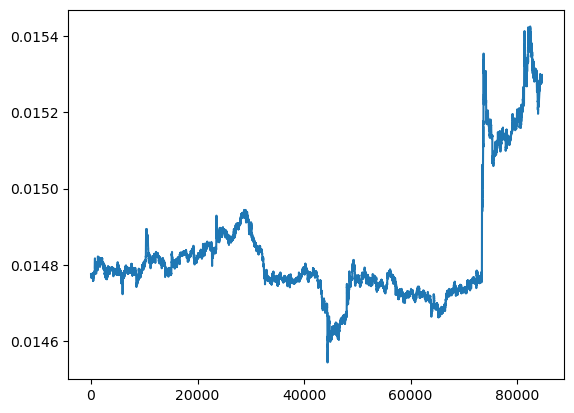

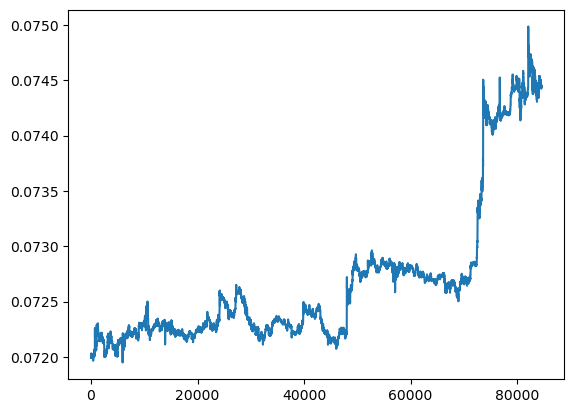

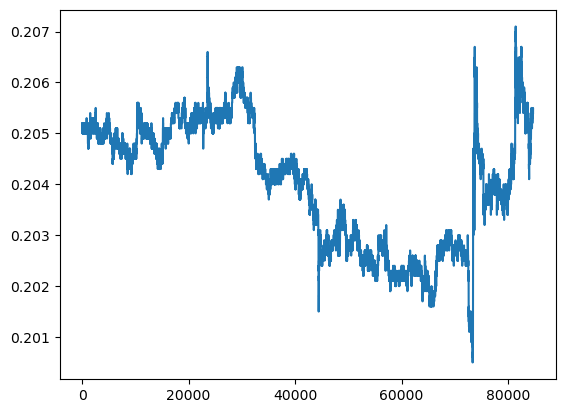

 10%|████████▎                                                                          | 1/10 [00:06<00:59,  6.66s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 5, depth: 5
Traid counts: 2 1: 0 2: 0 3: 0 4: 2 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       1.00      0.07      0.13        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.29      0.15      0.16     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


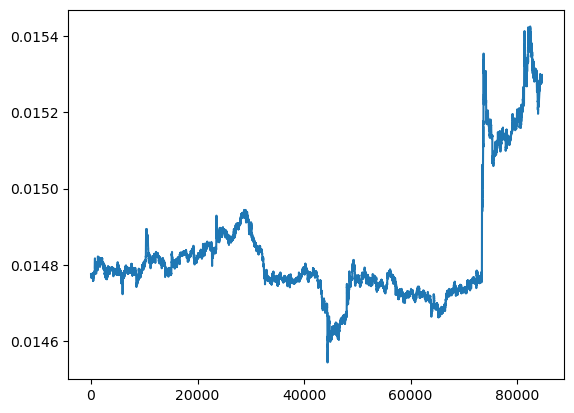

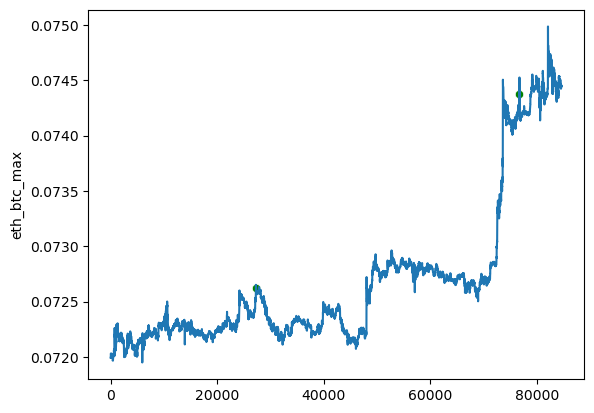

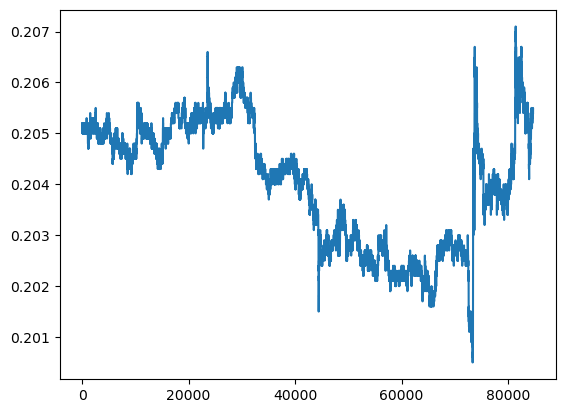

 20%|████████████████▌                                                                  | 2/10 [00:14<00:57,  7.22s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 5, depth: 8
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


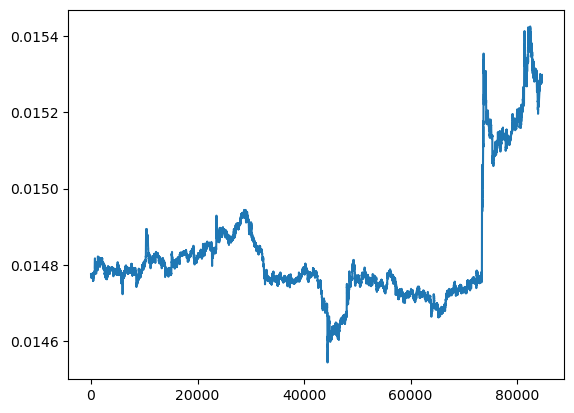

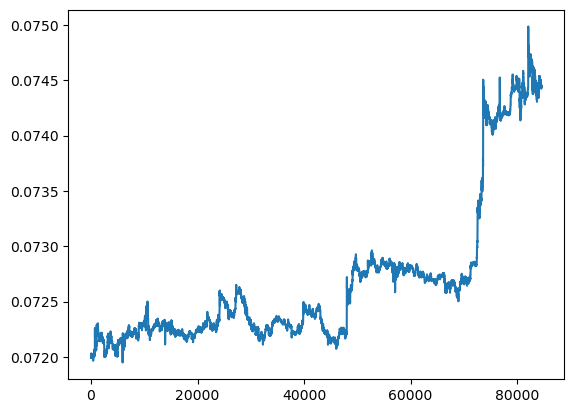

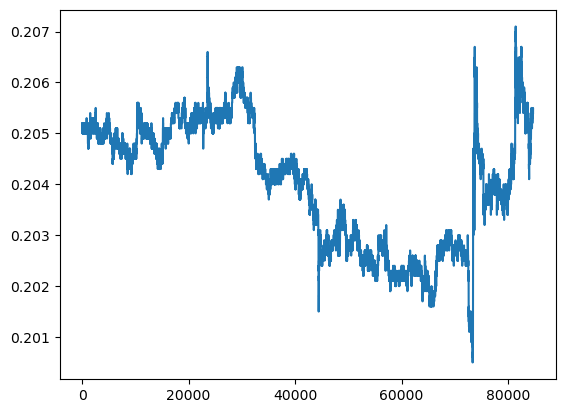

 30%|████████████████████████▉                                                          | 3/10 [00:22<00:53,  7.63s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 5, depth: 11
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


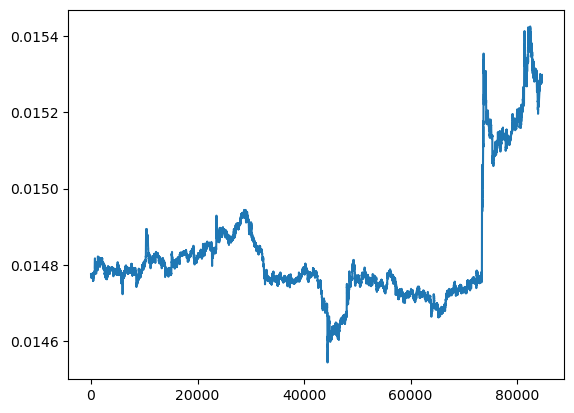

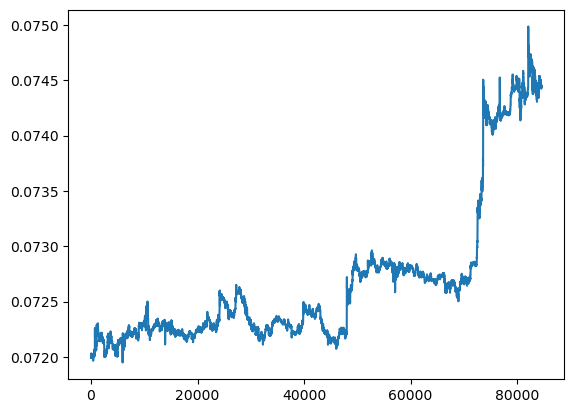

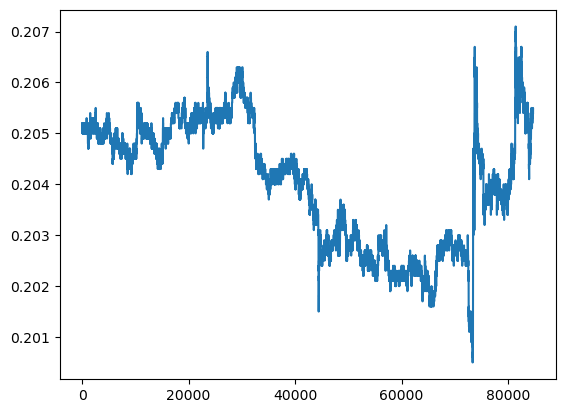

 40%|█████████████████████████████████▏                                                 | 4/10 [00:30<00:46,  7.81s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 5, depth: 14
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


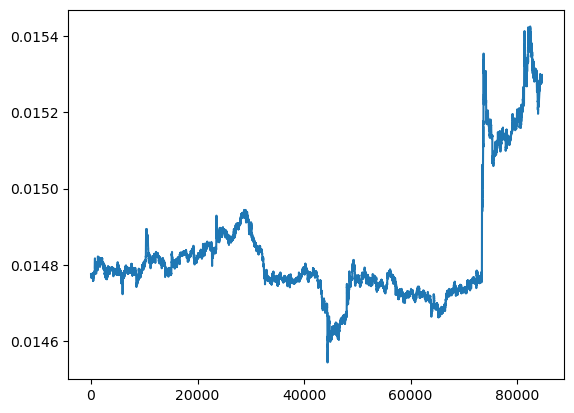

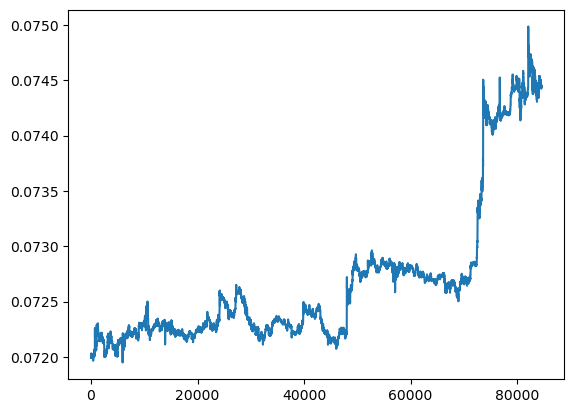

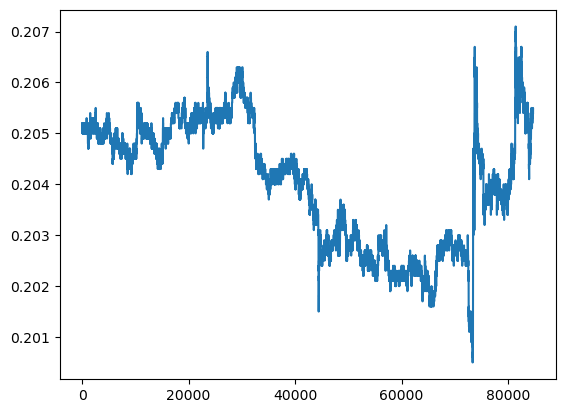

 50%|█████████████████████████████████████████▌                                         | 5/10 [00:38<00:39,  7.85s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 5, depth: 17
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


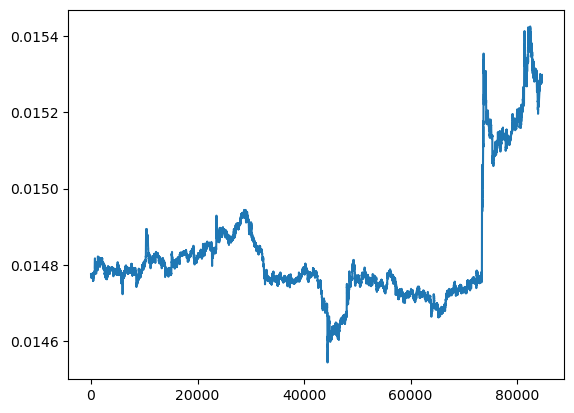

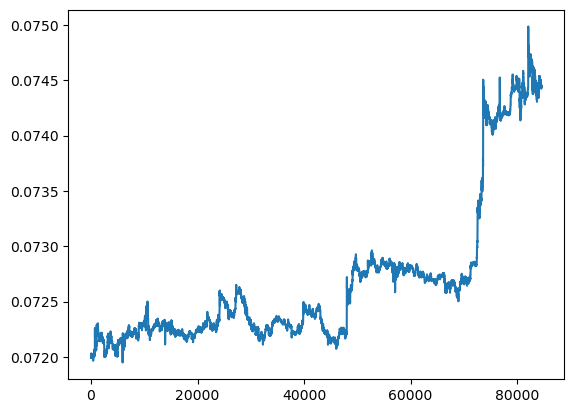

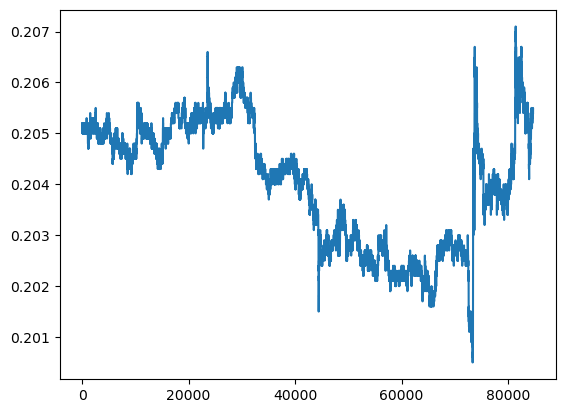

 60%|█████████████████████████████████████████████████▊                                 | 6/10 [00:46<00:31,  7.92s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 5, depth: 20
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


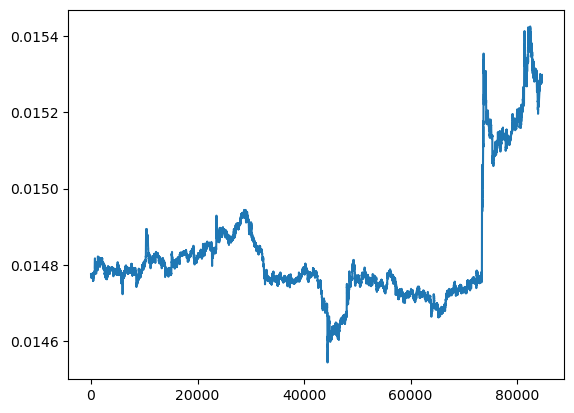

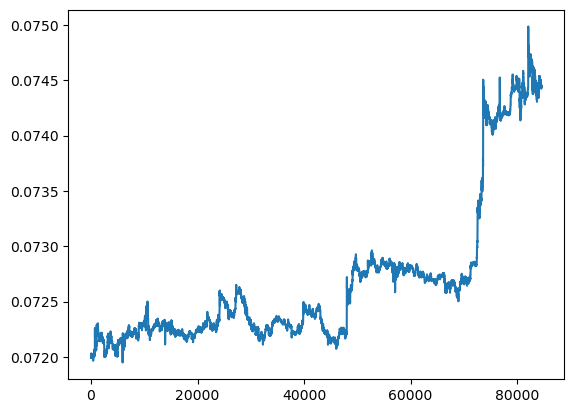

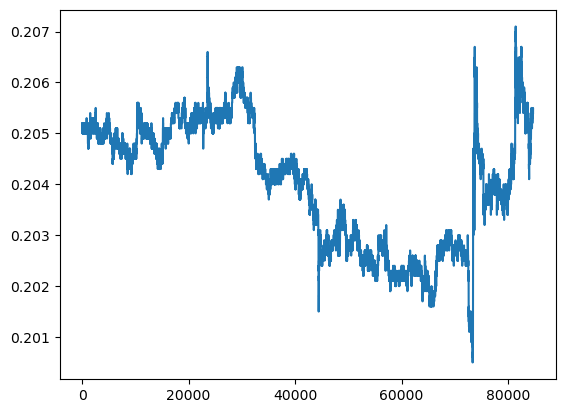

 70%|██████████████████████████████████████████████████████████                         | 7/10 [00:54<00:23,  7.91s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 5, depth: 23
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


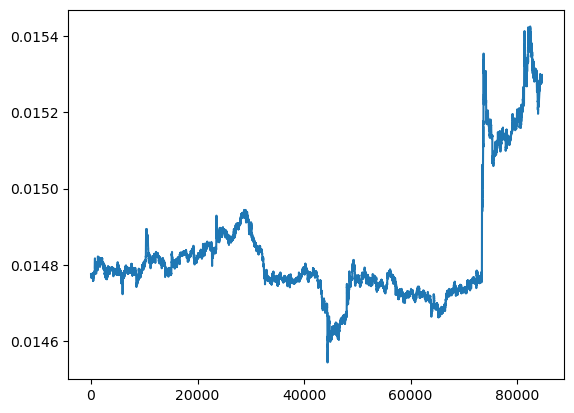

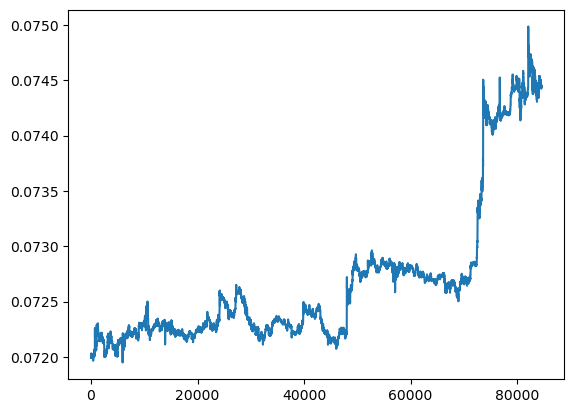

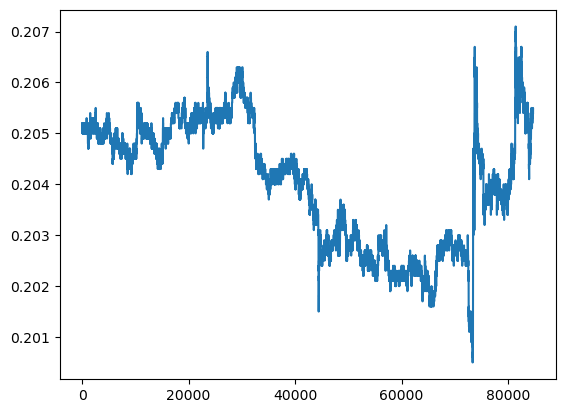

 80%|██████████████████████████████████████████████████████████████████▍                | 8/10 [01:02<00:15,  7.89s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 5, depth: 26
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


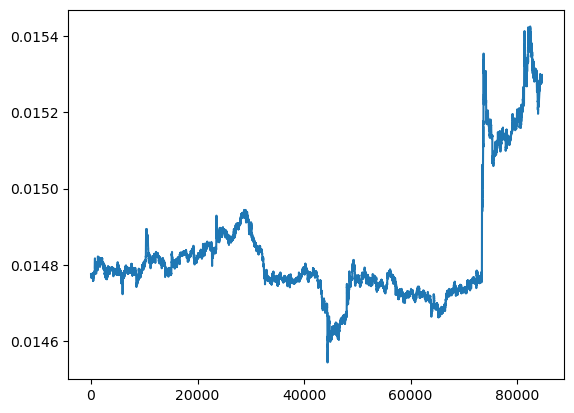

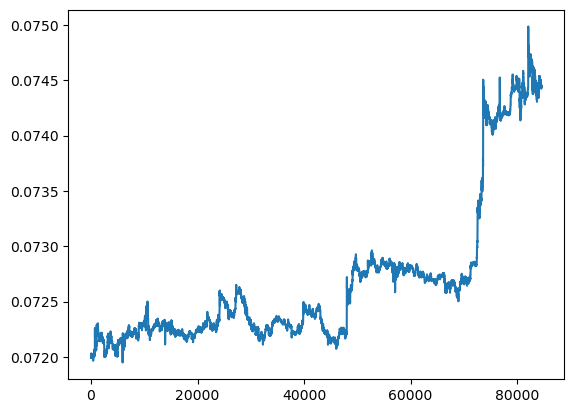

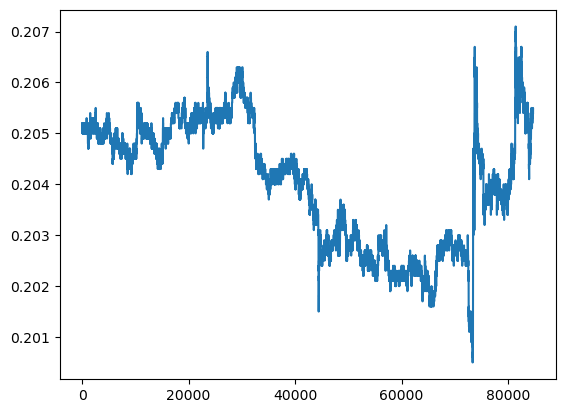

 90%|██████████████████████████████████████████████████████████████████████████▋        | 9/10 [01:10<00:07,  7.91s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 5, depth: 29
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


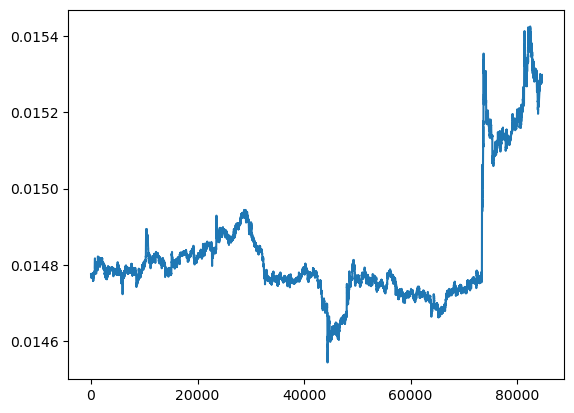

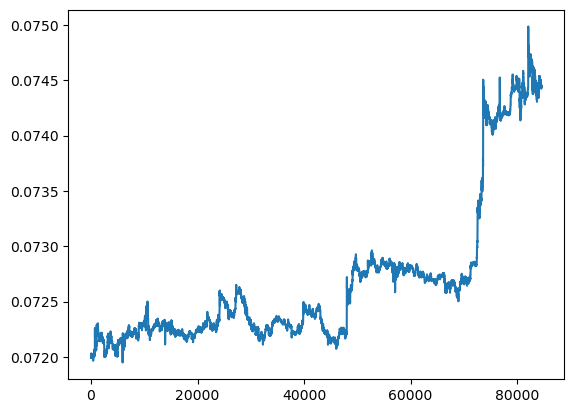

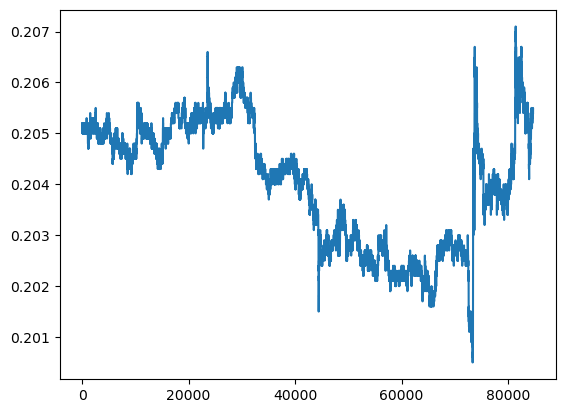

  0%|                                                                                           | 0/10 [00:00<?, ?it/s]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 8, depth: 2
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


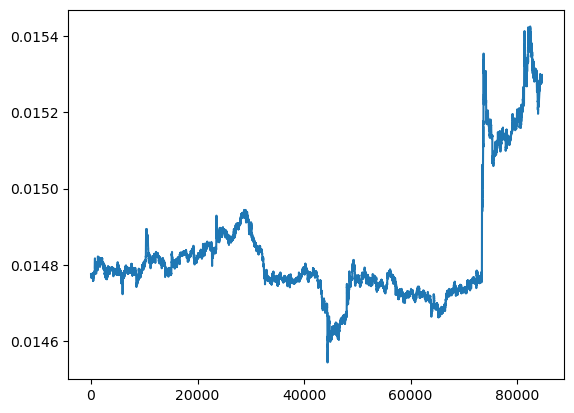

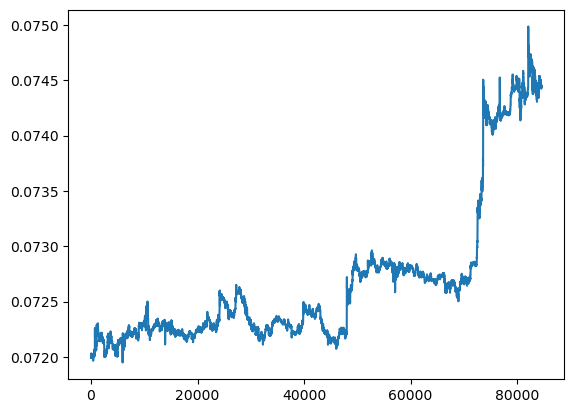

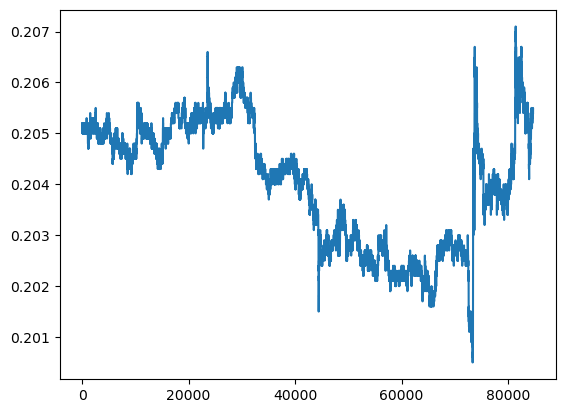

 10%|████████▎                                                                          | 1/10 [00:06<00:59,  6.60s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 8, depth: 5
Traid counts: 2 1: 0 2: 0 3: 0 4: 2 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       1.00      0.07      0.13        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.29      0.15      0.16     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


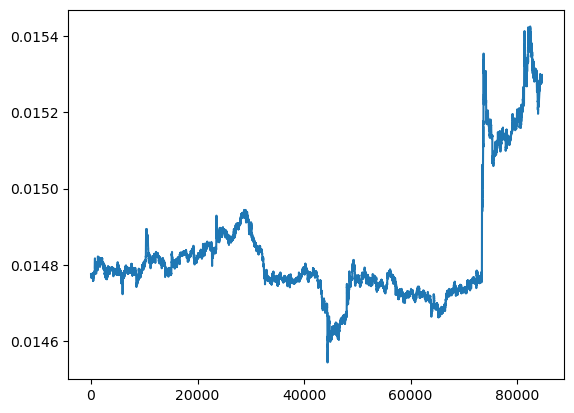

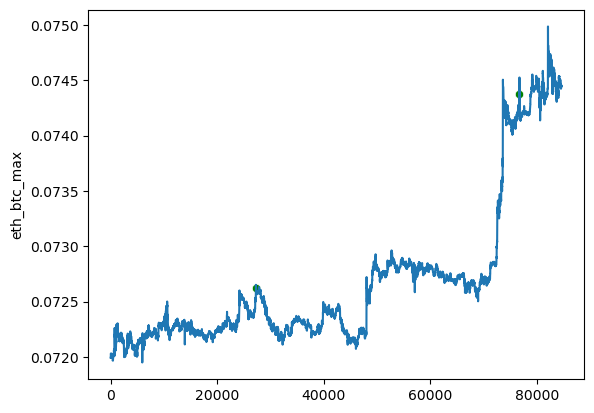

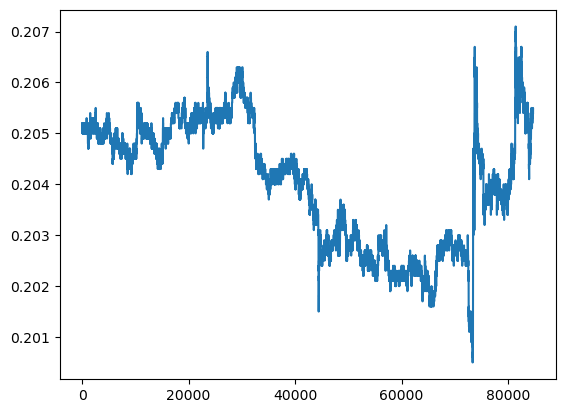

 20%|████████████████▌                                                                  | 2/10 [00:14<00:58,  7.28s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 8, depth: 8
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


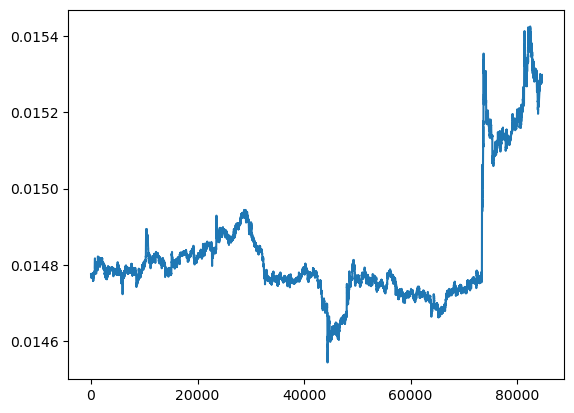

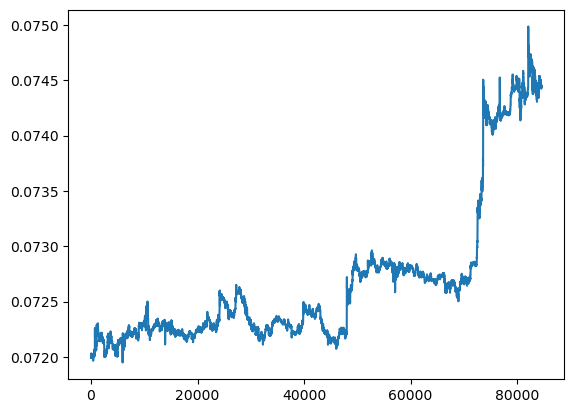

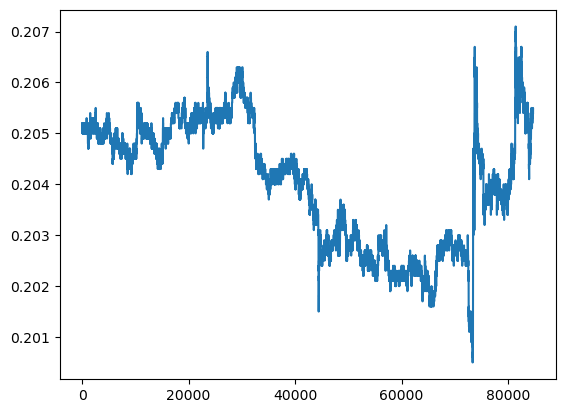

 30%|████████████████████████▉                                                          | 3/10 [00:22<00:53,  7.62s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 8, depth: 11
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


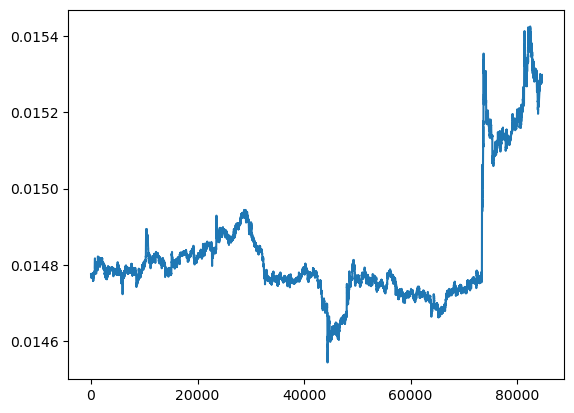

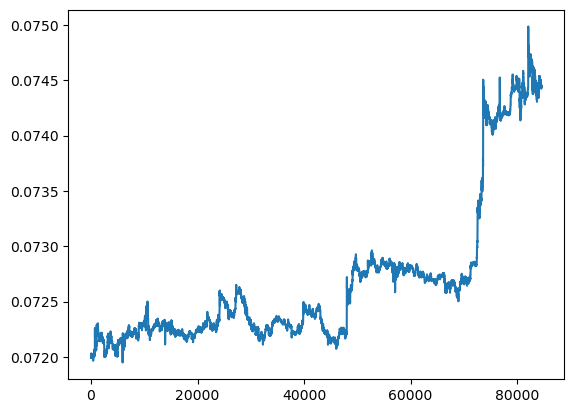

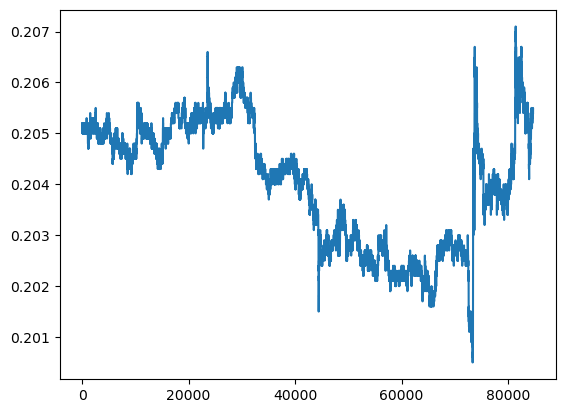

 40%|█████████████████████████████████▏                                                 | 4/10 [00:30<00:46,  7.83s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 8, depth: 14
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


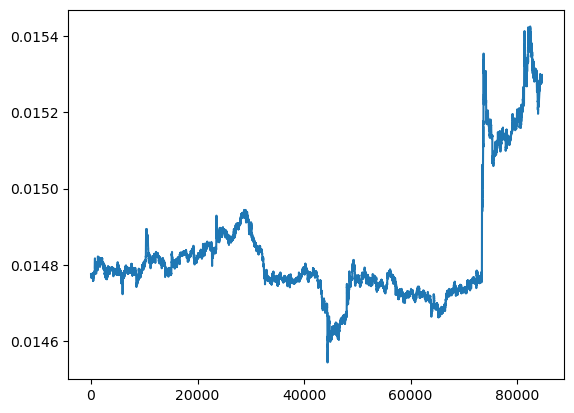

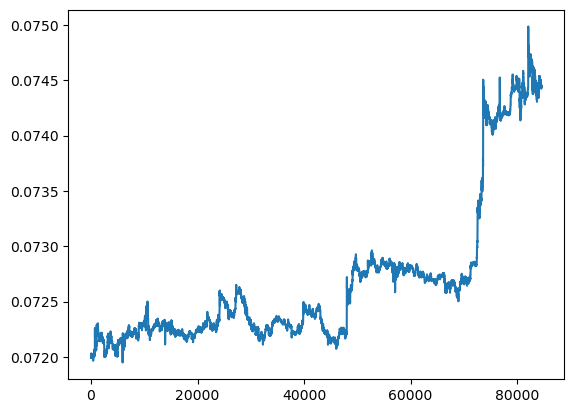

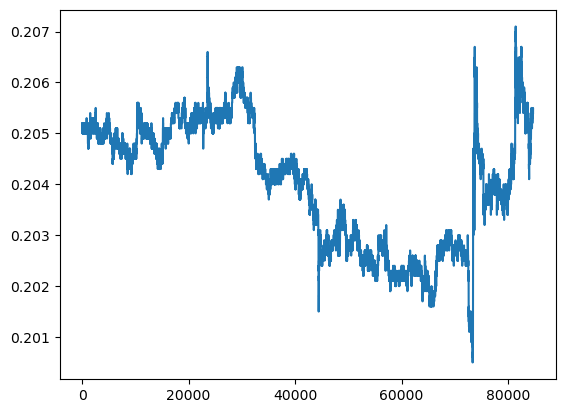

 50%|█████████████████████████████████████████▌                                         | 5/10 [00:38<00:40,  8.05s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 8, depth: 17
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


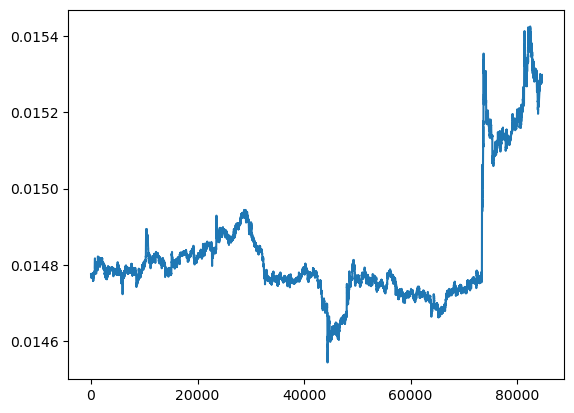

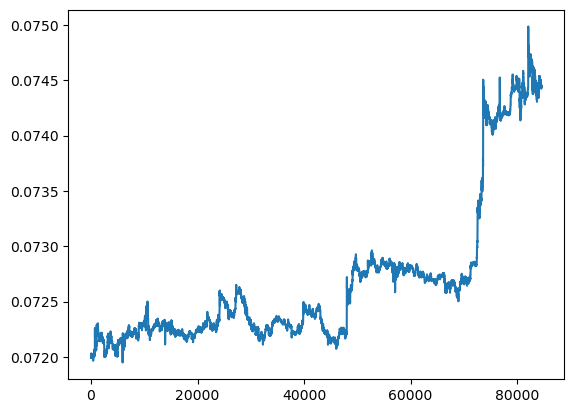

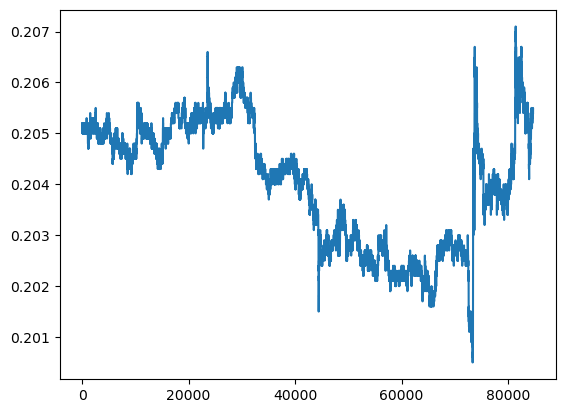

 60%|█████████████████████████████████████████████████▊                                 | 6/10 [00:46<00:32,  8.02s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 8, depth: 20
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


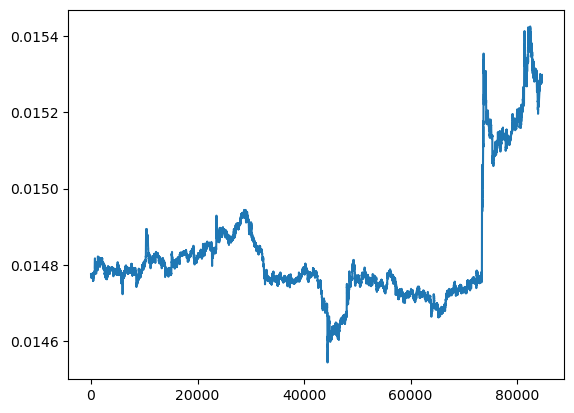

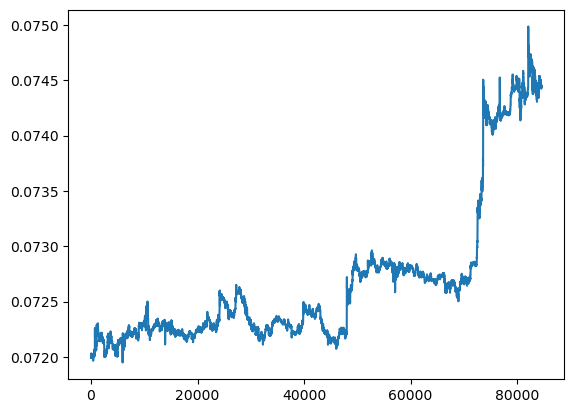

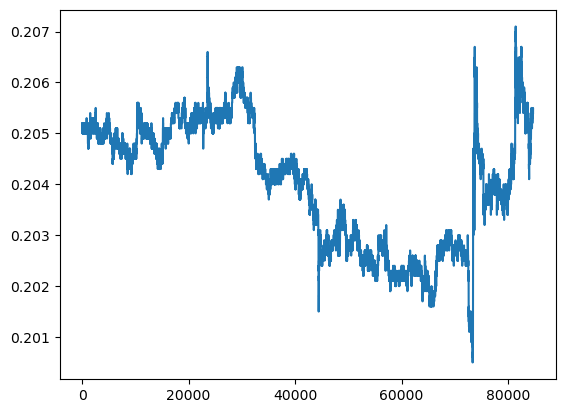

 70%|██████████████████████████████████████████████████████████                         | 7/10 [00:55<00:24,  8.08s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 8, depth: 23
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


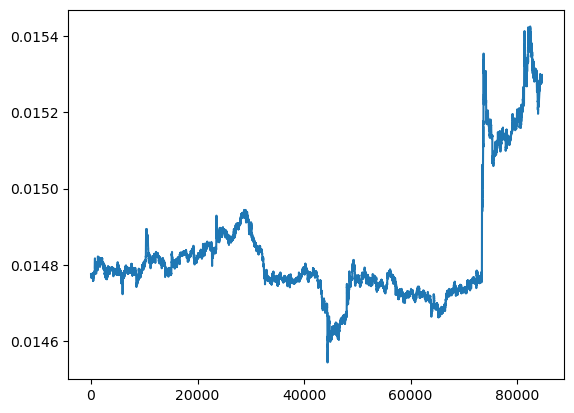

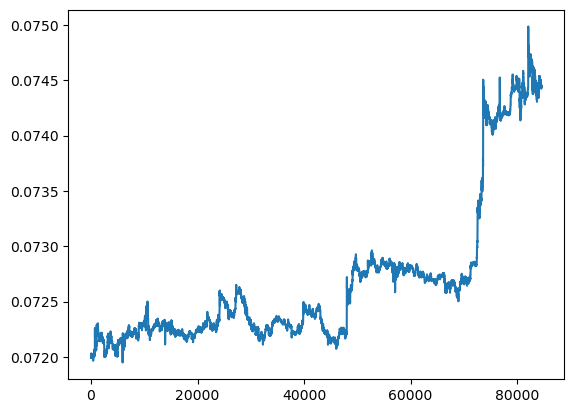

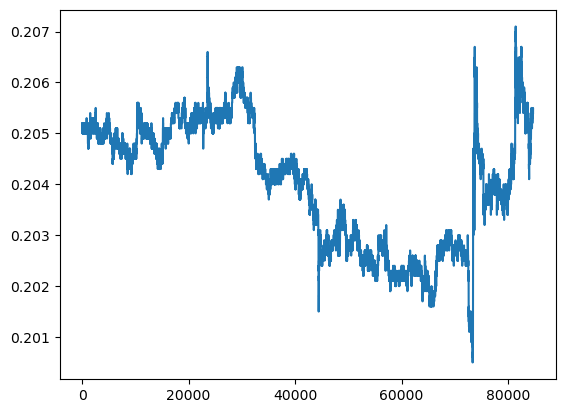

 80%|██████████████████████████████████████████████████████████████████▍                | 8/10 [01:03<00:16,  8.15s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 8, depth: 26
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


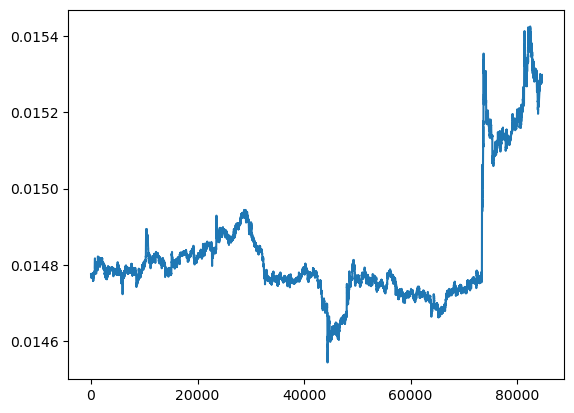

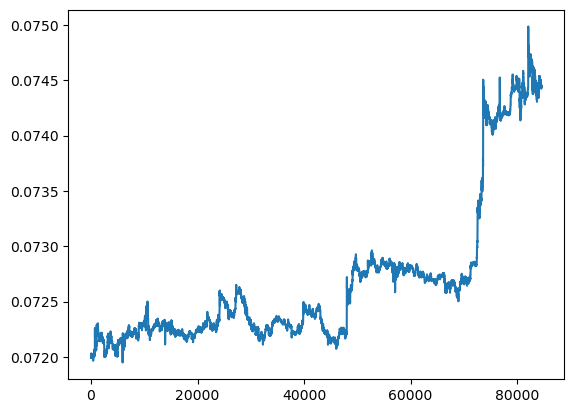

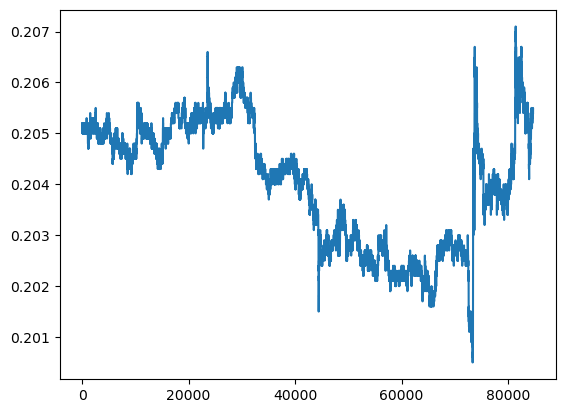

 90%|██████████████████████████████████████████████████████████████████████████▋        | 9/10 [01:11<00:08,  8.07s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 8, depth: 29
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


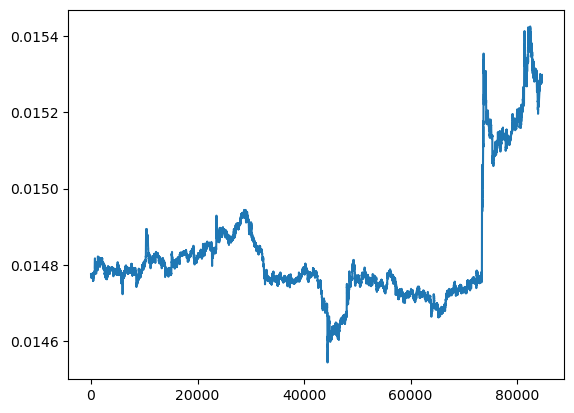

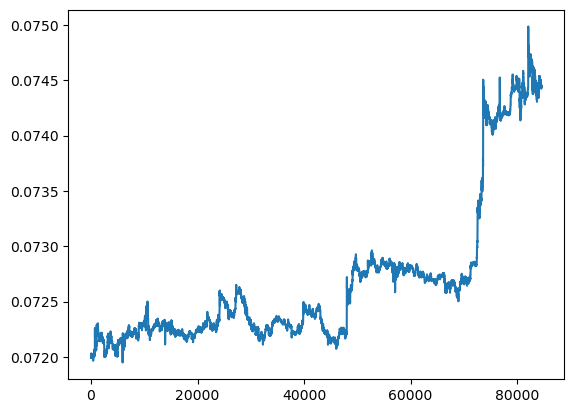

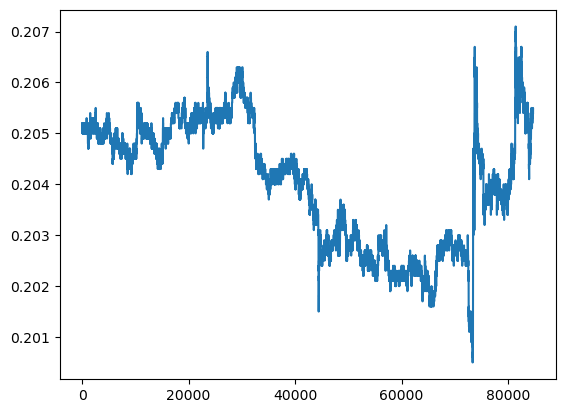

  0%|                                                                                           | 0/10 [00:00<?, ?it/s]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 11, depth: 2
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


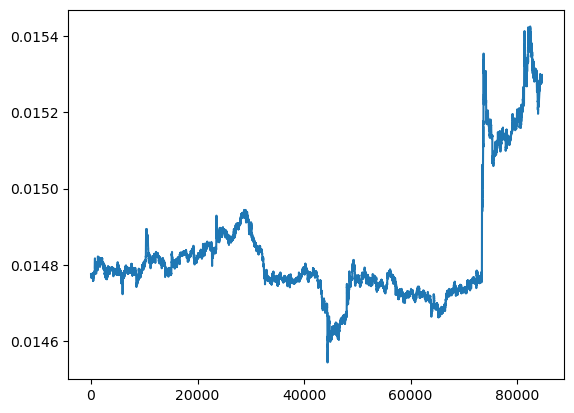

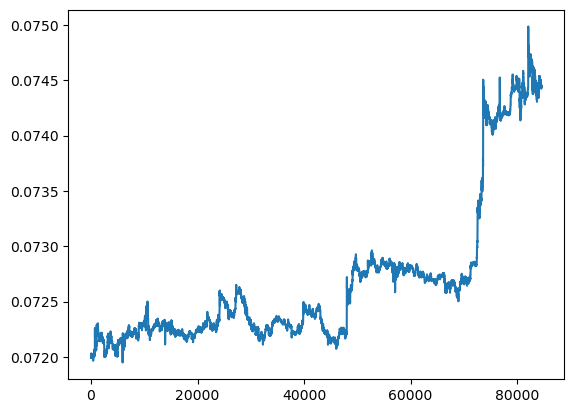

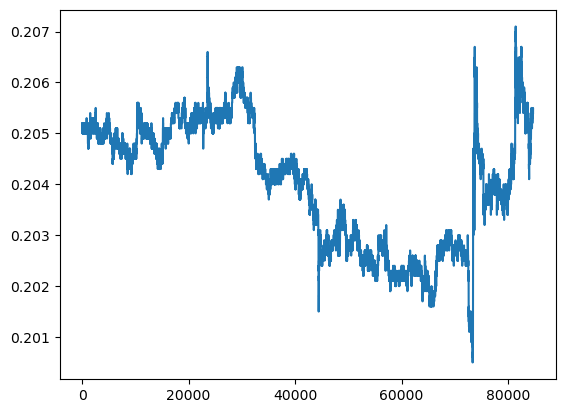

 10%|████████▎                                                                          | 1/10 [00:06<00:58,  6.55s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 11, depth: 5
Traid counts: 2 1: 0 2: 0 3: 0 4: 2 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       1.00      0.07      0.13        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.29      0.15      0.16     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


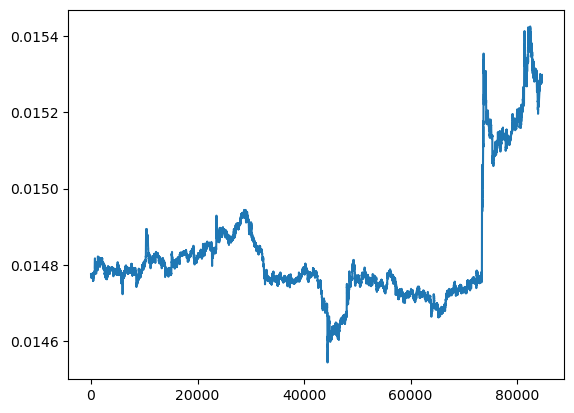

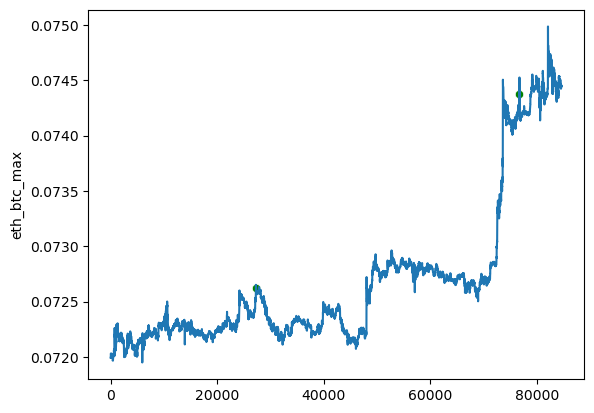

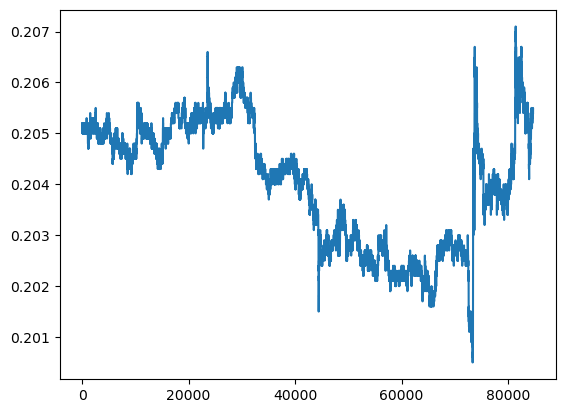

 20%|████████████████▌                                                                  | 2/10 [00:14<00:57,  7.17s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 11, depth: 8
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


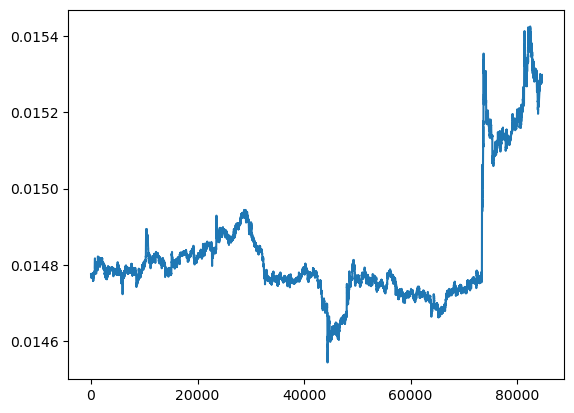

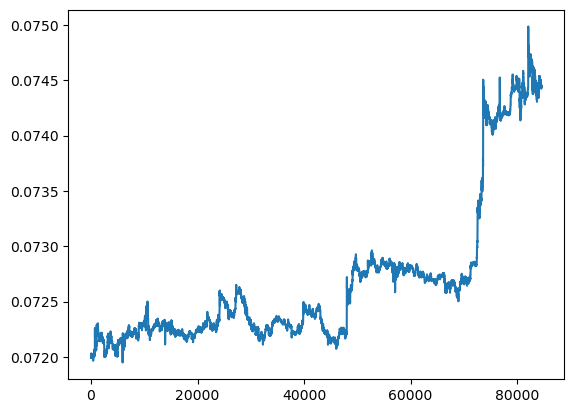

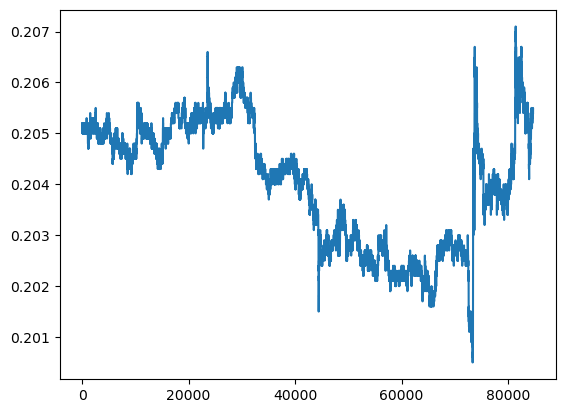

 30%|████████████████████████▉                                                          | 3/10 [00:22<00:52,  7.55s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 11, depth: 11
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


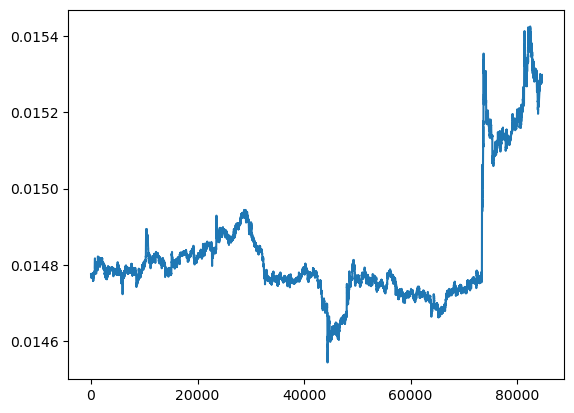

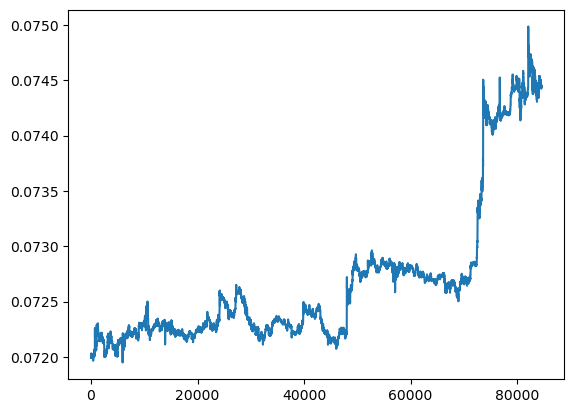

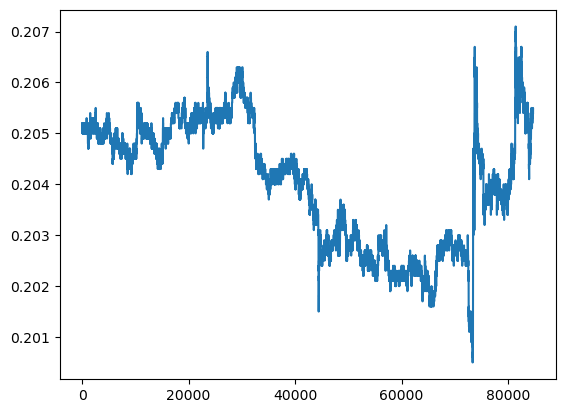

 40%|█████████████████████████████████▏                                                 | 4/10 [00:30<00:46,  7.71s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 11, depth: 14
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


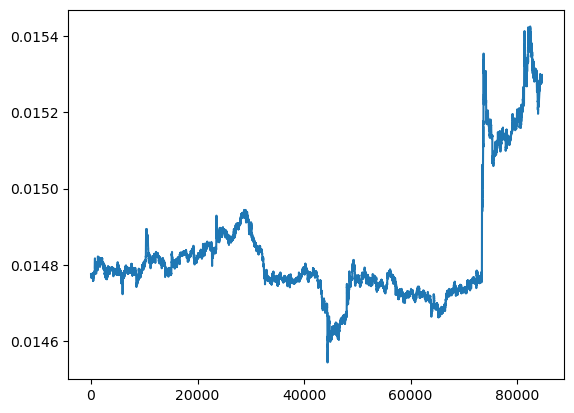

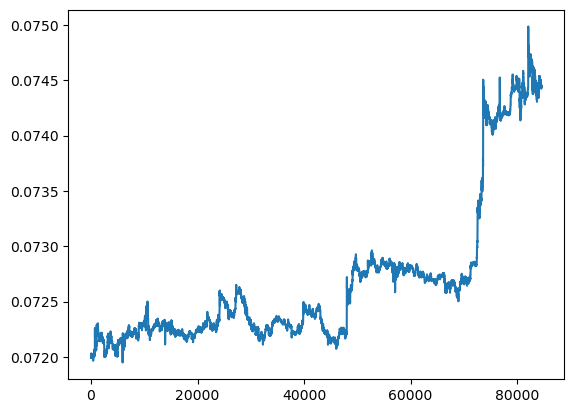

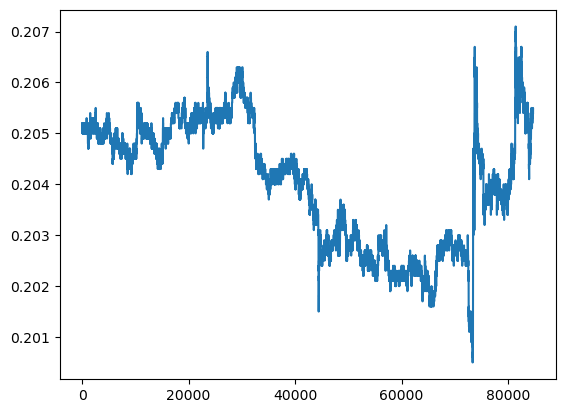

 50%|█████████████████████████████████████████▌                                         | 5/10 [00:38<00:38,  7.78s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 11, depth: 17
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


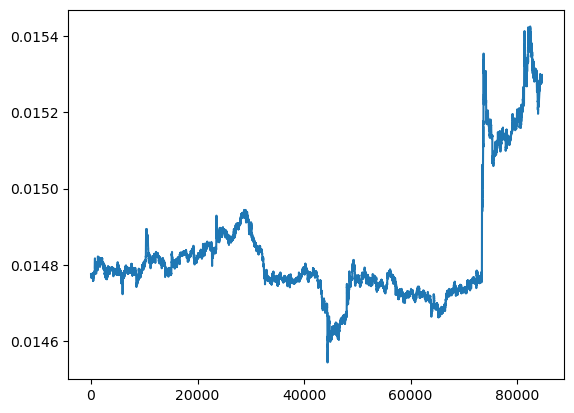

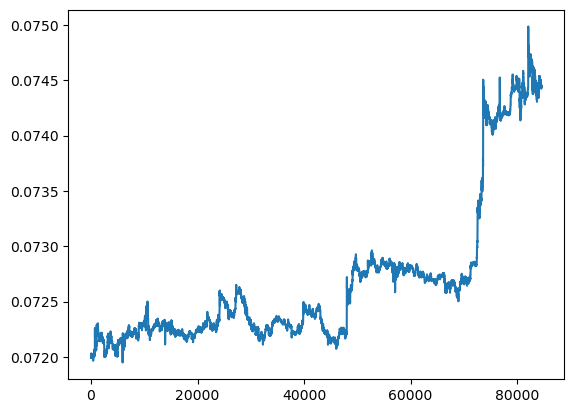

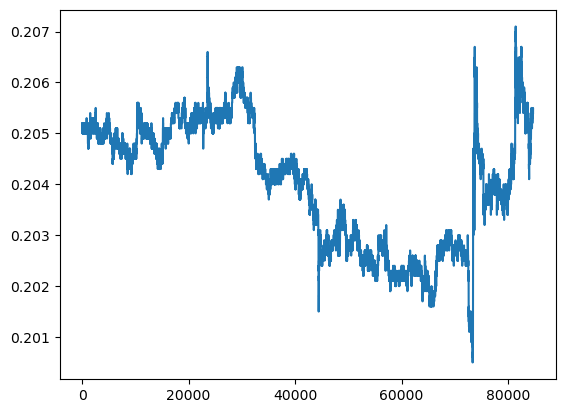

 60%|█████████████████████████████████████████████████▊                                 | 6/10 [00:46<00:31,  7.92s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 11, depth: 20
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


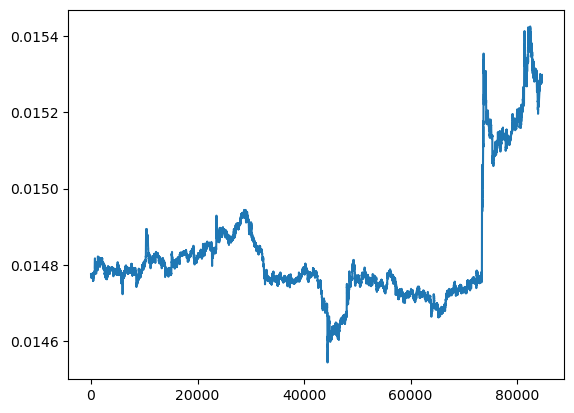

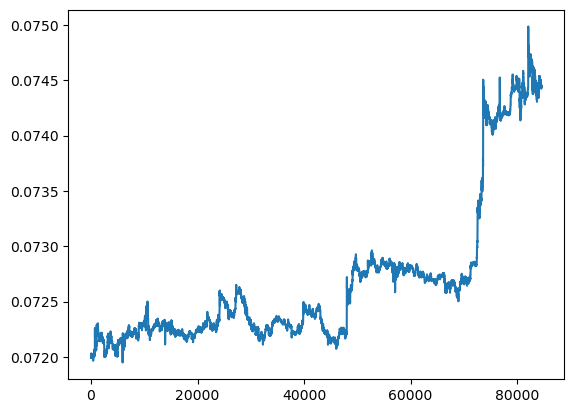

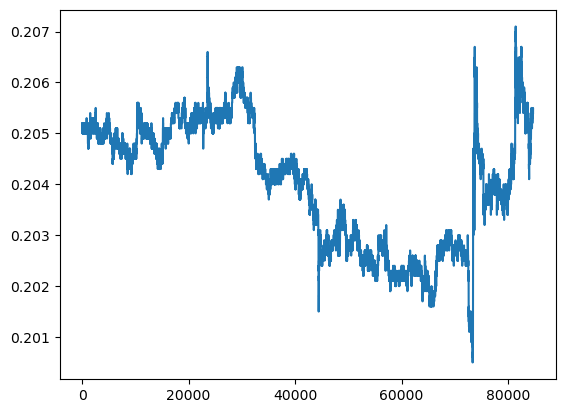

 70%|██████████████████████████████████████████████████████████                         | 7/10 [00:54<00:23,  7.95s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 11, depth: 23
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


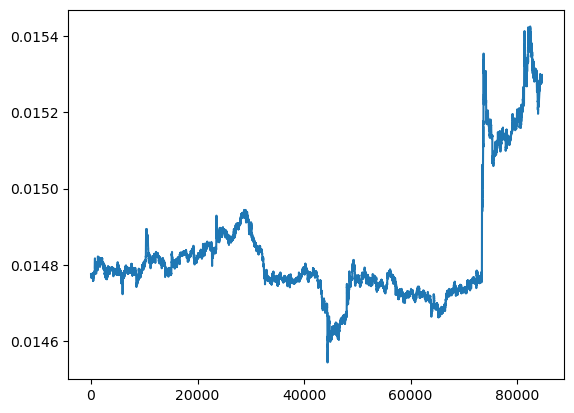

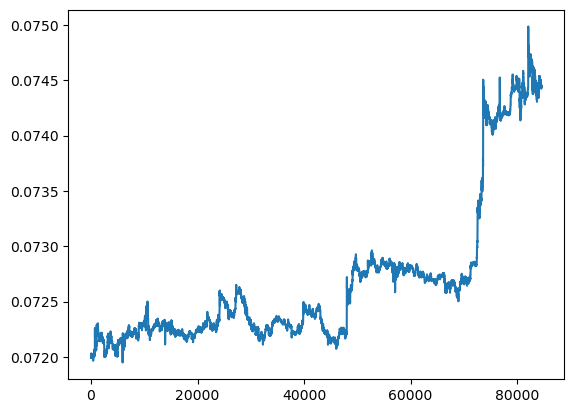

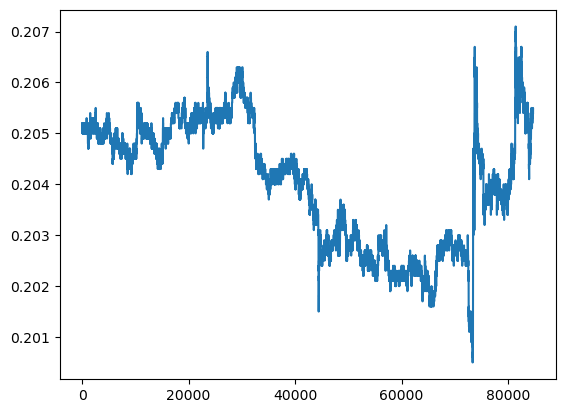

 80%|██████████████████████████████████████████████████████████████████▍                | 8/10 [01:02<00:15,  7.98s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 11, depth: 26
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2


C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


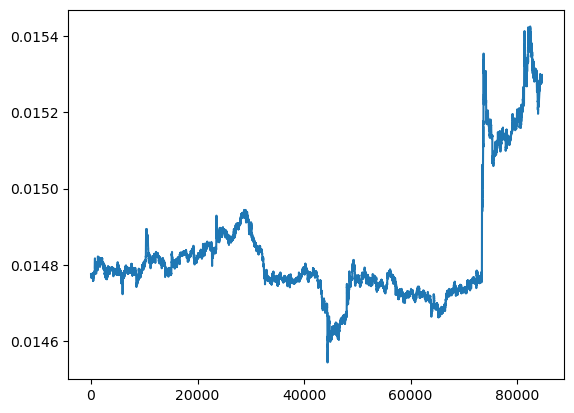

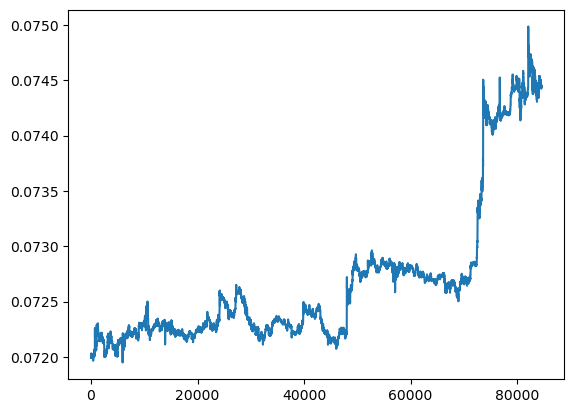

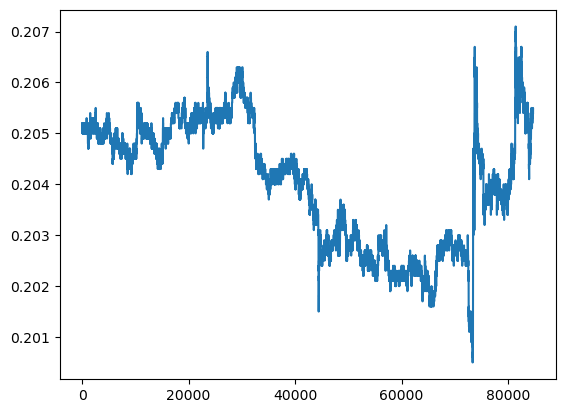

 90%|██████████████████████████████████████████████████████████████████████████▋        | 9/10 [01:10<00:08,  8.01s/it]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 11, depth: 29
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598

C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_


Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


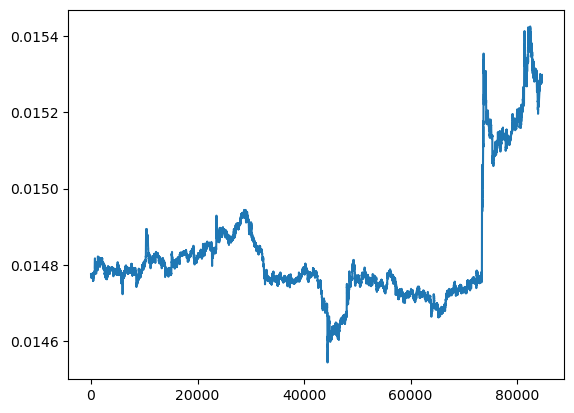

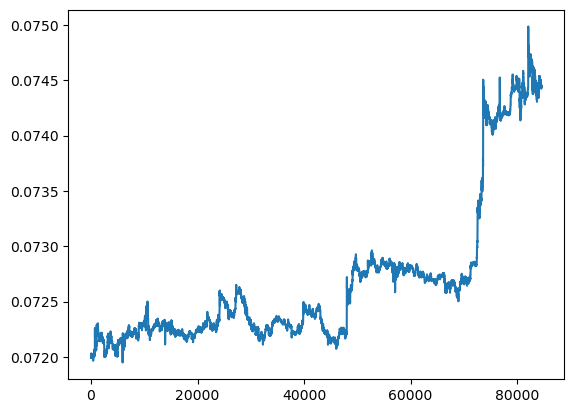

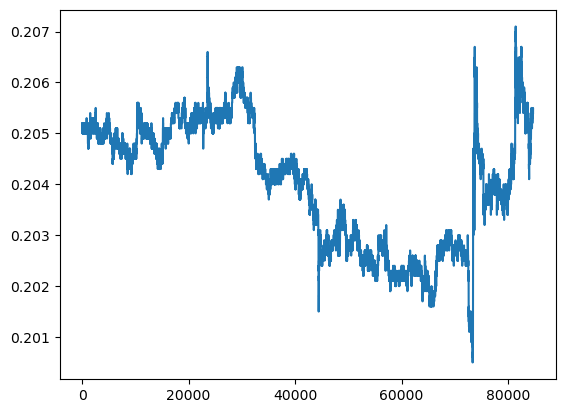

  0%|                                                                                           | 0/10 [00:00<?, ?it/s]

---***---***---***---***---***---***---***---***---***---***---***---***---
Predict start
iterations: 2, min_child_samples: 14, depth: 2
Traid counts: 0 1: 0 2: 0 3: 0 4: 0 5: 0 6: 0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     84371
           1       0.00      0.00      0.00        68
           2       0.00      0.00      0.00        65
           3       0.00      0.00      0.00        24
           4       0.00      0.00      0.00        28
           5       0.00      0.00      0.00        62
           6       0.00      0.00      0.00        63

    accuracy                           1.00     84681
   macro avg       0.14      0.14      0.14     84681
weighted avg       0.99      1.00      0.99     84681

-------------
SLIP_N = 1
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598

C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denis\anaconda3\envs\python_3_10_4_torch\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_


Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 2
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 3
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 
-------------
SLIP_N = 4
Без торгов за счёт изменения курса с 300 usdt: 311.1384421484598
Результат торгов с 300 usdt: 300
Прибыль от 300 usdt за 100_000 тиков: 0.0
 


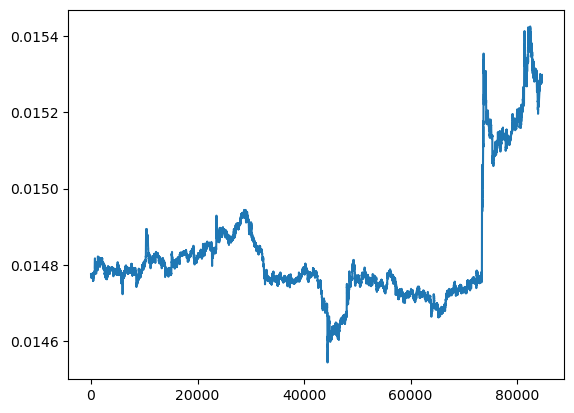

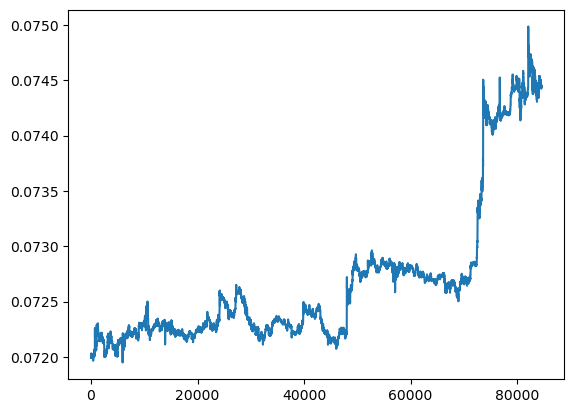

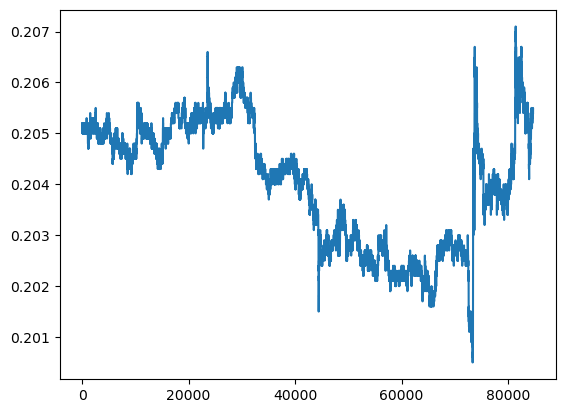

 10%|████████▎                                                                          | 1/10 [00:11<01:47, 11.94s/it]


KeyboardInterrupt: 

In [98]:
%%time

iterations_list = list()
min_child_samples_list = list()
depth_list = list()
traid_counts_list = list()
profit_300_1_list = list()
profit_300_2_list = list()
profit_300_3_list = list()
profit_300_4_list = list()


for iterations in range(2, 10, 3):
    for min_child_samples in range(2, 31, 3):
        for depth in tqdm(range(2, 31, 3)):
            lgbm_classifier = LGBMClassifier(n_estimators=iterations, 
                                       max_depth=depth, 
                                       #num_leaves=2**depth, 
                                       min_child_samples=min_child_samples, 
                                       random_state=RANDOM, 
                                       n_jobs=-1,
                                       device='cpu')
            lgbm_classifier.fit(features_80_transform, labels_lr)
    
            print('---***---***---***---***---***---***---***---***---***---***---***---***---')
            print('Predict start')
            predict = lgbm_classifier.predict(features_80_valid_transform)

            print(f'iterations: {iterations}, min_child_samples: {min_child_samples}, depth: {depth}')
            iterations_list.append(iterations)
            min_child_samples_list.append(min_child_samples)
            depth_list.append(depth)
            traid_counts = (predict!=0).sum()
            traid_counts_list.append(traid_counts)
            print(f'Traid counts: {traid_counts}',
                  f'1: {(predict==1).sum()}',
                  f'2: {(predict==2).sum()}',
                  f'3: {(predict==3).sum()}',
                  f'4: {(predict==4).sum()}',
                  f'5: {(predict==5).sum()}',
                  f'6: {(predict==6).sum()}'
                 )
            print(classification_report(labels_valid, predict))

            for slip_n in range(1,5):
                print("-------------")
                print(f'SLIP_N = {slip_n}')
                trade_result, volume_not_trade = trade(ticker_price_valid.values, predict, FEE, slip_n)
                trade_result = np.array(trade_result)
                print(f'Без торгов за счёт изменения курса с 300 usdt: {volume_not_trade}')
                print(f'Результат торгов с 300 usdt: {trade_result[-1]}')
                profit_300 = (trade_result[-1]-300)*100_000/predict.shape[0]
                if slip_n == 1:
                    profit_300_1_list.append(profit_300)
                elif slip_n == 2:
                    profit_300_2_list.append(profit_300)
                elif slip_n == 3:
                    profit_300_3_list.append(profit_300)
                elif slip_n == 4:
                    profit_300_4_list.append(profit_300)
                print(f'Прибыль от 300 usdt за 100_000 тиков: {profit_300}')
                print(' ')
                #sns.lineplot(x=range(trade_result.shape[0]),y=trade_result)
                #plt.show()
            
            # отрисовка сделок на тренде
            x_len = predict.shape[0]

            ticker_price_valid_fig[PAIRS_NAME[3]+'_min'] = ticker_price_valid_values[:,3]*(predict == 1)
            ticker_price_valid_fig[PAIRS_NAME[3]+'_max'] = ticker_price_valid_values[:,3]*(predict == 2)
            ticker_price_valid_fig[PAIRS_NAME[4]+'_min'] = ticker_price_valid_values[:,4]*(predict == 3)
            ticker_price_valid_fig[PAIRS_NAME[4]+'_max'] = ticker_price_valid_values[:,4]*(predict == 4)
            ticker_price_valid_fig[PAIRS_NAME[5]+'_min'] = ticker_price_valid_values[:,5]*(predict == 5)
            ticker_price_valid_fig[PAIRS_NAME[5]+'_max'] = ticker_price_valid_values[:,5]*(predict == 6)
            ticker_price_valid_fig = ticker_price_valid_fig.replace(0, np.nan)

            for i, pair in enumerate(['bnb_btc','eth_btc','bnb_eth']):

                fig, ax = plt.subplots()
                ax.plot(range(x_len),ticker_price_valid_values[:x_len,i+3])
                #ax.plot(range(x_len),trade_result['bnb_btc_max'][:x_len])
                sns.scatterplot(data=ticker_price_valid_fig[:x_len], x=range(x_len), y=pair+'_max', ax=ax, color='green')
                sns.scatterplot(data=ticker_price_valid_fig[:x_len], x=range(x_len), y=pair+'_min', ax=ax, color='red')
                #plt.ylim([ticker_price_valid_fig[pair+'_min'][:x_len].min(), ticker_price_valid_fig[pair+'_max'][:x_len].max()])
                plt.show()

                
trade_df = pd.DataFrame(data=[iterations_list, 
                              min_child_samples_list, 
                              depth_list, 
                              traid_counts_list, 
                              profit_300_1_list, 
                              profit_300_2_list, 
                              profit_300_3_list, 
                              profit_300_4_list]).T.rename(columns={0:'iterations',
                                                                     1:'min_child_samples',
                                                                     2:'depth',
                                                                     3:'traid_counts',
                                                                     4:'profit_300_1',
                                                                     5:'profit_300_2',
                                                                     6:'profit_300_3',
                                                                     7:'profit_300_4'})

## Проверка модели при продаже на тестовых данных

### Предсказание на test

In [ ]:
ticker_price_test.shape, labels_test.shape

In [ ]:
X_scaled_test = list()
X_delta_maxmin_test = list()

#scaler = StandardScaler()
scaler_X_trend = MinMaxScaler()

for i in tqdm(range(FEATURES_LENGTH, ticker_price_test.shape[0])):
    
    X_trend_test = ticker_price_test.iloc[i-FEATURES_LENGTH:i] # .iloc невключая i
    X_delta_test = X_trend_test.max()-X_trend_test.min()
    X_delta_maxmin_test.append(X_delta_test)
    X_scaled_test.append(scaler_X_trend.fit_transform(X_trend_test).T)

X_scaled_test = np.array(X_scaled_test)
X_delta_maxmin_test = np.array(X_delta_maxmin_test)

In [ ]:
y_trend_test = labels_test['label'].iloc[FEATURES_LENGTH-1:-1].values
trend_test = ticker_price_test.iloc[FEATURES_LENGTH-1:-1].values

In [ ]:
X_scaled_test = X_scaled_test[:,:6,-IMAGE_LENGTH:]
X_scaled_test_tensor = torch.tensor(X_scaled_test.astype('float32'))

In [ ]:
predict_test = torch.argmax(res_net.to('cpu').inference(X_scaled_test_tensor), dim=1).detach().numpy()

### Предсказание на графике

In [48]:
predict_test_fig = predict_test

NameError: name 'predict_test' is not defined

In [ ]:
trade_result = ticker_test.iloc[FEATURES_LENGTH-1:-1]

In [ ]:
trade_result[PAIRS_NAME[0]+'_min'] = trend_test[:,0]*(predict_test_fig == 1)
trade_result[PAIRS_NAME[0]+'_max'] = trend_test[:,0]*(predict_test_fig == 2)
trade_result[PAIRS_NAME[1]+'_min'] = trend_test[:,1]*(predict_test_fig == 3)
trade_result[PAIRS_NAME[1]+'_max'] = trend_test[:,1]*(predict_test_fig == 4)
trade_result[PAIRS_NAME[2]+'_min'] = trend_test[:,2]*(predict_test_fig == 5)
trade_result[PAIRS_NAME[2]+'_max'] = trend_test[:,2]*(predict_test_fig == 6)

In [ ]:
trade_result = trade_result.replace(0, np.nan)

In [ ]:
x_len = 2000
pair = 'bnb_btc'

fig, ax = plt.subplots()
ax.plot(range(x_len),trend_test[:x_len,0])
#ax.plot(range(x_len),trade_result['bnb_btc_max'][:x_len])
sns.scatterplot(data=trade_result[:x_len], x=range(x_len), y=pair+'_max', ax=ax, color='green')
sns.scatterplot(data=trade_result[:x_len], x=range(x_len), y=pair+'_min', ax=ax, color='red')
plt.ylim([trade_result[pair+'_min'][:x_len].min(), trade_result[pair+'_max'][:x_len].max()])
plt.show()

In [ ]:
trade_result['bnb_eth_max'].sum() - trade_result['bnb_eth_min'].sum()